In [1]:
import torch
from torch import nn, optim
from torch.autograd.variable import Variable
from torchvision import transforms, datasets
from utils import Logger

def mnist_data():
    compose = transforms.Compose(
        [transforms.ToTensor(),
         transforms.Normalize((.5,), (.5,))
        ])
    out_dir = './dataset'
    return datasets.MNIST(root=out_dir, train=True, 
                         transform=compose, download=True)

# Load data
data = mnist_data()

# Create loader with data, so that we can iterate it
data_loader = torch.utils.data.DataLoader(data, 
                                         batch_size=100,
                                         shuffle=True)

# Num batches
num_batches = len(data_loader)

In [2]:
class DiscriminatorNet(torch.nn.Module):
    """
    A three hidden-layer discriminative neural network
    """
    def __init__(self):
        super(DiscriminatorNet, self).__init__()
        n_features = 784
        n_out = 1
        
        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 1024),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        
        self.hidden1 = nn.Sequential(
            nn.Linear(1024, 512),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 256),
            nn.LeakyReLU(0.2),
            nn.Dropout(0.3)
        )
        
        self.out = nn.Sequential(
            torch.nn.Linear(256, n_out),
            torch.nn.Sigmoid()
        )
        
    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x

In [3]:
discriminator = DiscriminatorNet()

In [4]:
def images_to_vectors(images):
    return images.view(images.size(0), 784)

def vectors_to_images(vectors):
    return vectors.view(vectors.size(0), 1, 28, 28)

In [5]:
class GeneratorNet(torch.nn.Module):
    """
    A three hidden-layer generative neural network
    """
    
    def __init__(self):
        super(GeneratorNet, self).__init__()
        n_features = 100
        n_out = 784
        
        self.hidden0 = nn.Sequential(
            nn.Linear(n_features, 256),
            nn.LeakyReLU(0.2)
        )
        
        self.hidden1 = nn.Sequential(
            nn.Linear(256, 512),
            nn.LeakyReLU(0.2)
        )
        
        self.hidden2 = nn.Sequential(
            nn.Linear(512, 1024),
            nn.LeakyReLU(0.2)
        )
        
        self.out = nn.Sequential(
            nn.Linear(1024, n_out),
            nn.Tanh()
        )
        
    def forward(self, x):
        x = self.hidden0(x)
        x = self.hidden1(x)
        x = self.hidden2(x)
        x = self.out(x)
        return x

In [6]:
generator = GeneratorNet()

In [7]:
def noise(size):
    '''
    Generates a 1-d vector of gaussian sampled random val
    '''
    n = Variable(torch.randn(size, 100))
    return n

def ones_target(size):
    '''
    Tensor containing ones, with shape = size
    '''
    data = Variable(torch.ones(size, 1))
    return data

def zeros_target(size):
    ''' 
    Tensor containing zeroes, with shape = size
    '''
    data = Variable(torch.zeros(size, 1))
    return data

In [8]:
d_optimizer = optim.Adam(discriminator.parameters(),
                        lr=0.0002)

g_optimizer = optim.Adam(generator.parameters(), 
                        lr=0.0002)

loss = nn.BCELoss()

In [9]:
def train_discriminator(optimizer, real_data, fake_data):
    N = real_data.size(0)
    
    # reset grads
    optimizer.zero_grad()
    
    # 1.1 train on real data
    prediction_real = discriminator(real_data)
    # calc error and backprop
    error_real = loss(prediction_real, ones_target(N))
    error_real.backward()
    
    # 1.2 train on fake data
    prediction_fake = discriminator(fake_data)
    # calc error and backprop
    error_fake = loss(prediction_fake, zeros_target(N))
    error_fake.backward()
    
    # 1.3 update weights with grads
    optimizer.step()
    
    # return error and predictions for real and fake ins
    return error_real + error_fake, prediction_real, prediction_fake


In [10]:
def train_generator(optimizer, fake_data):
    N = fake_data.size(0)
    
    # reset gradients
    optimizer.zero_grad()
    
    # sample noise and generate fake data
    prediction = discriminator(fake_data)
    
    # calculate error and back prop
    error = loss(prediction, ones_target(N))
    error.backward()
    
    # update weights with gradients 
    optimizer.step()
    
    return error

In [11]:
# Testings

num_test_samples = 16
test_noise = noise(num_test_samples)

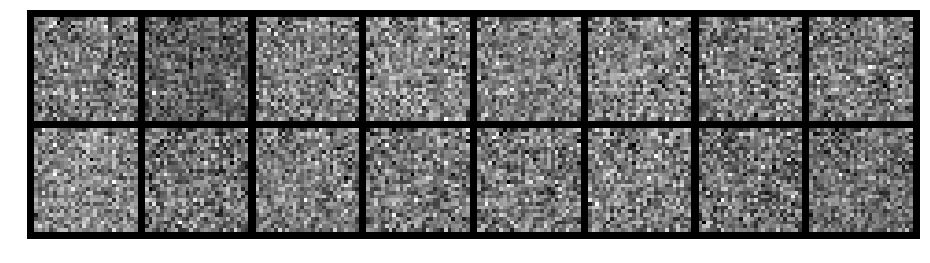

Epoch: [0/200], Batch Num: [0/600]
Discriminator Loss: 1.3662, Generator Loss: 0.6960
D(x): 0.5085, D(G(z)): 0.4982


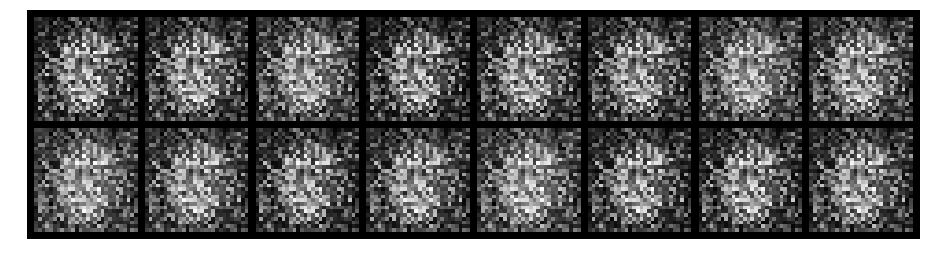

Epoch: [0/200], Batch Num: [100/600]
Discriminator Loss: 2.0300, Generator Loss: 0.4934
D(x): 0.7683, D(G(z)): 0.8105


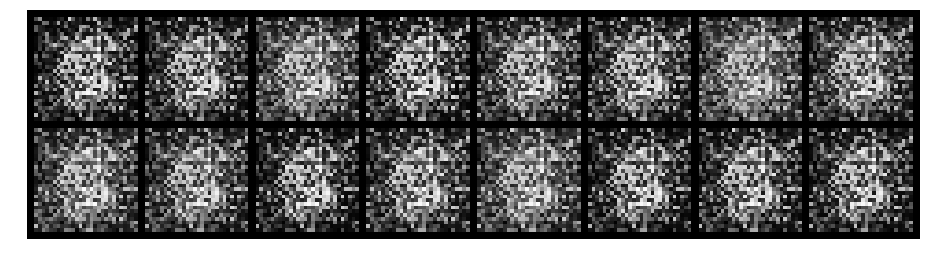

Epoch: [0/200], Batch Num: [200/600]
Discriminator Loss: 0.3164, Generator Loss: 4.3812
D(x): 0.9571, D(G(z)): 0.1990


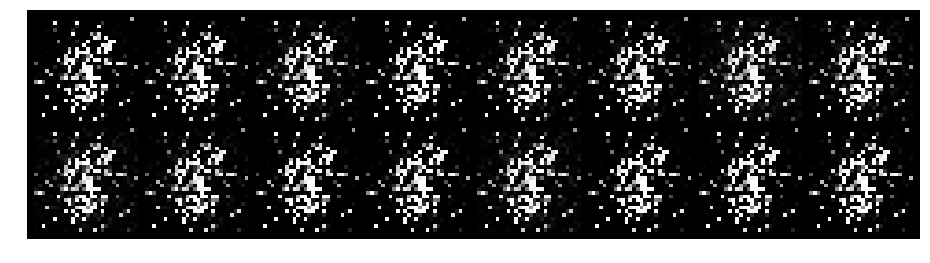

Epoch: [0/200], Batch Num: [300/600]
Discriminator Loss: 0.1055, Generator Loss: 6.0834
D(x): 0.9692, D(G(z)): 0.0613


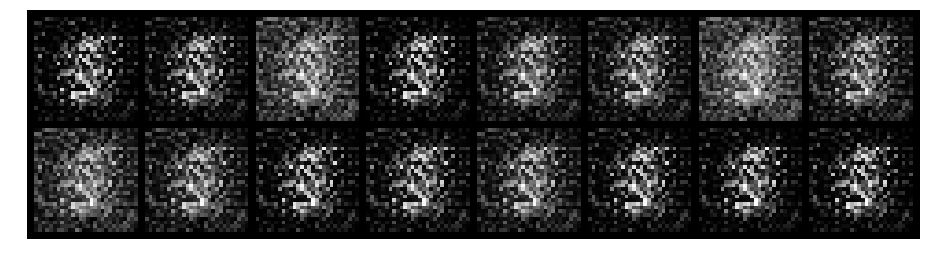

Epoch: [0/200], Batch Num: [400/600]
Discriminator Loss: 0.9744, Generator Loss: 4.0952
D(x): 0.4914, D(G(z)): 0.1502


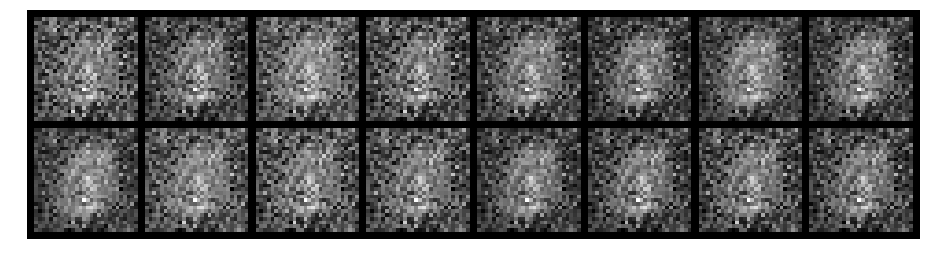

Epoch: [0/200], Batch Num: [500/600]
Discriminator Loss: 1.5937, Generator Loss: 0.4031
D(x): 0.7080, D(G(z)): 0.7050


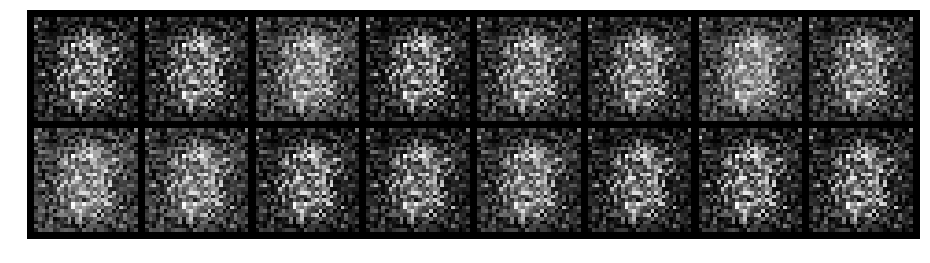

Epoch: [1/200], Batch Num: [0/600]
Discriminator Loss: 0.8016, Generator Loss: 1.5216
D(x): 0.6901, D(G(z)): 0.3337


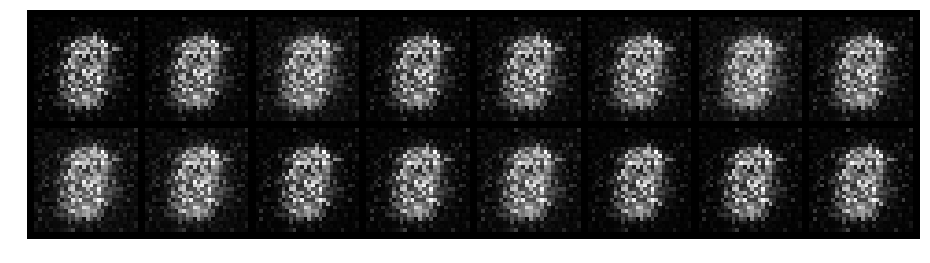

Epoch: [1/200], Batch Num: [100/600]
Discriminator Loss: 0.6441, Generator Loss: 2.7792
D(x): 0.7713, D(G(z)): 0.2582


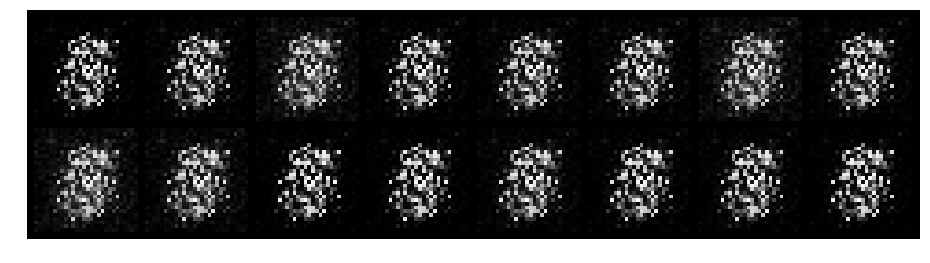

Epoch: [1/200], Batch Num: [200/600]
Discriminator Loss: 1.3206, Generator Loss: 1.3187
D(x): 0.5074, D(G(z)): 0.3744


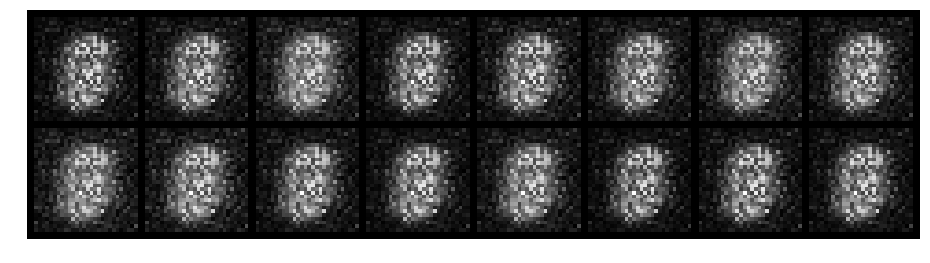

Epoch: [1/200], Batch Num: [300/600]
Discriminator Loss: 1.2350, Generator Loss: 1.2553
D(x): 0.6578, D(G(z)): 0.4561


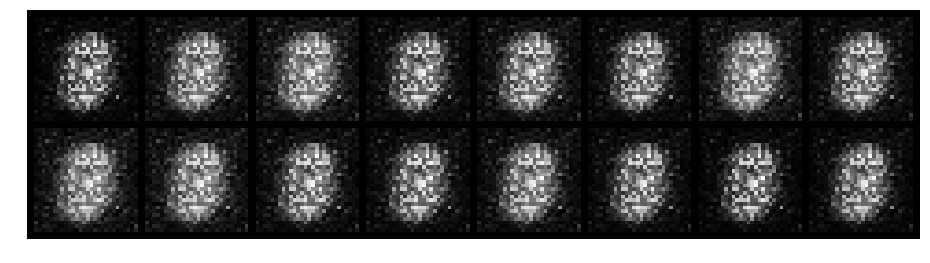

Epoch: [1/200], Batch Num: [400/600]
Discriminator Loss: 2.4577, Generator Loss: 0.5080
D(x): 0.6153, D(G(z)): 0.8021


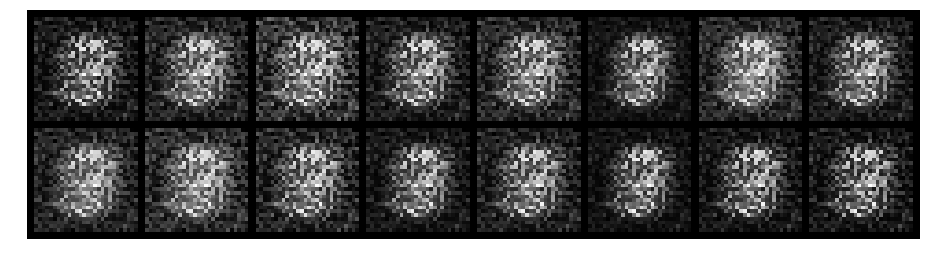

Epoch: [1/200], Batch Num: [500/600]
Discriminator Loss: 1.0302, Generator Loss: 1.5099
D(x): 0.6964, D(G(z)): 0.4275


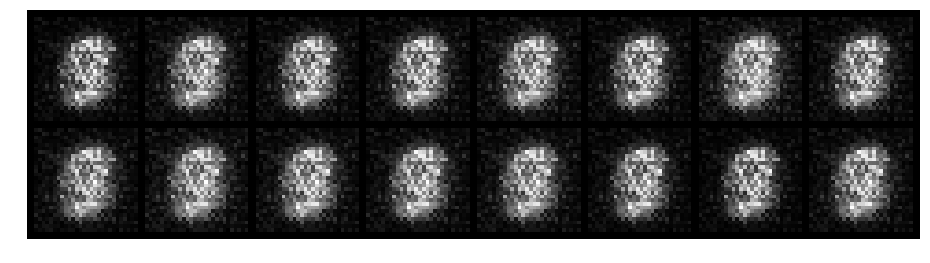

Epoch: [2/200], Batch Num: [0/600]
Discriminator Loss: 0.9710, Generator Loss: 1.0161
D(x): 0.6555, D(G(z)): 0.3975


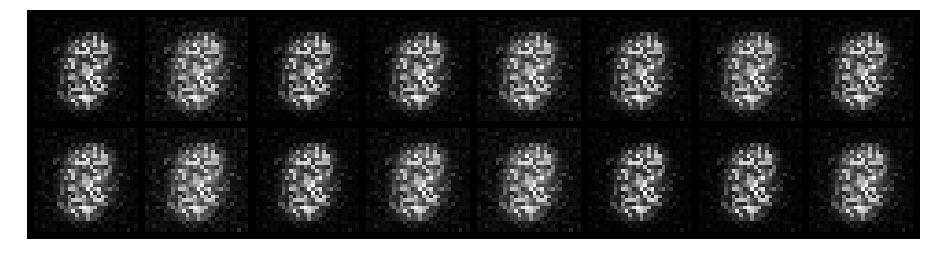

Epoch: [2/200], Batch Num: [100/600]
Discriminator Loss: 1.4712, Generator Loss: 1.4848
D(x): 0.6437, D(G(z)): 0.5282


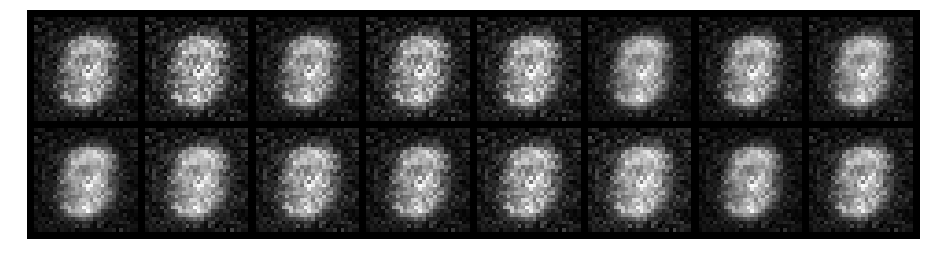

Epoch: [2/200], Batch Num: [200/600]
Discriminator Loss: 1.5366, Generator Loss: 1.0564
D(x): 0.5784, D(G(z)): 0.5062


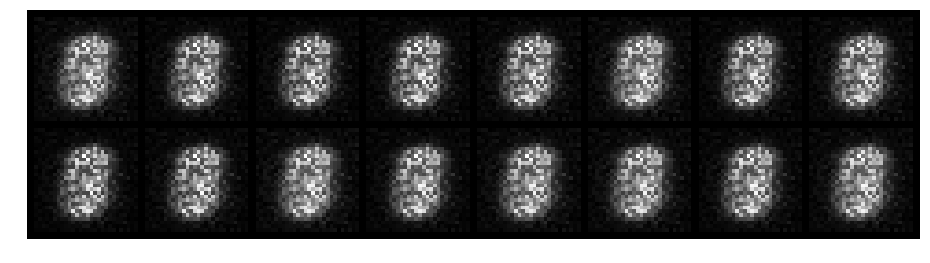

Epoch: [2/200], Batch Num: [300/600]
Discriminator Loss: 0.5591, Generator Loss: 2.6244
D(x): 0.8147, D(G(z)): 0.2092


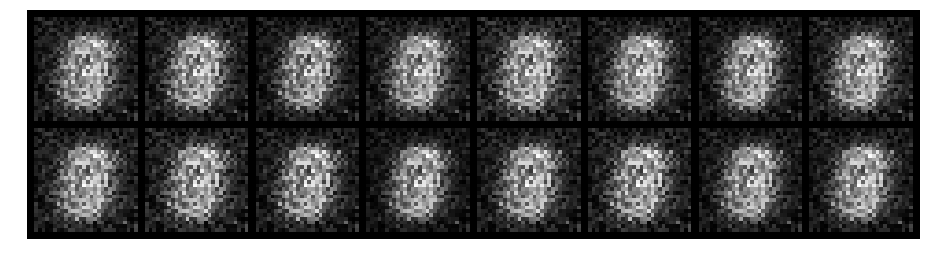

Epoch: [2/200], Batch Num: [400/600]
Discriminator Loss: 0.9385, Generator Loss: 2.2252
D(x): 0.7867, D(G(z)): 0.3885


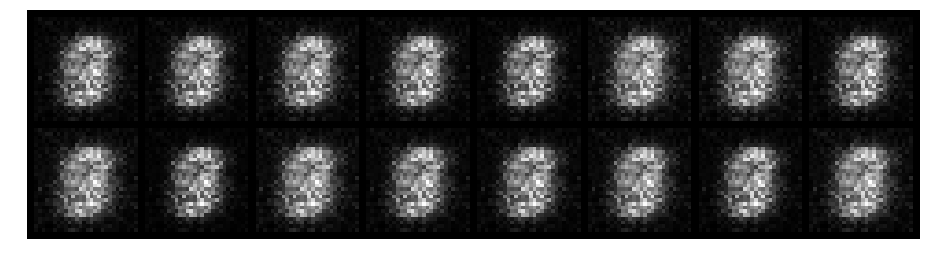

Epoch: [2/200], Batch Num: [500/600]
Discriminator Loss: 1.2828, Generator Loss: 0.7780
D(x): 0.6296, D(G(z)): 0.5103


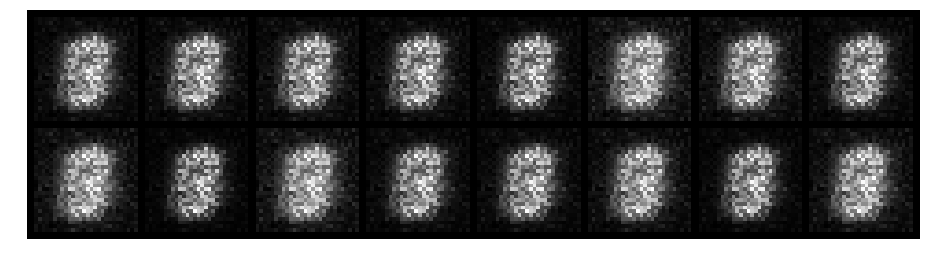

Epoch: [3/200], Batch Num: [0/600]
Discriminator Loss: 0.5001, Generator Loss: 1.6634
D(x): 0.8574, D(G(z)): 0.2658


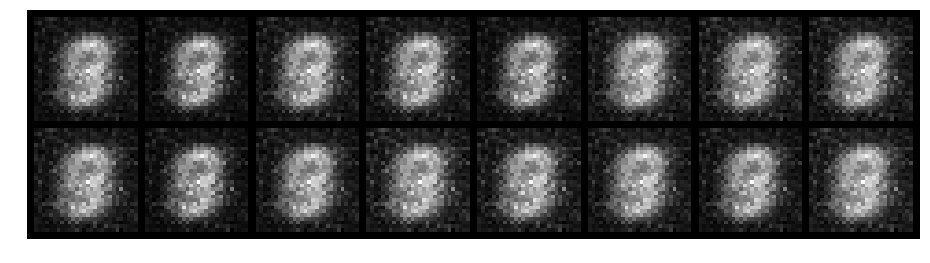

Epoch: [3/200], Batch Num: [100/600]
Discriminator Loss: 1.2373, Generator Loss: 1.1603
D(x): 0.6348, D(G(z)): 0.4385


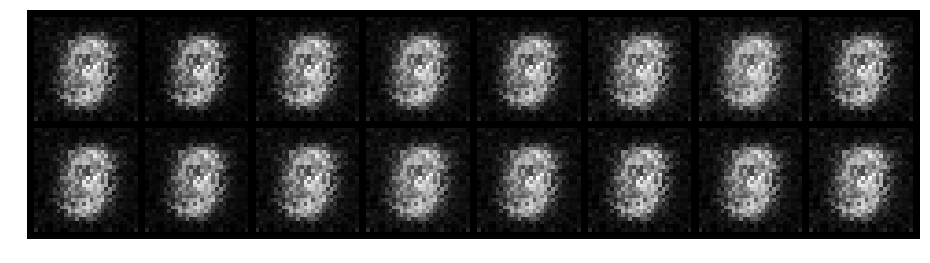

Epoch: [3/200], Batch Num: [200/600]
Discriminator Loss: 0.2949, Generator Loss: 2.6339
D(x): 0.8626, D(G(z)): 0.1078


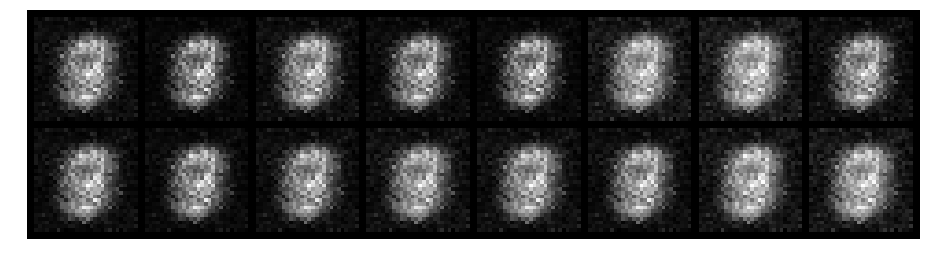

Epoch: [3/200], Batch Num: [300/600]
Discriminator Loss: 0.4706, Generator Loss: 1.9893
D(x): 0.8225, D(G(z)): 0.1763


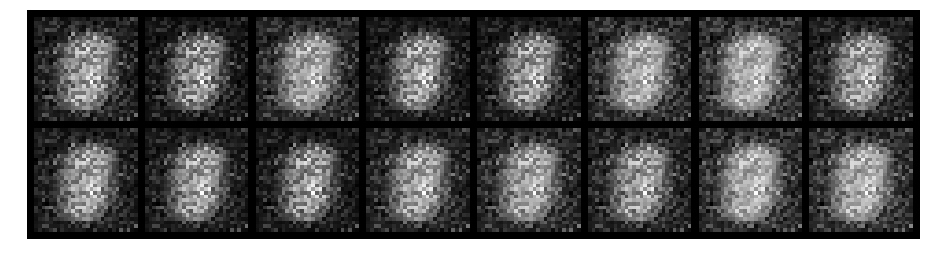

Epoch: [3/200], Batch Num: [400/600]
Discriminator Loss: 0.2181, Generator Loss: 4.6974
D(x): 0.9533, D(G(z)): 0.0618


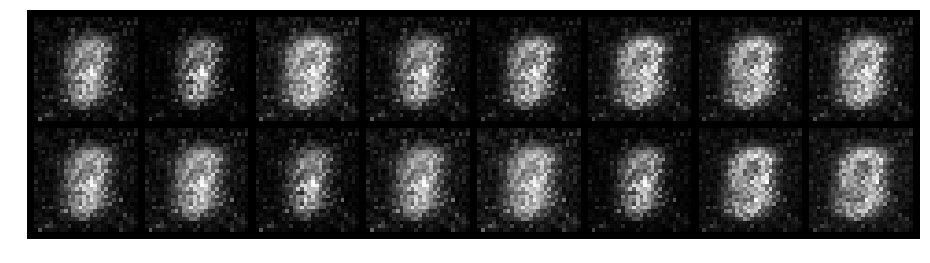

Epoch: [3/200], Batch Num: [500/600]
Discriminator Loss: 0.8477, Generator Loss: 2.0642
D(x): 0.7348, D(G(z)): 0.2224


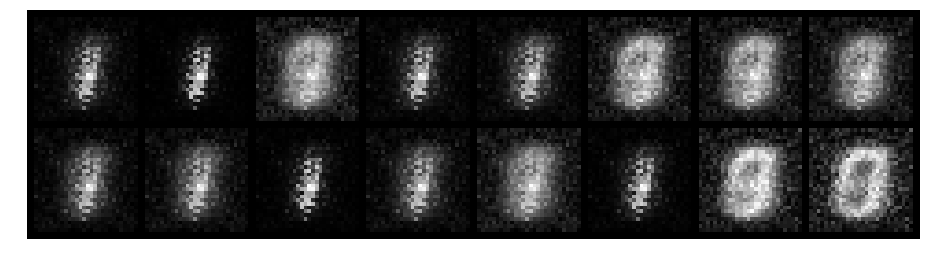

Epoch: [4/200], Batch Num: [0/600]
Discriminator Loss: 0.8819, Generator Loss: 2.1901
D(x): 0.7646, D(G(z)): 0.2656


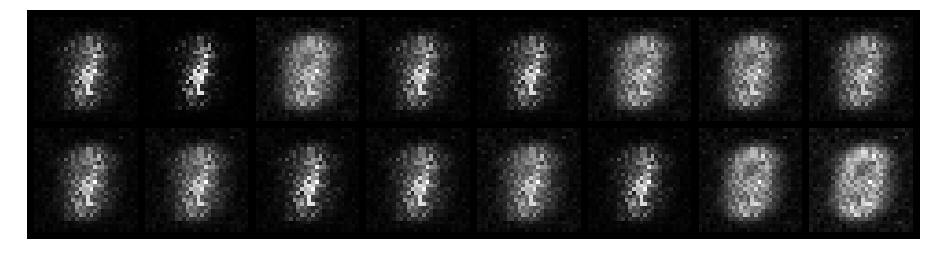

Epoch: [4/200], Batch Num: [100/600]
Discriminator Loss: 0.8430, Generator Loss: 1.8033
D(x): 0.7881, D(G(z)): 0.2668


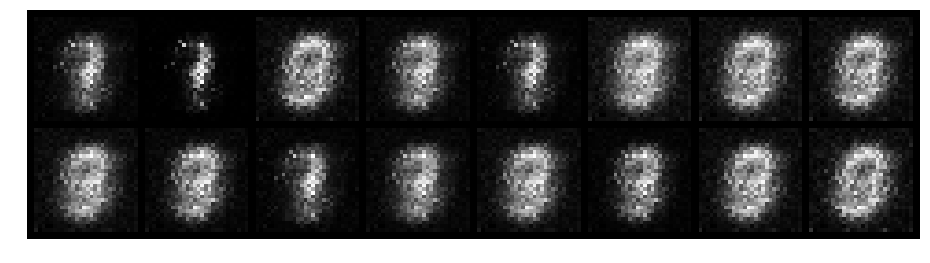

Epoch: [4/200], Batch Num: [200/600]
Discriminator Loss: 1.4322, Generator Loss: 2.7359
D(x): 0.6699, D(G(z)): 0.2329


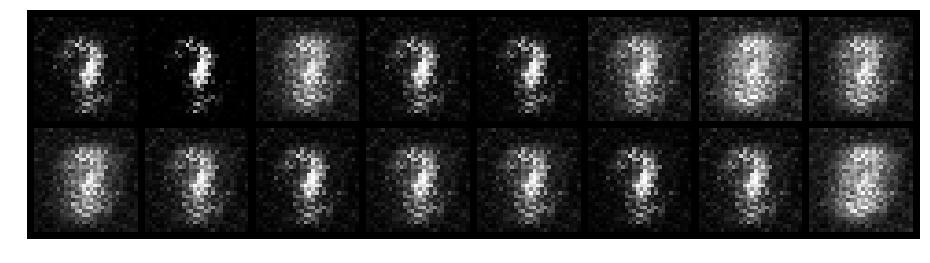

Epoch: [4/200], Batch Num: [300/600]
Discriminator Loss: 0.3026, Generator Loss: 3.6883
D(x): 0.9014, D(G(z)): 0.0681


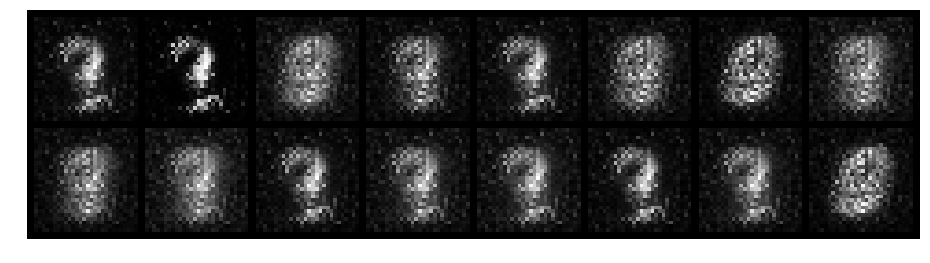

Epoch: [4/200], Batch Num: [400/600]
Discriminator Loss: 0.9925, Generator Loss: 2.5407
D(x): 0.8206, D(G(z)): 0.3499


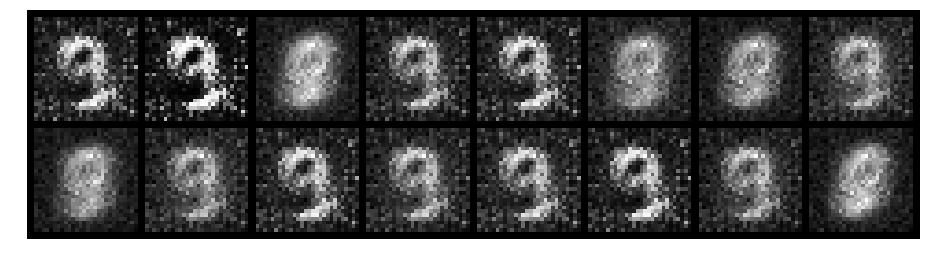

Epoch: [4/200], Batch Num: [500/600]
Discriminator Loss: 0.6096, Generator Loss: 3.0088
D(x): 0.9114, D(G(z)): 0.2193


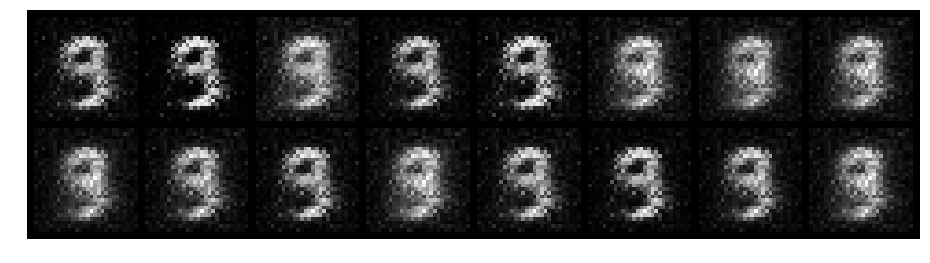

Epoch: [5/200], Batch Num: [0/600]
Discriminator Loss: 0.8907, Generator Loss: 2.4549
D(x): 0.7012, D(G(z)): 0.1780


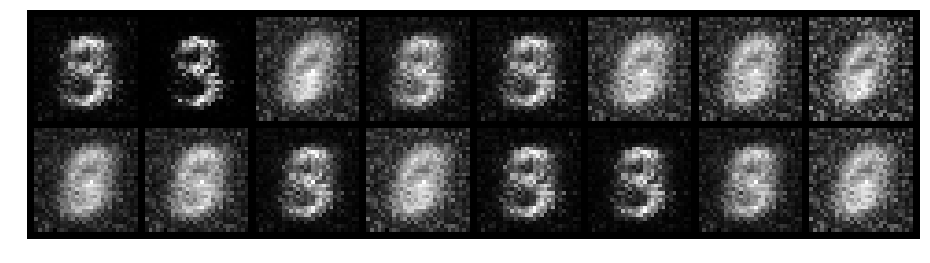

Epoch: [5/200], Batch Num: [100/600]
Discriminator Loss: 0.5170, Generator Loss: 1.9781
D(x): 0.9030, D(G(z)): 0.2539


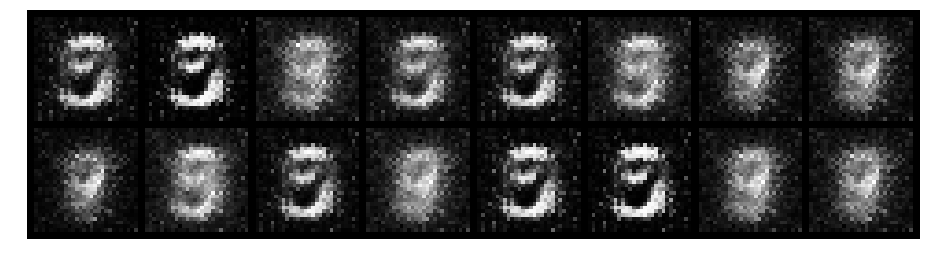

Epoch: [5/200], Batch Num: [200/600]
Discriminator Loss: 0.3831, Generator Loss: 3.1295
D(x): 0.9054, D(G(z)): 0.1341


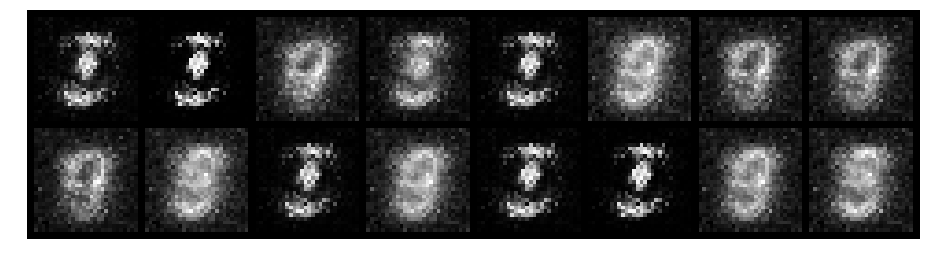

Epoch: [5/200], Batch Num: [300/600]
Discriminator Loss: 0.6068, Generator Loss: 2.4741
D(x): 0.8910, D(G(z)): 0.2400


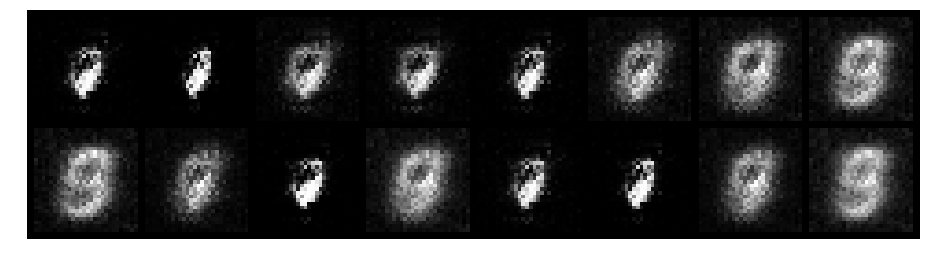

Epoch: [5/200], Batch Num: [400/600]
Discriminator Loss: 0.6677, Generator Loss: 2.2493
D(x): 0.7562, D(G(z)): 0.2164


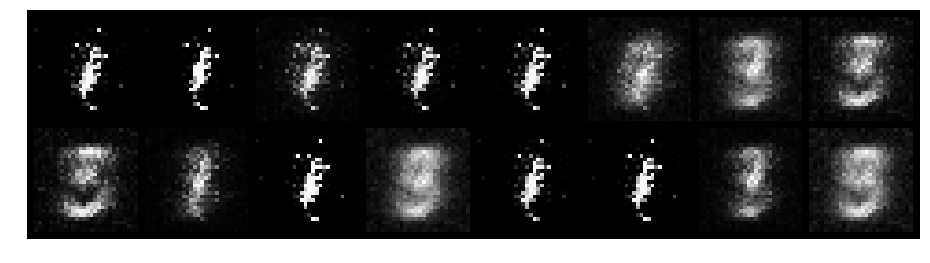

Epoch: [5/200], Batch Num: [500/600]
Discriminator Loss: 0.8572, Generator Loss: 1.5843
D(x): 0.7340, D(G(z)): 0.1702


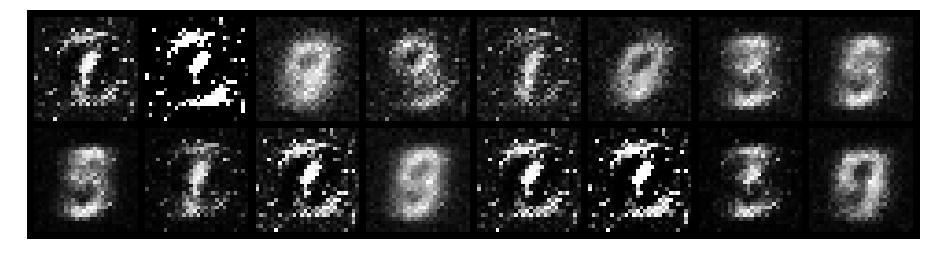

Epoch: [6/200], Batch Num: [0/600]
Discriminator Loss: 0.4678, Generator Loss: 2.8923
D(x): 0.8594, D(G(z)): 0.1325


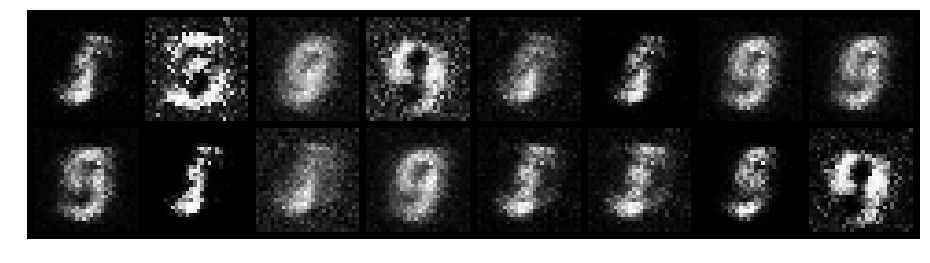

Epoch: [6/200], Batch Num: [100/600]
Discriminator Loss: 0.6383, Generator Loss: 2.9929
D(x): 0.8083, D(G(z)): 0.1408


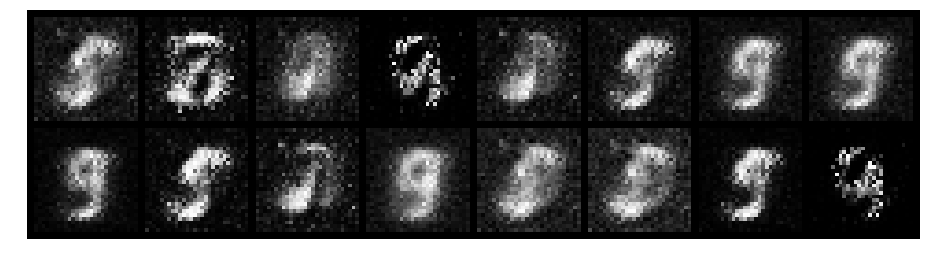

Epoch: [6/200], Batch Num: [200/600]
Discriminator Loss: 1.2094, Generator Loss: 1.6619
D(x): 0.7682, D(G(z)): 0.4234


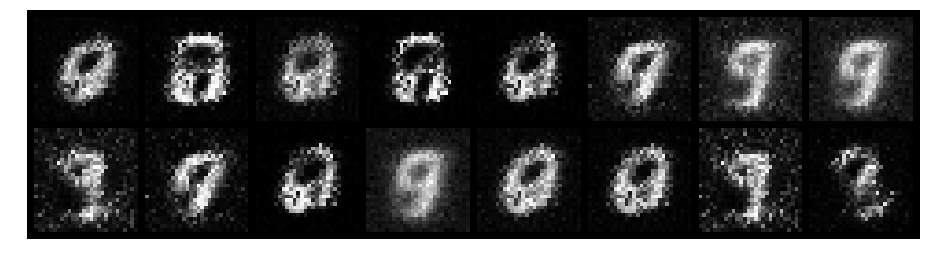

Epoch: [6/200], Batch Num: [300/600]
Discriminator Loss: 0.6461, Generator Loss: 2.0599
D(x): 0.8073, D(G(z)): 0.2579


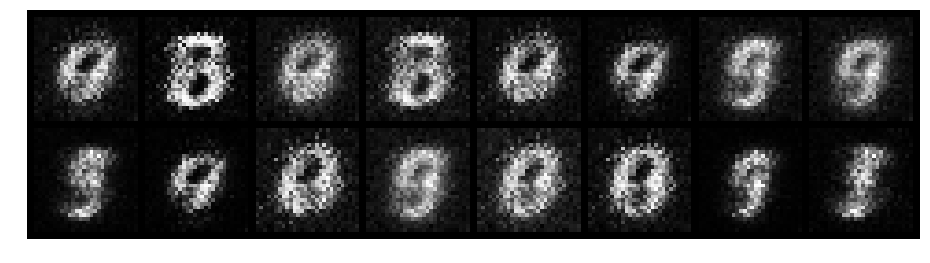

Epoch: [6/200], Batch Num: [400/600]
Discriminator Loss: 1.0233, Generator Loss: 1.9859
D(x): 0.7945, D(G(z)): 0.3409


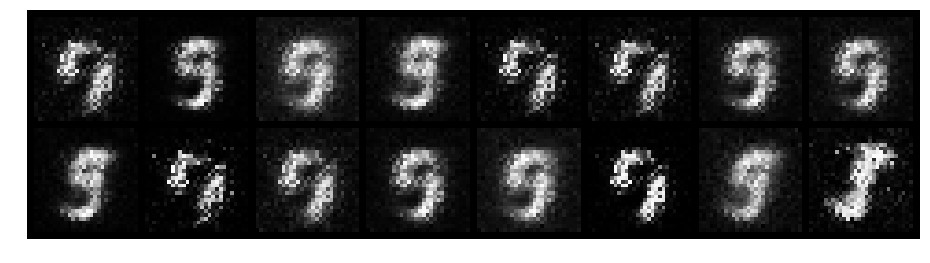

Epoch: [6/200], Batch Num: [500/600]
Discriminator Loss: 0.7547, Generator Loss: 1.8980
D(x): 0.8271, D(G(z)): 0.3285


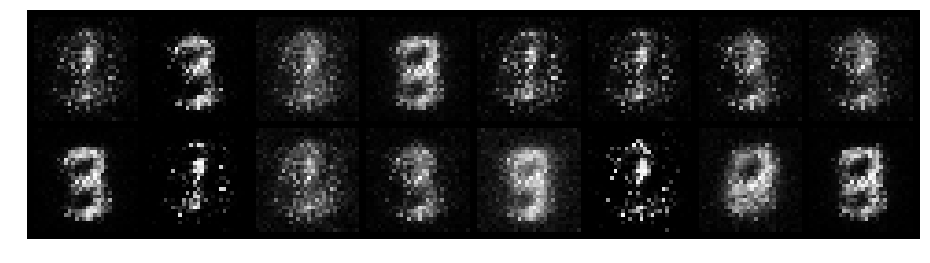

Epoch: [7/200], Batch Num: [0/600]
Discriminator Loss: 0.6925, Generator Loss: 2.1661
D(x): 0.7721, D(G(z)): 0.2188


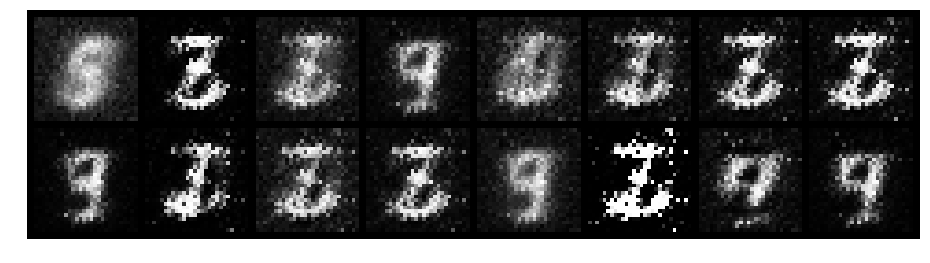

Epoch: [7/200], Batch Num: [100/600]
Discriminator Loss: 0.9594, Generator Loss: 2.8660
D(x): 0.7921, D(G(z)): 0.2943


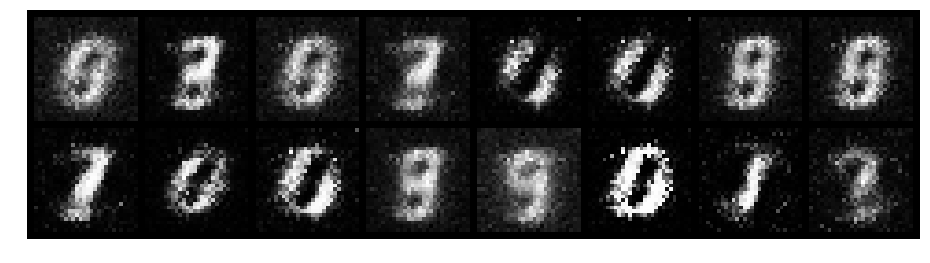

Epoch: [7/200], Batch Num: [200/600]
Discriminator Loss: 0.6149, Generator Loss: 2.5471
D(x): 0.8350, D(G(z)): 0.2363


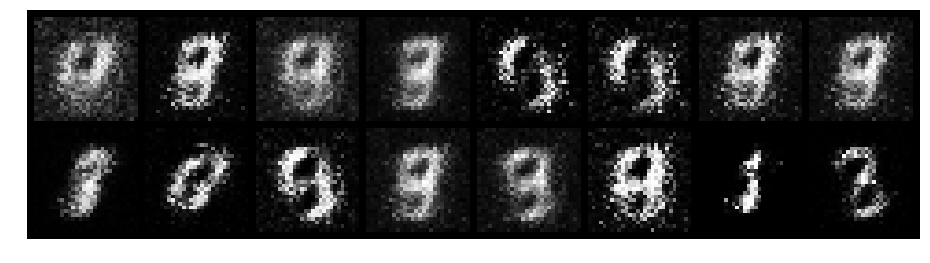

Epoch: [7/200], Batch Num: [300/600]
Discriminator Loss: 0.3973, Generator Loss: 3.0091
D(x): 0.8561, D(G(z)): 0.1322


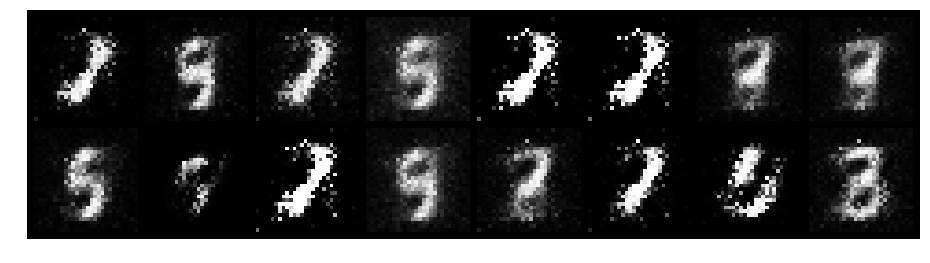

Epoch: [7/200], Batch Num: [400/600]
Discriminator Loss: 0.8438, Generator Loss: 2.1068
D(x): 0.7751, D(G(z)): 0.2445


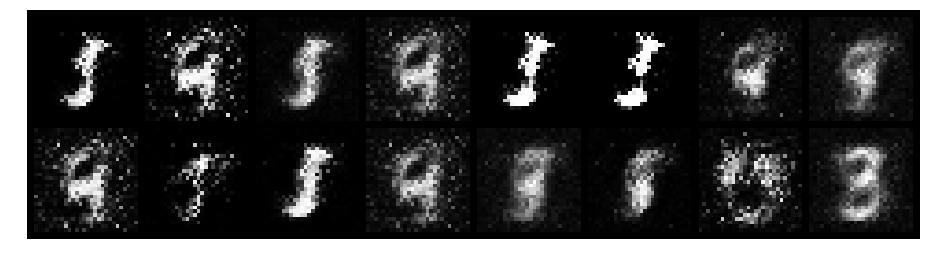

Epoch: [7/200], Batch Num: [500/600]
Discriminator Loss: 0.4873, Generator Loss: 2.4957
D(x): 0.8701, D(G(z)): 0.1883


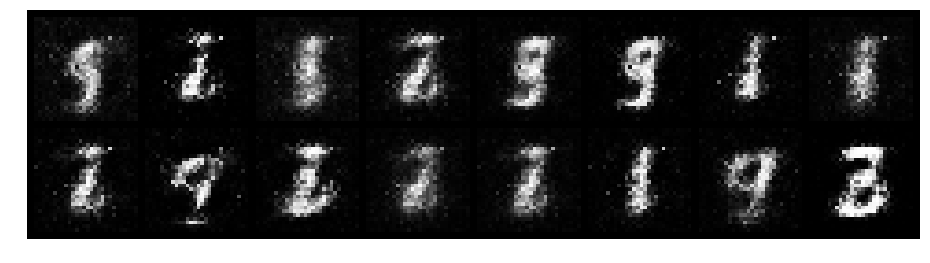

Epoch: [8/200], Batch Num: [0/600]
Discriminator Loss: 0.7886, Generator Loss: 1.6793
D(x): 0.6671, D(G(z)): 0.1071


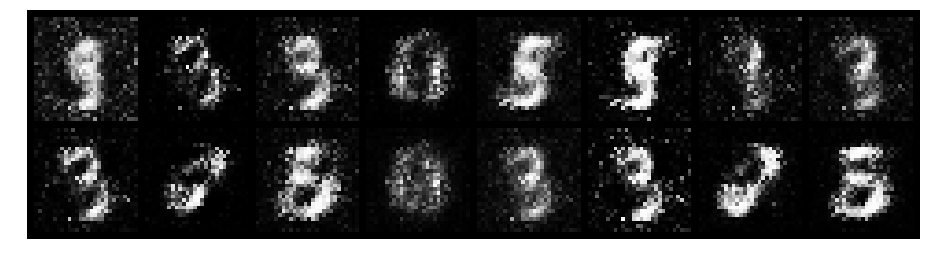

Epoch: [8/200], Batch Num: [100/600]
Discriminator Loss: 0.6480, Generator Loss: 2.4574
D(x): 0.8271, D(G(z)): 0.2120


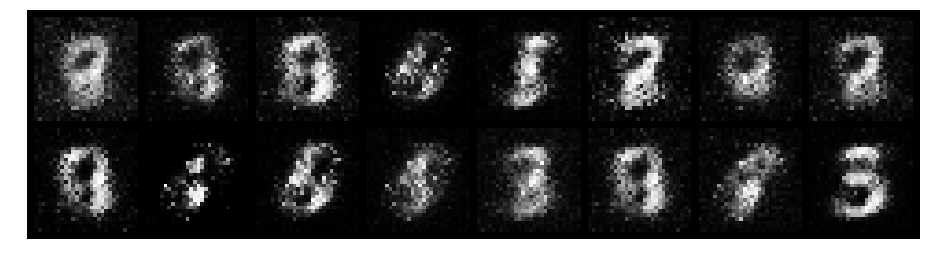

Epoch: [8/200], Batch Num: [200/600]
Discriminator Loss: 0.4856, Generator Loss: 2.2268
D(x): 0.8703, D(G(z)): 0.1875


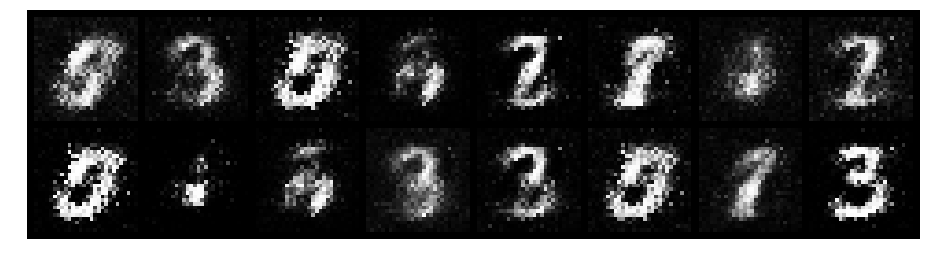

Epoch: [8/200], Batch Num: [300/600]
Discriminator Loss: 0.6671, Generator Loss: 2.1260
D(x): 0.7223, D(G(z)): 0.1615


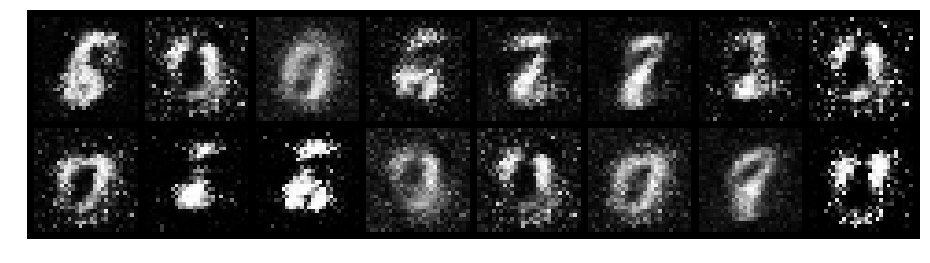

Epoch: [8/200], Batch Num: [400/600]
Discriminator Loss: 0.7559, Generator Loss: 2.3584
D(x): 0.7455, D(G(z)): 0.2278


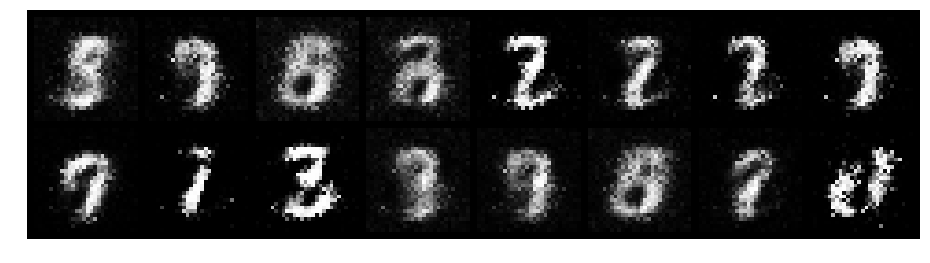

Epoch: [8/200], Batch Num: [500/600]
Discriminator Loss: 0.5352, Generator Loss: 2.3561
D(x): 0.8277, D(G(z)): 0.1514


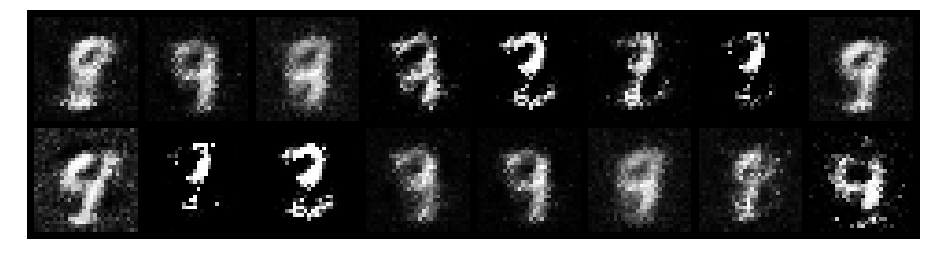

Epoch: [9/200], Batch Num: [0/600]
Discriminator Loss: 0.6030, Generator Loss: 2.2385
D(x): 0.8458, D(G(z)): 0.1629


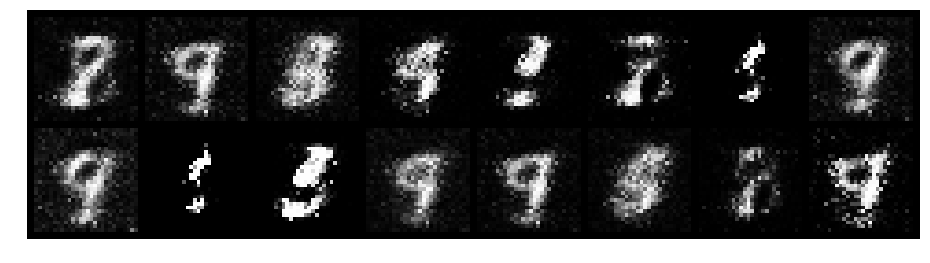

Epoch: [9/200], Batch Num: [100/600]
Discriminator Loss: 0.6563, Generator Loss: 2.5404
D(x): 0.8950, D(G(z)): 0.2636


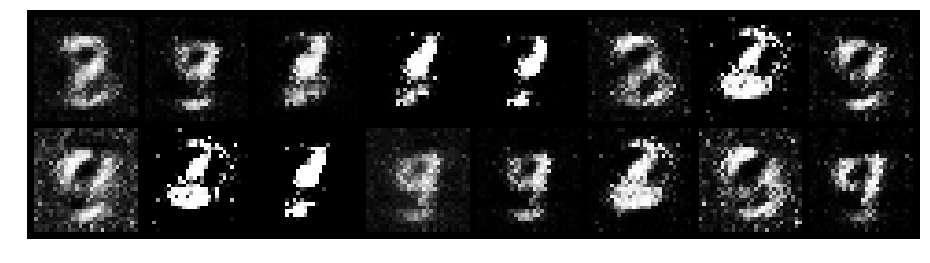

Epoch: [9/200], Batch Num: [200/600]
Discriminator Loss: 0.4590, Generator Loss: 2.7733
D(x): 0.8536, D(G(z)): 0.1922


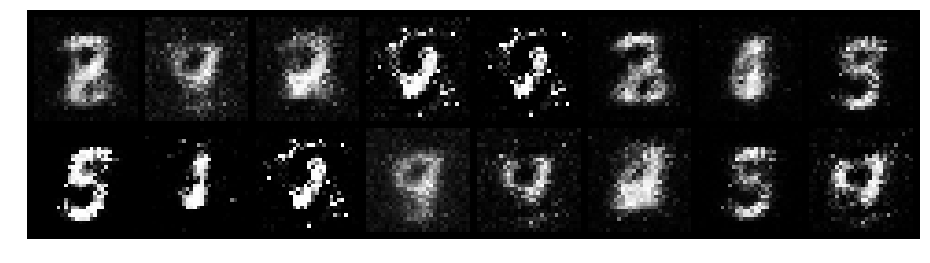

Epoch: [9/200], Batch Num: [300/600]
Discriminator Loss: 0.3725, Generator Loss: 3.0743
D(x): 0.9147, D(G(z)): 0.1758


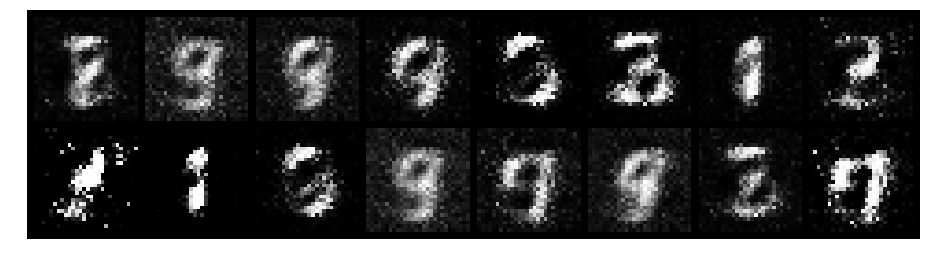

Epoch: [9/200], Batch Num: [400/600]
Discriminator Loss: 0.4830, Generator Loss: 2.4468
D(x): 0.8622, D(G(z)): 0.1856


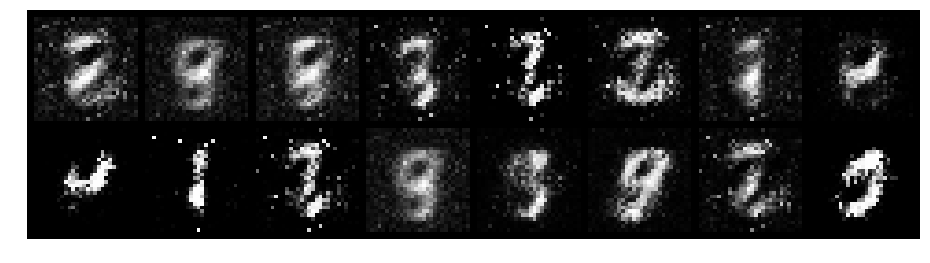

Epoch: [9/200], Batch Num: [500/600]
Discriminator Loss: 0.5869, Generator Loss: 2.0038
D(x): 0.8075, D(G(z)): 0.1867


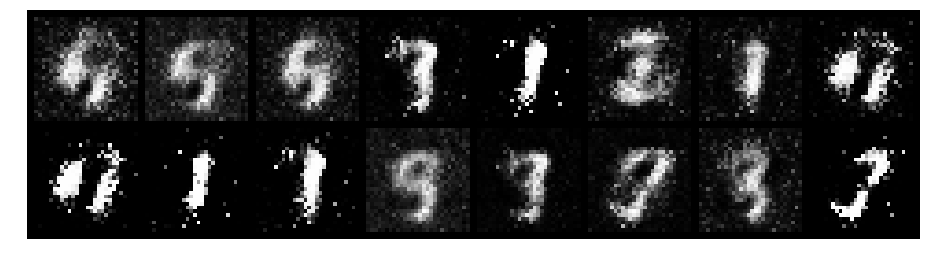

Epoch: [10/200], Batch Num: [0/600]
Discriminator Loss: 0.7853, Generator Loss: 2.1124
D(x): 0.7795, D(G(z)): 0.2004


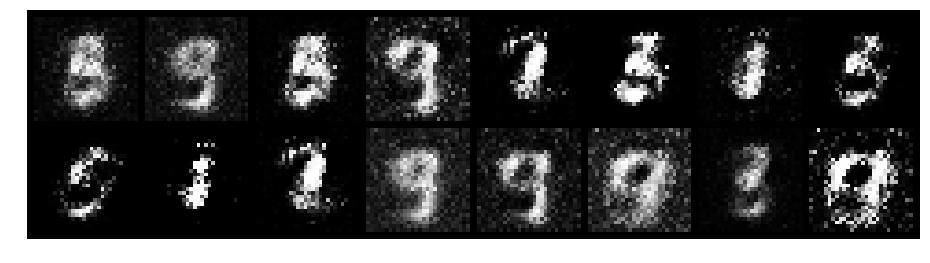

Epoch: [10/200], Batch Num: [100/600]
Discriminator Loss: 0.7158, Generator Loss: 2.0310
D(x): 0.7578, D(G(z)): 0.2384


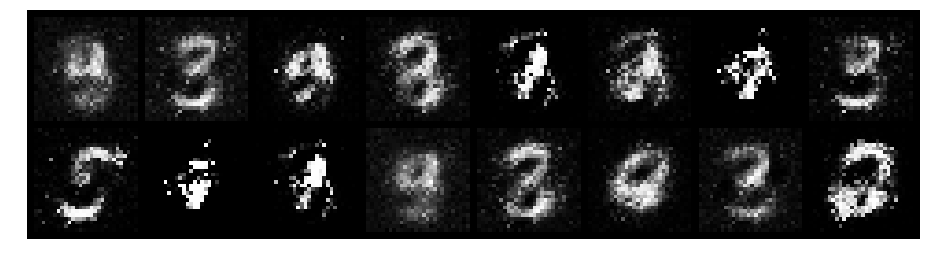

Epoch: [10/200], Batch Num: [200/600]
Discriminator Loss: 0.5002, Generator Loss: 2.3967
D(x): 0.8635, D(G(z)): 0.1848


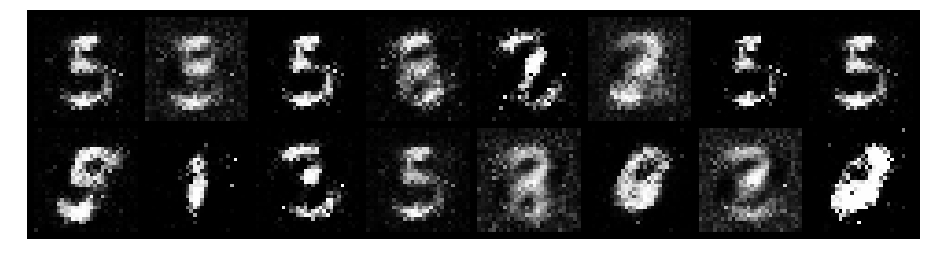

Epoch: [10/200], Batch Num: [300/600]
Discriminator Loss: 0.5725, Generator Loss: 2.5629
D(x): 0.7936, D(G(z)): 0.1749


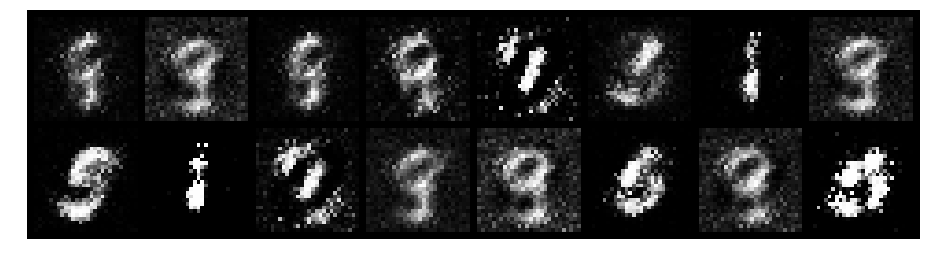

Epoch: [10/200], Batch Num: [400/600]
Discriminator Loss: 0.5991, Generator Loss: 2.2722
D(x): 0.8378, D(G(z)): 0.2273


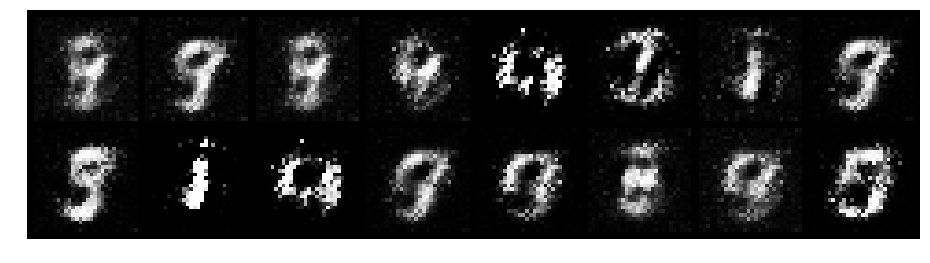

Epoch: [10/200], Batch Num: [500/600]
Discriminator Loss: 0.5653, Generator Loss: 2.3930
D(x): 0.8414, D(G(z)): 0.2185


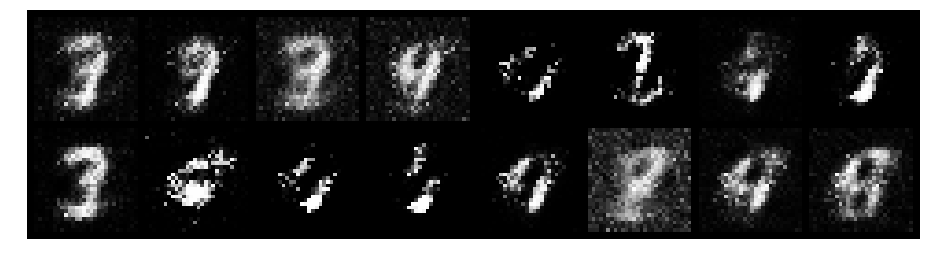

Epoch: [11/200], Batch Num: [0/600]
Discriminator Loss: 0.8428, Generator Loss: 2.9954
D(x): 0.7452, D(G(z)): 0.1605


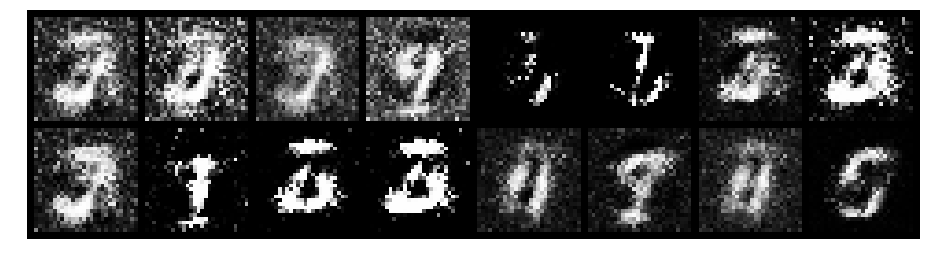

Epoch: [11/200], Batch Num: [100/600]
Discriminator Loss: 0.5796, Generator Loss: 2.1543
D(x): 0.8983, D(G(z)): 0.2693


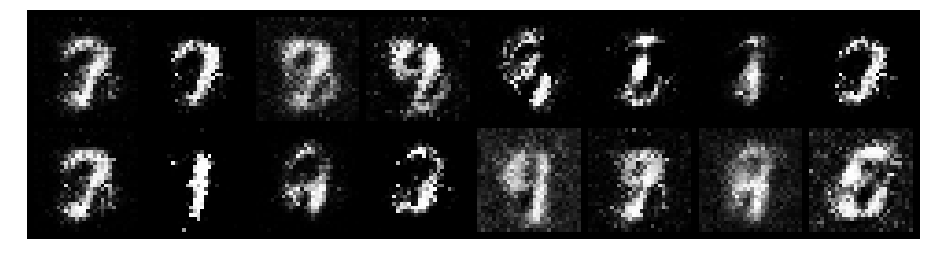

Epoch: [11/200], Batch Num: [200/600]
Discriminator Loss: 0.6355, Generator Loss: 1.7169
D(x): 0.7964, D(G(z)): 0.2236


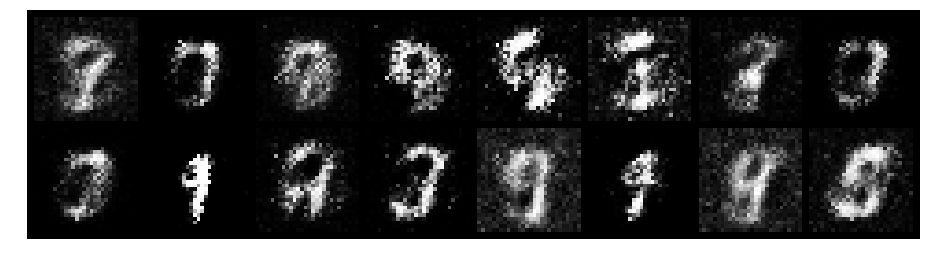

Epoch: [11/200], Batch Num: [300/600]
Discriminator Loss: 0.8281, Generator Loss: 2.0498
D(x): 0.6875, D(G(z)): 0.1918


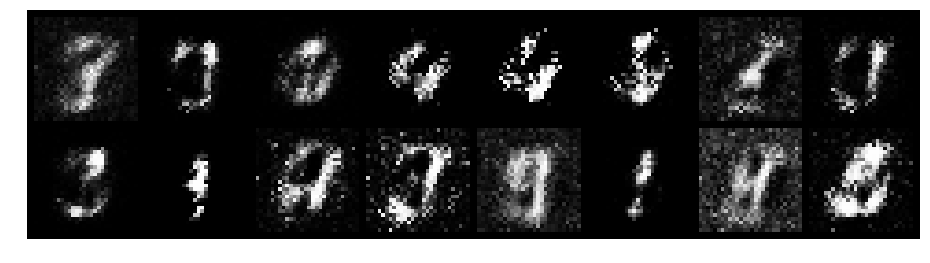

Epoch: [11/200], Batch Num: [400/600]
Discriminator Loss: 0.5405, Generator Loss: 2.2946
D(x): 0.7991, D(G(z)): 0.1411


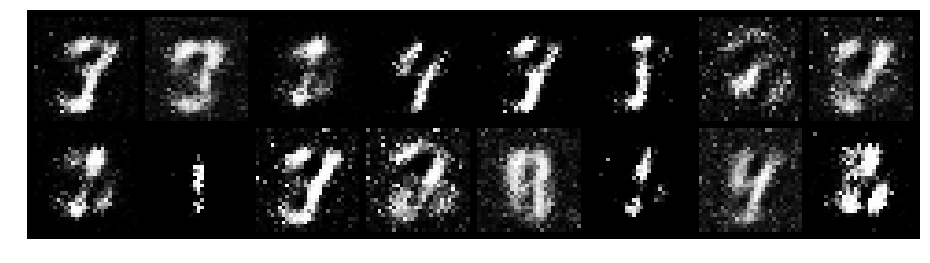

Epoch: [11/200], Batch Num: [500/600]
Discriminator Loss: 0.7475, Generator Loss: 2.0144
D(x): 0.7829, D(G(z)): 0.2508


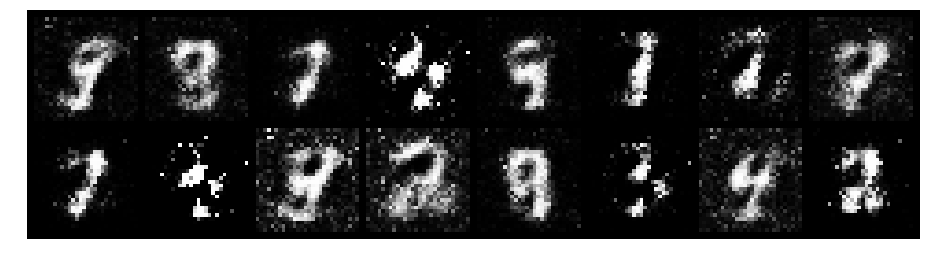

Epoch: [12/200], Batch Num: [0/600]
Discriminator Loss: 0.8068, Generator Loss: 1.5711
D(x): 0.7658, D(G(z)): 0.2599


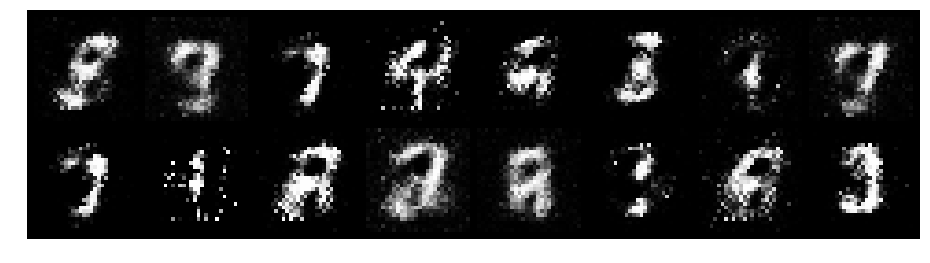

Epoch: [12/200], Batch Num: [100/600]
Discriminator Loss: 0.6813, Generator Loss: 2.0583
D(x): 0.7943, D(G(z)): 0.2585


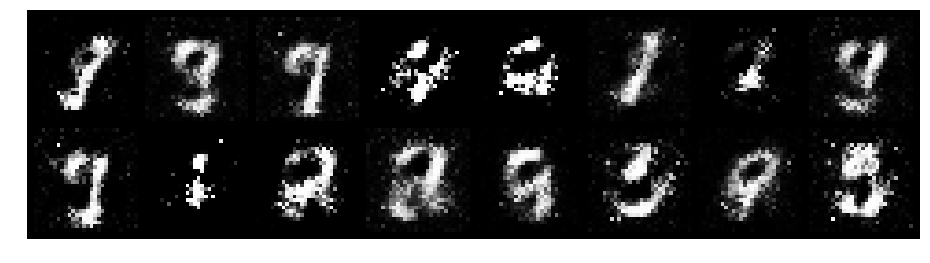

Epoch: [12/200], Batch Num: [200/600]
Discriminator Loss: 0.7568, Generator Loss: 2.4570
D(x): 0.6968, D(G(z)): 0.1537


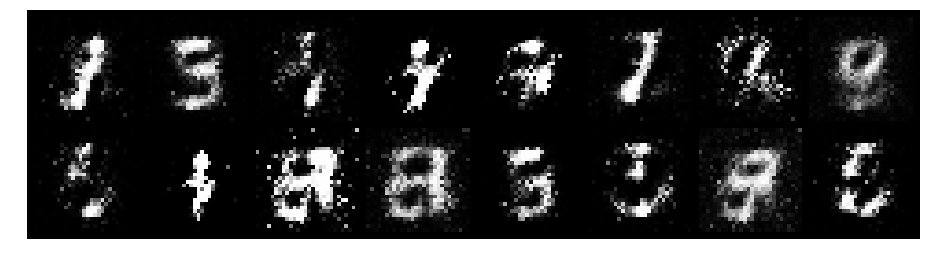

Epoch: [12/200], Batch Num: [300/600]
Discriminator Loss: 0.8221, Generator Loss: 2.6140
D(x): 0.7795, D(G(z)): 0.2599


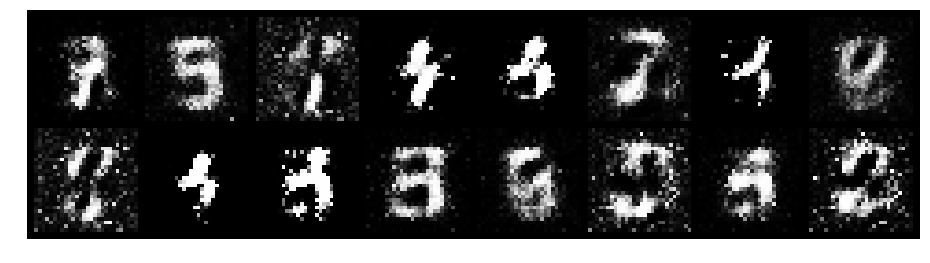

Epoch: [12/200], Batch Num: [400/600]
Discriminator Loss: 0.7001, Generator Loss: 2.3966
D(x): 0.7923, D(G(z)): 0.1860


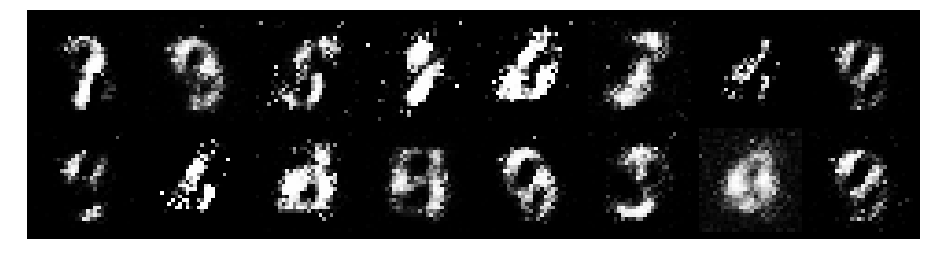

Epoch: [12/200], Batch Num: [500/600]
Discriminator Loss: 0.8317, Generator Loss: 2.1431
D(x): 0.7785, D(G(z)): 0.2757


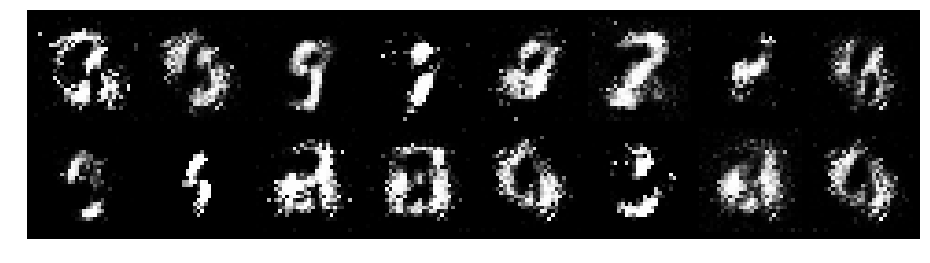

Epoch: [13/200], Batch Num: [0/600]
Discriminator Loss: 0.8099, Generator Loss: 2.0144
D(x): 0.7290, D(G(z)): 0.2367


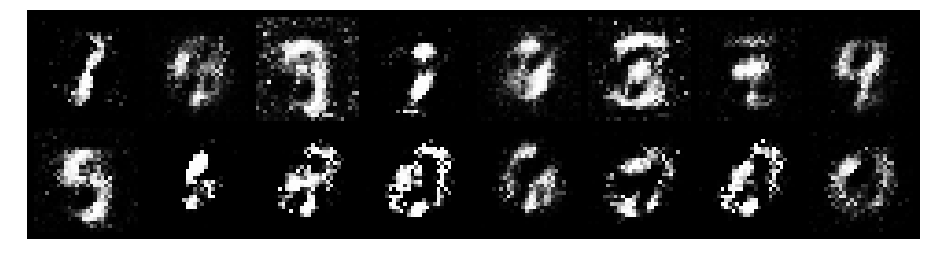

Epoch: [13/200], Batch Num: [100/600]
Discriminator Loss: 0.7039, Generator Loss: 2.5022
D(x): 0.7495, D(G(z)): 0.1836


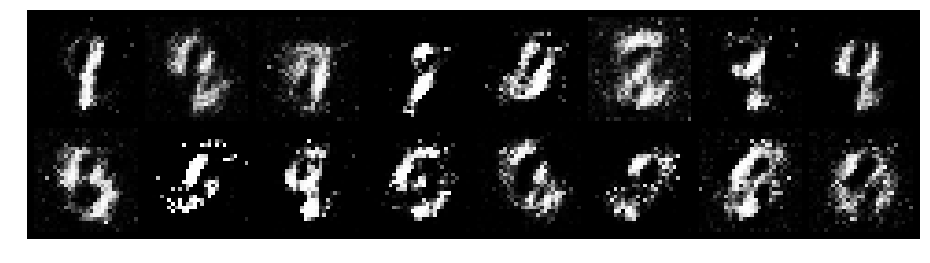

Epoch: [13/200], Batch Num: [200/600]
Discriminator Loss: 0.6096, Generator Loss: 1.9343
D(x): 0.7722, D(G(z)): 0.2163


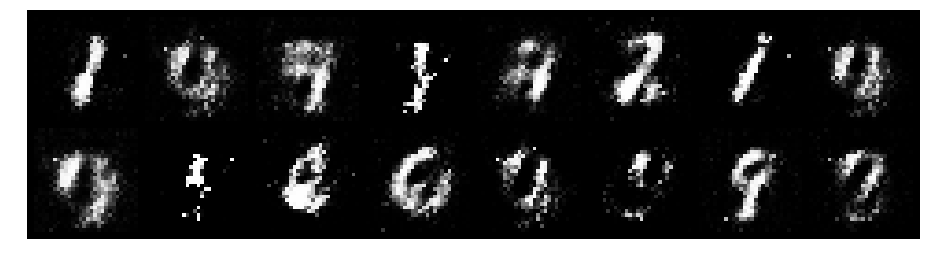

Epoch: [13/200], Batch Num: [300/600]
Discriminator Loss: 0.4109, Generator Loss: 2.4655
D(x): 0.8507, D(G(z)): 0.1538


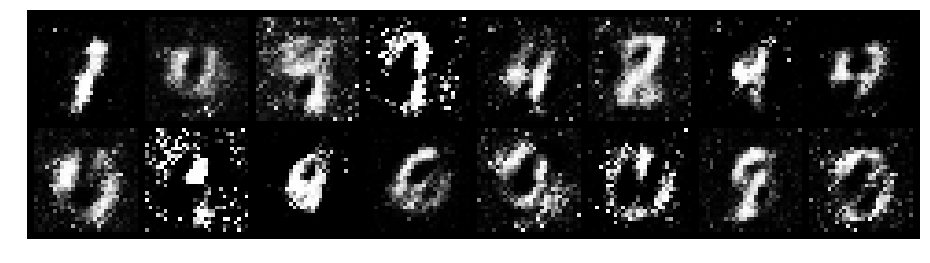

Epoch: [13/200], Batch Num: [400/600]
Discriminator Loss: 0.7586, Generator Loss: 2.7146
D(x): 0.7227, D(G(z)): 0.2280


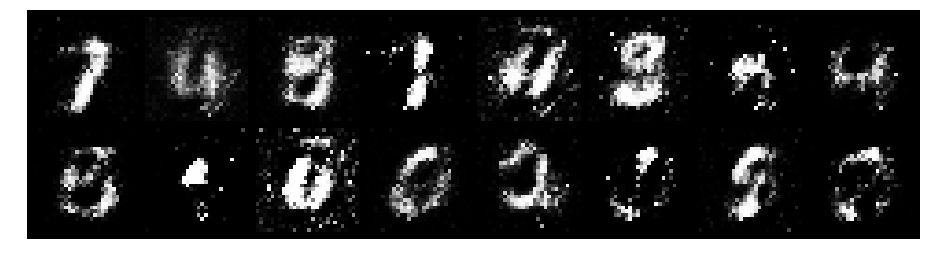

Epoch: [13/200], Batch Num: [500/600]
Discriminator Loss: 0.6197, Generator Loss: 1.8977
D(x): 0.7842, D(G(z)): 0.1829


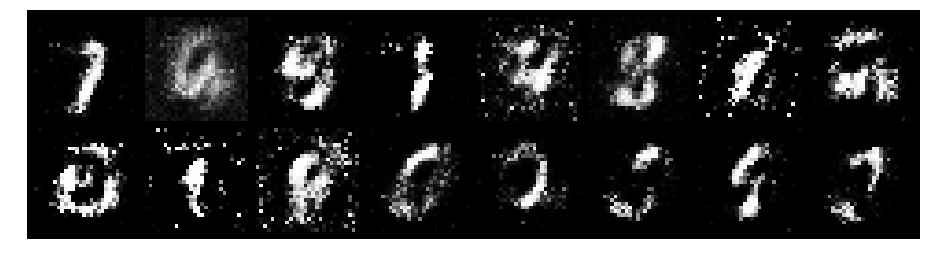

Epoch: [14/200], Batch Num: [0/600]
Discriminator Loss: 0.6377, Generator Loss: 1.9599
D(x): 0.7955, D(G(z)): 0.2363


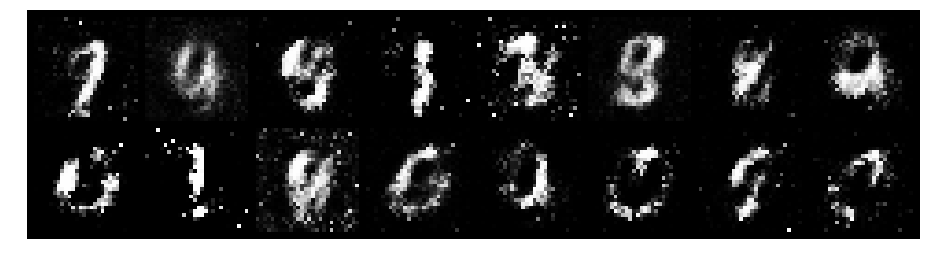

Epoch: [14/200], Batch Num: [100/600]
Discriminator Loss: 0.6380, Generator Loss: 2.1222
D(x): 0.7741, D(G(z)): 0.1870


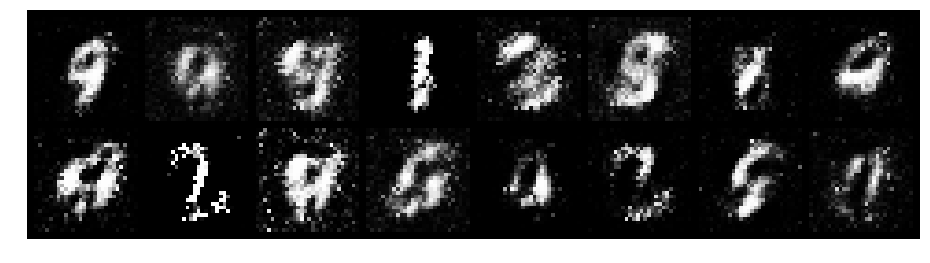

Epoch: [14/200], Batch Num: [200/600]
Discriminator Loss: 0.8211, Generator Loss: 2.6624
D(x): 0.7636, D(G(z)): 0.2674


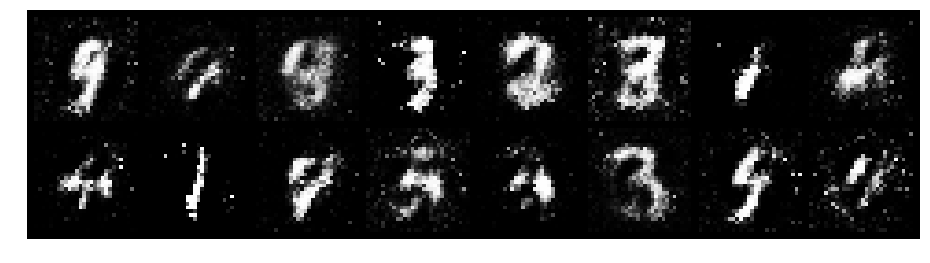

Epoch: [14/200], Batch Num: [300/600]
Discriminator Loss: 0.7983, Generator Loss: 1.7609
D(x): 0.7361, D(G(z)): 0.2606


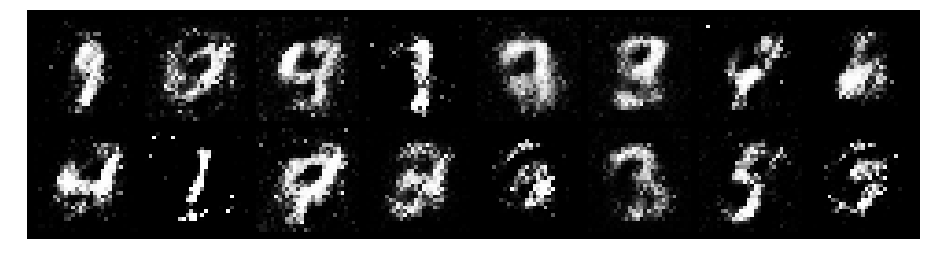

Epoch: [14/200], Batch Num: [400/600]
Discriminator Loss: 0.9384, Generator Loss: 2.0418
D(x): 0.7196, D(G(z)): 0.2798


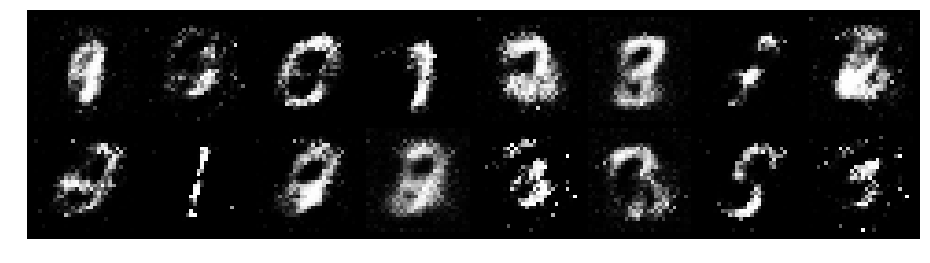

Epoch: [14/200], Batch Num: [500/600]
Discriminator Loss: 0.9996, Generator Loss: 1.3933
D(x): 0.7235, D(G(z)): 0.3559


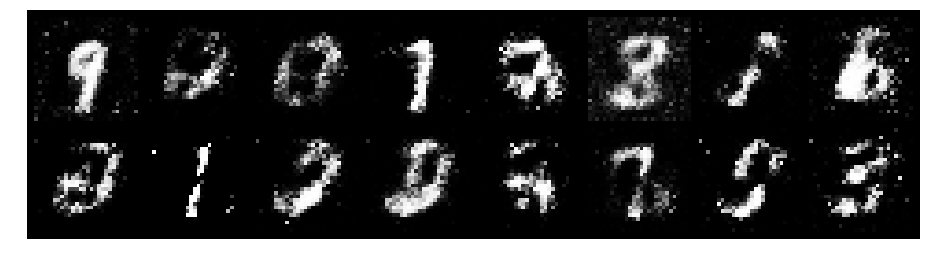

Epoch: [15/200], Batch Num: [0/600]
Discriminator Loss: 1.1409, Generator Loss: 1.4865
D(x): 0.6865, D(G(z)): 0.3825


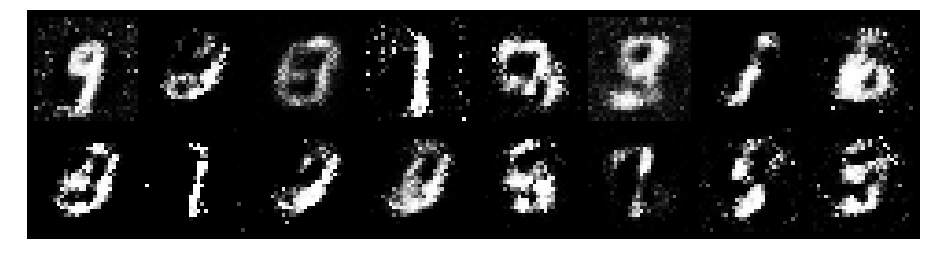

Epoch: [15/200], Batch Num: [100/600]
Discriminator Loss: 1.0370, Generator Loss: 1.3444
D(x): 0.8022, D(G(z)): 0.4270


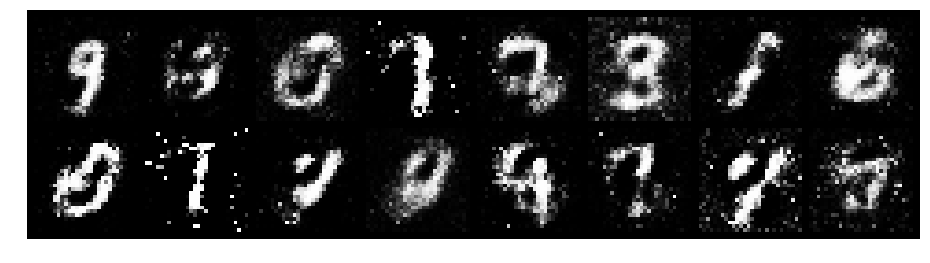

Epoch: [15/200], Batch Num: [200/600]
Discriminator Loss: 1.0196, Generator Loss: 1.9772
D(x): 0.7962, D(G(z)): 0.3414


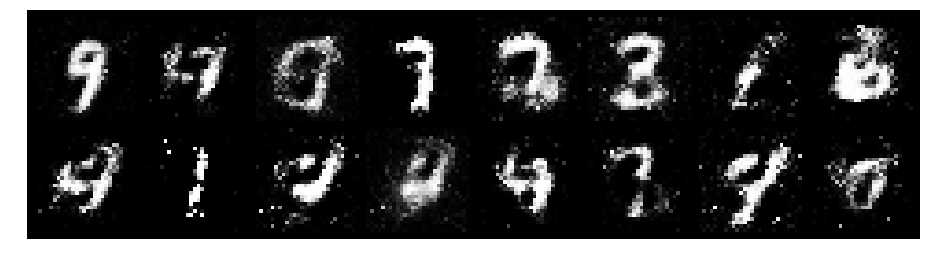

Epoch: [15/200], Batch Num: [300/600]
Discriminator Loss: 0.6143, Generator Loss: 2.0622
D(x): 0.8443, D(G(z)): 0.2386


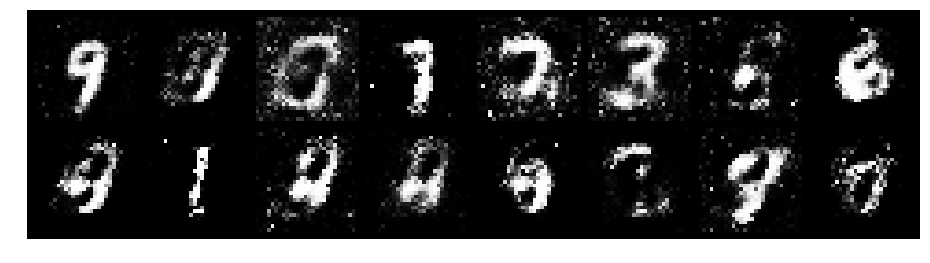

Epoch: [15/200], Batch Num: [400/600]
Discriminator Loss: 0.7221, Generator Loss: 1.5988
D(x): 0.7503, D(G(z)): 0.2586


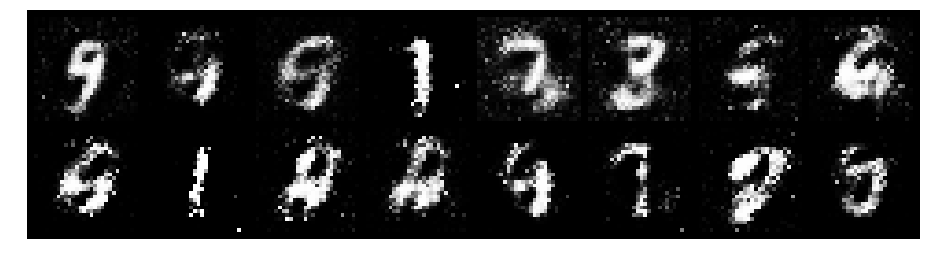

Epoch: [15/200], Batch Num: [500/600]
Discriminator Loss: 0.9970, Generator Loss: 1.3979
D(x): 0.6697, D(G(z)): 0.3214


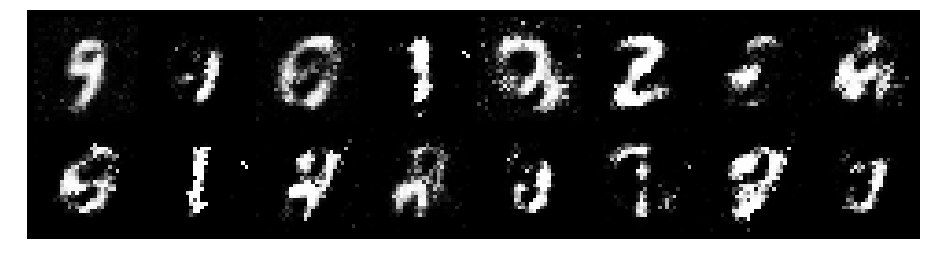

Epoch: [16/200], Batch Num: [0/600]
Discriminator Loss: 1.0295, Generator Loss: 1.1720
D(x): 0.7702, D(G(z)): 0.4299


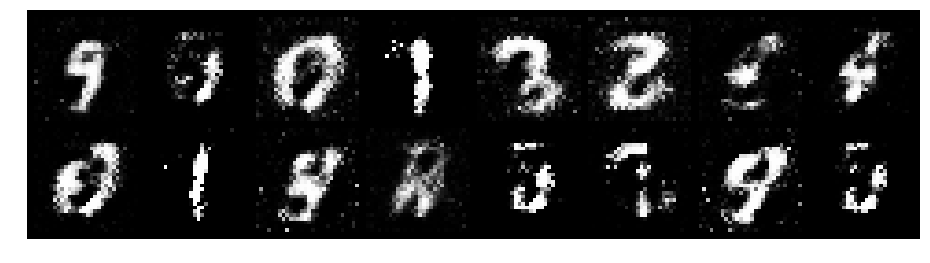

Epoch: [16/200], Batch Num: [100/600]
Discriminator Loss: 0.6651, Generator Loss: 2.0225
D(x): 0.7807, D(G(z)): 0.2495


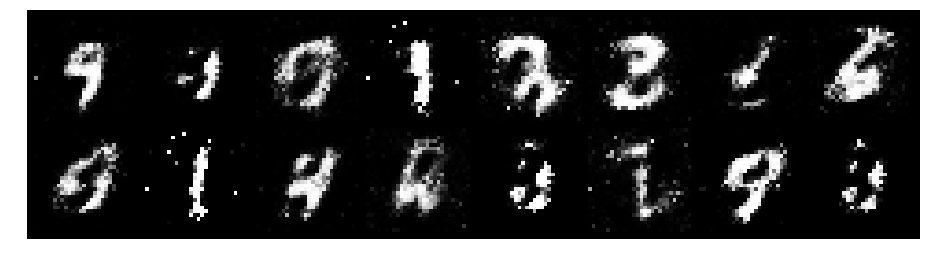

Epoch: [16/200], Batch Num: [200/600]
Discriminator Loss: 0.6379, Generator Loss: 2.7030
D(x): 0.8180, D(G(z)): 0.2363


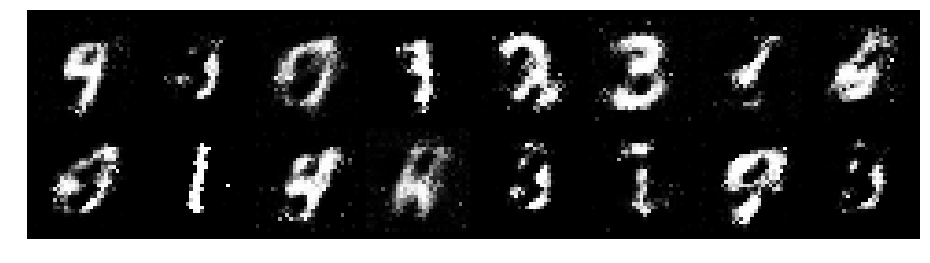

Epoch: [16/200], Batch Num: [300/600]
Discriminator Loss: 0.7131, Generator Loss: 2.0561
D(x): 0.7569, D(G(z)): 0.2446


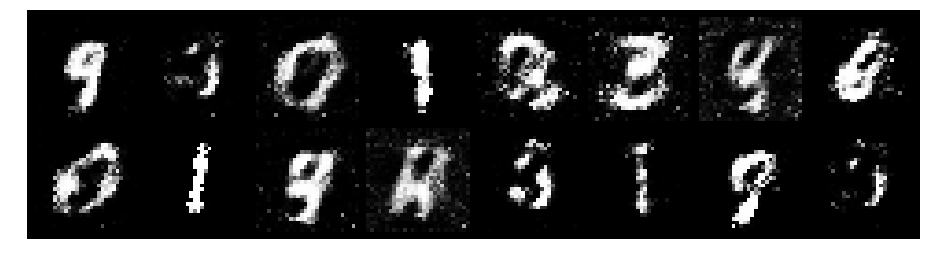

Epoch: [16/200], Batch Num: [400/600]
Discriminator Loss: 0.8366, Generator Loss: 1.8074
D(x): 0.7392, D(G(z)): 0.3022


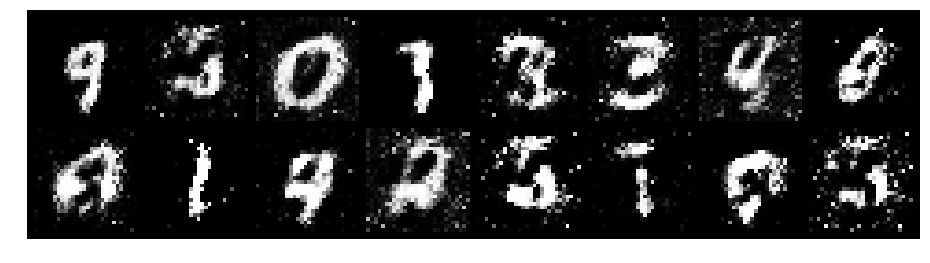

Epoch: [16/200], Batch Num: [500/600]
Discriminator Loss: 0.8359, Generator Loss: 1.5502
D(x): 0.6892, D(G(z)): 0.2748


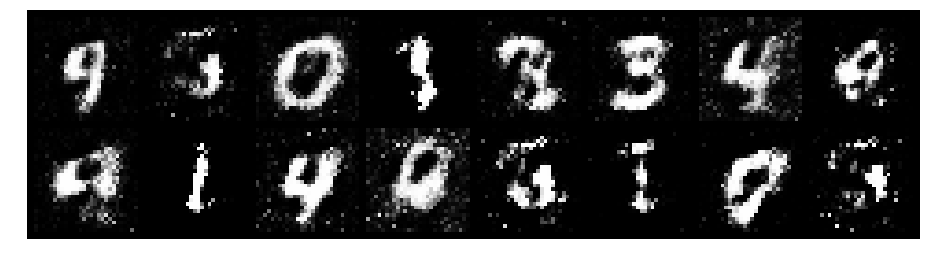

Epoch: [17/200], Batch Num: [0/600]
Discriminator Loss: 0.7709, Generator Loss: 1.6754
D(x): 0.7562, D(G(z)): 0.2678


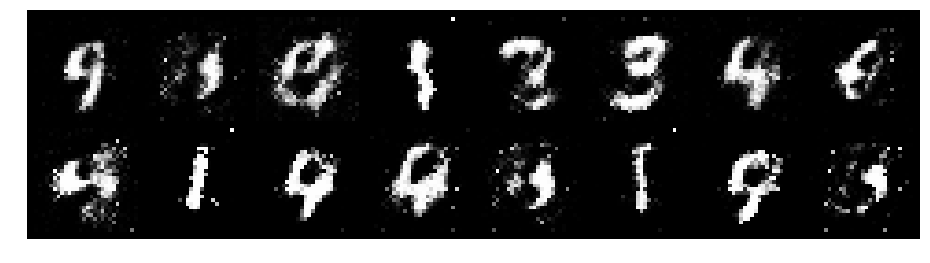

Epoch: [17/200], Batch Num: [100/600]
Discriminator Loss: 1.0572, Generator Loss: 1.6227
D(x): 0.6788, D(G(z)): 0.3198


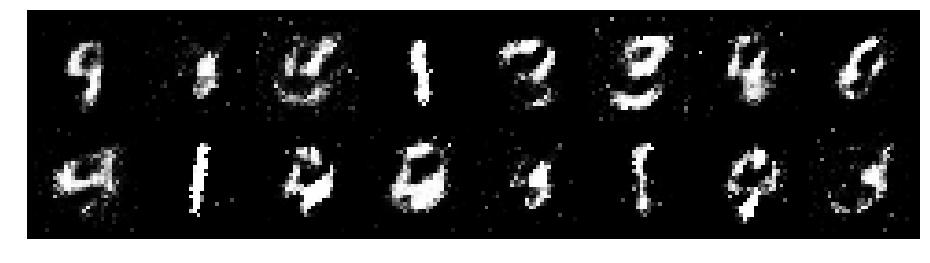

Epoch: [17/200], Batch Num: [200/600]
Discriminator Loss: 0.7653, Generator Loss: 1.7811
D(x): 0.7813, D(G(z)): 0.2706


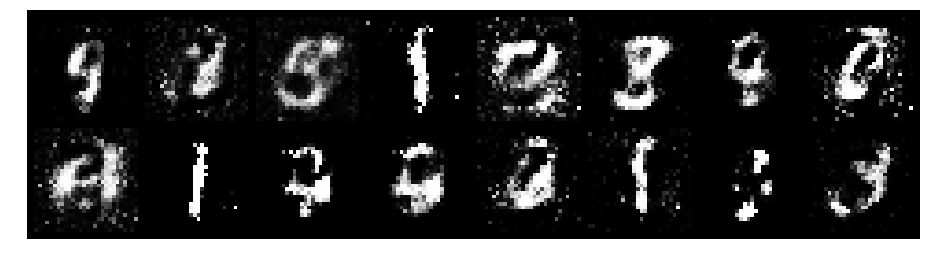

Epoch: [17/200], Batch Num: [300/600]
Discriminator Loss: 0.9742, Generator Loss: 1.4133
D(x): 0.6888, D(G(z)): 0.2908


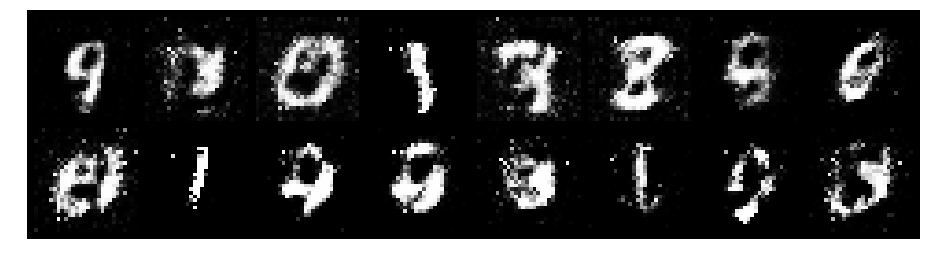

Epoch: [17/200], Batch Num: [400/600]
Discriminator Loss: 0.7907, Generator Loss: 1.4594
D(x): 0.6978, D(G(z)): 0.2444


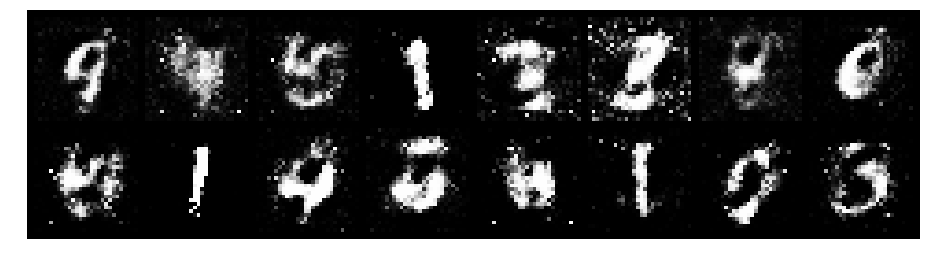

Epoch: [17/200], Batch Num: [500/600]
Discriminator Loss: 1.0173, Generator Loss: 1.4928
D(x): 0.7646, D(G(z)): 0.4078


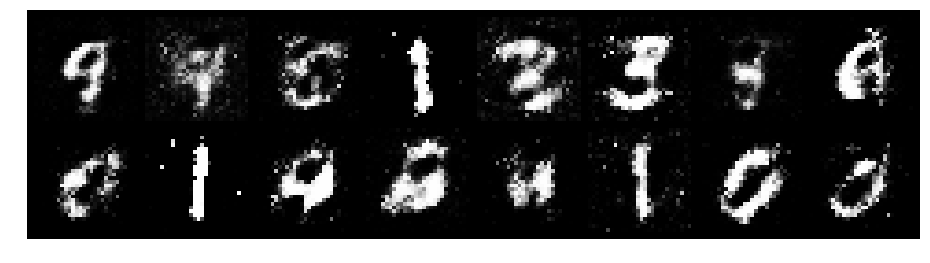

Epoch: [18/200], Batch Num: [0/600]
Discriminator Loss: 1.0180, Generator Loss: 1.2161
D(x): 0.6379, D(G(z)): 0.2870


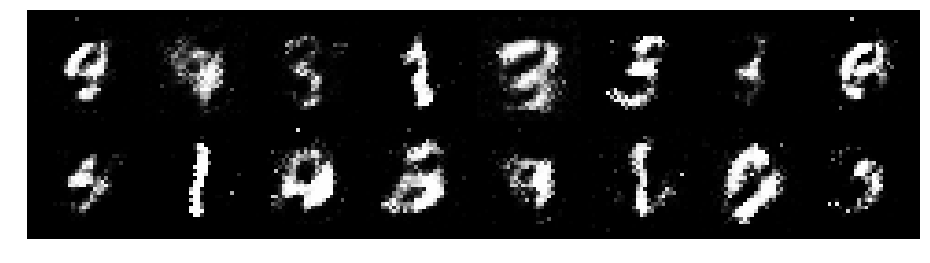

Epoch: [18/200], Batch Num: [100/600]
Discriminator Loss: 0.6868, Generator Loss: 1.9306
D(x): 0.7595, D(G(z)): 0.2343


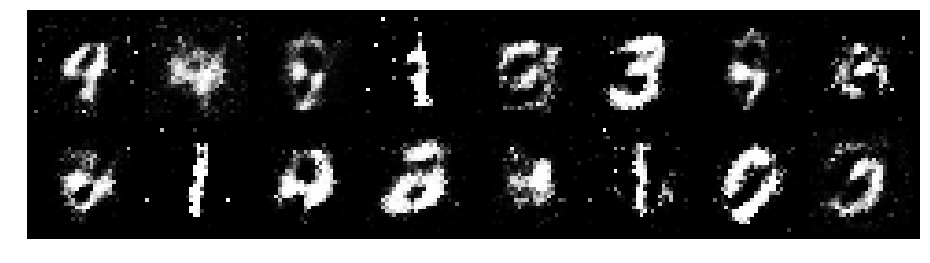

Epoch: [18/200], Batch Num: [200/600]
Discriminator Loss: 0.8993, Generator Loss: 1.4395
D(x): 0.7060, D(G(z)): 0.3109


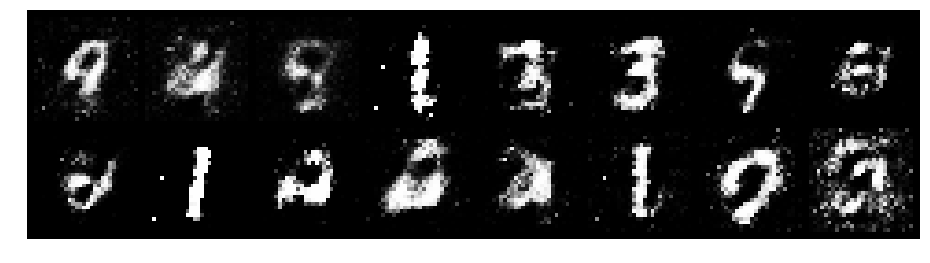

Epoch: [18/200], Batch Num: [300/600]
Discriminator Loss: 0.8415, Generator Loss: 1.5668
D(x): 0.7469, D(G(z)): 0.3399


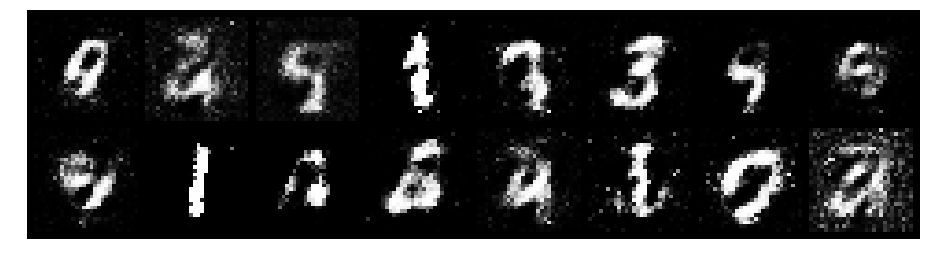

Epoch: [18/200], Batch Num: [400/600]
Discriminator Loss: 0.8419, Generator Loss: 1.7611
D(x): 0.7152, D(G(z)): 0.2510


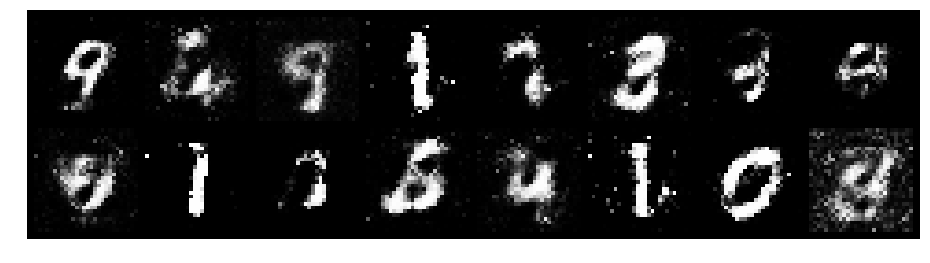

Epoch: [18/200], Batch Num: [500/600]
Discriminator Loss: 0.7835, Generator Loss: 1.5071
D(x): 0.7935, D(G(z)): 0.3347


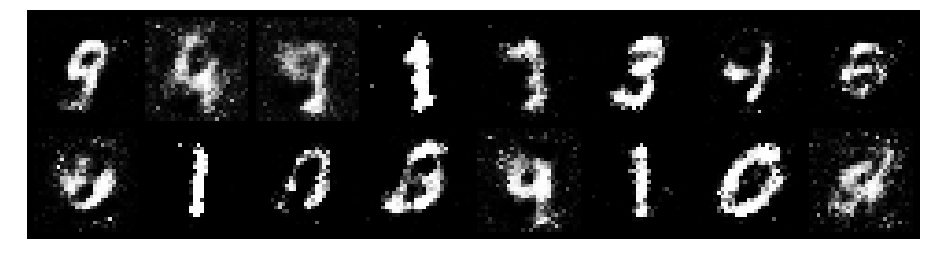

Epoch: [19/200], Batch Num: [0/600]
Discriminator Loss: 0.7644, Generator Loss: 1.6236
D(x): 0.7761, D(G(z)): 0.2878


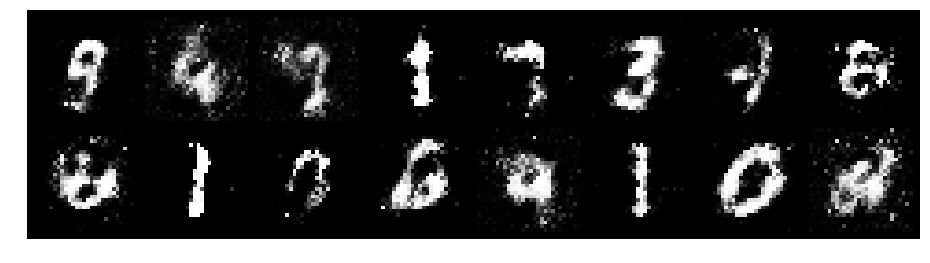

Epoch: [19/200], Batch Num: [100/600]
Discriminator Loss: 0.7396, Generator Loss: 2.3510
D(x): 0.7588, D(G(z)): 0.2141


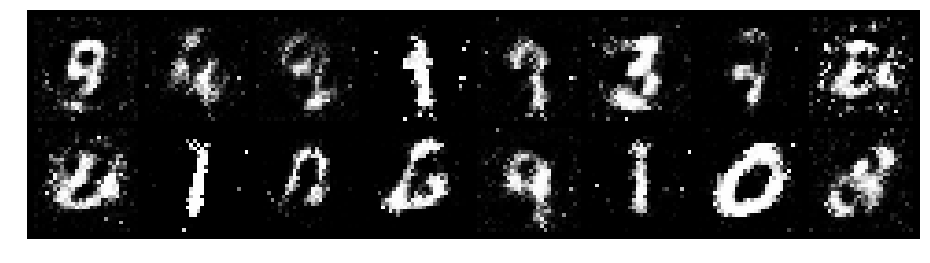

Epoch: [19/200], Batch Num: [200/600]
Discriminator Loss: 0.7830, Generator Loss: 1.6672
D(x): 0.7310, D(G(z)): 0.2737


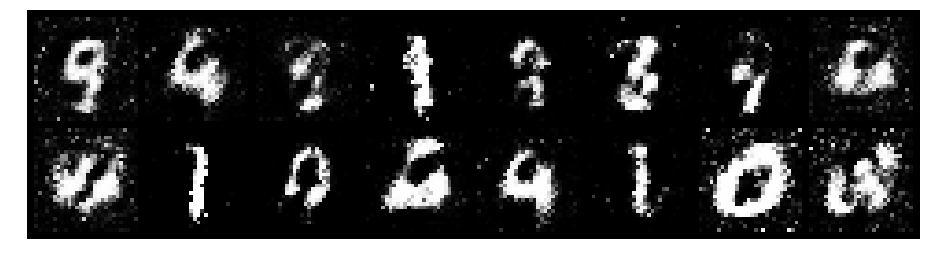

Epoch: [19/200], Batch Num: [300/600]
Discriminator Loss: 0.8577, Generator Loss: 1.6452
D(x): 0.6953, D(G(z)): 0.2741


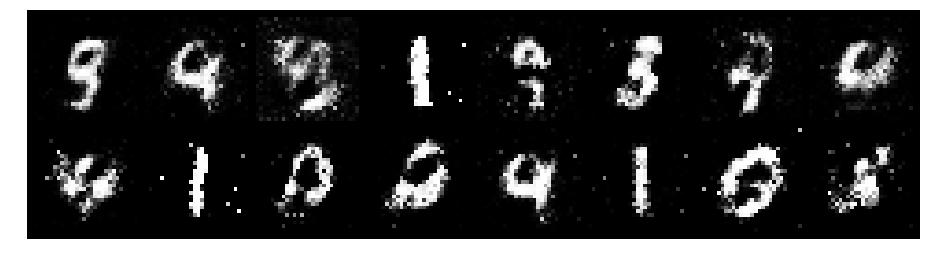

Epoch: [19/200], Batch Num: [400/600]
Discriminator Loss: 0.8194, Generator Loss: 1.6888
D(x): 0.7097, D(G(z)): 0.2601


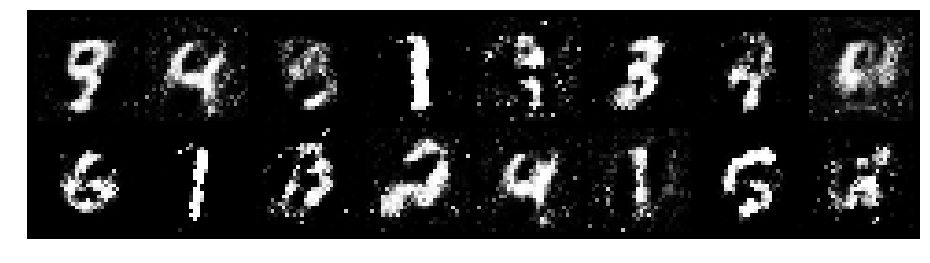

Epoch: [19/200], Batch Num: [500/600]
Discriminator Loss: 1.0153, Generator Loss: 1.7407
D(x): 0.6574, D(G(z)): 0.2899


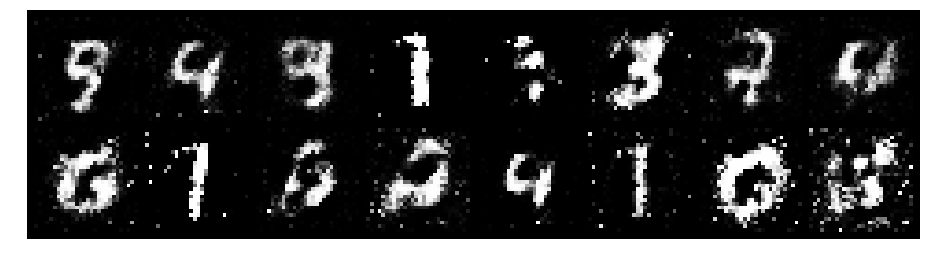

Epoch: [20/200], Batch Num: [0/600]
Discriminator Loss: 1.0970, Generator Loss: 1.3657
D(x): 0.7584, D(G(z)): 0.3857


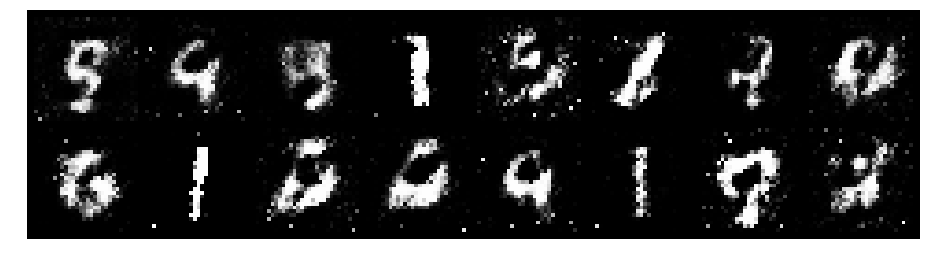

Epoch: [20/200], Batch Num: [100/600]
Discriminator Loss: 0.8958, Generator Loss: 2.4283
D(x): 0.6779, D(G(z)): 0.2427


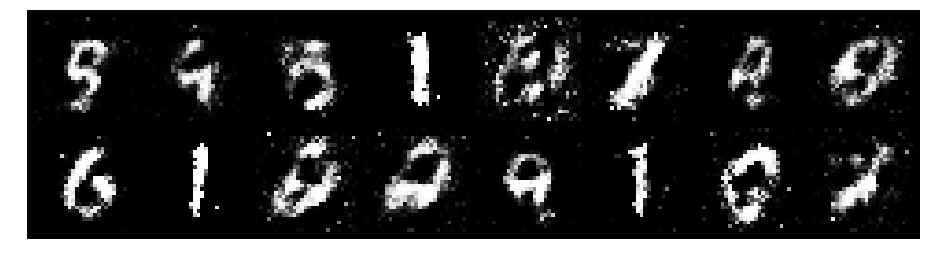

Epoch: [20/200], Batch Num: [200/600]
Discriminator Loss: 0.7323, Generator Loss: 1.5915
D(x): 0.8032, D(G(z)): 0.2852


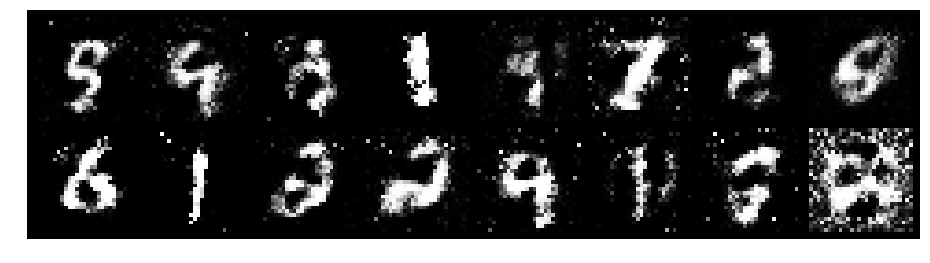

Epoch: [20/200], Batch Num: [300/600]
Discriminator Loss: 0.8262, Generator Loss: 1.8942
D(x): 0.7967, D(G(z)): 0.3170


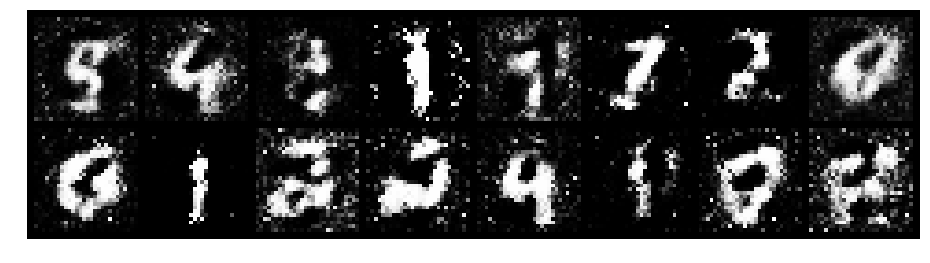

Epoch: [20/200], Batch Num: [400/600]
Discriminator Loss: 0.7299, Generator Loss: 2.0042
D(x): 0.8041, D(G(z)): 0.2665


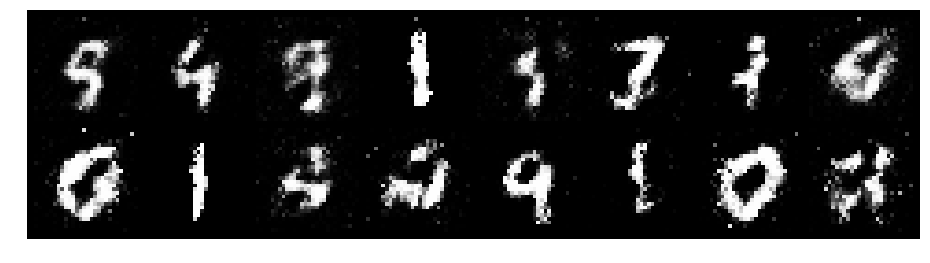

Epoch: [20/200], Batch Num: [500/600]
Discriminator Loss: 0.9637, Generator Loss: 1.3962
D(x): 0.7271, D(G(z)): 0.3182


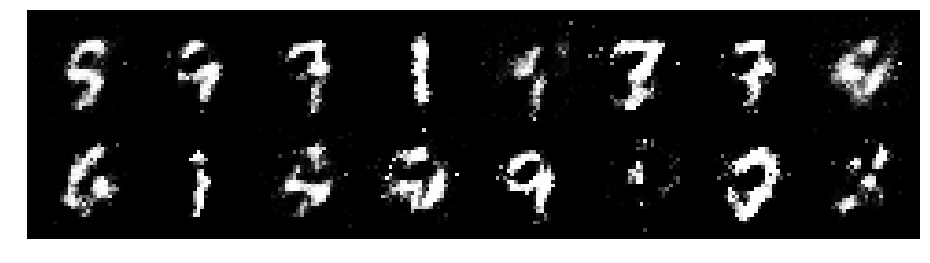

Epoch: [21/200], Batch Num: [0/600]
Discriminator Loss: 0.9664, Generator Loss: 1.4241
D(x): 0.7425, D(G(z)): 0.3231


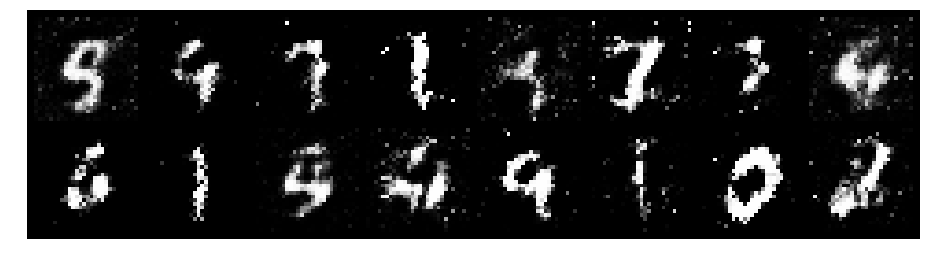

Epoch: [21/200], Batch Num: [100/600]
Discriminator Loss: 0.9775, Generator Loss: 1.3640
D(x): 0.7092, D(G(z)): 0.3053


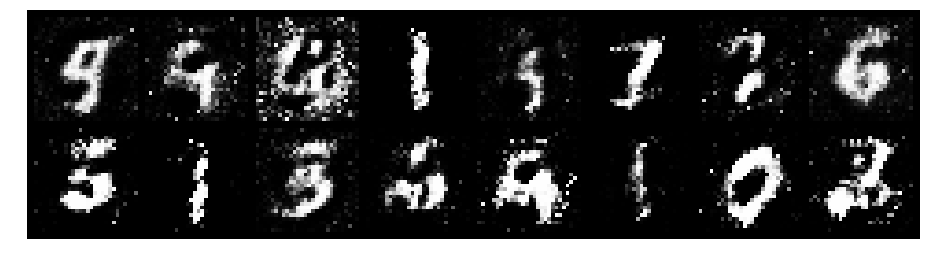

Epoch: [21/200], Batch Num: [200/600]
Discriminator Loss: 0.9739, Generator Loss: 2.1220
D(x): 0.6577, D(G(z)): 0.2427


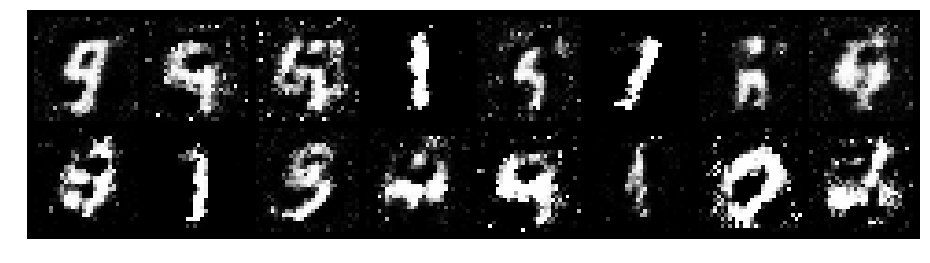

Epoch: [21/200], Batch Num: [300/600]
Discriminator Loss: 0.9866, Generator Loss: 1.4688
D(x): 0.6130, D(G(z)): 0.2531


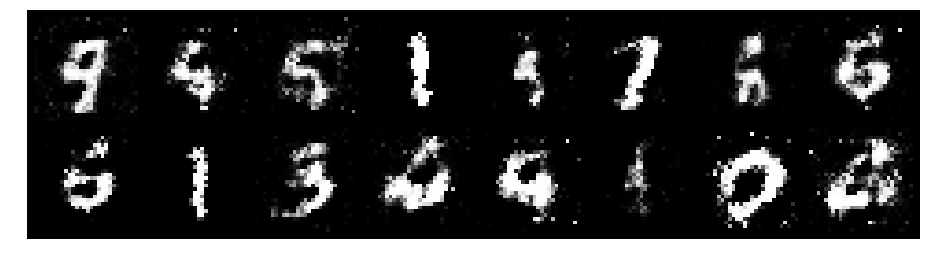

Epoch: [21/200], Batch Num: [400/600]
Discriminator Loss: 0.8011, Generator Loss: 1.8623
D(x): 0.7312, D(G(z)): 0.2667


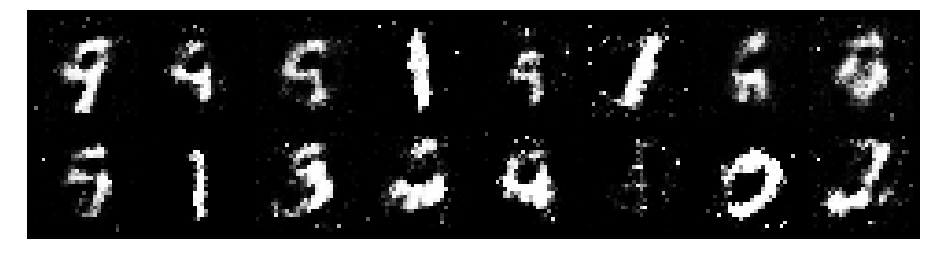

Epoch: [21/200], Batch Num: [500/600]
Discriminator Loss: 0.8379, Generator Loss: 1.8283
D(x): 0.7399, D(G(z)): 0.2915


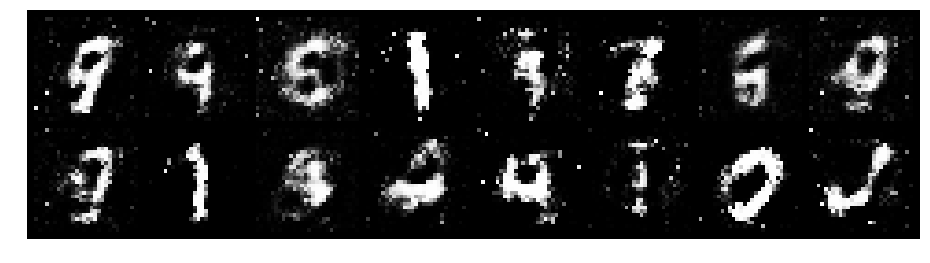

Epoch: [22/200], Batch Num: [0/600]
Discriminator Loss: 1.0481, Generator Loss: 1.0844
D(x): 0.7494, D(G(z)): 0.3865


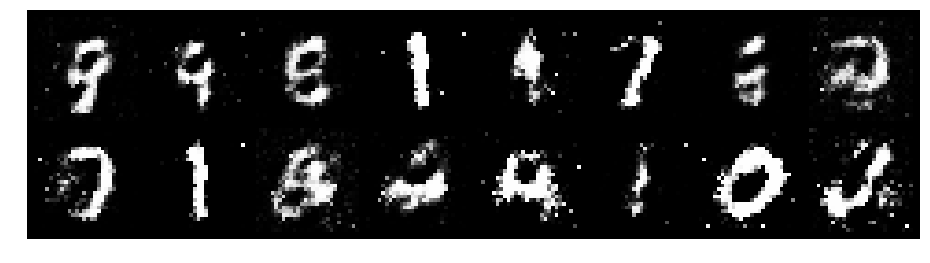

Epoch: [22/200], Batch Num: [100/600]
Discriminator Loss: 0.8304, Generator Loss: 1.8270
D(x): 0.7943, D(G(z)): 0.3170


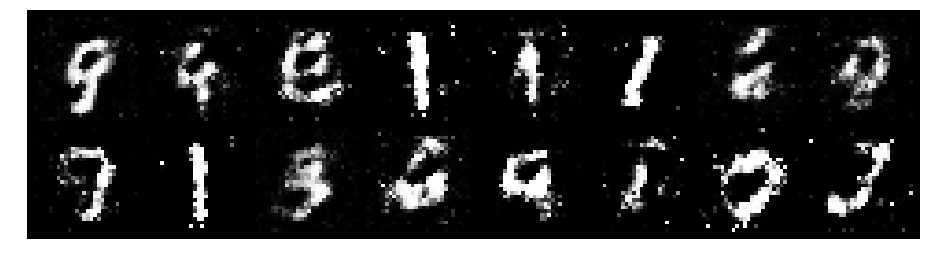

Epoch: [22/200], Batch Num: [200/600]
Discriminator Loss: 0.7943, Generator Loss: 1.8286
D(x): 0.7068, D(G(z)): 0.2561


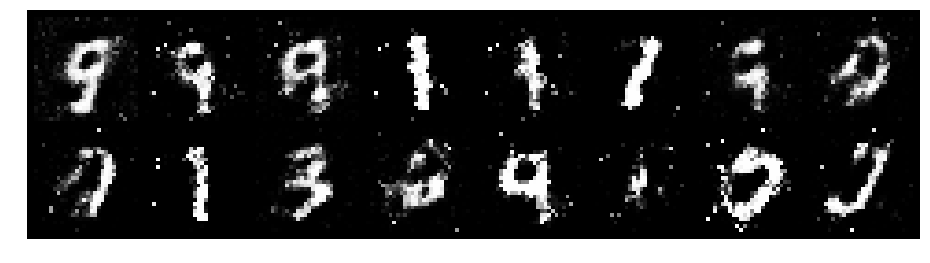

Epoch: [22/200], Batch Num: [300/600]
Discriminator Loss: 0.7748, Generator Loss: 1.8042
D(x): 0.7758, D(G(z)): 0.3227


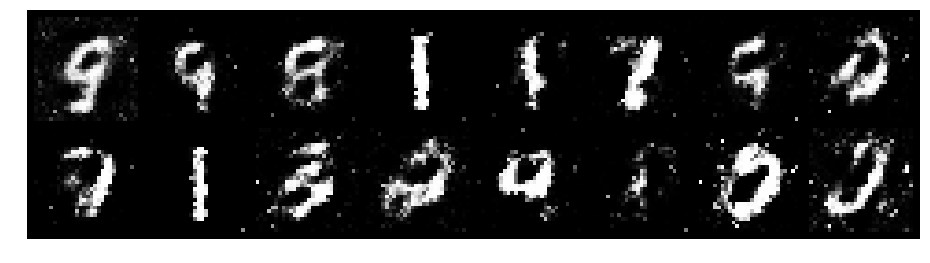

Epoch: [22/200], Batch Num: [400/600]
Discriminator Loss: 0.9033, Generator Loss: 1.4359
D(x): 0.6939, D(G(z)): 0.3145


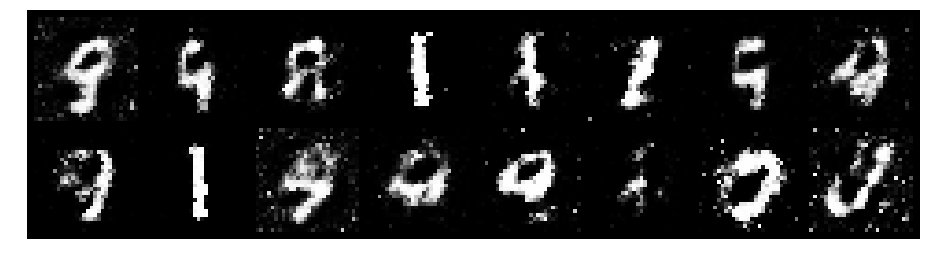

Epoch: [22/200], Batch Num: [500/600]
Discriminator Loss: 0.8470, Generator Loss: 1.5052
D(x): 0.6534, D(G(z)): 0.2405


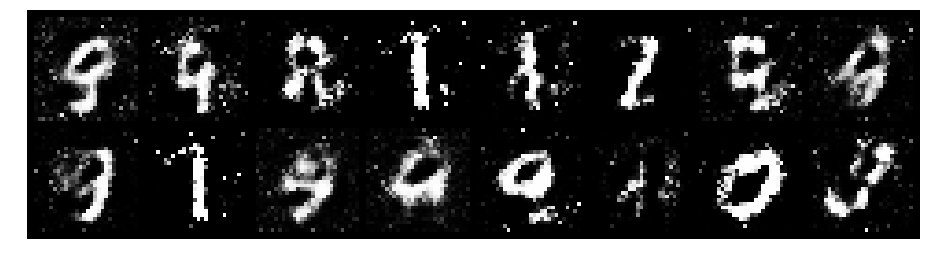

Epoch: [23/200], Batch Num: [0/600]
Discriminator Loss: 0.8271, Generator Loss: 1.4914
D(x): 0.6940, D(G(z)): 0.2976


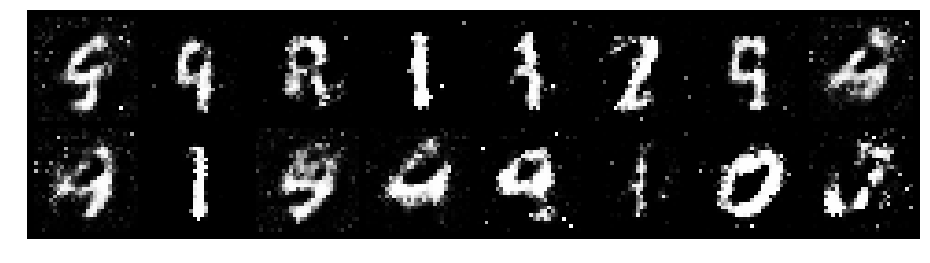

Epoch: [23/200], Batch Num: [100/600]
Discriminator Loss: 0.9008, Generator Loss: 1.4786
D(x): 0.7207, D(G(z)): 0.3585


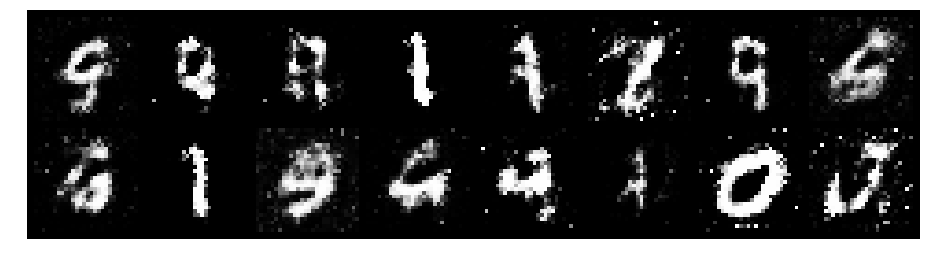

Epoch: [23/200], Batch Num: [200/600]
Discriminator Loss: 0.8607, Generator Loss: 1.7811
D(x): 0.7181, D(G(z)): 0.2964


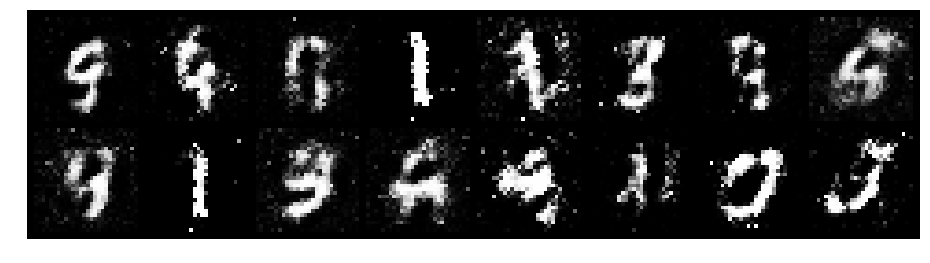

Epoch: [23/200], Batch Num: [300/600]
Discriminator Loss: 0.9436, Generator Loss: 1.2742
D(x): 0.7044, D(G(z)): 0.3491


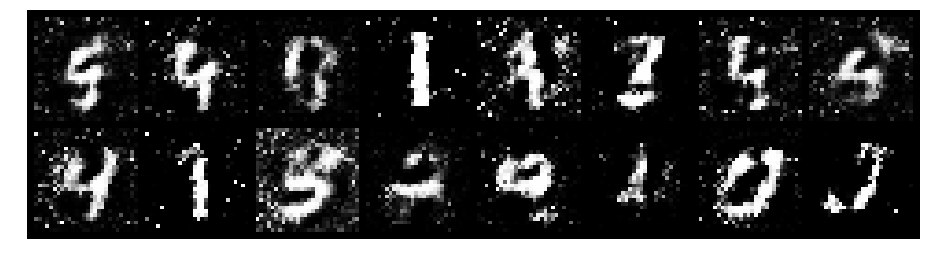

Epoch: [23/200], Batch Num: [400/600]
Discriminator Loss: 1.0187, Generator Loss: 1.2856
D(x): 0.6731, D(G(z)): 0.3558


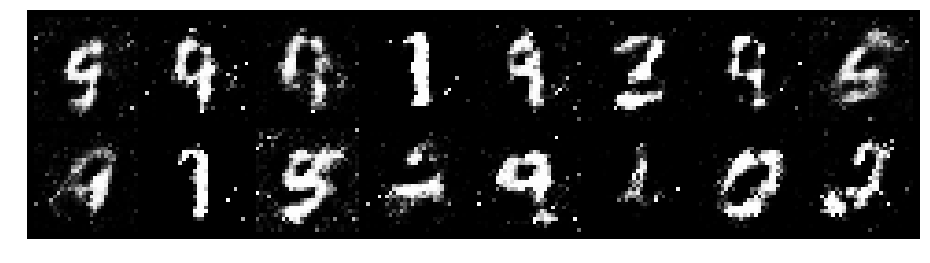

Epoch: [23/200], Batch Num: [500/600]
Discriminator Loss: 0.7802, Generator Loss: 1.6048
D(x): 0.6940, D(G(z)): 0.2338


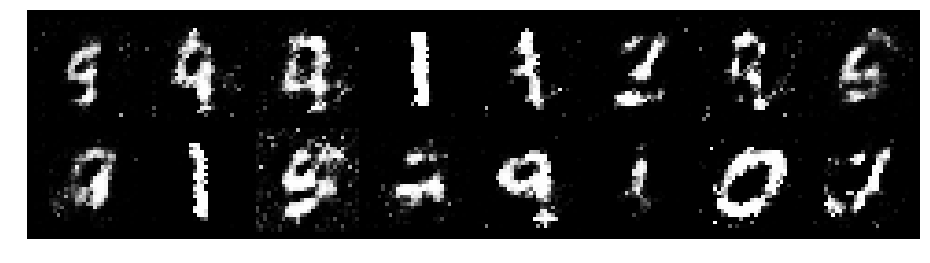

Epoch: [24/200], Batch Num: [0/600]
Discriminator Loss: 0.8858, Generator Loss: 1.7005
D(x): 0.6605, D(G(z)): 0.2385


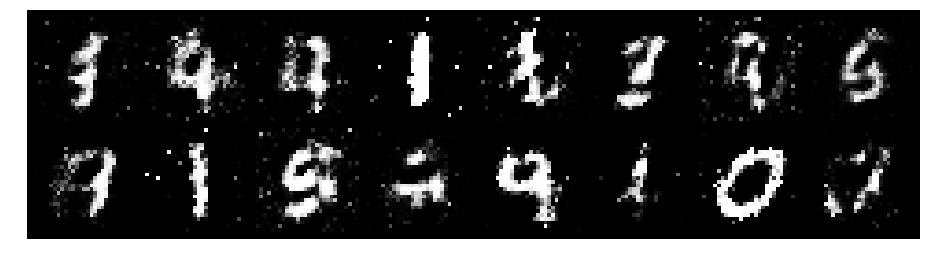

Epoch: [24/200], Batch Num: [100/600]
Discriminator Loss: 0.8842, Generator Loss: 1.3065
D(x): 0.7118, D(G(z)): 0.2965


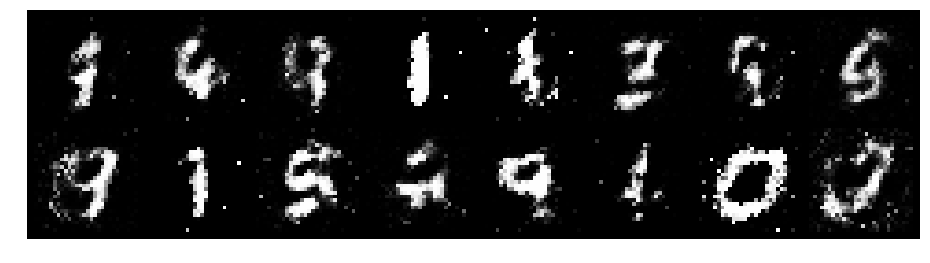

Epoch: [24/200], Batch Num: [200/600]
Discriminator Loss: 0.9727, Generator Loss: 1.2986
D(x): 0.6381, D(G(z)): 0.3148


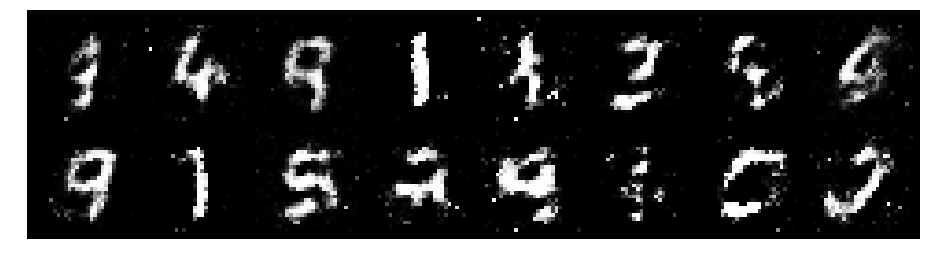

Epoch: [24/200], Batch Num: [300/600]
Discriminator Loss: 0.8340, Generator Loss: 1.4590
D(x): 0.7241, D(G(z)): 0.2984


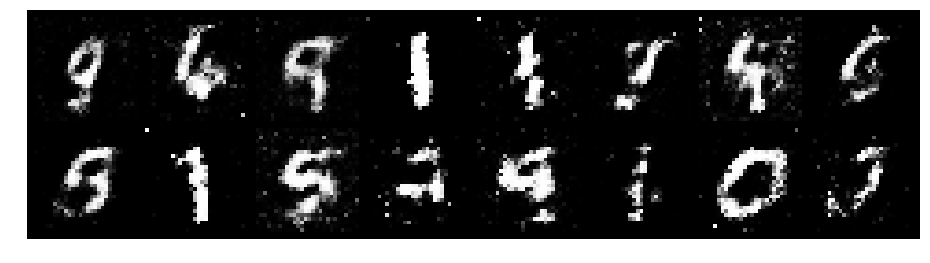

Epoch: [24/200], Batch Num: [400/600]
Discriminator Loss: 0.8544, Generator Loss: 1.2253
D(x): 0.7212, D(G(z)): 0.3124


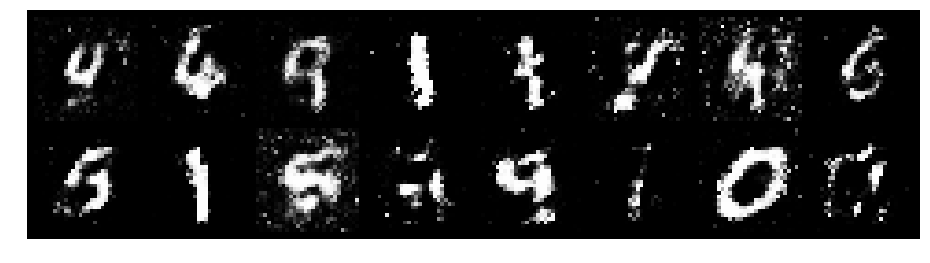

Epoch: [24/200], Batch Num: [500/600]
Discriminator Loss: 0.9227, Generator Loss: 1.4699
D(x): 0.6879, D(G(z)): 0.3178


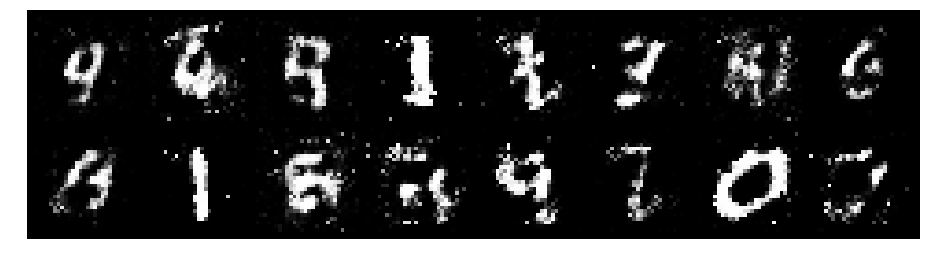

Epoch: [25/200], Batch Num: [0/600]
Discriminator Loss: 0.7998, Generator Loss: 1.5774
D(x): 0.7256, D(G(z)): 0.3061


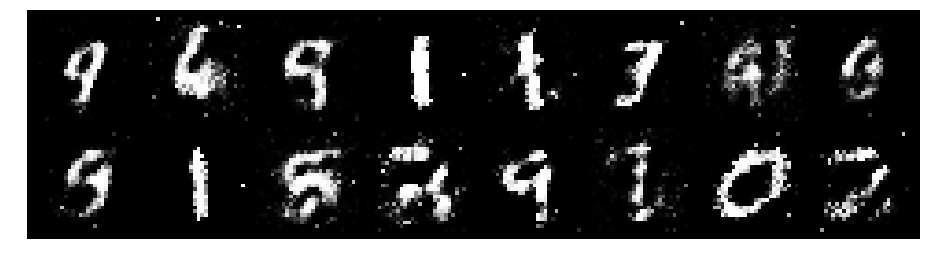

Epoch: [25/200], Batch Num: [100/600]
Discriminator Loss: 0.9299, Generator Loss: 1.2902
D(x): 0.7001, D(G(z)): 0.3487


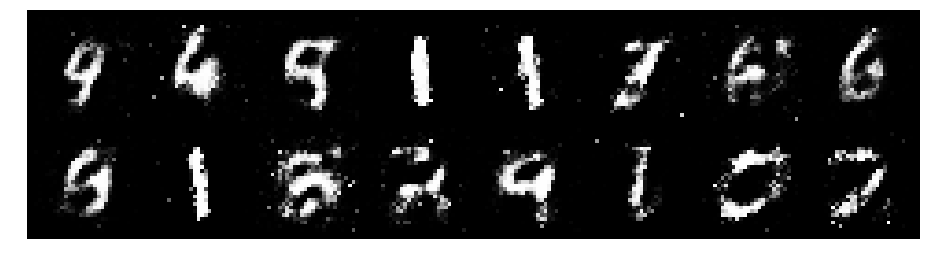

Epoch: [25/200], Batch Num: [200/600]
Discriminator Loss: 0.9853, Generator Loss: 1.2536
D(x): 0.7046, D(G(z)): 0.3997


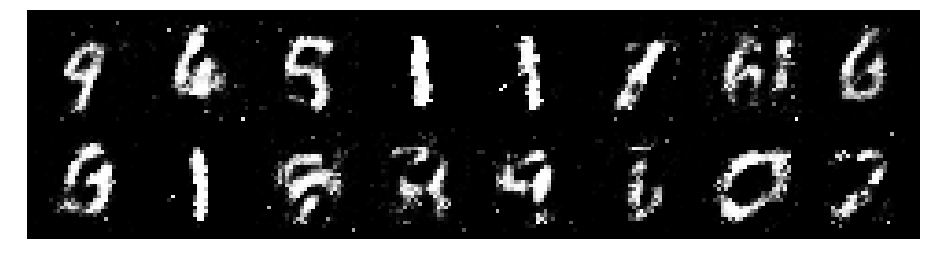

Epoch: [25/200], Batch Num: [300/600]
Discriminator Loss: 1.0109, Generator Loss: 1.3522
D(x): 0.6997, D(G(z)): 0.3858


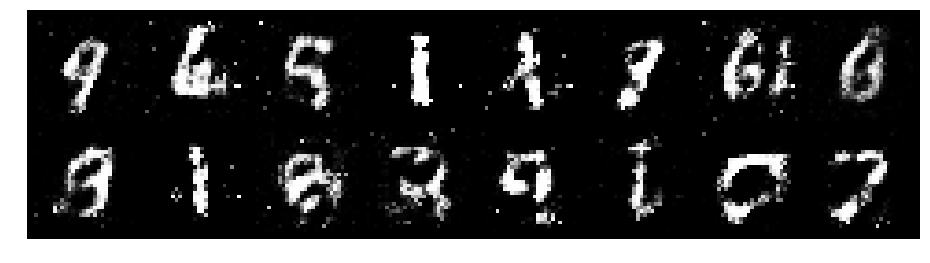

Epoch: [25/200], Batch Num: [400/600]
Discriminator Loss: 0.9037, Generator Loss: 1.2758
D(x): 0.6521, D(G(z)): 0.2907


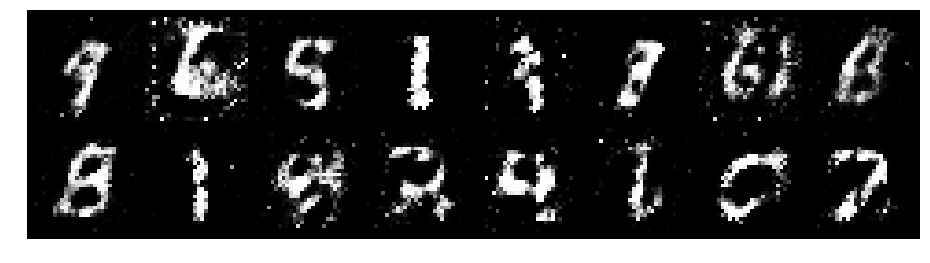

Epoch: [25/200], Batch Num: [500/600]
Discriminator Loss: 1.0134, Generator Loss: 1.0276
D(x): 0.6832, D(G(z)): 0.3951


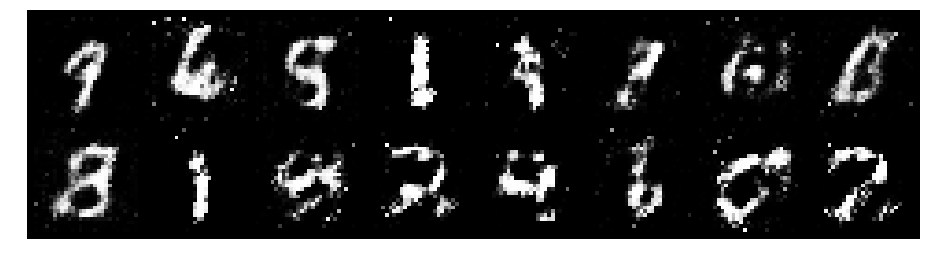

Epoch: [26/200], Batch Num: [0/600]
Discriminator Loss: 0.9646, Generator Loss: 1.4166
D(x): 0.6761, D(G(z)): 0.3082


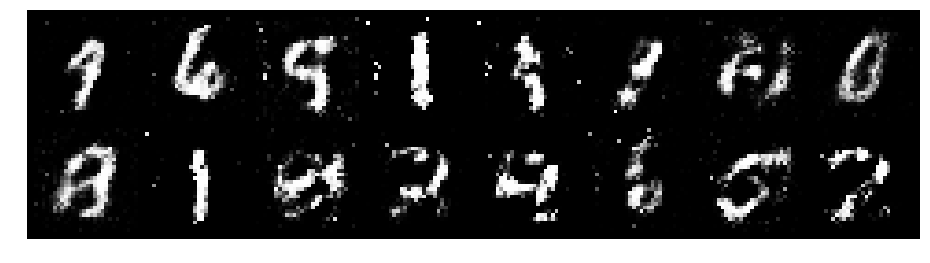

Epoch: [26/200], Batch Num: [100/600]
Discriminator Loss: 1.0274, Generator Loss: 1.3586
D(x): 0.6730, D(G(z)): 0.3441


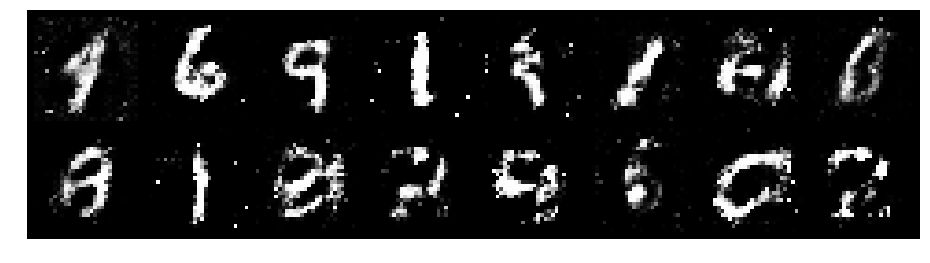

Epoch: [26/200], Batch Num: [200/600]
Discriminator Loss: 0.9280, Generator Loss: 1.3494
D(x): 0.6437, D(G(z)): 0.2718


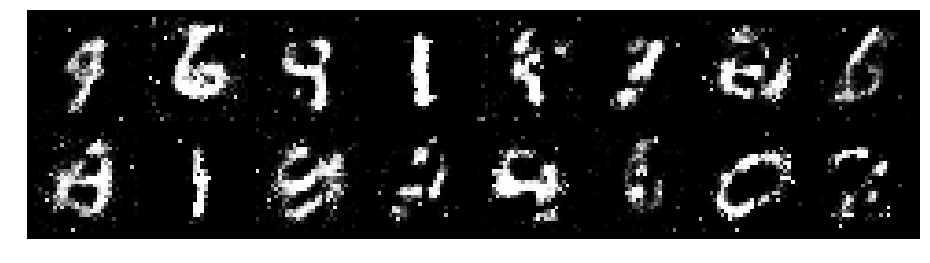

Epoch: [26/200], Batch Num: [300/600]
Discriminator Loss: 1.1294, Generator Loss: 1.1174
D(x): 0.6147, D(G(z)): 0.3391


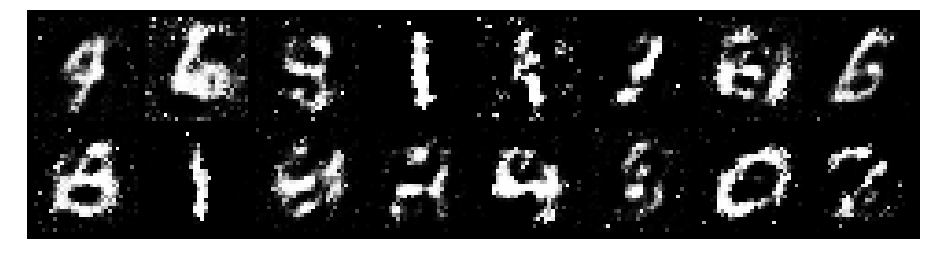

Epoch: [26/200], Batch Num: [400/600]
Discriminator Loss: 1.0522, Generator Loss: 1.2243
D(x): 0.6859, D(G(z)): 0.3840


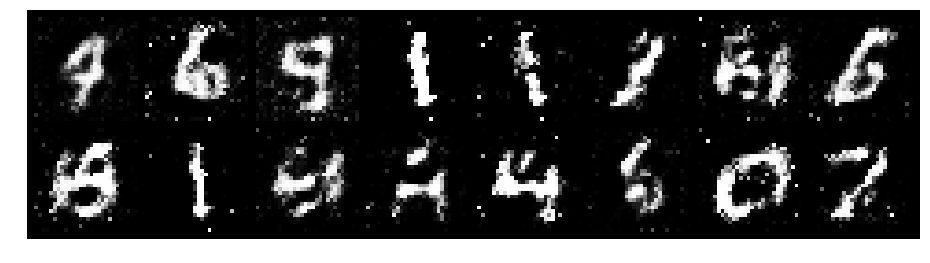

Epoch: [26/200], Batch Num: [500/600]
Discriminator Loss: 1.0233, Generator Loss: 1.1358
D(x): 0.6429, D(G(z)): 0.3369


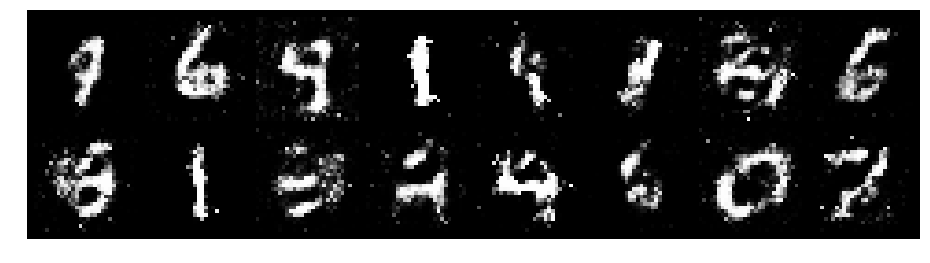

Epoch: [27/200], Batch Num: [0/600]
Discriminator Loss: 1.0464, Generator Loss: 1.3115
D(x): 0.6647, D(G(z)): 0.3716


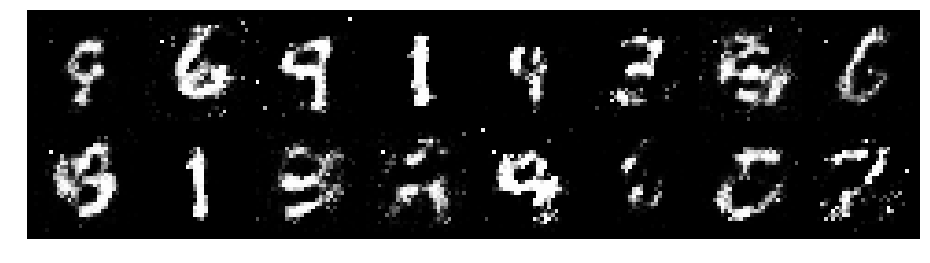

Epoch: [27/200], Batch Num: [100/600]
Discriminator Loss: 1.0332, Generator Loss: 1.1275
D(x): 0.6936, D(G(z)): 0.4233


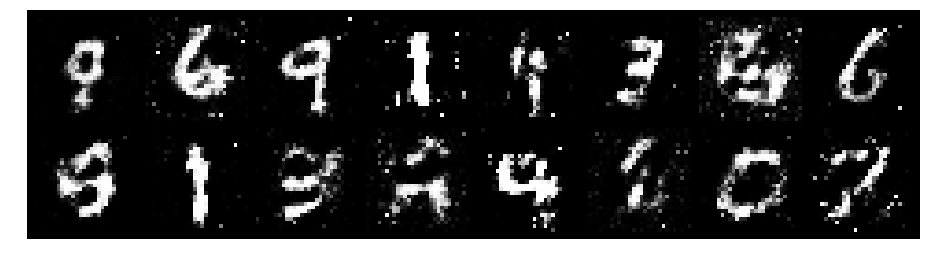

Epoch: [27/200], Batch Num: [200/600]
Discriminator Loss: 1.0357, Generator Loss: 1.4570
D(x): 0.5584, D(G(z)): 0.2506


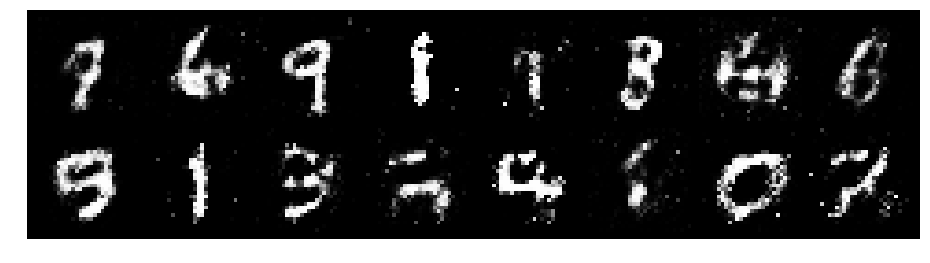

Epoch: [27/200], Batch Num: [300/600]
Discriminator Loss: 1.0997, Generator Loss: 1.5905
D(x): 0.6006, D(G(z)): 0.3087


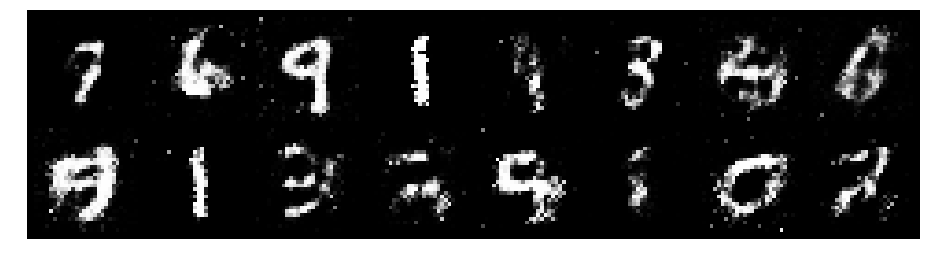

Epoch: [27/200], Batch Num: [400/600]
Discriminator Loss: 1.0225, Generator Loss: 1.2907
D(x): 0.6336, D(G(z)): 0.3506


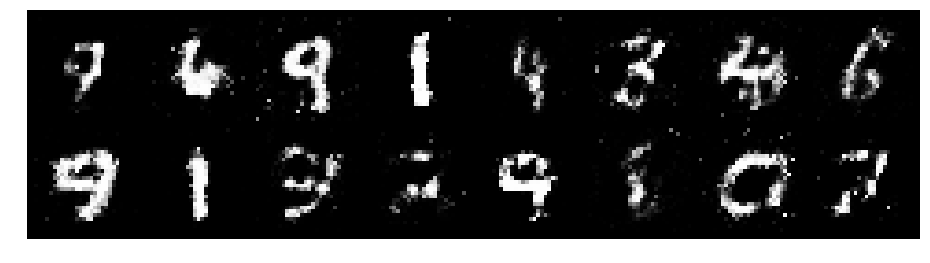

Epoch: [27/200], Batch Num: [500/600]
Discriminator Loss: 1.0260, Generator Loss: 1.1141
D(x): 0.6815, D(G(z)): 0.4049


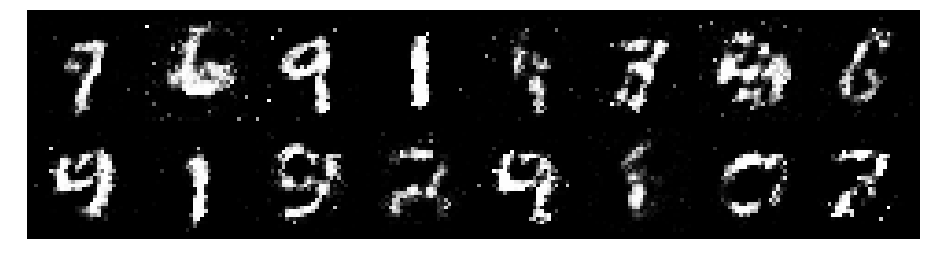

Epoch: [28/200], Batch Num: [0/600]
Discriminator Loss: 0.8959, Generator Loss: 1.6866
D(x): 0.6789, D(G(z)): 0.2729


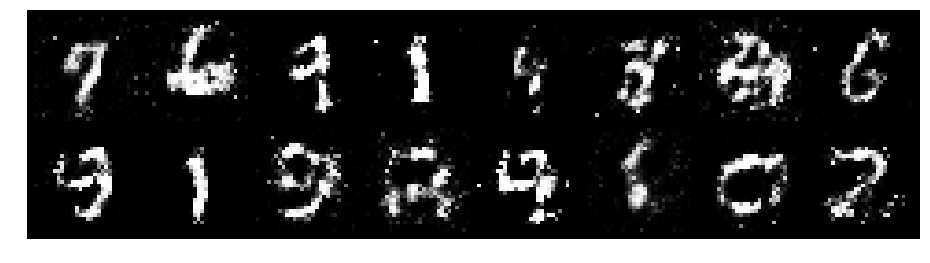

Epoch: [28/200], Batch Num: [100/600]
Discriminator Loss: 1.1508, Generator Loss: 1.4852
D(x): 0.6036, D(G(z)): 0.3408


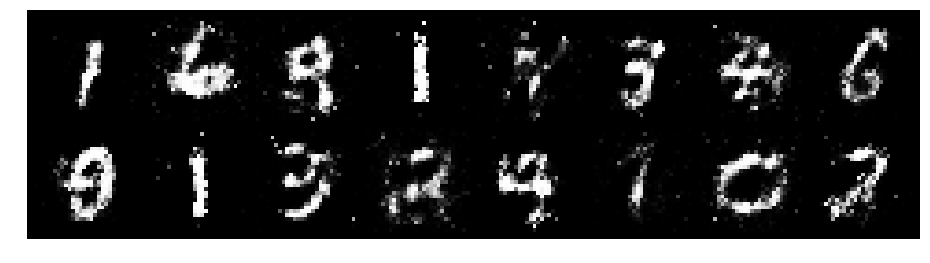

Epoch: [28/200], Batch Num: [200/600]
Discriminator Loss: 0.8213, Generator Loss: 1.4324
D(x): 0.7602, D(G(z)): 0.3272


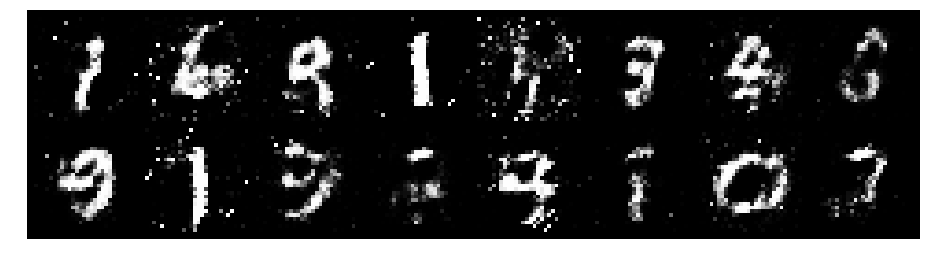

Epoch: [28/200], Batch Num: [300/600]
Discriminator Loss: 1.0355, Generator Loss: 1.5389
D(x): 0.6593, D(G(z)): 0.3422


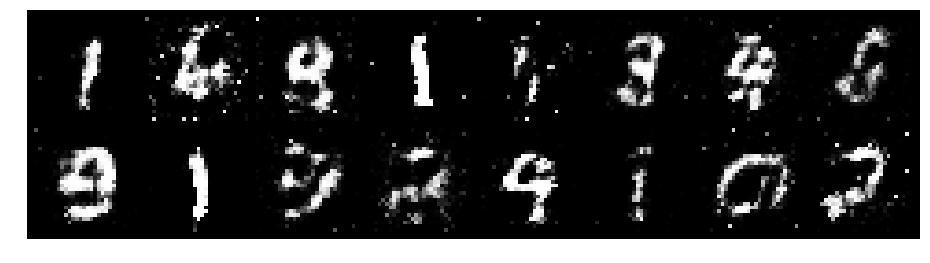

Epoch: [28/200], Batch Num: [400/600]
Discriminator Loss: 0.8647, Generator Loss: 1.2666
D(x): 0.6715, D(G(z)): 0.2923


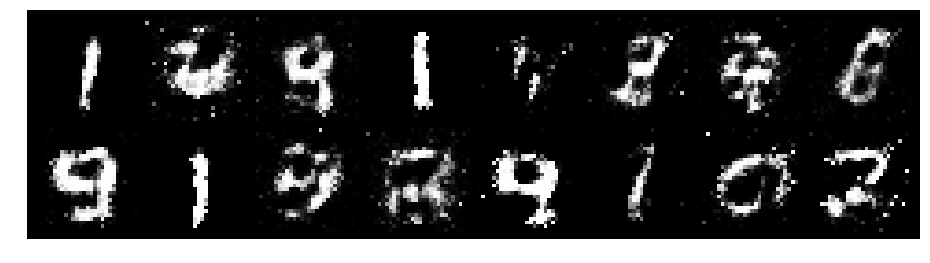

Epoch: [28/200], Batch Num: [500/600]
Discriminator Loss: 0.9307, Generator Loss: 1.4525
D(x): 0.6739, D(G(z)): 0.3095


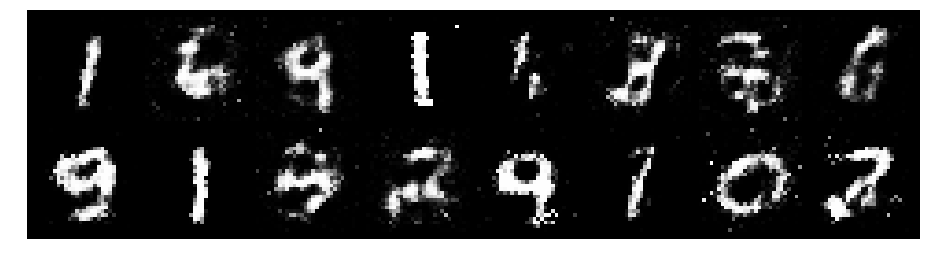

Epoch: [29/200], Batch Num: [0/600]
Discriminator Loss: 1.1021, Generator Loss: 1.3411
D(x): 0.7137, D(G(z)): 0.4059


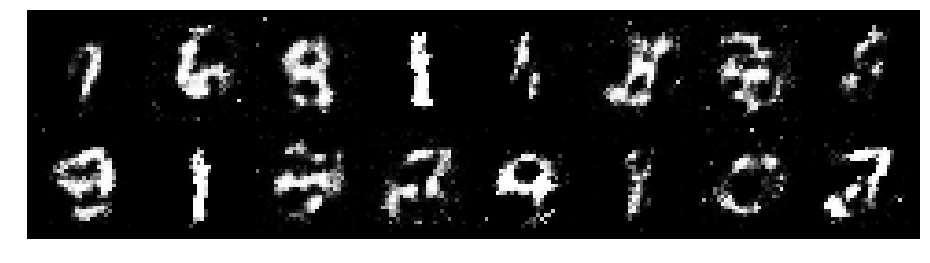

Epoch: [29/200], Batch Num: [100/600]
Discriminator Loss: 0.9764, Generator Loss: 1.3089
D(x): 0.6424, D(G(z)): 0.2879


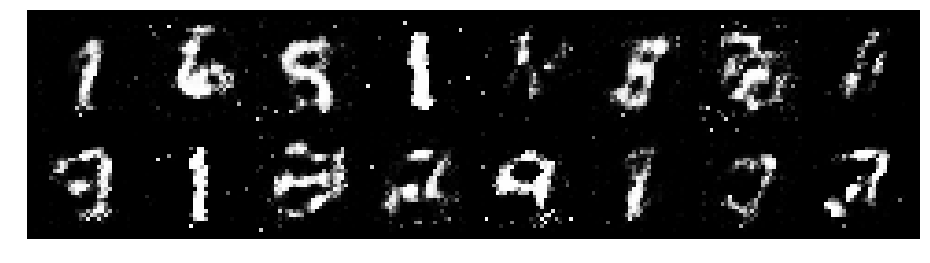

Epoch: [29/200], Batch Num: [200/600]
Discriminator Loss: 0.7503, Generator Loss: 1.7325
D(x): 0.7289, D(G(z)): 0.2368


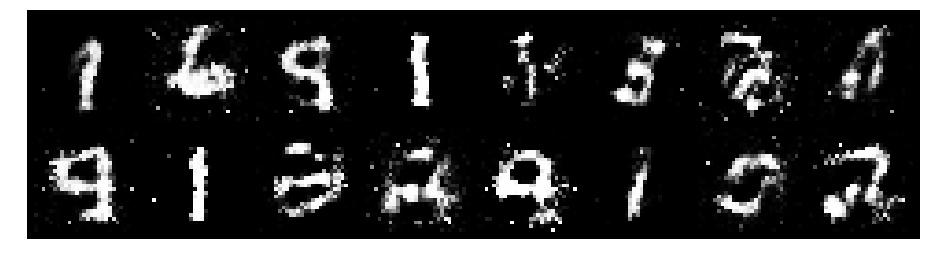

Epoch: [29/200], Batch Num: [300/600]
Discriminator Loss: 0.9499, Generator Loss: 1.3837
D(x): 0.7243, D(G(z)): 0.3527


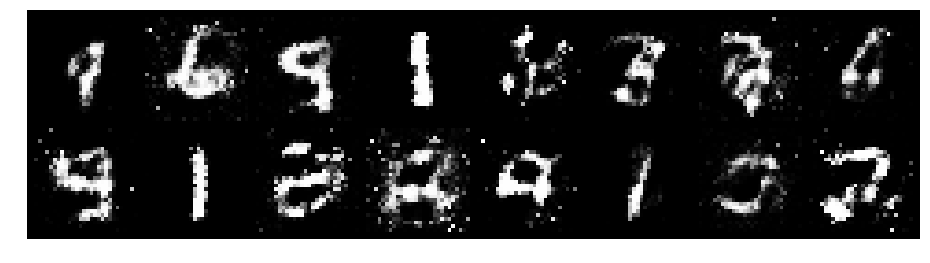

Epoch: [29/200], Batch Num: [400/600]
Discriminator Loss: 1.0457, Generator Loss: 1.3474
D(x): 0.6079, D(G(z)): 0.2782


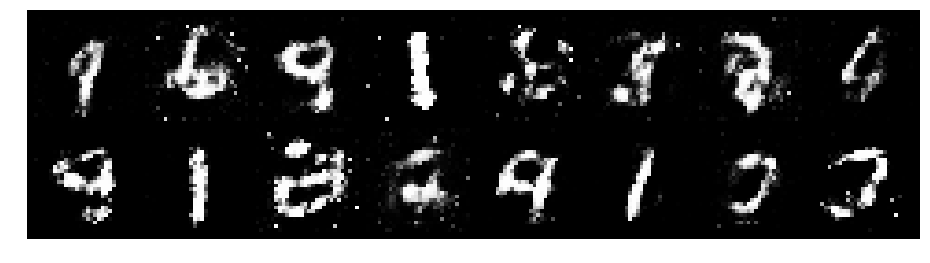

Epoch: [29/200], Batch Num: [500/600]
Discriminator Loss: 0.8790, Generator Loss: 1.5739
D(x): 0.7668, D(G(z)): 0.3709


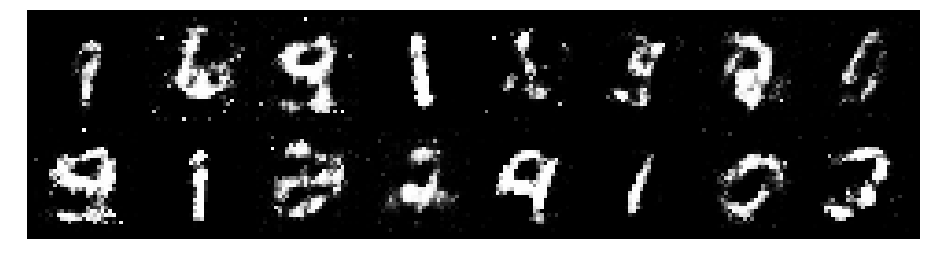

Epoch: [30/200], Batch Num: [0/600]
Discriminator Loss: 0.9074, Generator Loss: 1.4012
D(x): 0.6768, D(G(z)): 0.2965


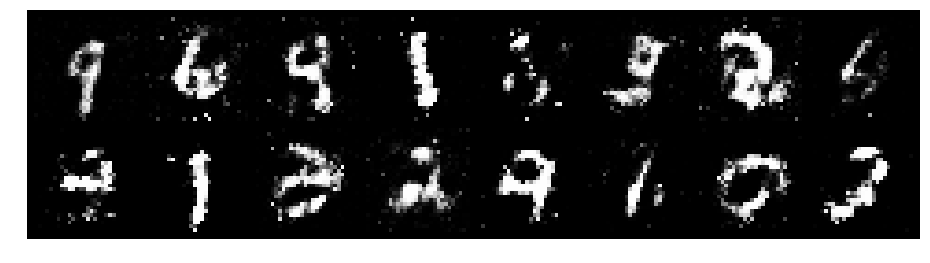

Epoch: [30/200], Batch Num: [100/600]
Discriminator Loss: 1.0988, Generator Loss: 0.9945
D(x): 0.6032, D(G(z)): 0.3919


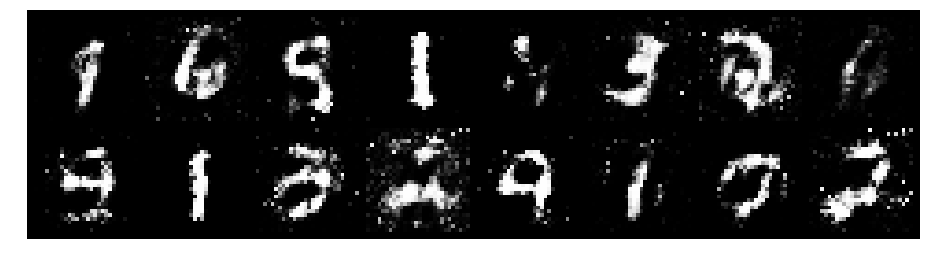

Epoch: [30/200], Batch Num: [200/600]
Discriminator Loss: 1.1474, Generator Loss: 1.2085
D(x): 0.6569, D(G(z)): 0.4120


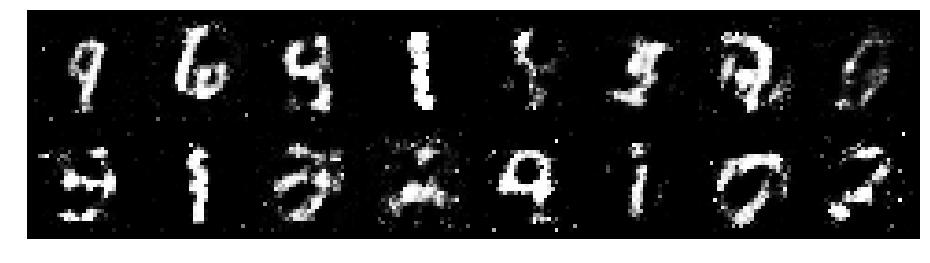

Epoch: [30/200], Batch Num: [300/600]
Discriminator Loss: 1.0489, Generator Loss: 1.0857
D(x): 0.6739, D(G(z)): 0.3889


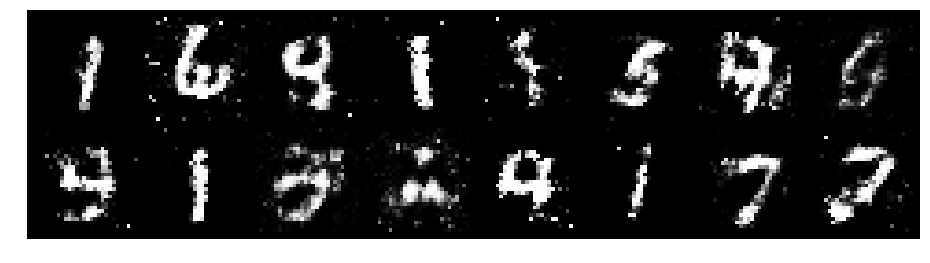

Epoch: [30/200], Batch Num: [400/600]
Discriminator Loss: 0.8489, Generator Loss: 1.3861
D(x): 0.6870, D(G(z)): 0.2660


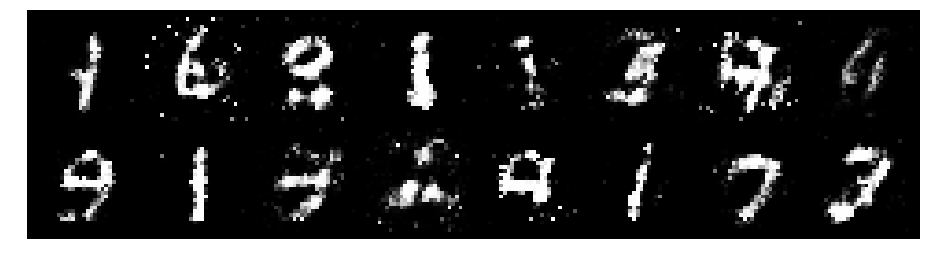

Epoch: [30/200], Batch Num: [500/600]
Discriminator Loss: 0.7780, Generator Loss: 1.3976
D(x): 0.7304, D(G(z)): 0.2896


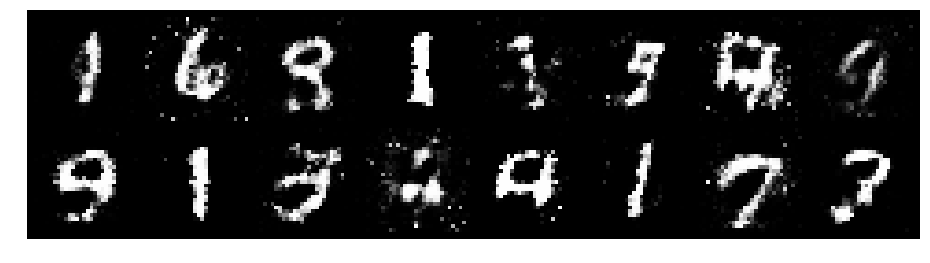

Epoch: [31/200], Batch Num: [0/600]
Discriminator Loss: 0.9795, Generator Loss: 1.1598
D(x): 0.7220, D(G(z)): 0.3923


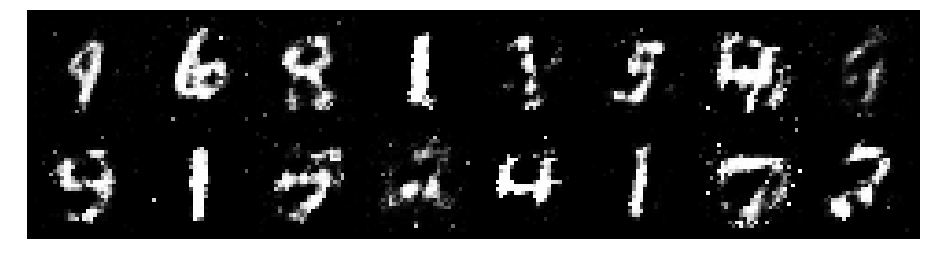

Epoch: [31/200], Batch Num: [100/600]
Discriminator Loss: 1.0123, Generator Loss: 0.9574
D(x): 0.7071, D(G(z)): 0.3888


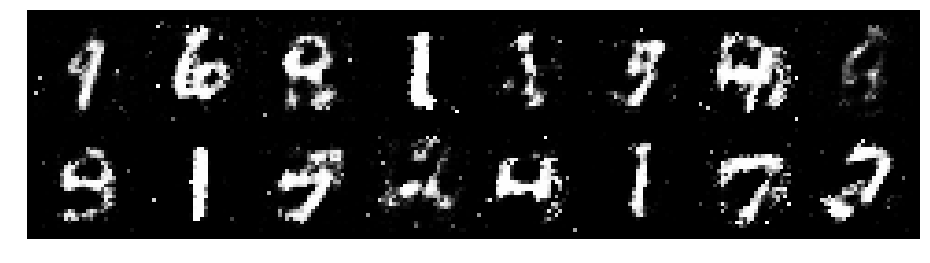

Epoch: [31/200], Batch Num: [200/600]
Discriminator Loss: 0.9914, Generator Loss: 1.2532
D(x): 0.7544, D(G(z)): 0.4180


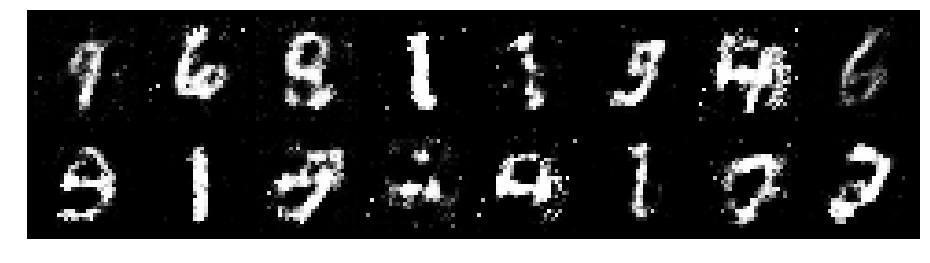

Epoch: [31/200], Batch Num: [300/600]
Discriminator Loss: 1.1525, Generator Loss: 1.1004
D(x): 0.6319, D(G(z)): 0.3750


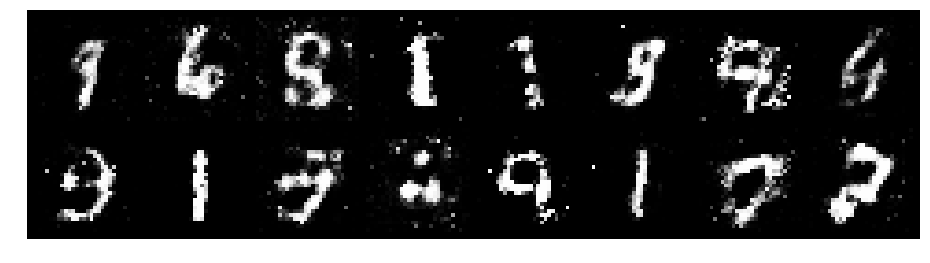

Epoch: [31/200], Batch Num: [400/600]
Discriminator Loss: 1.0829, Generator Loss: 1.3919
D(x): 0.6179, D(G(z)): 0.3228


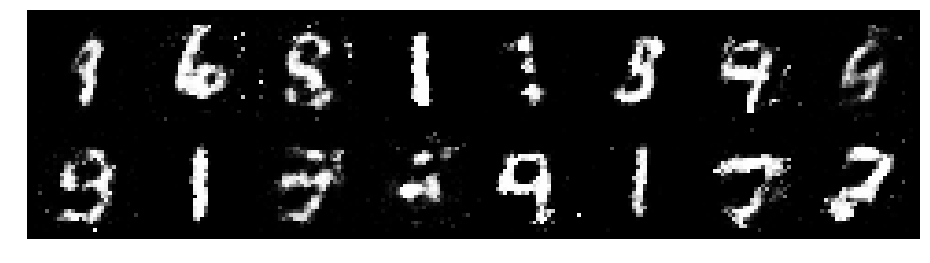

Epoch: [31/200], Batch Num: [500/600]
Discriminator Loss: 1.0745, Generator Loss: 1.7737
D(x): 0.5621, D(G(z)): 0.2392


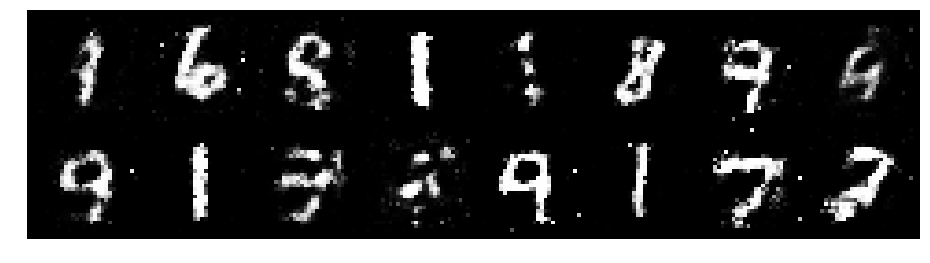

Epoch: [32/200], Batch Num: [0/600]
Discriminator Loss: 1.0653, Generator Loss: 1.6327
D(x): 0.6285, D(G(z)): 0.3424


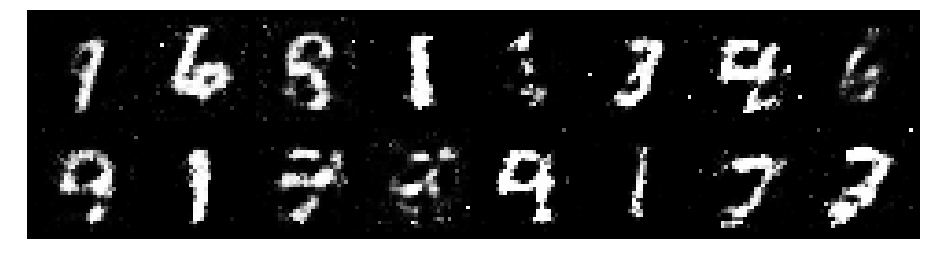

Epoch: [32/200], Batch Num: [100/600]
Discriminator Loss: 1.0530, Generator Loss: 1.4960
D(x): 0.6993, D(G(z)): 0.3705


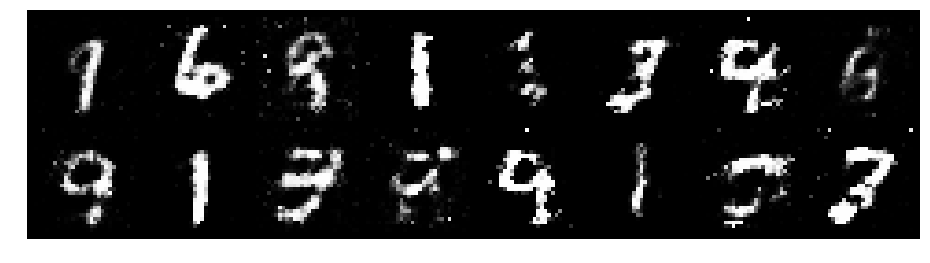

Epoch: [32/200], Batch Num: [200/600]
Discriminator Loss: 0.9631, Generator Loss: 1.5135
D(x): 0.6485, D(G(z)): 0.3235


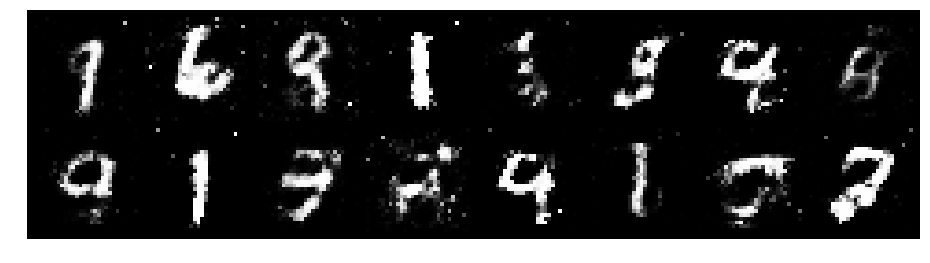

Epoch: [32/200], Batch Num: [300/600]
Discriminator Loss: 0.9211, Generator Loss: 1.0761
D(x): 0.7368, D(G(z)): 0.3364


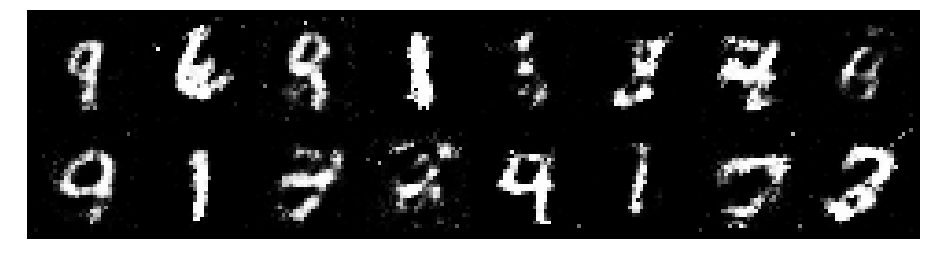

Epoch: [32/200], Batch Num: [400/600]
Discriminator Loss: 1.0285, Generator Loss: 1.1801
D(x): 0.6885, D(G(z)): 0.3961


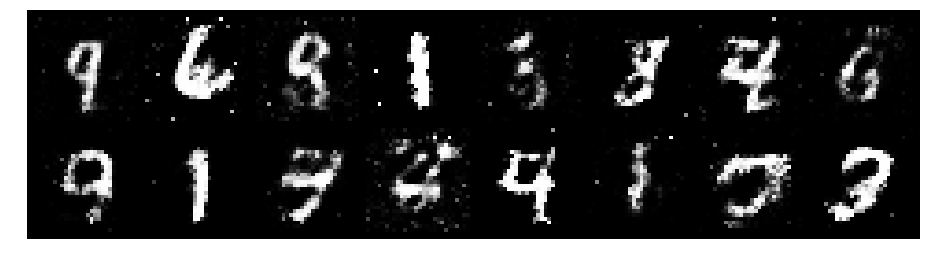

Epoch: [32/200], Batch Num: [500/600]
Discriminator Loss: 1.0663, Generator Loss: 1.3128
D(x): 0.6808, D(G(z)): 0.3794


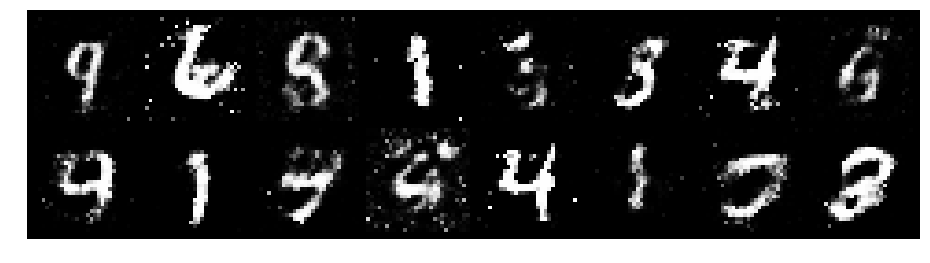

Epoch: [33/200], Batch Num: [0/600]
Discriminator Loss: 1.1755, Generator Loss: 1.2375
D(x): 0.6814, D(G(z)): 0.4304


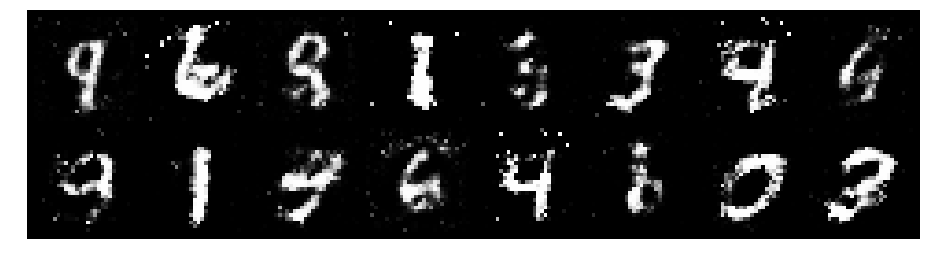

Epoch: [33/200], Batch Num: [100/600]
Discriminator Loss: 1.0727, Generator Loss: 1.1341
D(x): 0.5977, D(G(z)): 0.3359


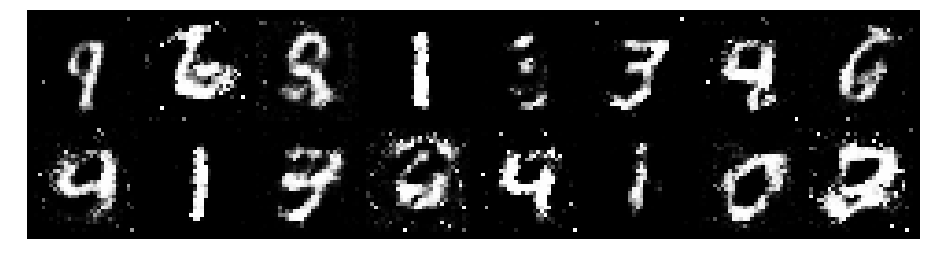

Epoch: [33/200], Batch Num: [200/600]
Discriminator Loss: 1.0845, Generator Loss: 1.1382
D(x): 0.6037, D(G(z)): 0.3748


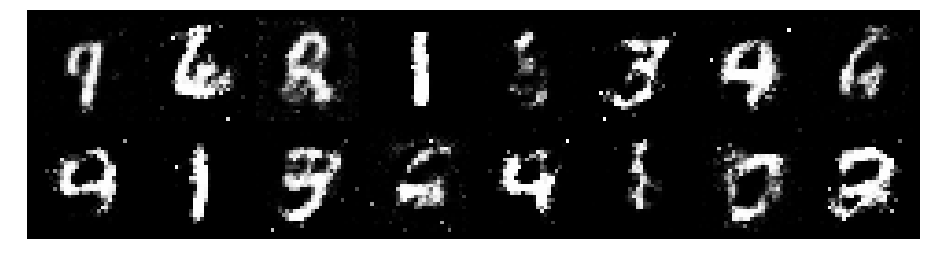

Epoch: [33/200], Batch Num: [300/600]
Discriminator Loss: 1.0001, Generator Loss: 1.2153
D(x): 0.6384, D(G(z)): 0.3574


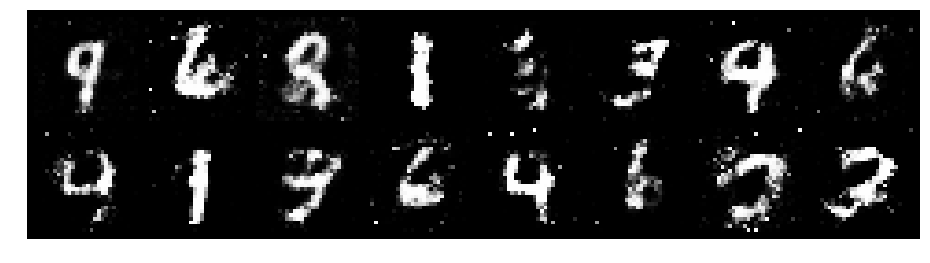

Epoch: [33/200], Batch Num: [400/600]
Discriminator Loss: 1.0396, Generator Loss: 1.3061
D(x): 0.5904, D(G(z)): 0.3134


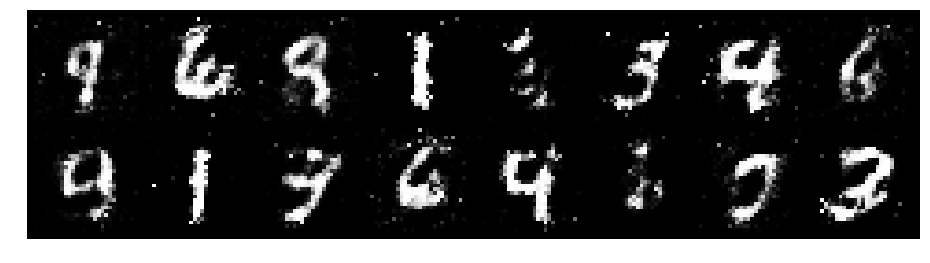

Epoch: [33/200], Batch Num: [500/600]
Discriminator Loss: 0.8897, Generator Loss: 1.3292
D(x): 0.6622, D(G(z)): 0.3238


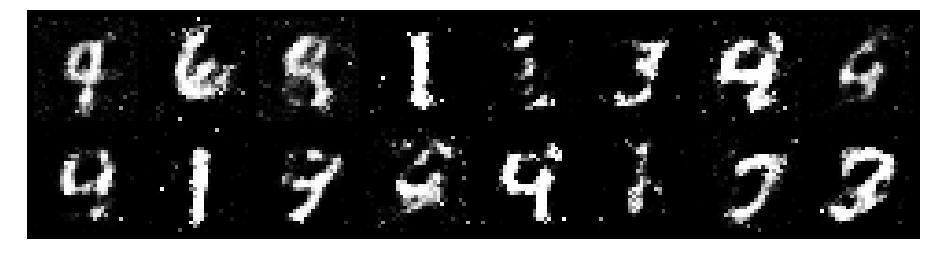

Epoch: [34/200], Batch Num: [0/600]
Discriminator Loss: 0.9189, Generator Loss: 1.4017
D(x): 0.6093, D(G(z)): 0.2660


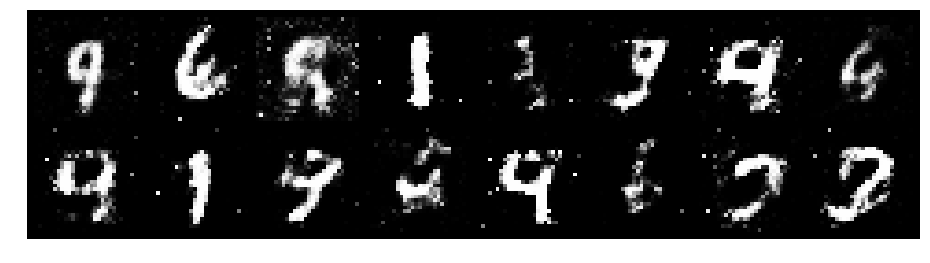

Epoch: [34/200], Batch Num: [100/600]
Discriminator Loss: 1.1111, Generator Loss: 0.9799
D(x): 0.6231, D(G(z)): 0.3880


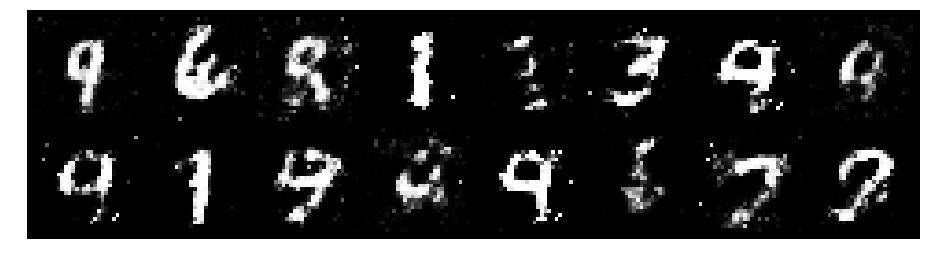

Epoch: [34/200], Batch Num: [200/600]
Discriminator Loss: 0.9990, Generator Loss: 1.2982
D(x): 0.6856, D(G(z)): 0.3718


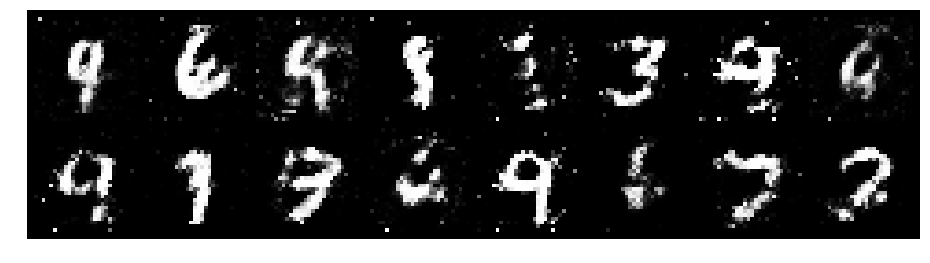

Epoch: [34/200], Batch Num: [300/600]
Discriminator Loss: 1.1848, Generator Loss: 1.0336
D(x): 0.5777, D(G(z)): 0.3655


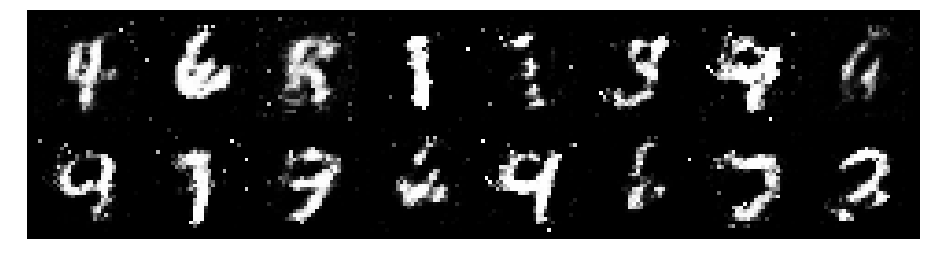

Epoch: [34/200], Batch Num: [400/600]
Discriminator Loss: 1.0694, Generator Loss: 1.2915
D(x): 0.6077, D(G(z)): 0.3346


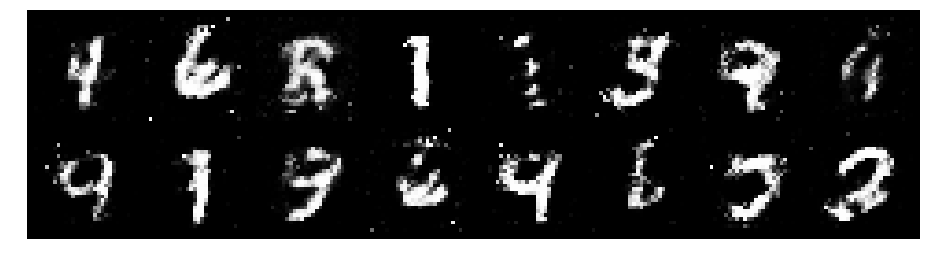

Epoch: [34/200], Batch Num: [500/600]
Discriminator Loss: 1.0412, Generator Loss: 1.0727
D(x): 0.6344, D(G(z)): 0.3781


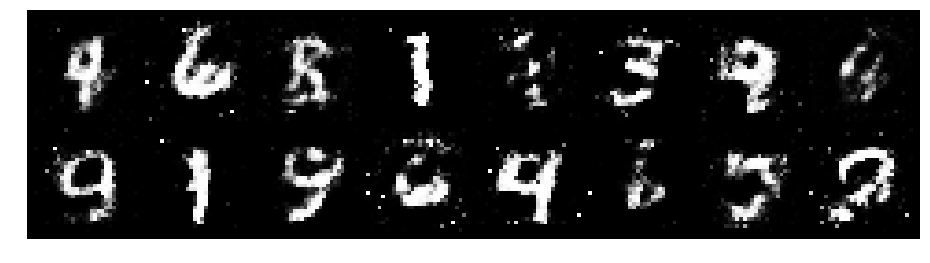

Epoch: [35/200], Batch Num: [0/600]
Discriminator Loss: 0.9804, Generator Loss: 1.3297
D(x): 0.6104, D(G(z)): 0.3276


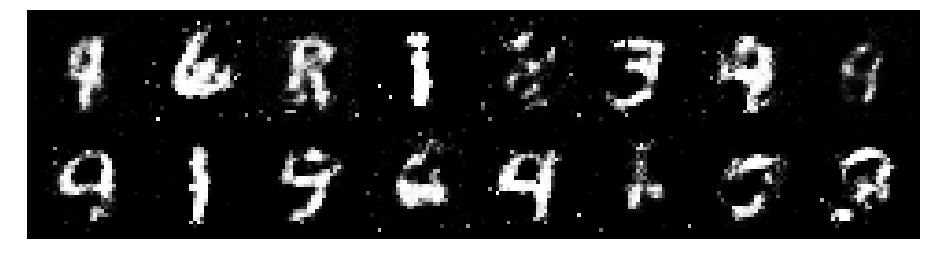

Epoch: [35/200], Batch Num: [100/600]
Discriminator Loss: 0.8810, Generator Loss: 1.4648
D(x): 0.7121, D(G(z)): 0.3371


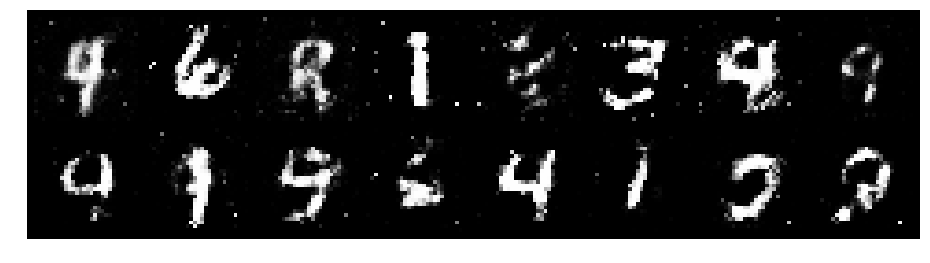

Epoch: [35/200], Batch Num: [200/600]
Discriminator Loss: 1.0814, Generator Loss: 1.1768
D(x): 0.6395, D(G(z)): 0.3425


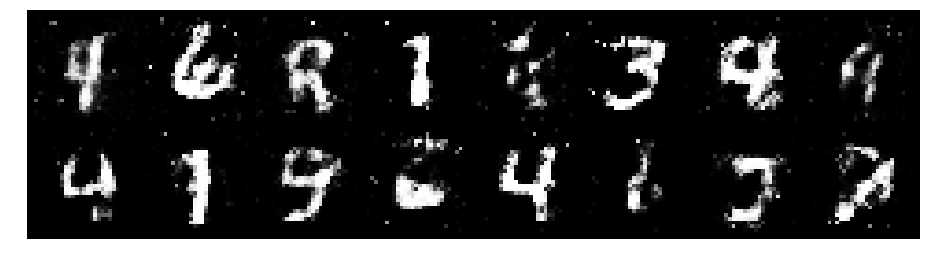

Epoch: [35/200], Batch Num: [300/600]
Discriminator Loss: 0.9297, Generator Loss: 1.2176
D(x): 0.7056, D(G(z)): 0.3450


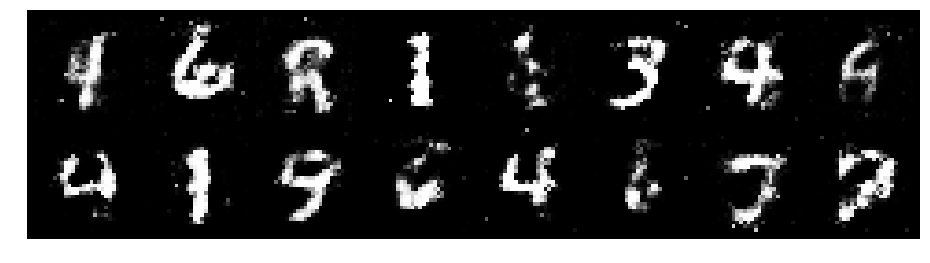

Epoch: [35/200], Batch Num: [400/600]
Discriminator Loss: 0.9036, Generator Loss: 1.4711
D(x): 0.6821, D(G(z)): 0.2957


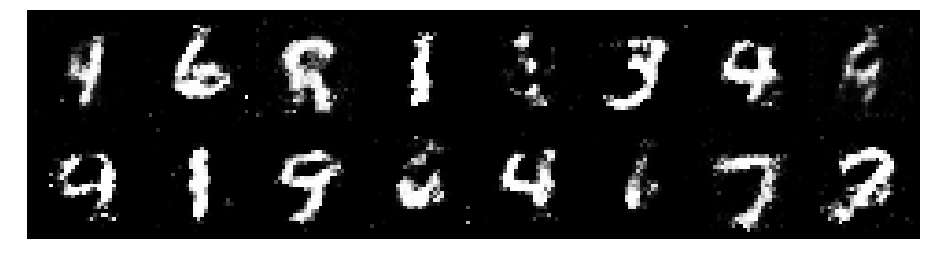

Epoch: [35/200], Batch Num: [500/600]
Discriminator Loss: 1.1269, Generator Loss: 1.2219
D(x): 0.7026, D(G(z)): 0.4566


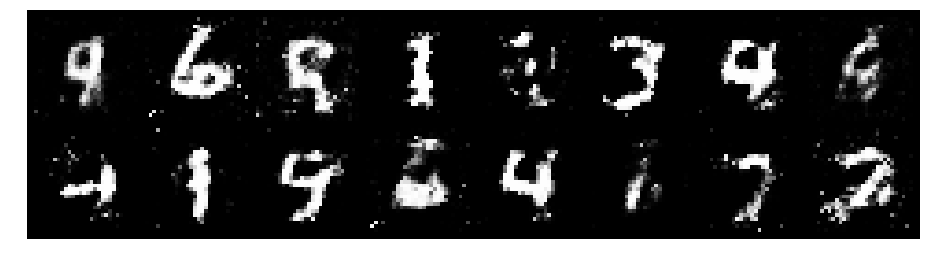

Epoch: [36/200], Batch Num: [0/600]
Discriminator Loss: 0.8831, Generator Loss: 1.5142
D(x): 0.7111, D(G(z)): 0.3177


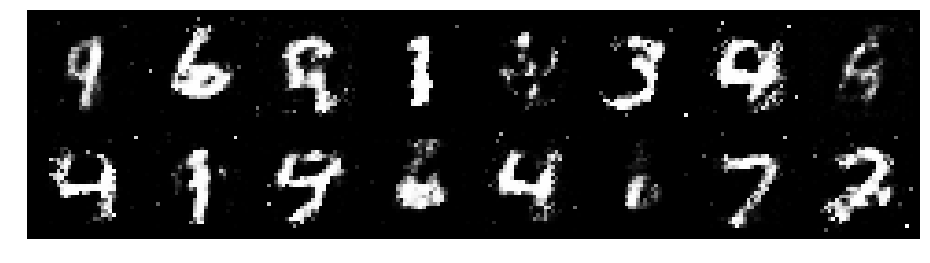

Epoch: [36/200], Batch Num: [100/600]
Discriminator Loss: 1.1922, Generator Loss: 1.2211
D(x): 0.5909, D(G(z)): 0.3428


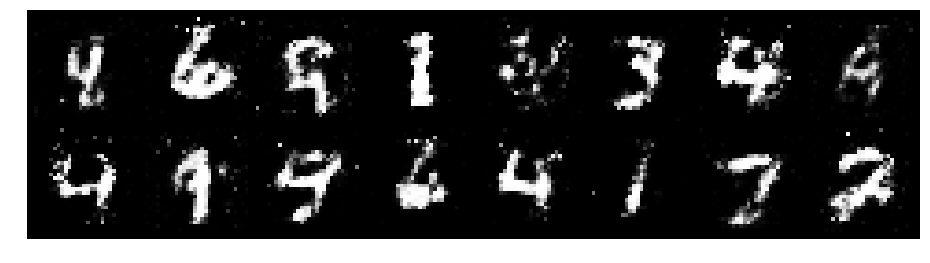

Epoch: [36/200], Batch Num: [200/600]
Discriminator Loss: 1.0733, Generator Loss: 1.2507
D(x): 0.6473, D(G(z)): 0.3938


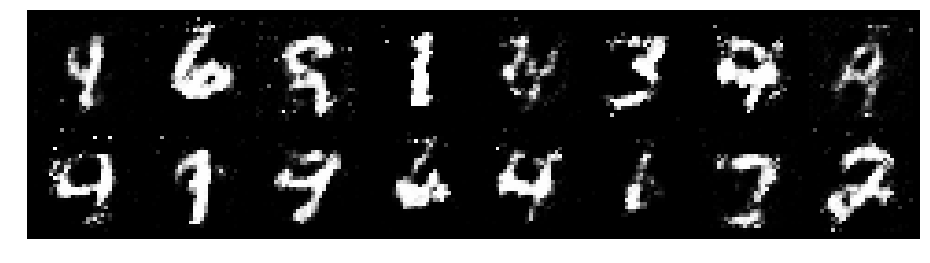

Epoch: [36/200], Batch Num: [300/600]
Discriminator Loss: 1.1624, Generator Loss: 1.1997
D(x): 0.6574, D(G(z)): 0.3939


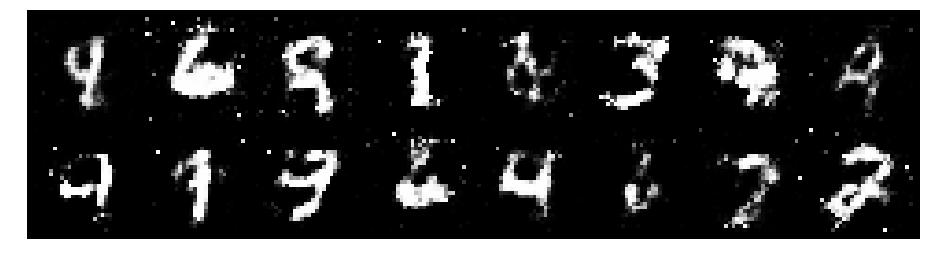

Epoch: [36/200], Batch Num: [400/600]
Discriminator Loss: 1.0879, Generator Loss: 1.2793
D(x): 0.6720, D(G(z)): 0.4020


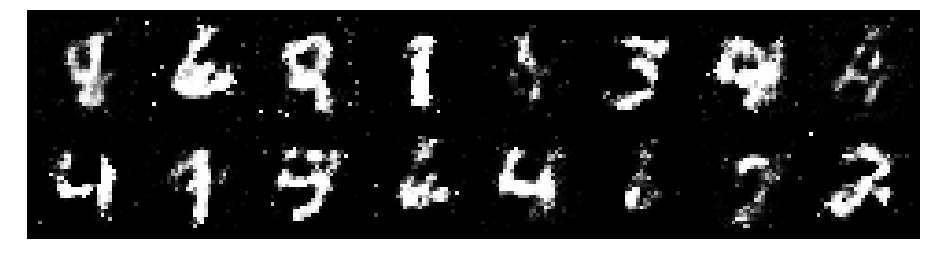

Epoch: [36/200], Batch Num: [500/600]
Discriminator Loss: 1.0221, Generator Loss: 1.1748
D(x): 0.6519, D(G(z)): 0.3471


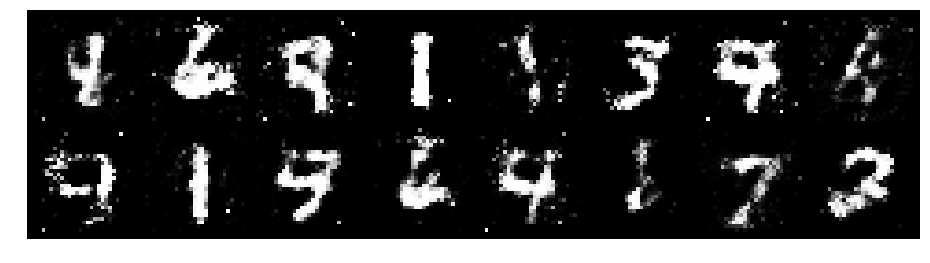

Epoch: [37/200], Batch Num: [0/600]
Discriminator Loss: 1.1743, Generator Loss: 1.3689
D(x): 0.5993, D(G(z)): 0.3676


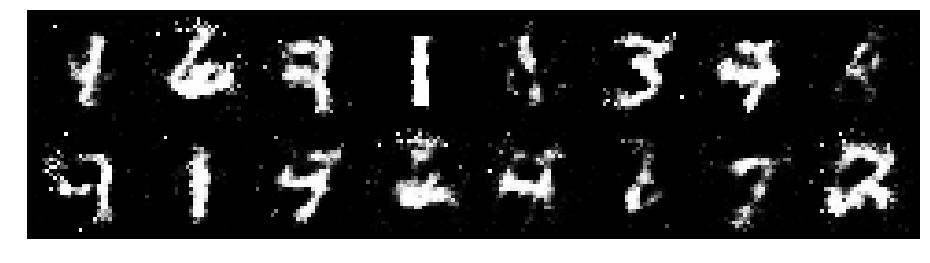

Epoch: [37/200], Batch Num: [100/600]
Discriminator Loss: 1.0755, Generator Loss: 1.6115
D(x): 0.7278, D(G(z)): 0.3971


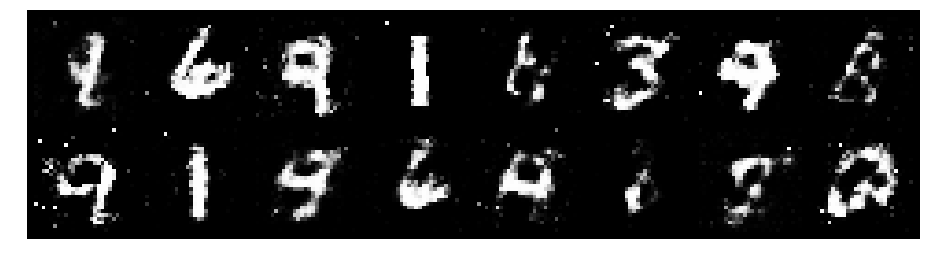

Epoch: [37/200], Batch Num: [200/600]
Discriminator Loss: 1.0853, Generator Loss: 1.2162
D(x): 0.5834, D(G(z)): 0.3253


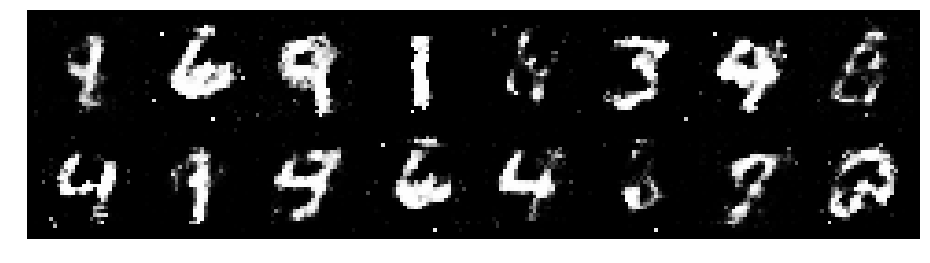

Epoch: [37/200], Batch Num: [300/600]
Discriminator Loss: 0.9060, Generator Loss: 1.3140
D(x): 0.7187, D(G(z)): 0.3544


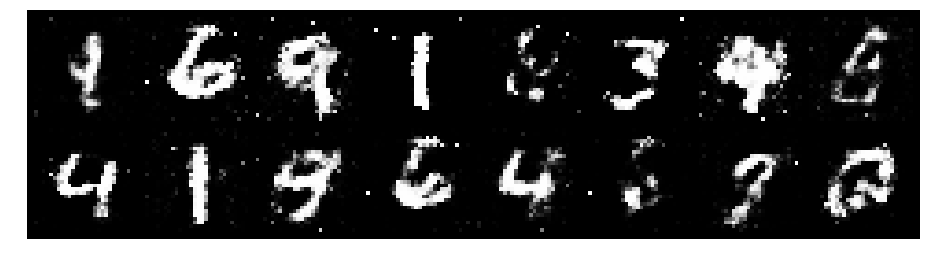

Epoch: [37/200], Batch Num: [400/600]
Discriminator Loss: 0.8769, Generator Loss: 1.4878
D(x): 0.6335, D(G(z)): 0.2413


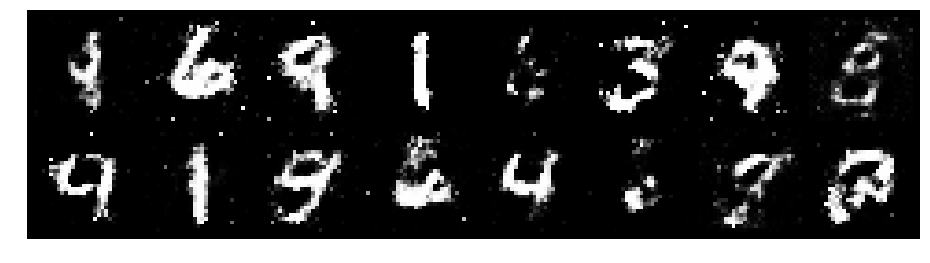

Epoch: [37/200], Batch Num: [500/600]
Discriminator Loss: 0.9729, Generator Loss: 1.2769
D(x): 0.6550, D(G(z)): 0.3211


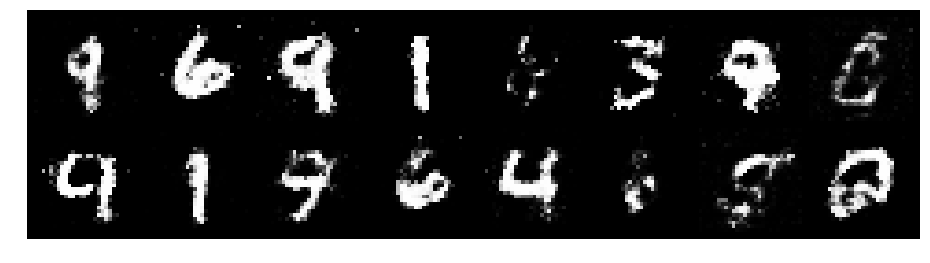

Epoch: [38/200], Batch Num: [0/600]
Discriminator Loss: 1.0654, Generator Loss: 1.5827
D(x): 0.6199, D(G(z)): 0.3404


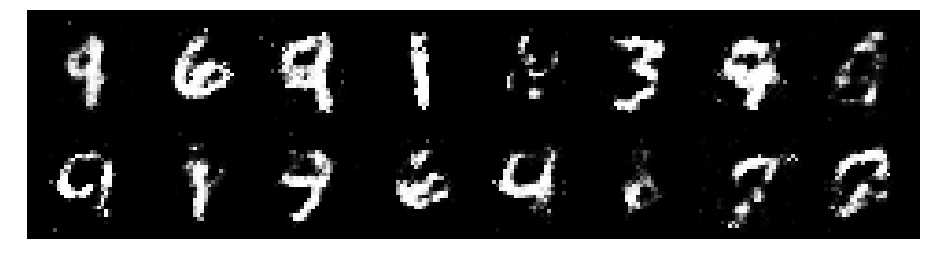

Epoch: [38/200], Batch Num: [100/600]
Discriminator Loss: 1.1706, Generator Loss: 1.1033
D(x): 0.5871, D(G(z)): 0.3812


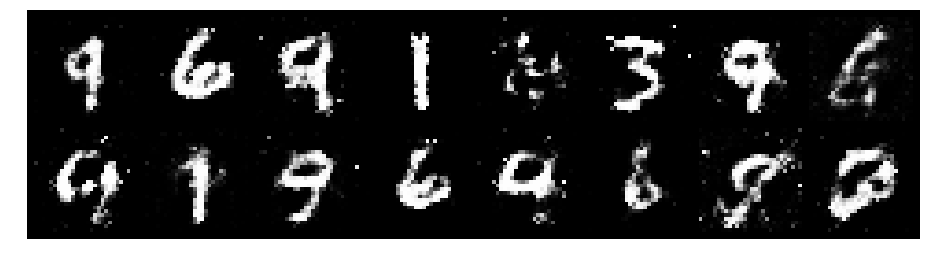

Epoch: [38/200], Batch Num: [200/600]
Discriminator Loss: 1.1275, Generator Loss: 0.9870
D(x): 0.6400, D(G(z)): 0.4252


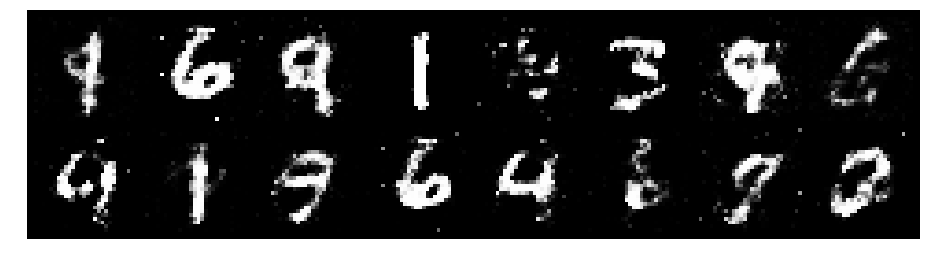

Epoch: [38/200], Batch Num: [300/600]
Discriminator Loss: 1.1795, Generator Loss: 1.3499
D(x): 0.6326, D(G(z)): 0.3932


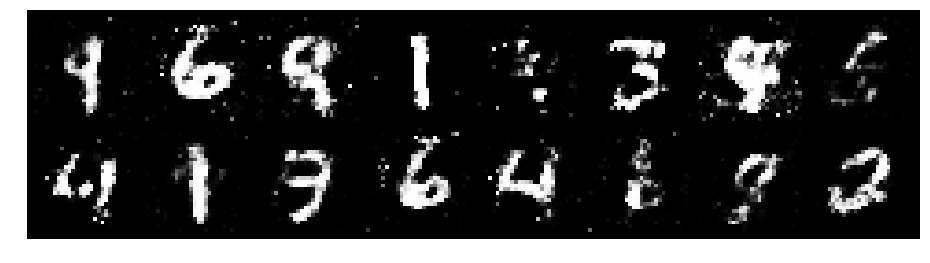

Epoch: [38/200], Batch Num: [400/600]
Discriminator Loss: 1.1938, Generator Loss: 1.3741
D(x): 0.5709, D(G(z)): 0.3032


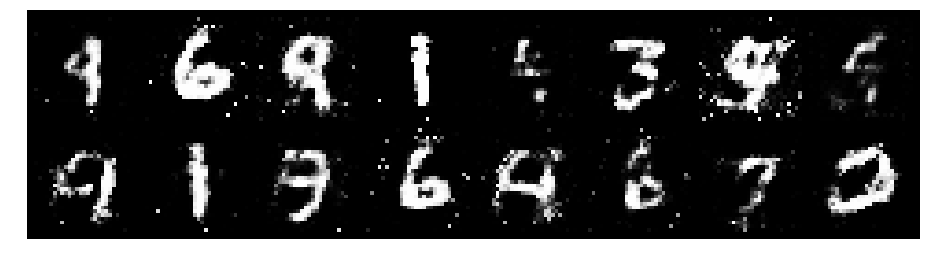

Epoch: [38/200], Batch Num: [500/600]
Discriminator Loss: 0.9541, Generator Loss: 1.2333
D(x): 0.7029, D(G(z)): 0.3259


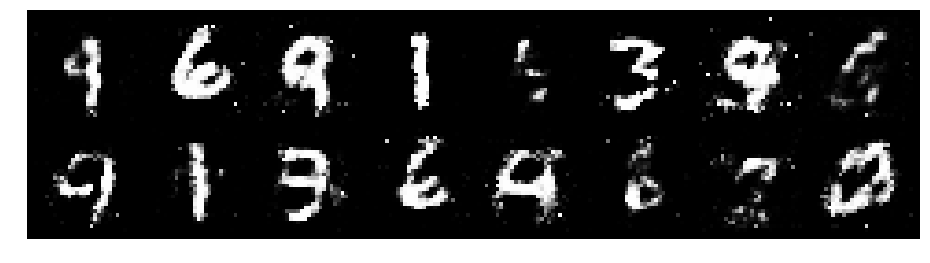

Epoch: [39/200], Batch Num: [0/600]
Discriminator Loss: 1.0679, Generator Loss: 1.2669
D(x): 0.6040, D(G(z)): 0.3329


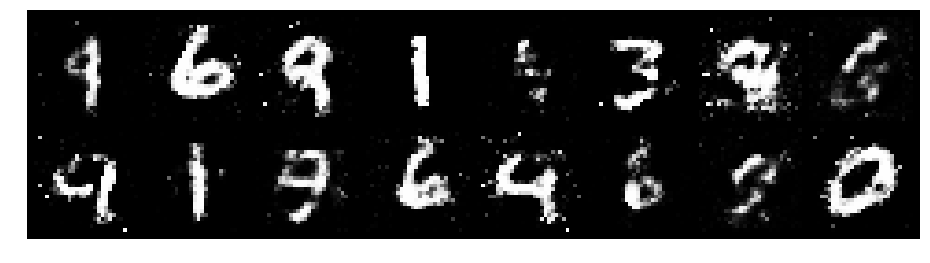

Epoch: [39/200], Batch Num: [100/600]
Discriminator Loss: 0.9065, Generator Loss: 1.3335
D(x): 0.6531, D(G(z)): 0.2887


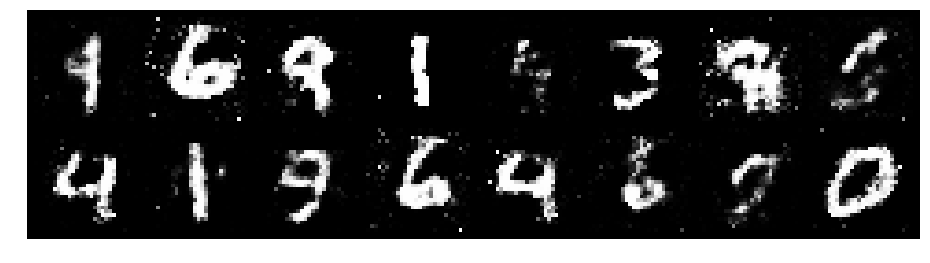

Epoch: [39/200], Batch Num: [200/600]
Discriminator Loss: 1.0194, Generator Loss: 1.1941
D(x): 0.6676, D(G(z)): 0.3700


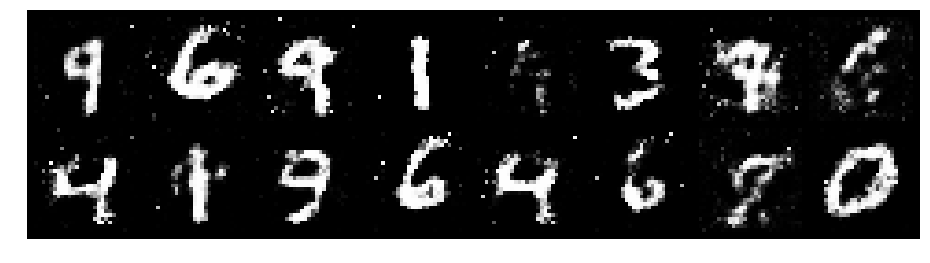

Epoch: [39/200], Batch Num: [300/600]
Discriminator Loss: 1.0857, Generator Loss: 1.0582
D(x): 0.6331, D(G(z)): 0.3989


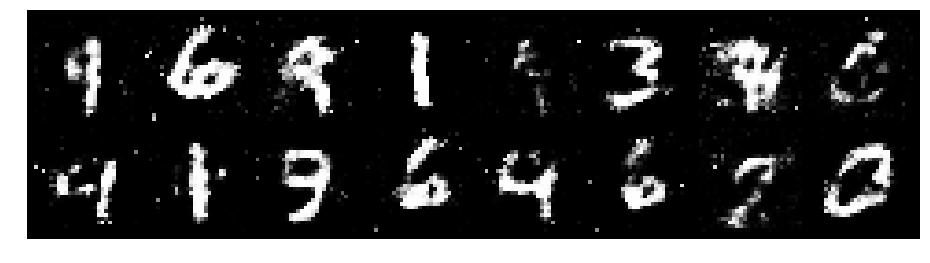

Epoch: [39/200], Batch Num: [400/600]
Discriminator Loss: 1.2278, Generator Loss: 1.1405
D(x): 0.5366, D(G(z)): 0.3511


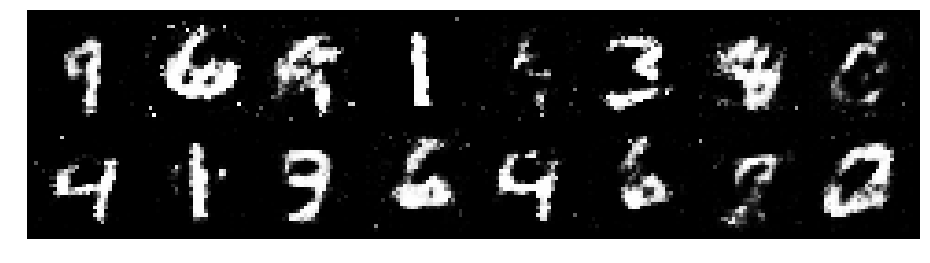

Epoch: [39/200], Batch Num: [500/600]
Discriminator Loss: 1.2788, Generator Loss: 1.0261
D(x): 0.5894, D(G(z)): 0.4208


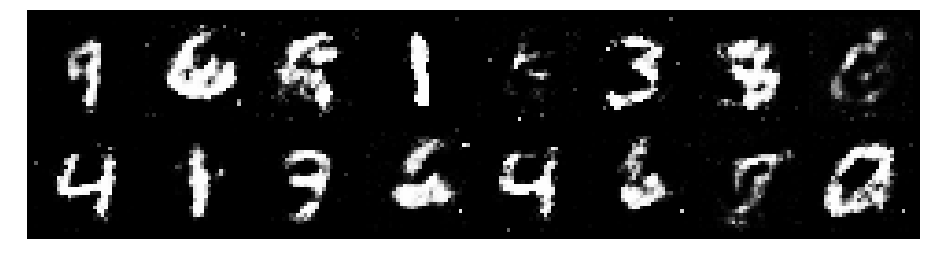

Epoch: [40/200], Batch Num: [0/600]
Discriminator Loss: 1.0175, Generator Loss: 1.0940
D(x): 0.6149, D(G(z)): 0.3524


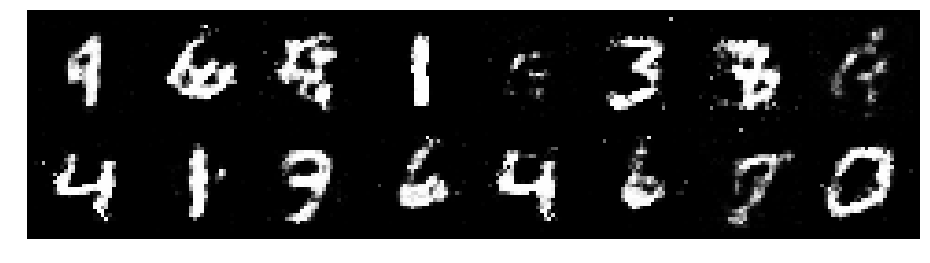

Epoch: [40/200], Batch Num: [100/600]
Discriminator Loss: 1.0851, Generator Loss: 1.0632
D(x): 0.6243, D(G(z)): 0.3726


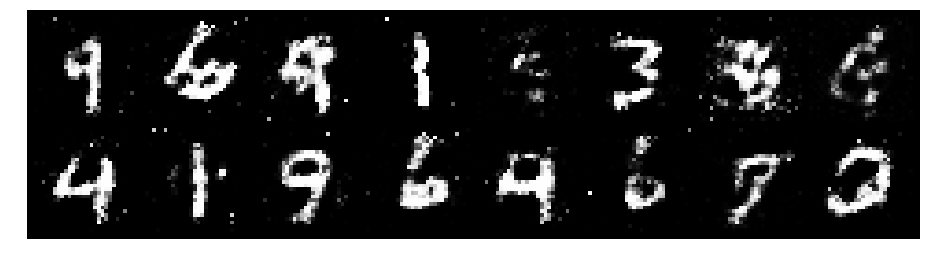

Epoch: [40/200], Batch Num: [200/600]
Discriminator Loss: 1.0716, Generator Loss: 1.0709
D(x): 0.6335, D(G(z)): 0.3864


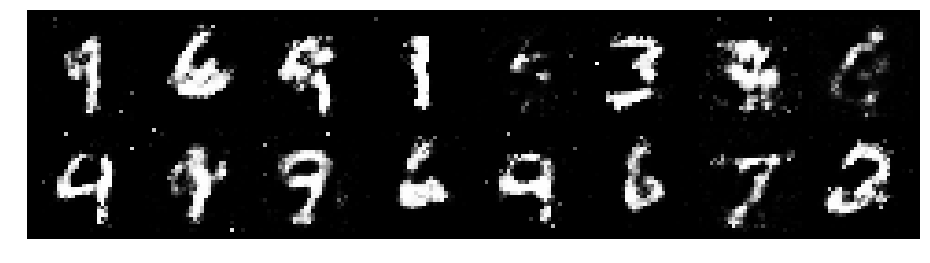

Epoch: [40/200], Batch Num: [300/600]
Discriminator Loss: 1.2845, Generator Loss: 1.1943
D(x): 0.5462, D(G(z)): 0.3688


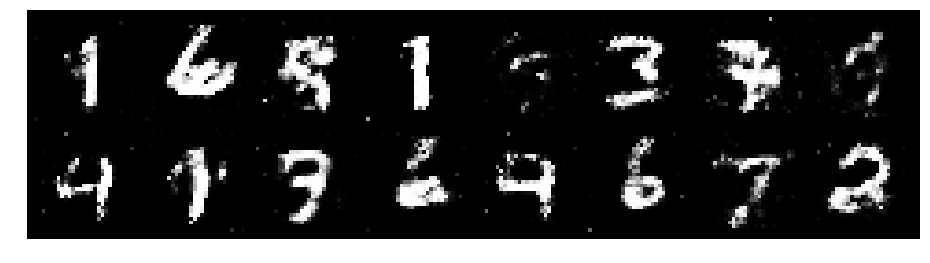

Epoch: [40/200], Batch Num: [400/600]
Discriminator Loss: 1.1231, Generator Loss: 1.0397
D(x): 0.5959, D(G(z)): 0.3968


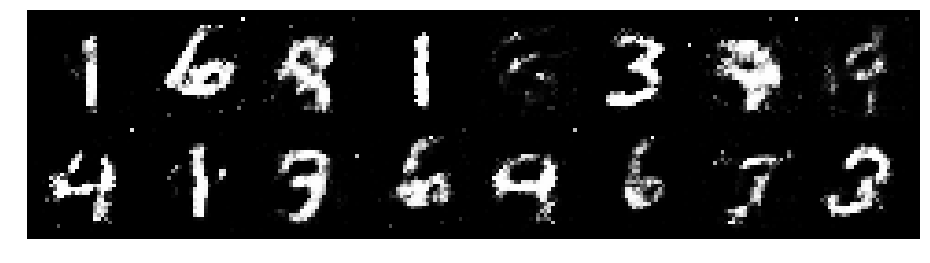

Epoch: [40/200], Batch Num: [500/600]
Discriminator Loss: 1.0551, Generator Loss: 1.0273
D(x): 0.5890, D(G(z)): 0.3543


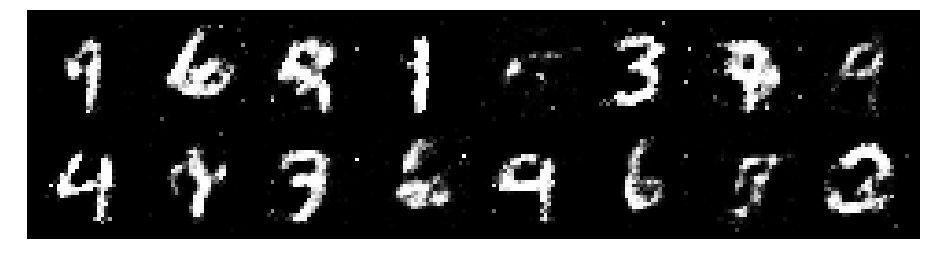

Epoch: [41/200], Batch Num: [0/600]
Discriminator Loss: 1.1511, Generator Loss: 1.0004
D(x): 0.6487, D(G(z)): 0.4452


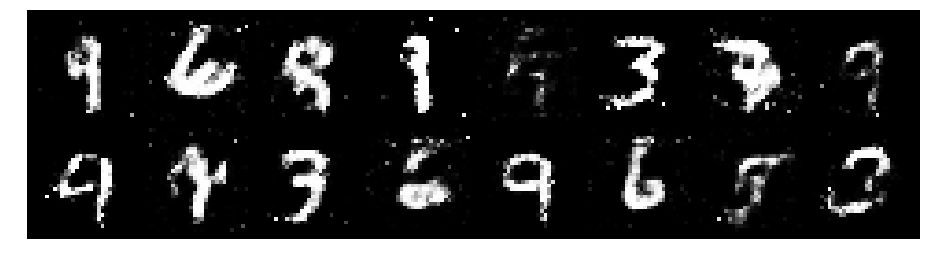

Epoch: [41/200], Batch Num: [100/600]
Discriminator Loss: 1.1148, Generator Loss: 1.0884
D(x): 0.6540, D(G(z)): 0.4333


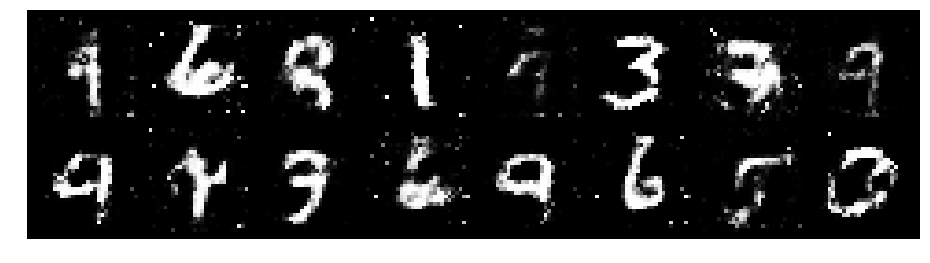

Epoch: [41/200], Batch Num: [200/600]
Discriminator Loss: 1.1005, Generator Loss: 1.2371
D(x): 0.6107, D(G(z)): 0.3589


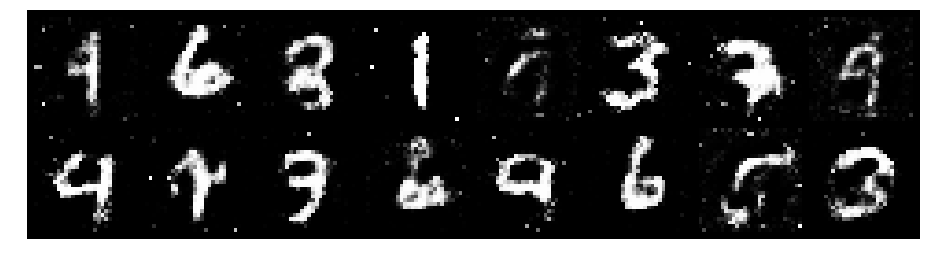

Epoch: [41/200], Batch Num: [300/600]
Discriminator Loss: 1.2759, Generator Loss: 1.2028
D(x): 0.5893, D(G(z)): 0.4329


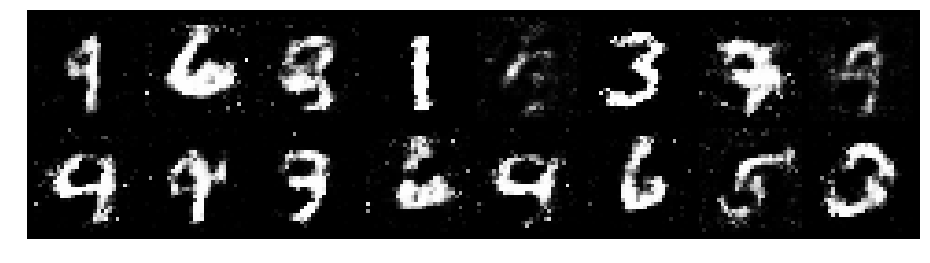

Epoch: [41/200], Batch Num: [400/600]
Discriminator Loss: 1.1233, Generator Loss: 1.0866
D(x): 0.6013, D(G(z)): 0.3744


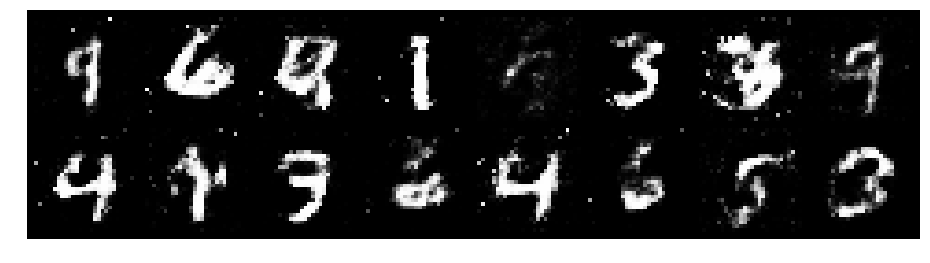

Epoch: [41/200], Batch Num: [500/600]
Discriminator Loss: 1.1508, Generator Loss: 1.1894
D(x): 0.5695, D(G(z)): 0.3489


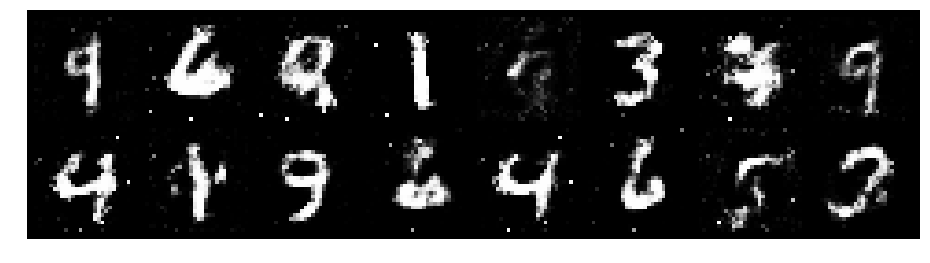

Epoch: [42/200], Batch Num: [0/600]
Discriminator Loss: 1.2393, Generator Loss: 1.2572
D(x): 0.6226, D(G(z)): 0.4051


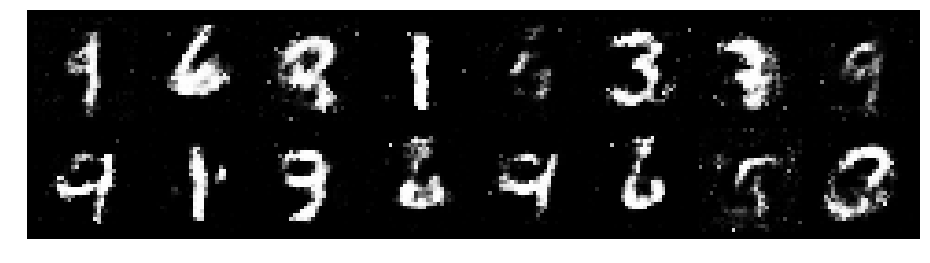

Epoch: [42/200], Batch Num: [100/600]
Discriminator Loss: 1.1637, Generator Loss: 0.8427
D(x): 0.6444, D(G(z)): 0.4443


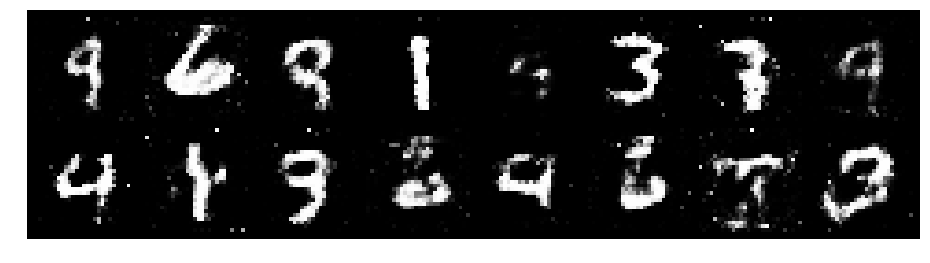

Epoch: [42/200], Batch Num: [200/600]
Discriminator Loss: 1.1743, Generator Loss: 1.0164
D(x): 0.6380, D(G(z)): 0.4375


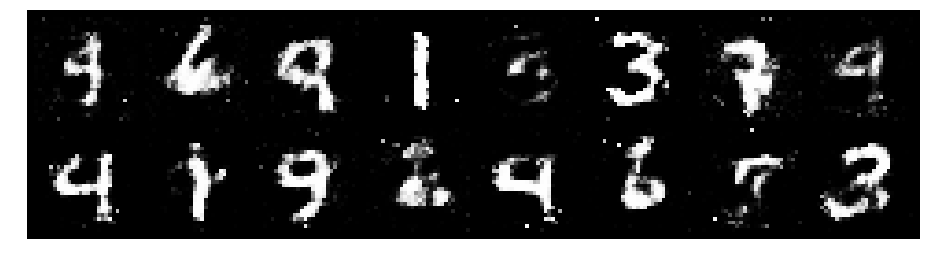

Epoch: [42/200], Batch Num: [300/600]
Discriminator Loss: 1.1203, Generator Loss: 1.1969
D(x): 0.6380, D(G(z)): 0.3963


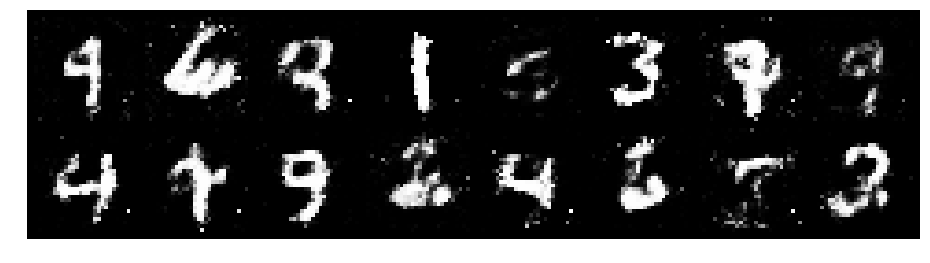

Epoch: [42/200], Batch Num: [400/600]
Discriminator Loss: 1.1528, Generator Loss: 1.0179
D(x): 0.6149, D(G(z)): 0.3956


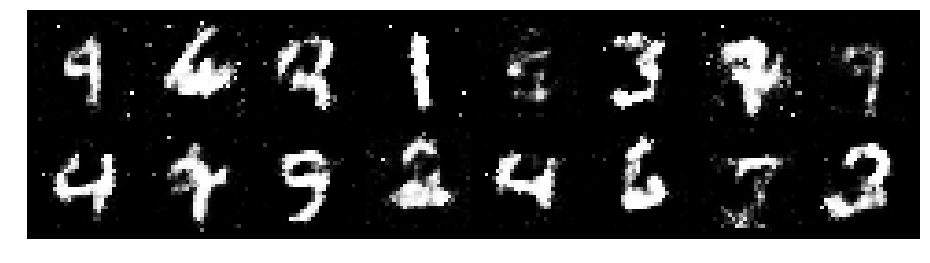

Epoch: [42/200], Batch Num: [500/600]
Discriminator Loss: 1.0203, Generator Loss: 1.4316
D(x): 0.6184, D(G(z)): 0.2846


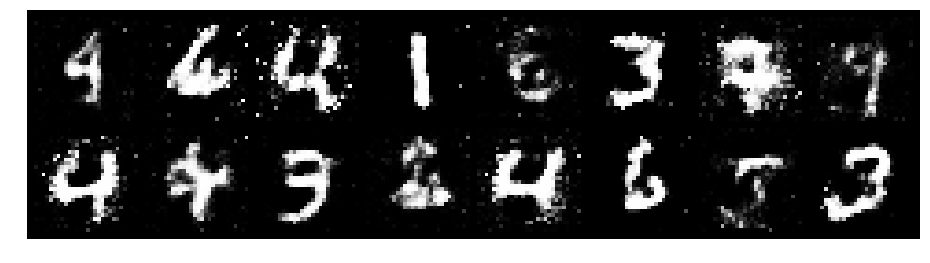

Epoch: [43/200], Batch Num: [0/600]
Discriminator Loss: 1.1870, Generator Loss: 1.1892
D(x): 0.5738, D(G(z)): 0.3754


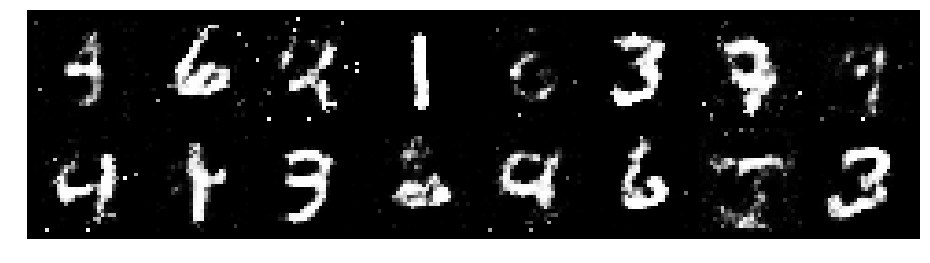

Epoch: [43/200], Batch Num: [100/600]
Discriminator Loss: 1.2246, Generator Loss: 1.1696
D(x): 0.6604, D(G(z)): 0.4530


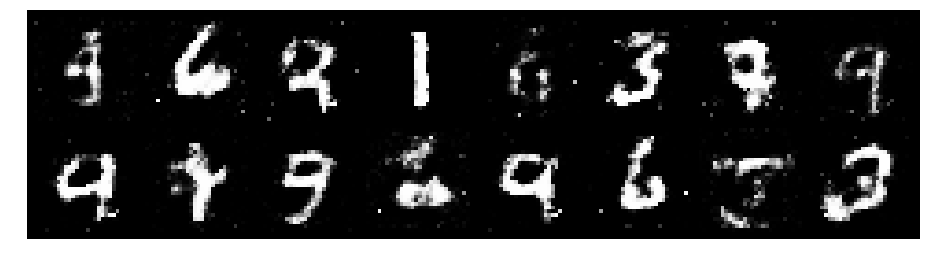

Epoch: [43/200], Batch Num: [200/600]
Discriminator Loss: 1.1420, Generator Loss: 1.0326
D(x): 0.6445, D(G(z)): 0.4342


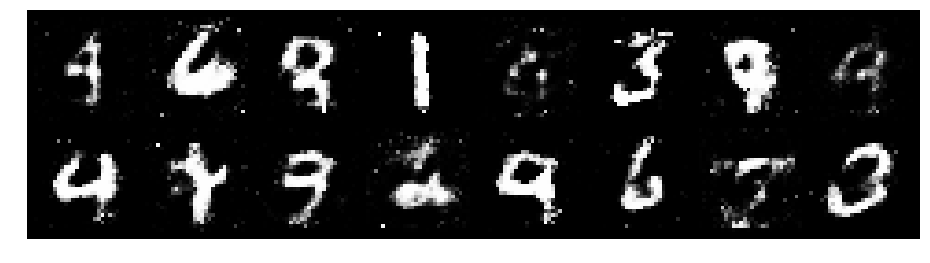

Epoch: [43/200], Batch Num: [300/600]
Discriminator Loss: 1.1311, Generator Loss: 1.1294
D(x): 0.6086, D(G(z)): 0.3908


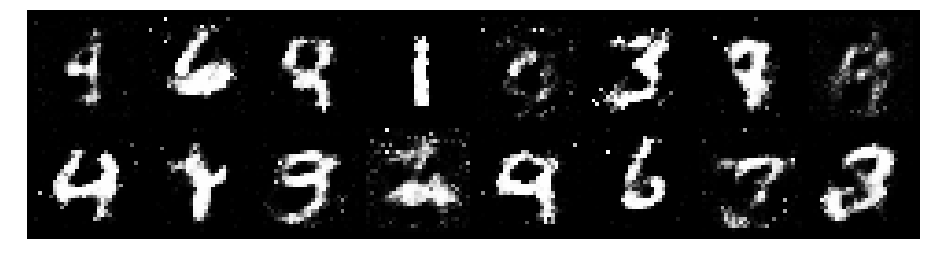

Epoch: [43/200], Batch Num: [400/600]
Discriminator Loss: 1.1503, Generator Loss: 1.3806
D(x): 0.6326, D(G(z)): 0.3708


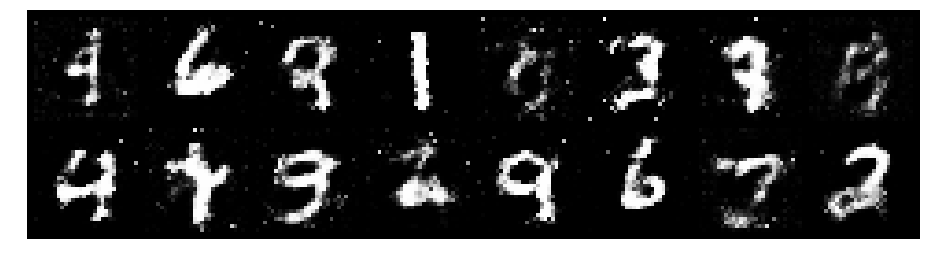

Epoch: [43/200], Batch Num: [500/600]
Discriminator Loss: 1.1143, Generator Loss: 1.2455
D(x): 0.6033, D(G(z)): 0.3496


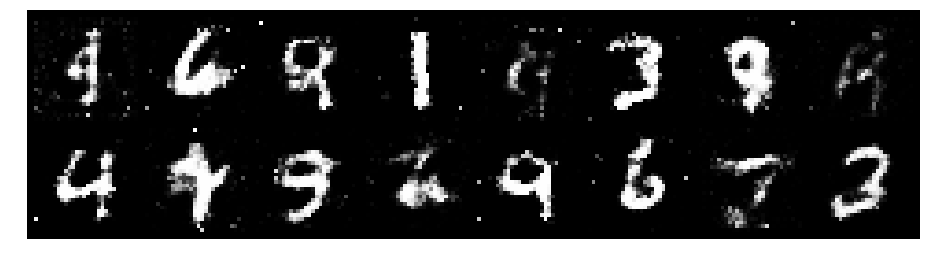

Epoch: [44/200], Batch Num: [0/600]
Discriminator Loss: 1.0883, Generator Loss: 1.2882
D(x): 0.6155, D(G(z)): 0.3508


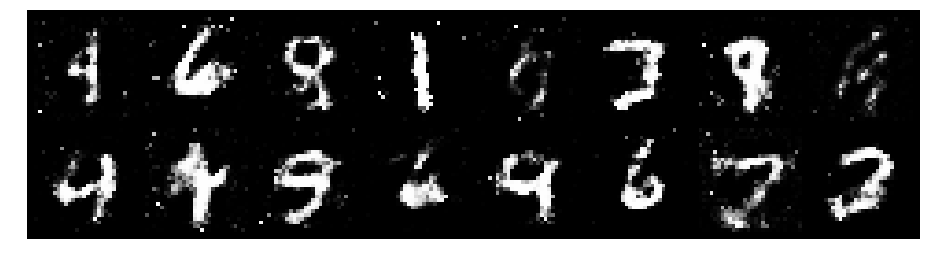

Epoch: [44/200], Batch Num: [100/600]
Discriminator Loss: 1.1479, Generator Loss: 0.9871
D(x): 0.5908, D(G(z)): 0.3863


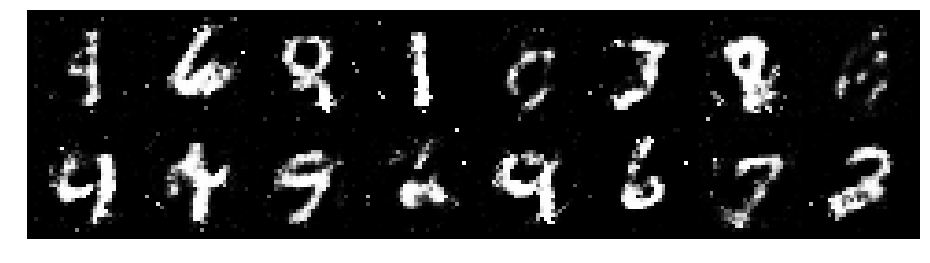

Epoch: [44/200], Batch Num: [200/600]
Discriminator Loss: 0.9722, Generator Loss: 1.4879
D(x): 0.6480, D(G(z)): 0.3258


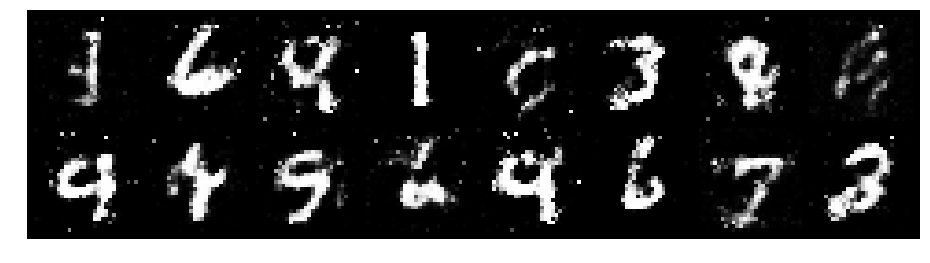

Epoch: [44/200], Batch Num: [300/600]
Discriminator Loss: 0.9510, Generator Loss: 1.2818
D(x): 0.6571, D(G(z)): 0.3468


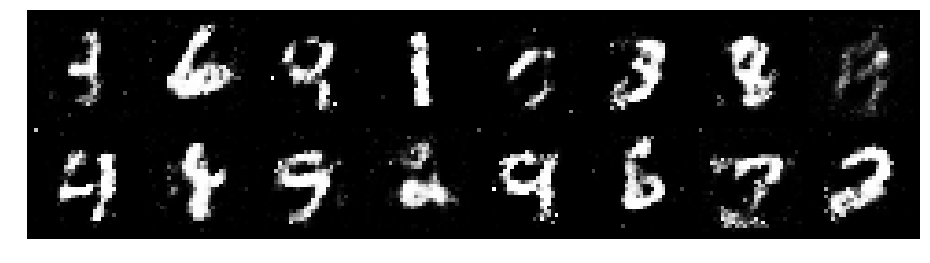

Epoch: [44/200], Batch Num: [400/600]
Discriminator Loss: 0.9291, Generator Loss: 1.3616
D(x): 0.6562, D(G(z)): 0.3247


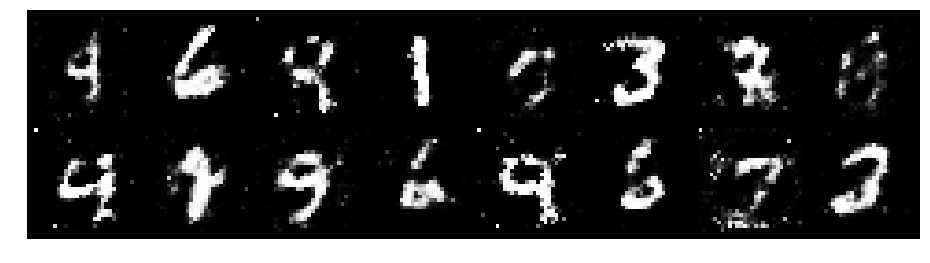

Epoch: [44/200], Batch Num: [500/600]
Discriminator Loss: 1.2136, Generator Loss: 1.2676
D(x): 0.6716, D(G(z)): 0.4316


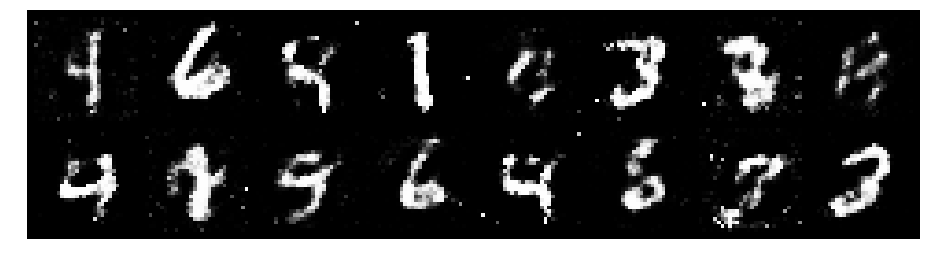

Epoch: [45/200], Batch Num: [0/600]
Discriminator Loss: 1.0247, Generator Loss: 1.4402
D(x): 0.6051, D(G(z)): 0.3111


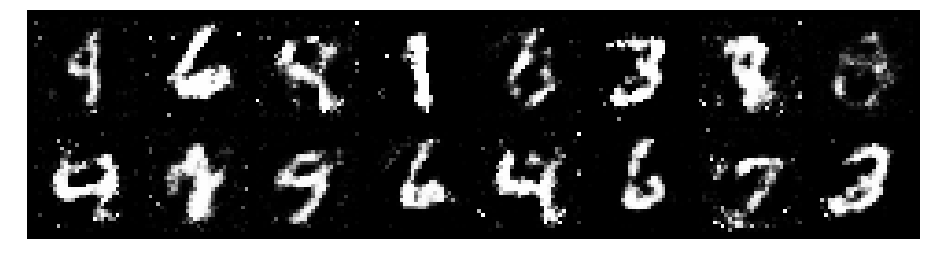

Epoch: [45/200], Batch Num: [100/600]
Discriminator Loss: 0.9936, Generator Loss: 1.3882
D(x): 0.6570, D(G(z)): 0.3366


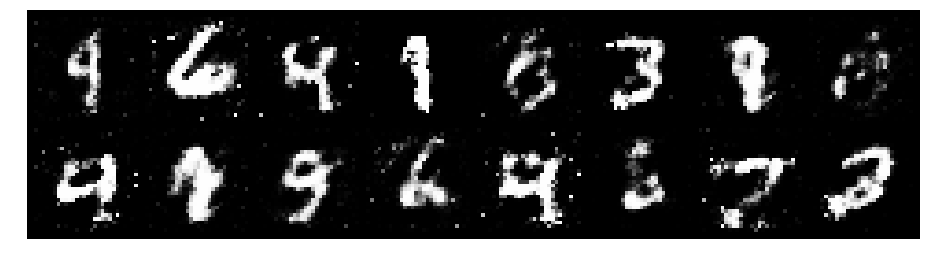

Epoch: [45/200], Batch Num: [200/600]
Discriminator Loss: 1.0011, Generator Loss: 1.3541
D(x): 0.6724, D(G(z)): 0.3668


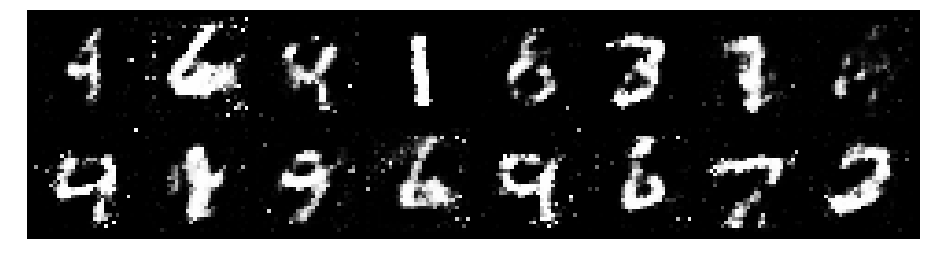

Epoch: [45/200], Batch Num: [300/600]
Discriminator Loss: 1.0807, Generator Loss: 1.2660
D(x): 0.6334, D(G(z)): 0.3786


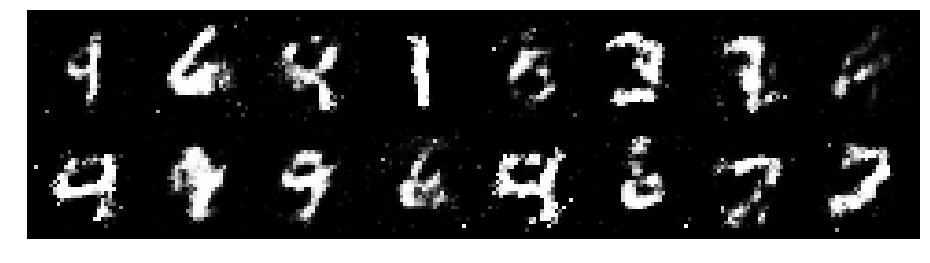

Epoch: [45/200], Batch Num: [400/600]
Discriminator Loss: 0.9021, Generator Loss: 1.4230
D(x): 0.6289, D(G(z)): 0.2766


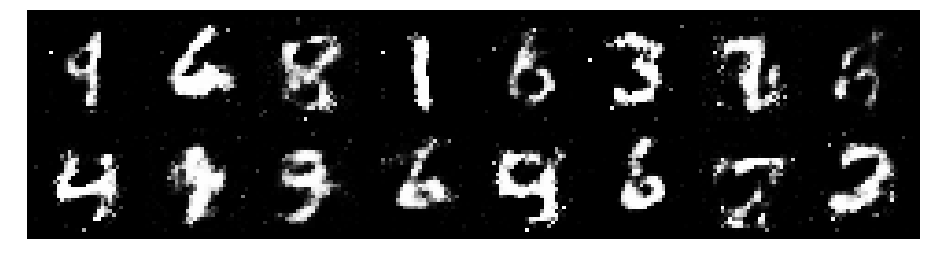

Epoch: [45/200], Batch Num: [500/600]
Discriminator Loss: 1.1989, Generator Loss: 1.0397
D(x): 0.6209, D(G(z)): 0.4214


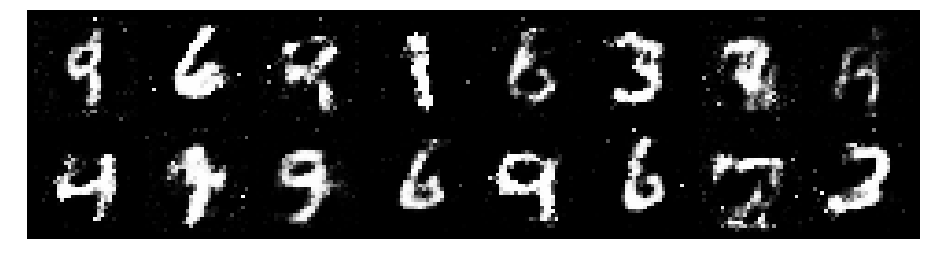

Epoch: [46/200], Batch Num: [0/600]
Discriminator Loss: 1.1894, Generator Loss: 1.1044
D(x): 0.5793, D(G(z)): 0.3807


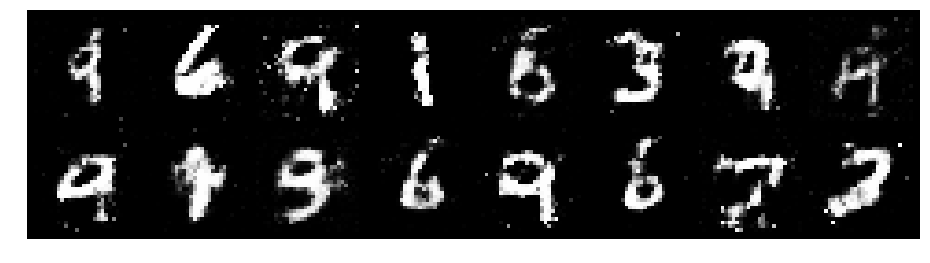

Epoch: [46/200], Batch Num: [100/600]
Discriminator Loss: 1.0656, Generator Loss: 1.0896
D(x): 0.6419, D(G(z)): 0.3873


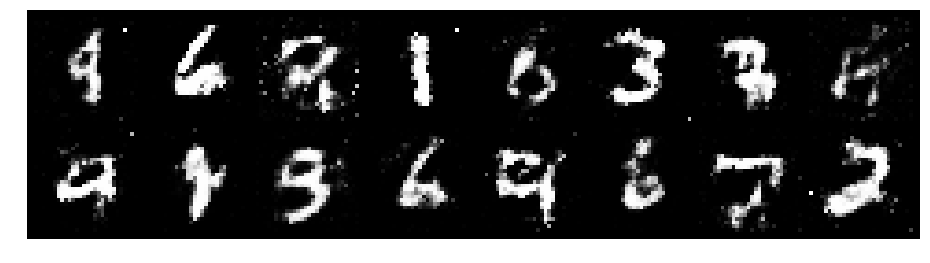

Epoch: [46/200], Batch Num: [200/600]
Discriminator Loss: 1.1240, Generator Loss: 1.1475
D(x): 0.5937, D(G(z)): 0.3710


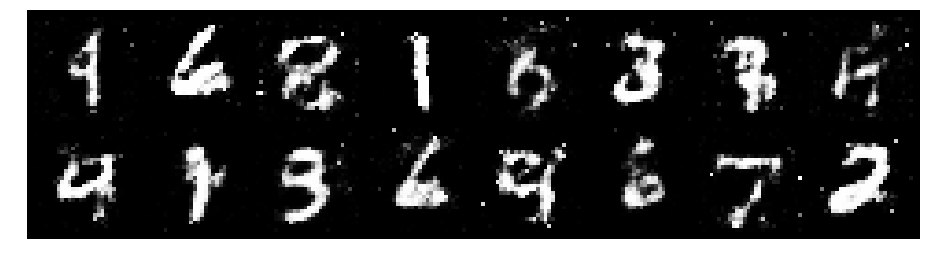

Epoch: [46/200], Batch Num: [300/600]
Discriminator Loss: 1.2035, Generator Loss: 0.9982
D(x): 0.6151, D(G(z)): 0.4082


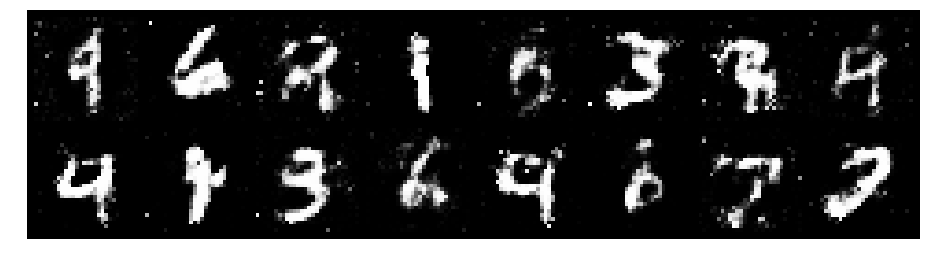

Epoch: [46/200], Batch Num: [400/600]
Discriminator Loss: 1.2194, Generator Loss: 1.0017
D(x): 0.6336, D(G(z)): 0.4365


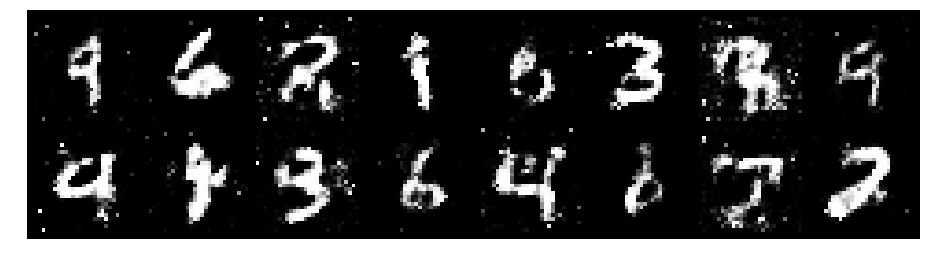

Epoch: [46/200], Batch Num: [500/600]
Discriminator Loss: 1.0832, Generator Loss: 1.0156
D(x): 0.5921, D(G(z)): 0.3211


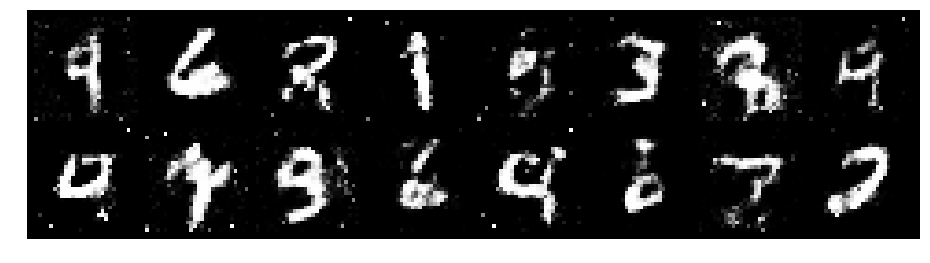

Epoch: [47/200], Batch Num: [0/600]
Discriminator Loss: 1.2396, Generator Loss: 1.1496
D(x): 0.6045, D(G(z)): 0.4095


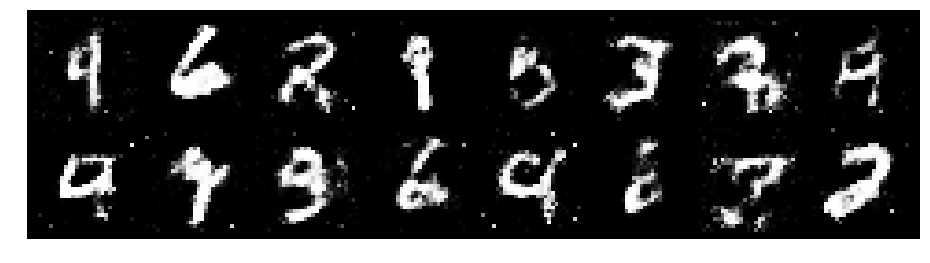

Epoch: [47/200], Batch Num: [100/600]
Discriminator Loss: 1.2724, Generator Loss: 1.0942
D(x): 0.6435, D(G(z)): 0.4767


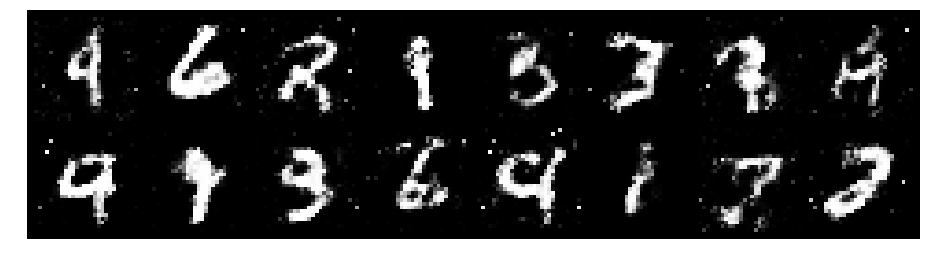

Epoch: [47/200], Batch Num: [200/600]
Discriminator Loss: 1.2669, Generator Loss: 1.0870
D(x): 0.6380, D(G(z)): 0.4504


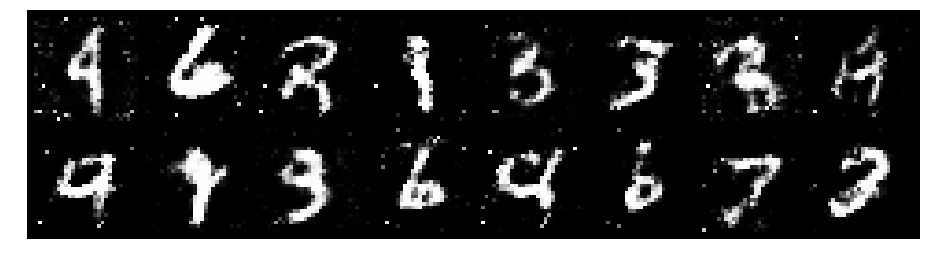

Epoch: [47/200], Batch Num: [300/600]
Discriminator Loss: 1.1934, Generator Loss: 1.1195
D(x): 0.6092, D(G(z)): 0.4245


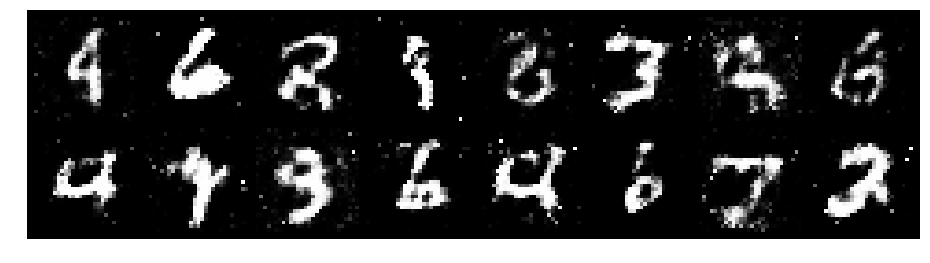

Epoch: [47/200], Batch Num: [400/600]
Discriminator Loss: 1.1431, Generator Loss: 1.2310
D(x): 0.5669, D(G(z)): 0.3537


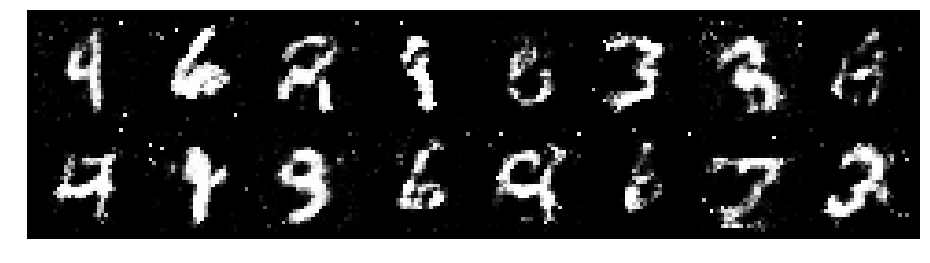

Epoch: [47/200], Batch Num: [500/600]
Discriminator Loss: 1.1351, Generator Loss: 1.1034
D(x): 0.6264, D(G(z)): 0.3835


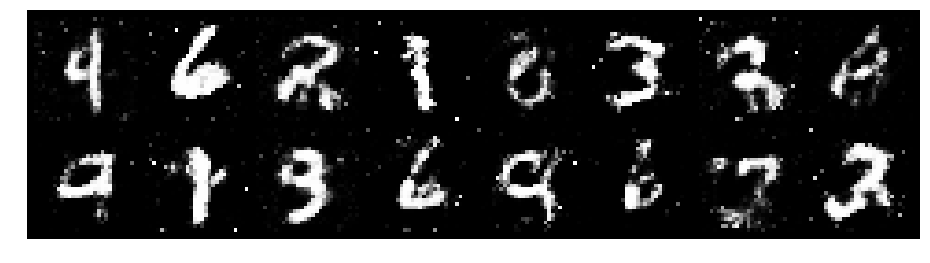

Epoch: [48/200], Batch Num: [0/600]
Discriminator Loss: 1.0474, Generator Loss: 1.6820
D(x): 0.6382, D(G(z)): 0.3329


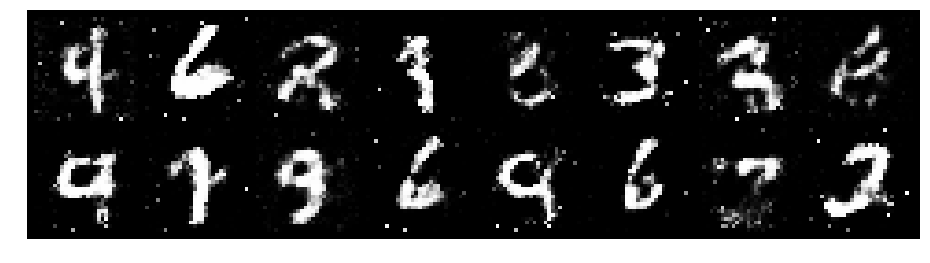

Epoch: [48/200], Batch Num: [100/600]
Discriminator Loss: 1.0312, Generator Loss: 1.1634
D(x): 0.6293, D(G(z)): 0.3376


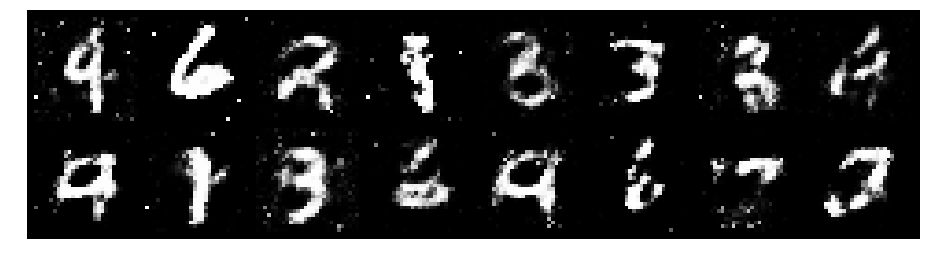

Epoch: [48/200], Batch Num: [200/600]
Discriminator Loss: 1.0845, Generator Loss: 0.8568
D(x): 0.6314, D(G(z)): 0.4011


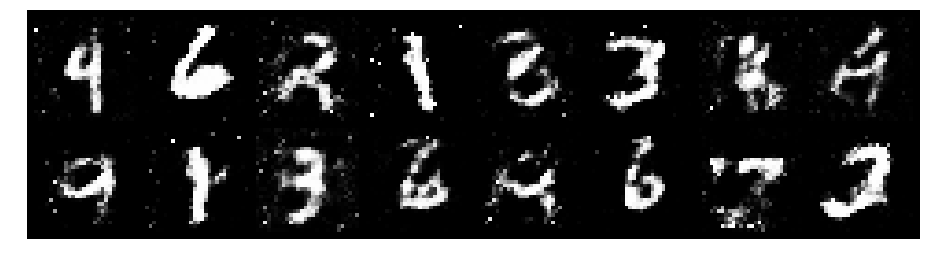

Epoch: [48/200], Batch Num: [300/600]
Discriminator Loss: 1.0913, Generator Loss: 1.0169
D(x): 0.6139, D(G(z)): 0.3891


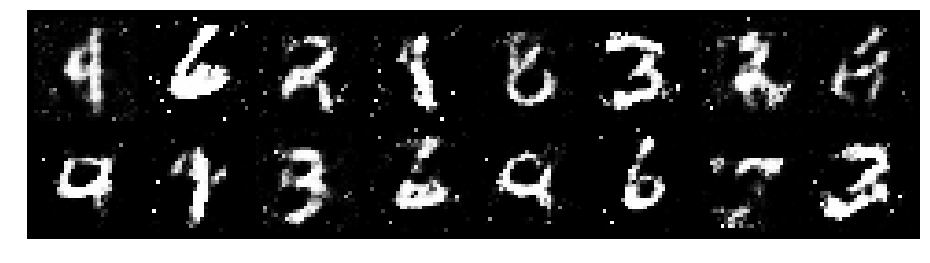

Epoch: [48/200], Batch Num: [400/600]
Discriminator Loss: 1.1847, Generator Loss: 0.8801
D(x): 0.5981, D(G(z)): 0.4376


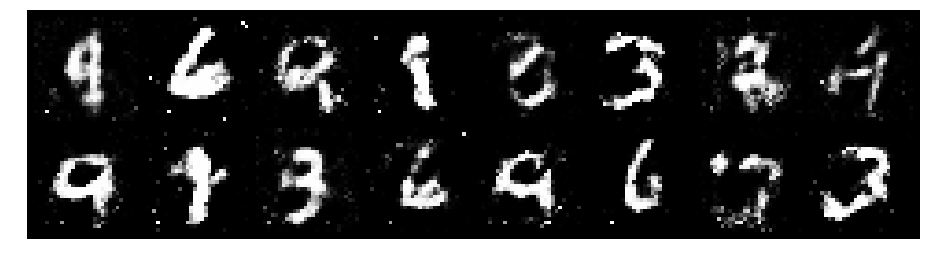

Epoch: [48/200], Batch Num: [500/600]
Discriminator Loss: 1.2364, Generator Loss: 1.0382
D(x): 0.6266, D(G(z)): 0.4486


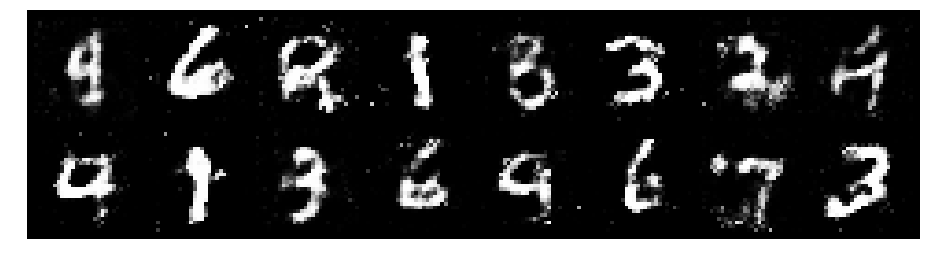

Epoch: [49/200], Batch Num: [0/600]
Discriminator Loss: 1.4272, Generator Loss: 0.9602
D(x): 0.5990, D(G(z)): 0.5103


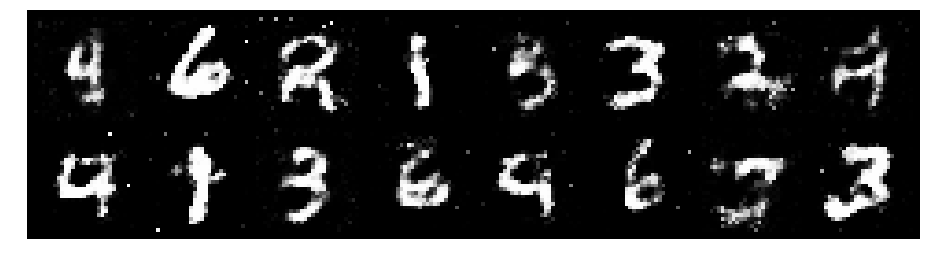

Epoch: [49/200], Batch Num: [100/600]
Discriminator Loss: 1.2226, Generator Loss: 1.1258
D(x): 0.5752, D(G(z)): 0.3612


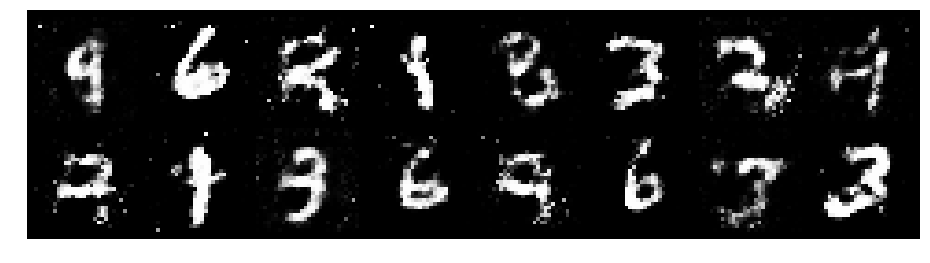

Epoch: [49/200], Batch Num: [200/600]
Discriminator Loss: 1.1918, Generator Loss: 1.0722
D(x): 0.5921, D(G(z)): 0.4032


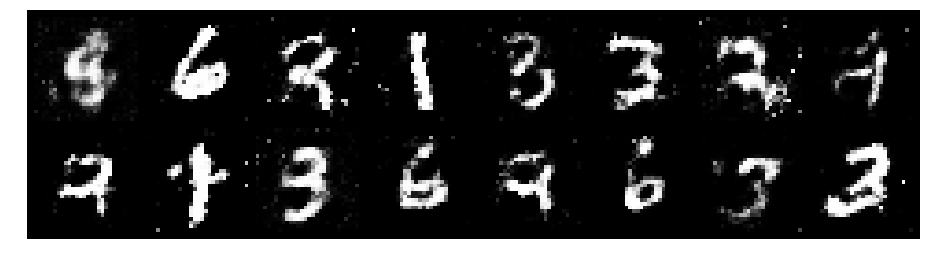

Epoch: [49/200], Batch Num: [300/600]
Discriminator Loss: 1.1611, Generator Loss: 1.0993
D(x): 0.5554, D(G(z)): 0.3561


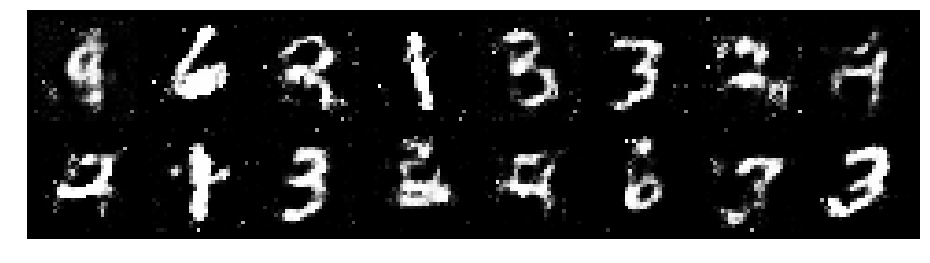

Epoch: [49/200], Batch Num: [400/600]
Discriminator Loss: 1.1091, Generator Loss: 1.0353
D(x): 0.6361, D(G(z)): 0.4078


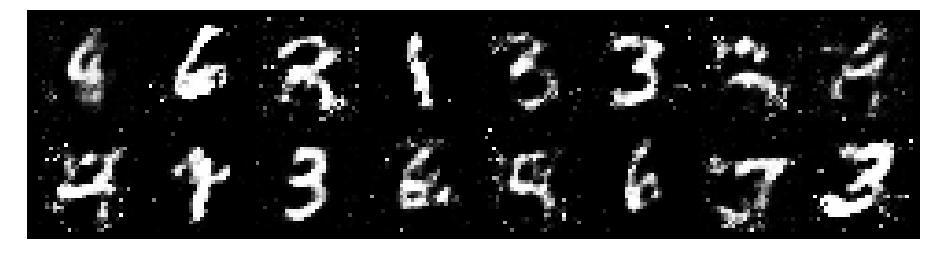

Epoch: [49/200], Batch Num: [500/600]
Discriminator Loss: 1.2750, Generator Loss: 0.9704
D(x): 0.5992, D(G(z)): 0.4589


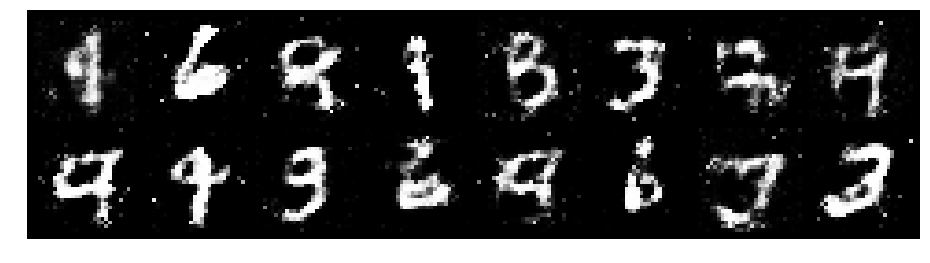

Epoch: [50/200], Batch Num: [0/600]
Discriminator Loss: 1.1721, Generator Loss: 0.9360
D(x): 0.6009, D(G(z)): 0.4143


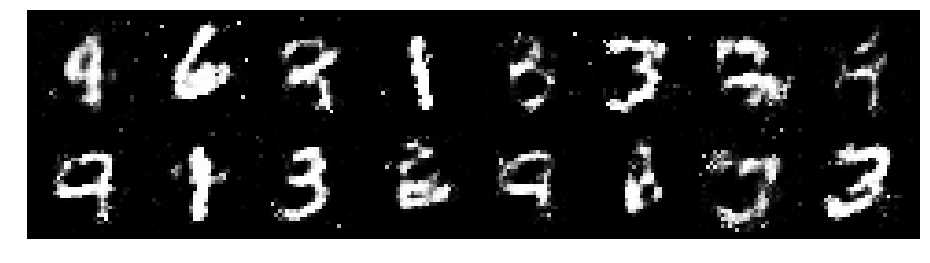

Epoch: [50/200], Batch Num: [100/600]
Discriminator Loss: 1.2312, Generator Loss: 0.8513
D(x): 0.5959, D(G(z)): 0.4572


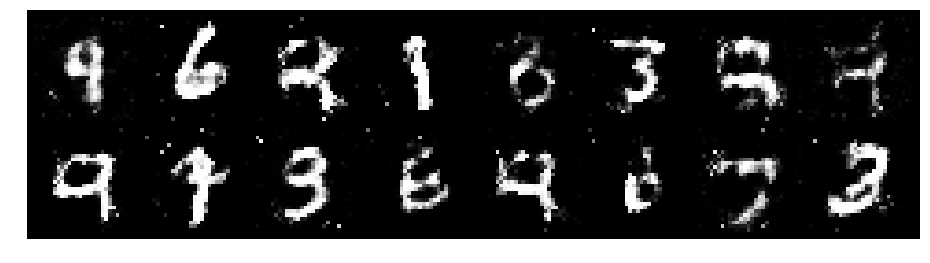

Epoch: [50/200], Batch Num: [200/600]
Discriminator Loss: 1.2491, Generator Loss: 0.8533
D(x): 0.5603, D(G(z)): 0.4210


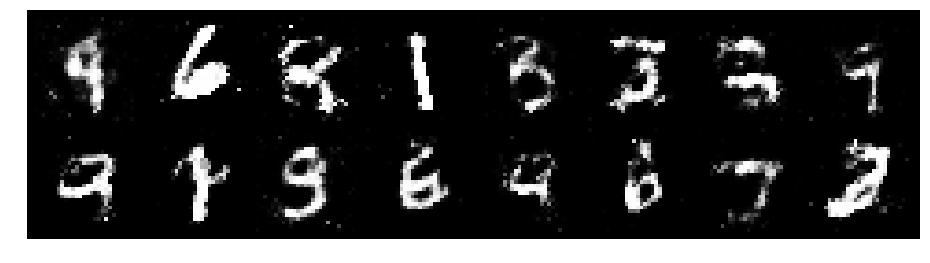

Epoch: [50/200], Batch Num: [300/600]
Discriminator Loss: 1.3056, Generator Loss: 1.0019
D(x): 0.5209, D(G(z)): 0.3915


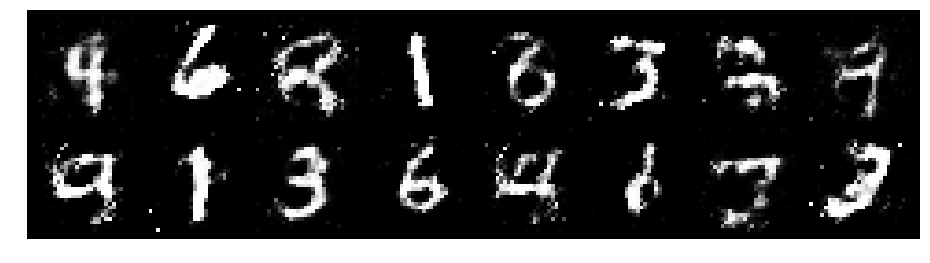

Epoch: [50/200], Batch Num: [400/600]
Discriminator Loss: 1.3194, Generator Loss: 0.8946
D(x): 0.5910, D(G(z)): 0.4719


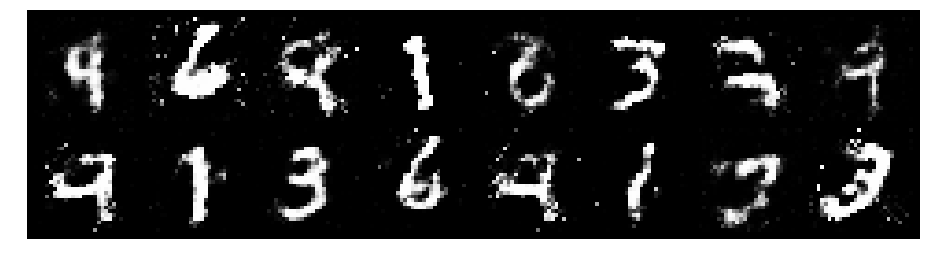

Epoch: [50/200], Batch Num: [500/600]
Discriminator Loss: 1.3451, Generator Loss: 0.8735
D(x): 0.5457, D(G(z)): 0.4454


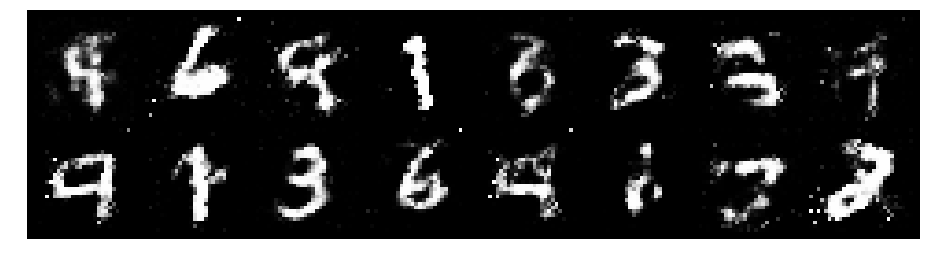

Epoch: [51/200], Batch Num: [0/600]
Discriminator Loss: 1.1626, Generator Loss: 0.9447
D(x): 0.5929, D(G(z)): 0.4114


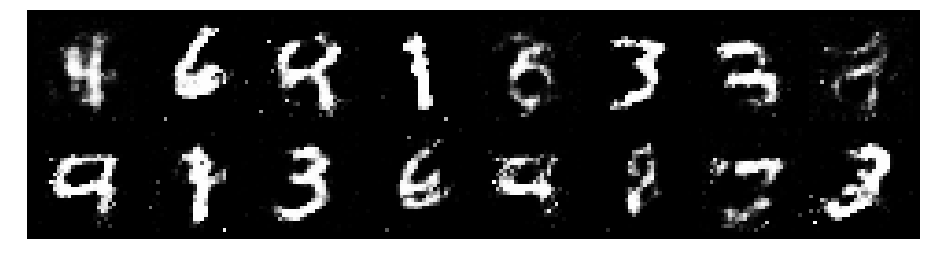

Epoch: [51/200], Batch Num: [100/600]
Discriminator Loss: 1.1867, Generator Loss: 0.9937
D(x): 0.6354, D(G(z)): 0.4319


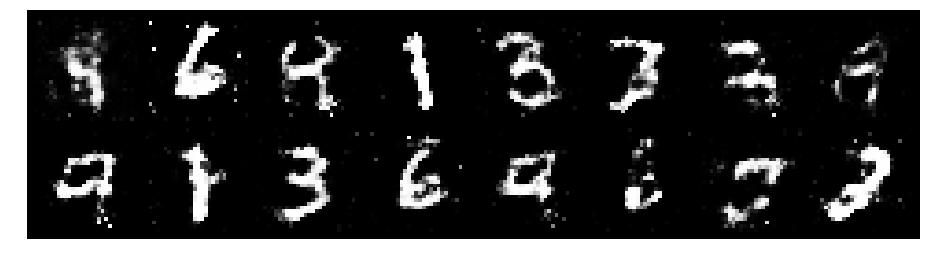

Epoch: [51/200], Batch Num: [200/600]
Discriminator Loss: 1.1854, Generator Loss: 1.2404
D(x): 0.5220, D(G(z)): 0.3194


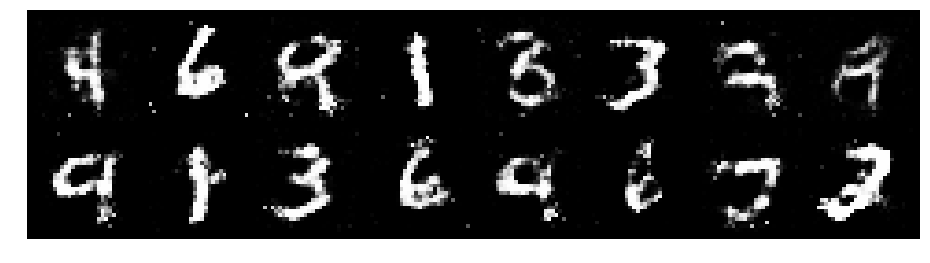

Epoch: [51/200], Batch Num: [300/600]
Discriminator Loss: 1.0802, Generator Loss: 1.1902
D(x): 0.6020, D(G(z)): 0.3732


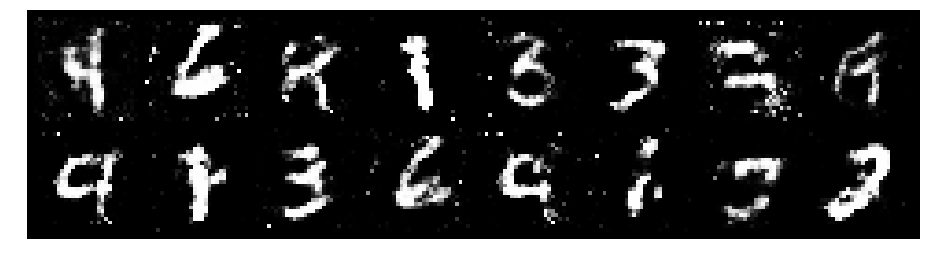

Epoch: [51/200], Batch Num: [400/600]
Discriminator Loss: 1.1210, Generator Loss: 1.0352
D(x): 0.6344, D(G(z)): 0.4185


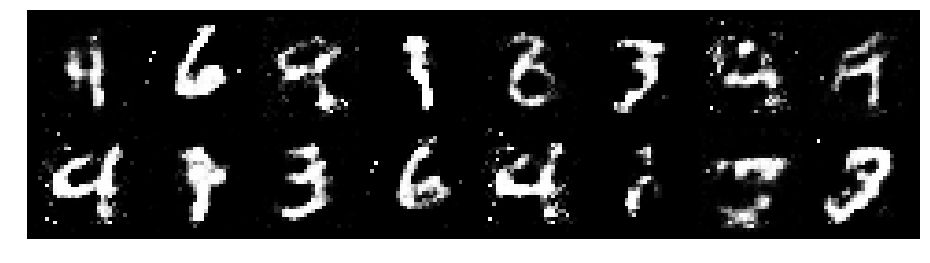

Epoch: [51/200], Batch Num: [500/600]
Discriminator Loss: 1.1190, Generator Loss: 1.1347
D(x): 0.6071, D(G(z)): 0.4009


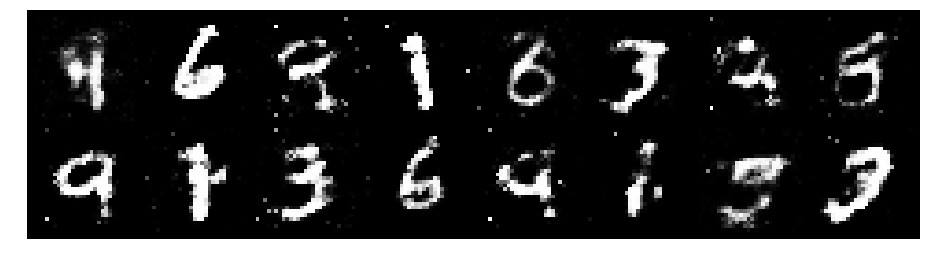

Epoch: [52/200], Batch Num: [0/600]
Discriminator Loss: 1.1640, Generator Loss: 0.9539
D(x): 0.5941, D(G(z)): 0.4105


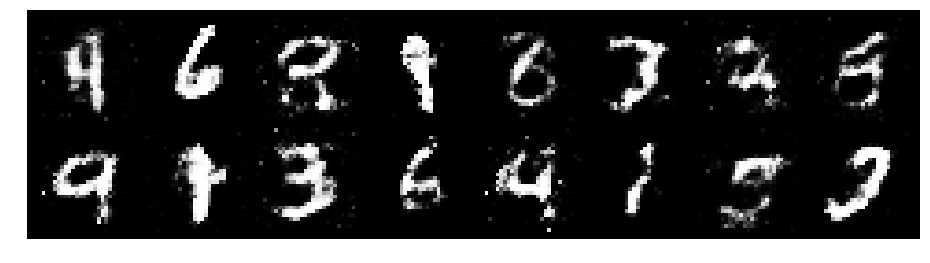

Epoch: [52/200], Batch Num: [100/600]
Discriminator Loss: 1.1476, Generator Loss: 1.0253
D(x): 0.6169, D(G(z)): 0.4196


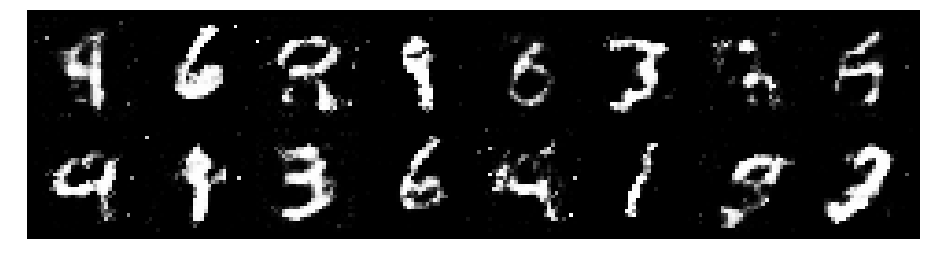

Epoch: [52/200], Batch Num: [200/600]
Discriminator Loss: 1.1903, Generator Loss: 1.1841
D(x): 0.5690, D(G(z)): 0.3466


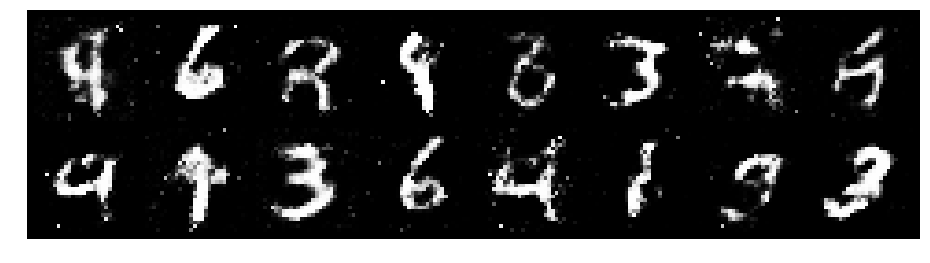

Epoch: [52/200], Batch Num: [300/600]
Discriminator Loss: 1.1291, Generator Loss: 1.1555
D(x): 0.6291, D(G(z)): 0.4113


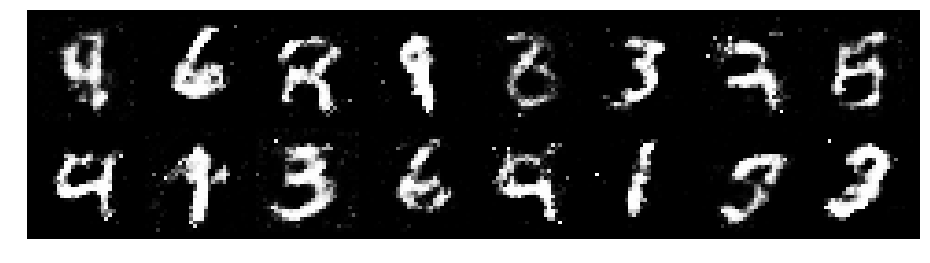

Epoch: [52/200], Batch Num: [400/600]
Discriminator Loss: 1.0236, Generator Loss: 1.2292
D(x): 0.6116, D(G(z)): 0.3269


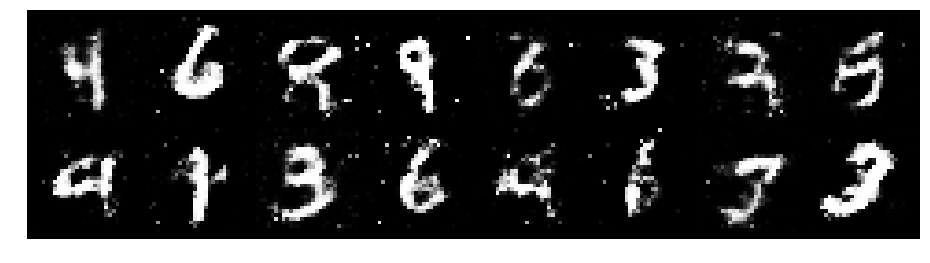

Epoch: [52/200], Batch Num: [500/600]
Discriminator Loss: 0.9769, Generator Loss: 1.4323
D(x): 0.6172, D(G(z)): 0.3143


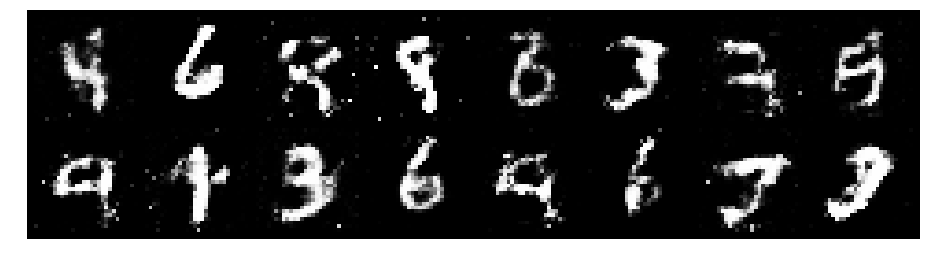

Epoch: [53/200], Batch Num: [0/600]
Discriminator Loss: 1.0879, Generator Loss: 1.0519
D(x): 0.6132, D(G(z)): 0.3779


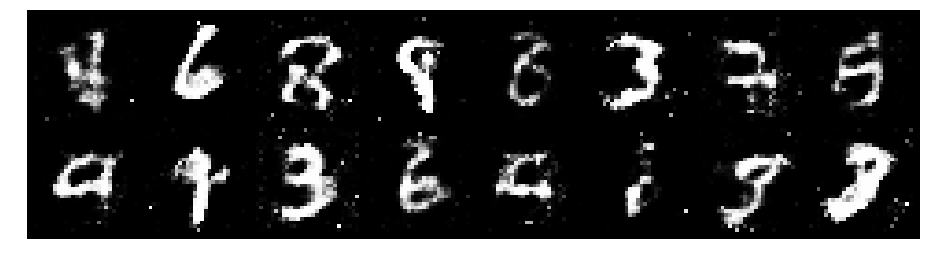

Epoch: [53/200], Batch Num: [100/600]
Discriminator Loss: 1.0837, Generator Loss: 1.0242
D(x): 0.5912, D(G(z)): 0.3771


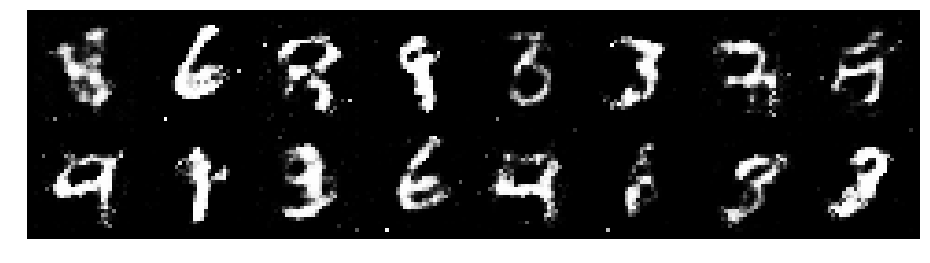

Epoch: [53/200], Batch Num: [200/600]
Discriminator Loss: 1.1207, Generator Loss: 1.2372
D(x): 0.6541, D(G(z)): 0.4119


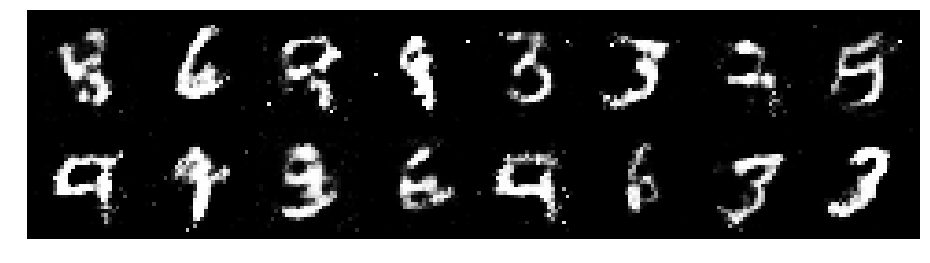

Epoch: [53/200], Batch Num: [300/600]
Discriminator Loss: 1.0840, Generator Loss: 1.3757
D(x): 0.6078, D(G(z)): 0.3528


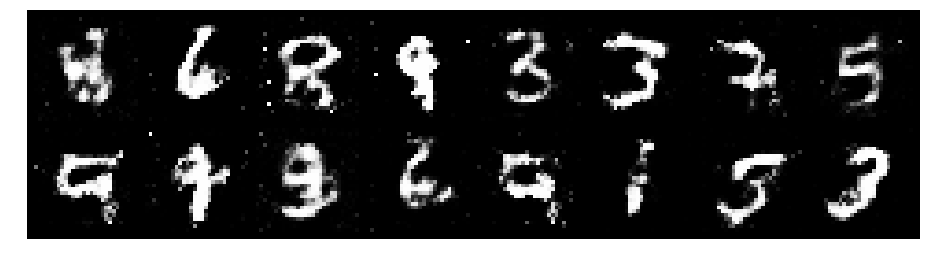

Epoch: [53/200], Batch Num: [400/600]
Discriminator Loss: 1.3374, Generator Loss: 0.9178
D(x): 0.5714, D(G(z)): 0.4696


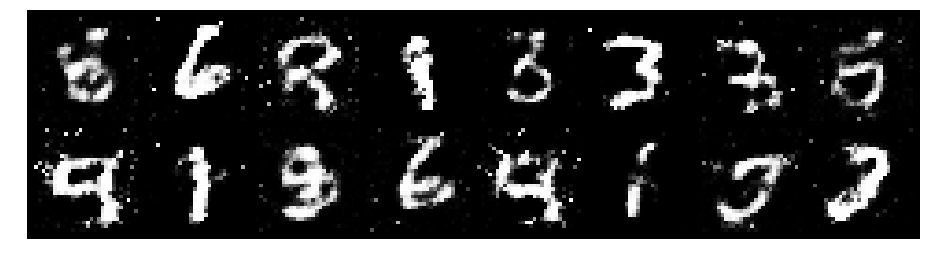

Epoch: [53/200], Batch Num: [500/600]
Discriminator Loss: 1.5034, Generator Loss: 0.9309
D(x): 0.5189, D(G(z)): 0.4878


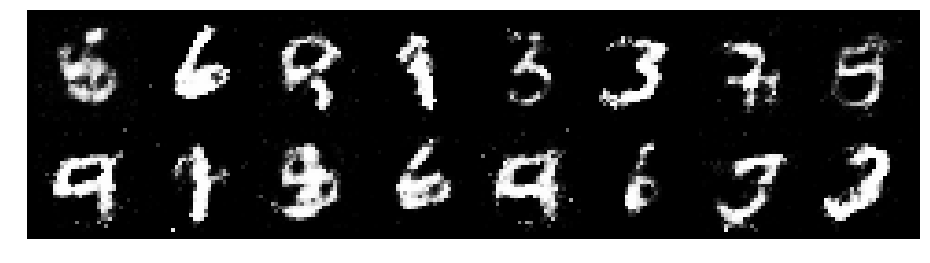

Epoch: [54/200], Batch Num: [0/600]
Discriminator Loss: 1.2665, Generator Loss: 1.0298
D(x): 0.5834, D(G(z)): 0.4286


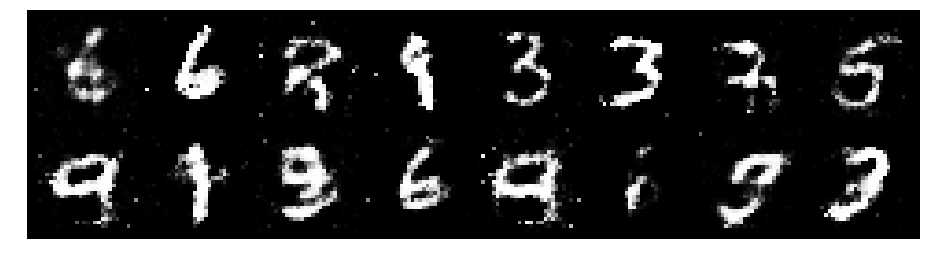

Epoch: [54/200], Batch Num: [100/600]
Discriminator Loss: 1.0901, Generator Loss: 1.7743
D(x): 0.6276, D(G(z)): 0.3629


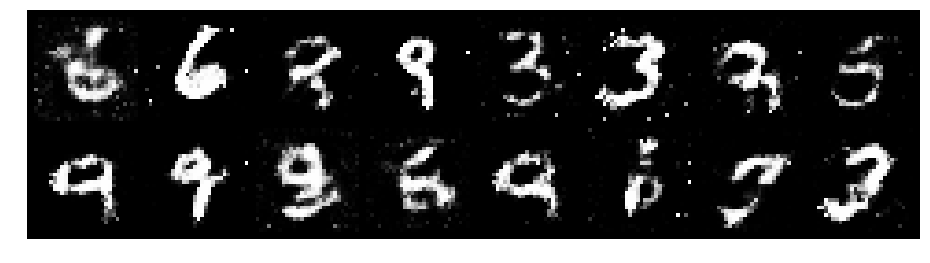

Epoch: [54/200], Batch Num: [200/600]
Discriminator Loss: 1.0680, Generator Loss: 1.0791
D(x): 0.6061, D(G(z)): 0.3805


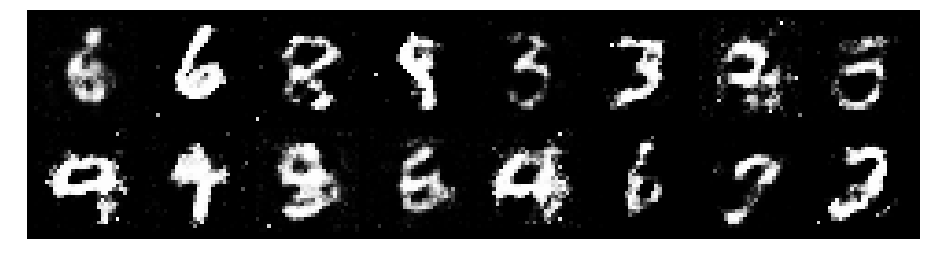

Epoch: [54/200], Batch Num: [300/600]
Discriminator Loss: 1.0290, Generator Loss: 1.0976
D(x): 0.6413, D(G(z)): 0.3678


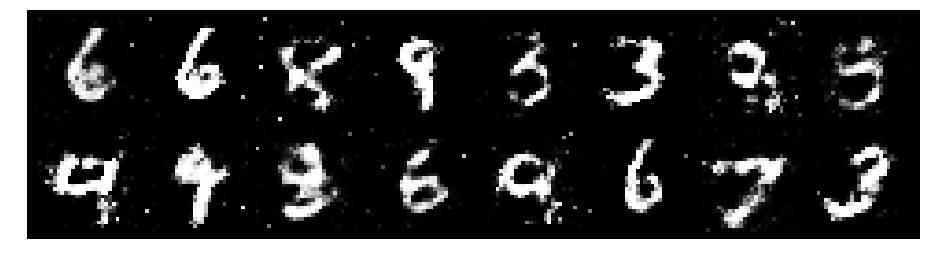

Epoch: [54/200], Batch Num: [400/600]
Discriminator Loss: 1.2049, Generator Loss: 1.1703
D(x): 0.5403, D(G(z)): 0.3598


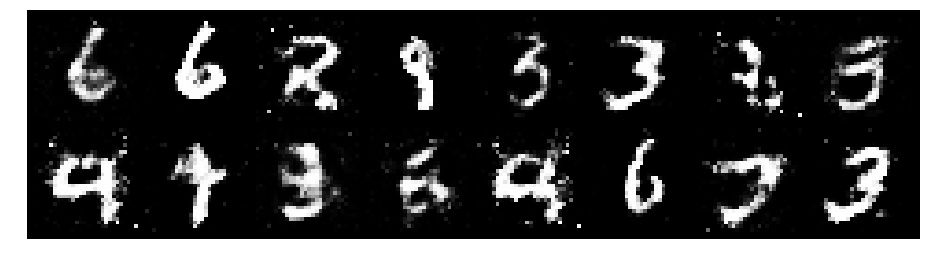

Epoch: [54/200], Batch Num: [500/600]
Discriminator Loss: 1.1081, Generator Loss: 0.9440
D(x): 0.5879, D(G(z)): 0.3831


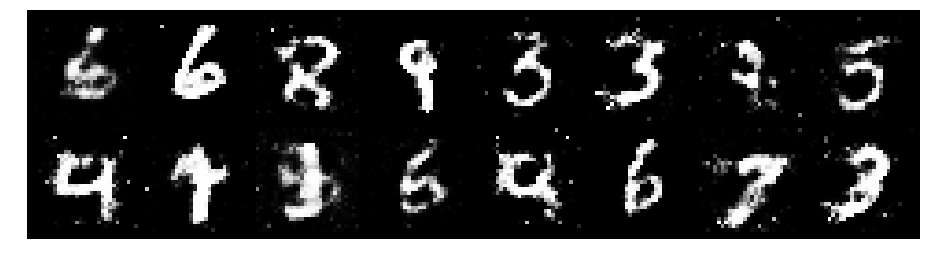

Epoch: [55/200], Batch Num: [0/600]
Discriminator Loss: 1.2122, Generator Loss: 0.9576
D(x): 0.5613, D(G(z)): 0.4287


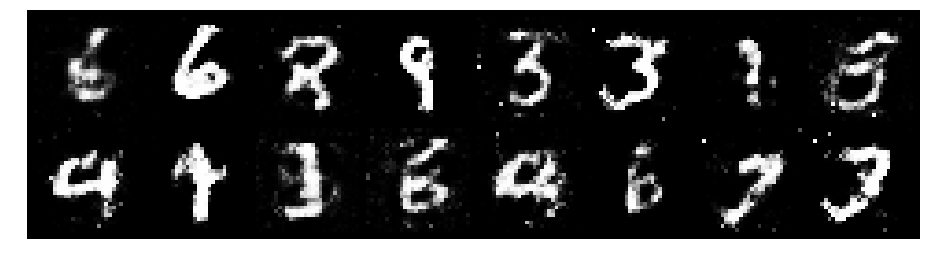

Epoch: [55/200], Batch Num: [100/600]
Discriminator Loss: 1.1661, Generator Loss: 0.9374
D(x): 0.5982, D(G(z)): 0.4329


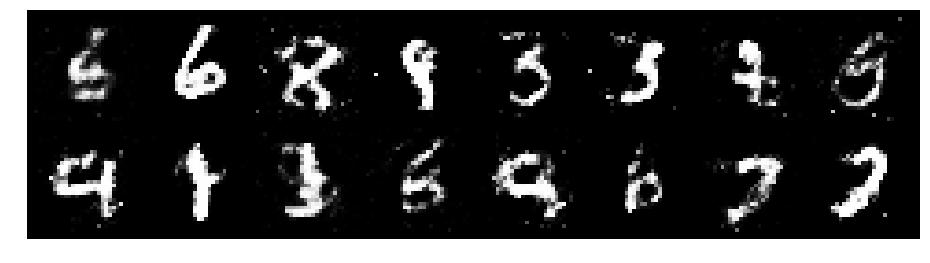

Epoch: [55/200], Batch Num: [200/600]
Discriminator Loss: 1.2056, Generator Loss: 0.8945
D(x): 0.5583, D(G(z)): 0.4126


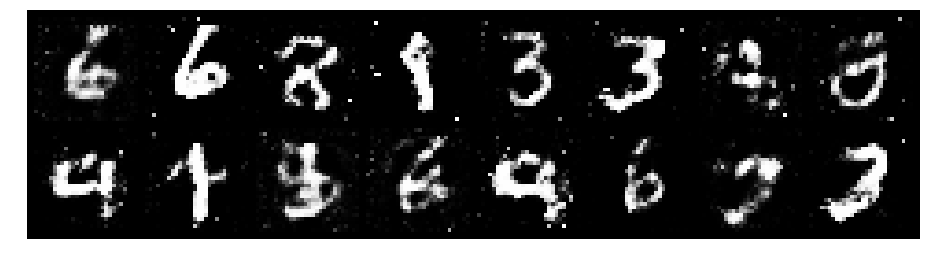

Epoch: [55/200], Batch Num: [300/600]
Discriminator Loss: 1.2645, Generator Loss: 0.9287
D(x): 0.5913, D(G(z)): 0.4507


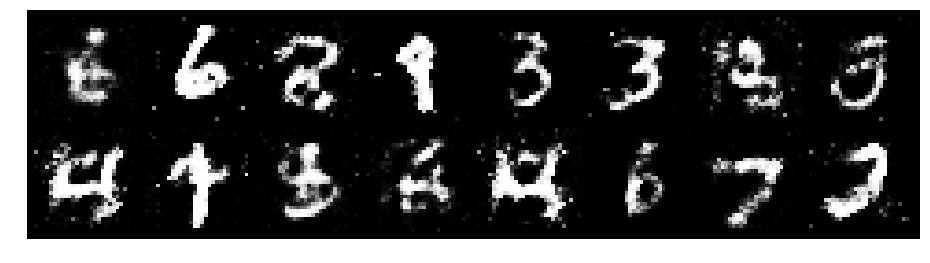

Epoch: [55/200], Batch Num: [400/600]
Discriminator Loss: 1.2675, Generator Loss: 0.8793
D(x): 0.5724, D(G(z)): 0.4460


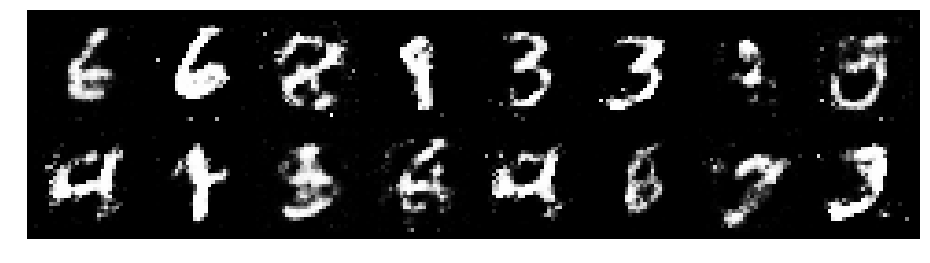

Epoch: [55/200], Batch Num: [500/600]
Discriminator Loss: 1.2807, Generator Loss: 1.0414
D(x): 0.5274, D(G(z)): 0.3945


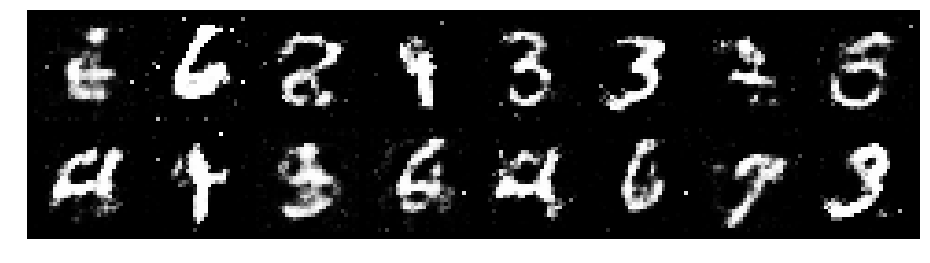

Epoch: [56/200], Batch Num: [0/600]
Discriminator Loss: 1.2041, Generator Loss: 0.9101
D(x): 0.6135, D(G(z)): 0.4395


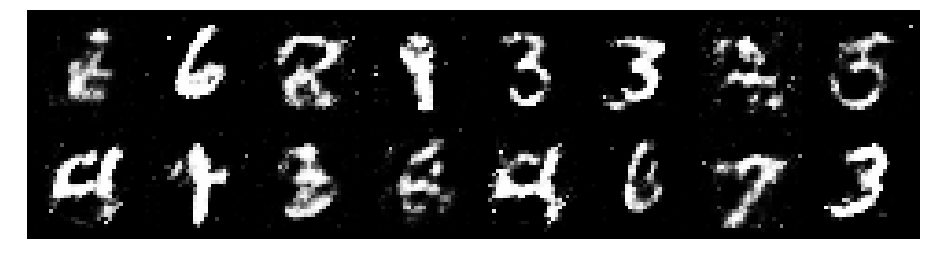

Epoch: [56/200], Batch Num: [100/600]
Discriminator Loss: 1.1423, Generator Loss: 1.2003
D(x): 0.5393, D(G(z)): 0.3249


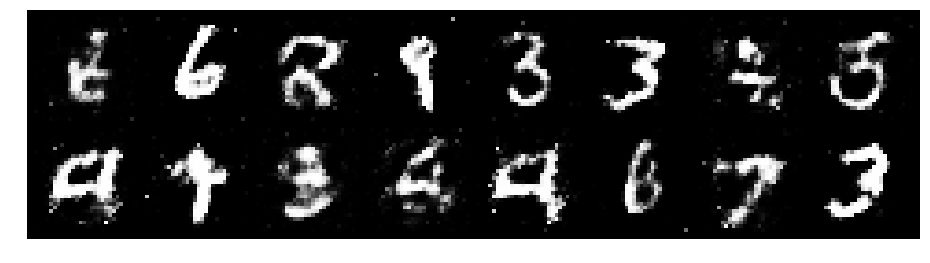

Epoch: [56/200], Batch Num: [200/600]
Discriminator Loss: 1.2438, Generator Loss: 1.0283
D(x): 0.6259, D(G(z)): 0.4314


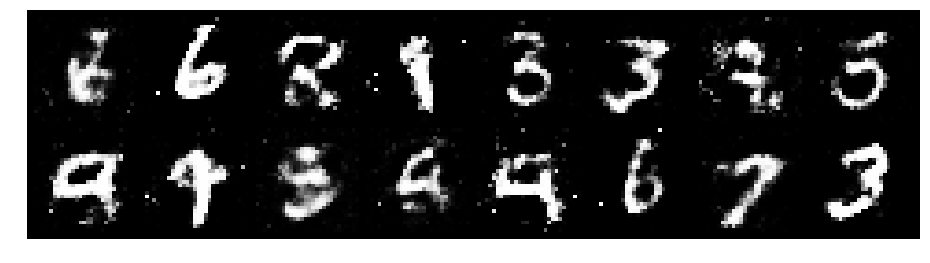

Epoch: [56/200], Batch Num: [300/600]
Discriminator Loss: 1.2692, Generator Loss: 1.0444
D(x): 0.5352, D(G(z)): 0.3838


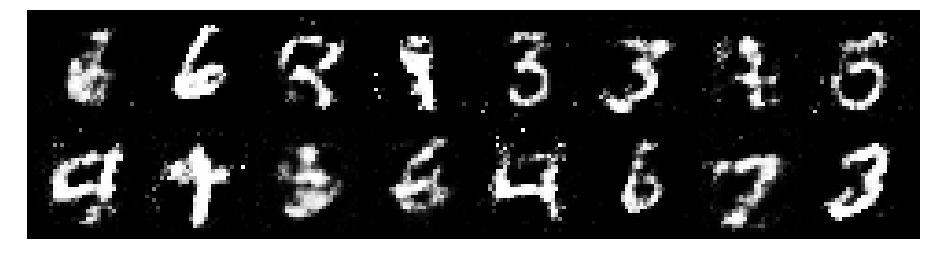

Epoch: [56/200], Batch Num: [400/600]
Discriminator Loss: 1.2610, Generator Loss: 1.1965
D(x): 0.5981, D(G(z)): 0.3972


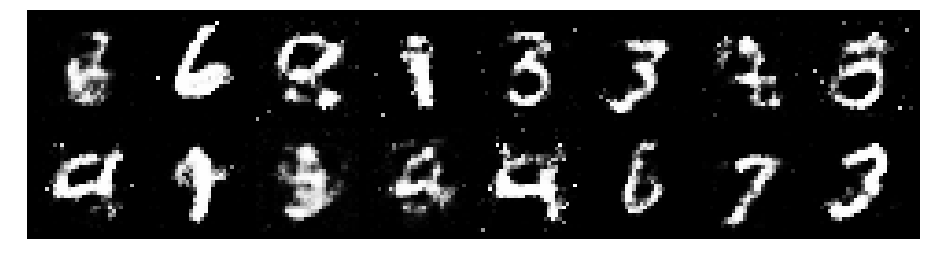

Epoch: [56/200], Batch Num: [500/600]
Discriminator Loss: 1.2266, Generator Loss: 1.0408
D(x): 0.6095, D(G(z)): 0.4139


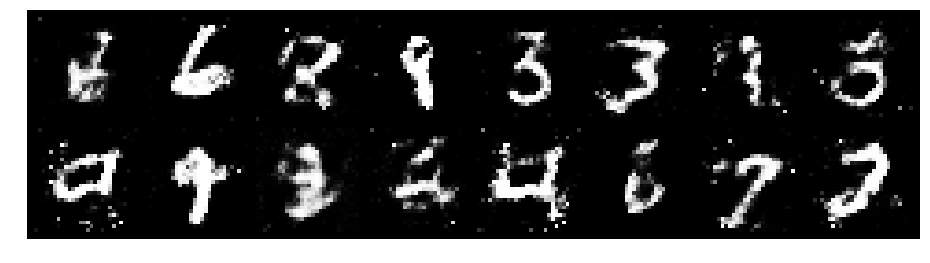

Epoch: [57/200], Batch Num: [0/600]
Discriminator Loss: 1.1405, Generator Loss: 1.1873
D(x): 0.5929, D(G(z)): 0.3569


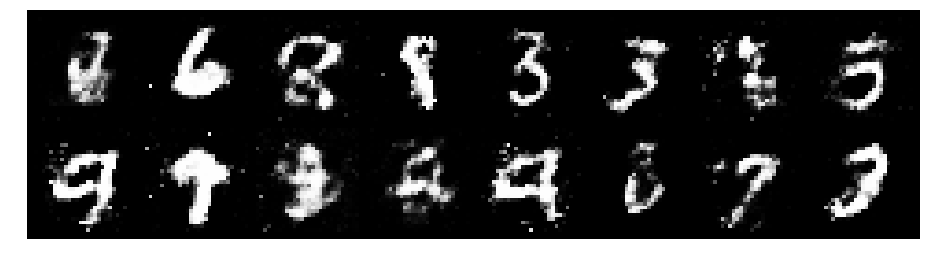

Epoch: [57/200], Batch Num: [100/600]
Discriminator Loss: 1.0672, Generator Loss: 1.1330
D(x): 0.6329, D(G(z)): 0.3895


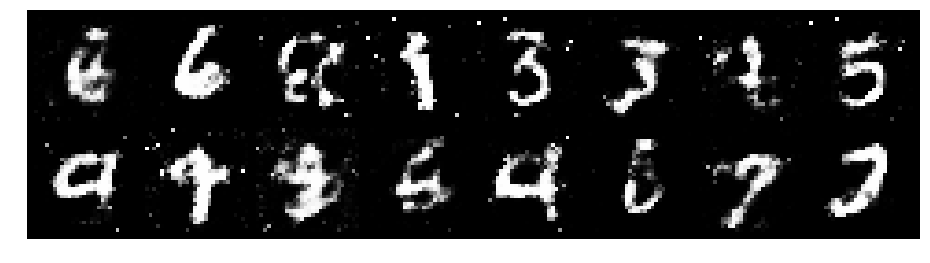

Epoch: [57/200], Batch Num: [200/600]
Discriminator Loss: 1.0969, Generator Loss: 0.9891
D(x): 0.5961, D(G(z)): 0.3815


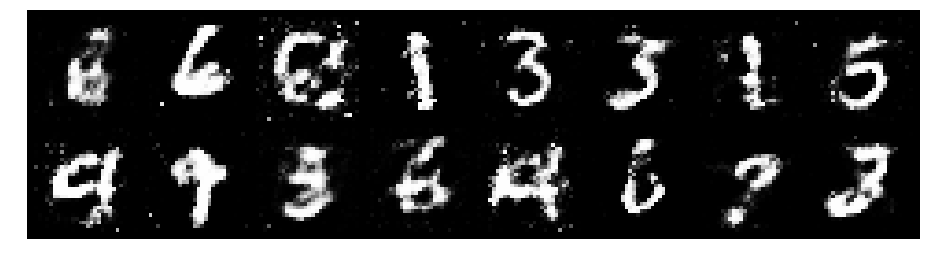

Epoch: [57/200], Batch Num: [300/600]
Discriminator Loss: 1.1434, Generator Loss: 1.0067
D(x): 0.6376, D(G(z)): 0.4176


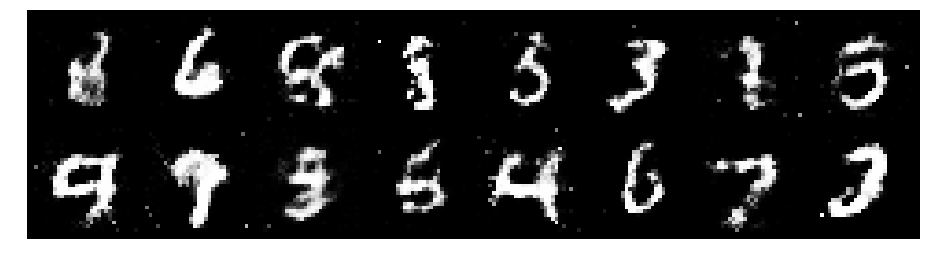

Epoch: [57/200], Batch Num: [400/600]
Discriminator Loss: 1.1509, Generator Loss: 0.9096
D(x): 0.5776, D(G(z)): 0.4156


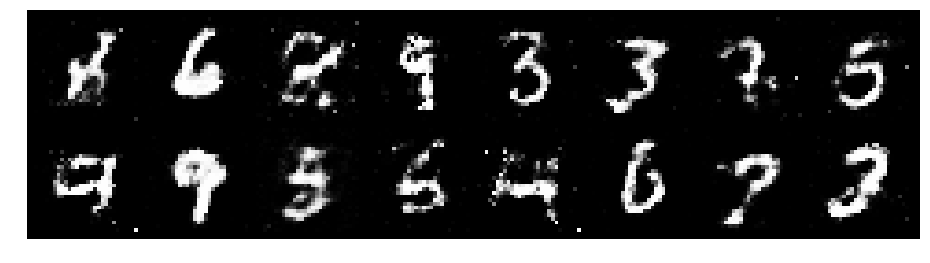

Epoch: [57/200], Batch Num: [500/600]
Discriminator Loss: 1.3325, Generator Loss: 0.8586
D(x): 0.6046, D(G(z)): 0.4915


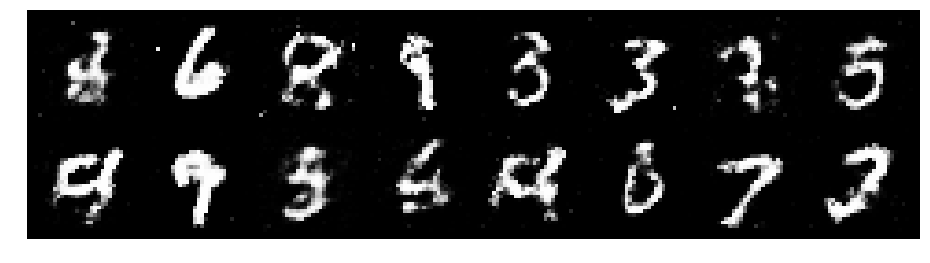

Epoch: [58/200], Batch Num: [0/600]
Discriminator Loss: 1.2876, Generator Loss: 0.9145
D(x): 0.5915, D(G(z)): 0.4495


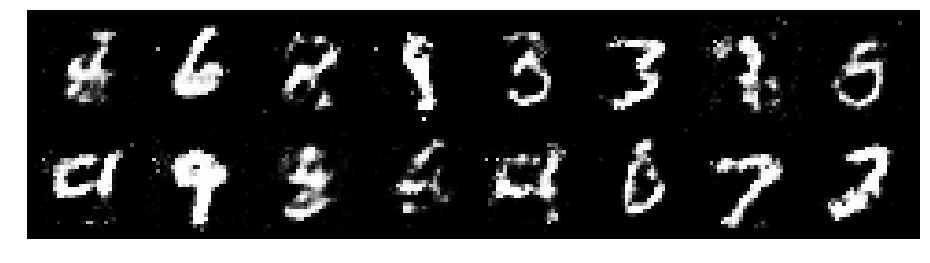

Epoch: [58/200], Batch Num: [100/600]
Discriminator Loss: 1.1110, Generator Loss: 1.0976
D(x): 0.6267, D(G(z)): 0.3899


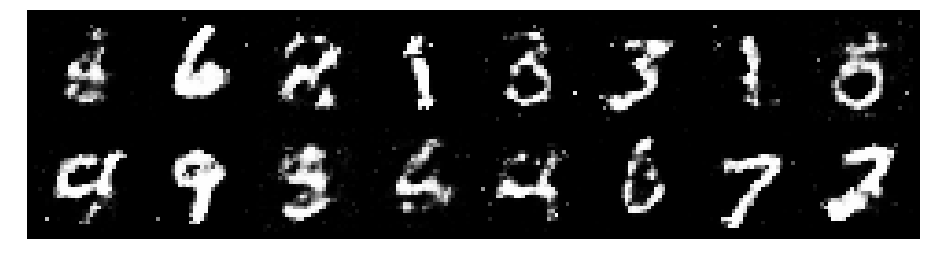

Epoch: [58/200], Batch Num: [200/600]
Discriminator Loss: 1.0724, Generator Loss: 1.1172
D(x): 0.6339, D(G(z)): 0.4017


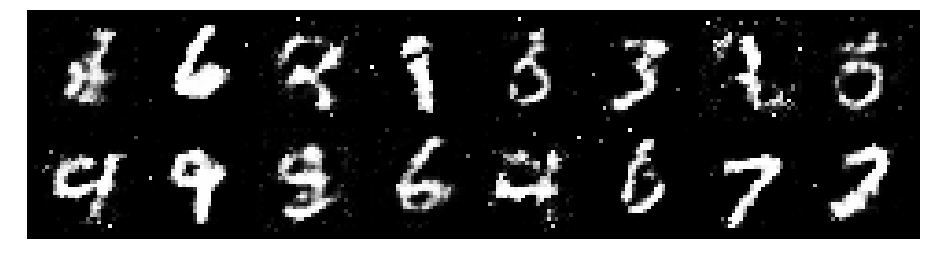

Epoch: [58/200], Batch Num: [300/600]
Discriminator Loss: 1.0614, Generator Loss: 0.9773
D(x): 0.6378, D(G(z)): 0.3982


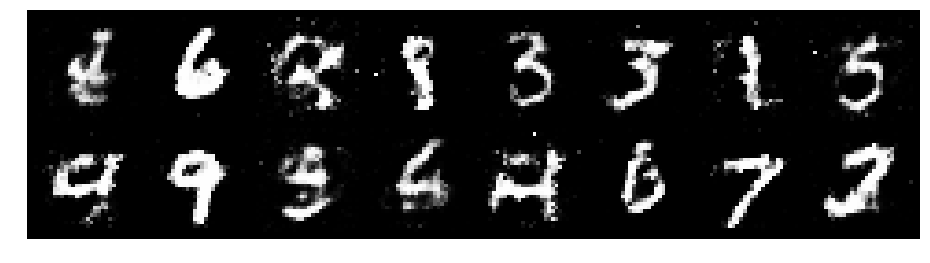

Epoch: [58/200], Batch Num: [400/600]
Discriminator Loss: 1.0816, Generator Loss: 1.0114
D(x): 0.6005, D(G(z)): 0.3830


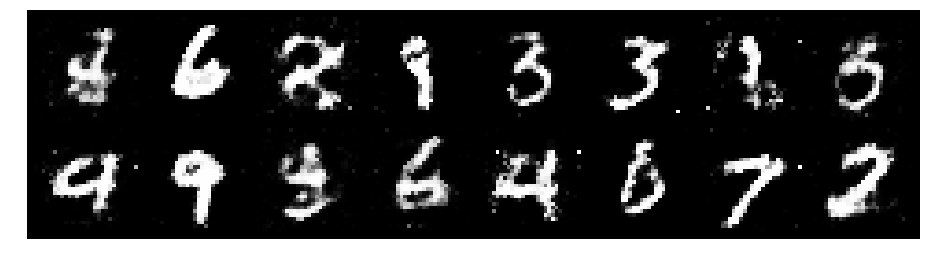

Epoch: [58/200], Batch Num: [500/600]
Discriminator Loss: 1.1560, Generator Loss: 1.0471
D(x): 0.5967, D(G(z)): 0.4234


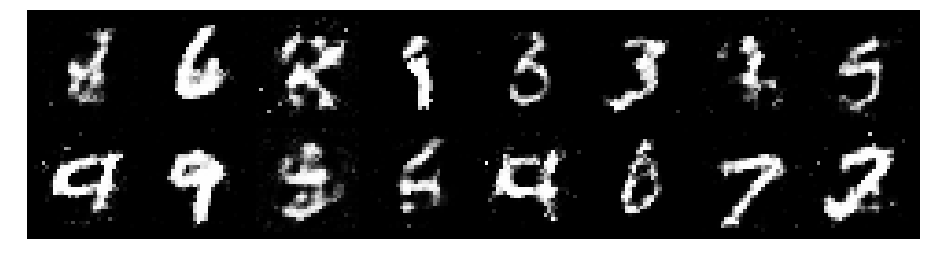

Epoch: [59/200], Batch Num: [0/600]
Discriminator Loss: 1.2577, Generator Loss: 0.9697
D(x): 0.5486, D(G(z)): 0.4093


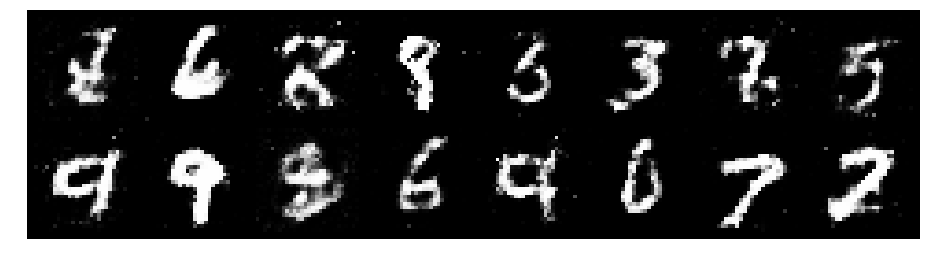

Epoch: [59/200], Batch Num: [100/600]
Discriminator Loss: 1.2331, Generator Loss: 0.7948
D(x): 0.6364, D(G(z)): 0.4754


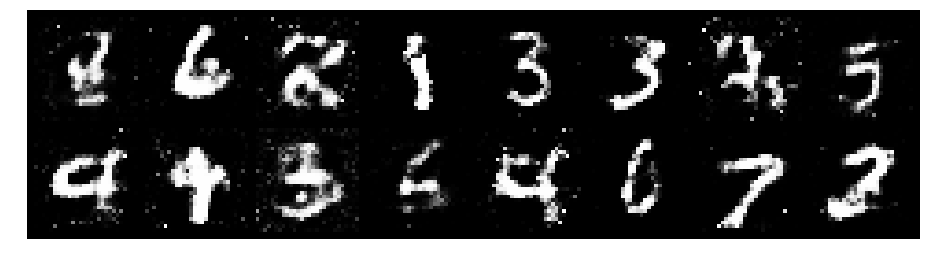

Epoch: [59/200], Batch Num: [200/600]
Discriminator Loss: 1.1286, Generator Loss: 1.1136
D(x): 0.6153, D(G(z)): 0.4016


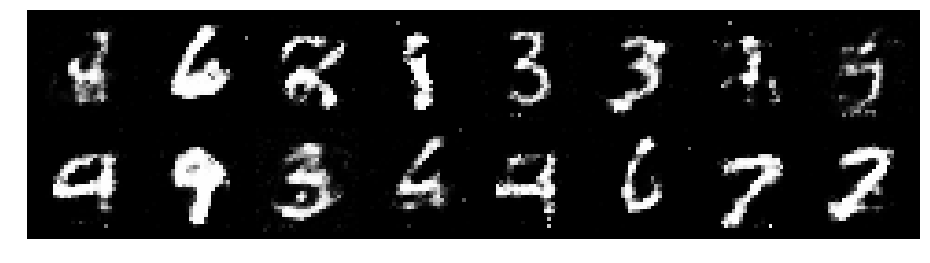

Epoch: [59/200], Batch Num: [300/600]
Discriminator Loss: 1.1356, Generator Loss: 1.0773
D(x): 0.5838, D(G(z)): 0.3949


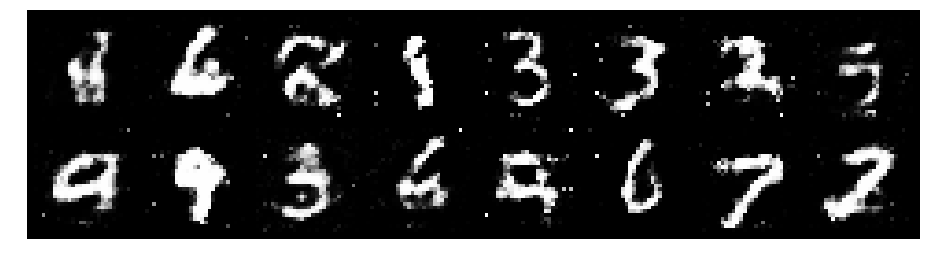

Epoch: [59/200], Batch Num: [400/600]
Discriminator Loss: 1.1358, Generator Loss: 0.9086
D(x): 0.6325, D(G(z)): 0.4396


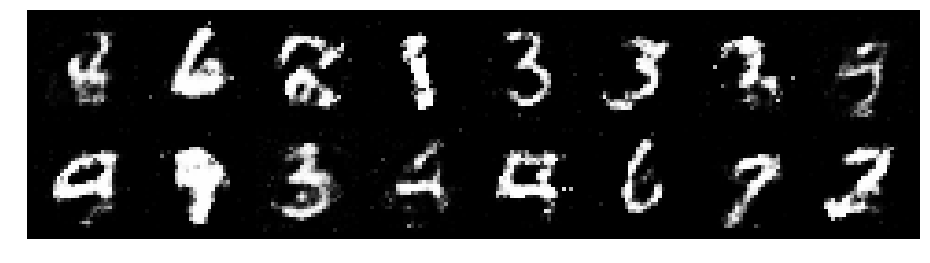

Epoch: [59/200], Batch Num: [500/600]
Discriminator Loss: 1.1414, Generator Loss: 0.9735
D(x): 0.6118, D(G(z)): 0.4079


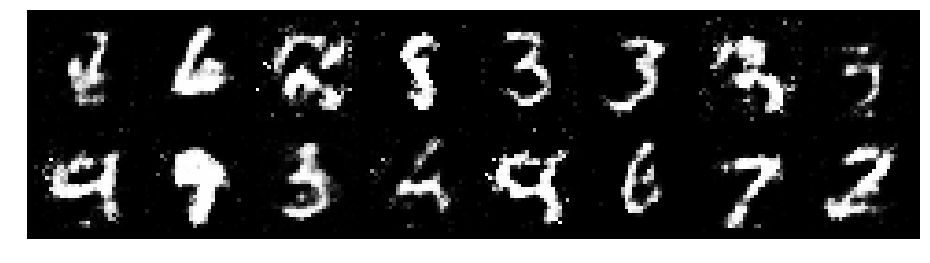

Epoch: [60/200], Batch Num: [0/600]
Discriminator Loss: 1.2708, Generator Loss: 0.9961
D(x): 0.6221, D(G(z)): 0.4713


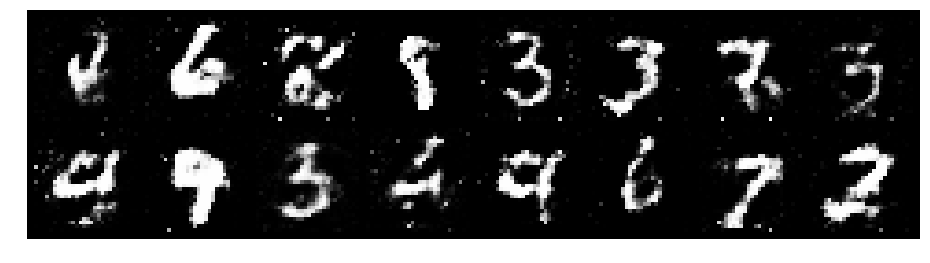

Epoch: [60/200], Batch Num: [100/600]
Discriminator Loss: 1.1140, Generator Loss: 0.9710
D(x): 0.6266, D(G(z)): 0.4071


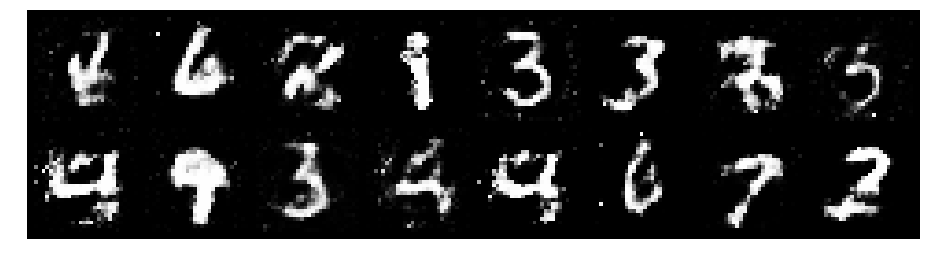

Epoch: [60/200], Batch Num: [200/600]
Discriminator Loss: 1.2480, Generator Loss: 1.0799
D(x): 0.6265, D(G(z)): 0.4409


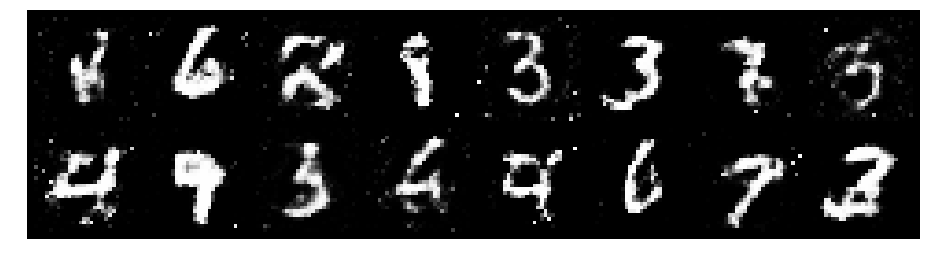

Epoch: [60/200], Batch Num: [300/600]
Discriminator Loss: 1.0905, Generator Loss: 1.0683
D(x): 0.6349, D(G(z)): 0.3909


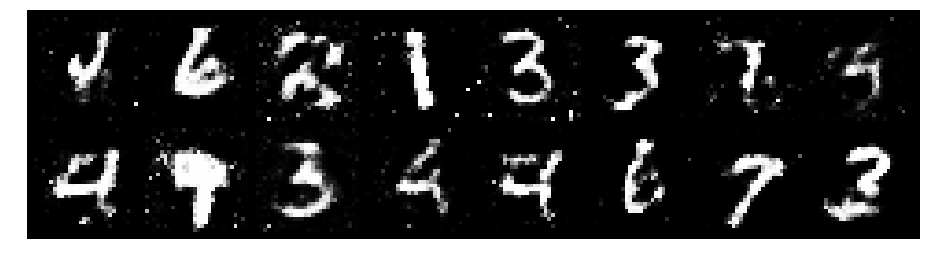

Epoch: [60/200], Batch Num: [400/600]
Discriminator Loss: 1.1451, Generator Loss: 1.2165
D(x): 0.6023, D(G(z)): 0.3681


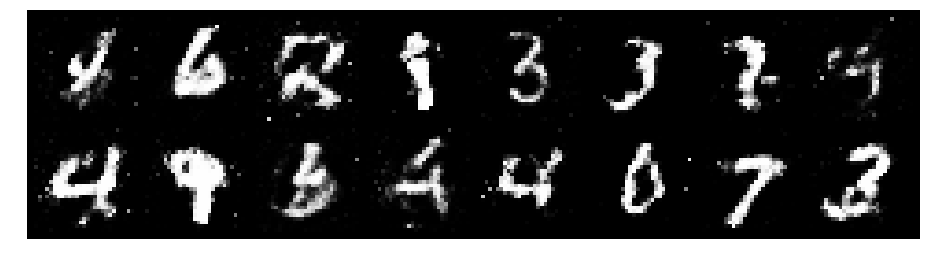

Epoch: [60/200], Batch Num: [500/600]
Discriminator Loss: 1.1163, Generator Loss: 1.0202
D(x): 0.5833, D(G(z)): 0.3842


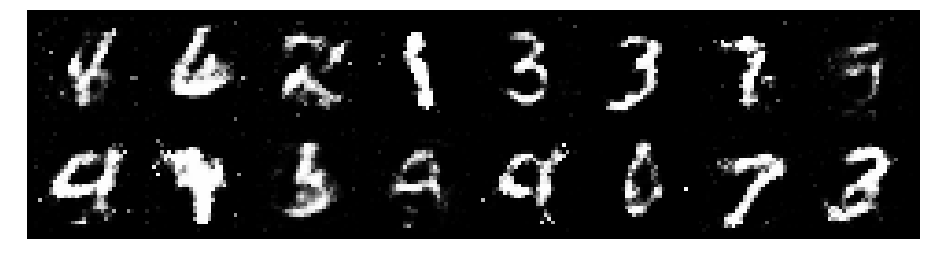

Epoch: [61/200], Batch Num: [0/600]
Discriminator Loss: 1.2019, Generator Loss: 0.9510
D(x): 0.5517, D(G(z)): 0.4153


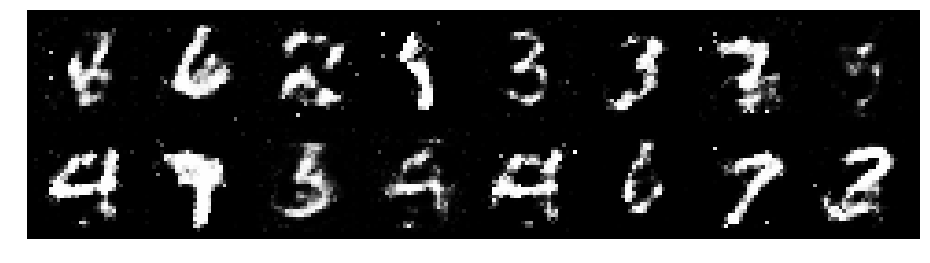

Epoch: [61/200], Batch Num: [100/600]
Discriminator Loss: 1.2252, Generator Loss: 0.9061
D(x): 0.5612, D(G(z)): 0.4346


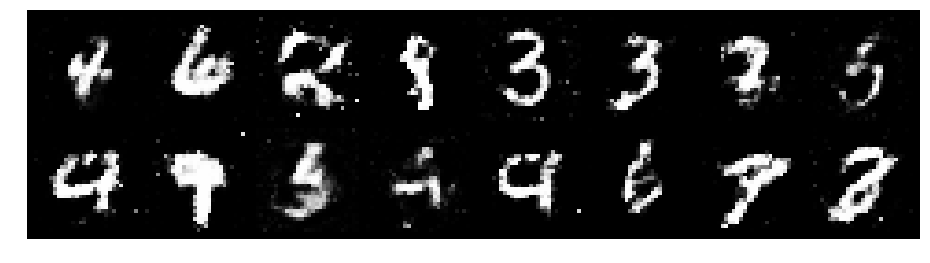

Epoch: [61/200], Batch Num: [200/600]
Discriminator Loss: 1.2973, Generator Loss: 0.8820
D(x): 0.5566, D(G(z)): 0.4692


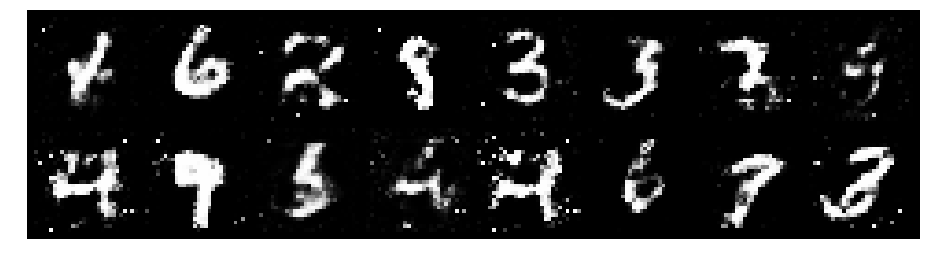

Epoch: [61/200], Batch Num: [300/600]
Discriminator Loss: 1.3888, Generator Loss: 1.0545
D(x): 0.5076, D(G(z)): 0.4032


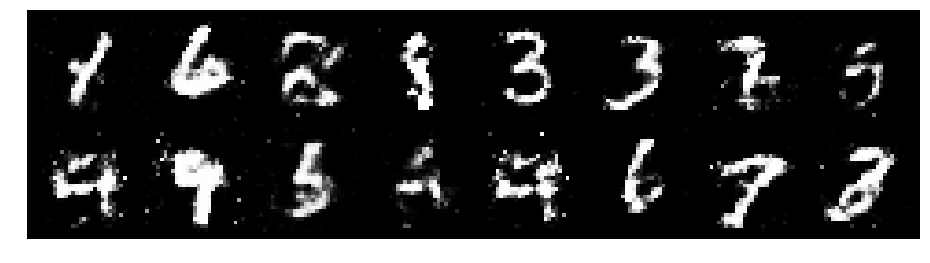

Epoch: [61/200], Batch Num: [400/600]
Discriminator Loss: 1.1971, Generator Loss: 1.1194
D(x): 0.6041, D(G(z)): 0.4151


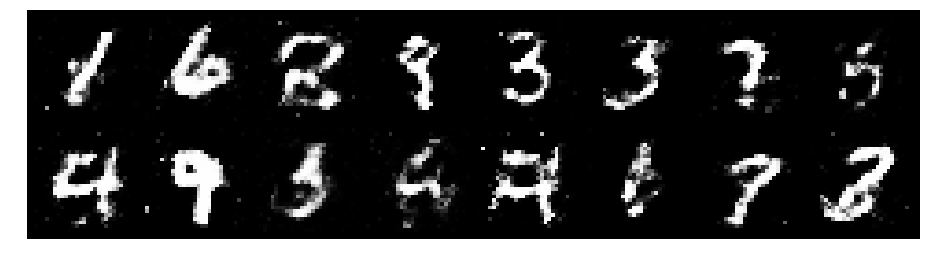

Epoch: [61/200], Batch Num: [500/600]
Discriminator Loss: 1.2530, Generator Loss: 0.9824
D(x): 0.5815, D(G(z)): 0.4288


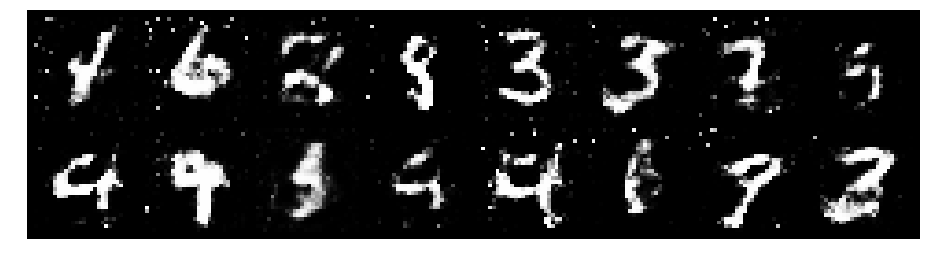

Epoch: [62/200], Batch Num: [0/600]
Discriminator Loss: 1.3064, Generator Loss: 0.9501
D(x): 0.5369, D(G(z)): 0.4358


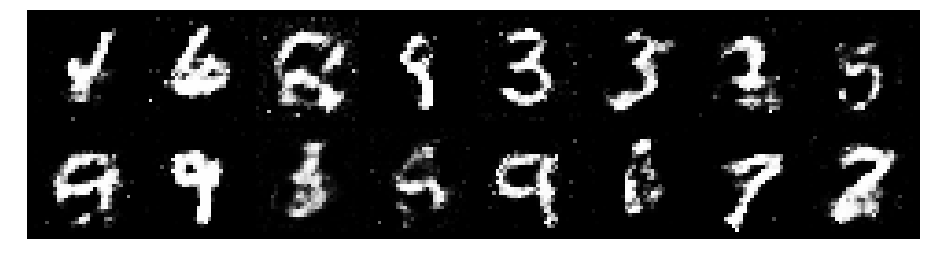

Epoch: [62/200], Batch Num: [100/600]
Discriminator Loss: 1.1923, Generator Loss: 1.0692
D(x): 0.6071, D(G(z)): 0.4252


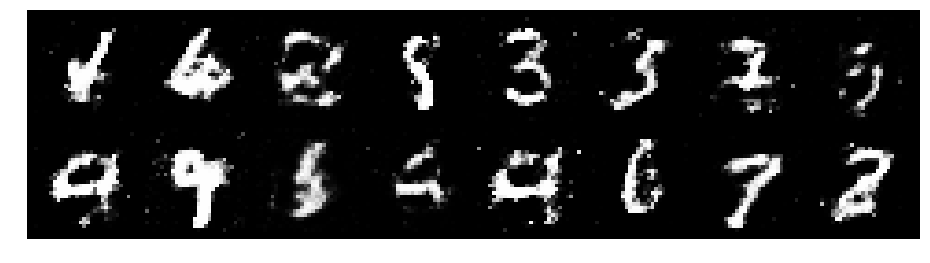

Epoch: [62/200], Batch Num: [200/600]
Discriminator Loss: 1.1854, Generator Loss: 1.0207
D(x): 0.5987, D(G(z)): 0.4323


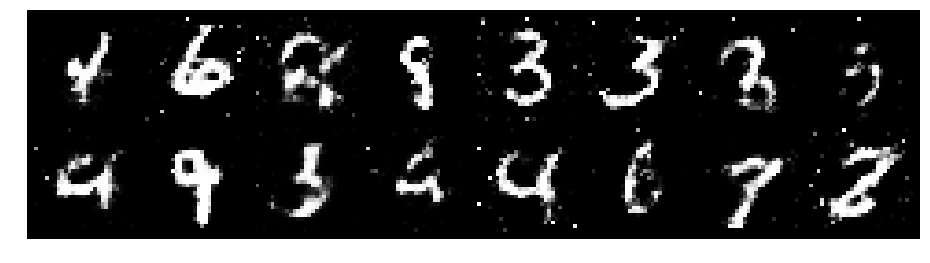

Epoch: [62/200], Batch Num: [300/600]
Discriminator Loss: 1.3175, Generator Loss: 0.8342
D(x): 0.5437, D(G(z)): 0.4625


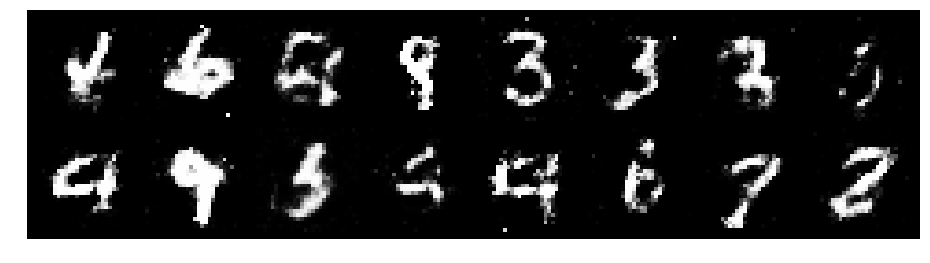

Epoch: [62/200], Batch Num: [400/600]
Discriminator Loss: 1.2701, Generator Loss: 0.9041
D(x): 0.5670, D(G(z)): 0.4546


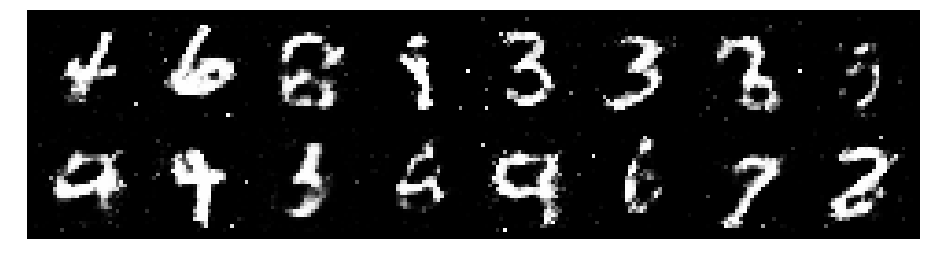

Epoch: [62/200], Batch Num: [500/600]
Discriminator Loss: 1.3827, Generator Loss: 0.9521
D(x): 0.5788, D(G(z)): 0.4846


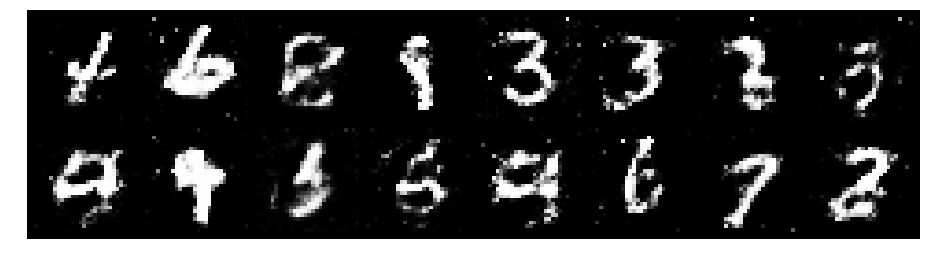

Epoch: [63/200], Batch Num: [0/600]
Discriminator Loss: 1.2275, Generator Loss: 0.9154
D(x): 0.5548, D(G(z)): 0.4182


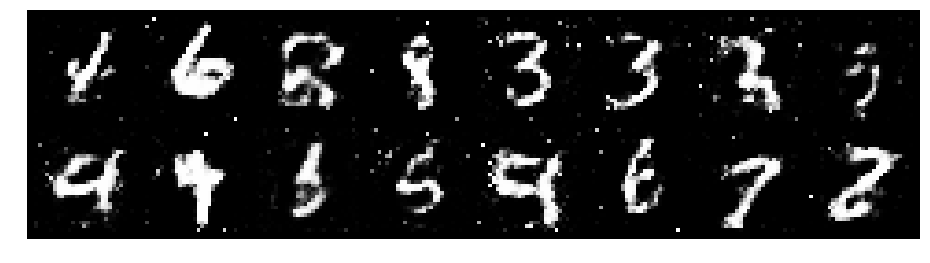

Epoch: [63/200], Batch Num: [100/600]
Discriminator Loss: 1.4141, Generator Loss: 1.0971
D(x): 0.5313, D(G(z)): 0.4463


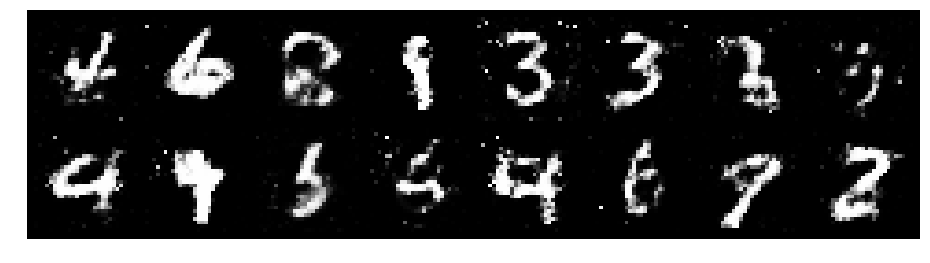

Epoch: [63/200], Batch Num: [200/600]
Discriminator Loss: 1.0920, Generator Loss: 1.2903
D(x): 0.6859, D(G(z)): 0.4247


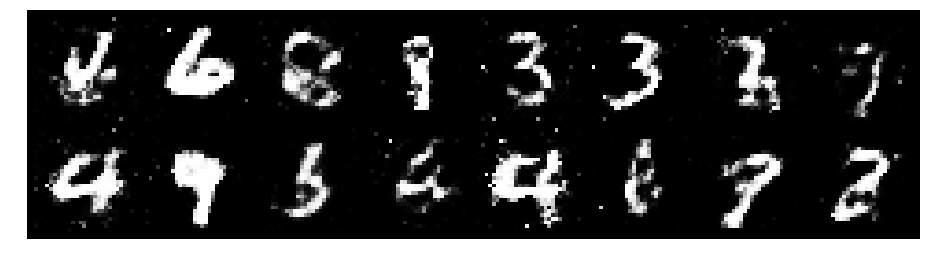

Epoch: [63/200], Batch Num: [300/600]
Discriminator Loss: 1.2704, Generator Loss: 1.1345
D(x): 0.5976, D(G(z)): 0.4569


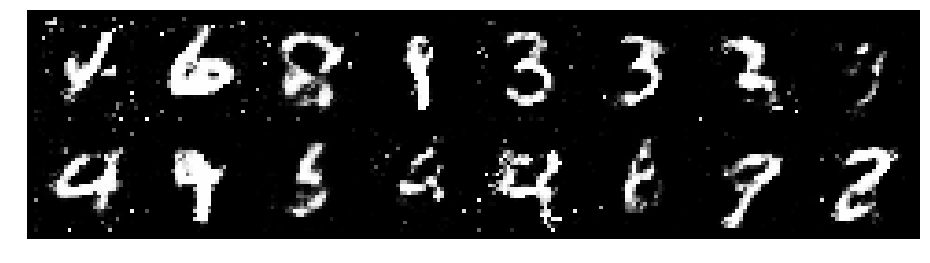

Epoch: [63/200], Batch Num: [400/600]
Discriminator Loss: 1.1113, Generator Loss: 1.2321
D(x): 0.5846, D(G(z)): 0.3125


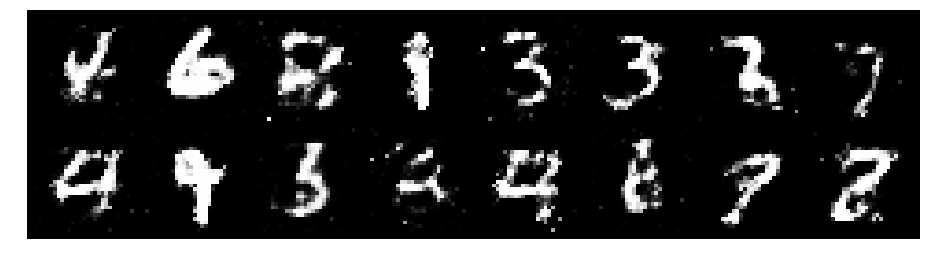

Epoch: [63/200], Batch Num: [500/600]
Discriminator Loss: 1.0225, Generator Loss: 1.2397
D(x): 0.6504, D(G(z)): 0.3601


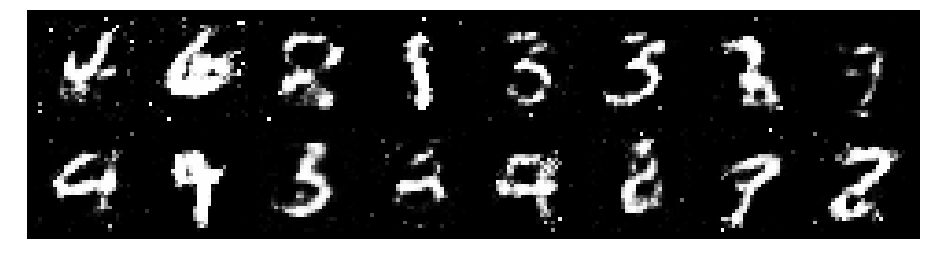

Epoch: [64/200], Batch Num: [0/600]
Discriminator Loss: 1.1270, Generator Loss: 0.9582
D(x): 0.6276, D(G(z)): 0.4281


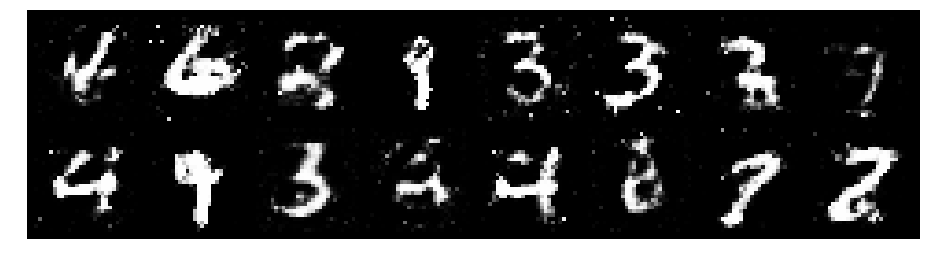

Epoch: [64/200], Batch Num: [100/600]
Discriminator Loss: 1.0794, Generator Loss: 1.1406
D(x): 0.6215, D(G(z)): 0.3819


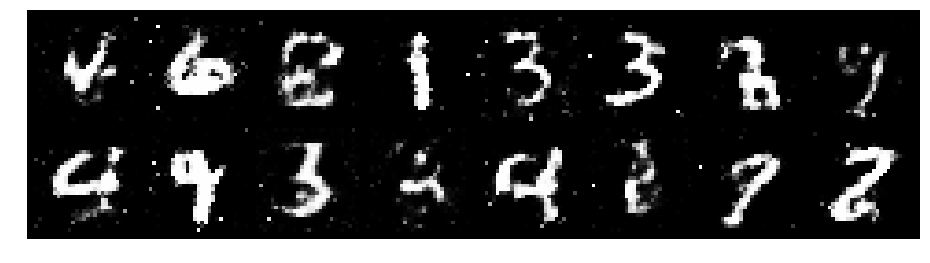

Epoch: [64/200], Batch Num: [200/600]
Discriminator Loss: 1.2273, Generator Loss: 1.0918
D(x): 0.5889, D(G(z)): 0.4269


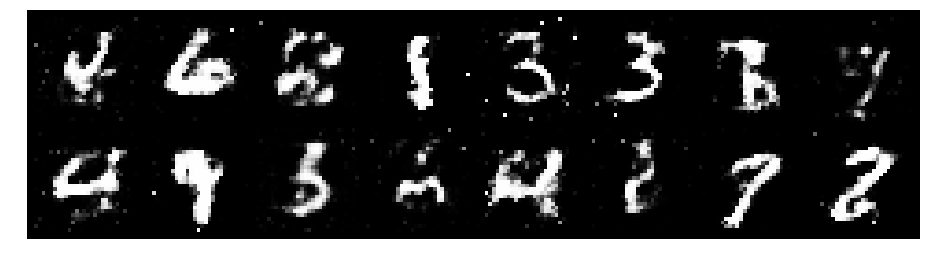

Epoch: [64/200], Batch Num: [300/600]
Discriminator Loss: 1.2130, Generator Loss: 0.9954
D(x): 0.6053, D(G(z)): 0.4279


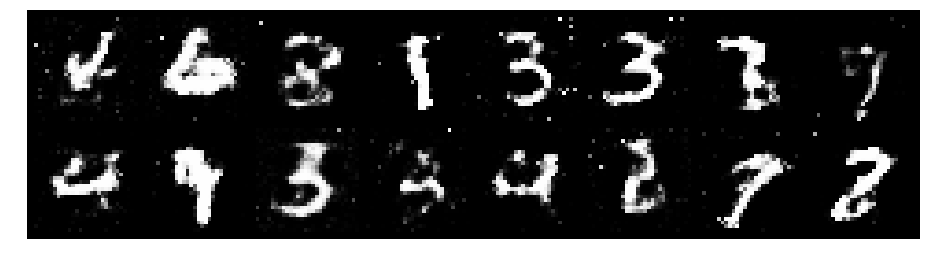

Epoch: [64/200], Batch Num: [400/600]
Discriminator Loss: 1.0871, Generator Loss: 1.0768
D(x): 0.6317, D(G(z)): 0.4049


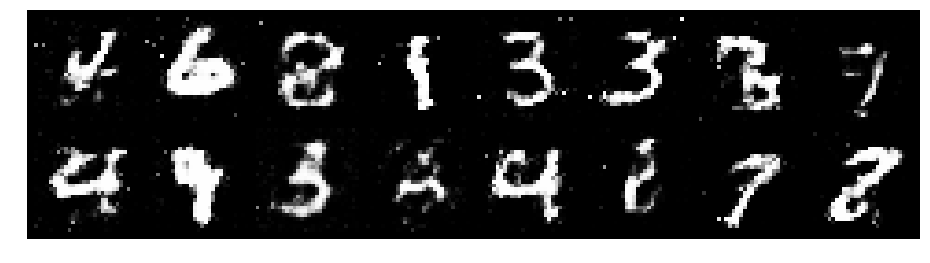

Epoch: [64/200], Batch Num: [500/600]
Discriminator Loss: 1.1224, Generator Loss: 0.9569
D(x): 0.6086, D(G(z)): 0.4158


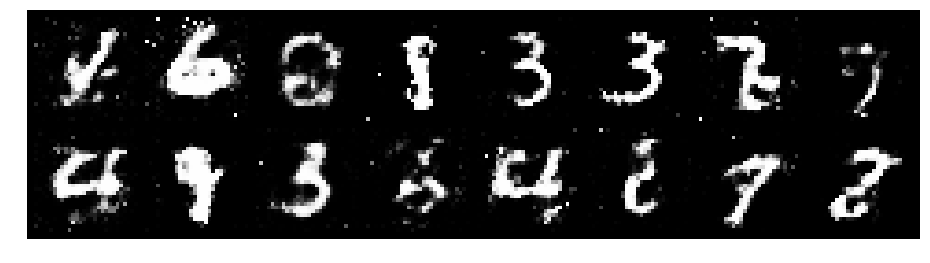

Epoch: [65/200], Batch Num: [0/600]
Discriminator Loss: 1.2717, Generator Loss: 1.0854
D(x): 0.5860, D(G(z)): 0.4475


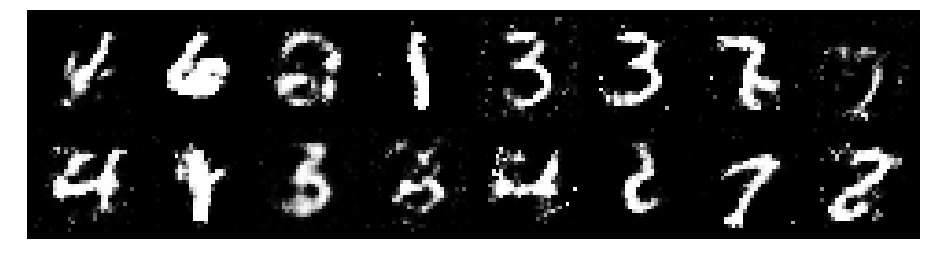

Epoch: [65/200], Batch Num: [100/600]
Discriminator Loss: 1.1446, Generator Loss: 1.2130
D(x): 0.6154, D(G(z)): 0.4026


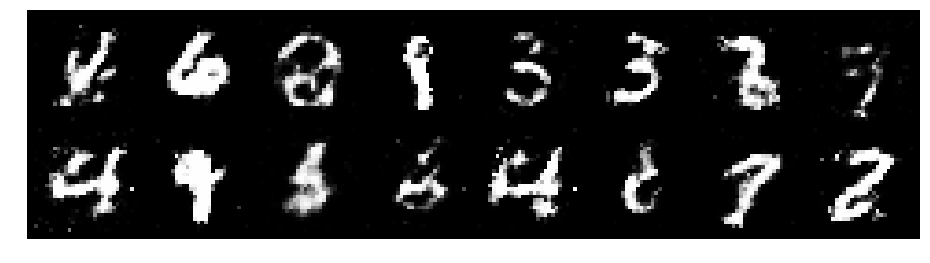

Epoch: [65/200], Batch Num: [200/600]
Discriminator Loss: 1.2445, Generator Loss: 0.9151
D(x): 0.5647, D(G(z)): 0.4045


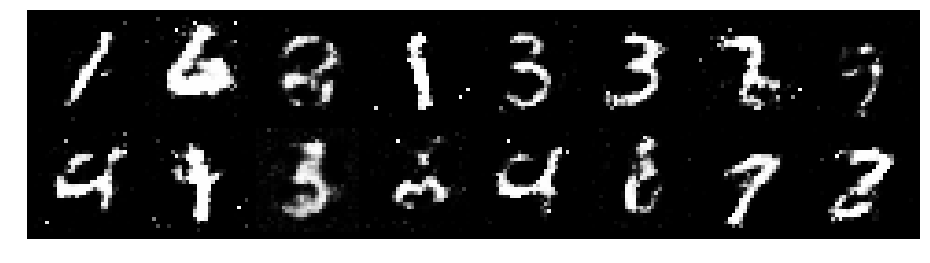

Epoch: [65/200], Batch Num: [300/600]
Discriminator Loss: 1.2772, Generator Loss: 0.9821
D(x): 0.6031, D(G(z)): 0.4435


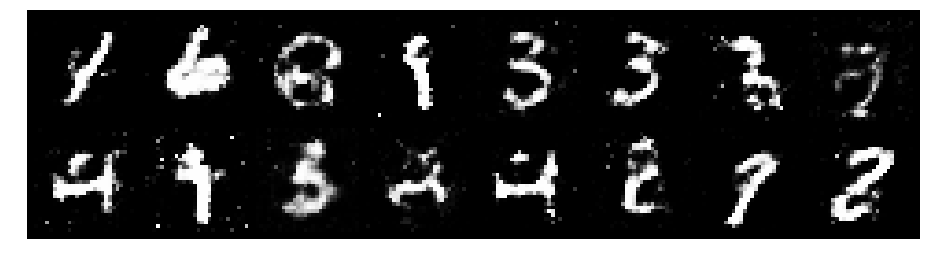

Epoch: [65/200], Batch Num: [400/600]
Discriminator Loss: 1.2606, Generator Loss: 0.9087
D(x): 0.6009, D(G(z)): 0.4844


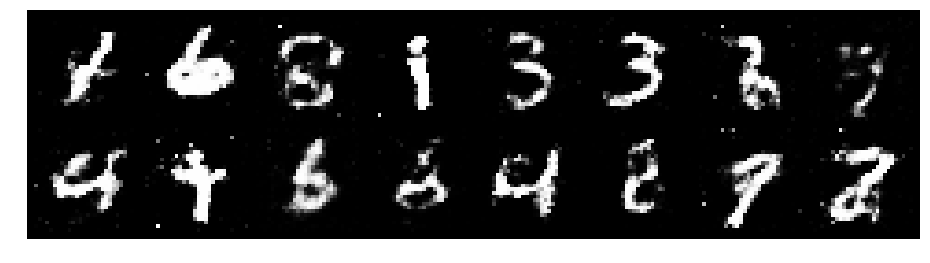

Epoch: [65/200], Batch Num: [500/600]
Discriminator Loss: 1.2138, Generator Loss: 0.9473
D(x): 0.5347, D(G(z)): 0.3667


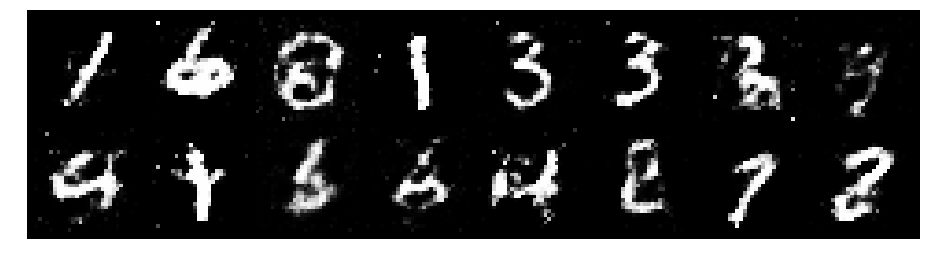

Epoch: [66/200], Batch Num: [0/600]
Discriminator Loss: 1.3725, Generator Loss: 0.9168
D(x): 0.5701, D(G(z)): 0.4911


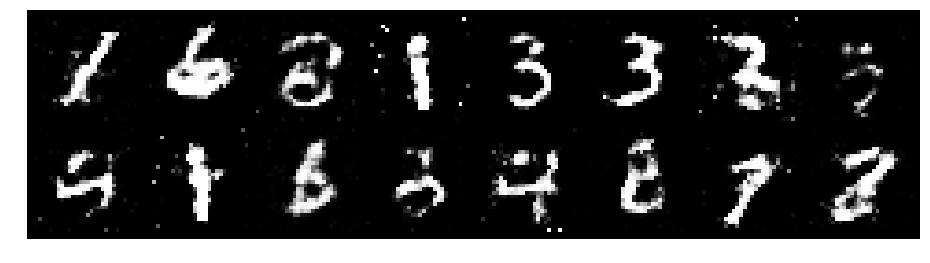

Epoch: [66/200], Batch Num: [100/600]
Discriminator Loss: 1.1595, Generator Loss: 1.1220
D(x): 0.5687, D(G(z)): 0.3940


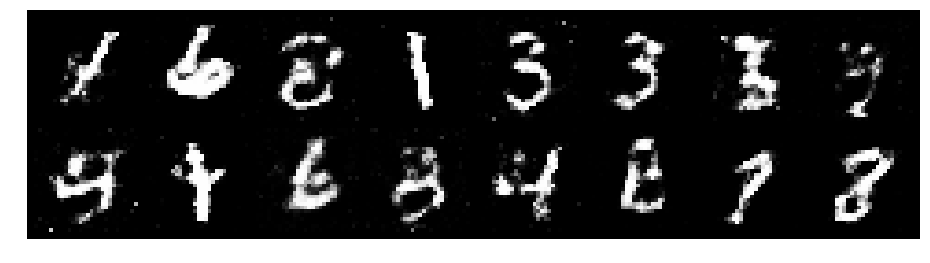

Epoch: [66/200], Batch Num: [200/600]
Discriminator Loss: 1.1029, Generator Loss: 0.9920
D(x): 0.6129, D(G(z)): 0.3999


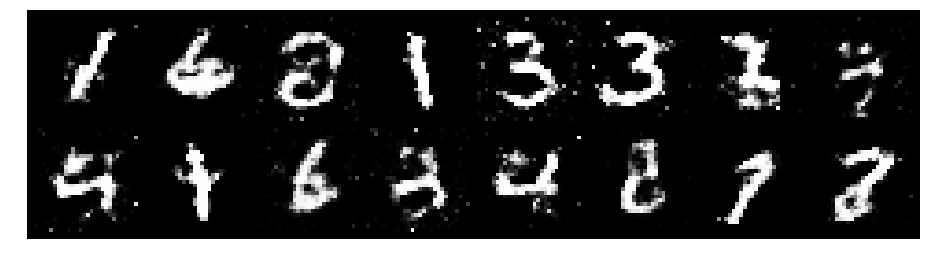

Epoch: [66/200], Batch Num: [300/600]
Discriminator Loss: 1.2196, Generator Loss: 1.0936
D(x): 0.5784, D(G(z)): 0.4062


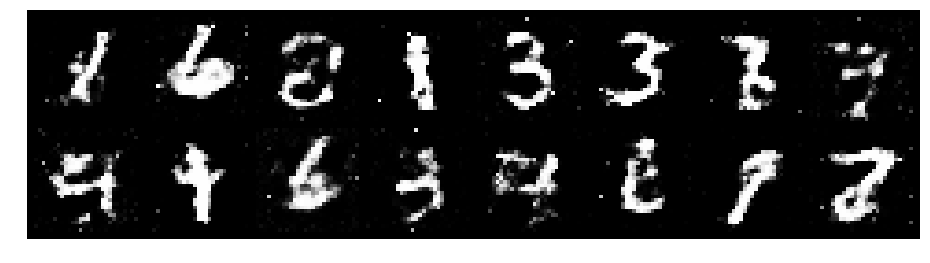

Epoch: [66/200], Batch Num: [400/600]
Discriminator Loss: 1.2381, Generator Loss: 1.0107
D(x): 0.5367, D(G(z)): 0.3779


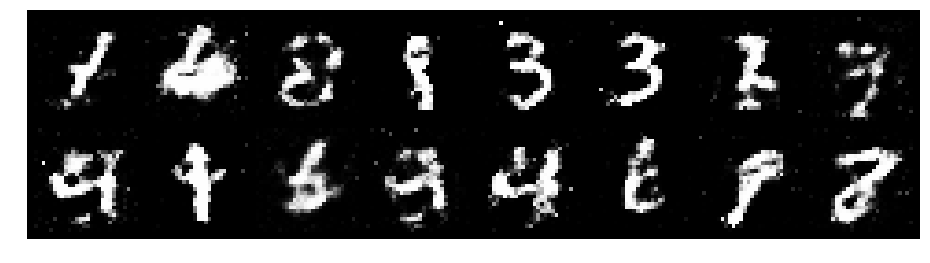

Epoch: [66/200], Batch Num: [500/600]
Discriminator Loss: 1.0859, Generator Loss: 0.9811
D(x): 0.6105, D(G(z)): 0.3771


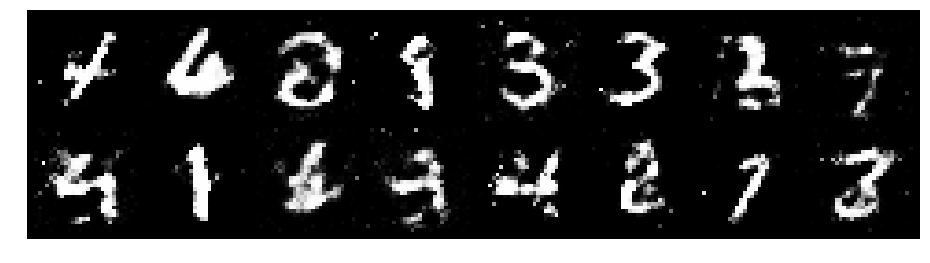

Epoch: [67/200], Batch Num: [0/600]
Discriminator Loss: 1.2192, Generator Loss: 1.0573
D(x): 0.5725, D(G(z)): 0.4172


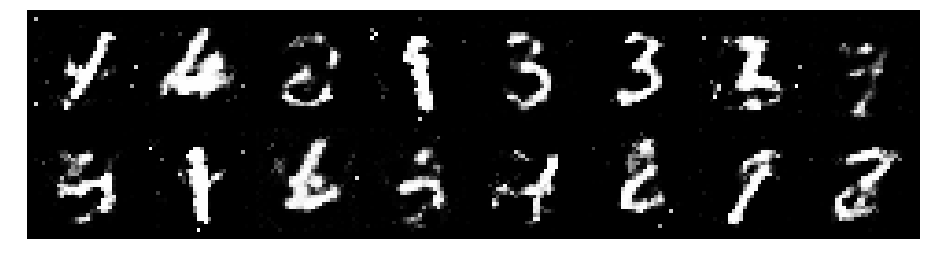

Epoch: [67/200], Batch Num: [100/600]
Discriminator Loss: 1.2677, Generator Loss: 0.9434
D(x): 0.5793, D(G(z)): 0.4486


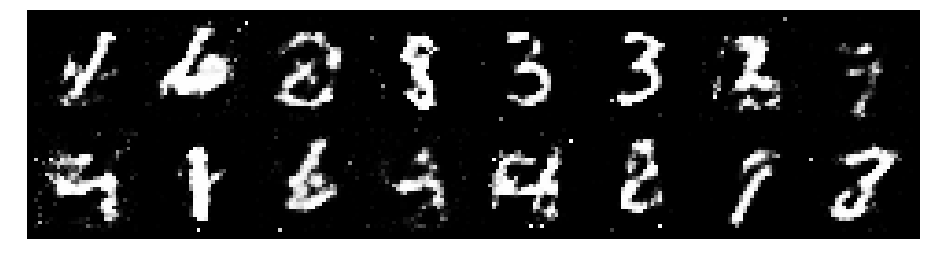

Epoch: [67/200], Batch Num: [200/600]
Discriminator Loss: 1.1074, Generator Loss: 1.0693
D(x): 0.6148, D(G(z)): 0.3903


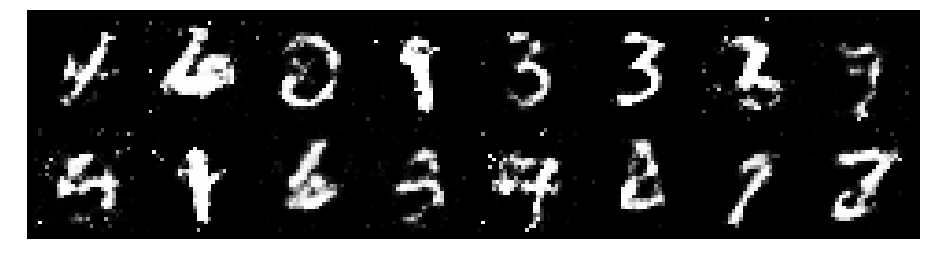

Epoch: [67/200], Batch Num: [300/600]
Discriminator Loss: 1.1097, Generator Loss: 0.9654
D(x): 0.6103, D(G(z)): 0.3688


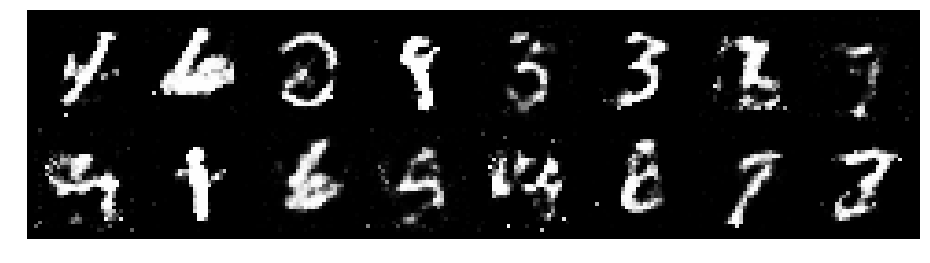

Epoch: [67/200], Batch Num: [400/600]
Discriminator Loss: 1.1763, Generator Loss: 1.3008
D(x): 0.5761, D(G(z)): 0.3669


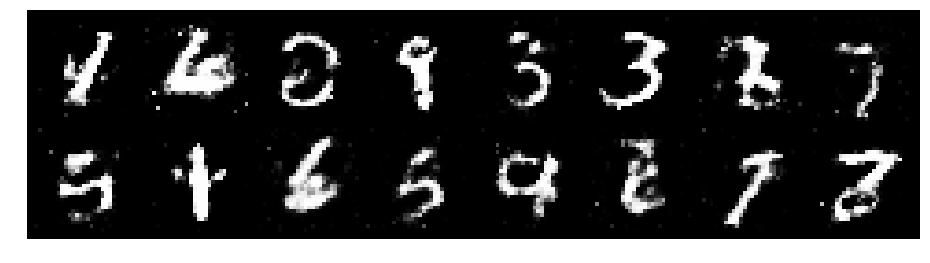

Epoch: [67/200], Batch Num: [500/600]
Discriminator Loss: 1.2482, Generator Loss: 1.0318
D(x): 0.5371, D(G(z)): 0.3993


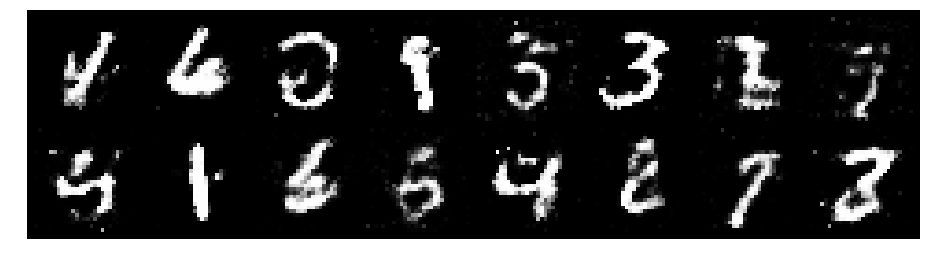

Epoch: [68/200], Batch Num: [0/600]
Discriminator Loss: 1.1833, Generator Loss: 0.9374
D(x): 0.5776, D(G(z)): 0.4239


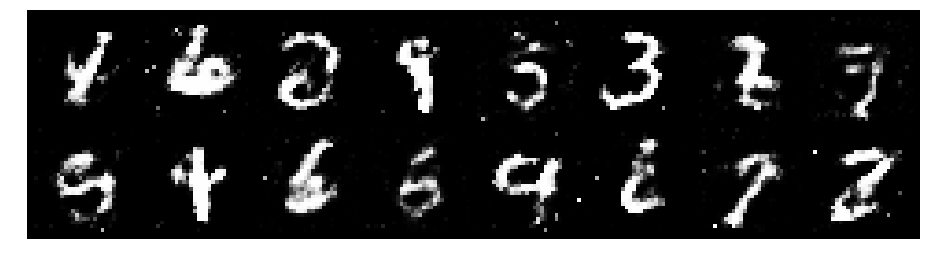

Epoch: [68/200], Batch Num: [100/600]
Discriminator Loss: 1.2317, Generator Loss: 0.9265
D(x): 0.5943, D(G(z)): 0.4428


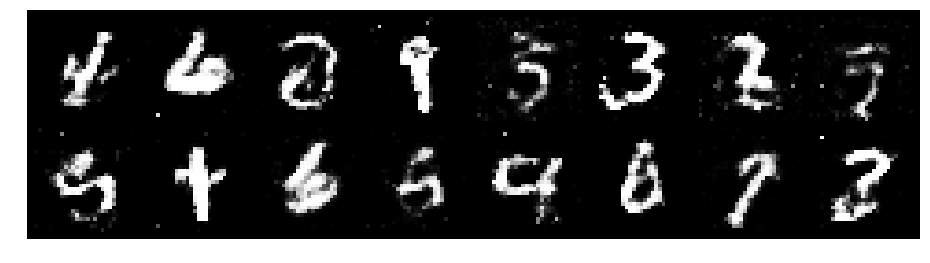

Epoch: [68/200], Batch Num: [200/600]
Discriminator Loss: 1.3320, Generator Loss: 0.8678
D(x): 0.5831, D(G(z)): 0.4694


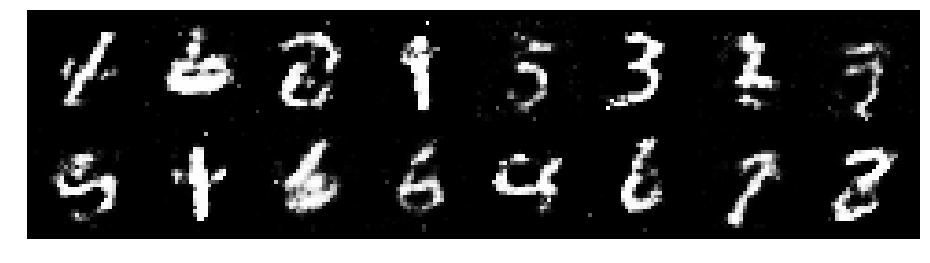

Epoch: [68/200], Batch Num: [300/600]
Discriminator Loss: 1.0887, Generator Loss: 0.9929
D(x): 0.6583, D(G(z)): 0.4051


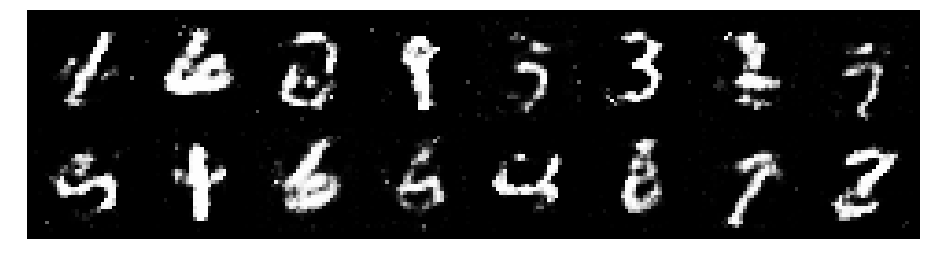

Epoch: [68/200], Batch Num: [400/600]
Discriminator Loss: 1.0970, Generator Loss: 1.0990
D(x): 0.6206, D(G(z)): 0.3742


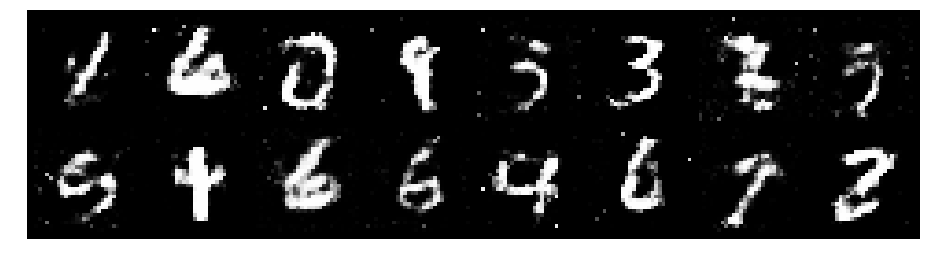

Epoch: [68/200], Batch Num: [500/600]
Discriminator Loss: 1.2870, Generator Loss: 1.1575
D(x): 0.5150, D(G(z)): 0.3763


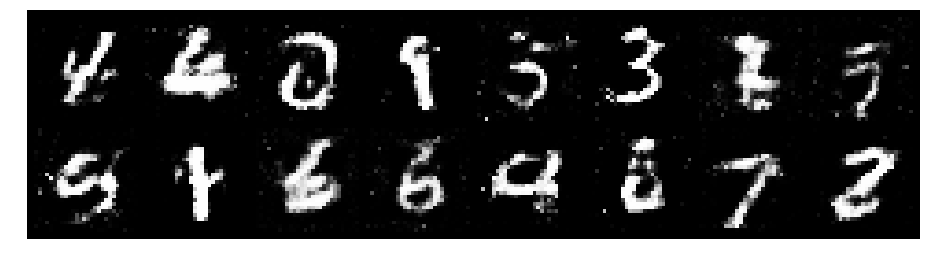

Epoch: [69/200], Batch Num: [0/600]
Discriminator Loss: 1.1214, Generator Loss: 1.1799
D(x): 0.6115, D(G(z)): 0.3995


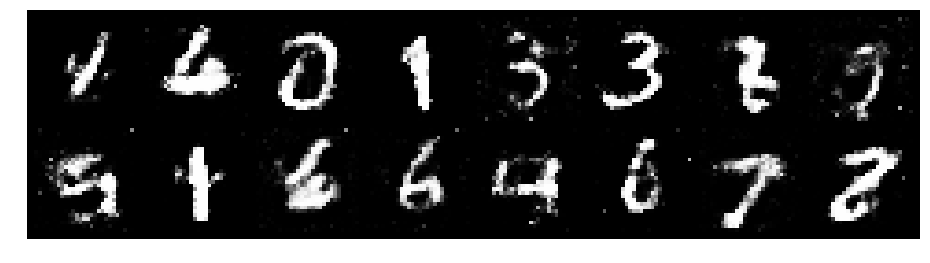

Epoch: [69/200], Batch Num: [100/600]
Discriminator Loss: 1.1072, Generator Loss: 1.0644
D(x): 0.5965, D(G(z)): 0.3686


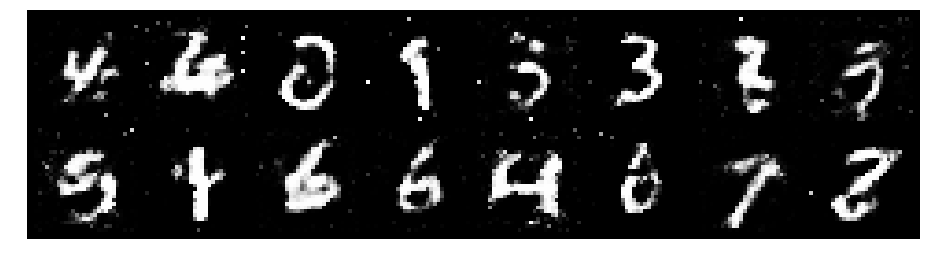

Epoch: [69/200], Batch Num: [200/600]
Discriminator Loss: 1.2134, Generator Loss: 1.0018
D(x): 0.6018, D(G(z)): 0.4403


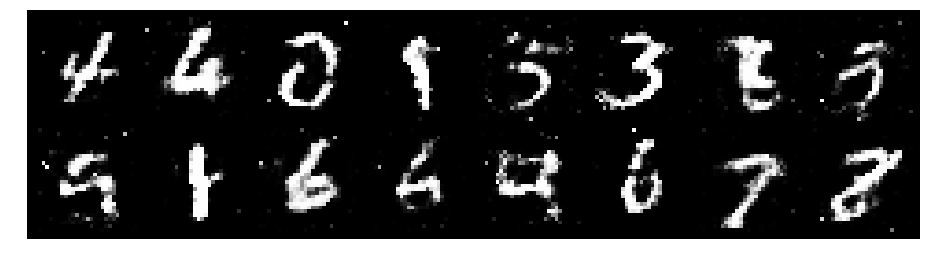

Epoch: [69/200], Batch Num: [300/600]
Discriminator Loss: 1.2504, Generator Loss: 0.8749
D(x): 0.5651, D(G(z)): 0.4462


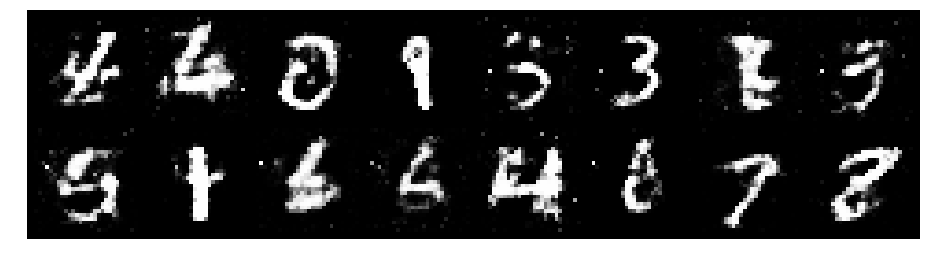

Epoch: [69/200], Batch Num: [400/600]
Discriminator Loss: 1.3364, Generator Loss: 0.8647
D(x): 0.5319, D(G(z)): 0.4489


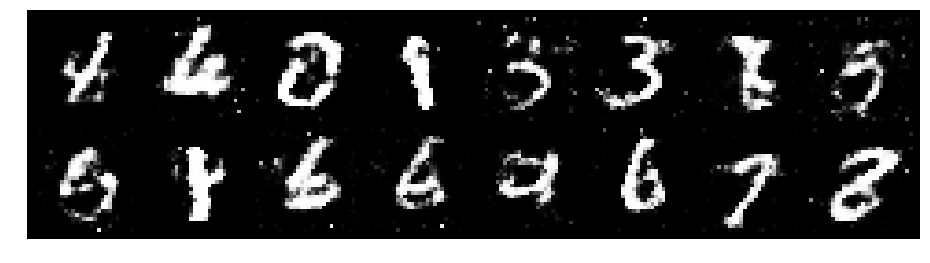

Epoch: [69/200], Batch Num: [500/600]
Discriminator Loss: 1.1488, Generator Loss: 1.0954
D(x): 0.5991, D(G(z)): 0.3964


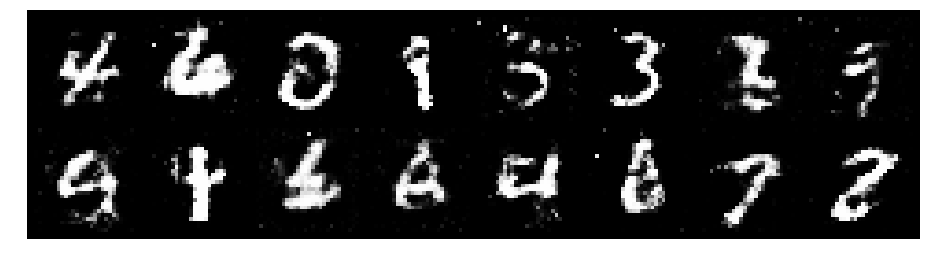

Epoch: [70/200], Batch Num: [0/600]
Discriminator Loss: 1.2205, Generator Loss: 1.1158
D(x): 0.5548, D(G(z)): 0.4042


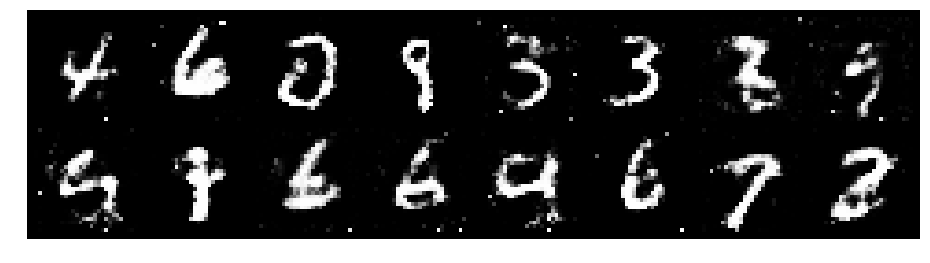

Epoch: [70/200], Batch Num: [100/600]
Discriminator Loss: 1.1945, Generator Loss: 0.8784
D(x): 0.6097, D(G(z)): 0.4519


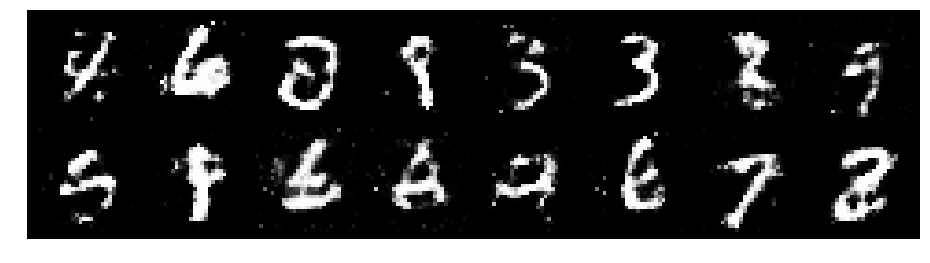

Epoch: [70/200], Batch Num: [200/600]
Discriminator Loss: 1.1275, Generator Loss: 0.9767
D(x): 0.6118, D(G(z)): 0.4183


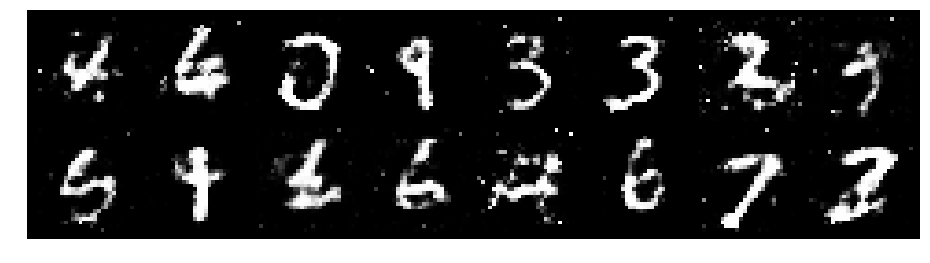

Epoch: [70/200], Batch Num: [300/600]
Discriminator Loss: 1.2609, Generator Loss: 0.9423
D(x): 0.5740, D(G(z)): 0.4354


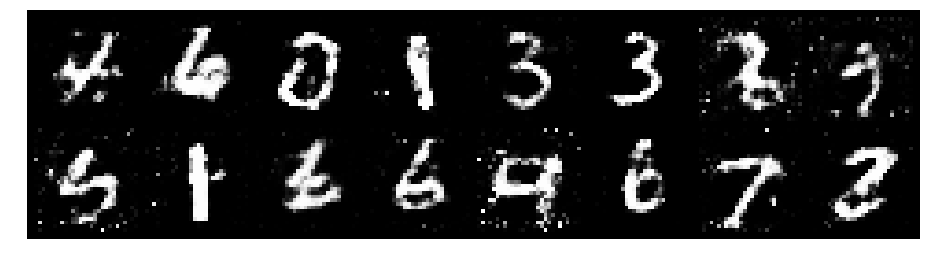

Epoch: [70/200], Batch Num: [400/600]
Discriminator Loss: 1.3651, Generator Loss: 1.0101
D(x): 0.5254, D(G(z)): 0.4157


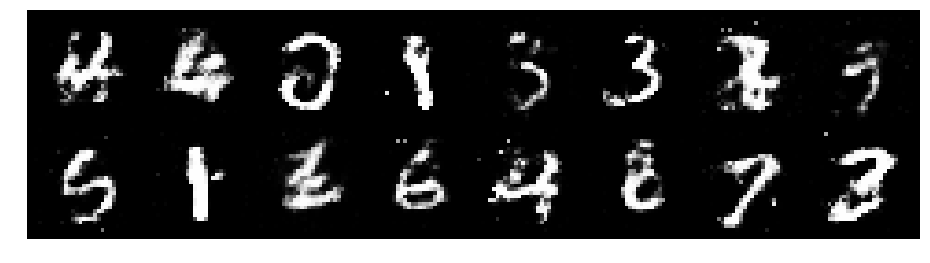

Epoch: [70/200], Batch Num: [500/600]
Discriminator Loss: 1.3532, Generator Loss: 0.8583
D(x): 0.5036, D(G(z)): 0.4290


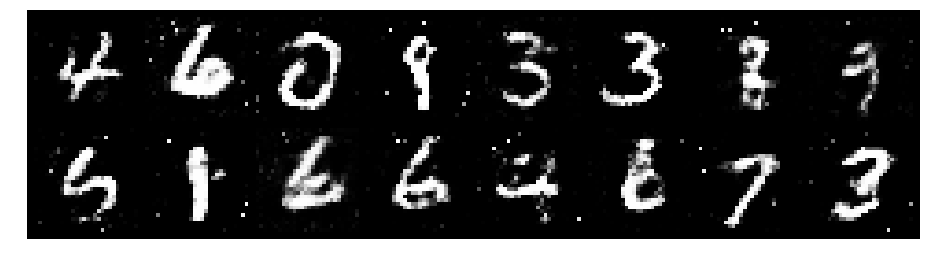

Epoch: [71/200], Batch Num: [0/600]
Discriminator Loss: 1.1614, Generator Loss: 1.1780
D(x): 0.6083, D(G(z)): 0.3963


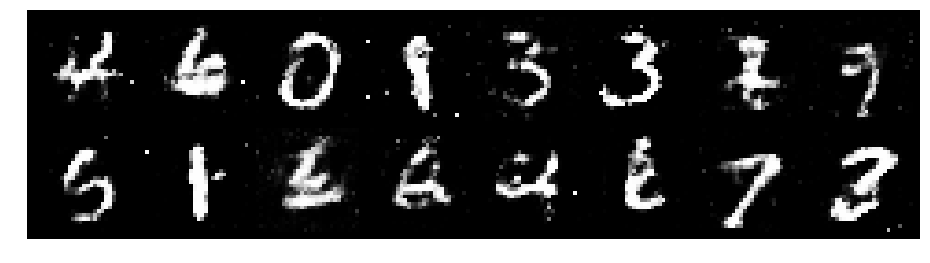

Epoch: [71/200], Batch Num: [100/600]
Discriminator Loss: 1.2218, Generator Loss: 1.1134
D(x): 0.5700, D(G(z)): 0.3794


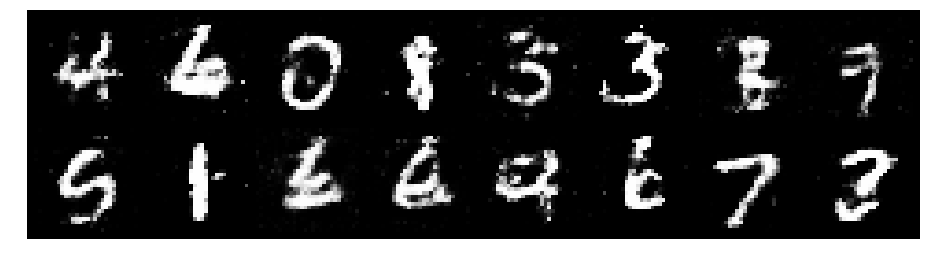

Epoch: [71/200], Batch Num: [200/600]
Discriminator Loss: 1.1721, Generator Loss: 1.1207
D(x): 0.5689, D(G(z)): 0.3714


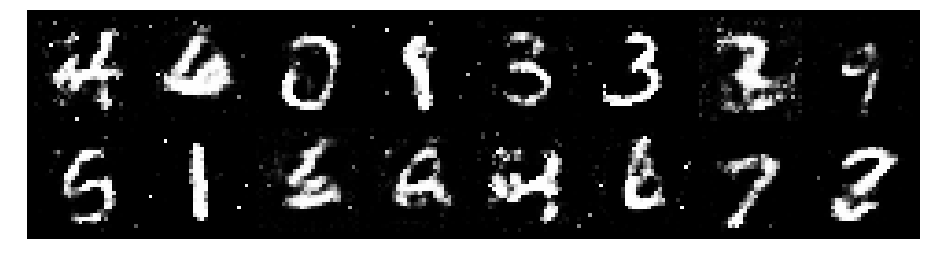

Epoch: [71/200], Batch Num: [300/600]
Discriminator Loss: 1.2104, Generator Loss: 0.9257
D(x): 0.5901, D(G(z)): 0.4465


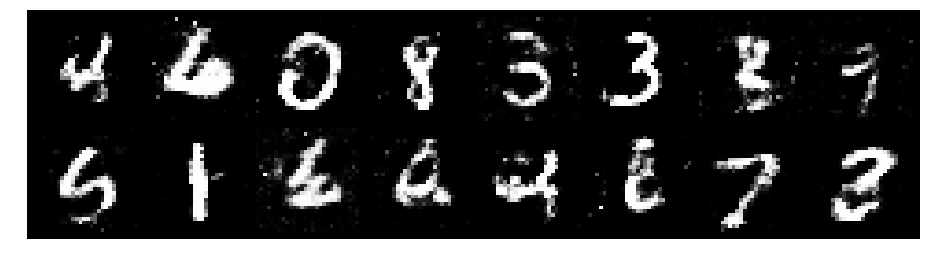

Epoch: [71/200], Batch Num: [400/600]
Discriminator Loss: 1.1074, Generator Loss: 0.8616
D(x): 0.6078, D(G(z)): 0.4197


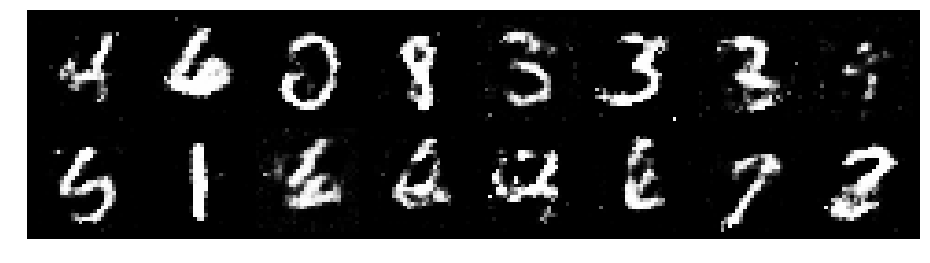

Epoch: [71/200], Batch Num: [500/600]
Discriminator Loss: 1.2229, Generator Loss: 1.0729
D(x): 0.6131, D(G(z)): 0.4464


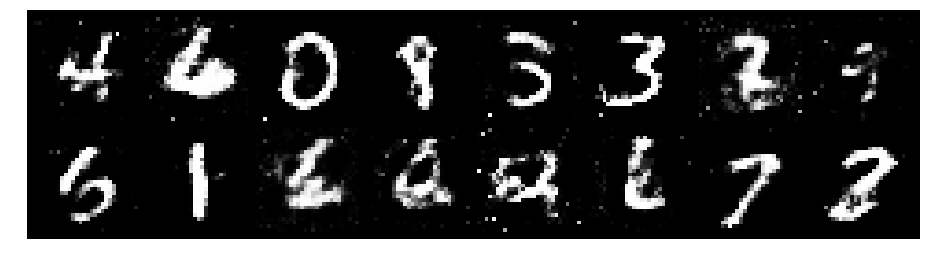

Epoch: [72/200], Batch Num: [0/600]
Discriminator Loss: 1.3666, Generator Loss: 0.8251
D(x): 0.5391, D(G(z)): 0.4584


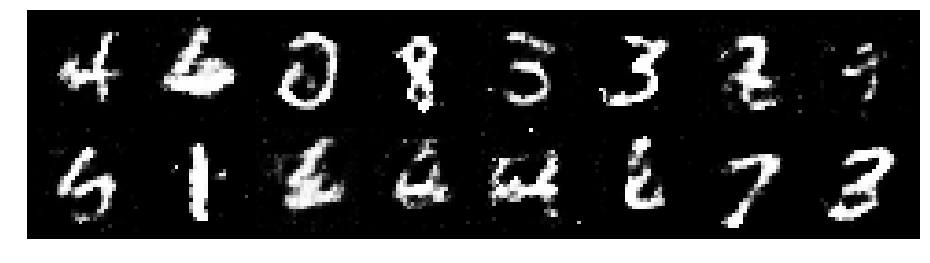

Epoch: [72/200], Batch Num: [100/600]
Discriminator Loss: 1.3163, Generator Loss: 0.9898
D(x): 0.5576, D(G(z)): 0.4182


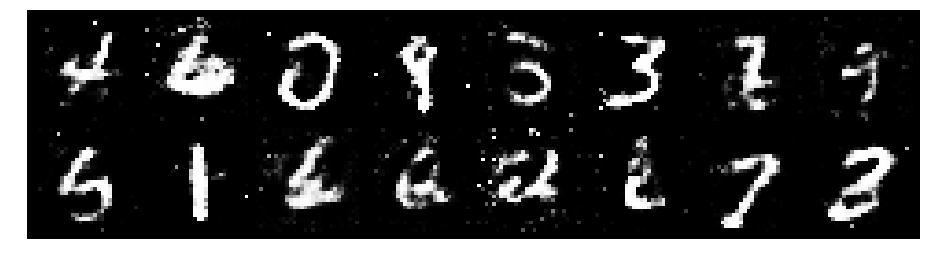

Epoch: [72/200], Batch Num: [200/600]
Discriminator Loss: 1.1832, Generator Loss: 1.0291
D(x): 0.5758, D(G(z)): 0.4121


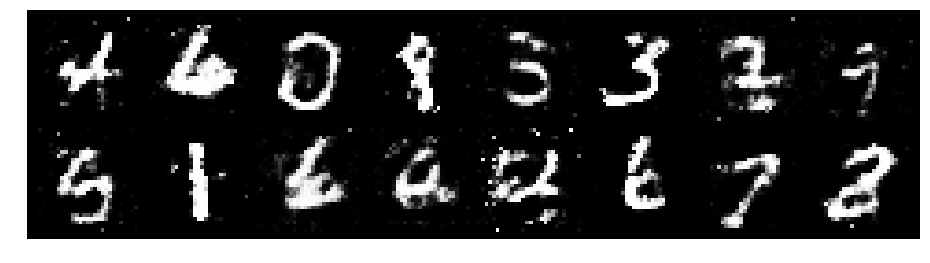

Epoch: [72/200], Batch Num: [300/600]
Discriminator Loss: 1.2240, Generator Loss: 0.9286
D(x): 0.6388, D(G(z)): 0.4494


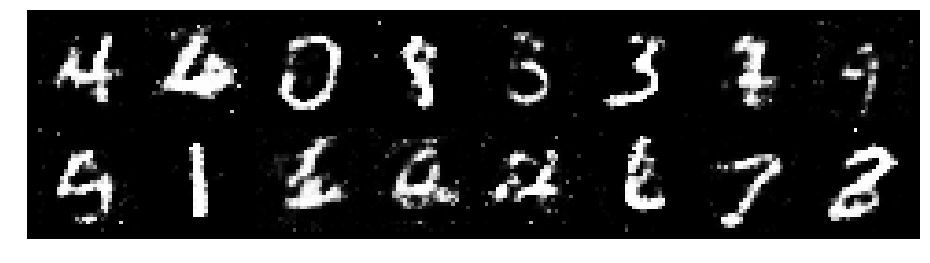

Epoch: [72/200], Batch Num: [400/600]
Discriminator Loss: 1.3253, Generator Loss: 0.8743
D(x): 0.5654, D(G(z)): 0.4527


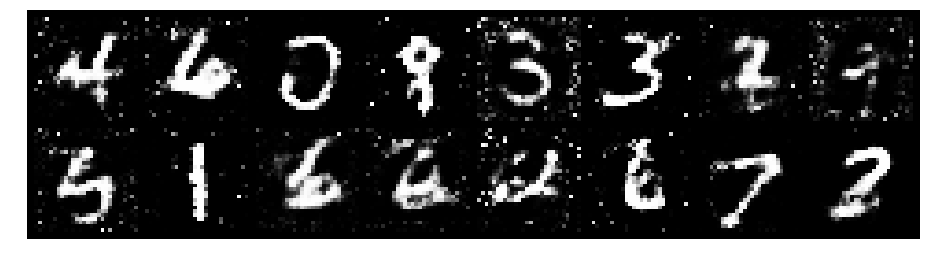

Epoch: [72/200], Batch Num: [500/600]
Discriminator Loss: 1.1415, Generator Loss: 1.0618
D(x): 0.5495, D(G(z)): 0.3673


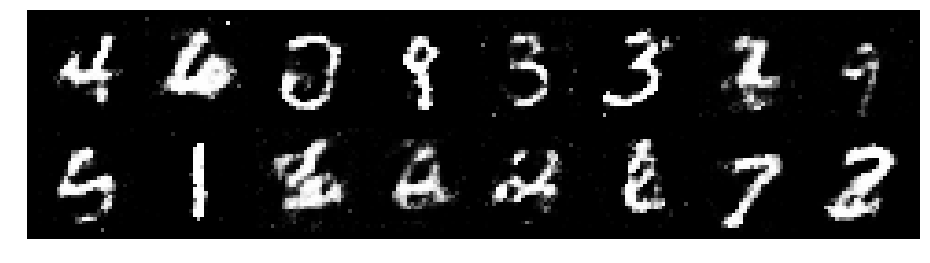

Epoch: [73/200], Batch Num: [0/600]
Discriminator Loss: 1.1513, Generator Loss: 1.0743
D(x): 0.5511, D(G(z)): 0.3541


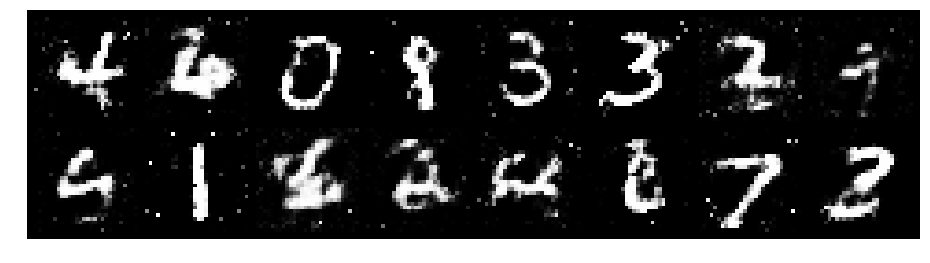

Epoch: [73/200], Batch Num: [100/600]
Discriminator Loss: 1.3347, Generator Loss: 1.0336
D(x): 0.5024, D(G(z)): 0.3931


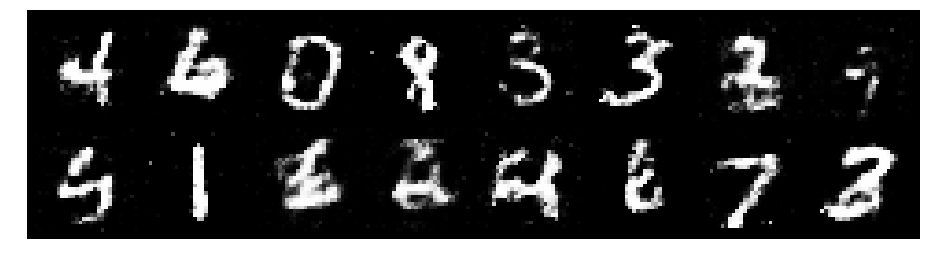

Epoch: [73/200], Batch Num: [200/600]
Discriminator Loss: 1.2807, Generator Loss: 0.9486
D(x): 0.5425, D(G(z)): 0.4053


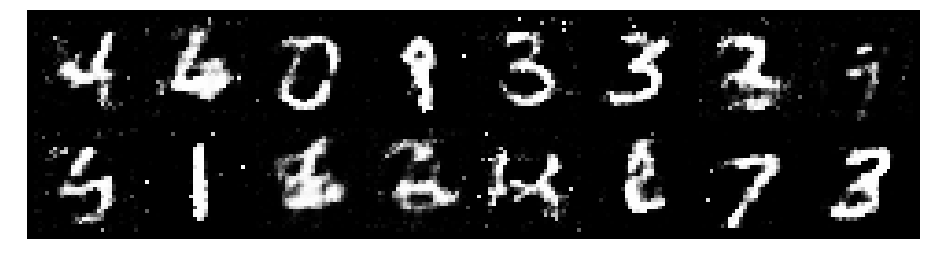

Epoch: [73/200], Batch Num: [300/600]
Discriminator Loss: 1.2889, Generator Loss: 0.9441
D(x): 0.5264, D(G(z)): 0.4076


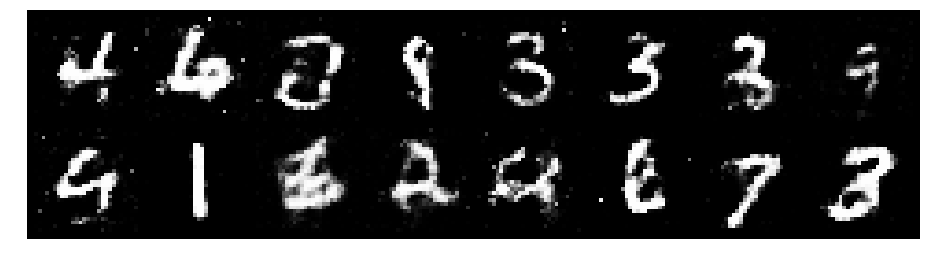

Epoch: [73/200], Batch Num: [400/600]
Discriminator Loss: 1.2094, Generator Loss: 0.9153
D(x): 0.5864, D(G(z)): 0.4316


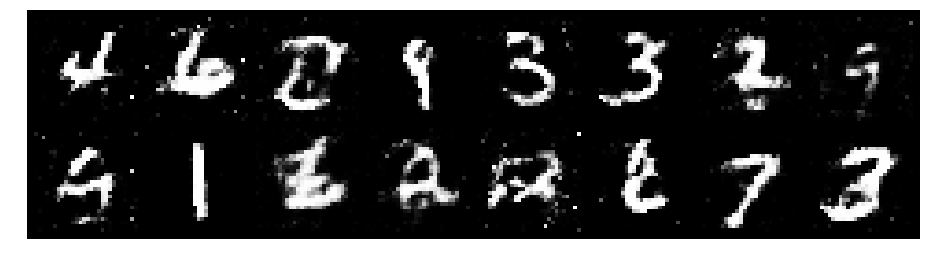

Epoch: [73/200], Batch Num: [500/600]
Discriminator Loss: 1.1952, Generator Loss: 0.9317
D(x): 0.6184, D(G(z)): 0.4434


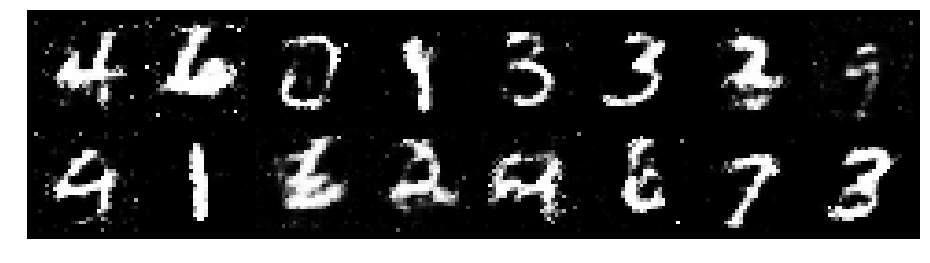

Epoch: [74/200], Batch Num: [0/600]
Discriminator Loss: 1.2186, Generator Loss: 0.9741
D(x): 0.5776, D(G(z)): 0.4191


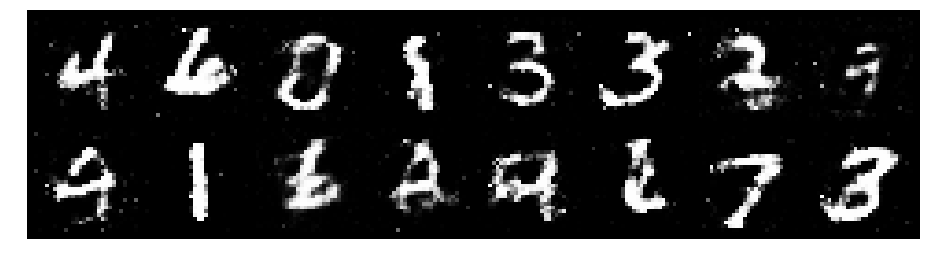

Epoch: [74/200], Batch Num: [100/600]
Discriminator Loss: 1.3745, Generator Loss: 1.0021
D(x): 0.5370, D(G(z)): 0.4679


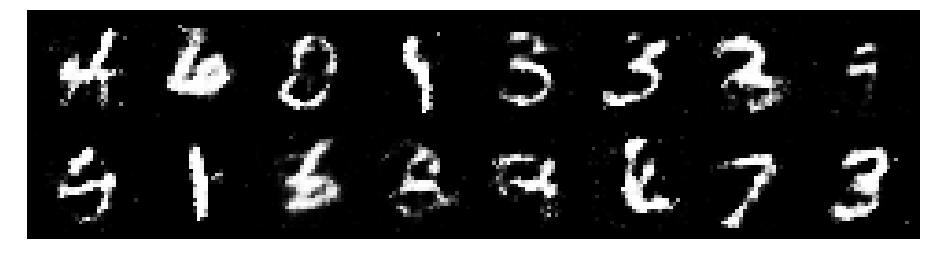

Epoch: [74/200], Batch Num: [200/600]
Discriminator Loss: 1.2282, Generator Loss: 0.9860
D(x): 0.5491, D(G(z)): 0.4185


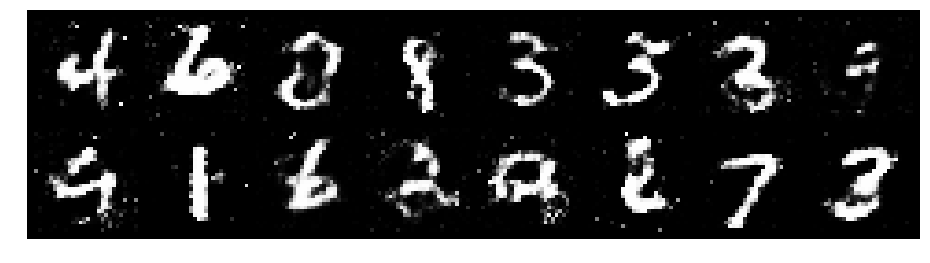

Epoch: [74/200], Batch Num: [300/600]
Discriminator Loss: 1.1530, Generator Loss: 1.2345
D(x): 0.5862, D(G(z)): 0.3763


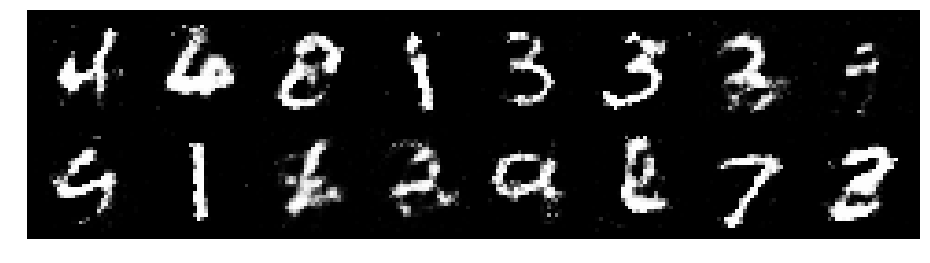

Epoch: [74/200], Batch Num: [400/600]
Discriminator Loss: 1.1792, Generator Loss: 0.9901
D(x): 0.5834, D(G(z)): 0.4216


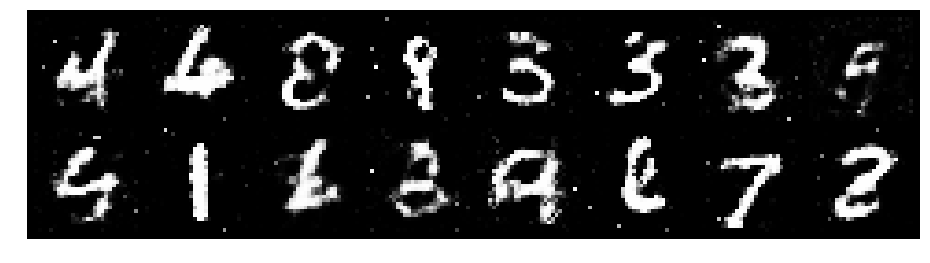

Epoch: [74/200], Batch Num: [500/600]
Discriminator Loss: 1.1850, Generator Loss: 0.9451
D(x): 0.5916, D(G(z)): 0.4362


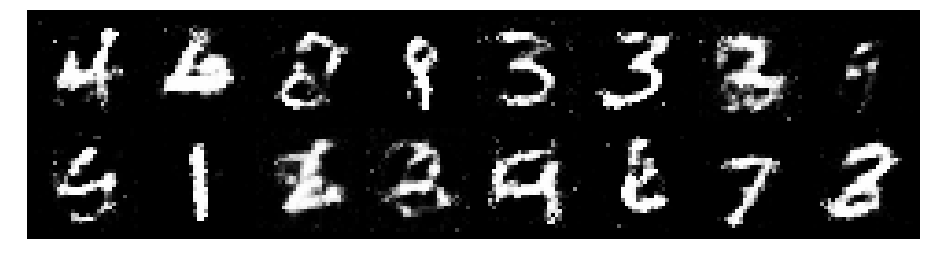

Epoch: [75/200], Batch Num: [0/600]
Discriminator Loss: 1.2028, Generator Loss: 0.8927
D(x): 0.5737, D(G(z)): 0.4398


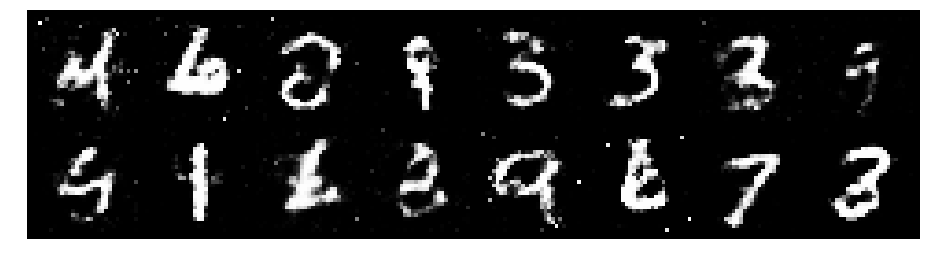

Epoch: [75/200], Batch Num: [100/600]
Discriminator Loss: 1.2654, Generator Loss: 0.8953
D(x): 0.6244, D(G(z)): 0.4870


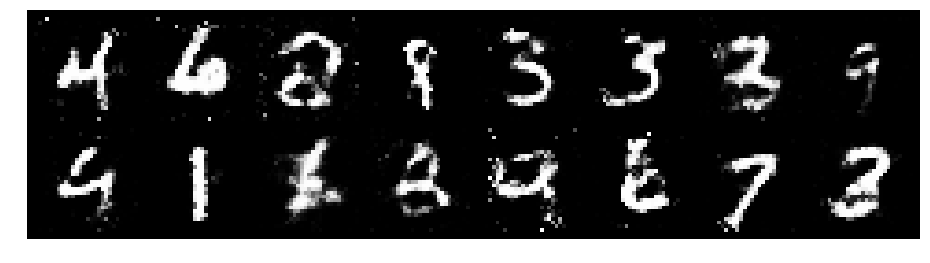

Epoch: [75/200], Batch Num: [200/600]
Discriminator Loss: 1.2111, Generator Loss: 0.9330
D(x): 0.5377, D(G(z)): 0.3875


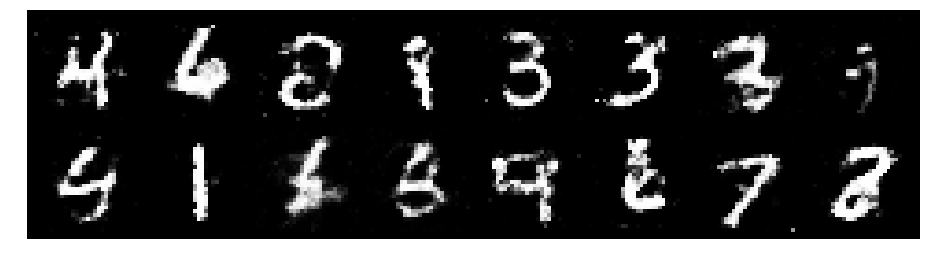

Epoch: [75/200], Batch Num: [300/600]
Discriminator Loss: 1.0439, Generator Loss: 0.9865
D(x): 0.6638, D(G(z)): 0.4171


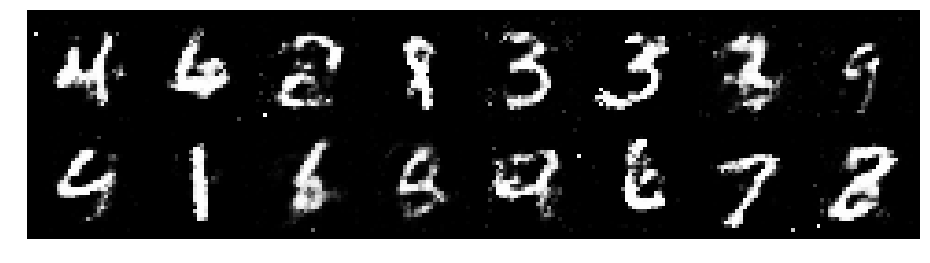

Epoch: [75/200], Batch Num: [400/600]
Discriminator Loss: 1.0106, Generator Loss: 1.1529
D(x): 0.6212, D(G(z)): 0.3652


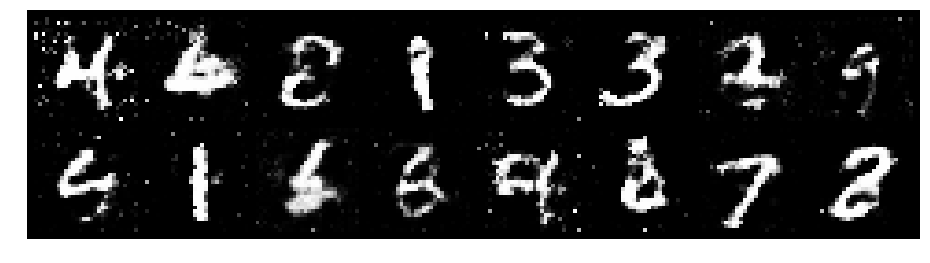

Epoch: [75/200], Batch Num: [500/600]
Discriminator Loss: 1.2151, Generator Loss: 1.0408
D(x): 0.5463, D(G(z)): 0.3914


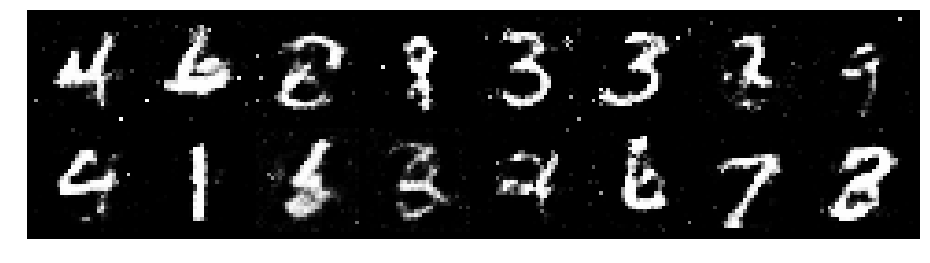

Epoch: [76/200], Batch Num: [0/600]
Discriminator Loss: 1.0750, Generator Loss: 0.9305
D(x): 0.6223, D(G(z)): 0.4096


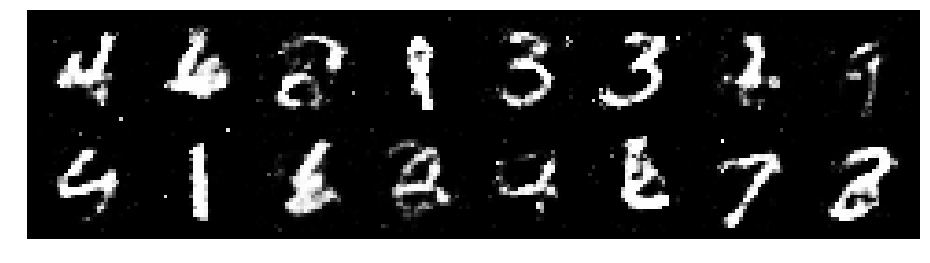

Epoch: [76/200], Batch Num: [100/600]
Discriminator Loss: 1.1867, Generator Loss: 0.8736
D(x): 0.6093, D(G(z)): 0.4389


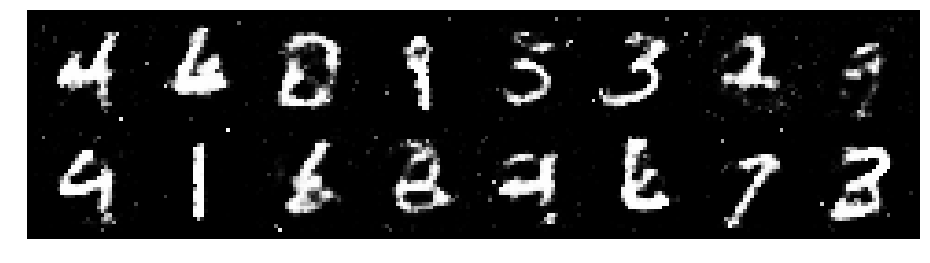

Epoch: [76/200], Batch Num: [200/600]
Discriminator Loss: 1.1996, Generator Loss: 1.1584
D(x): 0.5698, D(G(z)): 0.3984


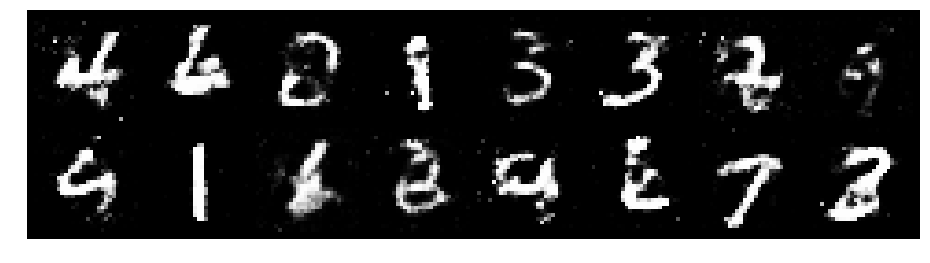

Epoch: [76/200], Batch Num: [300/600]
Discriminator Loss: 1.2974, Generator Loss: 0.9587
D(x): 0.5468, D(G(z)): 0.4131


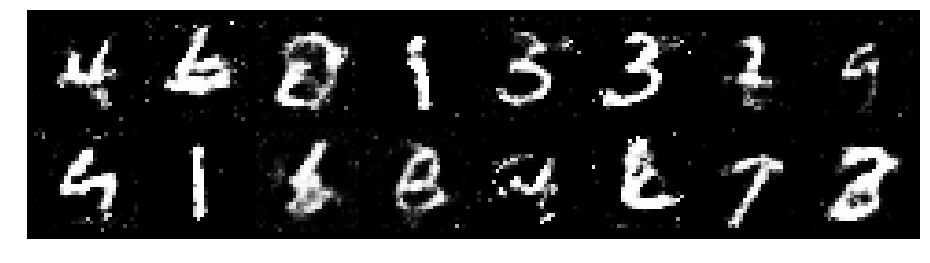

Epoch: [76/200], Batch Num: [400/600]
Discriminator Loss: 1.3633, Generator Loss: 0.9080
D(x): 0.5726, D(G(z)): 0.4870


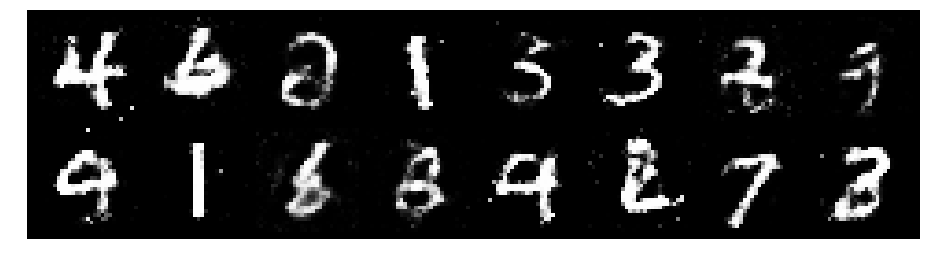

Epoch: [76/200], Batch Num: [500/600]
Discriminator Loss: 1.2464, Generator Loss: 0.9718
D(x): 0.5432, D(G(z)): 0.4137


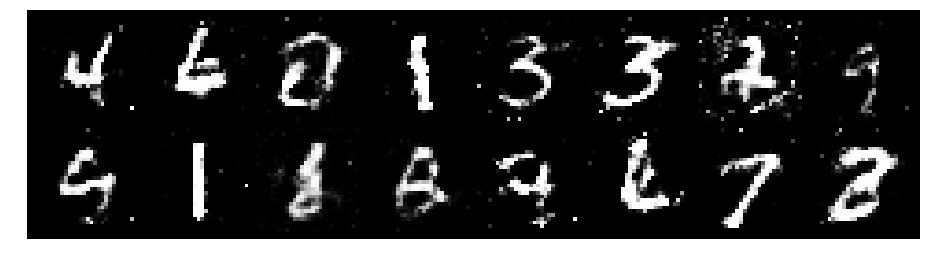

Epoch: [77/200], Batch Num: [0/600]
Discriminator Loss: 1.2387, Generator Loss: 0.9561
D(x): 0.5528, D(G(z)): 0.4175


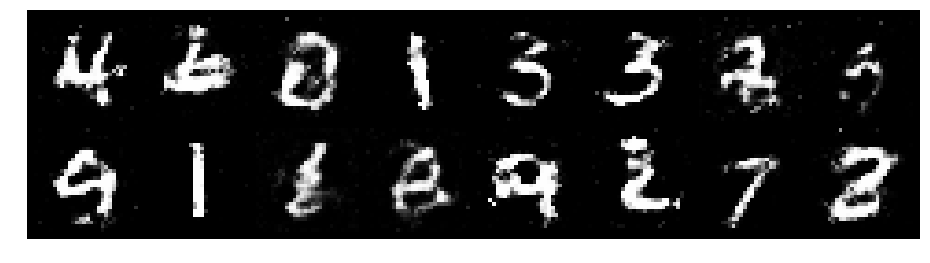

Epoch: [77/200], Batch Num: [100/600]
Discriminator Loss: 1.1745, Generator Loss: 0.7213
D(x): 0.6402, D(G(z)): 0.4728


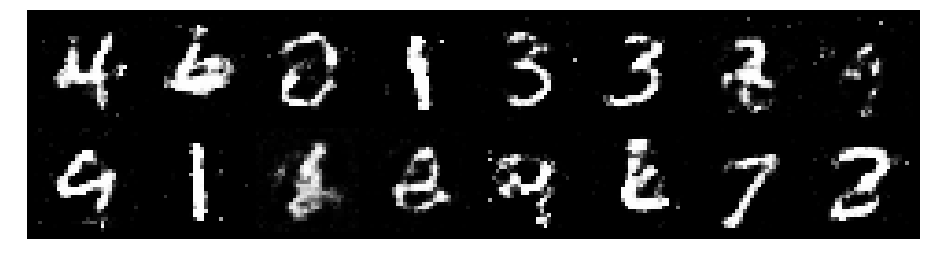

Epoch: [77/200], Batch Num: [200/600]
Discriminator Loss: 1.1796, Generator Loss: 1.0390
D(x): 0.6415, D(G(z)): 0.4457


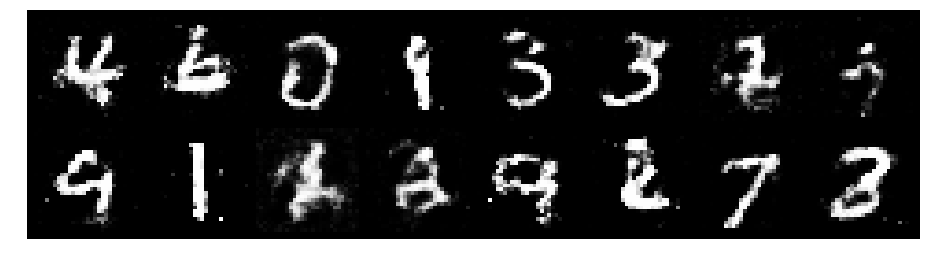

Epoch: [77/200], Batch Num: [300/600]
Discriminator Loss: 1.1321, Generator Loss: 1.1844
D(x): 0.5757, D(G(z)): 0.3869


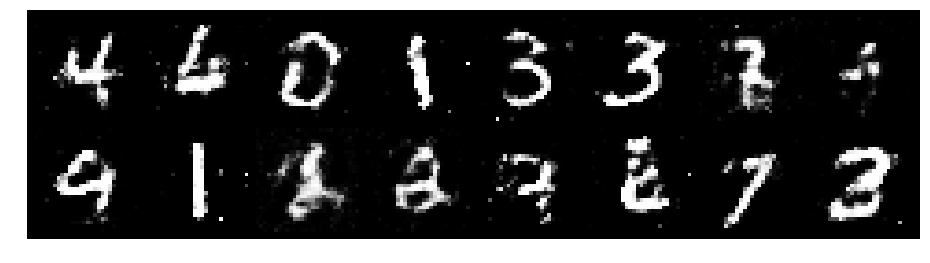

Epoch: [77/200], Batch Num: [400/600]
Discriminator Loss: 1.2224, Generator Loss: 0.9532
D(x): 0.6188, D(G(z)): 0.4569


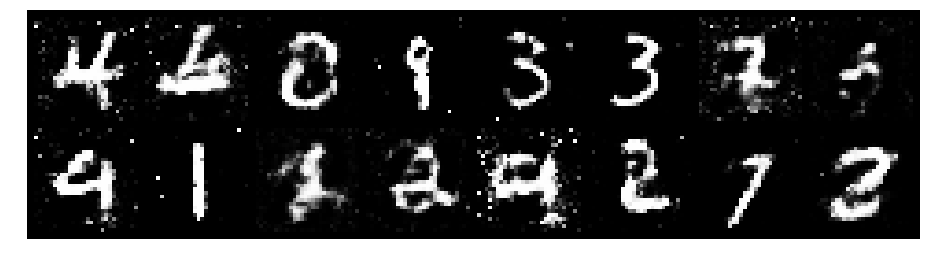

Epoch: [77/200], Batch Num: [500/600]
Discriminator Loss: 1.3660, Generator Loss: 0.8822
D(x): 0.5398, D(G(z)): 0.4487


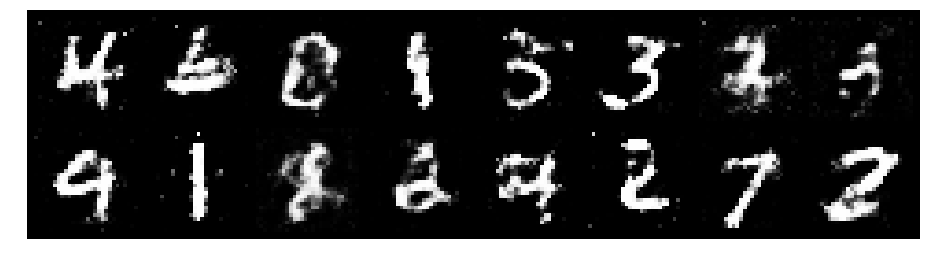

Epoch: [78/200], Batch Num: [0/600]
Discriminator Loss: 1.3140, Generator Loss: 0.7899
D(x): 0.5769, D(G(z)): 0.4829


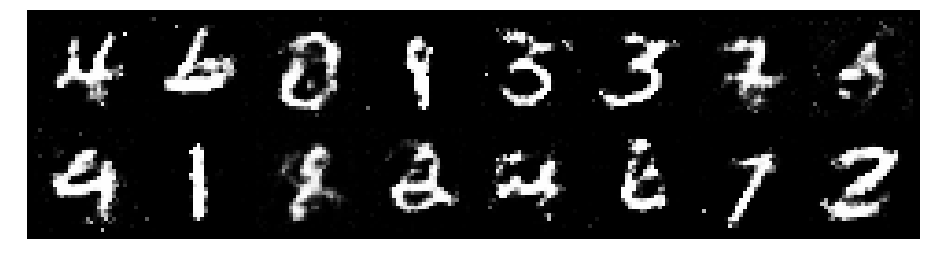

Epoch: [78/200], Batch Num: [100/600]
Discriminator Loss: 1.2242, Generator Loss: 0.9040
D(x): 0.6838, D(G(z)): 0.5150


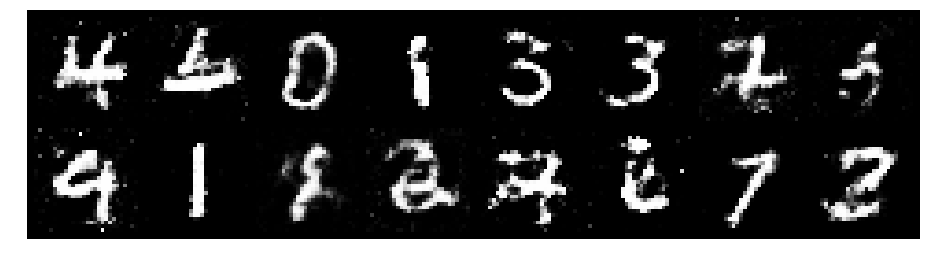

Epoch: [78/200], Batch Num: [200/600]
Discriminator Loss: 1.1691, Generator Loss: 1.1934
D(x): 0.5909, D(G(z)): 0.3997


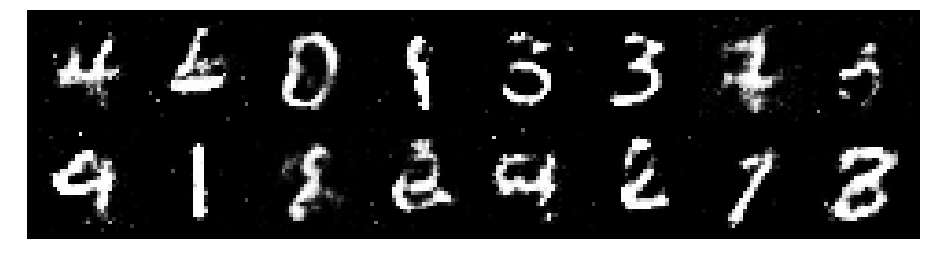

Epoch: [78/200], Batch Num: [300/600]
Discriminator Loss: 1.1205, Generator Loss: 1.0842
D(x): 0.5860, D(G(z)): 0.3691


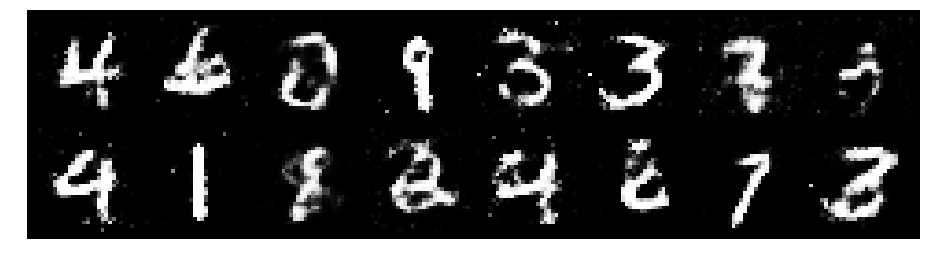

Epoch: [78/200], Batch Num: [400/600]
Discriminator Loss: 1.1350, Generator Loss: 1.1042
D(x): 0.5591, D(G(z)): 0.3591


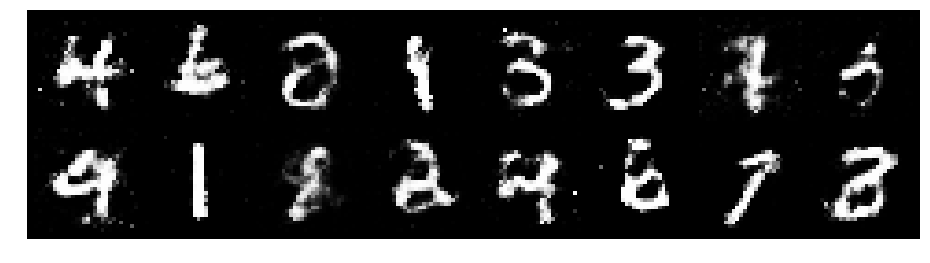

Epoch: [78/200], Batch Num: [500/600]
Discriminator Loss: 1.1395, Generator Loss: 1.0572
D(x): 0.5745, D(G(z)): 0.3937


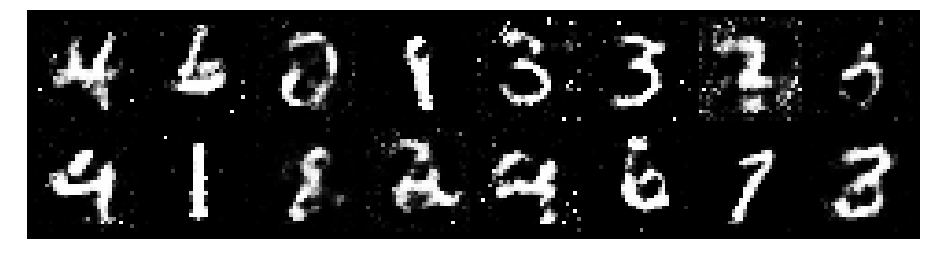

Epoch: [79/200], Batch Num: [0/600]
Discriminator Loss: 1.4189, Generator Loss: 0.9864
D(x): 0.5300, D(G(z)): 0.4668


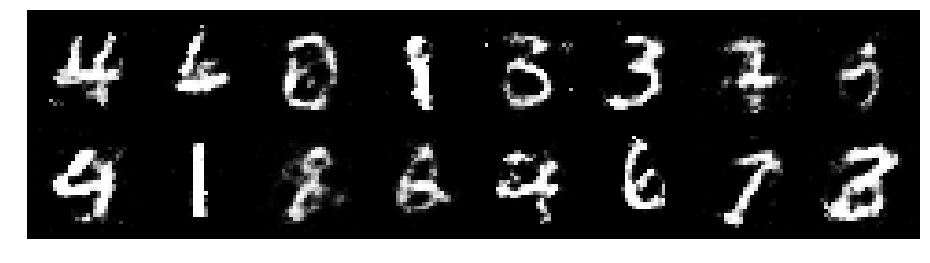

Epoch: [79/200], Batch Num: [100/600]
Discriminator Loss: 1.2448, Generator Loss: 0.7798
D(x): 0.5725, D(G(z)): 0.4535


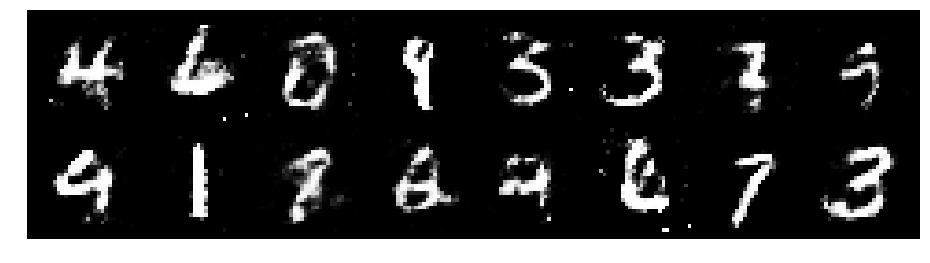

Epoch: [79/200], Batch Num: [200/600]
Discriminator Loss: 1.2886, Generator Loss: 1.3124
D(x): 0.5596, D(G(z)): 0.4176


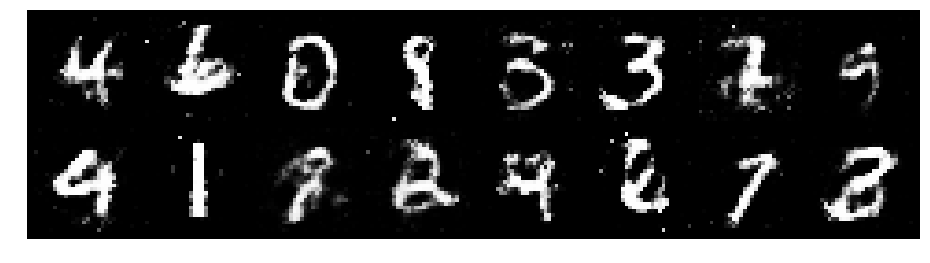

Epoch: [79/200], Batch Num: [300/600]
Discriminator Loss: 1.2809, Generator Loss: 0.9358
D(x): 0.5777, D(G(z)): 0.4378


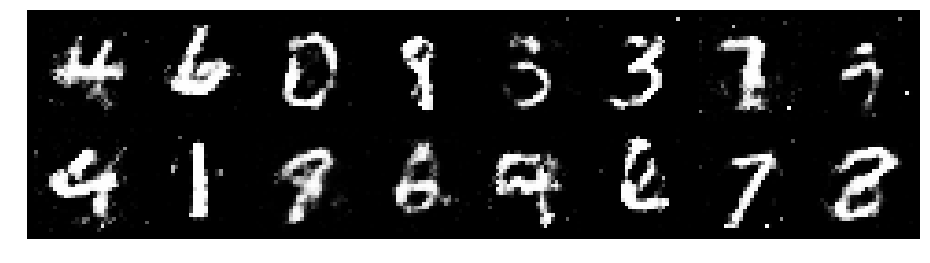

Epoch: [79/200], Batch Num: [400/600]
Discriminator Loss: 1.2397, Generator Loss: 1.1052
D(x): 0.6208, D(G(z)): 0.4505


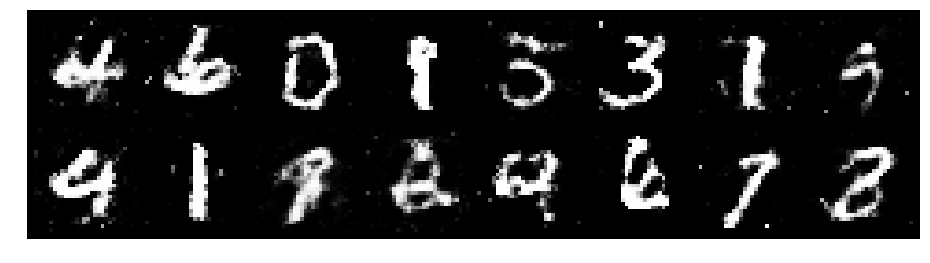

Epoch: [79/200], Batch Num: [500/600]
Discriminator Loss: 1.1859, Generator Loss: 0.9329
D(x): 0.5831, D(G(z)): 0.4262


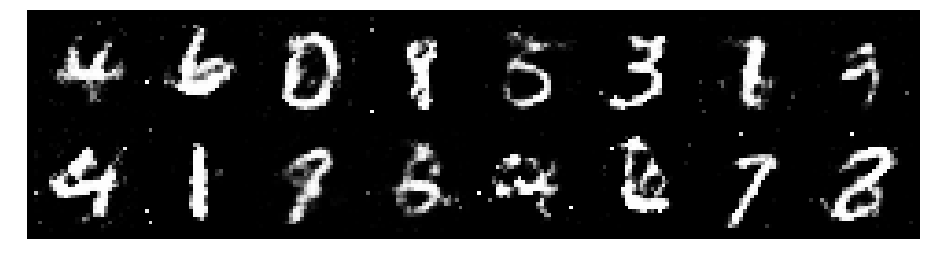

Epoch: [80/200], Batch Num: [0/600]
Discriminator Loss: 1.1825, Generator Loss: 0.8556
D(x): 0.5674, D(G(z)): 0.4276


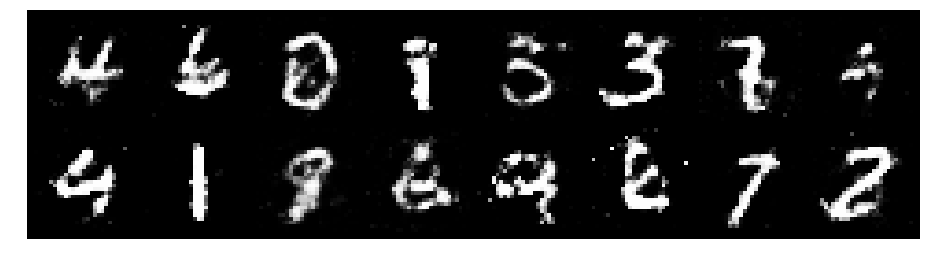

Epoch: [80/200], Batch Num: [100/600]
Discriminator Loss: 1.1128, Generator Loss: 1.0962
D(x): 0.5568, D(G(z)): 0.3510


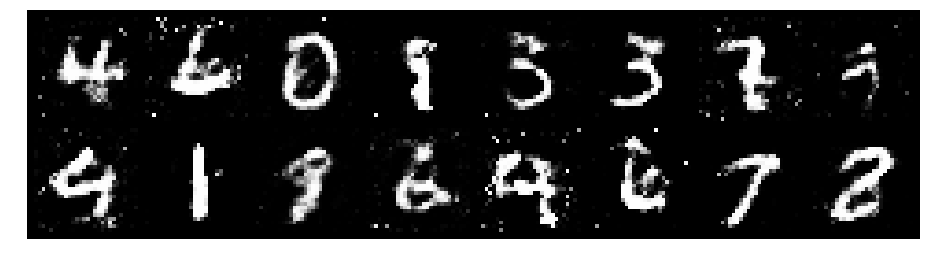

Epoch: [80/200], Batch Num: [200/600]
Discriminator Loss: 1.2614, Generator Loss: 0.8919
D(x): 0.5335, D(G(z)): 0.4220


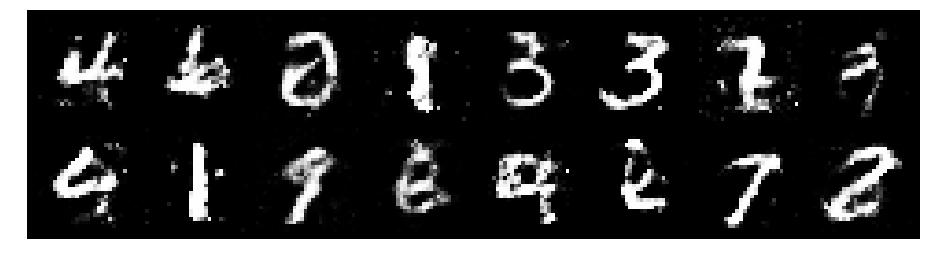

Epoch: [80/200], Batch Num: [300/600]
Discriminator Loss: 1.1274, Generator Loss: 1.1651
D(x): 0.5869, D(G(z)): 0.3760


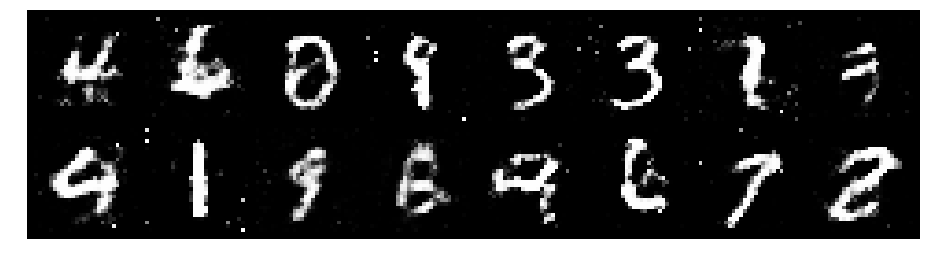

Epoch: [80/200], Batch Num: [400/600]
Discriminator Loss: 1.2160, Generator Loss: 0.9252
D(x): 0.5604, D(G(z)): 0.4356


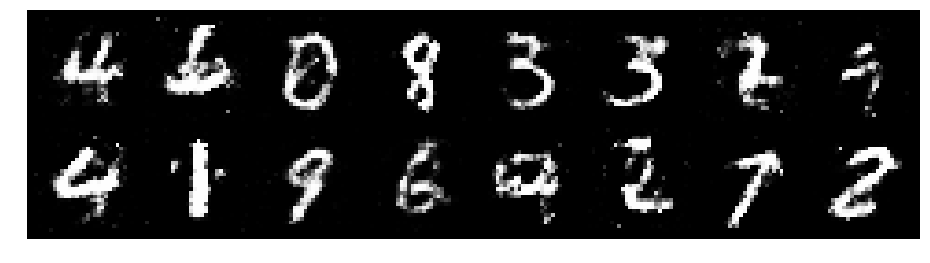

Epoch: [80/200], Batch Num: [500/600]
Discriminator Loss: 1.1994, Generator Loss: 0.9161
D(x): 0.6143, D(G(z)): 0.4675


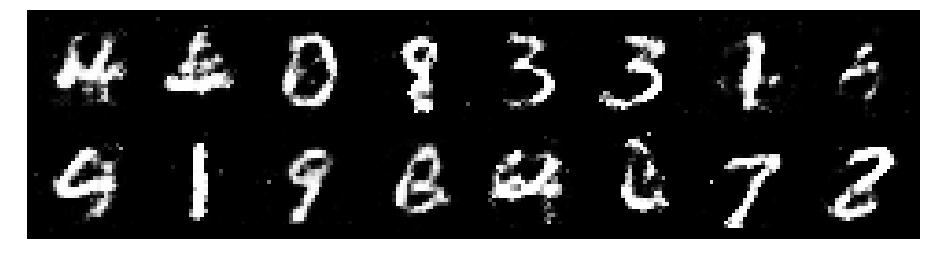

Epoch: [81/200], Batch Num: [0/600]
Discriminator Loss: 1.2927, Generator Loss: 1.0209
D(x): 0.5623, D(G(z)): 0.4390


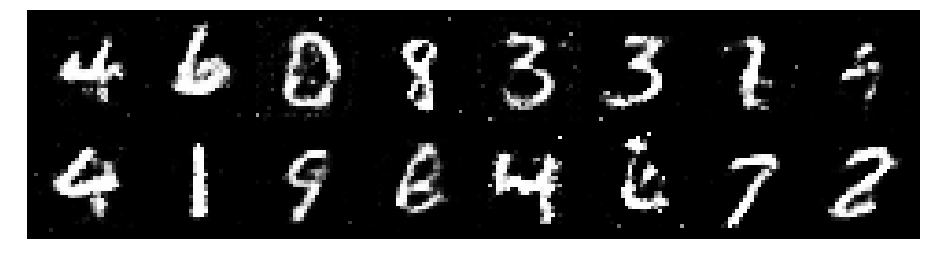

Epoch: [81/200], Batch Num: [100/600]
Discriminator Loss: 1.1916, Generator Loss: 0.9233
D(x): 0.5982, D(G(z)): 0.4436


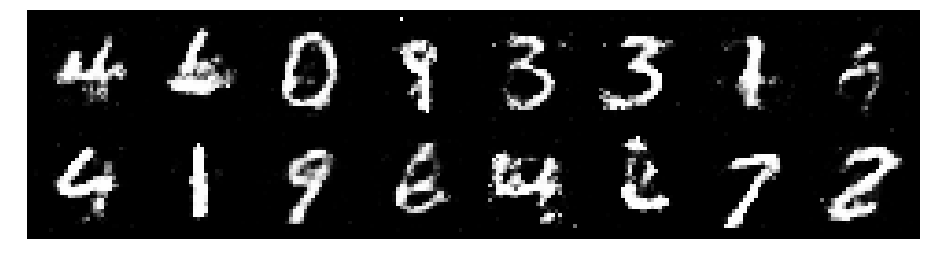

Epoch: [81/200], Batch Num: [200/600]
Discriminator Loss: 1.1049, Generator Loss: 1.0527
D(x): 0.6001, D(G(z)): 0.3624


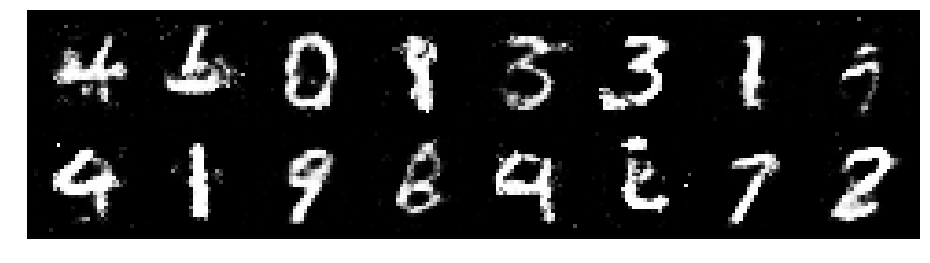

Epoch: [81/200], Batch Num: [300/600]
Discriminator Loss: 1.2907, Generator Loss: 0.8245
D(x): 0.6504, D(G(z)): 0.5120


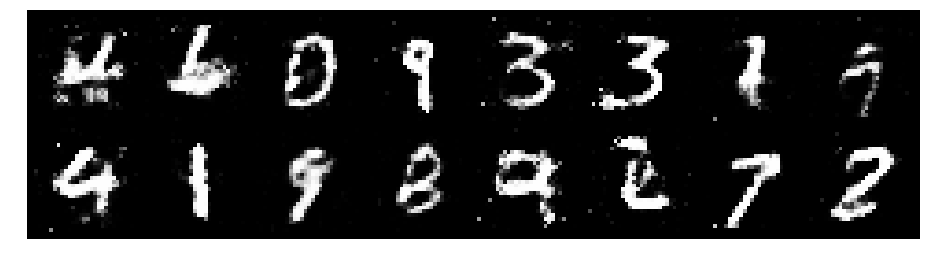

Epoch: [81/200], Batch Num: [400/600]
Discriminator Loss: 1.2008, Generator Loss: 0.9491
D(x): 0.5894, D(G(z)): 0.4134


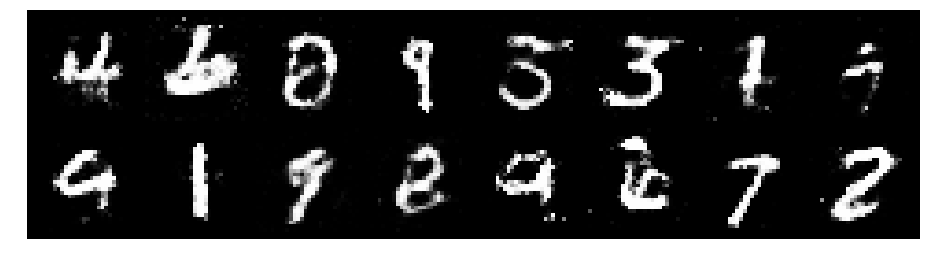

Epoch: [81/200], Batch Num: [500/600]
Discriminator Loss: 1.2367, Generator Loss: 0.9517
D(x): 0.5540, D(G(z)): 0.4172


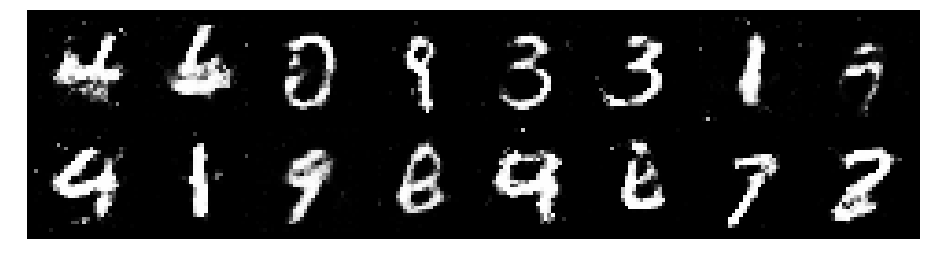

Epoch: [82/200], Batch Num: [0/600]
Discriminator Loss: 1.2151, Generator Loss: 0.8003
D(x): 0.5823, D(G(z)): 0.4390


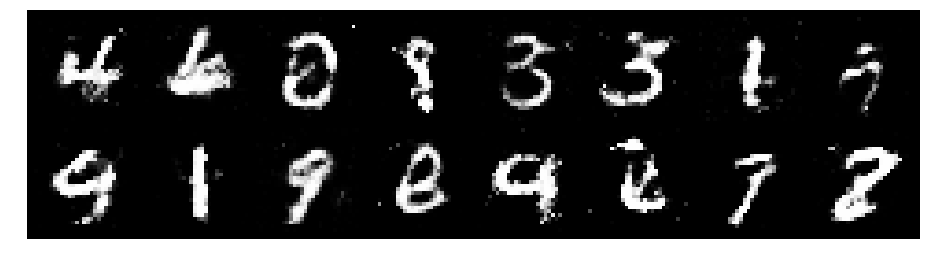

Epoch: [82/200], Batch Num: [100/600]
Discriminator Loss: 1.2737, Generator Loss: 0.9560
D(x): 0.5465, D(G(z)): 0.4363


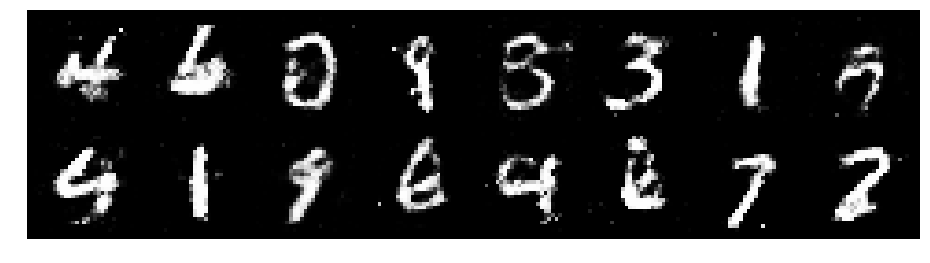

Epoch: [82/200], Batch Num: [200/600]
Discriminator Loss: 1.2772, Generator Loss: 0.8480
D(x): 0.5457, D(G(z)): 0.4209


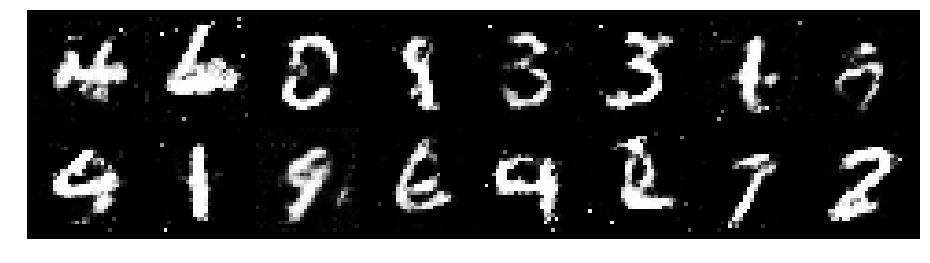

Epoch: [82/200], Batch Num: [300/600]
Discriminator Loss: 1.2974, Generator Loss: 0.8103
D(x): 0.5428, D(G(z)): 0.4534


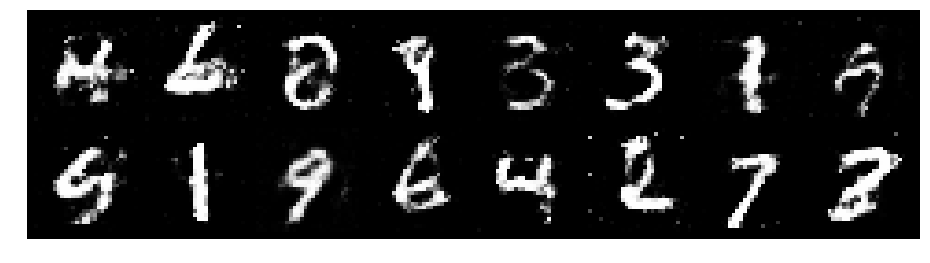

Epoch: [82/200], Batch Num: [400/600]
Discriminator Loss: 1.3023, Generator Loss: 0.8554
D(x): 0.5407, D(G(z)): 0.4497


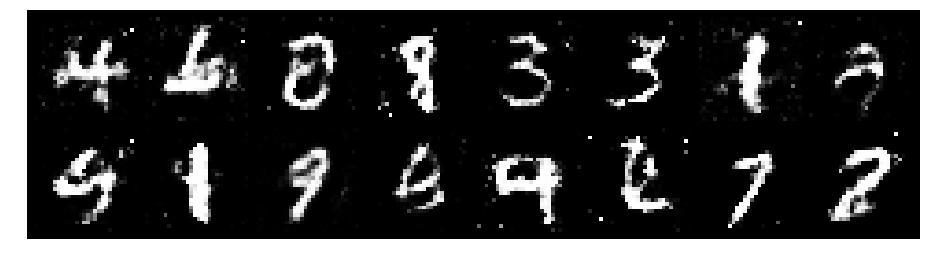

Epoch: [82/200], Batch Num: [500/600]
Discriminator Loss: 1.3552, Generator Loss: 0.9123
D(x): 0.5967, D(G(z)): 0.4855


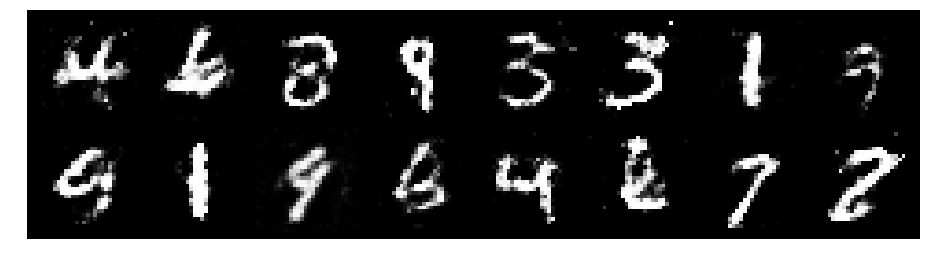

Epoch: [83/200], Batch Num: [0/600]
Discriminator Loss: 1.1490, Generator Loss: 0.9778
D(x): 0.5911, D(G(z)): 0.3923


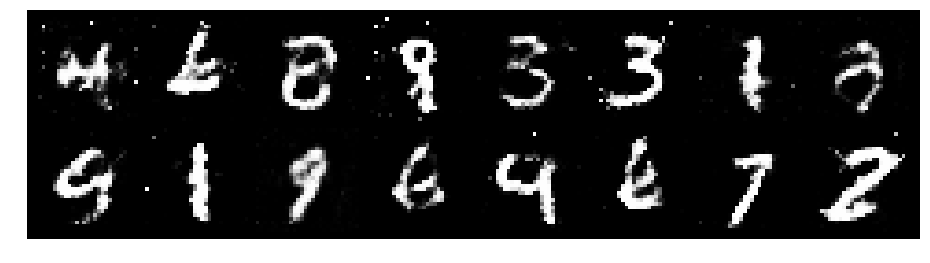

Epoch: [83/200], Batch Num: [100/600]
Discriminator Loss: 1.2624, Generator Loss: 1.0159
D(x): 0.5406, D(G(z)): 0.4212


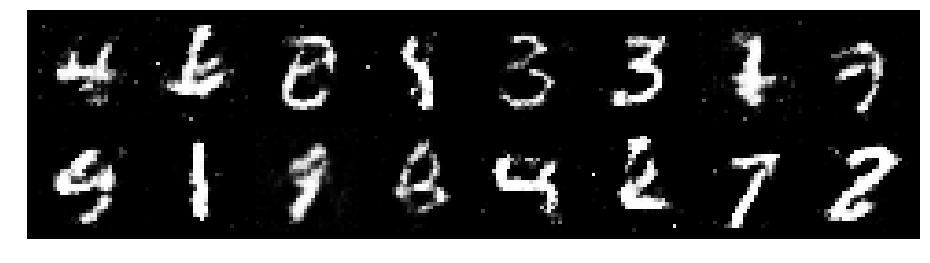

Epoch: [83/200], Batch Num: [200/600]
Discriminator Loss: 1.2773, Generator Loss: 0.9342
D(x): 0.5731, D(G(z)): 0.4601


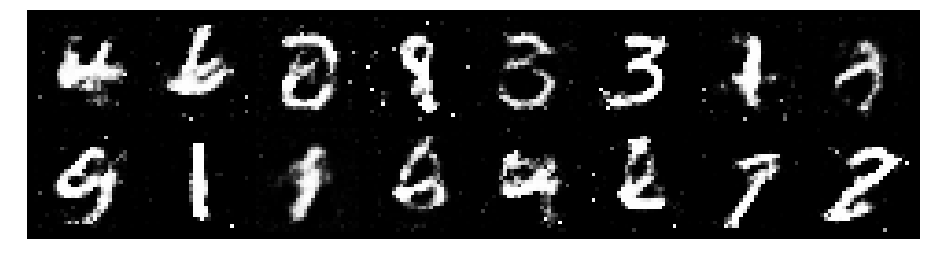

Epoch: [83/200], Batch Num: [300/600]
Discriminator Loss: 1.2897, Generator Loss: 0.9919
D(x): 0.5495, D(G(z)): 0.4242


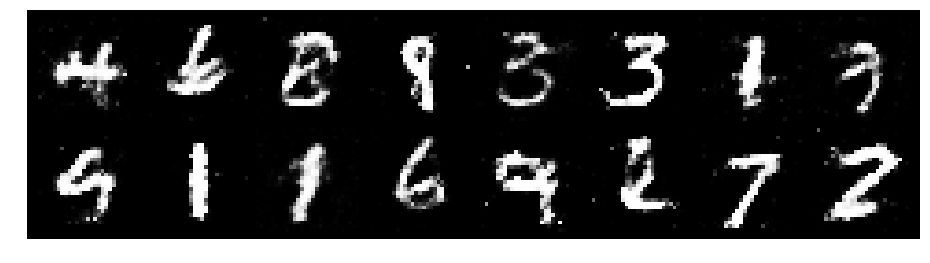

Epoch: [83/200], Batch Num: [400/600]
Discriminator Loss: 1.2782, Generator Loss: 0.9603
D(x): 0.5702, D(G(z)): 0.4473


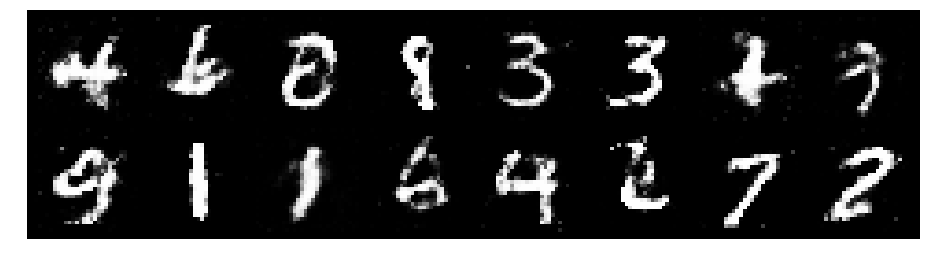

Epoch: [83/200], Batch Num: [500/600]
Discriminator Loss: 1.2642, Generator Loss: 1.0281
D(x): 0.5476, D(G(z)): 0.4013


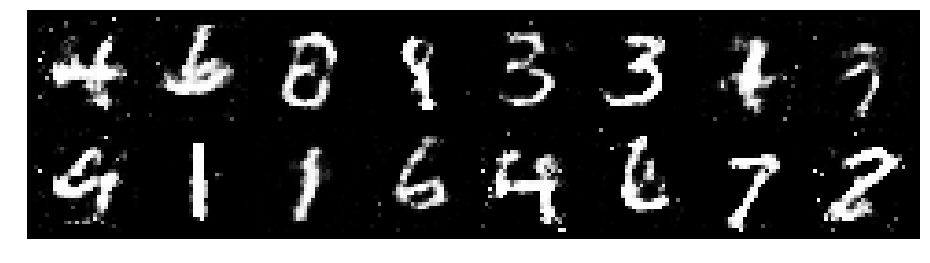

Epoch: [84/200], Batch Num: [0/600]
Discriminator Loss: 1.2661, Generator Loss: 0.8317
D(x): 0.5905, D(G(z)): 0.4675


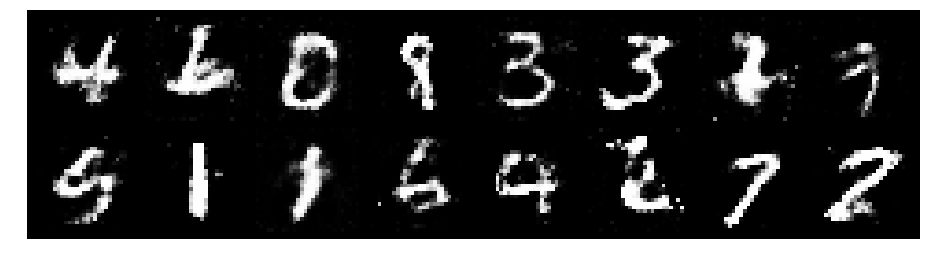

Epoch: [84/200], Batch Num: [100/600]
Discriminator Loss: 1.0064, Generator Loss: 1.0344
D(x): 0.6316, D(G(z)): 0.3634


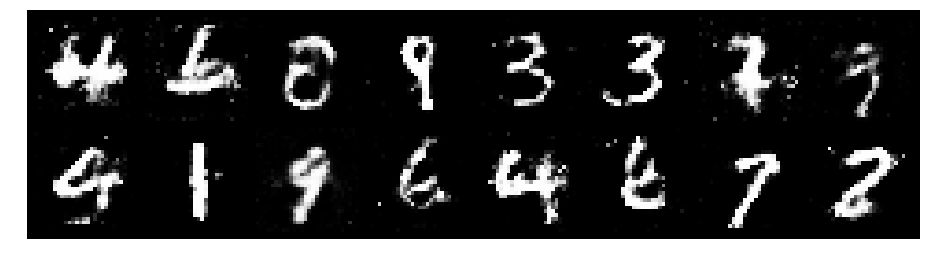

Epoch: [84/200], Batch Num: [200/600]
Discriminator Loss: 1.2074, Generator Loss: 1.1498
D(x): 0.5854, D(G(z)): 0.4319


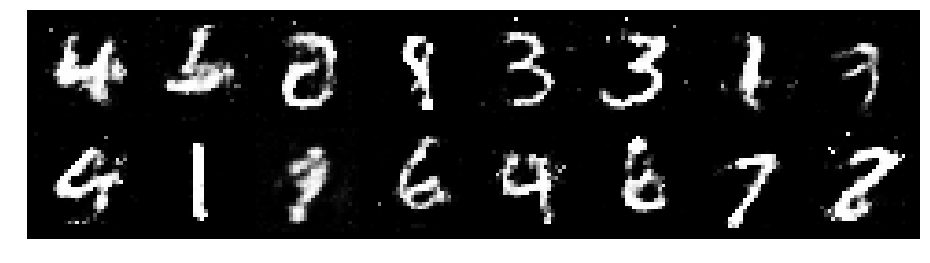

Epoch: [84/200], Batch Num: [300/600]
Discriminator Loss: 1.2626, Generator Loss: 1.0384
D(x): 0.5455, D(G(z)): 0.4192


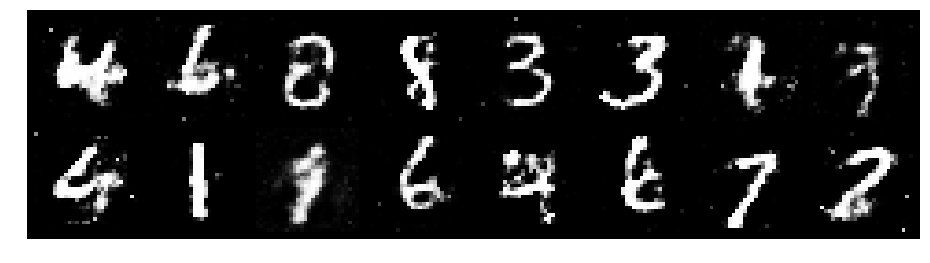

Epoch: [84/200], Batch Num: [400/600]
Discriminator Loss: 1.2871, Generator Loss: 1.0917
D(x): 0.5168, D(G(z)): 0.4042


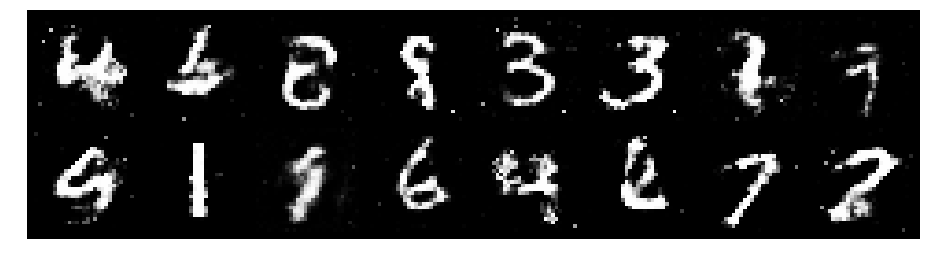

Epoch: [84/200], Batch Num: [500/600]
Discriminator Loss: 1.2887, Generator Loss: 1.0467
D(x): 0.5566, D(G(z)): 0.4234


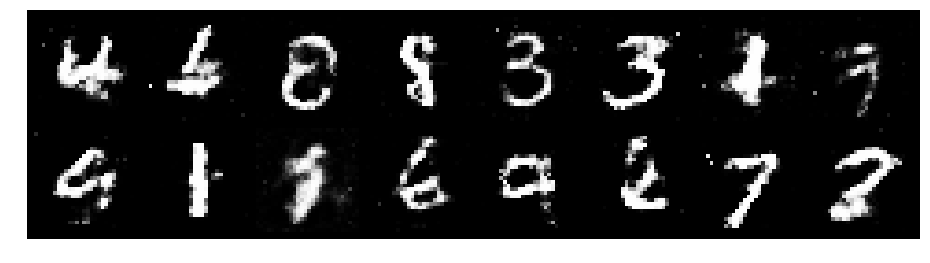

Epoch: [85/200], Batch Num: [0/600]
Discriminator Loss: 1.3320, Generator Loss: 0.8217
D(x): 0.5618, D(G(z)): 0.4608


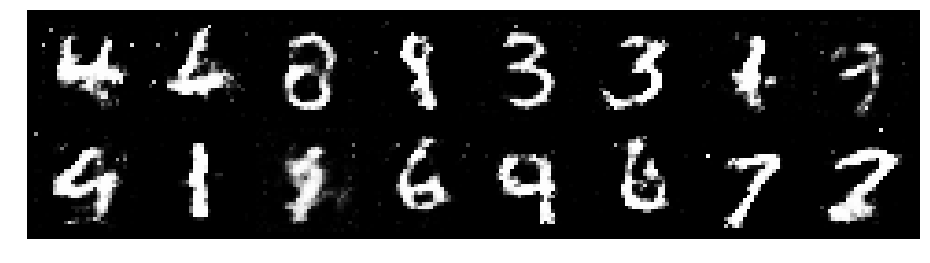

Epoch: [85/200], Batch Num: [100/600]
Discriminator Loss: 1.2533, Generator Loss: 1.3081
D(x): 0.6644, D(G(z)): 0.4678


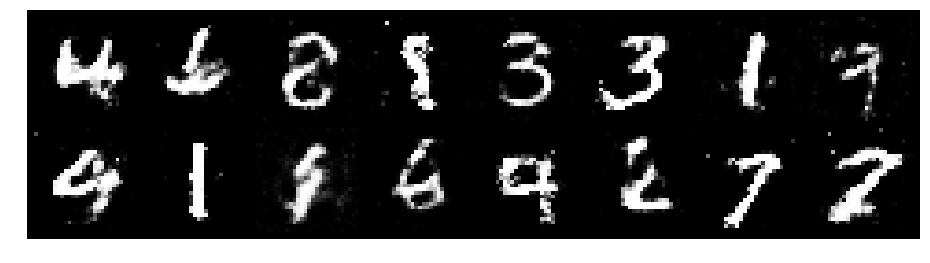

Epoch: [85/200], Batch Num: [200/600]
Discriminator Loss: 1.1127, Generator Loss: 1.2276
D(x): 0.6715, D(G(z)): 0.4107


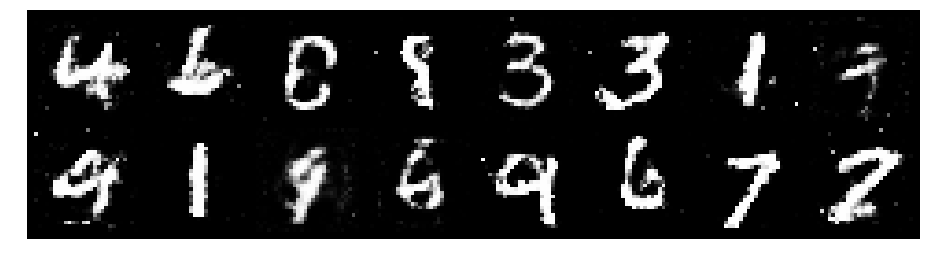

Epoch: [85/200], Batch Num: [300/600]
Discriminator Loss: 1.2379, Generator Loss: 0.9464
D(x): 0.5971, D(G(z)): 0.4435


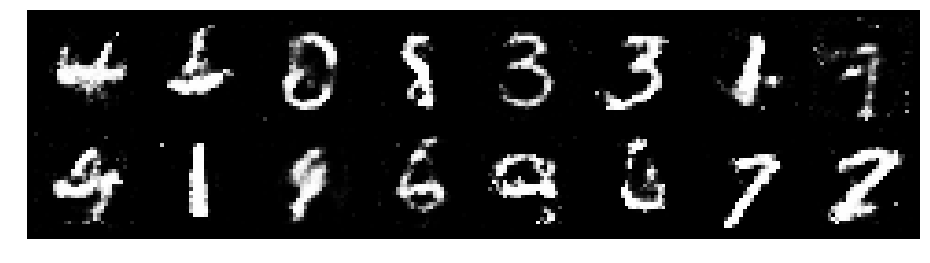

Epoch: [85/200], Batch Num: [400/600]
Discriminator Loss: 1.1666, Generator Loss: 1.0258
D(x): 0.5813, D(G(z)): 0.4056


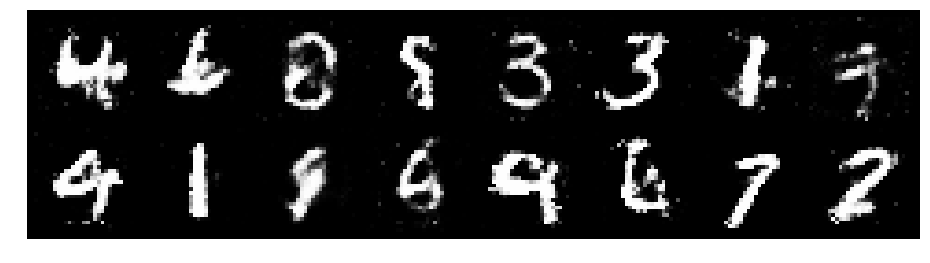

Epoch: [85/200], Batch Num: [500/600]
Discriminator Loss: 1.1398, Generator Loss: 0.9965
D(x): 0.6099, D(G(z)): 0.4320


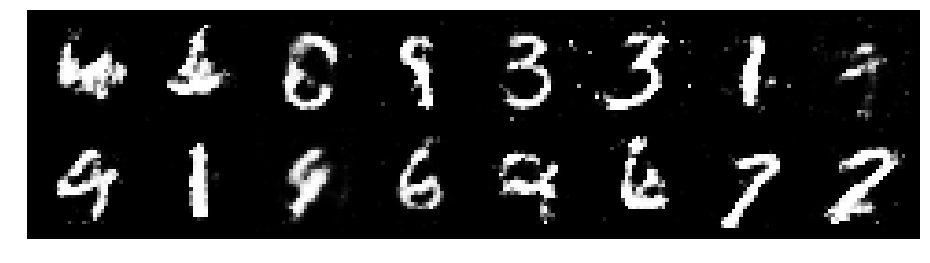

Epoch: [86/200], Batch Num: [0/600]
Discriminator Loss: 1.2501, Generator Loss: 0.8466
D(x): 0.5902, D(G(z)): 0.4509


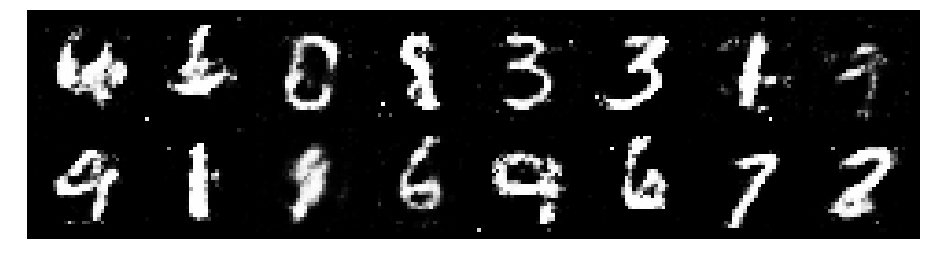

Epoch: [86/200], Batch Num: [100/600]
Discriminator Loss: 1.2189, Generator Loss: 0.8371
D(x): 0.5830, D(G(z)): 0.4271


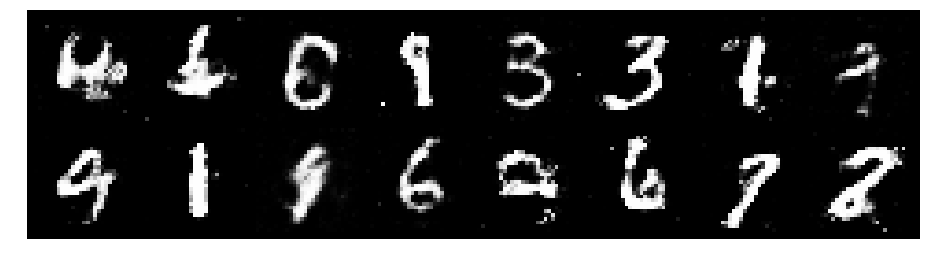

Epoch: [86/200], Batch Num: [200/600]
Discriminator Loss: 1.3070, Generator Loss: 0.9933
D(x): 0.5685, D(G(z)): 0.4443


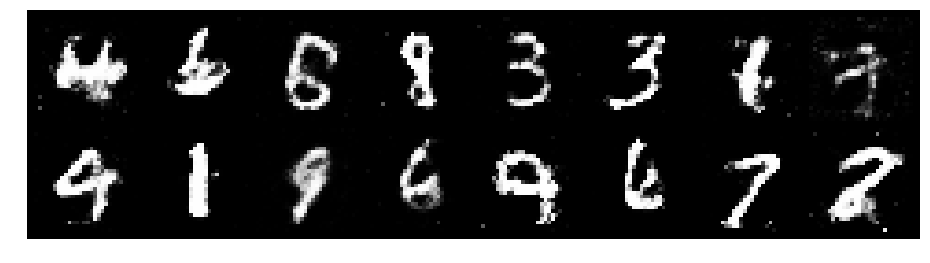

Epoch: [86/200], Batch Num: [300/600]
Discriminator Loss: 1.3123, Generator Loss: 0.9821
D(x): 0.6201, D(G(z)): 0.5034


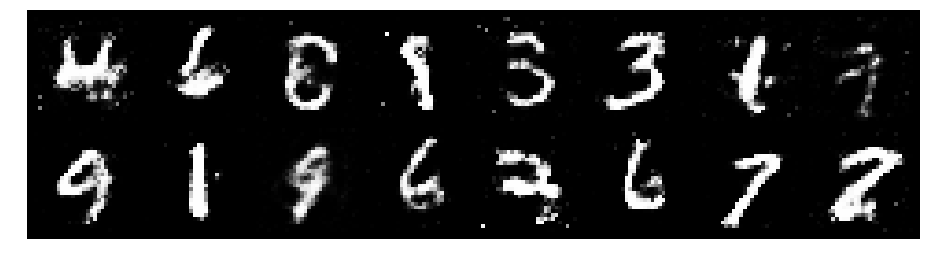

Epoch: [86/200], Batch Num: [400/600]
Discriminator Loss: 1.2104, Generator Loss: 0.9887
D(x): 0.6355, D(G(z)): 0.4731


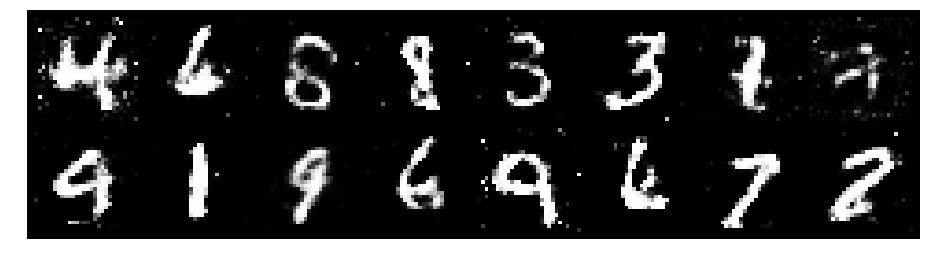

Epoch: [86/200], Batch Num: [500/600]
Discriminator Loss: 1.1539, Generator Loss: 1.0234
D(x): 0.5651, D(G(z)): 0.3914


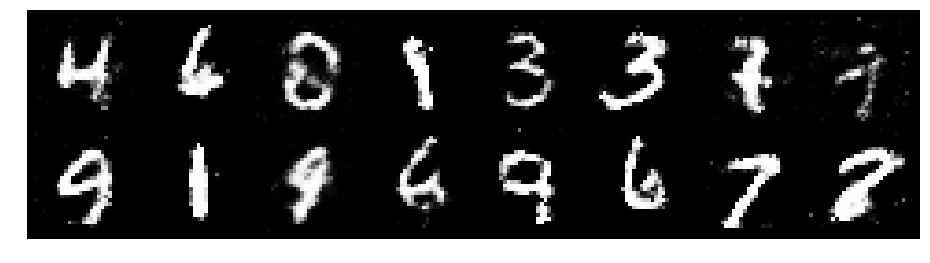

Epoch: [87/200], Batch Num: [0/600]
Discriminator Loss: 0.9253, Generator Loss: 1.1045
D(x): 0.6791, D(G(z)): 0.3447


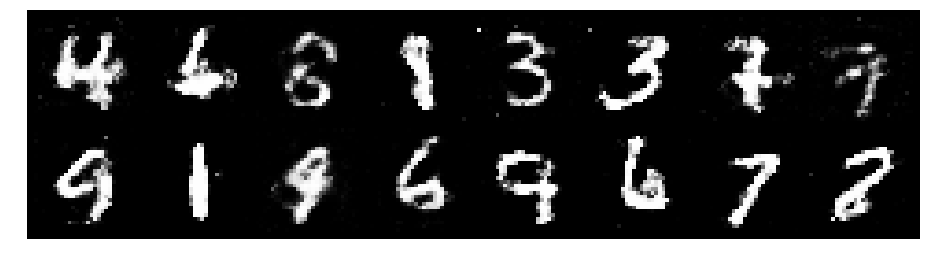

Epoch: [87/200], Batch Num: [100/600]
Discriminator Loss: 1.2979, Generator Loss: 0.9325
D(x): 0.5233, D(G(z)): 0.4285


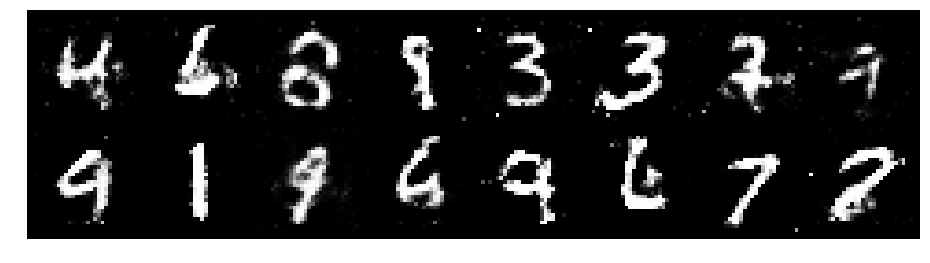

Epoch: [87/200], Batch Num: [200/600]
Discriminator Loss: 1.2092, Generator Loss: 0.9151
D(x): 0.5509, D(G(z)): 0.4065


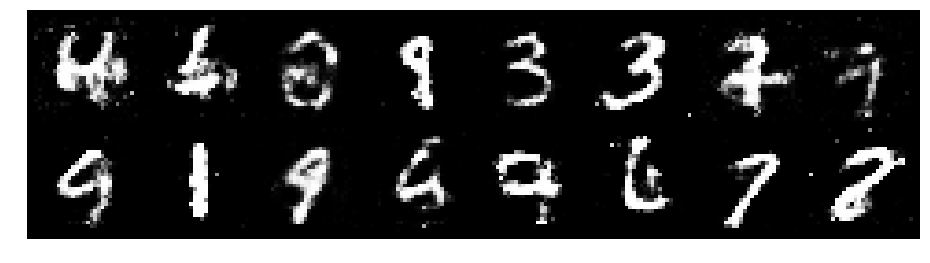

Epoch: [87/200], Batch Num: [300/600]
Discriminator Loss: 1.2720, Generator Loss: 1.0683
D(x): 0.5376, D(G(z)): 0.3897


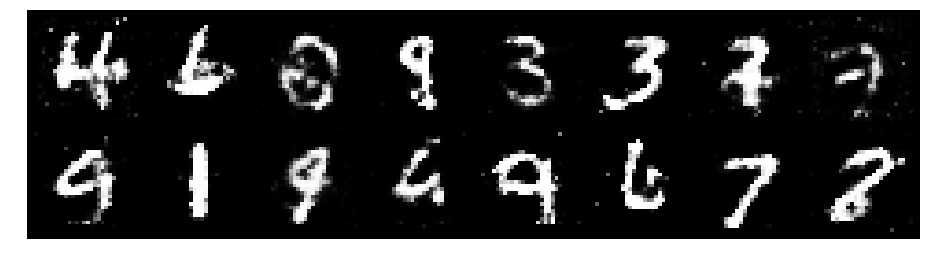

Epoch: [87/200], Batch Num: [400/600]
Discriminator Loss: 1.2192, Generator Loss: 0.8468
D(x): 0.5904, D(G(z)): 0.4510


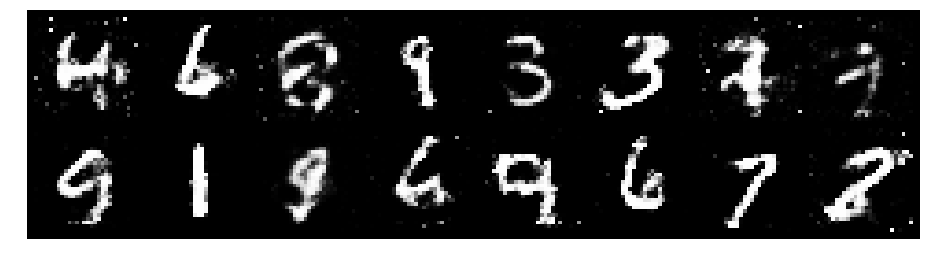

Epoch: [87/200], Batch Num: [500/600]
Discriminator Loss: 1.1715, Generator Loss: 0.9579
D(x): 0.5647, D(G(z)): 0.3920


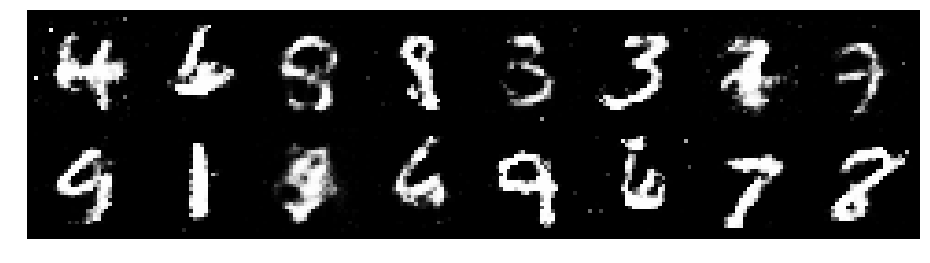

Epoch: [88/200], Batch Num: [0/600]
Discriminator Loss: 1.2486, Generator Loss: 1.0047
D(x): 0.5470, D(G(z)): 0.4135


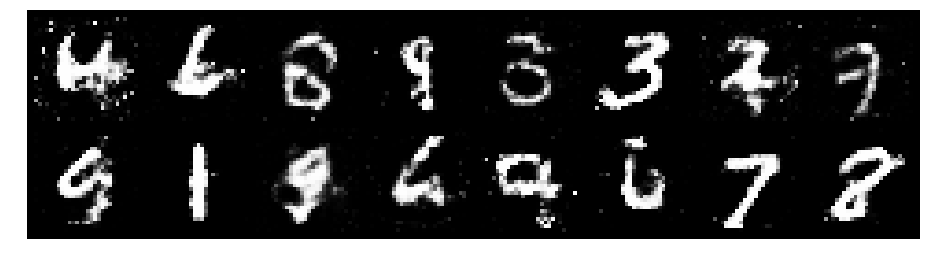

Epoch: [88/200], Batch Num: [100/600]
Discriminator Loss: 1.2050, Generator Loss: 0.9136
D(x): 0.5862, D(G(z)): 0.4147


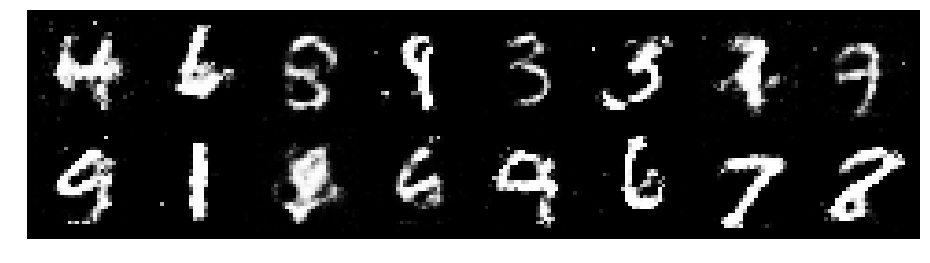

Epoch: [88/200], Batch Num: [200/600]
Discriminator Loss: 1.1337, Generator Loss: 1.0143
D(x): 0.5953, D(G(z)): 0.3962


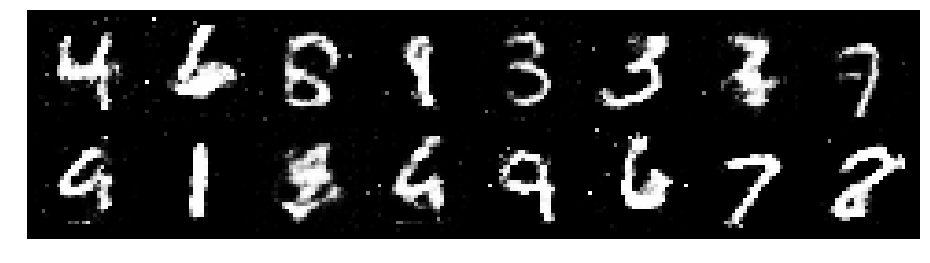

Epoch: [88/200], Batch Num: [300/600]
Discriminator Loss: 1.2681, Generator Loss: 1.0175
D(x): 0.5669, D(G(z)): 0.4340


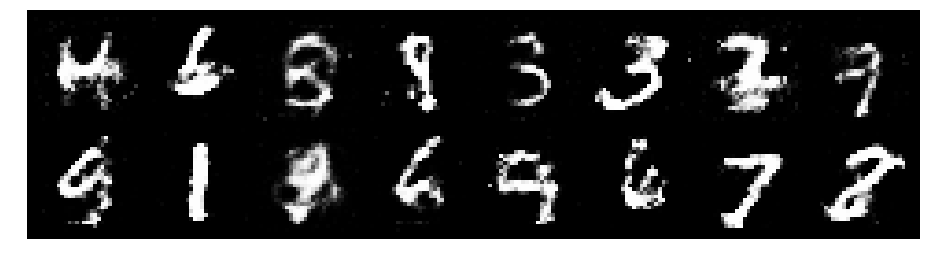

Epoch: [88/200], Batch Num: [400/600]
Discriminator Loss: 1.1213, Generator Loss: 1.0370
D(x): 0.5684, D(G(z)): 0.3680


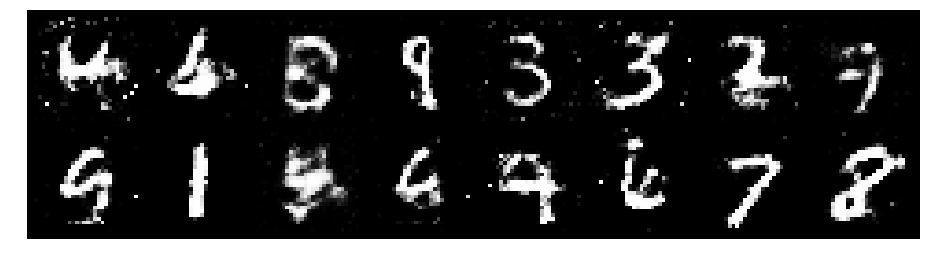

Epoch: [88/200], Batch Num: [500/600]
Discriminator Loss: 1.2361, Generator Loss: 0.9622
D(x): 0.5502, D(G(z)): 0.4276


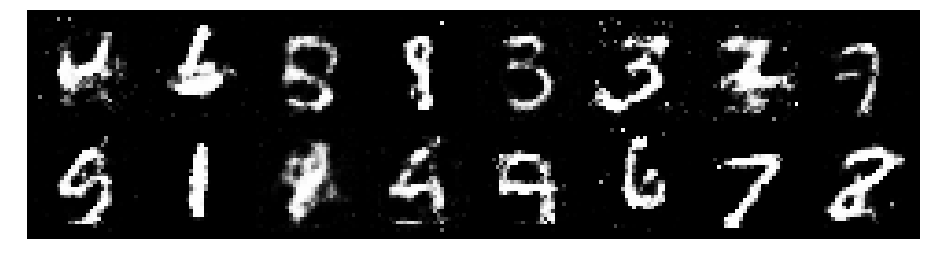

Epoch: [89/200], Batch Num: [0/600]
Discriminator Loss: 1.1516, Generator Loss: 1.0604
D(x): 0.5715, D(G(z)): 0.3982


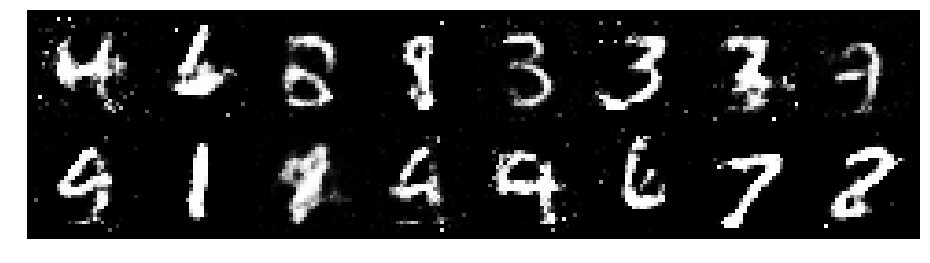

Epoch: [89/200], Batch Num: [100/600]
Discriminator Loss: 1.2859, Generator Loss: 1.0352
D(x): 0.5590, D(G(z)): 0.4309


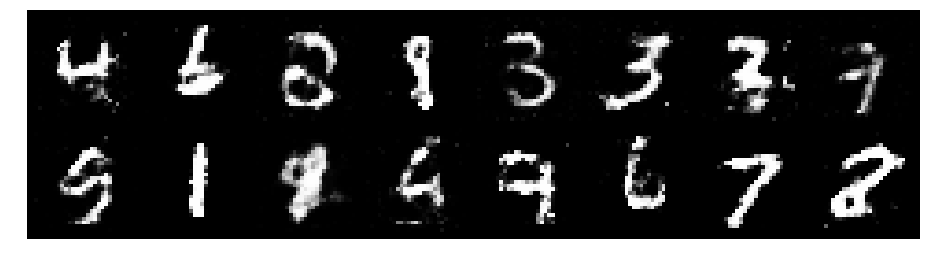

Epoch: [89/200], Batch Num: [200/600]
Discriminator Loss: 1.2752, Generator Loss: 1.1986
D(x): 0.5719, D(G(z)): 0.4268


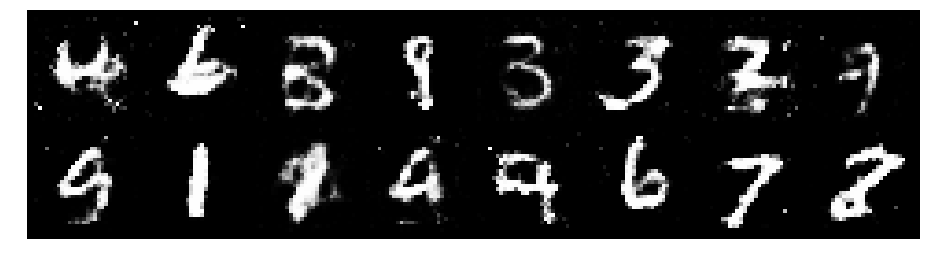

Epoch: [89/200], Batch Num: [300/600]
Discriminator Loss: 1.1832, Generator Loss: 1.0847
D(x): 0.5945, D(G(z)): 0.4058


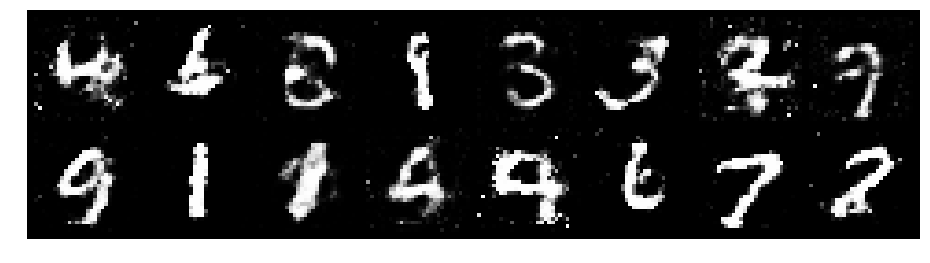

Epoch: [89/200], Batch Num: [400/600]
Discriminator Loss: 1.1734, Generator Loss: 0.9419
D(x): 0.5918, D(G(z)): 0.4339


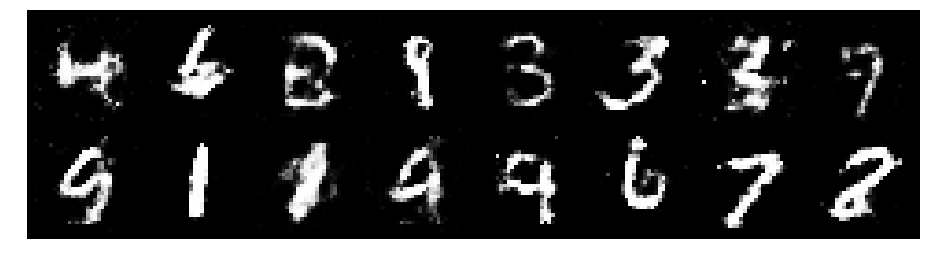

Epoch: [89/200], Batch Num: [500/600]
Discriminator Loss: 1.2404, Generator Loss: 0.8466
D(x): 0.5886, D(G(z)): 0.4548


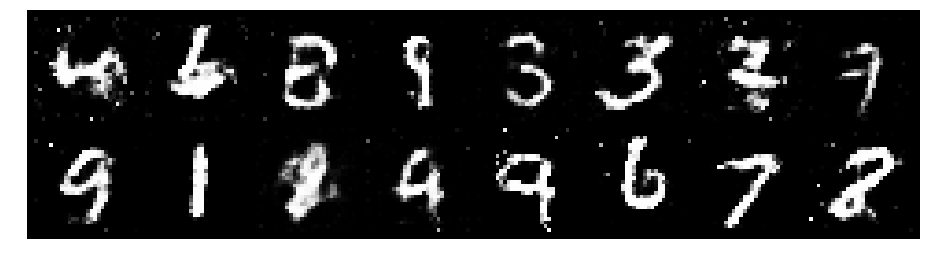

Epoch: [90/200], Batch Num: [0/600]
Discriminator Loss: 1.1596, Generator Loss: 0.9826
D(x): 0.5623, D(G(z)): 0.3780


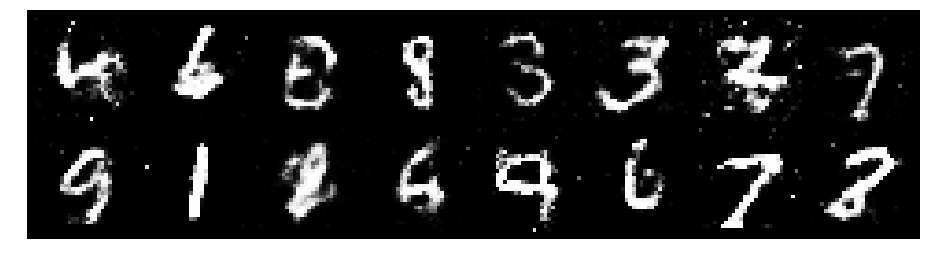

Epoch: [90/200], Batch Num: [100/600]
Discriminator Loss: 1.2291, Generator Loss: 0.9987
D(x): 0.6248, D(G(z)): 0.4393


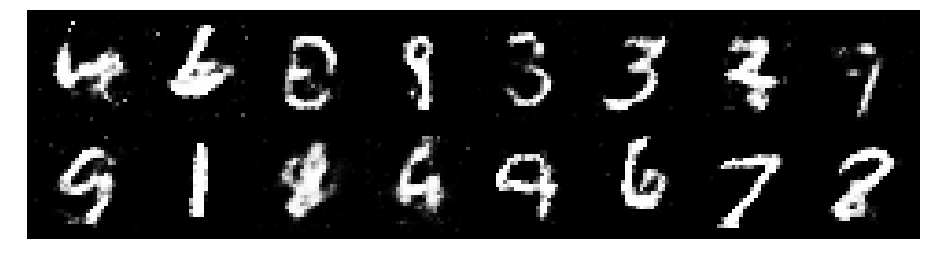

Epoch: [90/200], Batch Num: [200/600]
Discriminator Loss: 1.1975, Generator Loss: 1.0095
D(x): 0.5882, D(G(z)): 0.4014


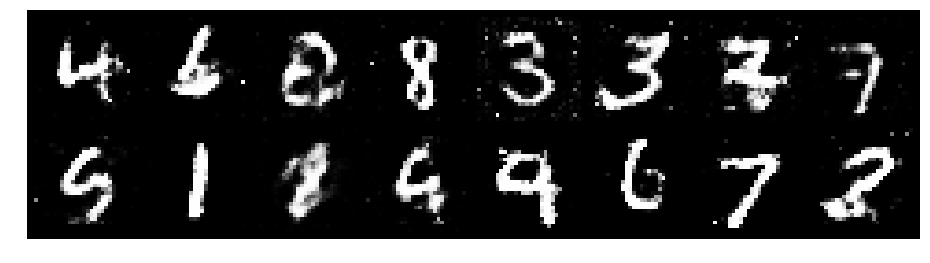

Epoch: [90/200], Batch Num: [300/600]
Discriminator Loss: 1.0894, Generator Loss: 1.0686
D(x): 0.5762, D(G(z)): 0.3684


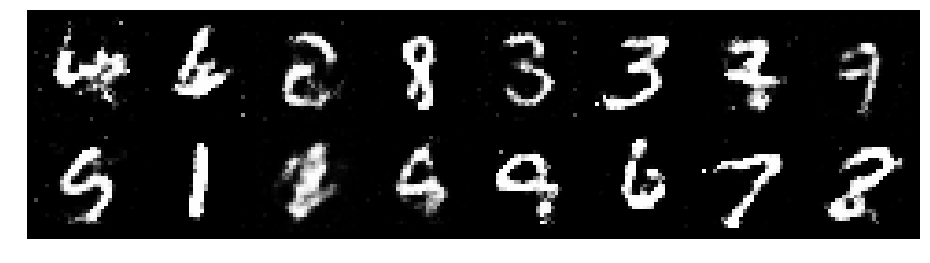

Epoch: [90/200], Batch Num: [400/600]
Discriminator Loss: 1.2331, Generator Loss: 1.1992
D(x): 0.5542, D(G(z)): 0.4026


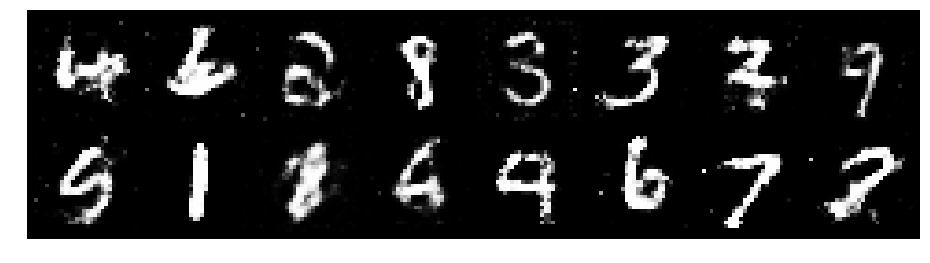

Epoch: [90/200], Batch Num: [500/600]
Discriminator Loss: 1.1774, Generator Loss: 1.0709
D(x): 0.5764, D(G(z)): 0.4165


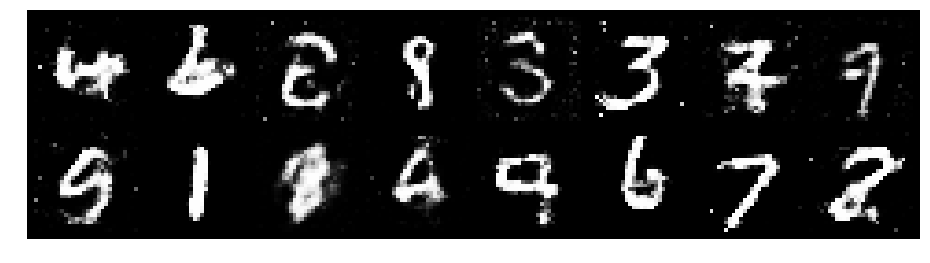

Epoch: [91/200], Batch Num: [0/600]
Discriminator Loss: 1.2527, Generator Loss: 0.8808
D(x): 0.5751, D(G(z)): 0.4452


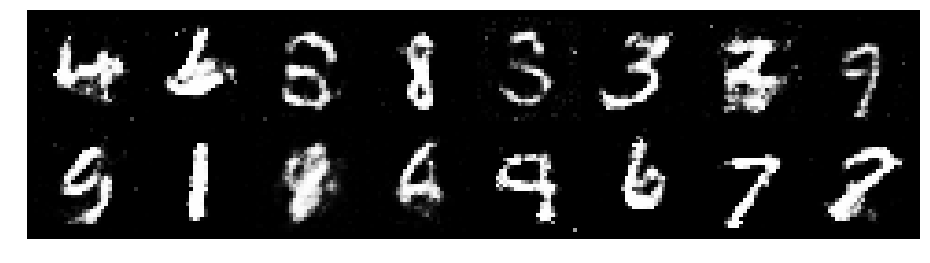

Epoch: [91/200], Batch Num: [100/600]
Discriminator Loss: 1.2003, Generator Loss: 0.9731
D(x): 0.5936, D(G(z)): 0.4366


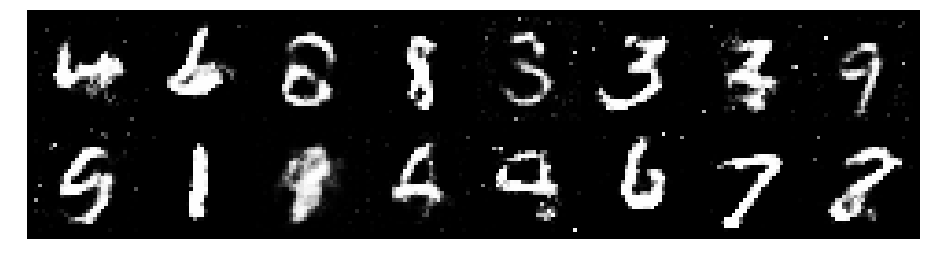

Epoch: [91/200], Batch Num: [200/600]
Discriminator Loss: 1.3399, Generator Loss: 0.9889
D(x): 0.5413, D(G(z)): 0.4572


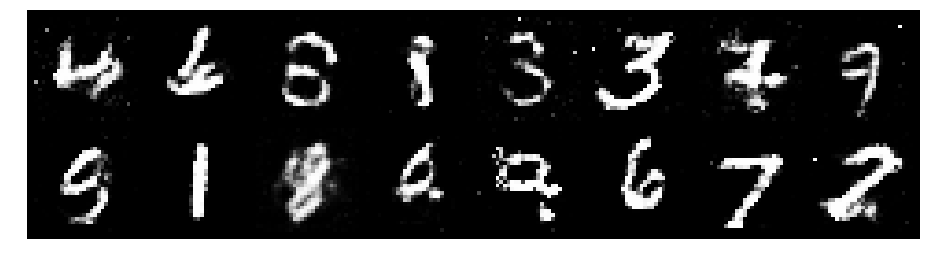

Epoch: [91/200], Batch Num: [300/600]
Discriminator Loss: 1.1962, Generator Loss: 0.8080
D(x): 0.6053, D(G(z)): 0.4502


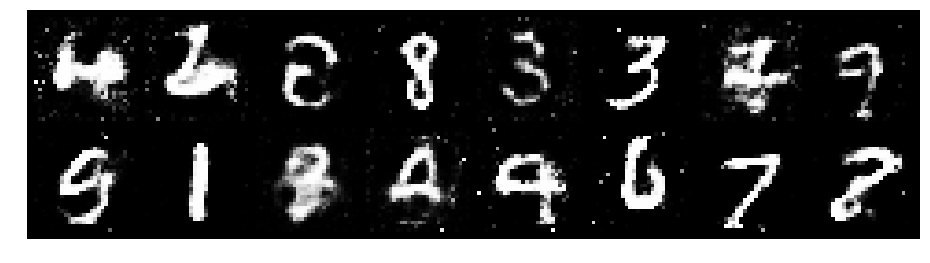

Epoch: [91/200], Batch Num: [400/600]
Discriminator Loss: 1.2367, Generator Loss: 0.8954
D(x): 0.5542, D(G(z)): 0.4364


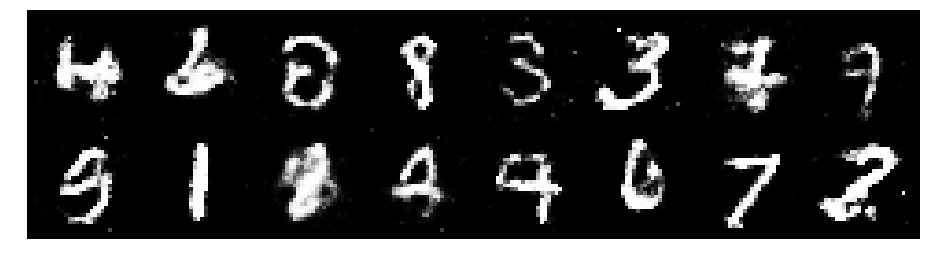

Epoch: [91/200], Batch Num: [500/600]
Discriminator Loss: 1.2684, Generator Loss: 0.9131
D(x): 0.5420, D(G(z)): 0.4244


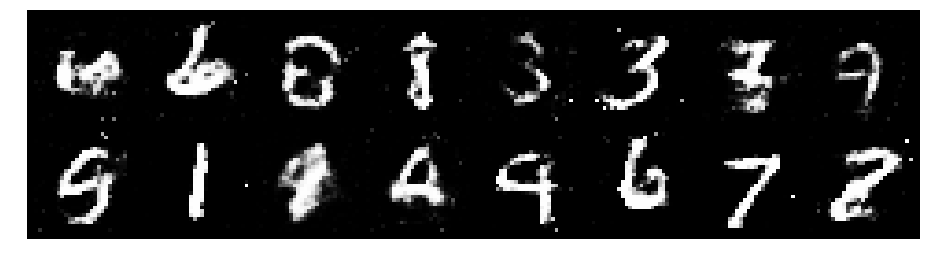

Epoch: [92/200], Batch Num: [0/600]
Discriminator Loss: 1.1882, Generator Loss: 0.9289
D(x): 0.5795, D(G(z)): 0.4267


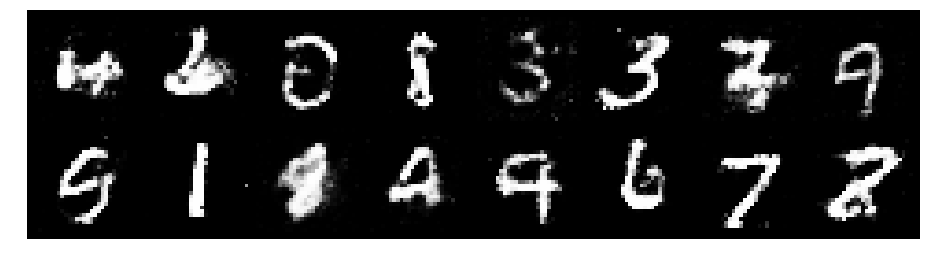

Epoch: [92/200], Batch Num: [100/600]
Discriminator Loss: 1.1957, Generator Loss: 1.0159
D(x): 0.6005, D(G(z)): 0.4388


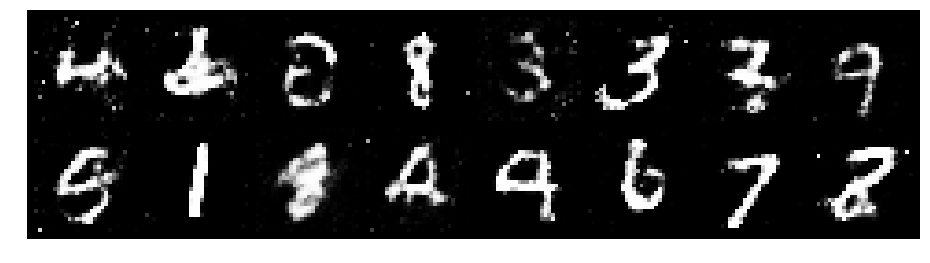

Epoch: [92/200], Batch Num: [200/600]
Discriminator Loss: 1.2311, Generator Loss: 1.0928
D(x): 0.5865, D(G(z)): 0.4225


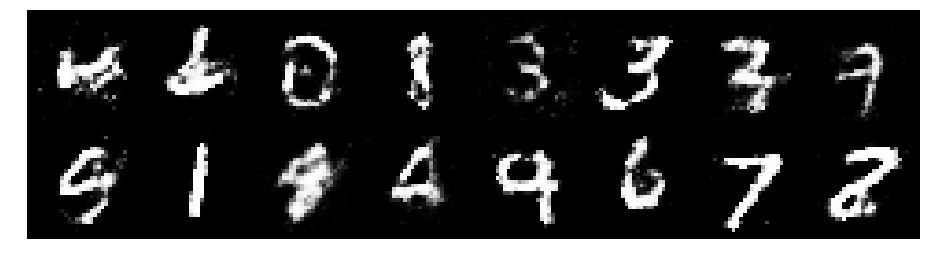

Epoch: [92/200], Batch Num: [300/600]
Discriminator Loss: 1.0933, Generator Loss: 1.1056
D(x): 0.5880, D(G(z)): 0.3681


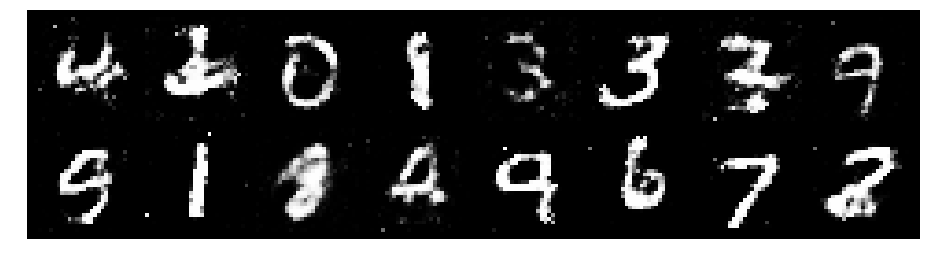

Epoch: [92/200], Batch Num: [400/600]
Discriminator Loss: 1.1188, Generator Loss: 0.9787
D(x): 0.5683, D(G(z)): 0.3707


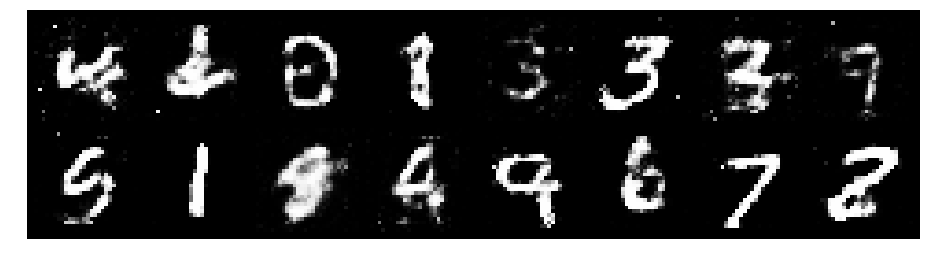

Epoch: [92/200], Batch Num: [500/600]
Discriminator Loss: 1.2193, Generator Loss: 0.8878
D(x): 0.5824, D(G(z)): 0.4324


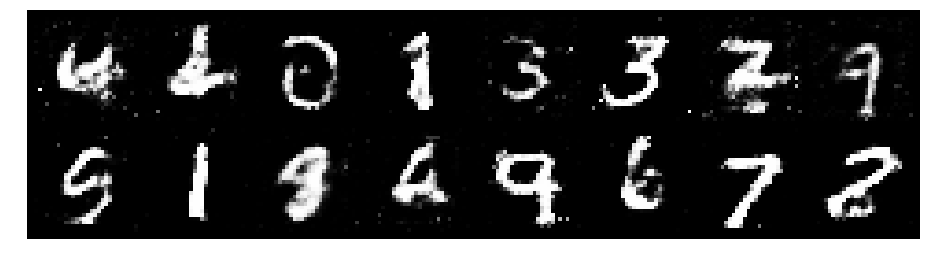

Epoch: [93/200], Batch Num: [0/600]
Discriminator Loss: 1.2224, Generator Loss: 1.1069
D(x): 0.6105, D(G(z)): 0.4365


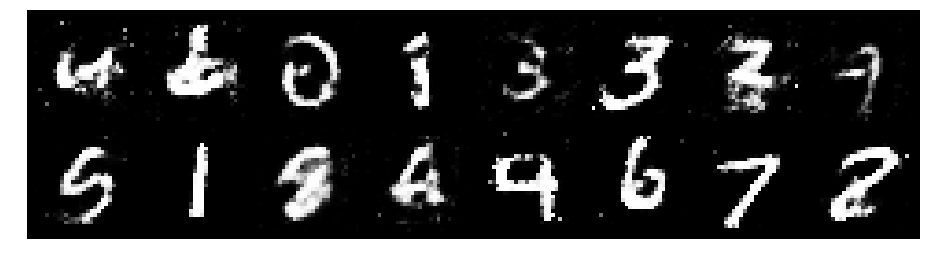

Epoch: [93/200], Batch Num: [100/600]
Discriminator Loss: 1.0747, Generator Loss: 1.1428
D(x): 0.6190, D(G(z)): 0.3652


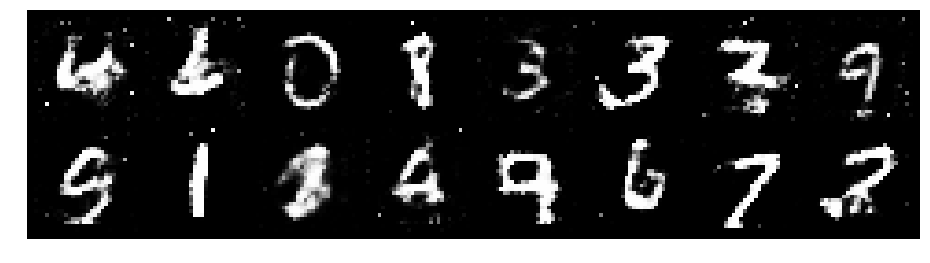

Epoch: [93/200], Batch Num: [200/600]
Discriminator Loss: 1.0366, Generator Loss: 1.2191
D(x): 0.6007, D(G(z)): 0.3603


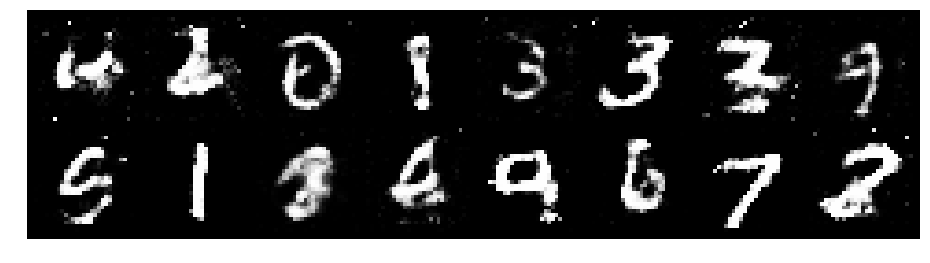

Epoch: [93/200], Batch Num: [300/600]
Discriminator Loss: 1.1455, Generator Loss: 0.8484
D(x): 0.5921, D(G(z)): 0.4090


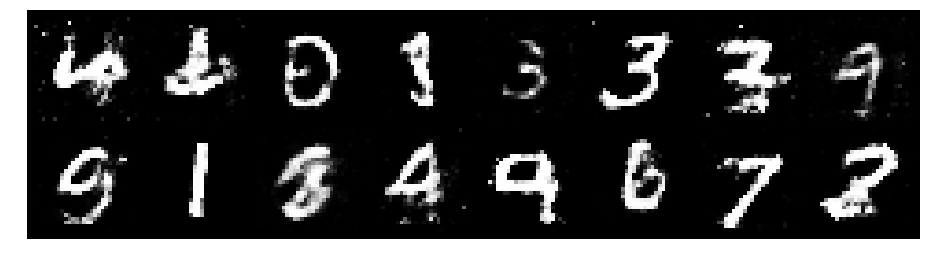

Epoch: [93/200], Batch Num: [400/600]
Discriminator Loss: 1.3645, Generator Loss: 1.0311
D(x): 0.5278, D(G(z)): 0.4340


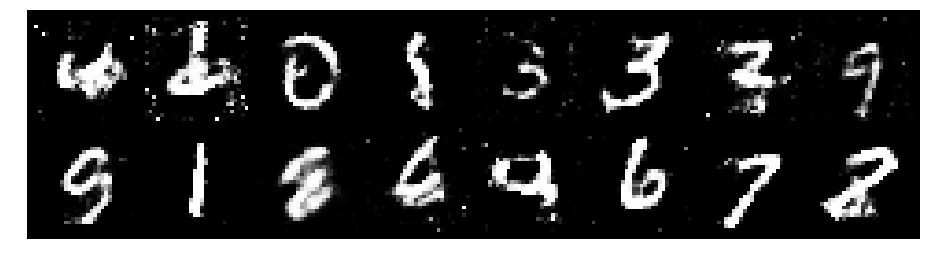

Epoch: [93/200], Batch Num: [500/600]
Discriminator Loss: 1.2226, Generator Loss: 1.0078
D(x): 0.5622, D(G(z)): 0.4047


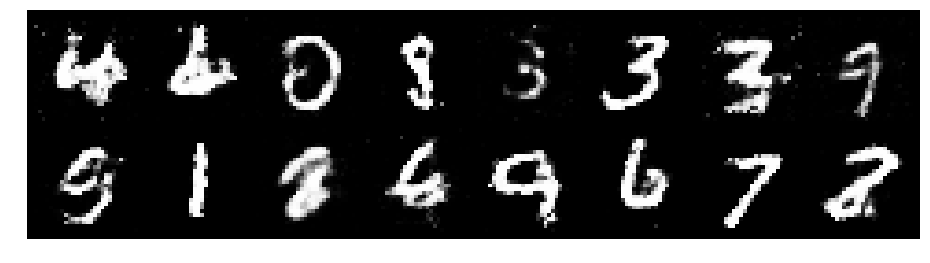

Epoch: [94/200], Batch Num: [0/600]
Discriminator Loss: 1.2015, Generator Loss: 0.9229
D(x): 0.5818, D(G(z)): 0.4324


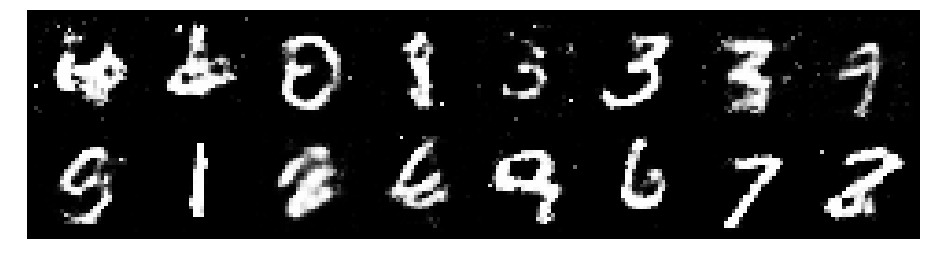

Epoch: [94/200], Batch Num: [100/600]
Discriminator Loss: 1.3031, Generator Loss: 0.8769
D(x): 0.6193, D(G(z)): 0.4921


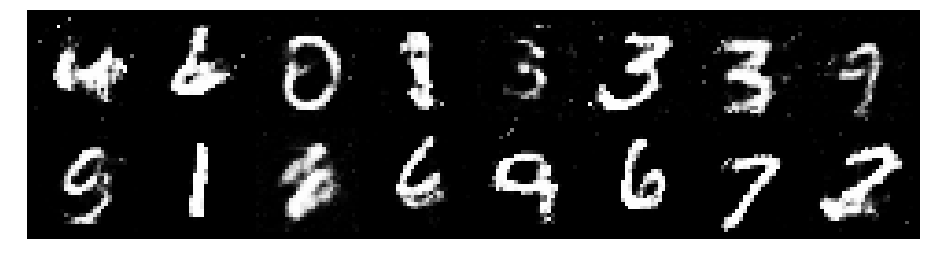

Epoch: [94/200], Batch Num: [200/600]
Discriminator Loss: 1.3637, Generator Loss: 0.8168
D(x): 0.5653, D(G(z)): 0.4915


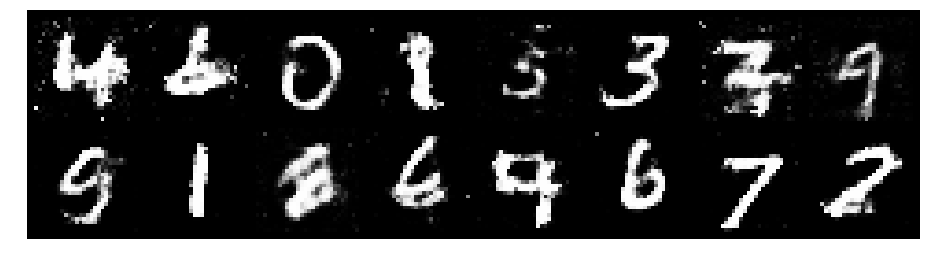

Epoch: [94/200], Batch Num: [300/600]
Discriminator Loss: 1.4059, Generator Loss: 0.7990
D(x): 0.5295, D(G(z)): 0.4761


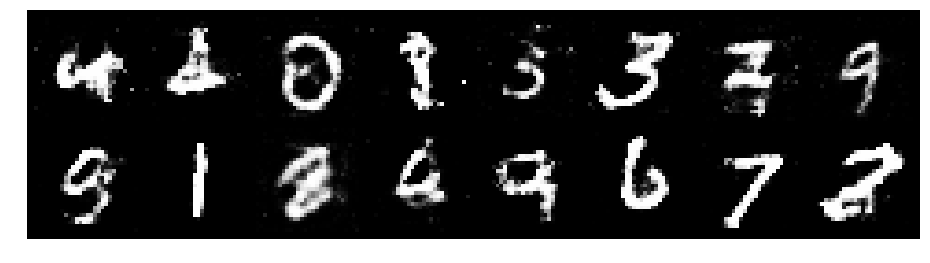

Epoch: [94/200], Batch Num: [400/600]
Discriminator Loss: 1.2148, Generator Loss: 0.9253
D(x): 0.6034, D(G(z)): 0.4337


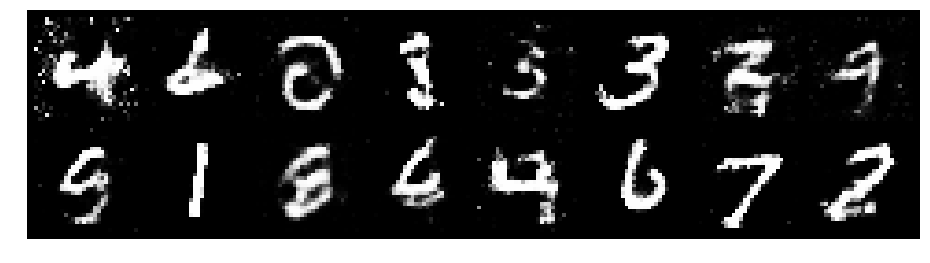

Epoch: [94/200], Batch Num: [500/600]
Discriminator Loss: 1.2068, Generator Loss: 1.0980
D(x): 0.5396, D(G(z)): 0.3870


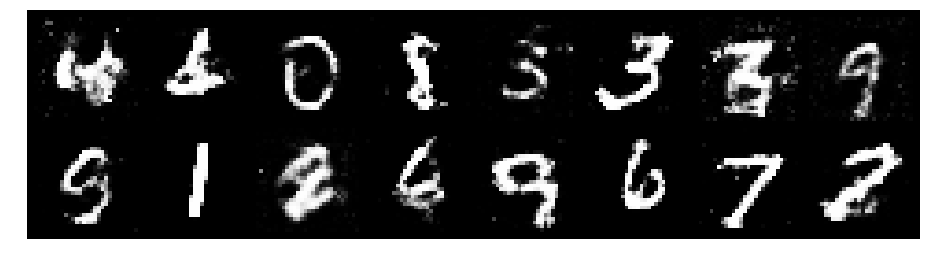

Epoch: [95/200], Batch Num: [0/600]
Discriminator Loss: 1.2239, Generator Loss: 0.8520
D(x): 0.5787, D(G(z)): 0.4273


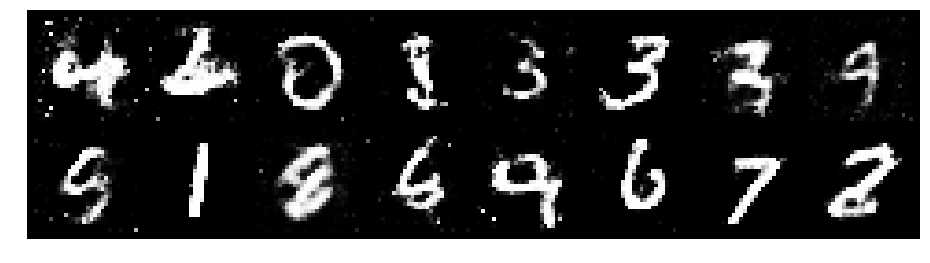

Epoch: [95/200], Batch Num: [100/600]
Discriminator Loss: 1.1257, Generator Loss: 0.9155
D(x): 0.6458, D(G(z)): 0.4284


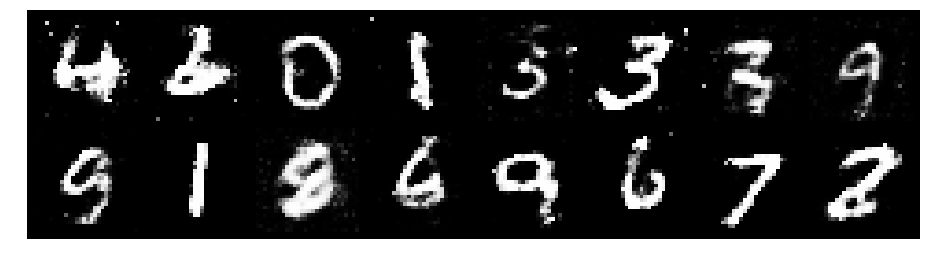

Epoch: [95/200], Batch Num: [200/600]
Discriminator Loss: 1.2980, Generator Loss: 0.9684
D(x): 0.5378, D(G(z)): 0.4389


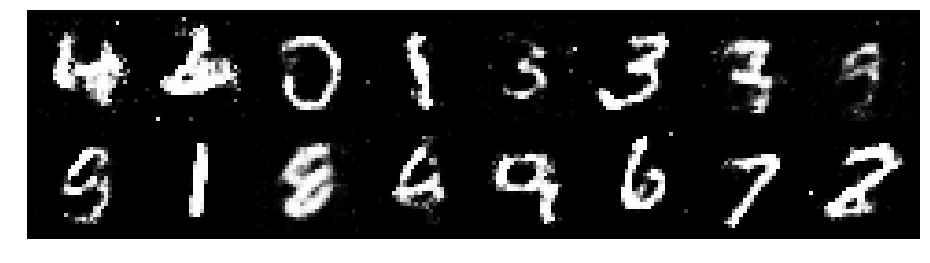

Epoch: [95/200], Batch Num: [300/600]
Discriminator Loss: 1.2664, Generator Loss: 0.8550
D(x): 0.5466, D(G(z)): 0.4390


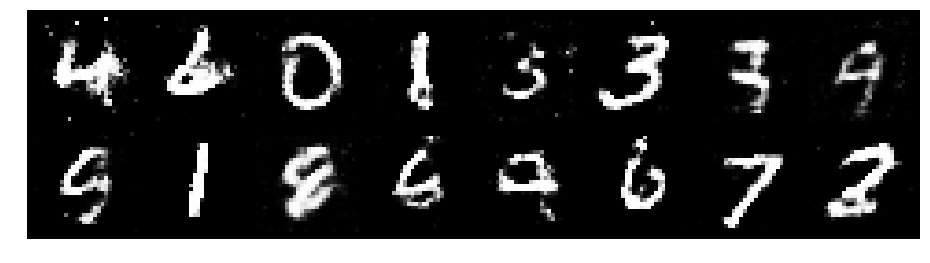

Epoch: [95/200], Batch Num: [400/600]
Discriminator Loss: 1.2784, Generator Loss: 0.8269
D(x): 0.5486, D(G(z)): 0.4502


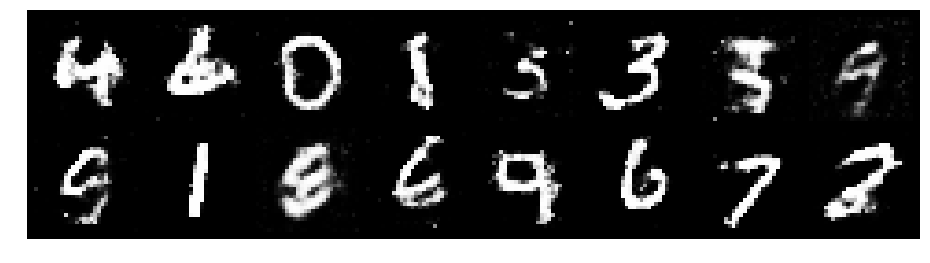

Epoch: [95/200], Batch Num: [500/600]
Discriminator Loss: 1.4584, Generator Loss: 0.8515
D(x): 0.4588, D(G(z)): 0.4194


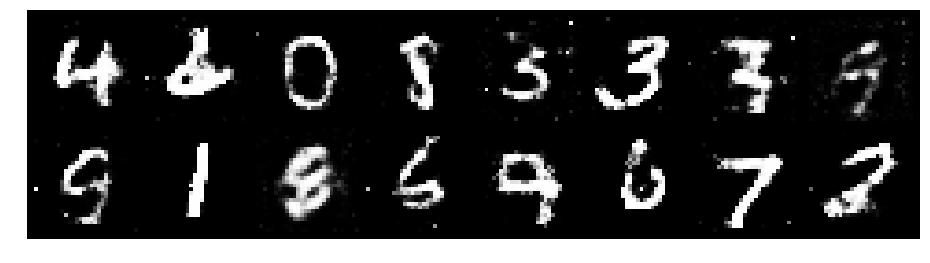

Epoch: [96/200], Batch Num: [0/600]
Discriminator Loss: 1.2970, Generator Loss: 0.7747
D(x): 0.5610, D(G(z)): 0.4488


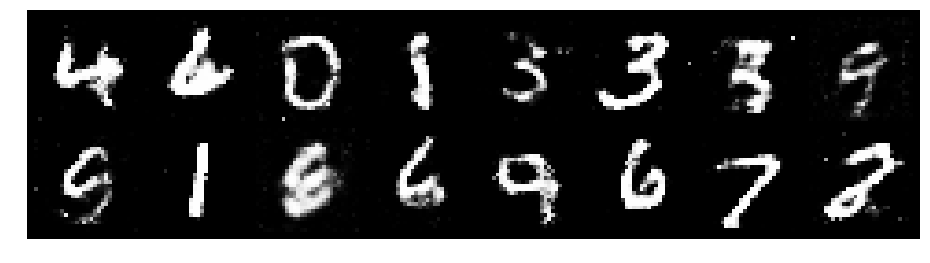

Epoch: [96/200], Batch Num: [100/600]
Discriminator Loss: 1.3214, Generator Loss: 1.0285
D(x): 0.5596, D(G(z)): 0.4301


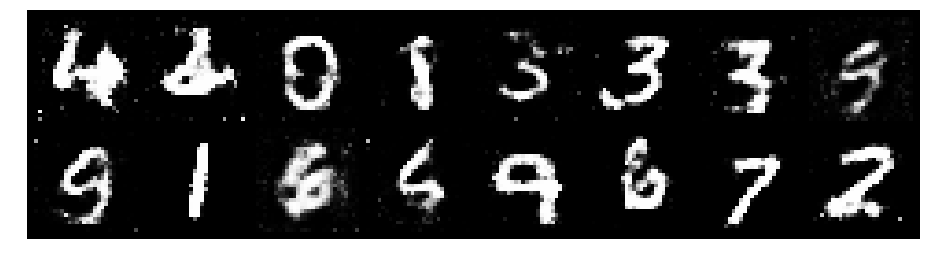

Epoch: [96/200], Batch Num: [200/600]
Discriminator Loss: 1.3419, Generator Loss: 0.8567
D(x): 0.5966, D(G(z)): 0.5107


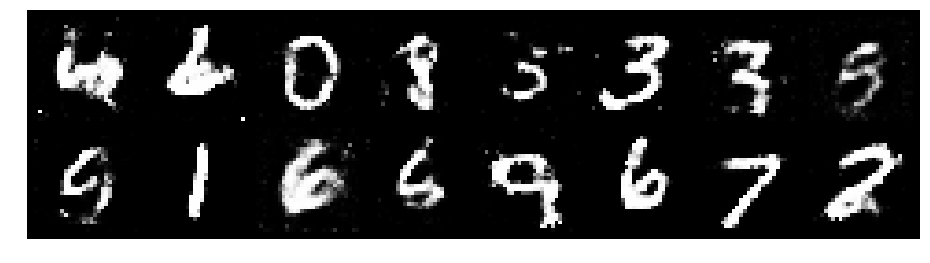

Epoch: [96/200], Batch Num: [300/600]
Discriminator Loss: 1.3227, Generator Loss: 0.8707
D(x): 0.5992, D(G(z)): 0.4895


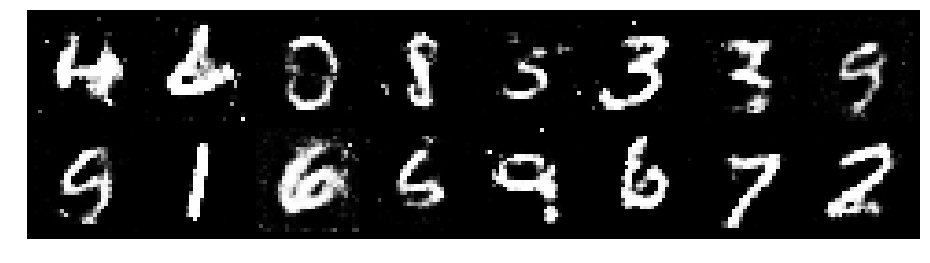

Epoch: [96/200], Batch Num: [400/600]
Discriminator Loss: 1.2539, Generator Loss: 1.1004
D(x): 0.5609, D(G(z)): 0.3923


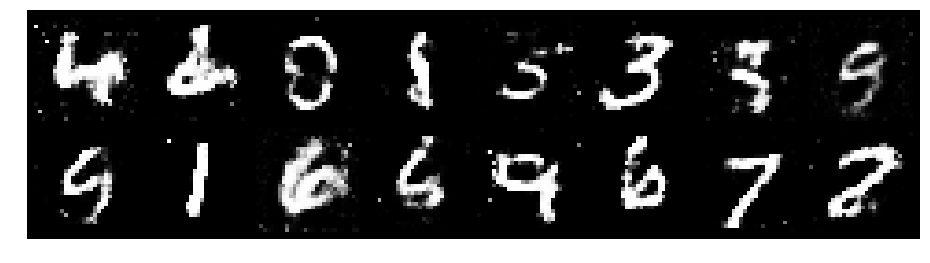

Epoch: [96/200], Batch Num: [500/600]
Discriminator Loss: 1.2580, Generator Loss: 1.1539
D(x): 0.5340, D(G(z)): 0.3956


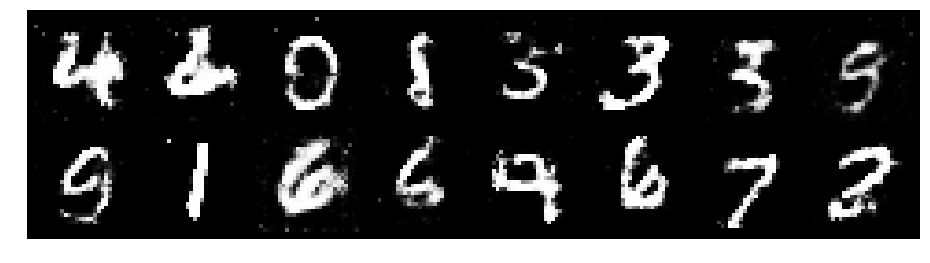

Epoch: [97/200], Batch Num: [0/600]
Discriminator Loss: 1.2683, Generator Loss: 0.7998
D(x): 0.5809, D(G(z)): 0.4564


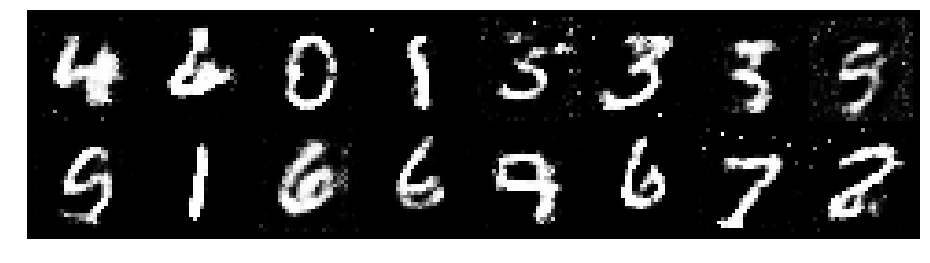

Epoch: [97/200], Batch Num: [100/600]
Discriminator Loss: 1.1531, Generator Loss: 0.8914
D(x): 0.5794, D(G(z)): 0.4098


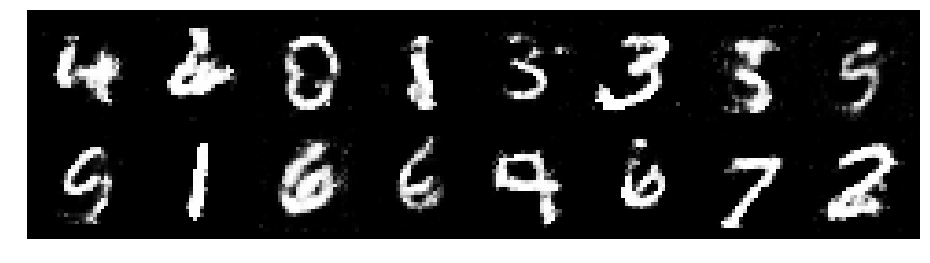

Epoch: [97/200], Batch Num: [200/600]
Discriminator Loss: 1.1914, Generator Loss: 0.9889
D(x): 0.6317, D(G(z)): 0.4554


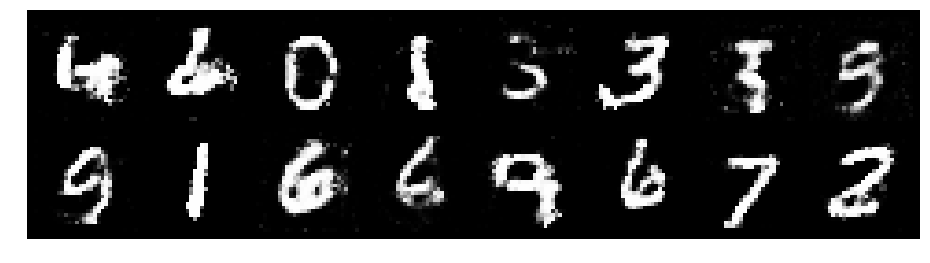

Epoch: [97/200], Batch Num: [300/600]
Discriminator Loss: 1.2617, Generator Loss: 0.9063
D(x): 0.5217, D(G(z)): 0.3997


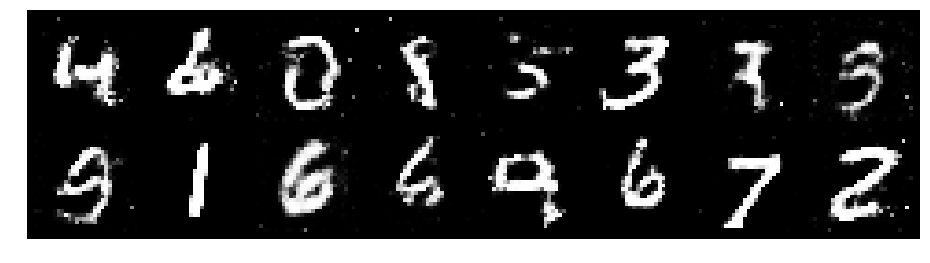

Epoch: [97/200], Batch Num: [400/600]
Discriminator Loss: 1.2916, Generator Loss: 0.7950
D(x): 0.5622, D(G(z)): 0.4647


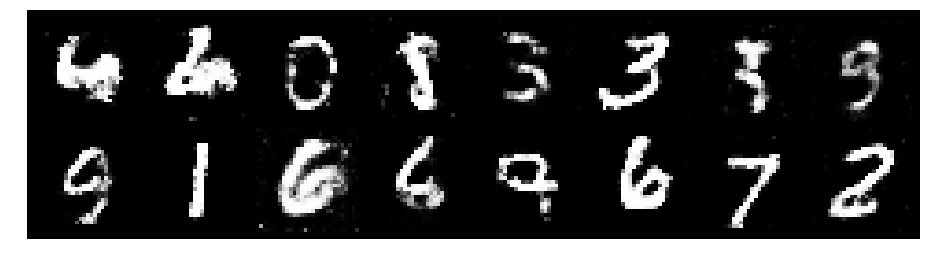

Epoch: [97/200], Batch Num: [500/600]
Discriminator Loss: 1.2368, Generator Loss: 0.9253
D(x): 0.5242, D(G(z)): 0.4004


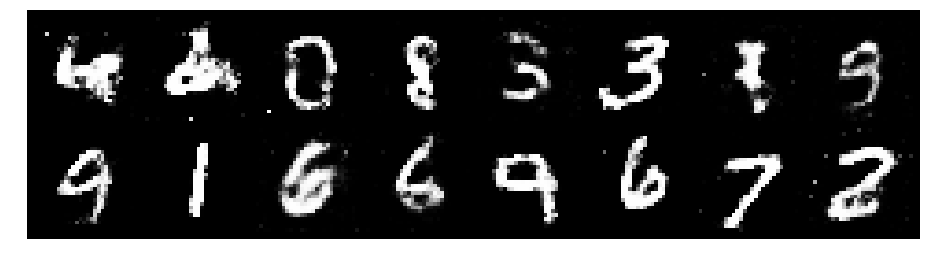

Epoch: [98/200], Batch Num: [0/600]
Discriminator Loss: 1.2961, Generator Loss: 1.0309
D(x): 0.5140, D(G(z)): 0.3971


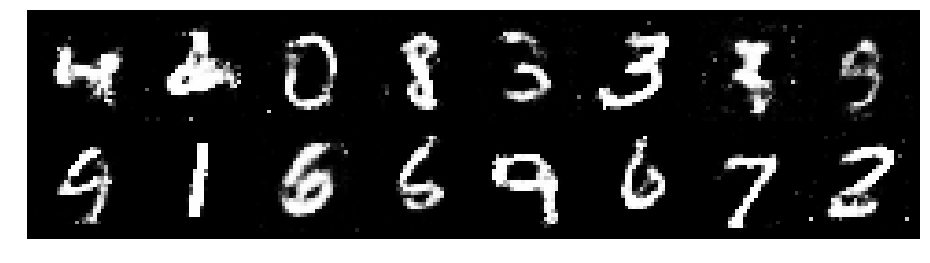

Epoch: [98/200], Batch Num: [100/600]
Discriminator Loss: 1.2621, Generator Loss: 1.0196
D(x): 0.5588, D(G(z)): 0.4293


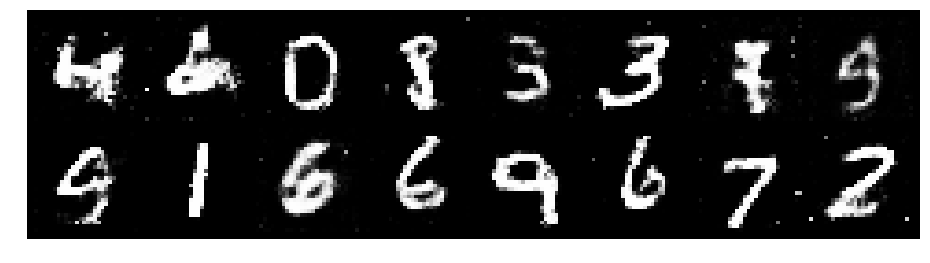

Epoch: [98/200], Batch Num: [200/600]
Discriminator Loss: 1.2464, Generator Loss: 0.9887
D(x): 0.5877, D(G(z)): 0.4322


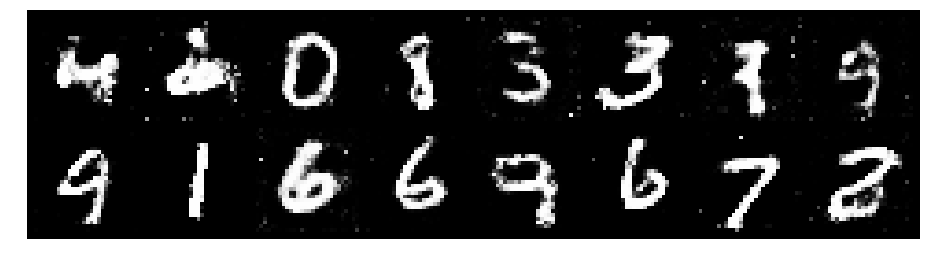

Epoch: [98/200], Batch Num: [300/600]
Discriminator Loss: 1.3620, Generator Loss: 0.7357
D(x): 0.5694, D(G(z)): 0.4894


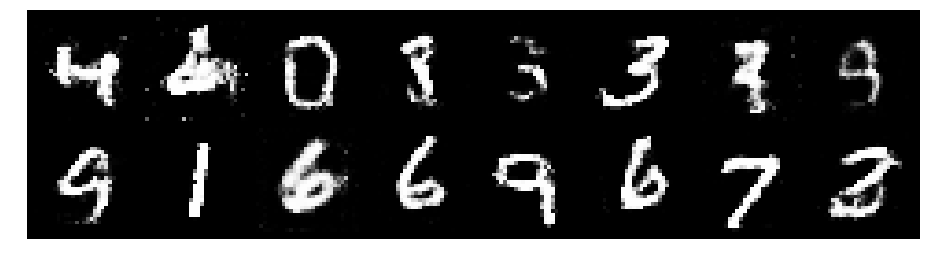

Epoch: [98/200], Batch Num: [400/600]
Discriminator Loss: 1.4662, Generator Loss: 0.8681
D(x): 0.5450, D(G(z)): 0.5027


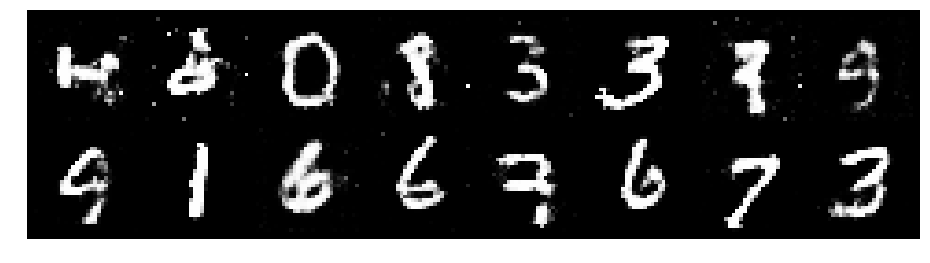

Epoch: [98/200], Batch Num: [500/600]
Discriminator Loss: 1.3168, Generator Loss: 0.9404
D(x): 0.5989, D(G(z)): 0.4881


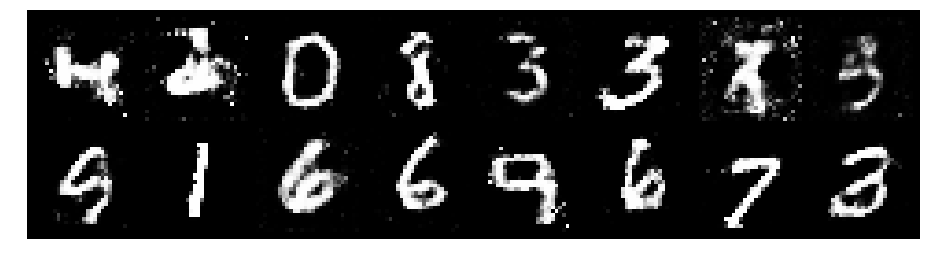

Epoch: [99/200], Batch Num: [0/600]
Discriminator Loss: 1.2456, Generator Loss: 0.9929
D(x): 0.5450, D(G(z)): 0.3934


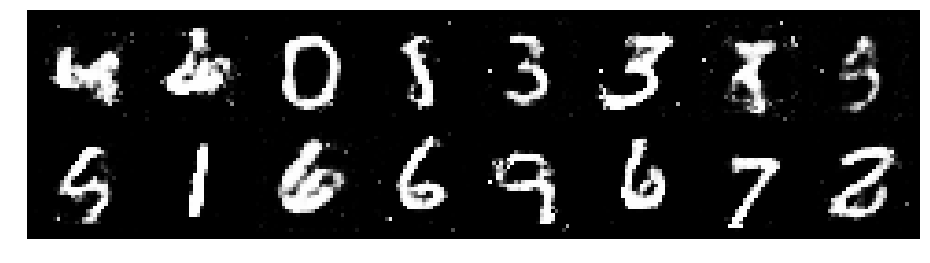

Epoch: [99/200], Batch Num: [100/600]
Discriminator Loss: 1.0676, Generator Loss: 0.8609
D(x): 0.6277, D(G(z)): 0.4061


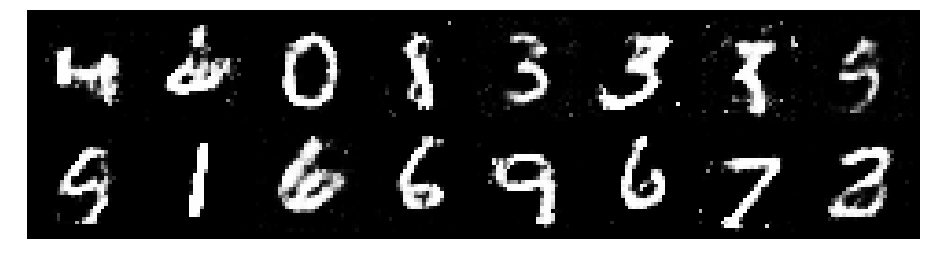

Epoch: [99/200], Batch Num: [200/600]
Discriminator Loss: 1.3301, Generator Loss: 0.8467
D(x): 0.5644, D(G(z)): 0.4668


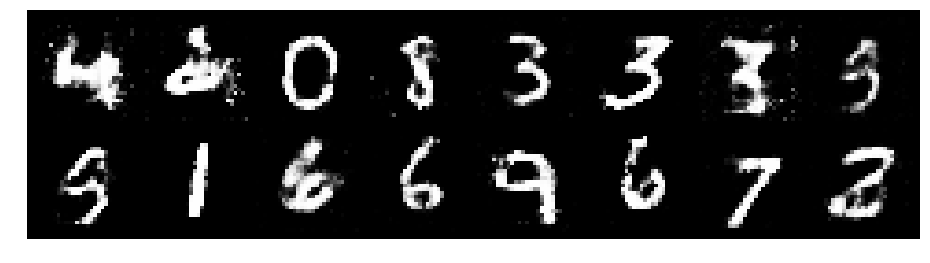

Epoch: [99/200], Batch Num: [300/600]
Discriminator Loss: 1.2124, Generator Loss: 0.8825
D(x): 0.5591, D(G(z)): 0.4154


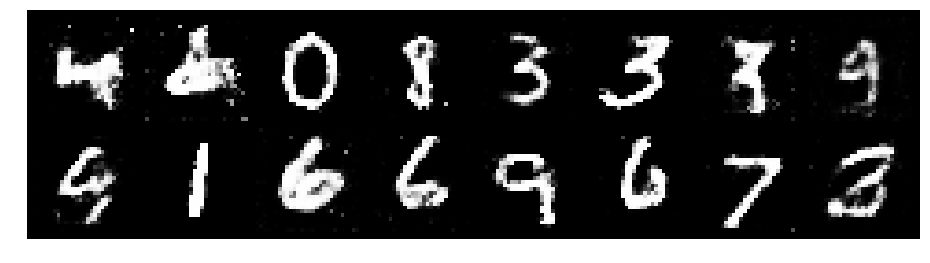

Epoch: [99/200], Batch Num: [400/600]
Discriminator Loss: 1.3979, Generator Loss: 0.8673
D(x): 0.5596, D(G(z)): 0.4775


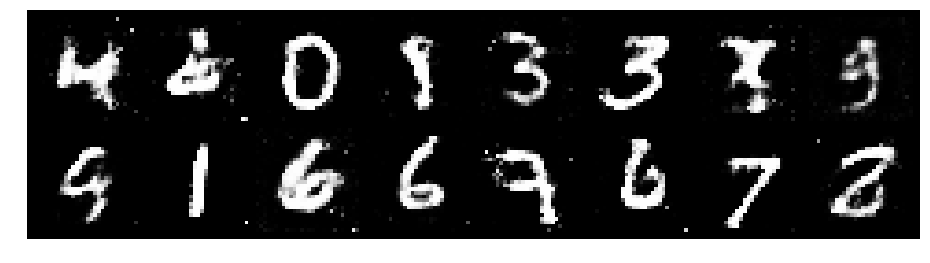

Epoch: [99/200], Batch Num: [500/600]
Discriminator Loss: 1.1156, Generator Loss: 1.0285
D(x): 0.6089, D(G(z)): 0.3899


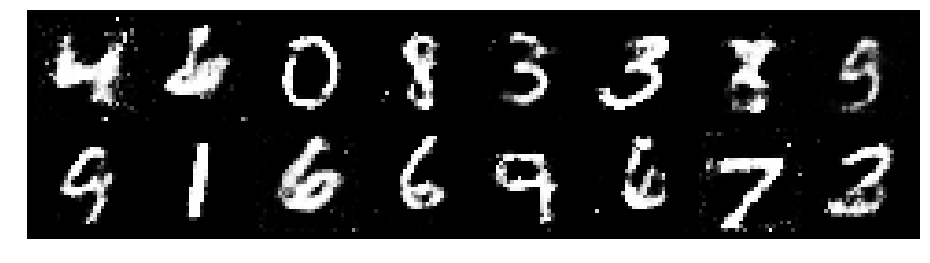

Epoch: [100/200], Batch Num: [0/600]
Discriminator Loss: 1.2334, Generator Loss: 0.9073
D(x): 0.5634, D(G(z)): 0.4327


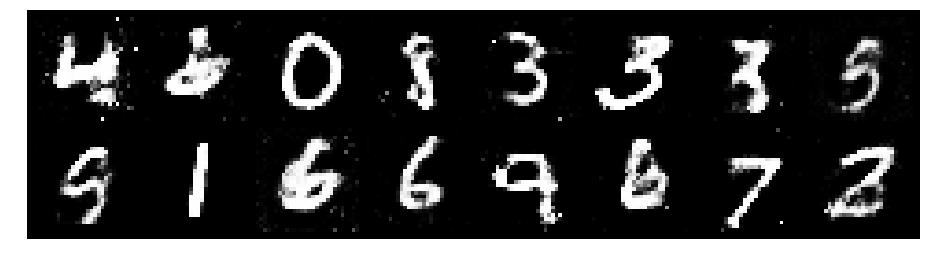

Epoch: [100/200], Batch Num: [100/600]
Discriminator Loss: 1.2856, Generator Loss: 0.8132
D(x): 0.5471, D(G(z)): 0.4520


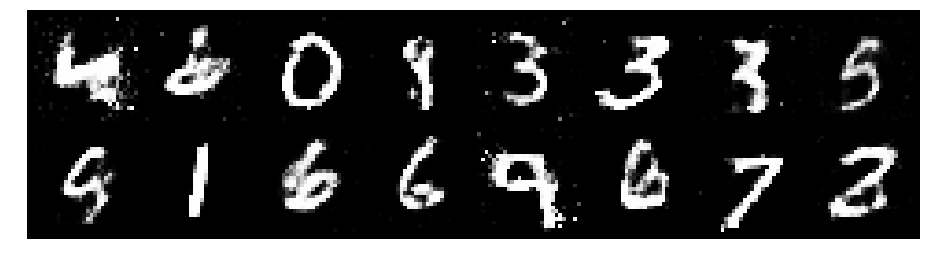

Epoch: [100/200], Batch Num: [200/600]
Discriminator Loss: 1.2897, Generator Loss: 0.8249
D(x): 0.5768, D(G(z)): 0.4847


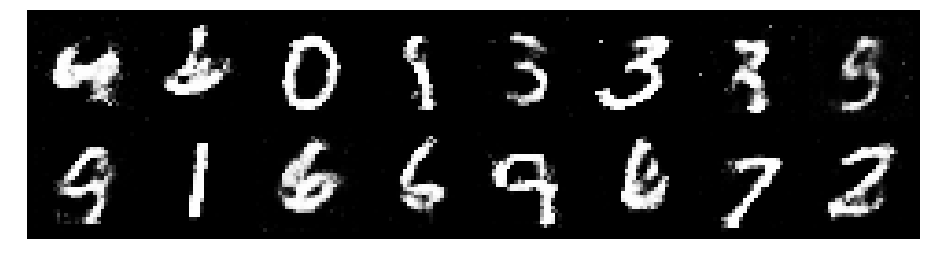

Epoch: [100/200], Batch Num: [300/600]
Discriminator Loss: 1.2130, Generator Loss: 1.0128
D(x): 0.5925, D(G(z)): 0.4391


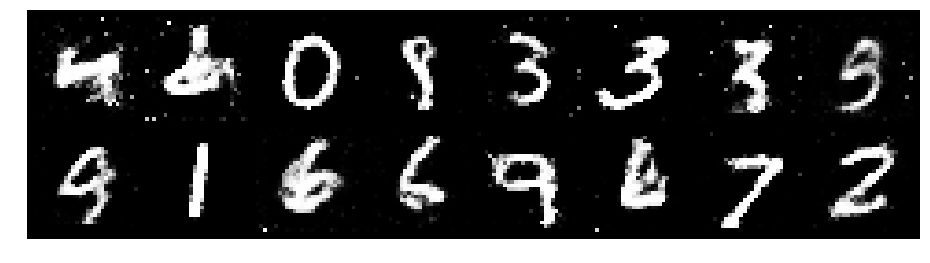

Epoch: [100/200], Batch Num: [400/600]
Discriminator Loss: 1.2188, Generator Loss: 1.0316
D(x): 0.5815, D(G(z)): 0.4251


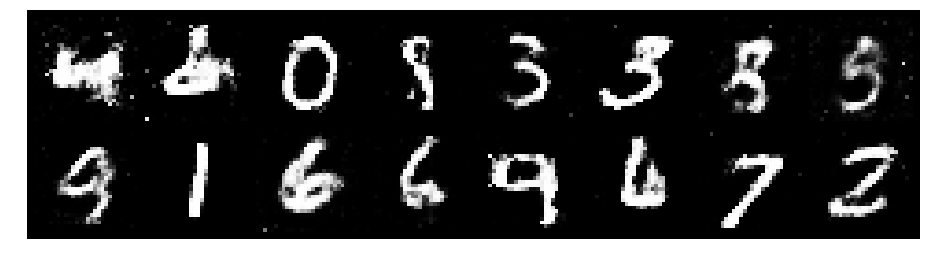

Epoch: [100/200], Batch Num: [500/600]
Discriminator Loss: 1.2228, Generator Loss: 1.0760
D(x): 0.5721, D(G(z)): 0.4181


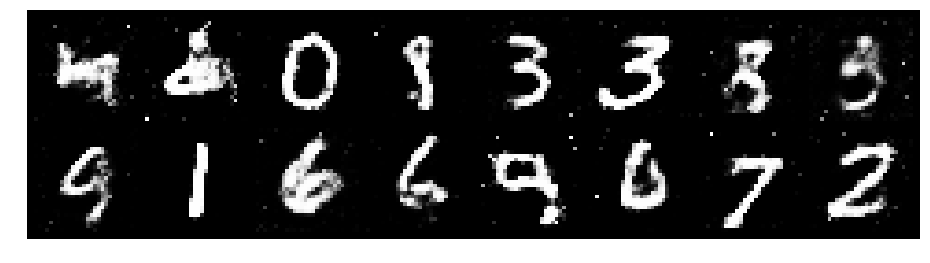

Epoch: [101/200], Batch Num: [0/600]
Discriminator Loss: 1.2233, Generator Loss: 0.8914
D(x): 0.6153, D(G(z)): 0.4651


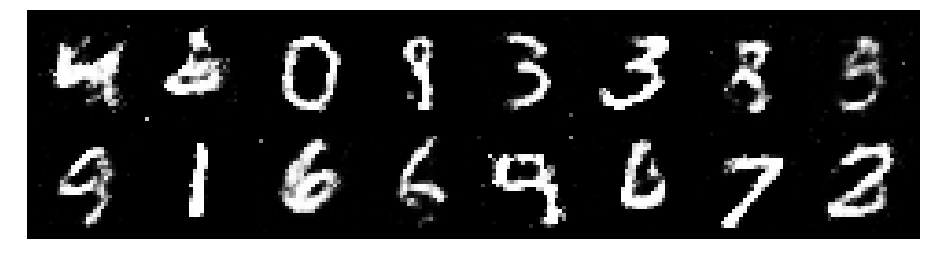

Epoch: [101/200], Batch Num: [100/600]
Discriminator Loss: 1.1792, Generator Loss: 1.0306
D(x): 0.5547, D(G(z)): 0.3864


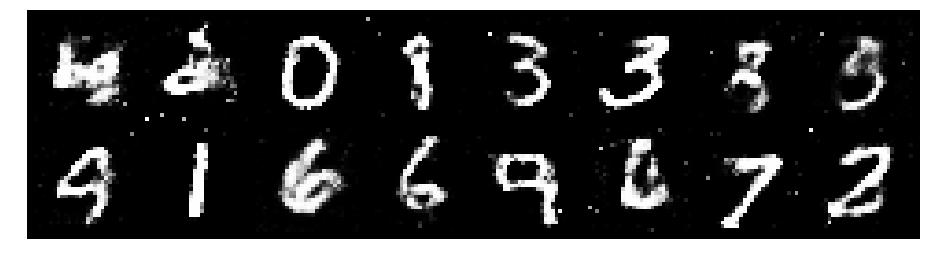

Epoch: [101/200], Batch Num: [200/600]
Discriminator Loss: 1.2331, Generator Loss: 0.8863
D(x): 0.5785, D(G(z)): 0.4545


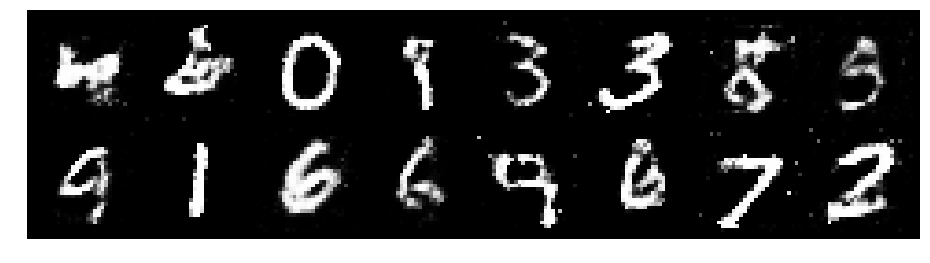

Epoch: [101/200], Batch Num: [300/600]
Discriminator Loss: 1.2555, Generator Loss: 0.8525
D(x): 0.5547, D(G(z)): 0.4437


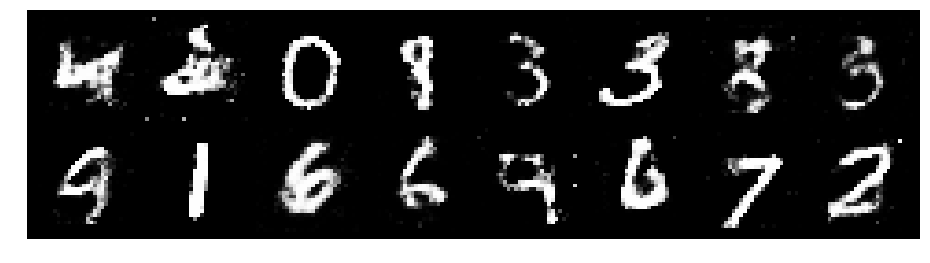

Epoch: [101/200], Batch Num: [400/600]
Discriminator Loss: 1.2968, Generator Loss: 0.9432
D(x): 0.5487, D(G(z)): 0.4395


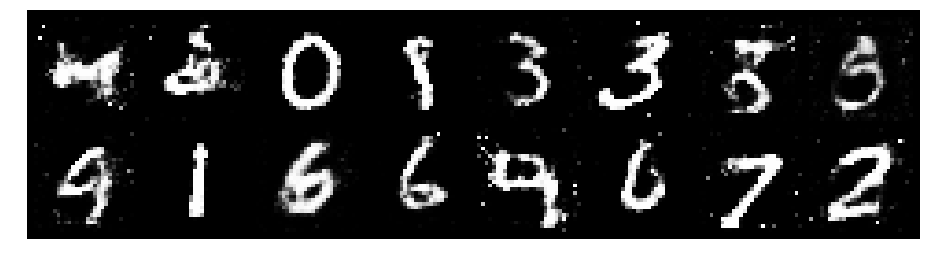

Epoch: [101/200], Batch Num: [500/600]
Discriminator Loss: 1.3122, Generator Loss: 1.0860
D(x): 0.5407, D(G(z)): 0.4211


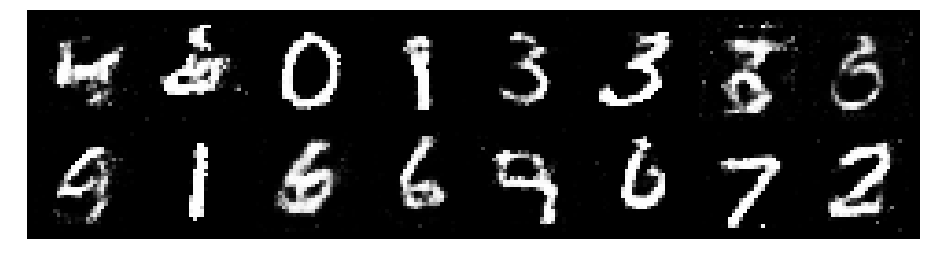

Epoch: [102/200], Batch Num: [0/600]
Discriminator Loss: 1.1932, Generator Loss: 1.0169
D(x): 0.5895, D(G(z)): 0.4335


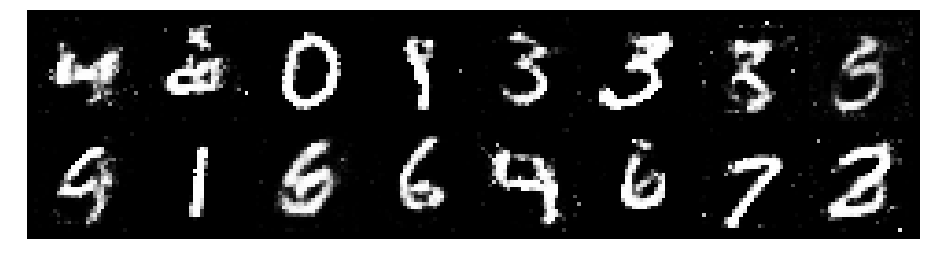

Epoch: [102/200], Batch Num: [100/600]
Discriminator Loss: 1.1849, Generator Loss: 1.0810
D(x): 0.5869, D(G(z)): 0.4179


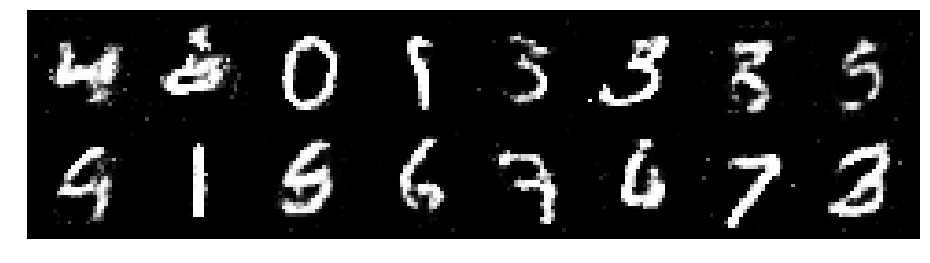

Epoch: [102/200], Batch Num: [200/600]
Discriminator Loss: 1.2349, Generator Loss: 0.9503
D(x): 0.5771, D(G(z)): 0.4522


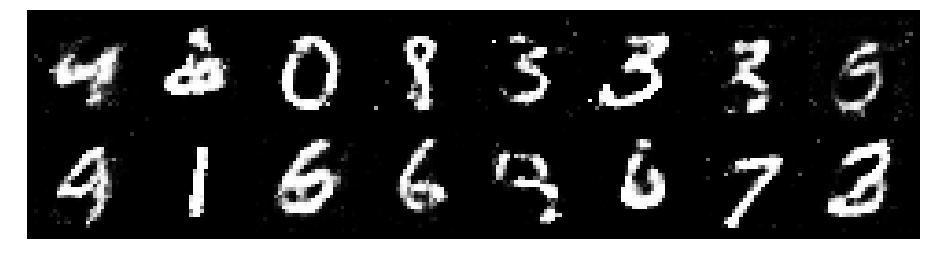

Epoch: [102/200], Batch Num: [300/600]
Discriminator Loss: 1.2636, Generator Loss: 0.8144
D(x): 0.5836, D(G(z)): 0.4449


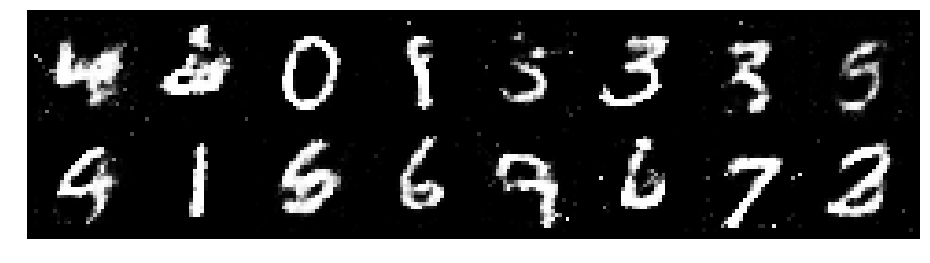

Epoch: [102/200], Batch Num: [400/600]
Discriminator Loss: 1.2946, Generator Loss: 0.9646
D(x): 0.5854, D(G(z)): 0.4572


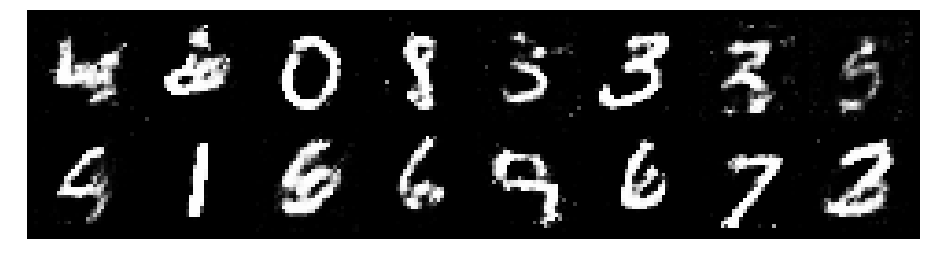

Epoch: [102/200], Batch Num: [500/600]
Discriminator Loss: 1.2743, Generator Loss: 0.9189
D(x): 0.5933, D(G(z)): 0.4398


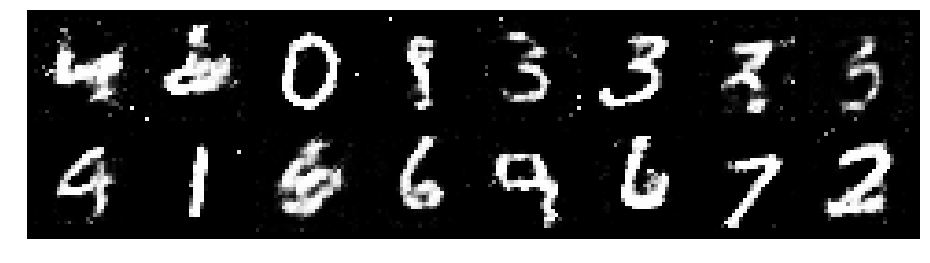

Epoch: [103/200], Batch Num: [0/600]
Discriminator Loss: 1.3631, Generator Loss: 1.0198
D(x): 0.5179, D(G(z)): 0.4440


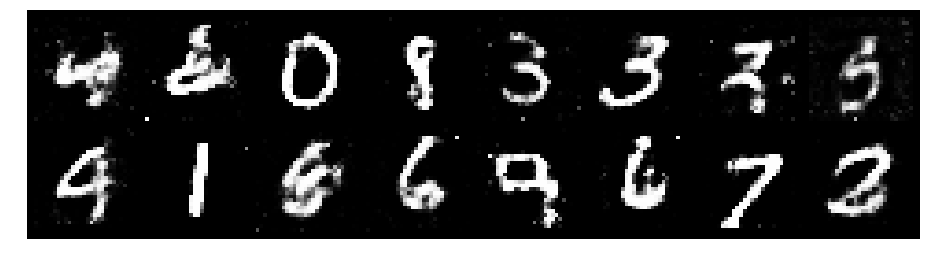

Epoch: [103/200], Batch Num: [100/600]
Discriminator Loss: 1.3606, Generator Loss: 0.9174
D(x): 0.5578, D(G(z)): 0.4753


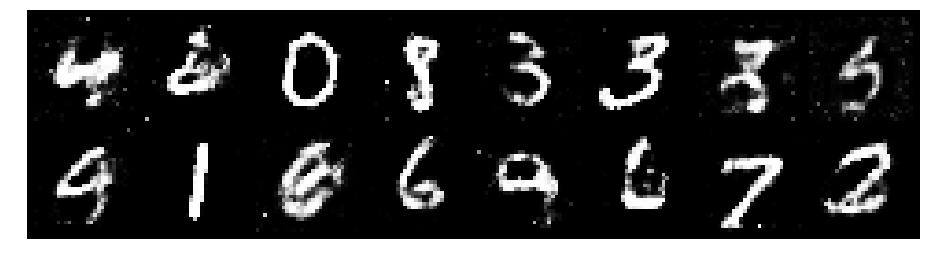

Epoch: [103/200], Batch Num: [200/600]
Discriminator Loss: 1.3484, Generator Loss: 0.8922
D(x): 0.5369, D(G(z)): 0.4224


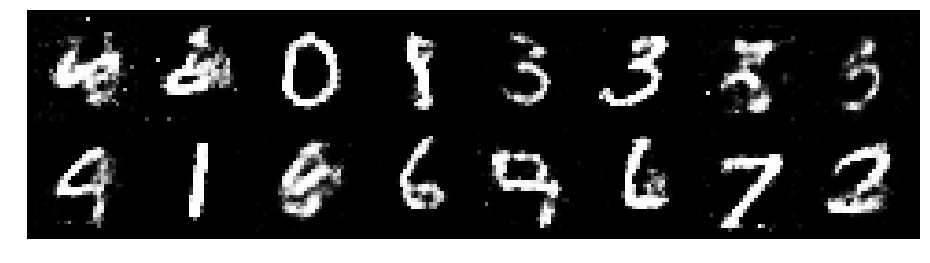

Epoch: [103/200], Batch Num: [300/600]
Discriminator Loss: 1.4051, Generator Loss: 0.8528
D(x): 0.5550, D(G(z)): 0.4988


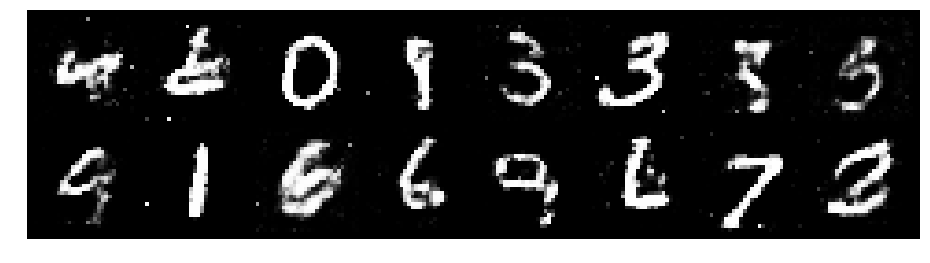

Epoch: [103/200], Batch Num: [400/600]
Discriminator Loss: 1.2021, Generator Loss: 0.8991
D(x): 0.5856, D(G(z)): 0.4444


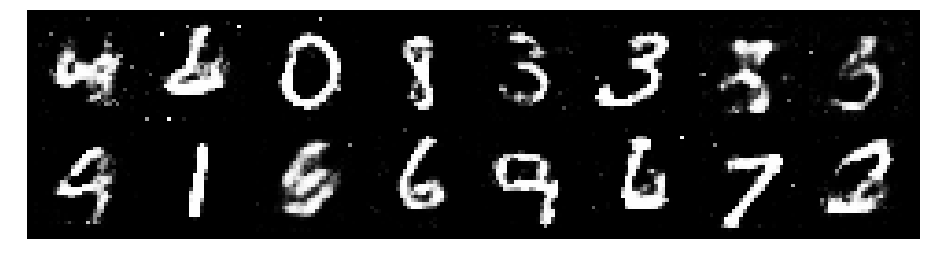

Epoch: [103/200], Batch Num: [500/600]
Discriminator Loss: 1.2856, Generator Loss: 0.9383
D(x): 0.5699, D(G(z)): 0.4439


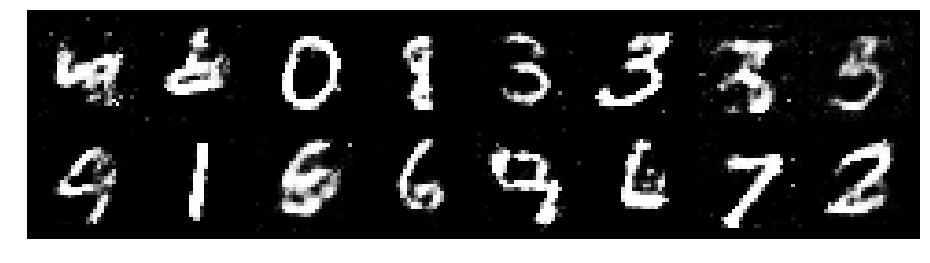

Epoch: [104/200], Batch Num: [0/600]
Discriminator Loss: 1.2156, Generator Loss: 0.9284
D(x): 0.5727, D(G(z)): 0.4043


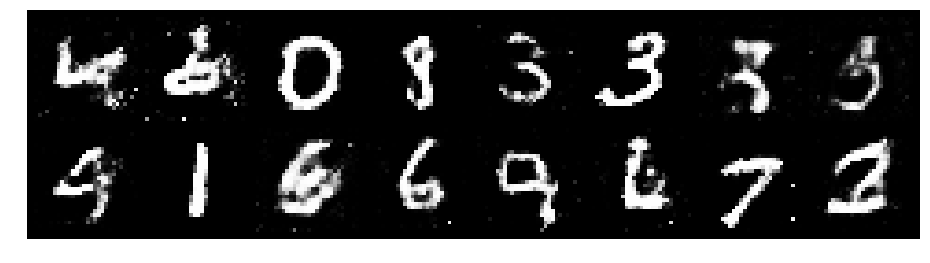

Epoch: [104/200], Batch Num: [100/600]
Discriminator Loss: 1.1709, Generator Loss: 1.1167
D(x): 0.5859, D(G(z)): 0.3944


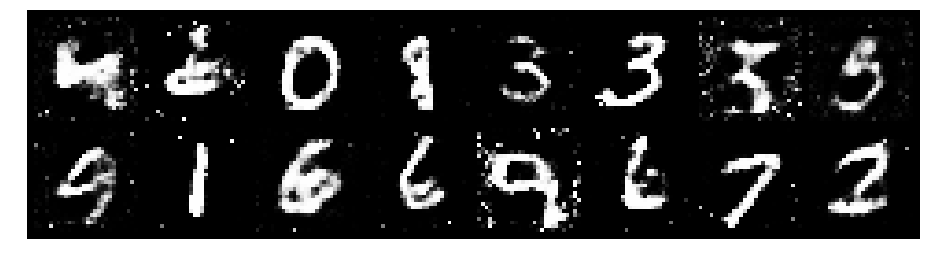

Epoch: [104/200], Batch Num: [200/600]
Discriminator Loss: 1.2144, Generator Loss: 0.9239
D(x): 0.5392, D(G(z)): 0.4037


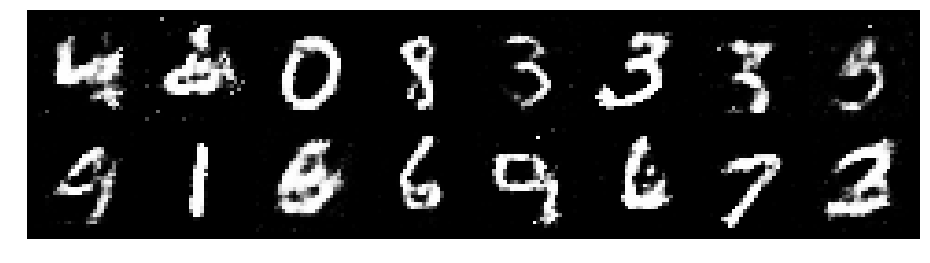

Epoch: [104/200], Batch Num: [300/600]
Discriminator Loss: 1.0982, Generator Loss: 0.8597
D(x): 0.6292, D(G(z)): 0.4096


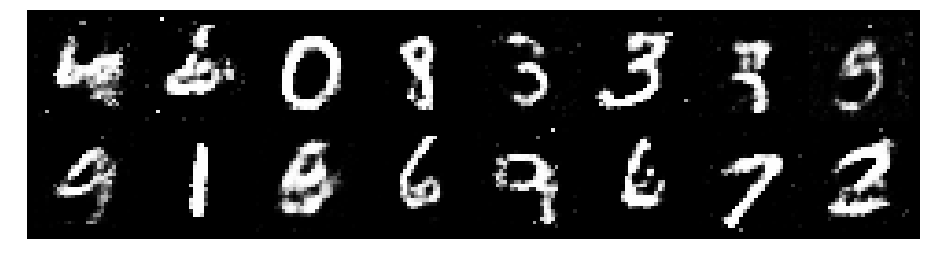

Epoch: [104/200], Batch Num: [400/600]
Discriminator Loss: 1.3839, Generator Loss: 1.0665
D(x): 0.5028, D(G(z)): 0.4281


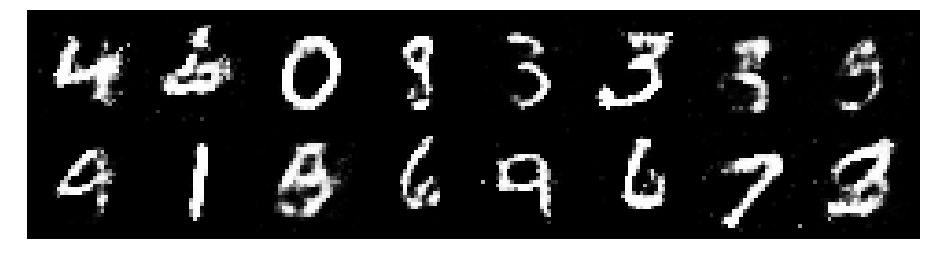

Epoch: [104/200], Batch Num: [500/600]
Discriminator Loss: 1.2947, Generator Loss: 0.8696
D(x): 0.5197, D(G(z)): 0.4224


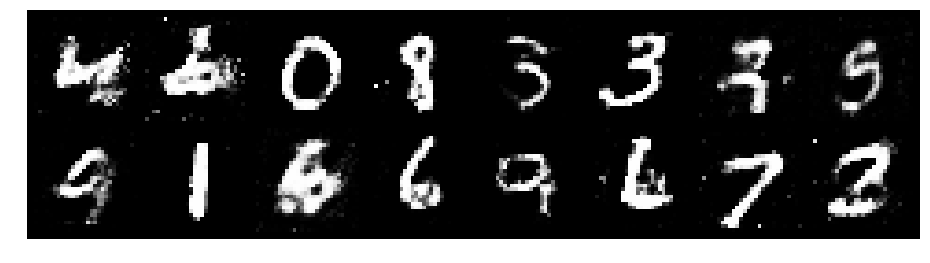

Epoch: [105/200], Batch Num: [0/600]
Discriminator Loss: 1.3241, Generator Loss: 0.8829
D(x): 0.5020, D(G(z)): 0.4276


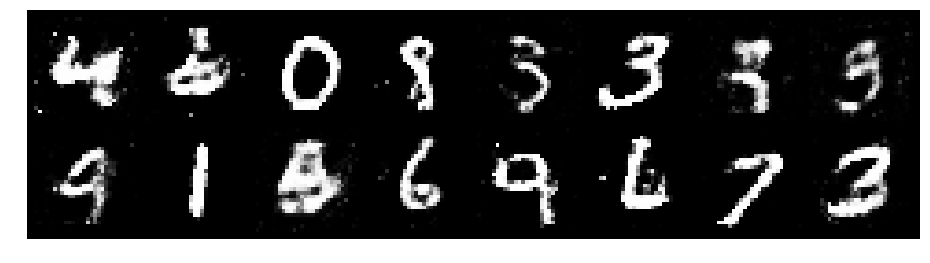

Epoch: [105/200], Batch Num: [100/600]
Discriminator Loss: 1.2707, Generator Loss: 0.8038
D(x): 0.6097, D(G(z)): 0.4903


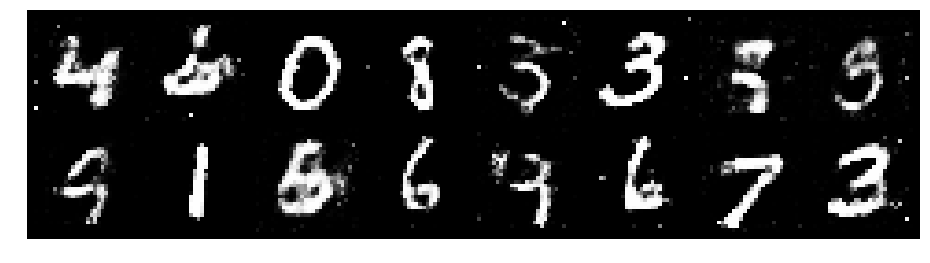

Epoch: [105/200], Batch Num: [200/600]
Discriminator Loss: 1.1730, Generator Loss: 0.9268
D(x): 0.5656, D(G(z)): 0.4090


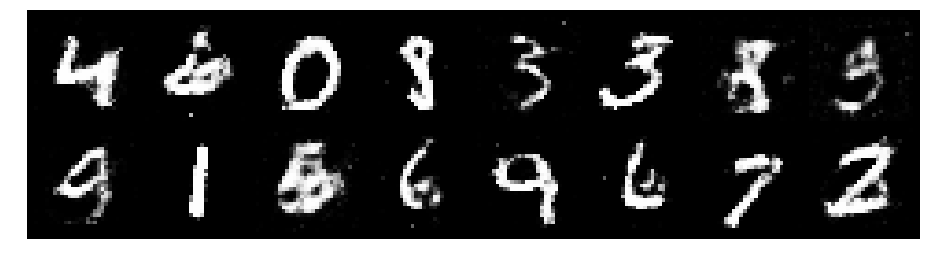

Epoch: [105/200], Batch Num: [300/600]
Discriminator Loss: 1.2744, Generator Loss: 0.9172
D(x): 0.5247, D(G(z)): 0.4228


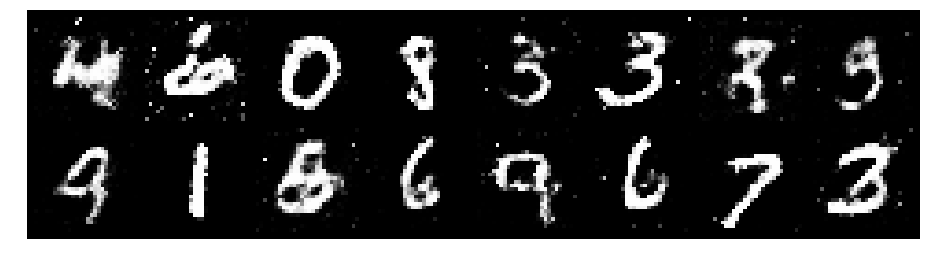

Epoch: [105/200], Batch Num: [400/600]
Discriminator Loss: 1.2392, Generator Loss: 0.8515
D(x): 0.5615, D(G(z)): 0.4435


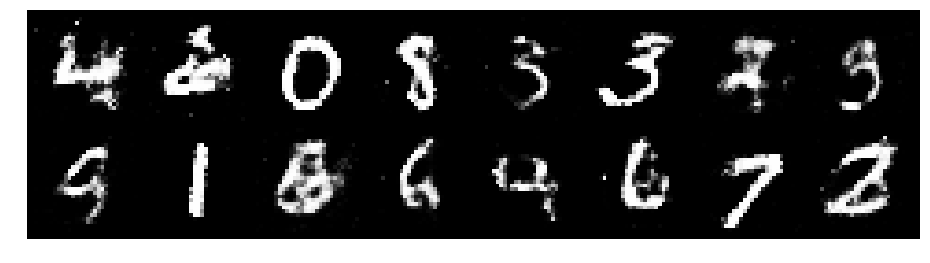

Epoch: [105/200], Batch Num: [500/600]
Discriminator Loss: 1.2521, Generator Loss: 0.8649
D(x): 0.5642, D(G(z)): 0.4690


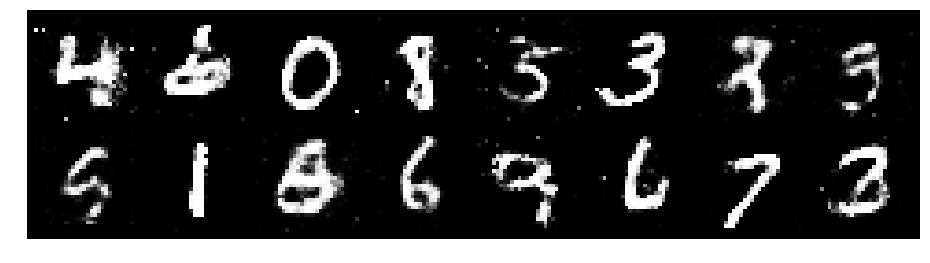

Epoch: [106/200], Batch Num: [0/600]
Discriminator Loss: 1.2276, Generator Loss: 1.0314
D(x): 0.5654, D(G(z)): 0.4003


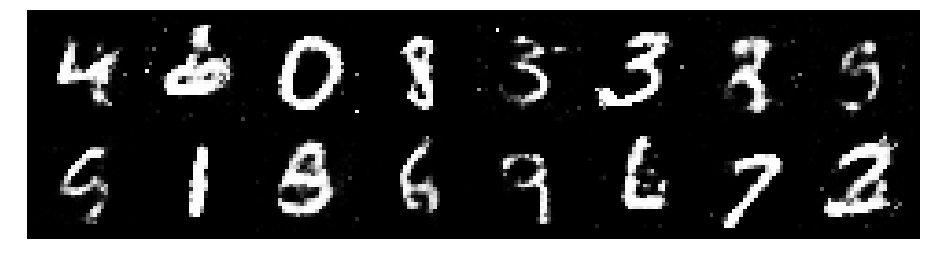

Epoch: [106/200], Batch Num: [100/600]
Discriminator Loss: 1.1826, Generator Loss: 1.1338
D(x): 0.5893, D(G(z)): 0.3979


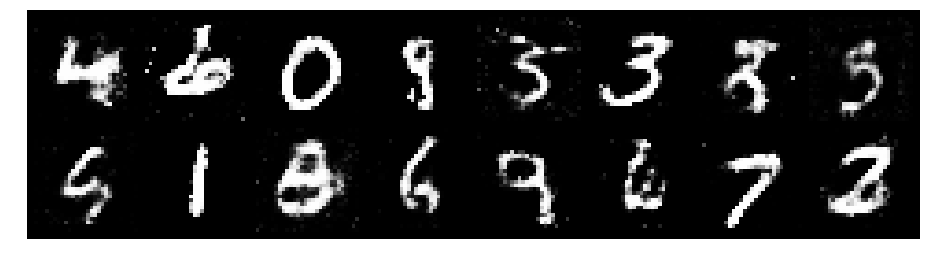

Epoch: [106/200], Batch Num: [200/600]
Discriminator Loss: 1.1979, Generator Loss: 0.9713
D(x): 0.5614, D(G(z)): 0.4101


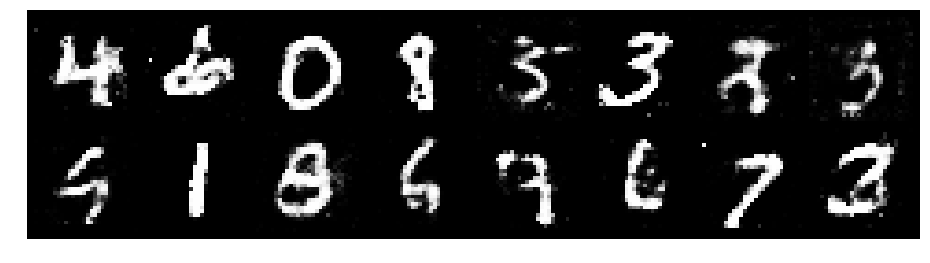

Epoch: [106/200], Batch Num: [300/600]
Discriminator Loss: 1.1104, Generator Loss: 1.0137
D(x): 0.6085, D(G(z)): 0.4032


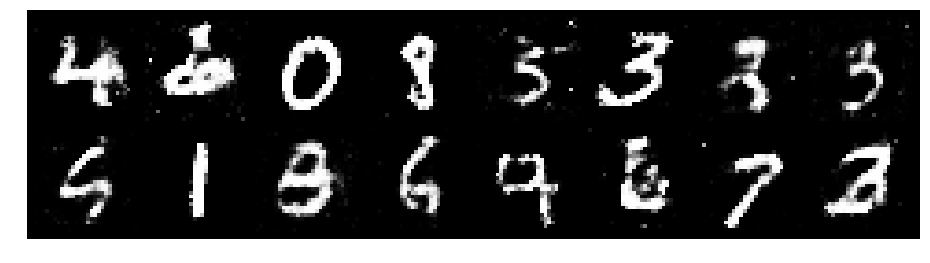

Epoch: [106/200], Batch Num: [400/600]
Discriminator Loss: 1.1268, Generator Loss: 1.0062
D(x): 0.5649, D(G(z)): 0.3910


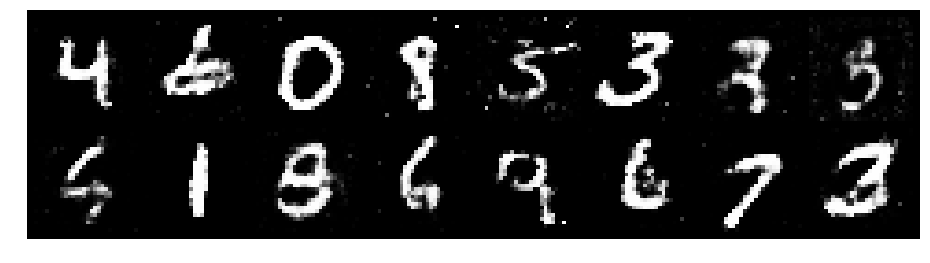

Epoch: [106/200], Batch Num: [500/600]
Discriminator Loss: 1.2154, Generator Loss: 0.9422
D(x): 0.5868, D(G(z)): 0.4452


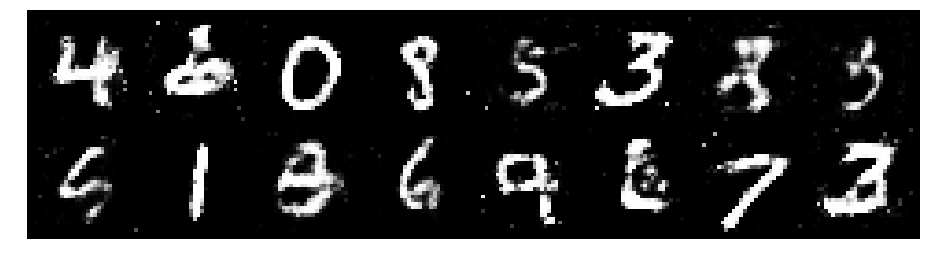

Epoch: [107/200], Batch Num: [0/600]
Discriminator Loss: 1.2954, Generator Loss: 0.8796
D(x): 0.5644, D(G(z)): 0.4603


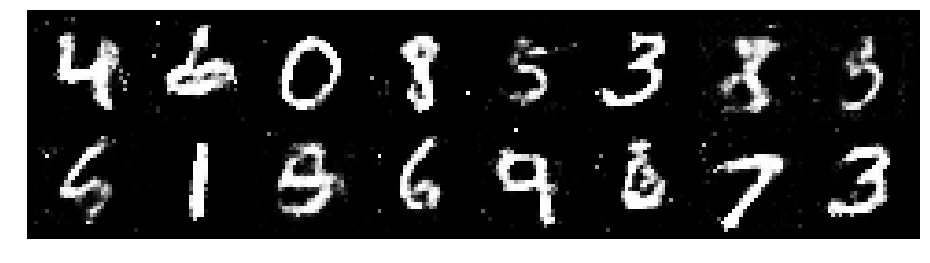

Epoch: [107/200], Batch Num: [100/600]
Discriminator Loss: 1.3643, Generator Loss: 1.0017
D(x): 0.5036, D(G(z)): 0.4069


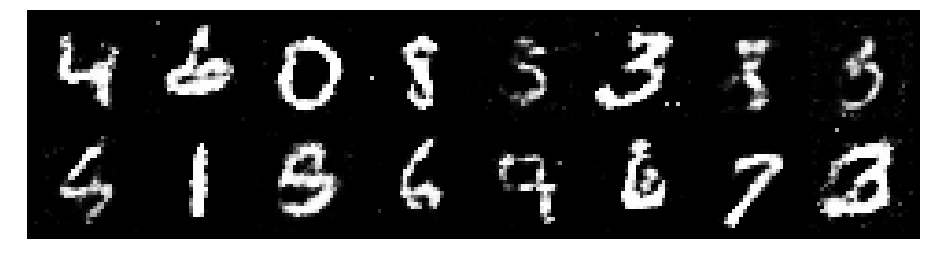

Epoch: [107/200], Batch Num: [200/600]
Discriminator Loss: 1.1544, Generator Loss: 0.9452
D(x): 0.5506, D(G(z)): 0.3702


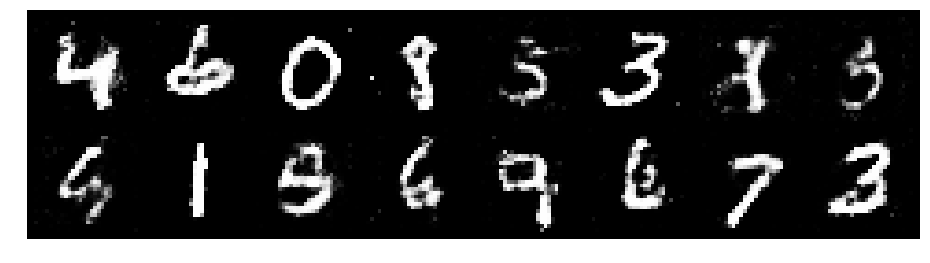

Epoch: [107/200], Batch Num: [300/600]
Discriminator Loss: 1.1016, Generator Loss: 0.9707
D(x): 0.5936, D(G(z)): 0.3933


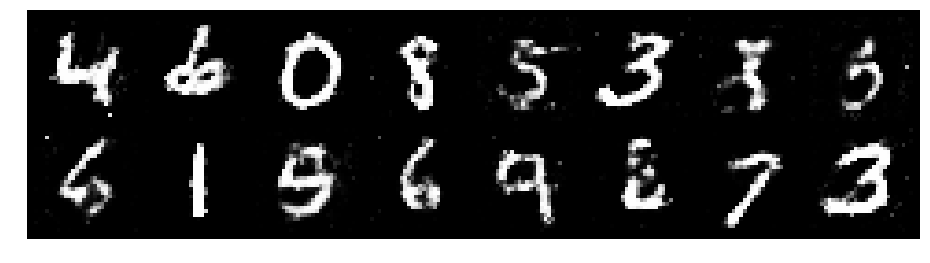

Epoch: [107/200], Batch Num: [400/600]
Discriminator Loss: 1.2102, Generator Loss: 0.8982
D(x): 0.5811, D(G(z)): 0.4342


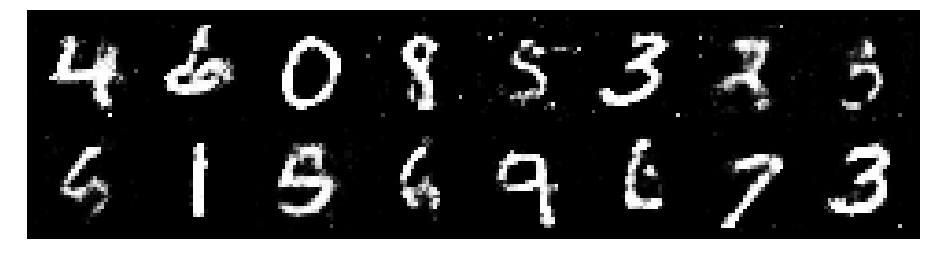

Epoch: [107/200], Batch Num: [500/600]
Discriminator Loss: 1.1422, Generator Loss: 1.1153
D(x): 0.6151, D(G(z)): 0.4175


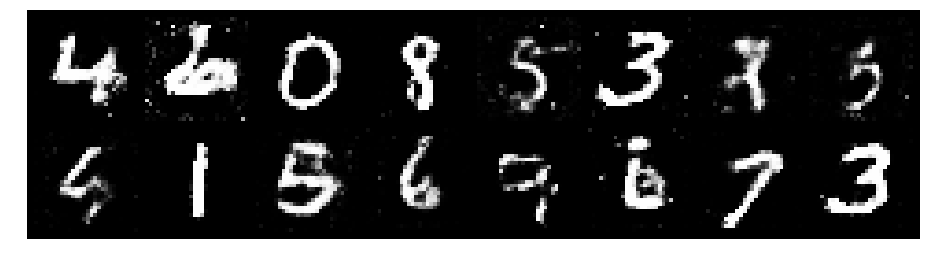

Epoch: [108/200], Batch Num: [0/600]
Discriminator Loss: 1.2238, Generator Loss: 1.0104
D(x): 0.5870, D(G(z)): 0.4209


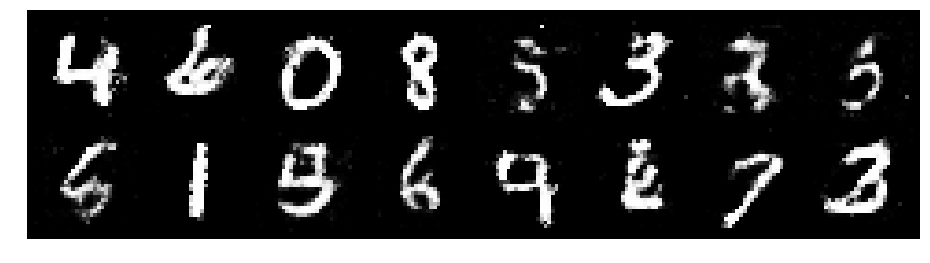

Epoch: [108/200], Batch Num: [100/600]
Discriminator Loss: 1.4011, Generator Loss: 0.7788
D(x): 0.5326, D(G(z)): 0.4976


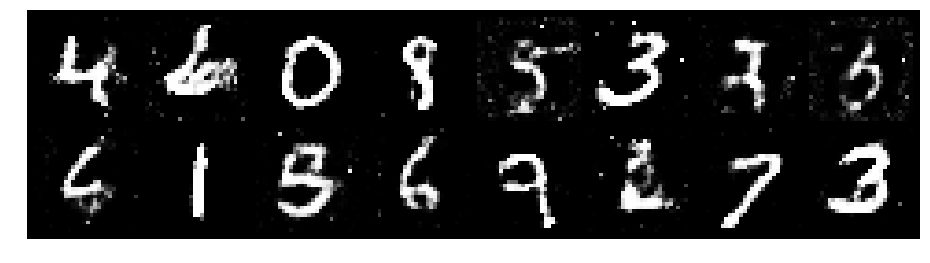

Epoch: [108/200], Batch Num: [200/600]
Discriminator Loss: 1.3296, Generator Loss: 0.9425
D(x): 0.5289, D(G(z)): 0.4385


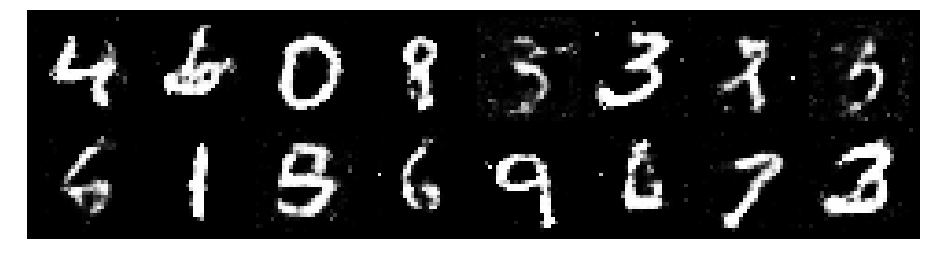

Epoch: [108/200], Batch Num: [300/600]
Discriminator Loss: 1.2908, Generator Loss: 0.8389
D(x): 0.5423, D(G(z)): 0.4429


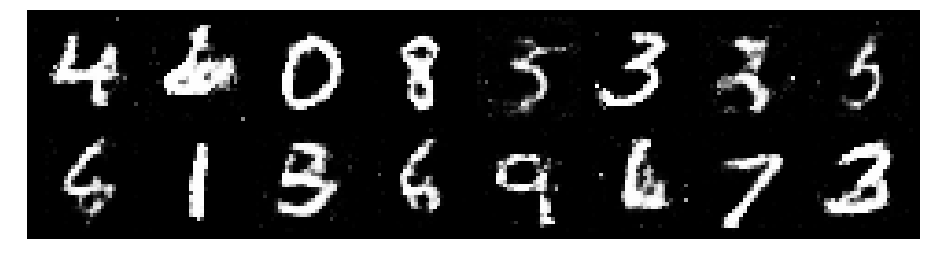

Epoch: [108/200], Batch Num: [400/600]
Discriminator Loss: 1.2809, Generator Loss: 0.8386
D(x): 0.5564, D(G(z)): 0.4332


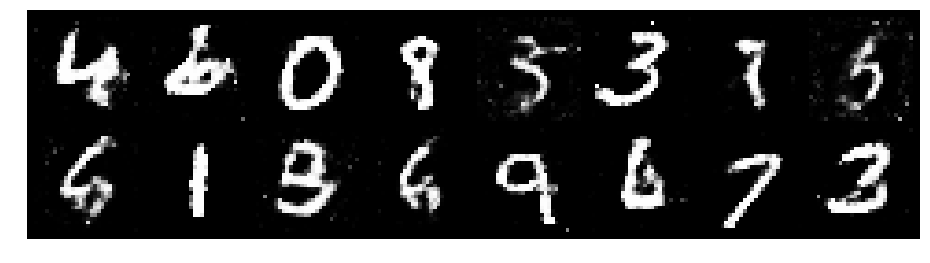

Epoch: [108/200], Batch Num: [500/600]
Discriminator Loss: 1.1300, Generator Loss: 1.0068
D(x): 0.5908, D(G(z)): 0.3780


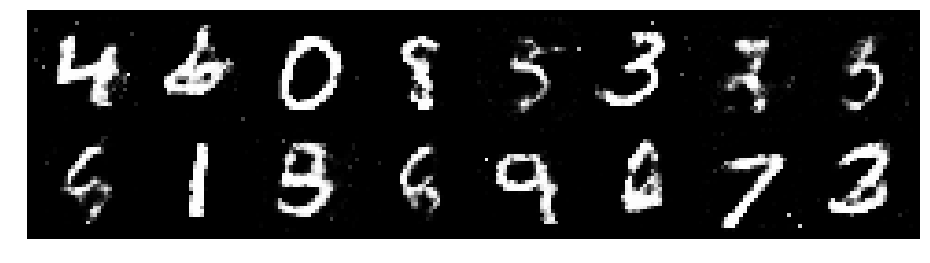

Epoch: [109/200], Batch Num: [0/600]
Discriminator Loss: 1.1857, Generator Loss: 0.8705
D(x): 0.5633, D(G(z)): 0.4241


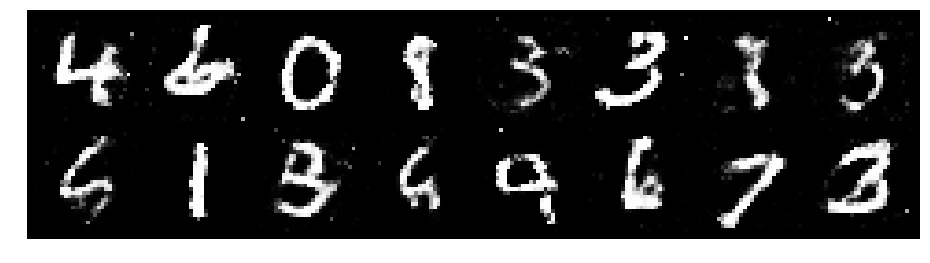

Epoch: [109/200], Batch Num: [100/600]
Discriminator Loss: 1.1249, Generator Loss: 1.0572
D(x): 0.6088, D(G(z)): 0.4050


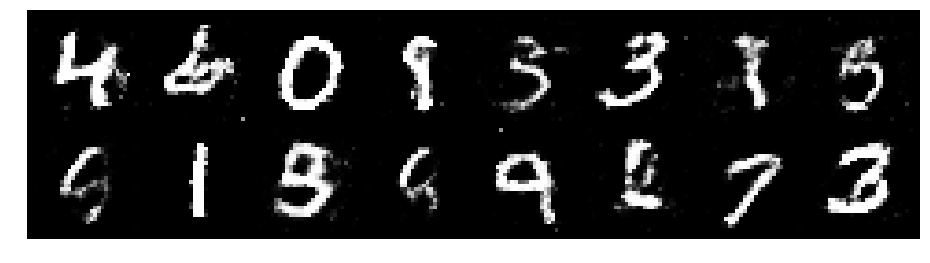

Epoch: [109/200], Batch Num: [200/600]
Discriminator Loss: 1.1803, Generator Loss: 0.9438
D(x): 0.6030, D(G(z)): 0.4488


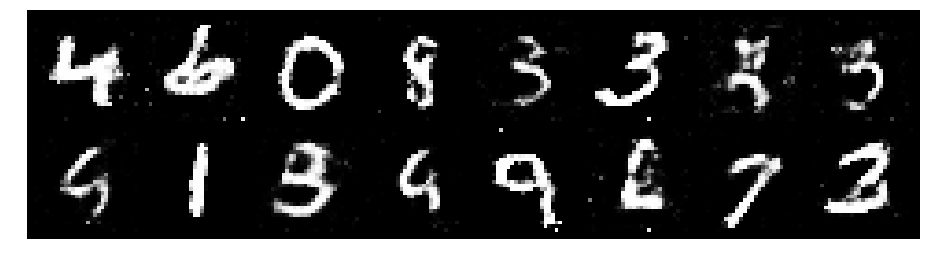

Epoch: [109/200], Batch Num: [300/600]
Discriminator Loss: 1.2473, Generator Loss: 1.0146
D(x): 0.5756, D(G(z)): 0.4407


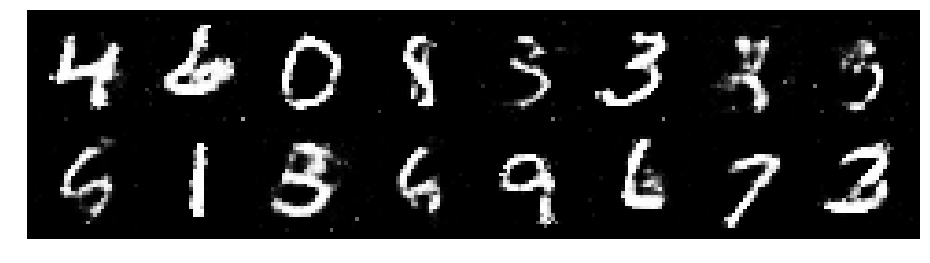

Epoch: [109/200], Batch Num: [400/600]
Discriminator Loss: 1.2640, Generator Loss: 0.9833
D(x): 0.5674, D(G(z)): 0.4427


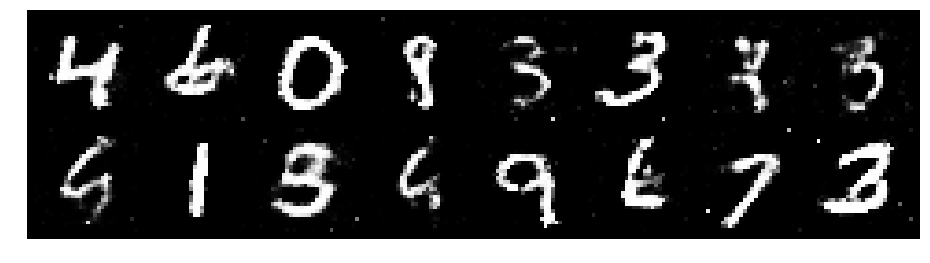

Epoch: [109/200], Batch Num: [500/600]
Discriminator Loss: 1.2907, Generator Loss: 0.8935
D(x): 0.5284, D(G(z)): 0.4249


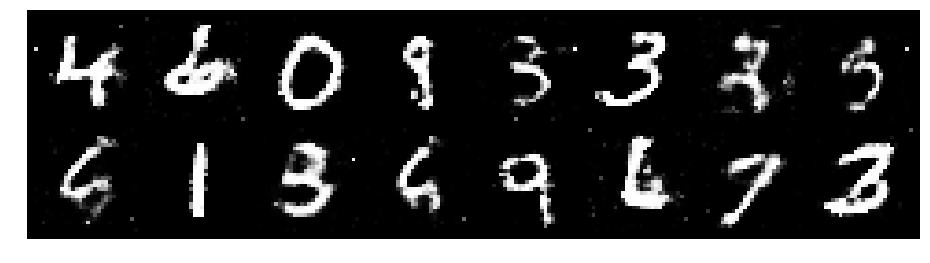

Epoch: [110/200], Batch Num: [0/600]
Discriminator Loss: 1.2523, Generator Loss: 1.0507
D(x): 0.5742, D(G(z)): 0.4209


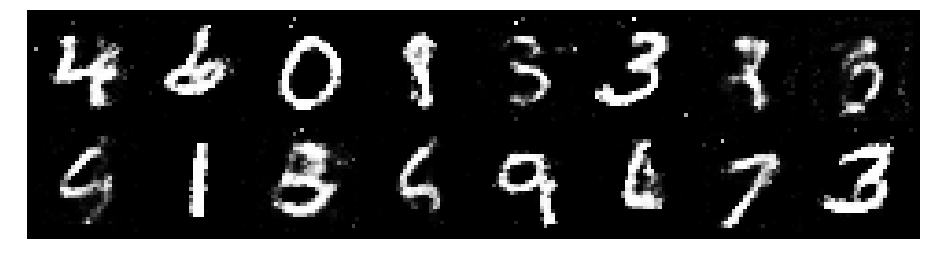

Epoch: [110/200], Batch Num: [100/600]
Discriminator Loss: 1.2770, Generator Loss: 0.8368
D(x): 0.5938, D(G(z)): 0.4600


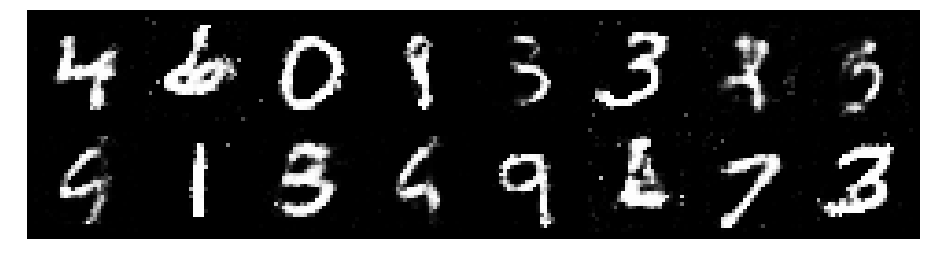

Epoch: [110/200], Batch Num: [200/600]
Discriminator Loss: 1.3227, Generator Loss: 0.9507
D(x): 0.5822, D(G(z)): 0.4714


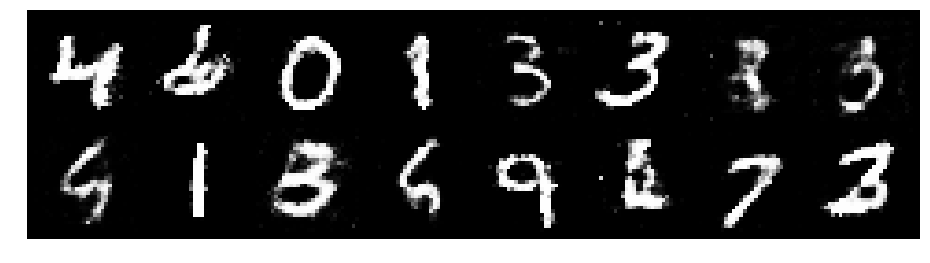

Epoch: [110/200], Batch Num: [300/600]
Discriminator Loss: 1.2824, Generator Loss: 1.0091
D(x): 0.5989, D(G(z)): 0.4704


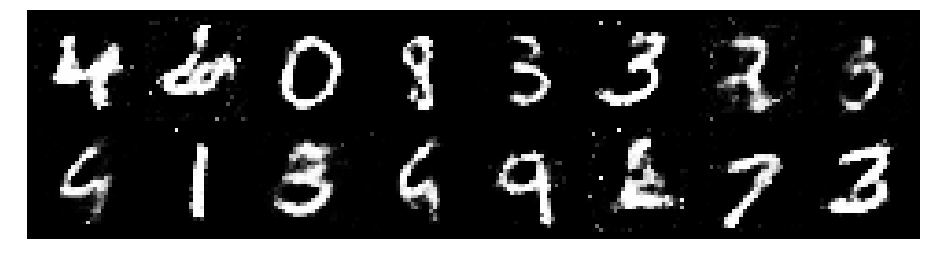

Epoch: [110/200], Batch Num: [400/600]
Discriminator Loss: 1.2606, Generator Loss: 0.8260
D(x): 0.5765, D(G(z)): 0.4659


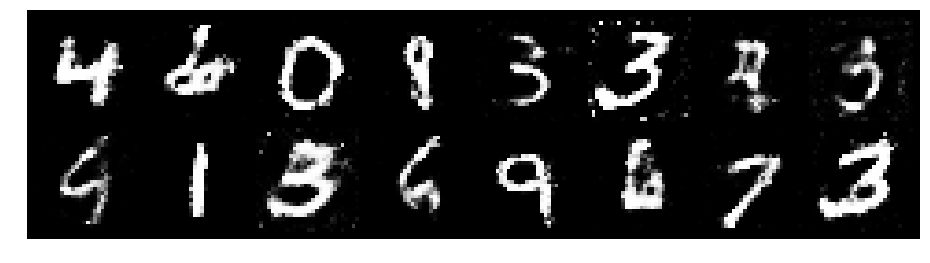

Epoch: [110/200], Batch Num: [500/600]
Discriminator Loss: 1.2201, Generator Loss: 0.9301
D(x): 0.6064, D(G(z)): 0.4306


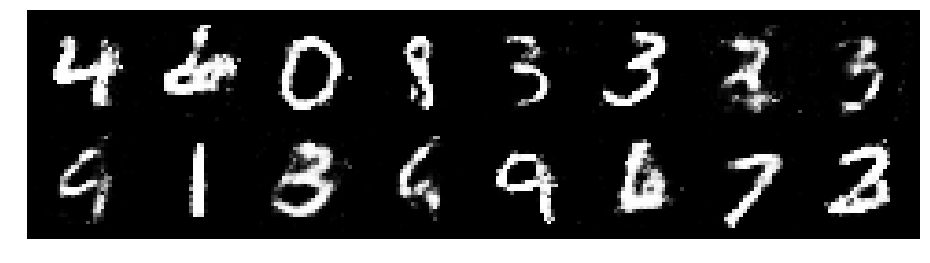

Epoch: [111/200], Batch Num: [0/600]
Discriminator Loss: 1.2726, Generator Loss: 0.8284
D(x): 0.5352, D(G(z)): 0.4253


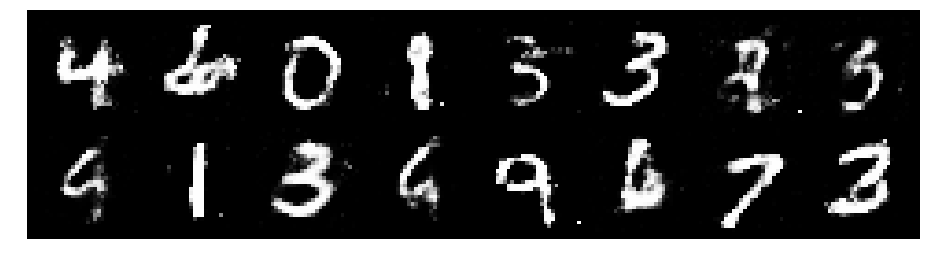

Epoch: [111/200], Batch Num: [100/600]
Discriminator Loss: 1.2714, Generator Loss: 0.8427
D(x): 0.5998, D(G(z)): 0.4601


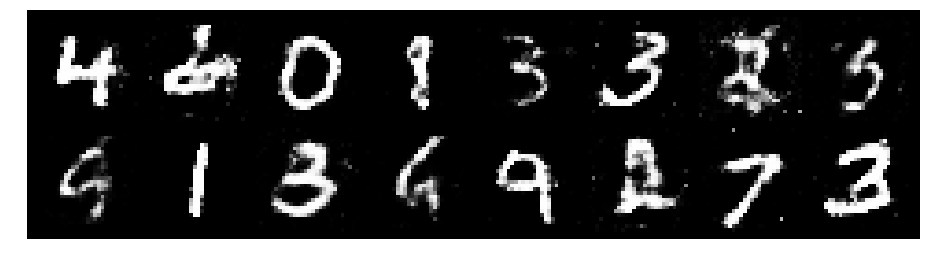

Epoch: [111/200], Batch Num: [200/600]
Discriminator Loss: 1.2659, Generator Loss: 0.9661
D(x): 0.5475, D(G(z)): 0.4145


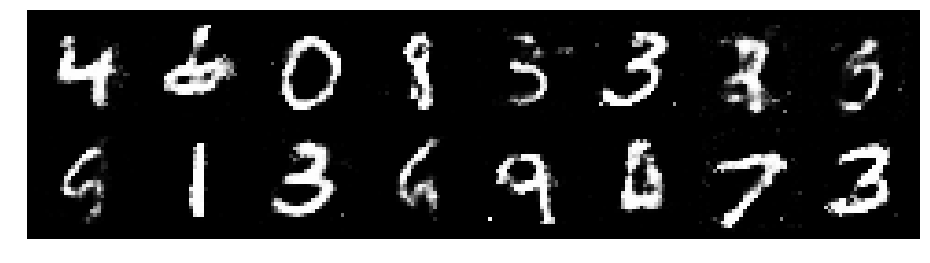

Epoch: [111/200], Batch Num: [300/600]
Discriminator Loss: 1.3228, Generator Loss: 0.8783
D(x): 0.6453, D(G(z)): 0.5088


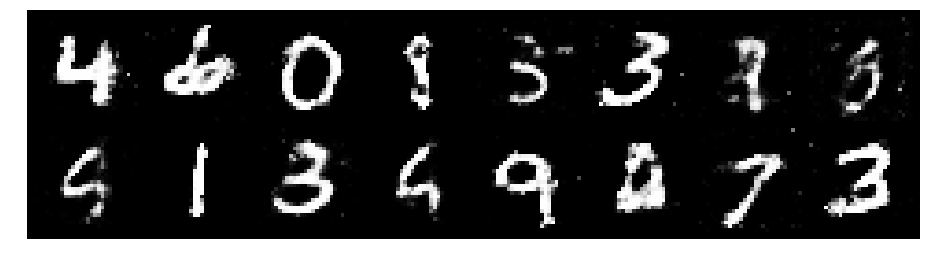

Epoch: [111/200], Batch Num: [400/600]
Discriminator Loss: 1.2828, Generator Loss: 0.8811
D(x): 0.5538, D(G(z)): 0.4521


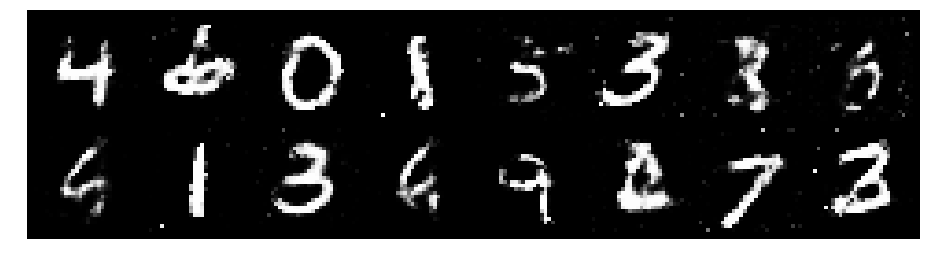

Epoch: [111/200], Batch Num: [500/600]
Discriminator Loss: 1.2796, Generator Loss: 0.8557
D(x): 0.5497, D(G(z)): 0.4500


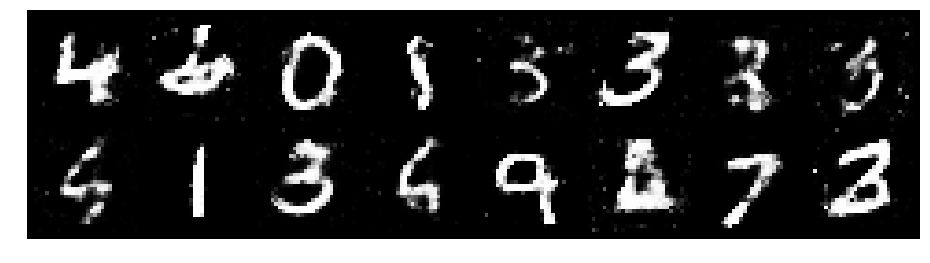

Epoch: [112/200], Batch Num: [0/600]
Discriminator Loss: 1.3485, Generator Loss: 0.8275
D(x): 0.5462, D(G(z)): 0.4810


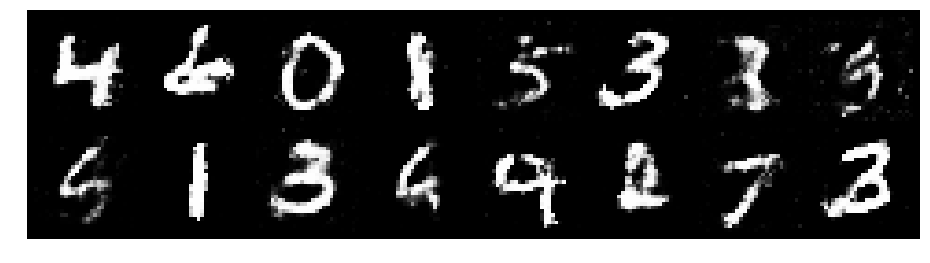

Epoch: [112/200], Batch Num: [100/600]
Discriminator Loss: 1.2341, Generator Loss: 0.8256
D(x): 0.5953, D(G(z)): 0.4768


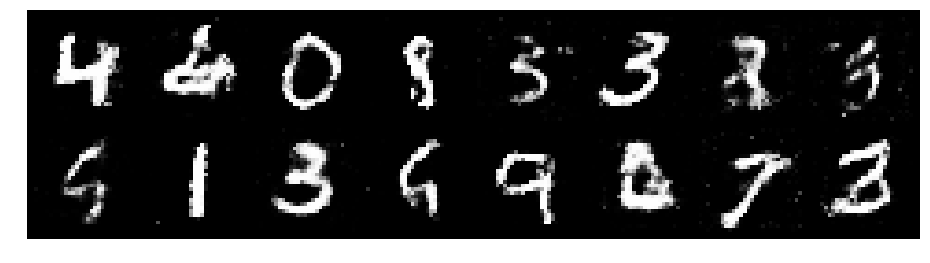

Epoch: [112/200], Batch Num: [200/600]
Discriminator Loss: 1.3807, Generator Loss: 0.8085
D(x): 0.5006, D(G(z)): 0.4694


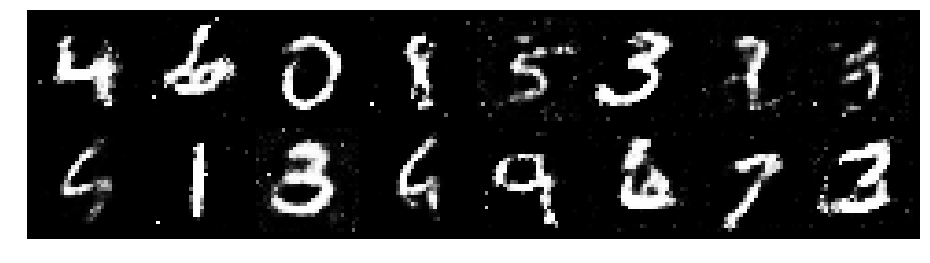

Epoch: [112/200], Batch Num: [300/600]
Discriminator Loss: 1.2372, Generator Loss: 0.8726
D(x): 0.5536, D(G(z)): 0.4299


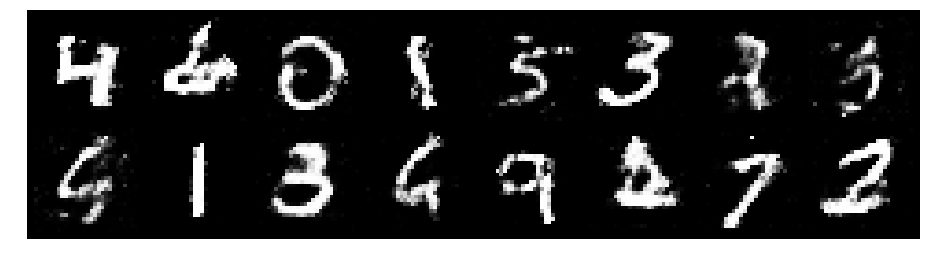

Epoch: [112/200], Batch Num: [400/600]
Discriminator Loss: 1.2960, Generator Loss: 0.8074
D(x): 0.5617, D(G(z)): 0.4646


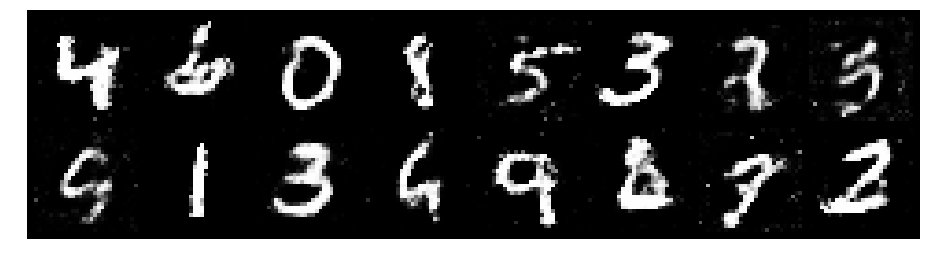

Epoch: [112/200], Batch Num: [500/600]
Discriminator Loss: 1.1273, Generator Loss: 0.9883
D(x): 0.6007, D(G(z)): 0.4101


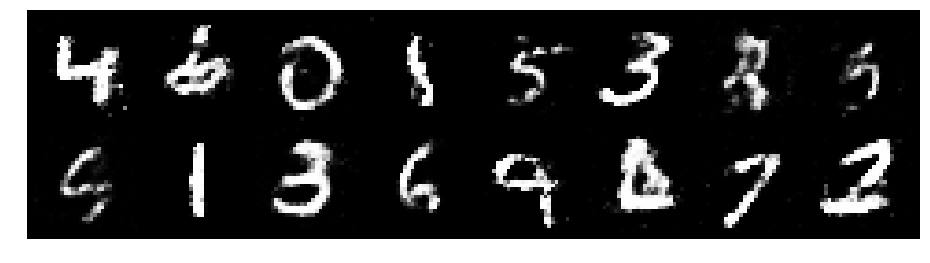

Epoch: [113/200], Batch Num: [0/600]
Discriminator Loss: 1.2627, Generator Loss: 0.9401
D(x): 0.5529, D(G(z)): 0.4382


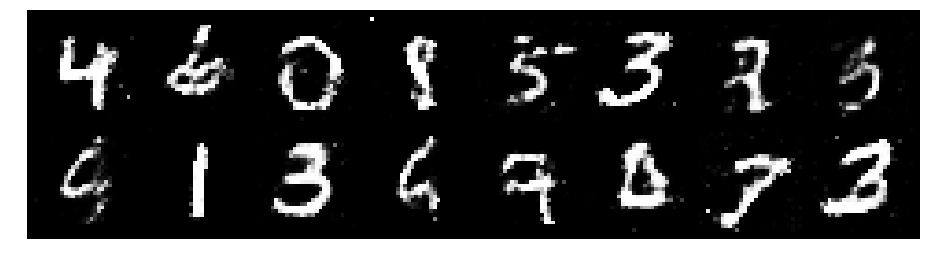

Epoch: [113/200], Batch Num: [100/600]
Discriminator Loss: 1.1951, Generator Loss: 0.9186
D(x): 0.5641, D(G(z)): 0.4291


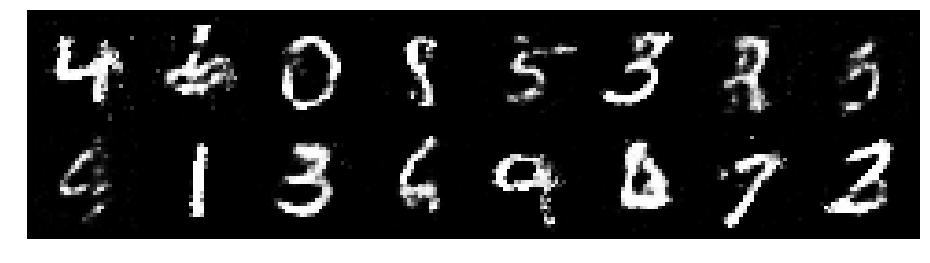

Epoch: [113/200], Batch Num: [200/600]
Discriminator Loss: 1.1587, Generator Loss: 1.0675
D(x): 0.5898, D(G(z)): 0.4133


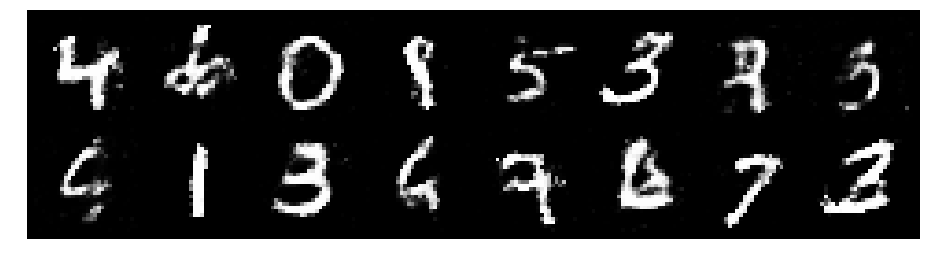

Epoch: [113/200], Batch Num: [300/600]
Discriminator Loss: 1.2953, Generator Loss: 0.9348
D(x): 0.5094, D(G(z)): 0.4242


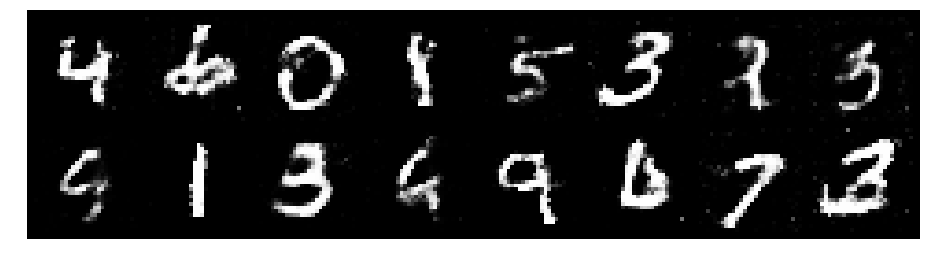

Epoch: [113/200], Batch Num: [400/600]
Discriminator Loss: 1.3043, Generator Loss: 0.9480
D(x): 0.5441, D(G(z)): 0.4491


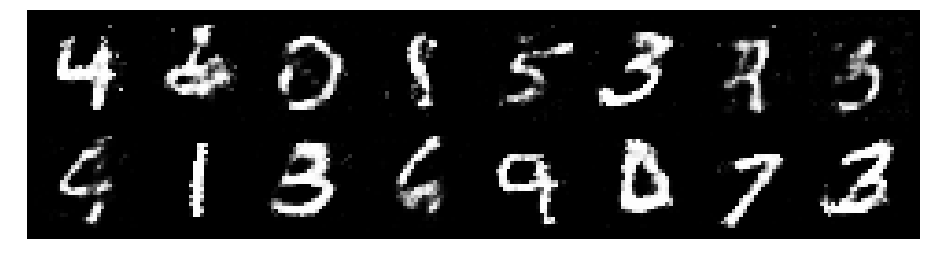

Epoch: [113/200], Batch Num: [500/600]
Discriminator Loss: 1.2693, Generator Loss: 0.8076
D(x): 0.5657, D(G(z)): 0.4663


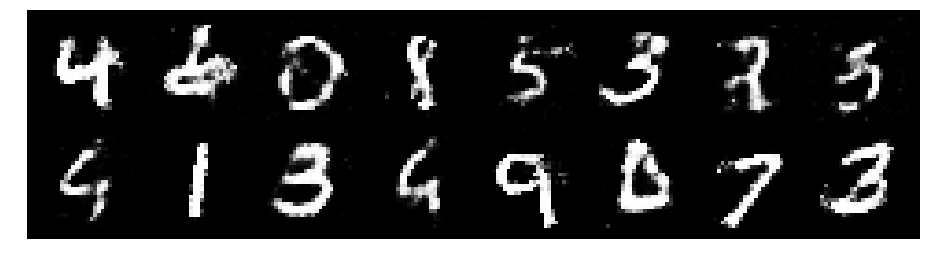

Epoch: [114/200], Batch Num: [0/600]
Discriminator Loss: 1.4053, Generator Loss: 0.8189
D(x): 0.5375, D(G(z)): 0.4651


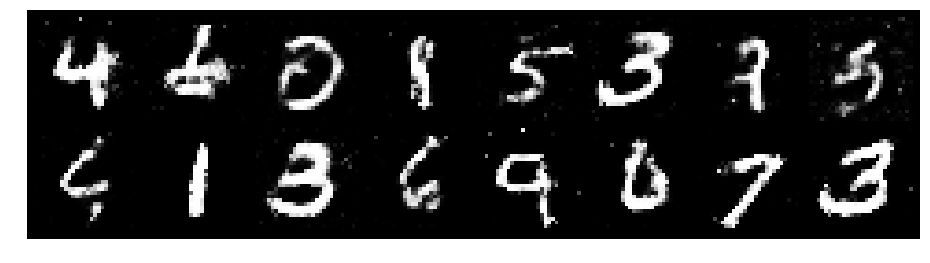

Epoch: [114/200], Batch Num: [100/600]
Discriminator Loss: 1.2749, Generator Loss: 0.9519
D(x): 0.6104, D(G(z)): 0.4612


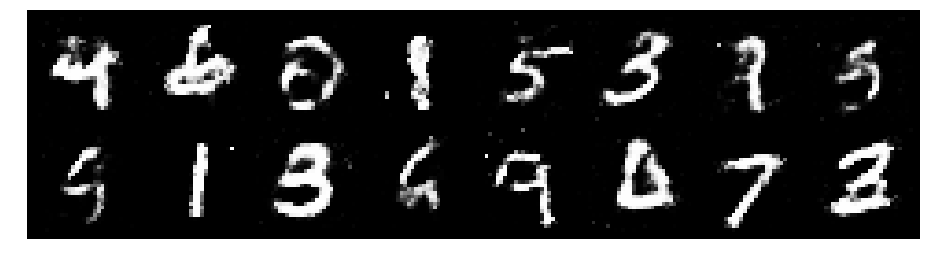

Epoch: [114/200], Batch Num: [200/600]
Discriminator Loss: 1.4119, Generator Loss: 0.9625
D(x): 0.5047, D(G(z)): 0.4389


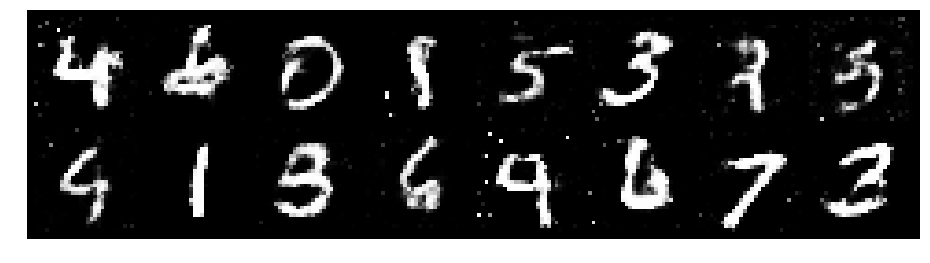

Epoch: [114/200], Batch Num: [300/600]
Discriminator Loss: 1.2656, Generator Loss: 0.9897
D(x): 0.5893, D(G(z)): 0.4506


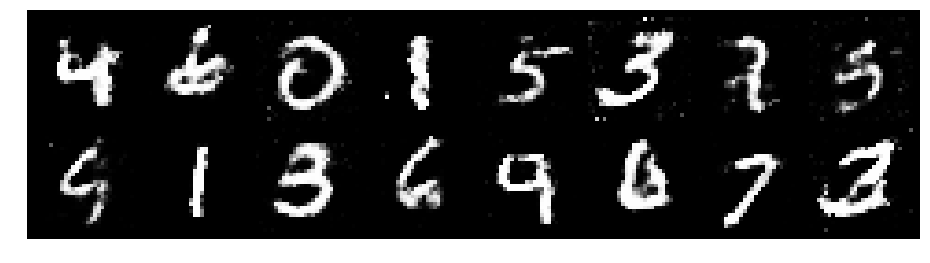

Epoch: [114/200], Batch Num: [400/600]
Discriminator Loss: 1.1817, Generator Loss: 0.9852
D(x): 0.5932, D(G(z)): 0.4371


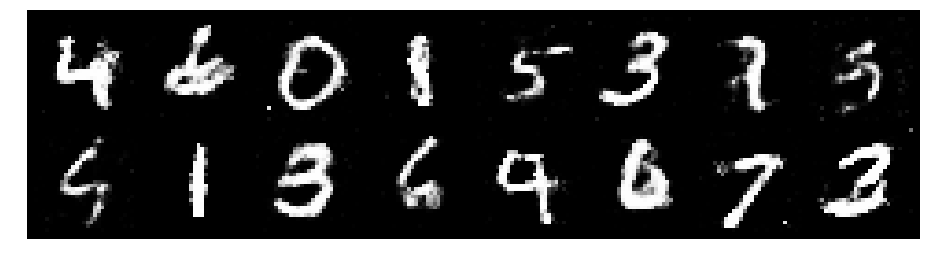

Epoch: [114/200], Batch Num: [500/600]
Discriminator Loss: 1.1223, Generator Loss: 0.9796
D(x): 0.6096, D(G(z)): 0.4131


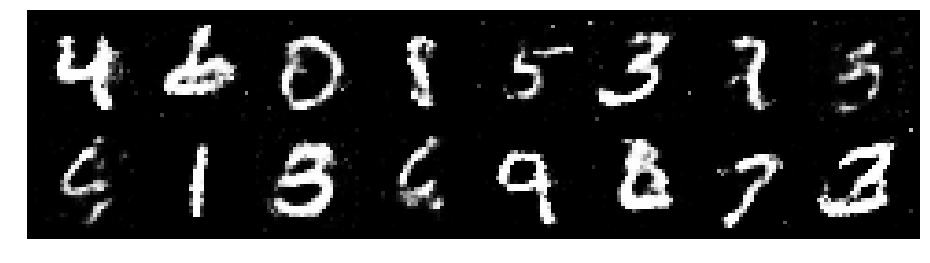

Epoch: [115/200], Batch Num: [0/600]
Discriminator Loss: 1.0896, Generator Loss: 1.2126
D(x): 0.6688, D(G(z)): 0.4295


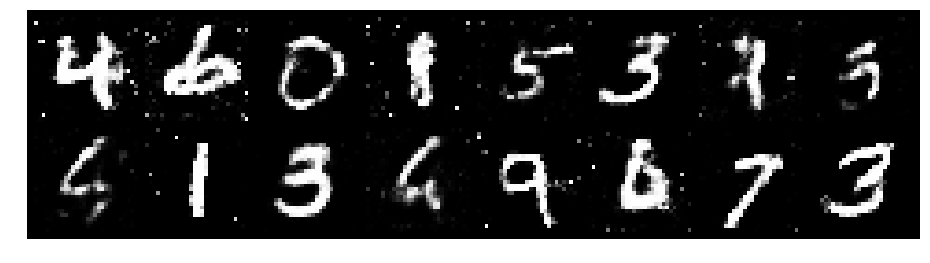

Epoch: [115/200], Batch Num: [100/600]
Discriminator Loss: 1.2033, Generator Loss: 0.9242
D(x): 0.5863, D(G(z)): 0.4429


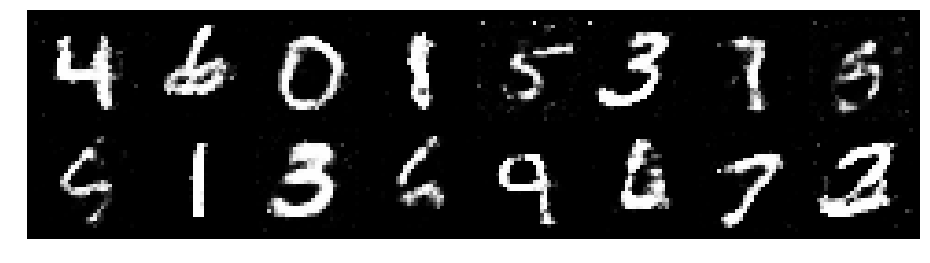

Epoch: [115/200], Batch Num: [200/600]
Discriminator Loss: 1.3150, Generator Loss: 0.8593
D(x): 0.5518, D(G(z)): 0.4640


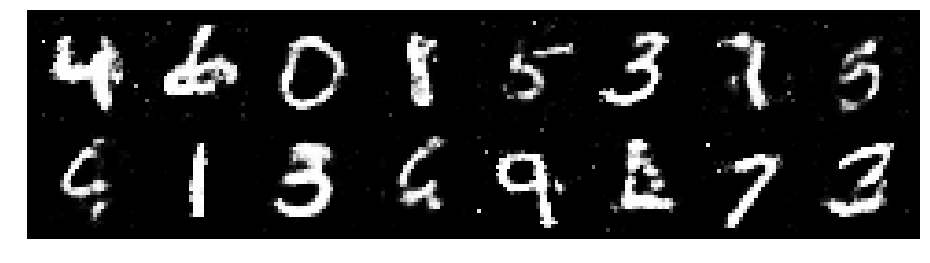

Epoch: [115/200], Batch Num: [300/600]
Discriminator Loss: 1.3018, Generator Loss: 0.9517
D(x): 0.5129, D(G(z)): 0.4097


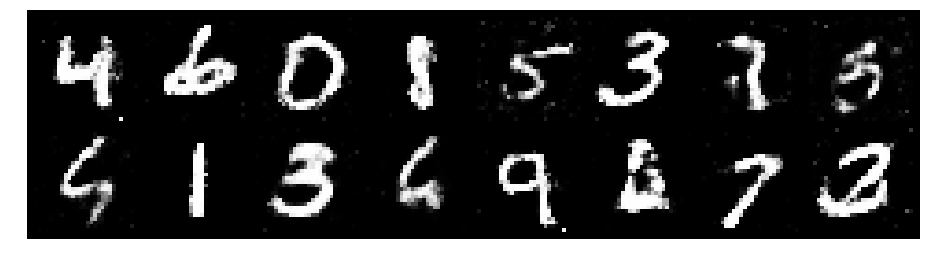

Epoch: [115/200], Batch Num: [400/600]
Discriminator Loss: 1.3079, Generator Loss: 0.7915
D(x): 0.5906, D(G(z)): 0.4908


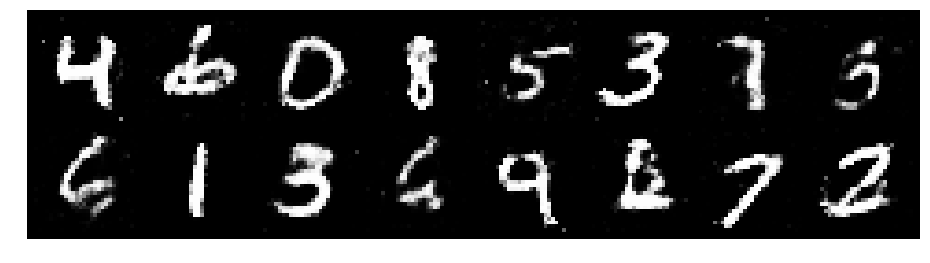

Epoch: [115/200], Batch Num: [500/600]
Discriminator Loss: 1.1451, Generator Loss: 1.0297
D(x): 0.6245, D(G(z)): 0.4061


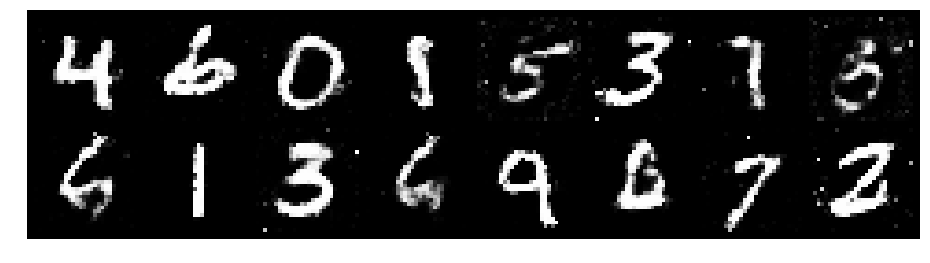

Epoch: [116/200], Batch Num: [0/600]
Discriminator Loss: 1.1244, Generator Loss: 1.1423
D(x): 0.5605, D(G(z)): 0.3787


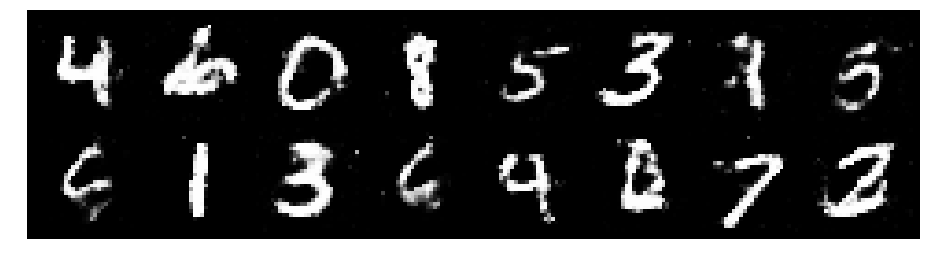

Epoch: [116/200], Batch Num: [100/600]
Discriminator Loss: 1.3217, Generator Loss: 0.8264
D(x): 0.5692, D(G(z)): 0.4759


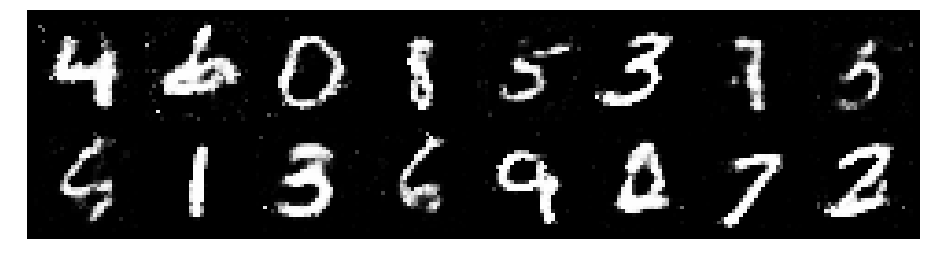

Epoch: [116/200], Batch Num: [200/600]
Discriminator Loss: 1.3427, Generator Loss: 0.7958
D(x): 0.5759, D(G(z)): 0.4927


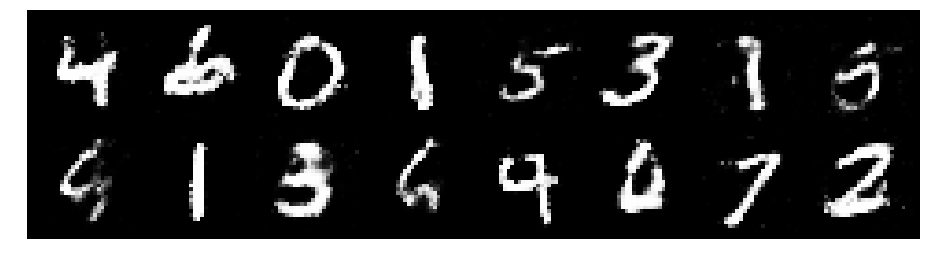

Epoch: [116/200], Batch Num: [300/600]
Discriminator Loss: 1.2792, Generator Loss: 0.7459
D(x): 0.5395, D(G(z)): 0.4614


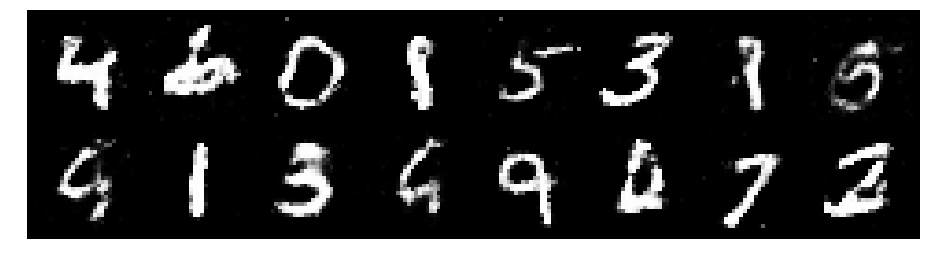

Epoch: [116/200], Batch Num: [400/600]
Discriminator Loss: 1.2225, Generator Loss: 0.8865
D(x): 0.5749, D(G(z)): 0.4508


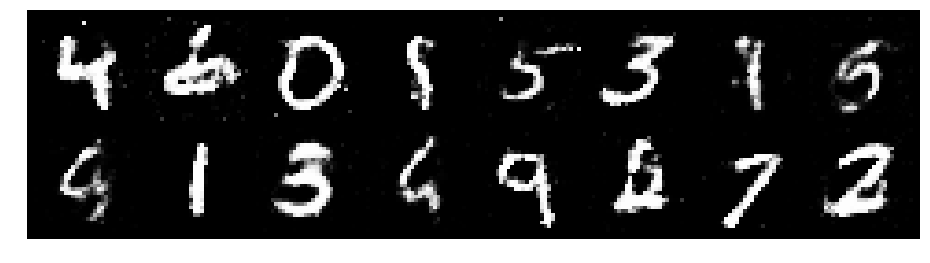

Epoch: [116/200], Batch Num: [500/600]
Discriminator Loss: 1.3060, Generator Loss: 0.9811
D(x): 0.5225, D(G(z)): 0.4136


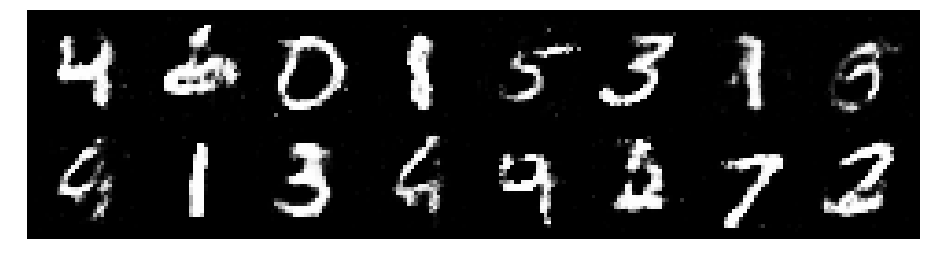

Epoch: [117/200], Batch Num: [0/600]
Discriminator Loss: 1.2695, Generator Loss: 0.9714
D(x): 0.5446, D(G(z)): 0.4164


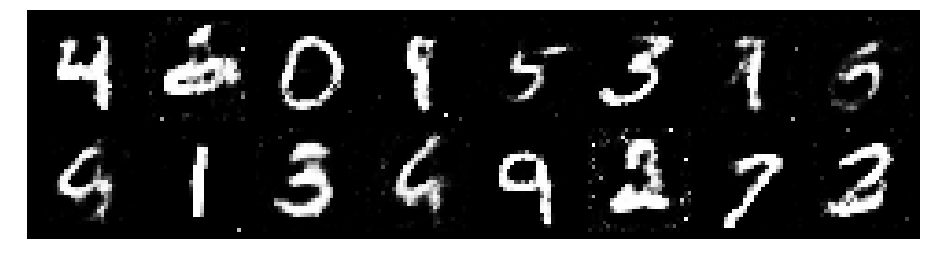

Epoch: [117/200], Batch Num: [100/600]
Discriminator Loss: 1.3380, Generator Loss: 0.9550
D(x): 0.5397, D(G(z)): 0.4530


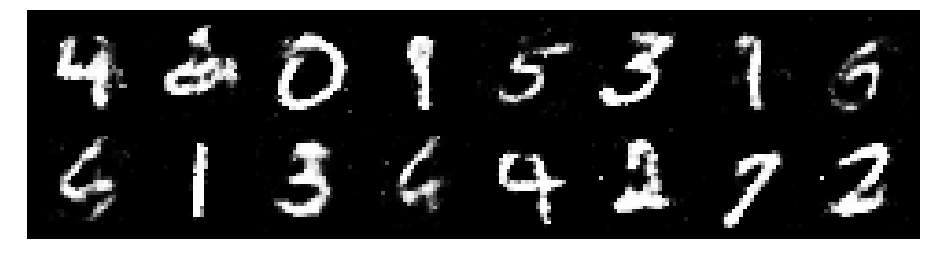

Epoch: [117/200], Batch Num: [200/600]
Discriminator Loss: 1.2310, Generator Loss: 0.8969
D(x): 0.5545, D(G(z)): 0.4254


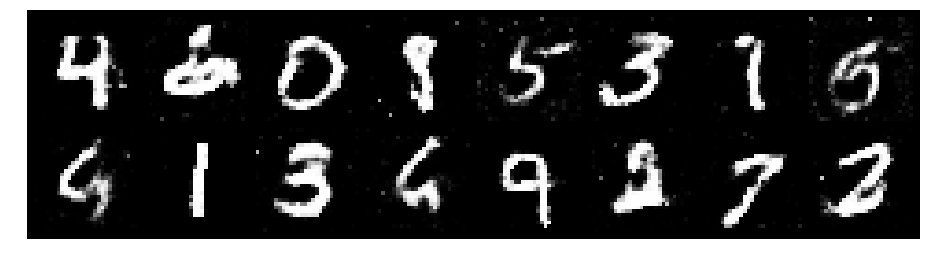

Epoch: [117/200], Batch Num: [300/600]
Discriminator Loss: 1.2087, Generator Loss: 1.0753
D(x): 0.5700, D(G(z)): 0.4114


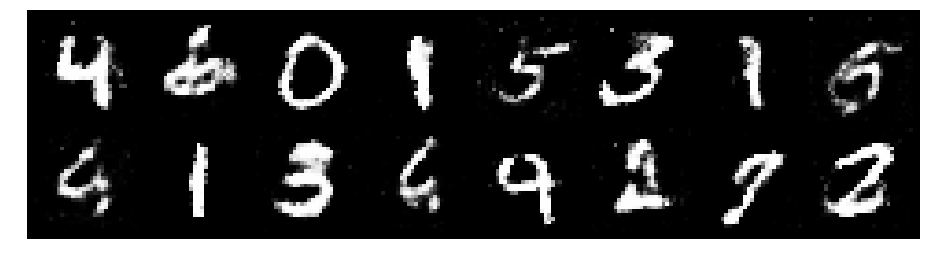

Epoch: [117/200], Batch Num: [400/600]
Discriminator Loss: 1.1944, Generator Loss: 0.9469
D(x): 0.5782, D(G(z)): 0.4315


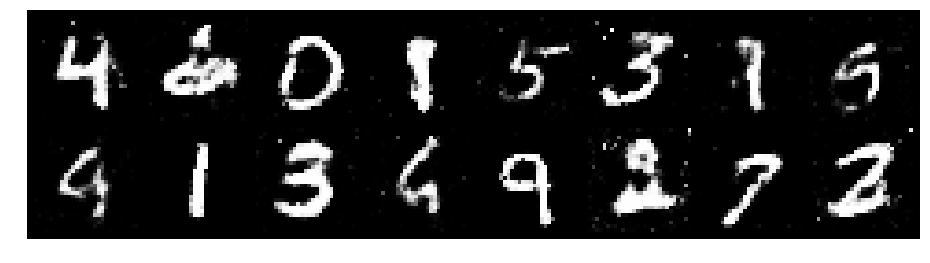

Epoch: [117/200], Batch Num: [500/600]
Discriminator Loss: 1.1941, Generator Loss: 0.8773
D(x): 0.5470, D(G(z)): 0.4098


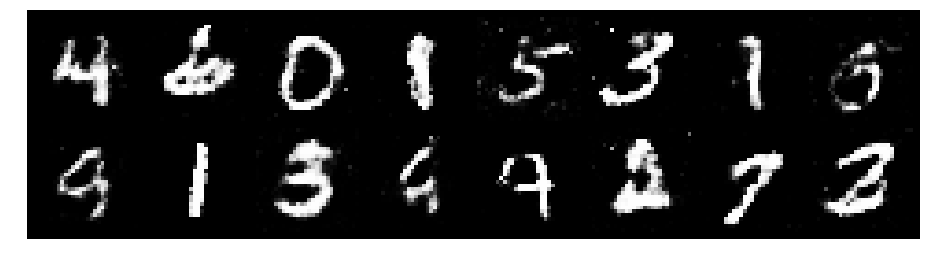

Epoch: [118/200], Batch Num: [0/600]
Discriminator Loss: 1.2450, Generator Loss: 0.8131
D(x): 0.5878, D(G(z)): 0.4676


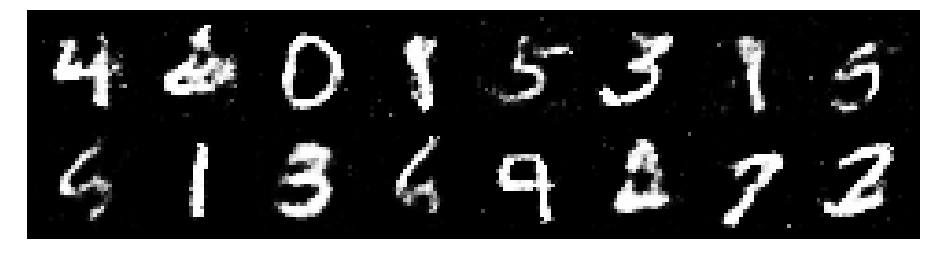

Epoch: [118/200], Batch Num: [100/600]
Discriminator Loss: 1.4717, Generator Loss: 0.8129
D(x): 0.4965, D(G(z)): 0.4611


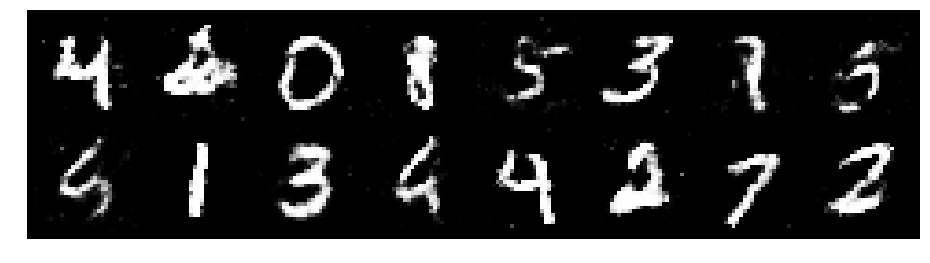

Epoch: [118/200], Batch Num: [200/600]
Discriminator Loss: 1.3436, Generator Loss: 0.8086
D(x): 0.5834, D(G(z)): 0.4803


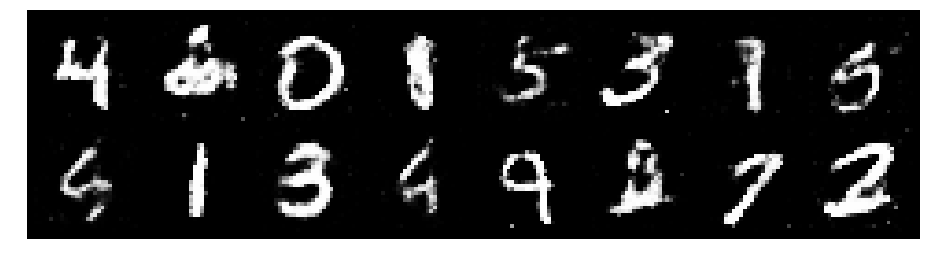

Epoch: [118/200], Batch Num: [300/600]
Discriminator Loss: 1.3142, Generator Loss: 0.8323
D(x): 0.5690, D(G(z)): 0.4783


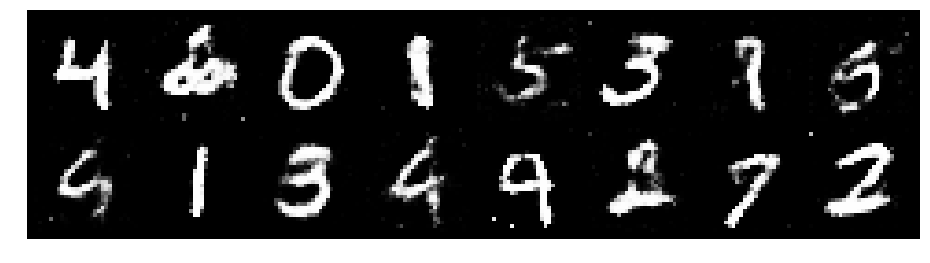

Epoch: [118/200], Batch Num: [400/600]
Discriminator Loss: 1.4015, Generator Loss: 0.8140
D(x): 0.5523, D(G(z)): 0.5117


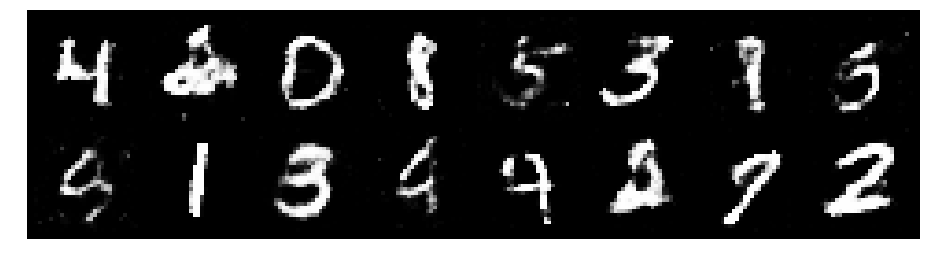

Epoch: [118/200], Batch Num: [500/600]
Discriminator Loss: 1.2373, Generator Loss: 0.9399
D(x): 0.5644, D(G(z)): 0.4384


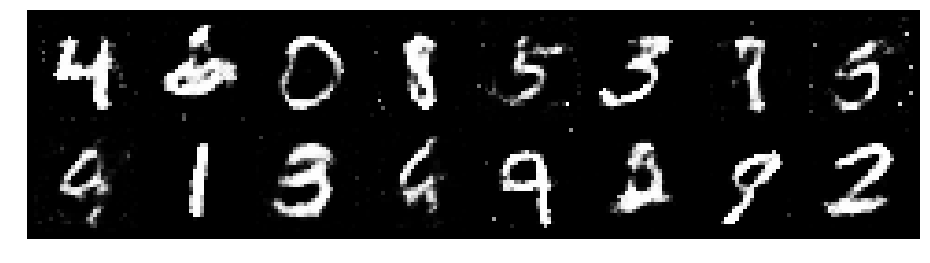

Epoch: [119/200], Batch Num: [0/600]
Discriminator Loss: 1.1833, Generator Loss: 0.9872
D(x): 0.5861, D(G(z)): 0.4195


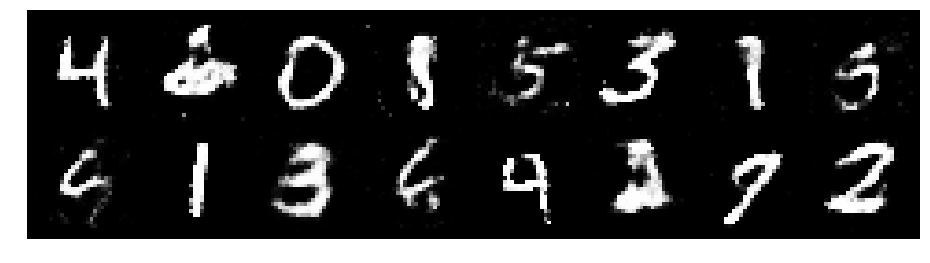

Epoch: [119/200], Batch Num: [100/600]
Discriminator Loss: 1.1363, Generator Loss: 0.8891
D(x): 0.5731, D(G(z)): 0.3995


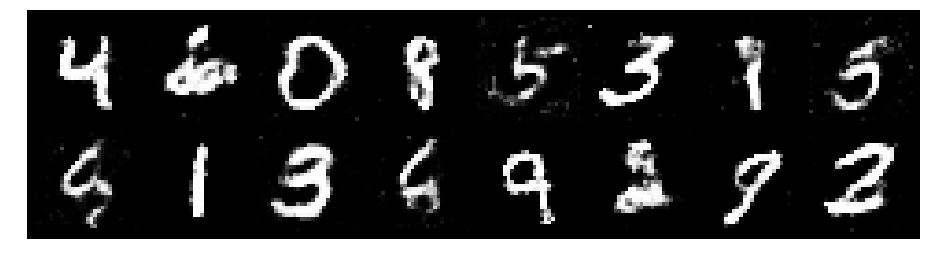

Epoch: [119/200], Batch Num: [200/600]
Discriminator Loss: 1.2991, Generator Loss: 0.8919
D(x): 0.5327, D(G(z)): 0.4353


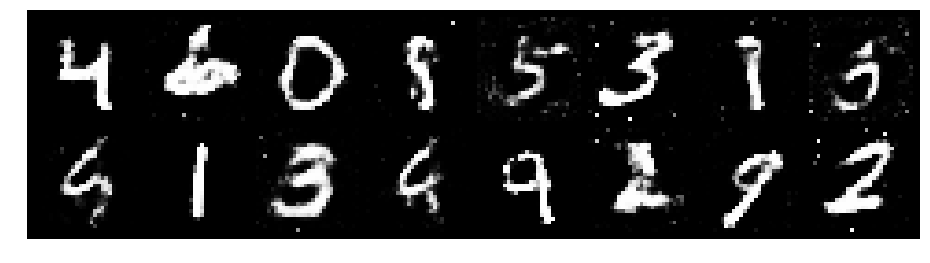

Epoch: [119/200], Batch Num: [300/600]
Discriminator Loss: 1.1893, Generator Loss: 0.8850
D(x): 0.5914, D(G(z)): 0.4275


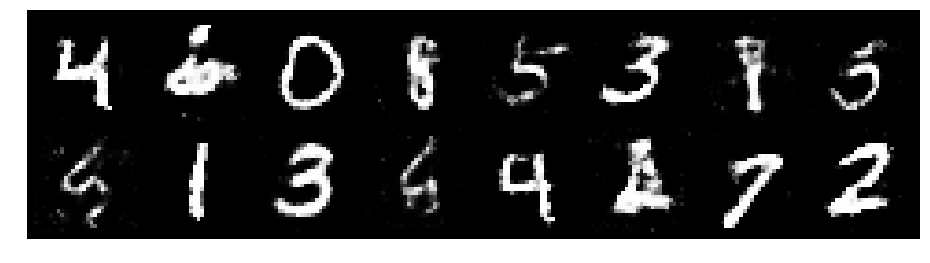

Epoch: [119/200], Batch Num: [400/600]
Discriminator Loss: 1.3123, Generator Loss: 0.7980
D(x): 0.5335, D(G(z)): 0.4528


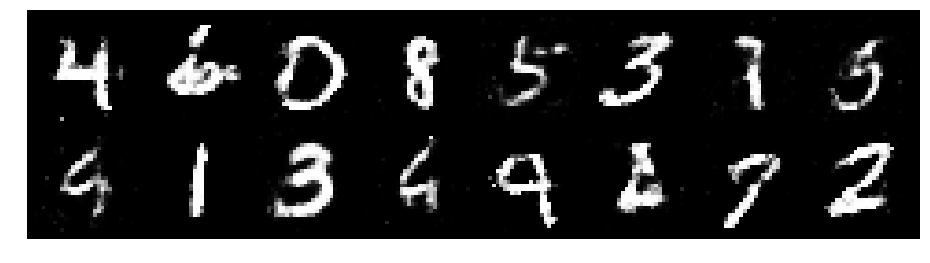

Epoch: [119/200], Batch Num: [500/600]
Discriminator Loss: 1.2054, Generator Loss: 1.0150
D(x): 0.5468, D(G(z)): 0.3899


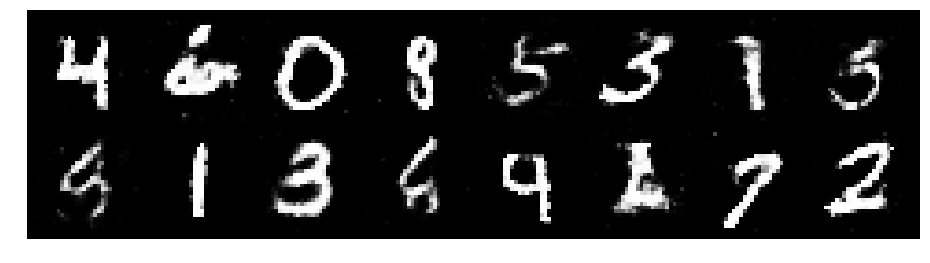

Epoch: [120/200], Batch Num: [0/600]
Discriminator Loss: 1.2628, Generator Loss: 0.9130
D(x): 0.5997, D(G(z)): 0.4782


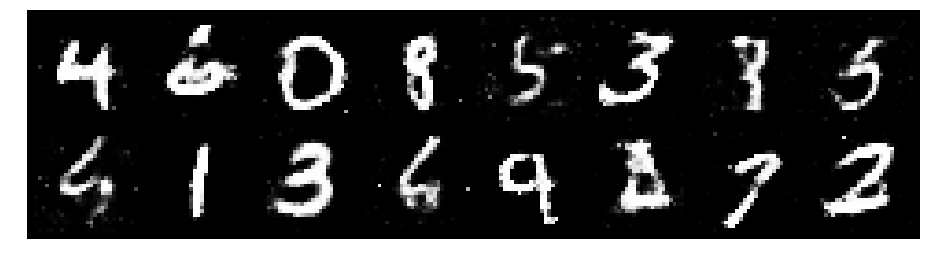

Epoch: [120/200], Batch Num: [100/600]
Discriminator Loss: 1.1939, Generator Loss: 0.9004
D(x): 0.5697, D(G(z)): 0.4252


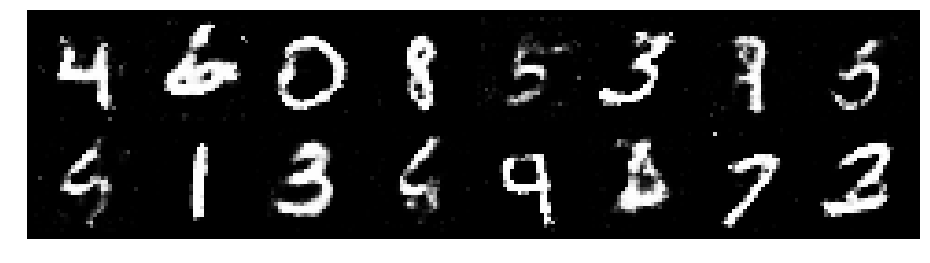

Epoch: [120/200], Batch Num: [200/600]
Discriminator Loss: 1.2798, Generator Loss: 0.8976
D(x): 0.5586, D(G(z)): 0.4541


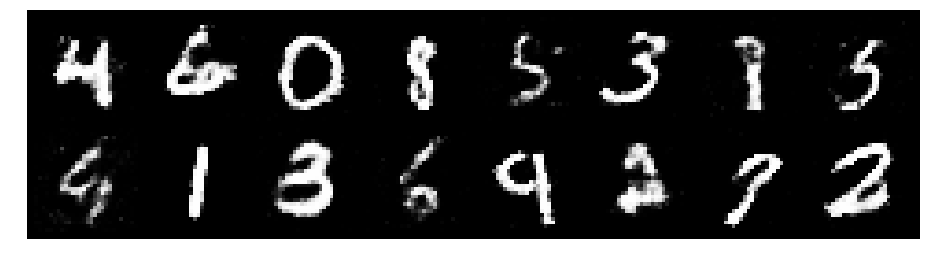

Epoch: [120/200], Batch Num: [300/600]
Discriminator Loss: 1.2919, Generator Loss: 0.9479
D(x): 0.5170, D(G(z)): 0.4094


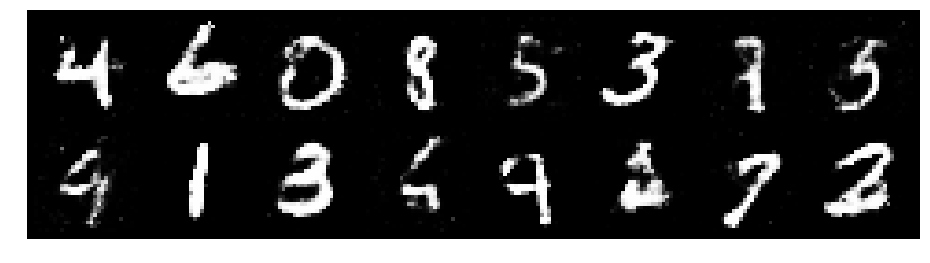

Epoch: [120/200], Batch Num: [400/600]
Discriminator Loss: 1.2514, Generator Loss: 0.9401
D(x): 0.5834, D(G(z)): 0.4550


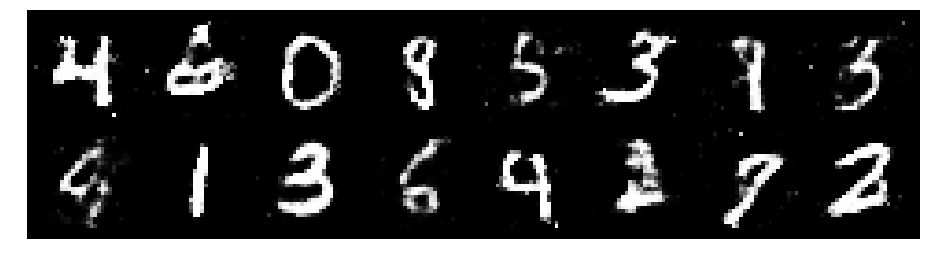

Epoch: [120/200], Batch Num: [500/600]
Discriminator Loss: 1.2020, Generator Loss: 0.9026
D(x): 0.5934, D(G(z)): 0.4341


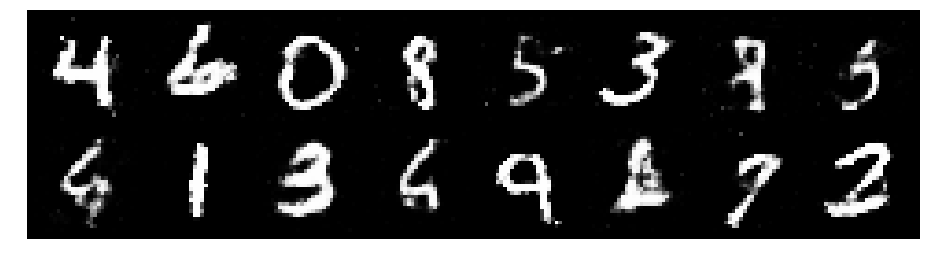

Epoch: [121/200], Batch Num: [0/600]
Discriminator Loss: 1.1131, Generator Loss: 1.0722
D(x): 0.6283, D(G(z)): 0.4022


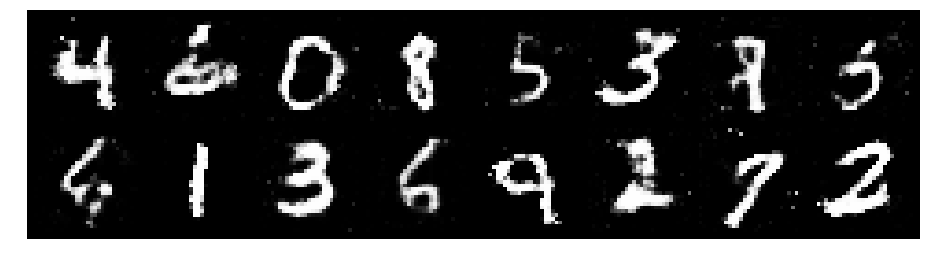

Epoch: [121/200], Batch Num: [100/600]
Discriminator Loss: 1.2620, Generator Loss: 1.0272
D(x): 0.5640, D(G(z)): 0.4350


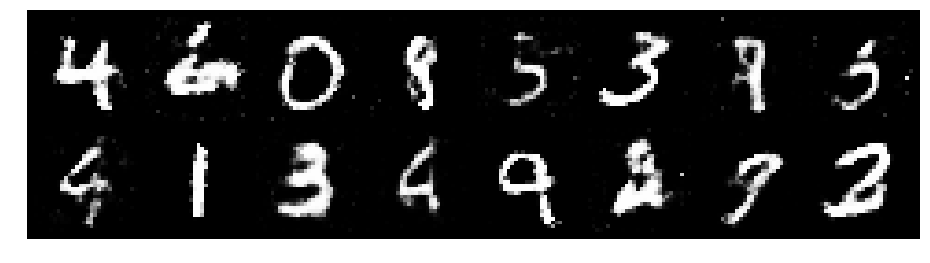

Epoch: [121/200], Batch Num: [200/600]
Discriminator Loss: 1.2681, Generator Loss: 0.9685
D(x): 0.5652, D(G(z)): 0.4405


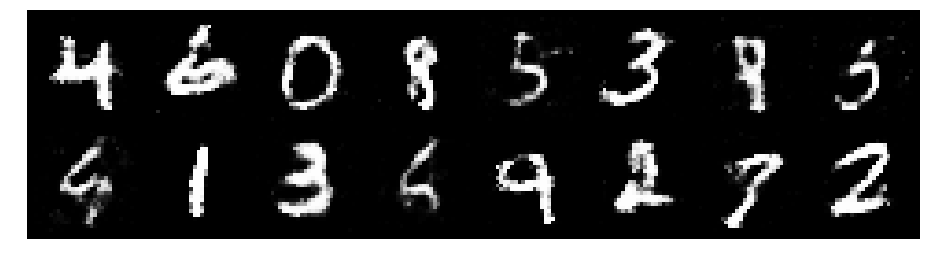

Epoch: [121/200], Batch Num: [300/600]
Discriminator Loss: 1.3441, Generator Loss: 0.8337
D(x): 0.5560, D(G(z)): 0.4894


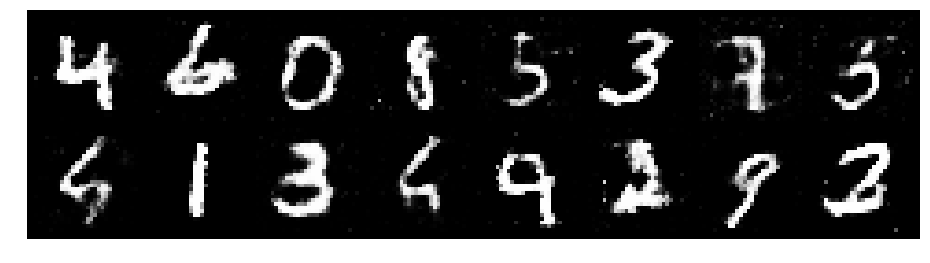

Epoch: [121/200], Batch Num: [400/600]
Discriminator Loss: 1.3122, Generator Loss: 0.9585
D(x): 0.5555, D(G(z)): 0.4350


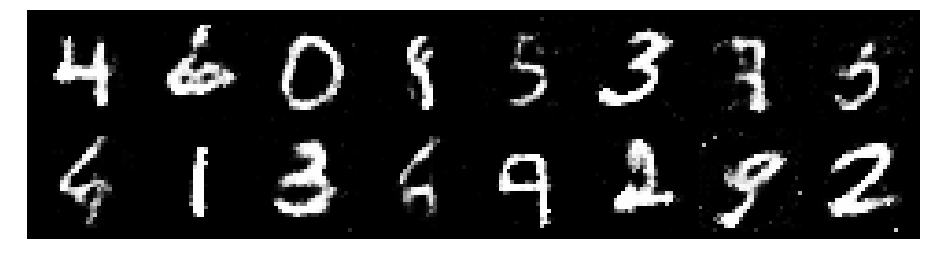

Epoch: [121/200], Batch Num: [500/600]
Discriminator Loss: 1.2022, Generator Loss: 0.9898
D(x): 0.5813, D(G(z)): 0.4217


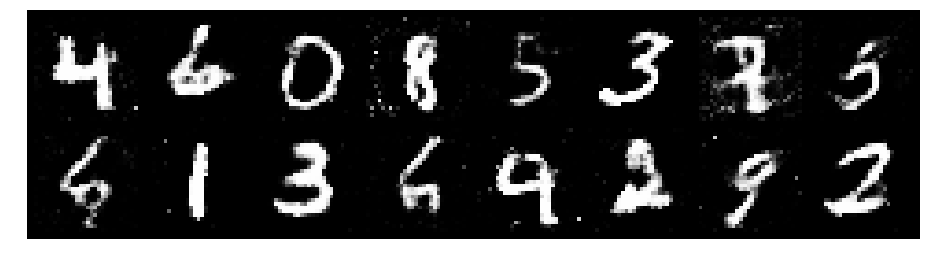

Epoch: [122/200], Batch Num: [0/600]
Discriminator Loss: 1.3412, Generator Loss: 0.9369
D(x): 0.5404, D(G(z)): 0.4441


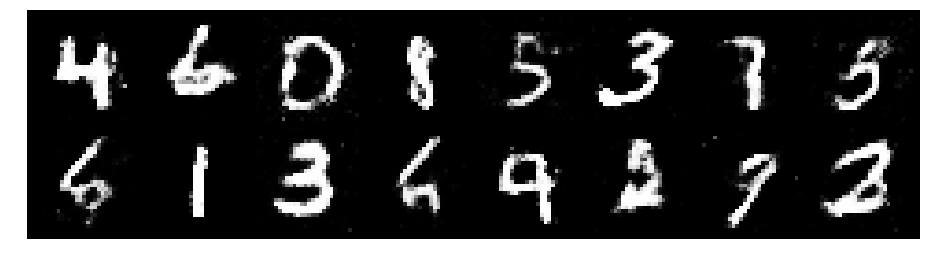

Epoch: [122/200], Batch Num: [100/600]
Discriminator Loss: 1.2274, Generator Loss: 1.0032
D(x): 0.6062, D(G(z)): 0.4231


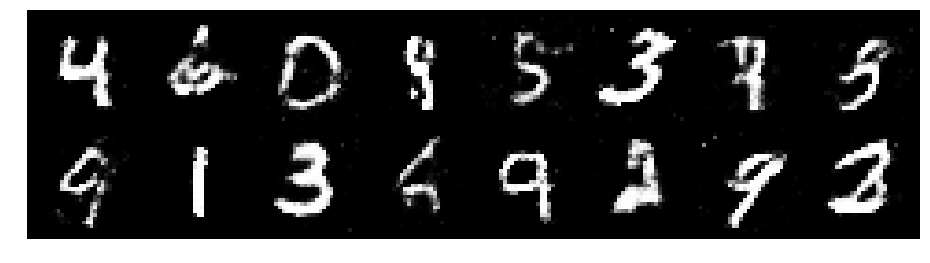

Epoch: [122/200], Batch Num: [200/600]
Discriminator Loss: 1.1616, Generator Loss: 1.1862
D(x): 0.5656, D(G(z)): 0.4026


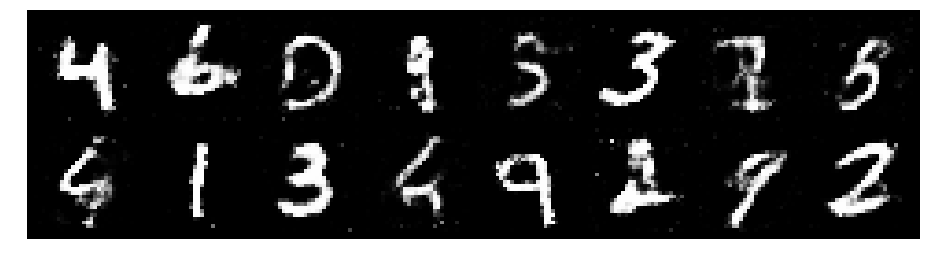

Epoch: [122/200], Batch Num: [300/600]
Discriminator Loss: 1.1051, Generator Loss: 0.9934
D(x): 0.6036, D(G(z)): 0.3882


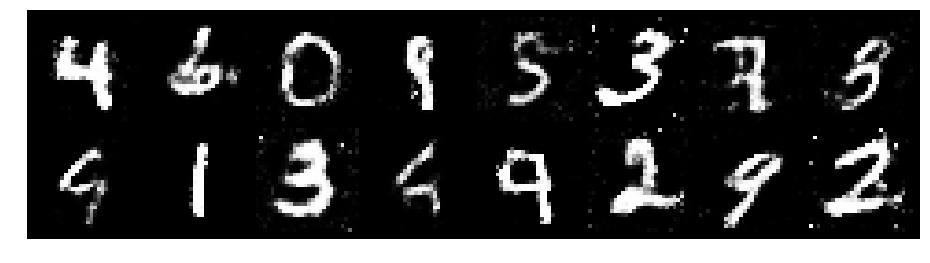

Epoch: [122/200], Batch Num: [400/600]
Discriminator Loss: 1.1871, Generator Loss: 0.9590
D(x): 0.5833, D(G(z)): 0.4231


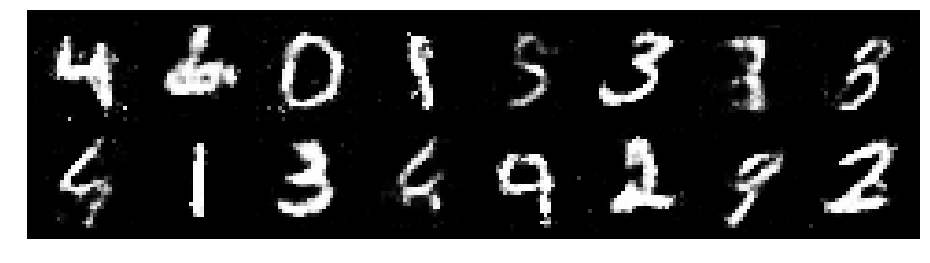

Epoch: [122/200], Batch Num: [500/600]
Discriminator Loss: 1.2515, Generator Loss: 1.1232
D(x): 0.5729, D(G(z)): 0.4085


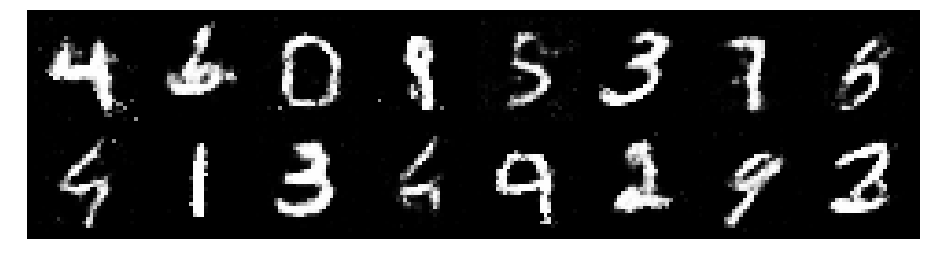

Epoch: [123/200], Batch Num: [0/600]
Discriminator Loss: 1.2369, Generator Loss: 1.0455
D(x): 0.5647, D(G(z)): 0.4176


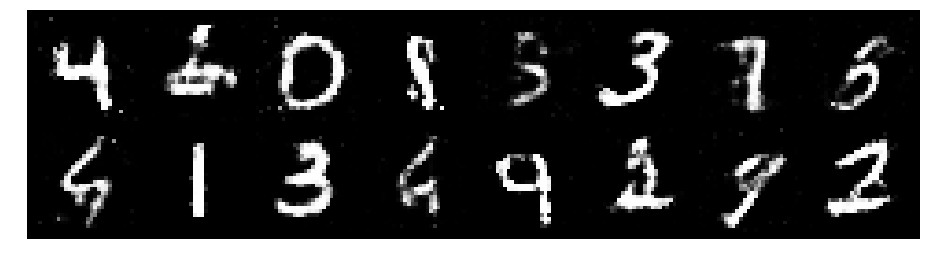

Epoch: [123/200], Batch Num: [100/600]
Discriminator Loss: 1.2241, Generator Loss: 0.9078
D(x): 0.5662, D(G(z)): 0.4195


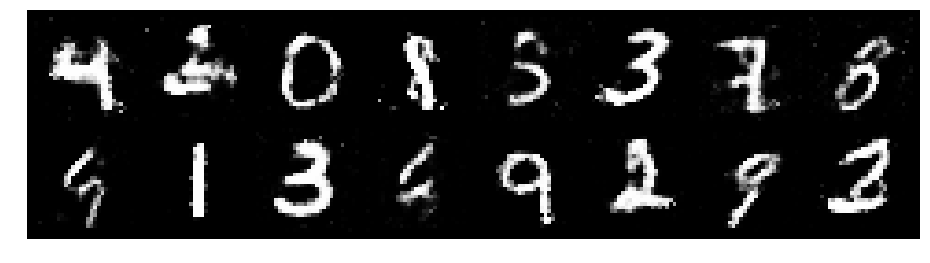

Epoch: [123/200], Batch Num: [200/600]
Discriminator Loss: 1.2802, Generator Loss: 0.9061
D(x): 0.5376, D(G(z)): 0.4504


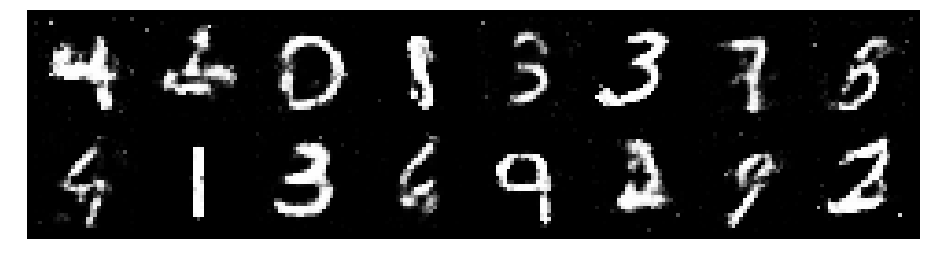

Epoch: [123/200], Batch Num: [300/600]
Discriminator Loss: 1.2323, Generator Loss: 0.8976
D(x): 0.5502, D(G(z)): 0.4273


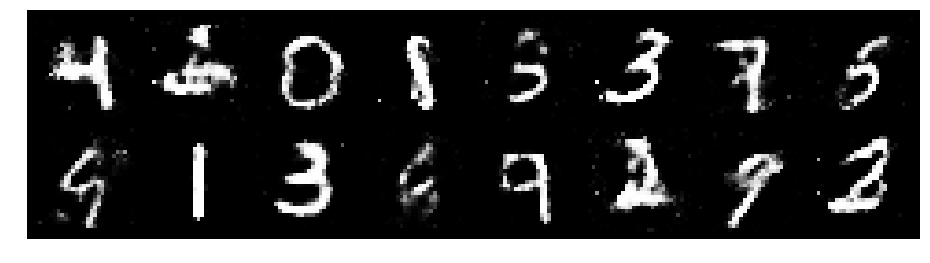

Epoch: [123/200], Batch Num: [400/600]
Discriminator Loss: 1.3207, Generator Loss: 0.9664
D(x): 0.5713, D(G(z)): 0.4776


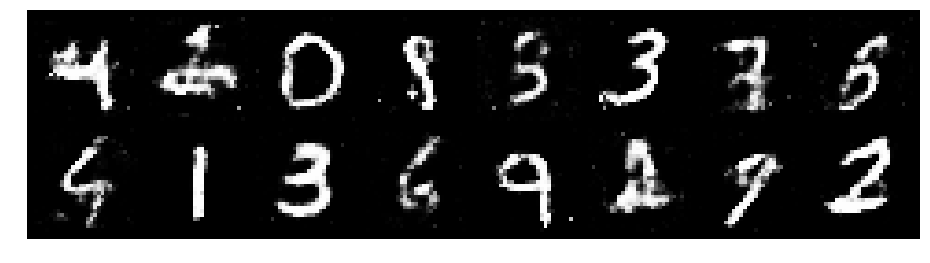

Epoch: [123/200], Batch Num: [500/600]
Discriminator Loss: 1.3126, Generator Loss: 0.8841
D(x): 0.5408, D(G(z)): 0.4456


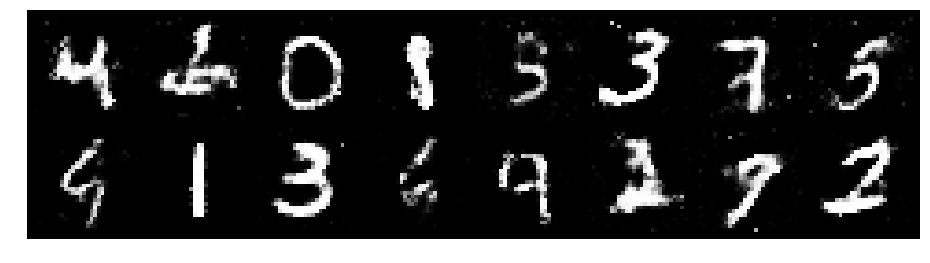

Epoch: [124/200], Batch Num: [0/600]
Discriminator Loss: 1.3784, Generator Loss: 0.9089
D(x): 0.4962, D(G(z)): 0.4038


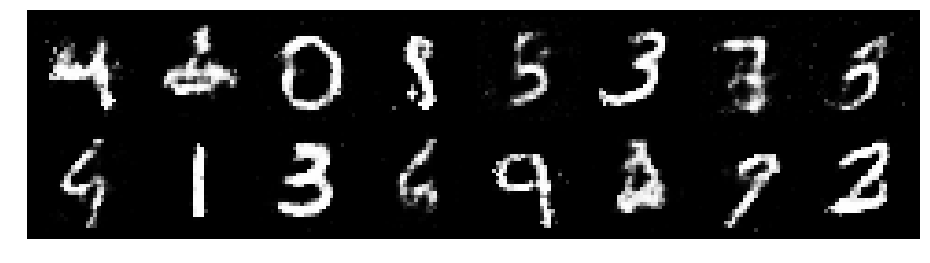

Epoch: [124/200], Batch Num: [100/600]
Discriminator Loss: 1.2637, Generator Loss: 0.9137
D(x): 0.5512, D(G(z)): 0.4427


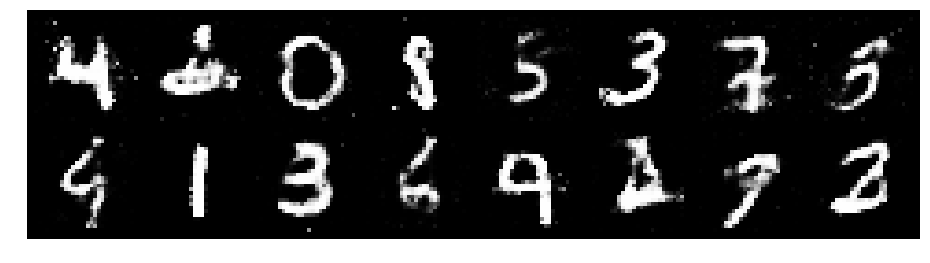

Epoch: [124/200], Batch Num: [200/600]
Discriminator Loss: 1.3362, Generator Loss: 1.0762
D(x): 0.5575, D(G(z)): 0.4479


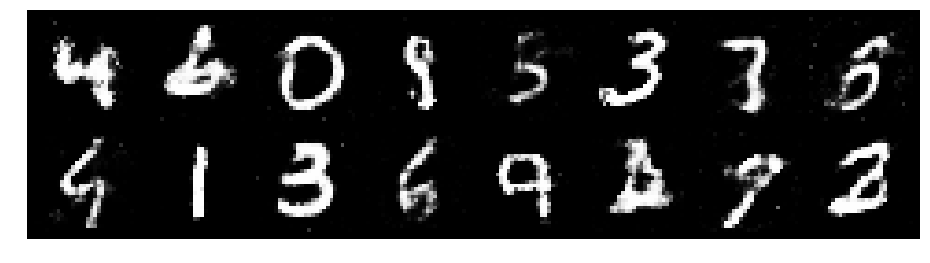

Epoch: [124/200], Batch Num: [300/600]
Discriminator Loss: 1.2999, Generator Loss: 0.9928
D(x): 0.5803, D(G(z)): 0.4543


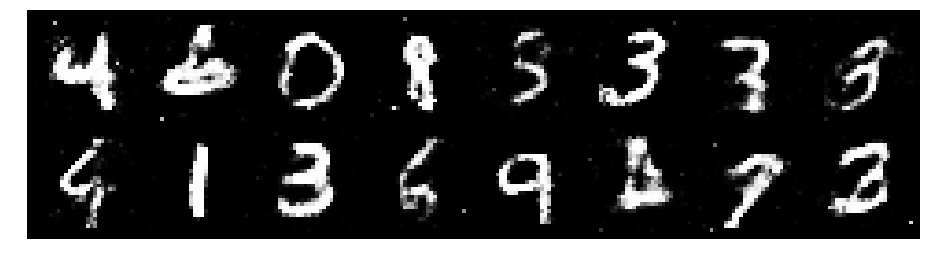

Epoch: [124/200], Batch Num: [400/600]
Discriminator Loss: 1.2681, Generator Loss: 1.0095
D(x): 0.5422, D(G(z)): 0.4217


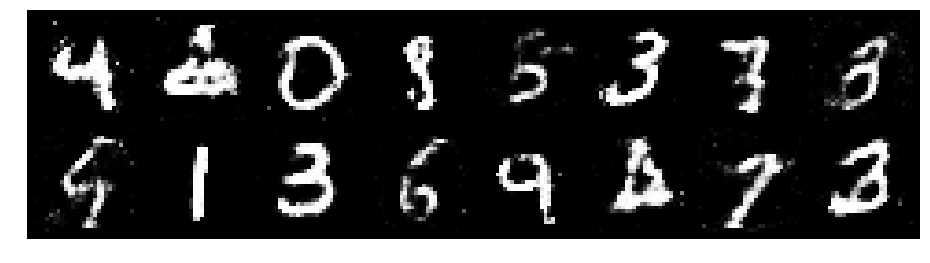

Epoch: [124/200], Batch Num: [500/600]
Discriminator Loss: 1.1794, Generator Loss: 0.9002
D(x): 0.5712, D(G(z)): 0.4248


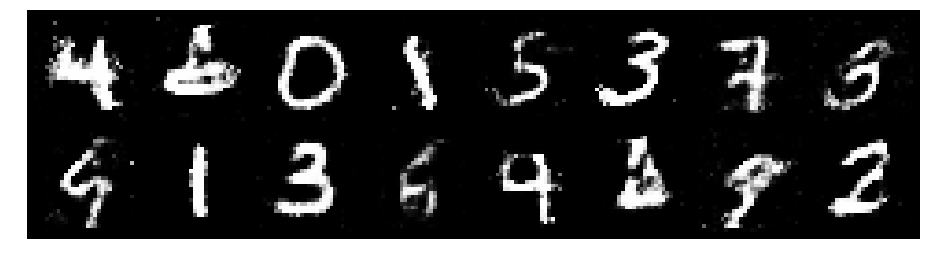

Epoch: [125/200], Batch Num: [0/600]
Discriminator Loss: 1.2609, Generator Loss: 0.8720
D(x): 0.5445, D(G(z)): 0.4498


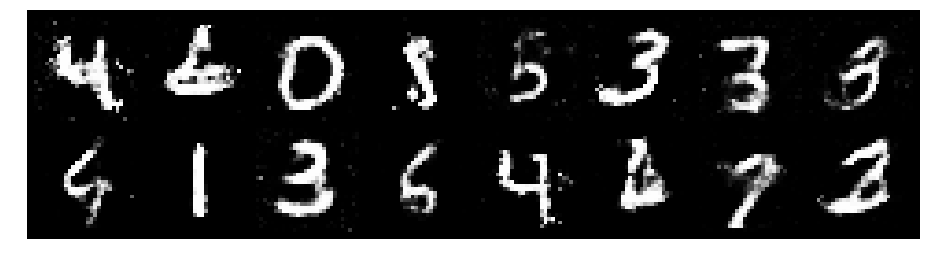

Epoch: [125/200], Batch Num: [100/600]
Discriminator Loss: 1.3081, Generator Loss: 0.8971
D(x): 0.5083, D(G(z)): 0.4194


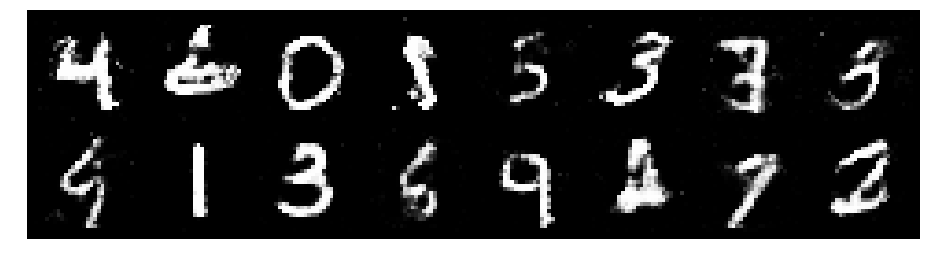

Epoch: [125/200], Batch Num: [200/600]
Discriminator Loss: 1.3567, Generator Loss: 0.7540
D(x): 0.5543, D(G(z)): 0.4851


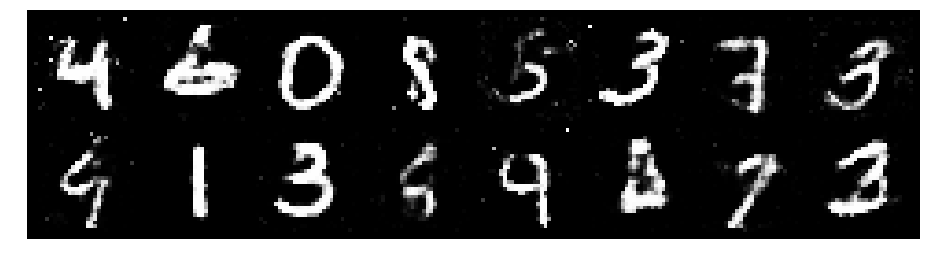

Epoch: [125/200], Batch Num: [300/600]
Discriminator Loss: 1.2839, Generator Loss: 1.0031
D(x): 0.5540, D(G(z)): 0.4187


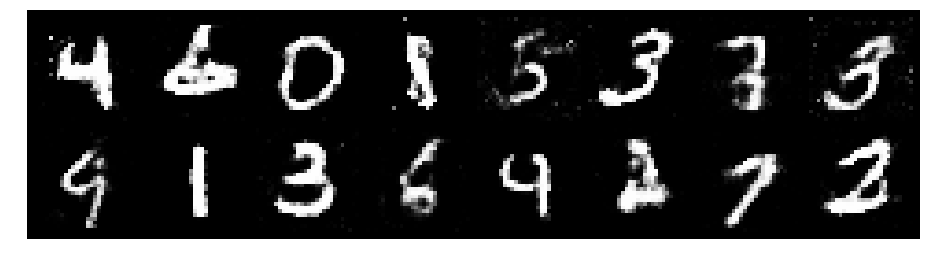

Epoch: [125/200], Batch Num: [400/600]
Discriminator Loss: 1.2456, Generator Loss: 0.9246
D(x): 0.5530, D(G(z)): 0.3995


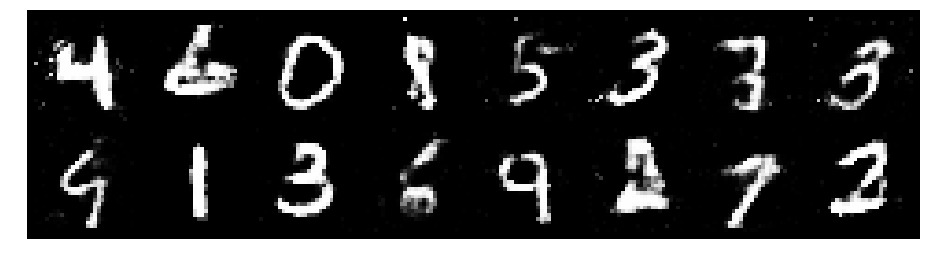

Epoch: [125/200], Batch Num: [500/600]
Discriminator Loss: 1.2514, Generator Loss: 1.0417
D(x): 0.5829, D(G(z)): 0.4182


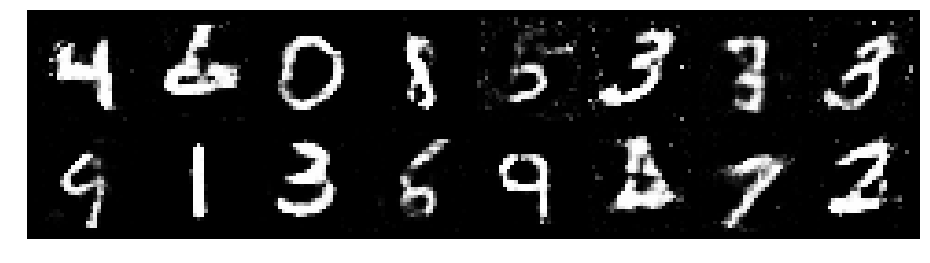

Epoch: [126/200], Batch Num: [0/600]
Discriminator Loss: 1.3296, Generator Loss: 0.8753
D(x): 0.5674, D(G(z)): 0.4563


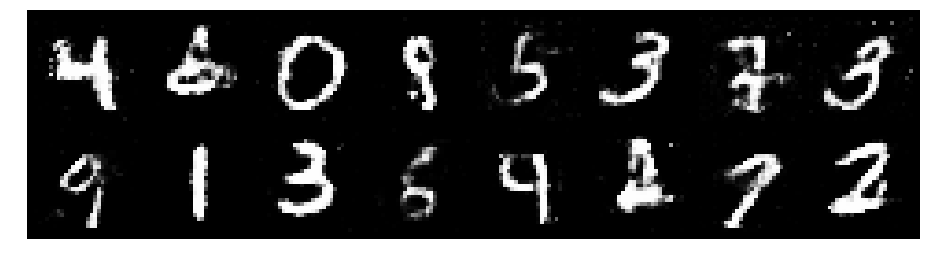

Epoch: [126/200], Batch Num: [100/600]
Discriminator Loss: 1.1823, Generator Loss: 0.9147
D(x): 0.5990, D(G(z)): 0.4349


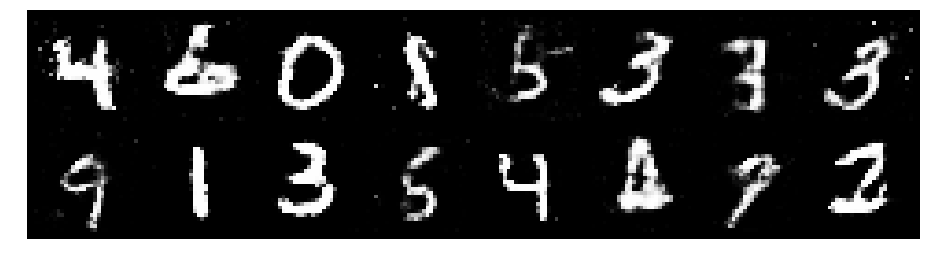

Epoch: [126/200], Batch Num: [200/600]
Discriminator Loss: 1.1937, Generator Loss: 0.8176
D(x): 0.5917, D(G(z)): 0.4500


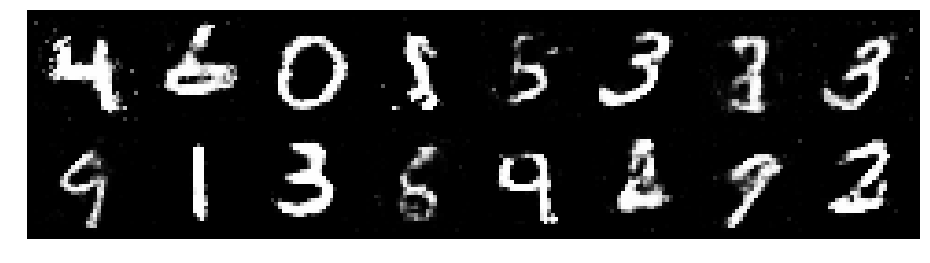

Epoch: [126/200], Batch Num: [300/600]
Discriminator Loss: 1.3158, Generator Loss: 0.8003
D(x): 0.5312, D(G(z)): 0.4257


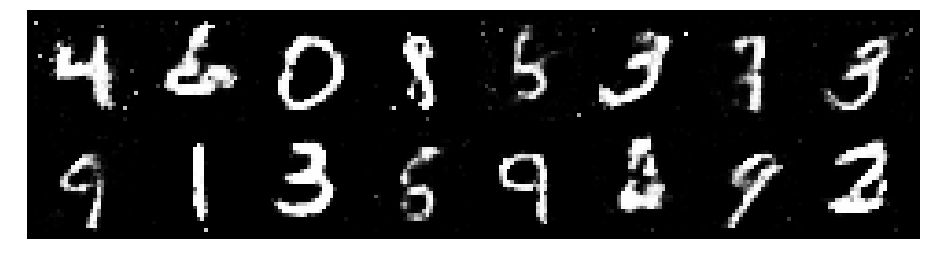

Epoch: [126/200], Batch Num: [400/600]
Discriminator Loss: 1.2539, Generator Loss: 0.8569
D(x): 0.5424, D(G(z)): 0.4171


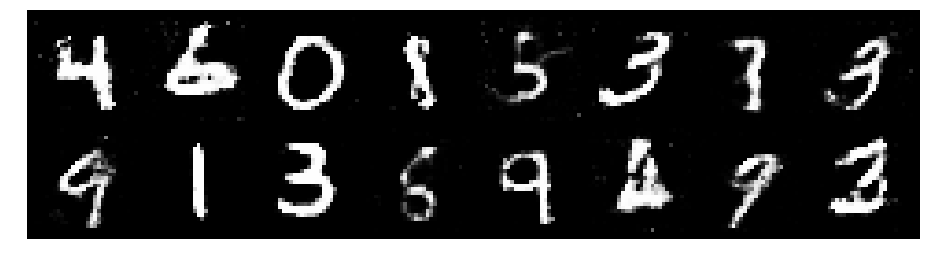

Epoch: [126/200], Batch Num: [500/600]
Discriminator Loss: 1.1924, Generator Loss: 0.9775
D(x): 0.5789, D(G(z)): 0.4161


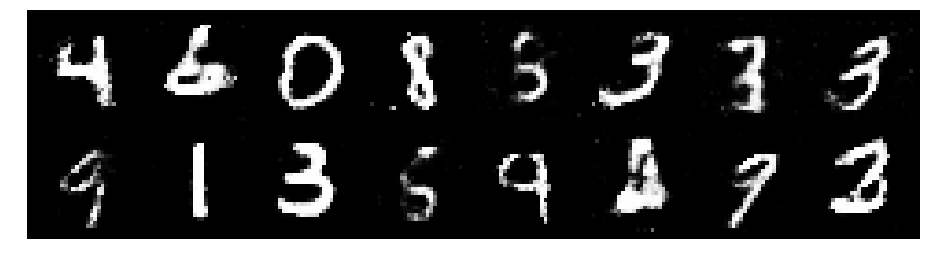

Epoch: [127/200], Batch Num: [0/600]
Discriminator Loss: 1.2895, Generator Loss: 0.9035
D(x): 0.5441, D(G(z)): 0.4475


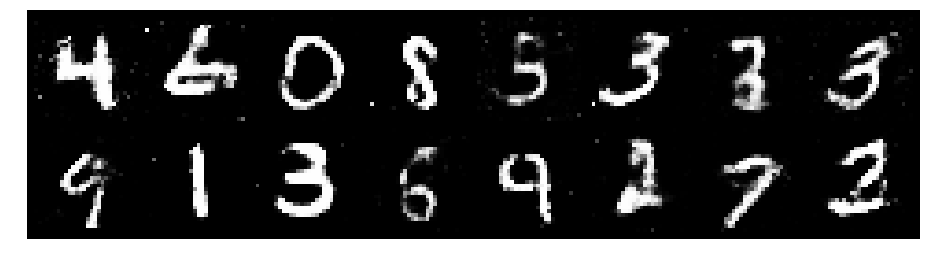

Epoch: [127/200], Batch Num: [100/600]
Discriminator Loss: 1.3484, Generator Loss: 1.0397
D(x): 0.5379, D(G(z)): 0.4330


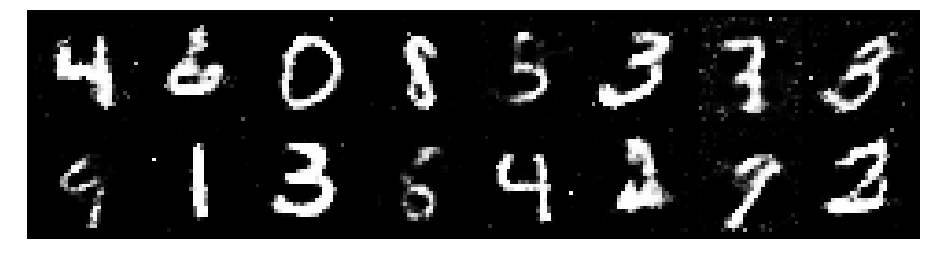

Epoch: [127/200], Batch Num: [200/600]
Discriminator Loss: 1.3551, Generator Loss: 0.8552
D(x): 0.5313, D(G(z)): 0.4316


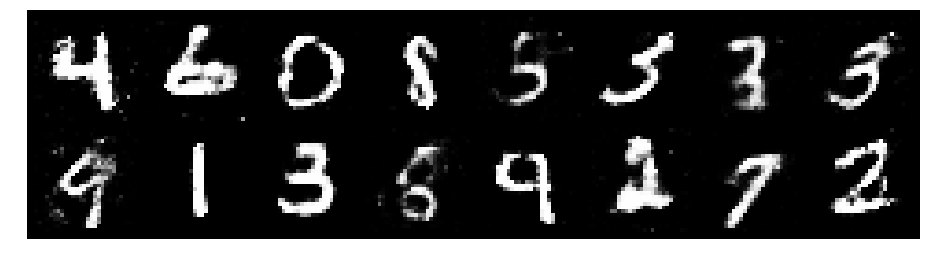

Epoch: [127/200], Batch Num: [300/600]
Discriminator Loss: 1.3569, Generator Loss: 0.9752
D(x): 0.5927, D(G(z)): 0.4710


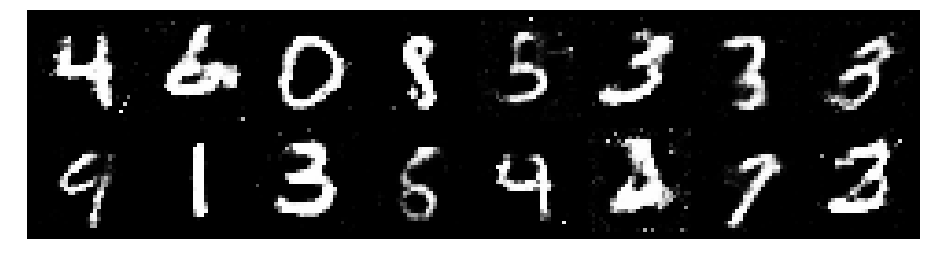

Epoch: [127/200], Batch Num: [400/600]
Discriminator Loss: 1.3213, Generator Loss: 1.0786
D(x): 0.5605, D(G(z)): 0.4571


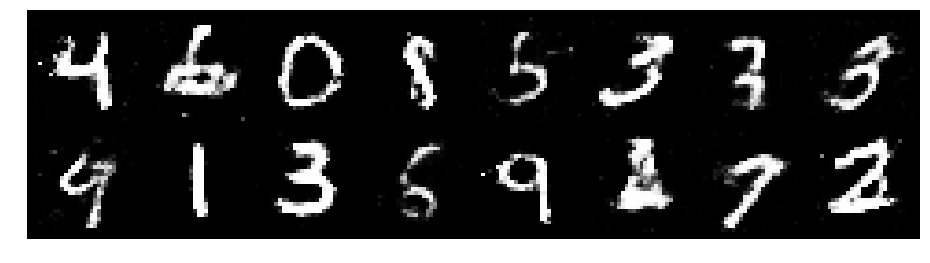

Epoch: [127/200], Batch Num: [500/600]
Discriminator Loss: 1.3157, Generator Loss: 0.9251
D(x): 0.6043, D(G(z)): 0.4715


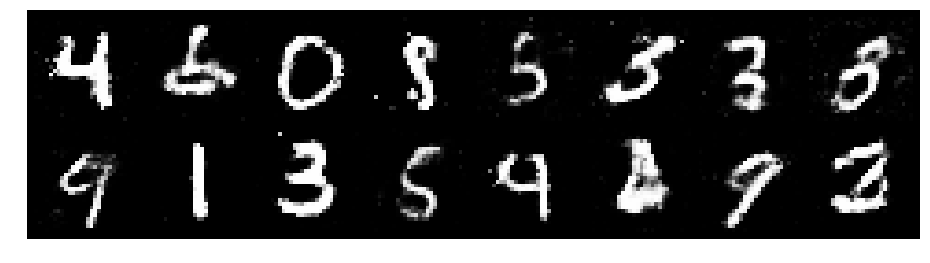

Epoch: [128/200], Batch Num: [0/600]
Discriminator Loss: 1.2854, Generator Loss: 0.8194
D(x): 0.5600, D(G(z)): 0.4521


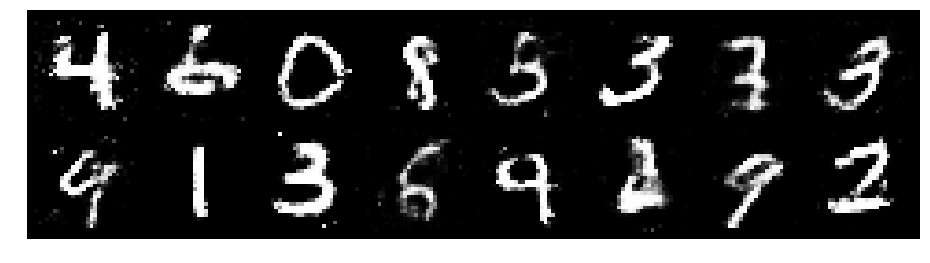

Epoch: [128/200], Batch Num: [100/600]
Discriminator Loss: 1.2207, Generator Loss: 1.0983
D(x): 0.5582, D(G(z)): 0.4110


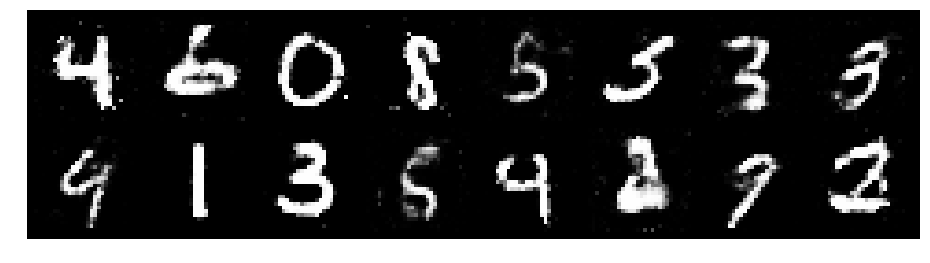

Epoch: [128/200], Batch Num: [200/600]
Discriminator Loss: 1.2153, Generator Loss: 1.0290
D(x): 0.5666, D(G(z)): 0.4153


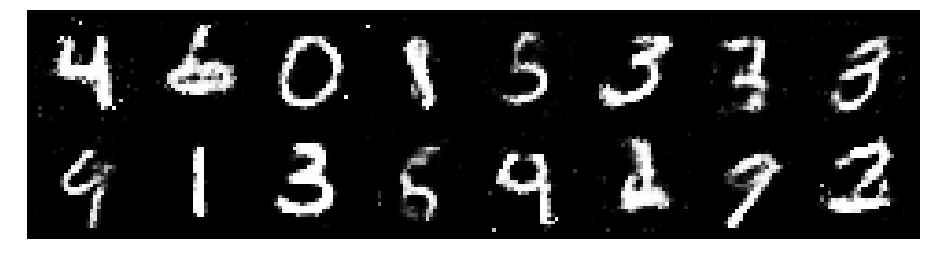

Epoch: [128/200], Batch Num: [300/600]
Discriminator Loss: 1.2772, Generator Loss: 0.7868
D(x): 0.5654, D(G(z)): 0.4668


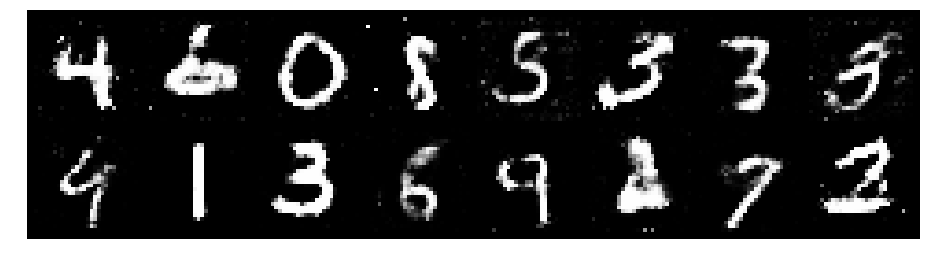

Epoch: [128/200], Batch Num: [400/600]
Discriminator Loss: 1.3338, Generator Loss: 0.9381
D(x): 0.5243, D(G(z)): 0.4438


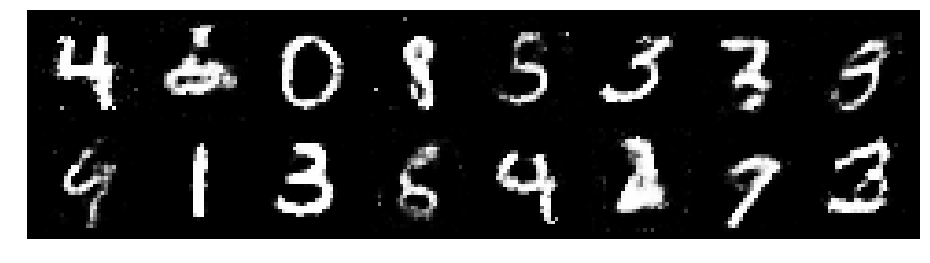

Epoch: [128/200], Batch Num: [500/600]
Discriminator Loss: 1.3730, Generator Loss: 0.9833
D(x): 0.5556, D(G(z)): 0.4770


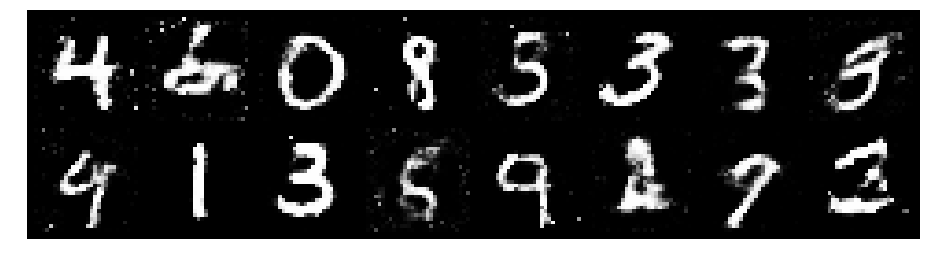

Epoch: [129/200], Batch Num: [0/600]
Discriminator Loss: 1.2782, Generator Loss: 0.8960
D(x): 0.5757, D(G(z)): 0.4637


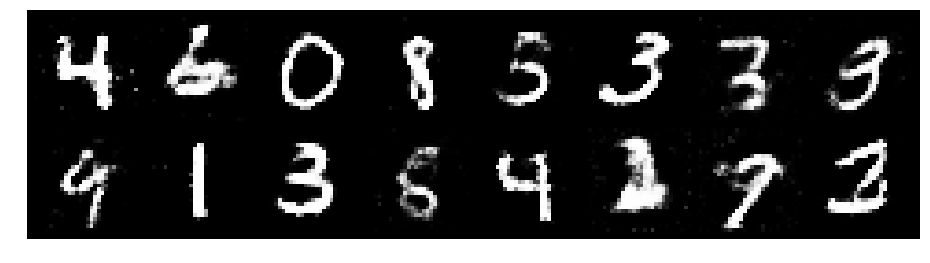

Epoch: [129/200], Batch Num: [100/600]
Discriminator Loss: 1.2553, Generator Loss: 0.9556
D(x): 0.5388, D(G(z)): 0.4179


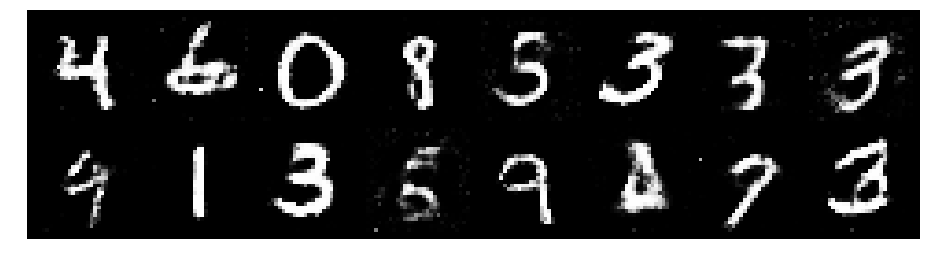

Epoch: [129/200], Batch Num: [200/600]
Discriminator Loss: 1.1850, Generator Loss: 0.8056
D(x): 0.5786, D(G(z)): 0.4414


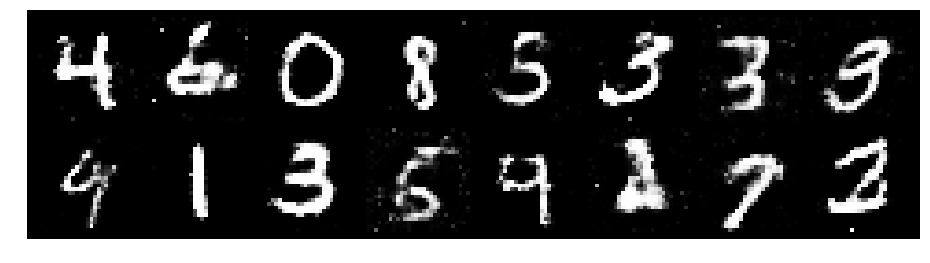

Epoch: [129/200], Batch Num: [300/600]
Discriminator Loss: 1.2949, Generator Loss: 0.8829
D(x): 0.6071, D(G(z)): 0.4912


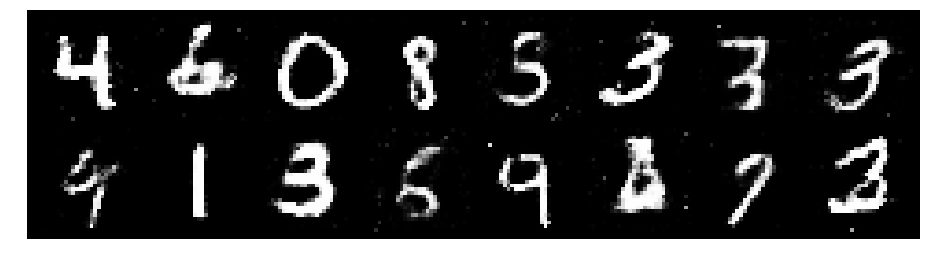

Epoch: [129/200], Batch Num: [400/600]
Discriminator Loss: 1.4090, Generator Loss: 0.8409
D(x): 0.5457, D(G(z)): 0.5053


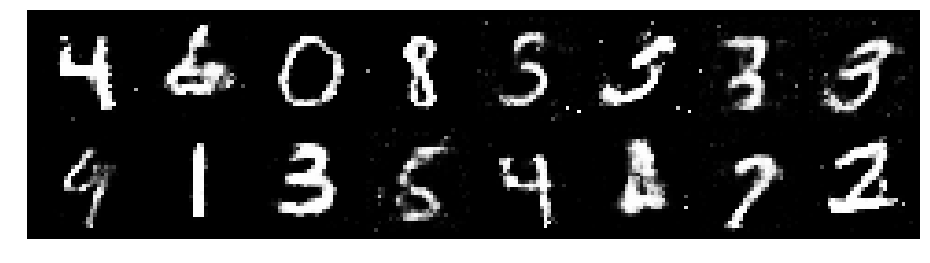

Epoch: [129/200], Batch Num: [500/600]
Discriminator Loss: 1.3094, Generator Loss: 0.8403
D(x): 0.5619, D(G(z)): 0.4869


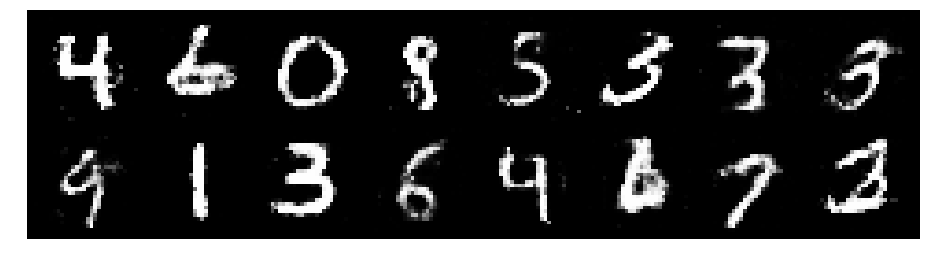

Epoch: [130/200], Batch Num: [0/600]
Discriminator Loss: 1.1560, Generator Loss: 0.8999
D(x): 0.5502, D(G(z)): 0.3937


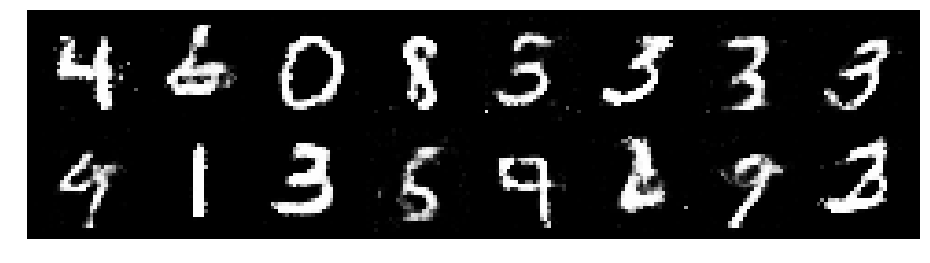

Epoch: [130/200], Batch Num: [100/600]
Discriminator Loss: 1.3266, Generator Loss: 0.8293
D(x): 0.5339, D(G(z)): 0.4677


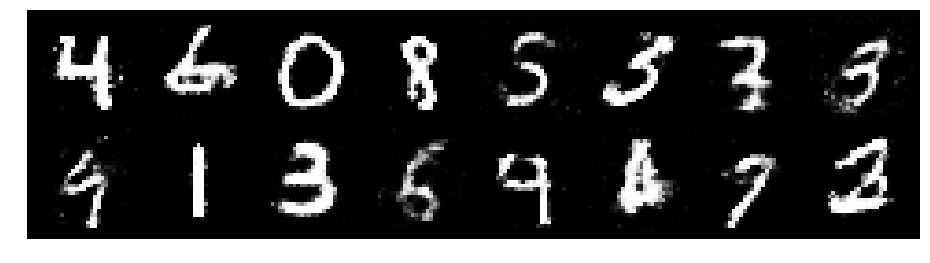

Epoch: [130/200], Batch Num: [200/600]
Discriminator Loss: 1.2772, Generator Loss: 0.8337
D(x): 0.5684, D(G(z)): 0.4735


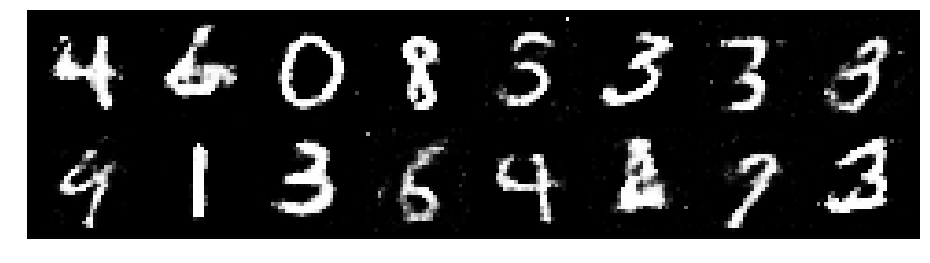

Epoch: [130/200], Batch Num: [300/600]
Discriminator Loss: 1.4106, Generator Loss: 0.8596
D(x): 0.5146, D(G(z)): 0.4658


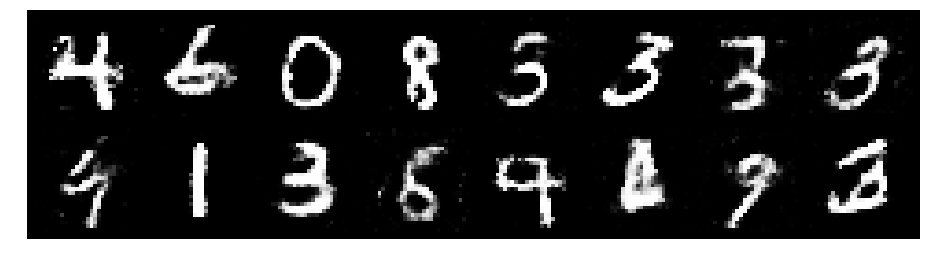

Epoch: [130/200], Batch Num: [400/600]
Discriminator Loss: 1.3149, Generator Loss: 0.8184
D(x): 0.5675, D(G(z)): 0.4816


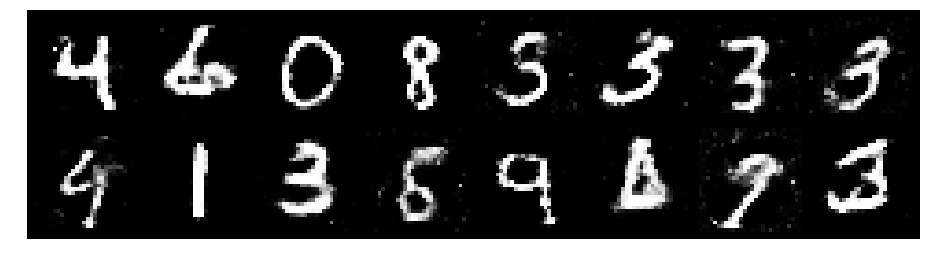

Epoch: [130/200], Batch Num: [500/600]
Discriminator Loss: 1.3195, Generator Loss: 0.9370
D(x): 0.5519, D(G(z)): 0.4461


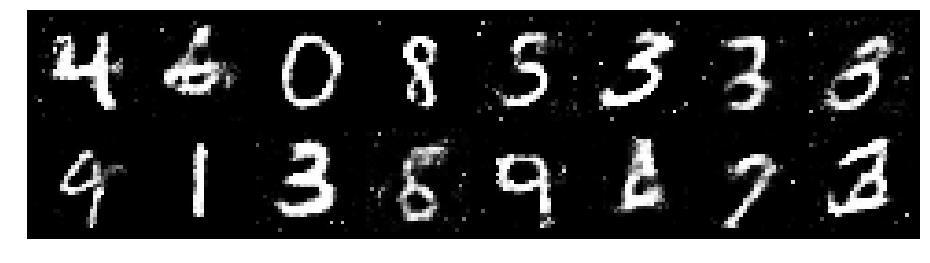

Epoch: [131/200], Batch Num: [0/600]
Discriminator Loss: 1.2891, Generator Loss: 0.8656
D(x): 0.5225, D(G(z)): 0.4367


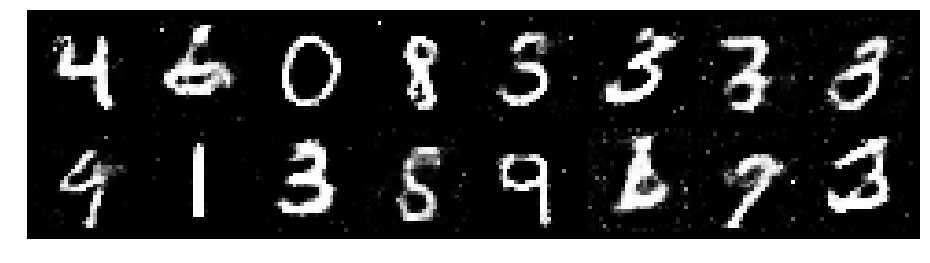

Epoch: [131/200], Batch Num: [100/600]
Discriminator Loss: 1.2629, Generator Loss: 0.8259
D(x): 0.5603, D(G(z)): 0.4431


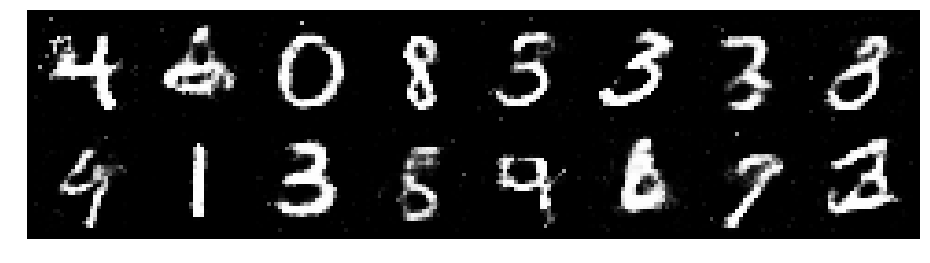

Epoch: [131/200], Batch Num: [200/600]
Discriminator Loss: 1.3738, Generator Loss: 0.8897
D(x): 0.5535, D(G(z)): 0.4849


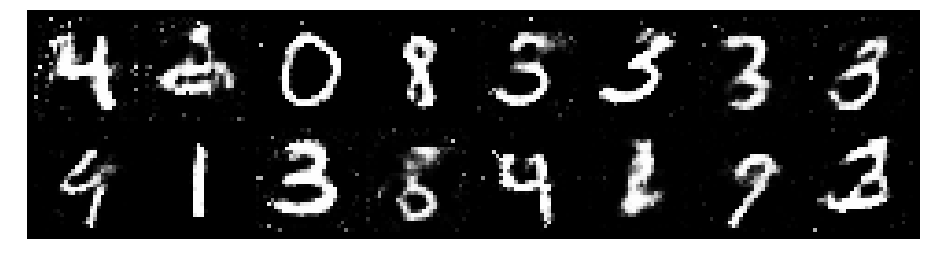

Epoch: [131/200], Batch Num: [300/600]
Discriminator Loss: 1.5042, Generator Loss: 0.8149
D(x): 0.5280, D(G(z)): 0.5215


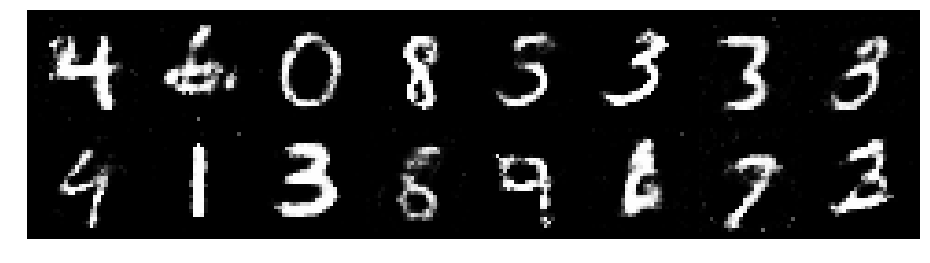

Epoch: [131/200], Batch Num: [400/600]
Discriminator Loss: 1.3449, Generator Loss: 0.8657
D(x): 0.5203, D(G(z)): 0.4422


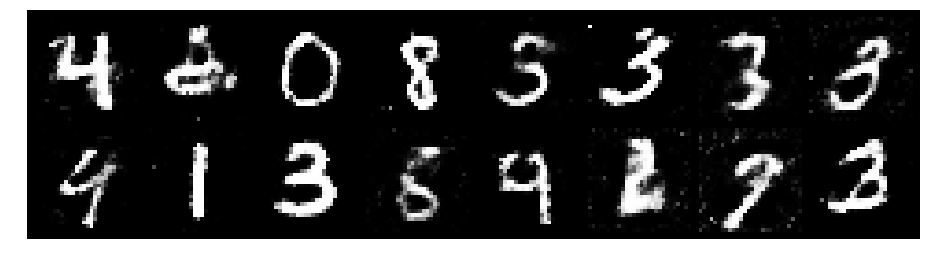

Epoch: [131/200], Batch Num: [500/600]
Discriminator Loss: 1.4441, Generator Loss: 0.9362
D(x): 0.4525, D(G(z)): 0.4234


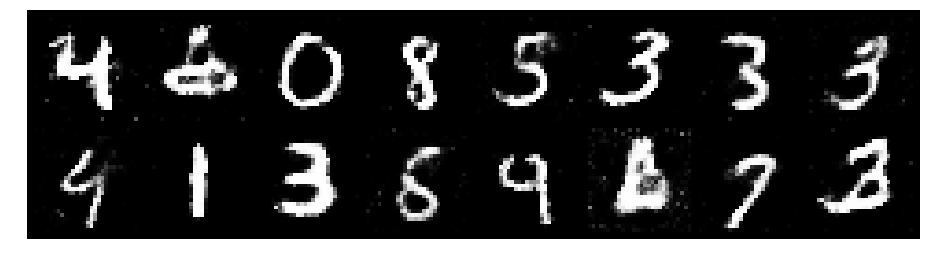

Epoch: [132/200], Batch Num: [0/600]
Discriminator Loss: 1.3900, Generator Loss: 0.9477
D(x): 0.5431, D(G(z)): 0.4785


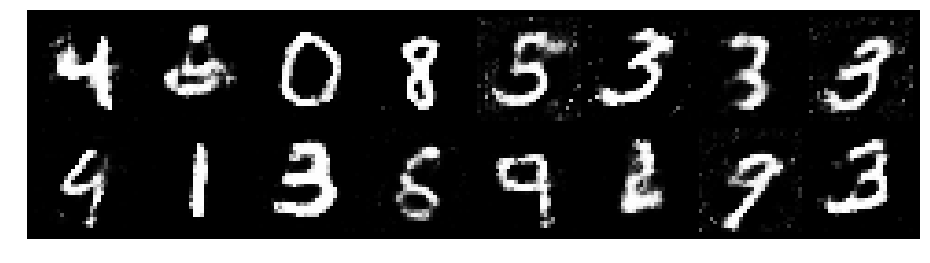

Epoch: [132/200], Batch Num: [100/600]
Discriminator Loss: 1.4205, Generator Loss: 0.7674
D(x): 0.5618, D(G(z)): 0.5106


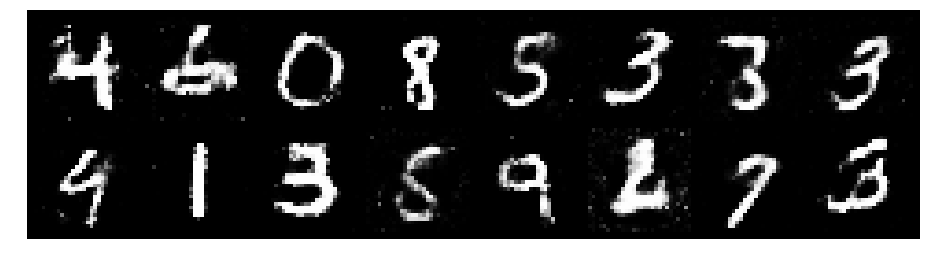

Epoch: [132/200], Batch Num: [200/600]
Discriminator Loss: 1.3216, Generator Loss: 1.0025
D(x): 0.5050, D(G(z)): 0.3975


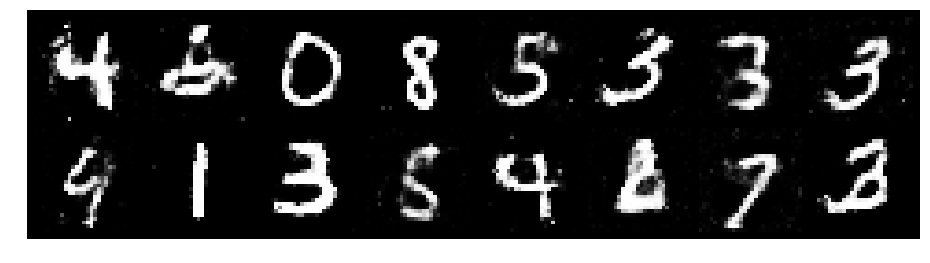

Epoch: [132/200], Batch Num: [300/600]
Discriminator Loss: 1.3458, Generator Loss: 0.9138
D(x): 0.5325, D(G(z)): 0.4539


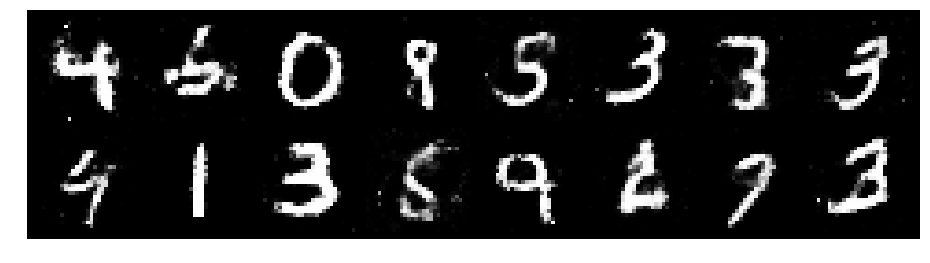

Epoch: [132/200], Batch Num: [400/600]
Discriminator Loss: 1.1868, Generator Loss: 0.9057
D(x): 0.5796, D(G(z)): 0.4407


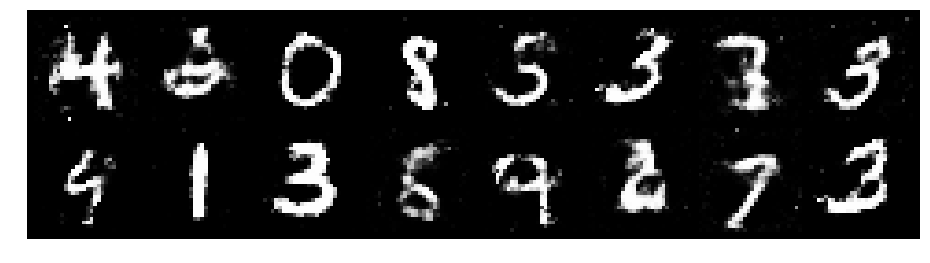

Epoch: [132/200], Batch Num: [500/600]
Discriminator Loss: 1.2422, Generator Loss: 0.8224
D(x): 0.5716, D(G(z)): 0.4621


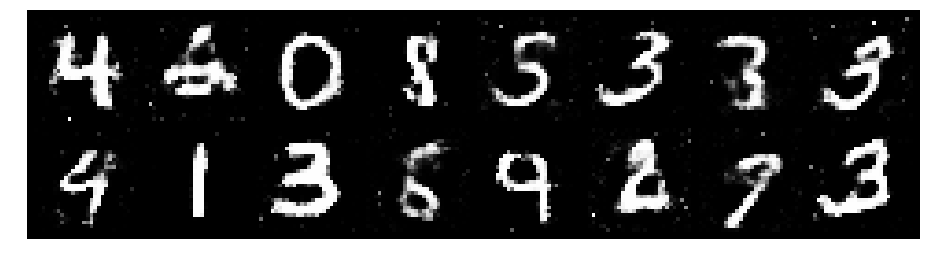

Epoch: [133/200], Batch Num: [0/600]
Discriminator Loss: 1.2837, Generator Loss: 0.8659
D(x): 0.5410, D(G(z)): 0.4466


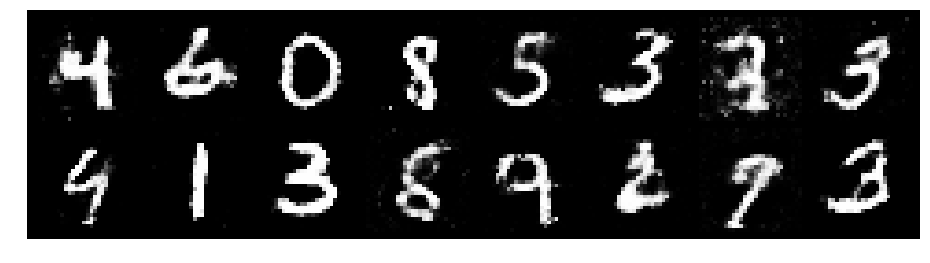

Epoch: [133/200], Batch Num: [100/600]
Discriminator Loss: 1.2162, Generator Loss: 0.7603
D(x): 0.5835, D(G(z)): 0.4594


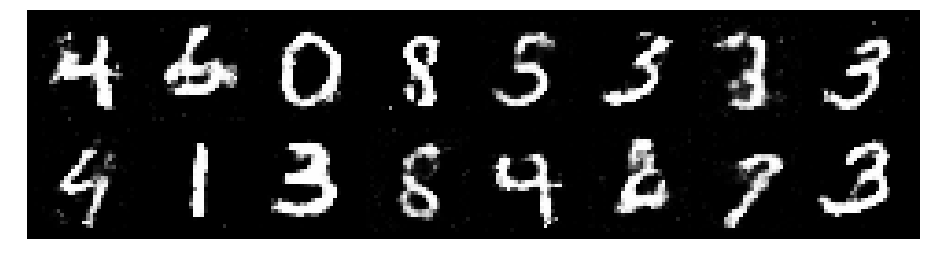

Epoch: [133/200], Batch Num: [200/600]
Discriminator Loss: 1.3176, Generator Loss: 0.8369
D(x): 0.5664, D(G(z)): 0.4788


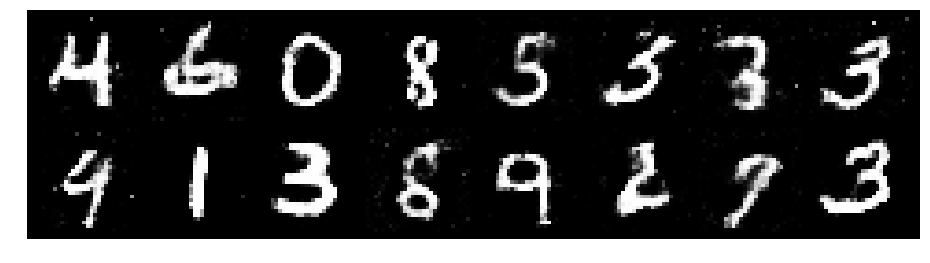

Epoch: [133/200], Batch Num: [300/600]
Discriminator Loss: 1.2437, Generator Loss: 0.8922
D(x): 0.5566, D(G(z)): 0.4400


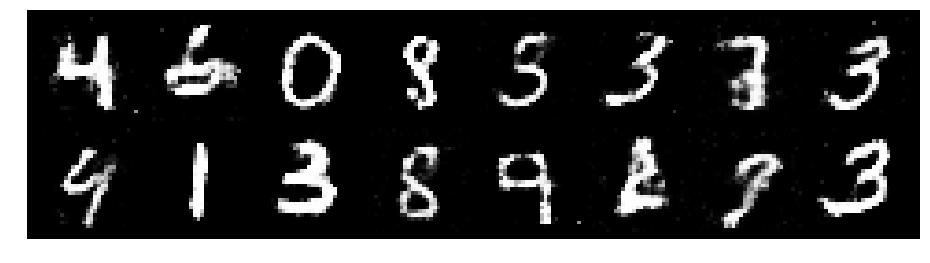

Epoch: [133/200], Batch Num: [400/600]
Discriminator Loss: 1.2712, Generator Loss: 0.9294
D(x): 0.5497, D(G(z)): 0.4209


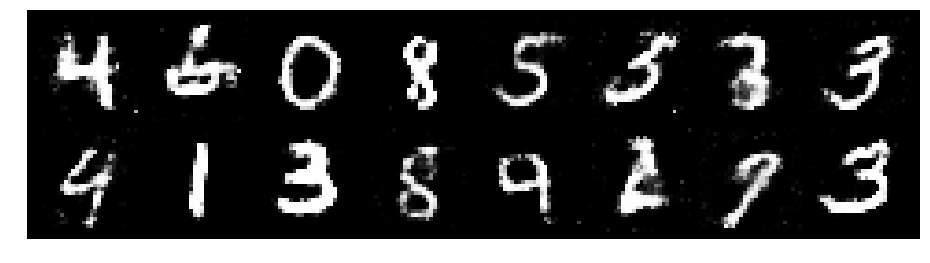

Epoch: [133/200], Batch Num: [500/600]
Discriminator Loss: 1.2310, Generator Loss: 0.9106
D(x): 0.6002, D(G(z)): 0.4561


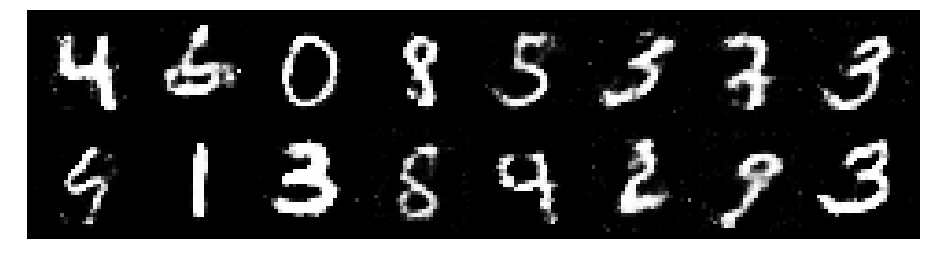

Epoch: [134/200], Batch Num: [0/600]
Discriminator Loss: 1.4070, Generator Loss: 0.8716
D(x): 0.5163, D(G(z)): 0.4572


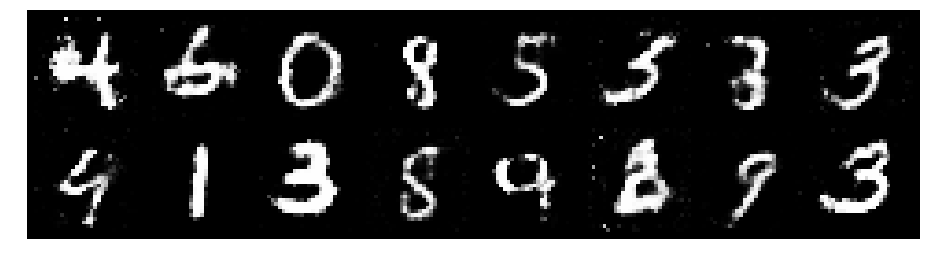

Epoch: [134/200], Batch Num: [100/600]
Discriminator Loss: 1.2975, Generator Loss: 0.9203
D(x): 0.5251, D(G(z)): 0.4443


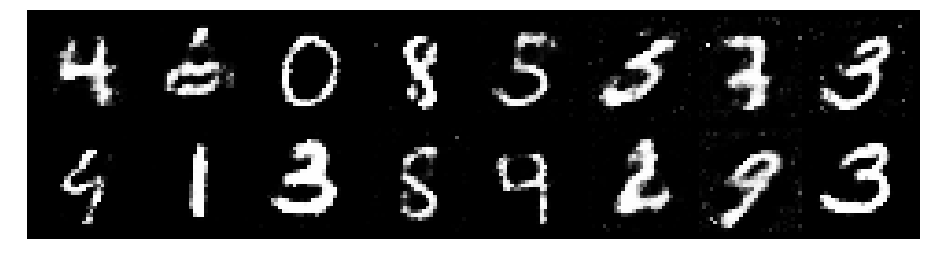

Epoch: [134/200], Batch Num: [200/600]
Discriminator Loss: 1.2457, Generator Loss: 0.9527
D(x): 0.5476, D(G(z)): 0.4248


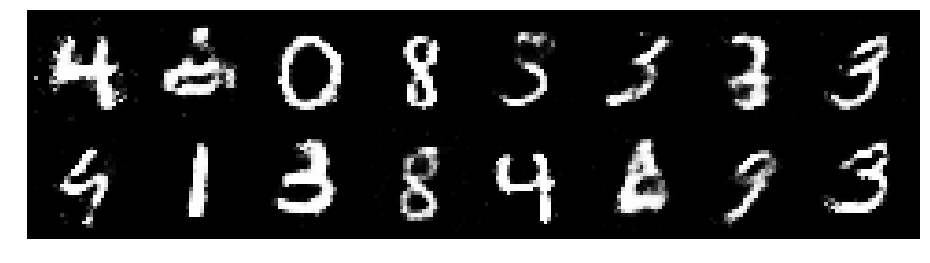

Epoch: [134/200], Batch Num: [300/600]
Discriminator Loss: 1.2066, Generator Loss: 1.0597
D(x): 0.5242, D(G(z)): 0.3787


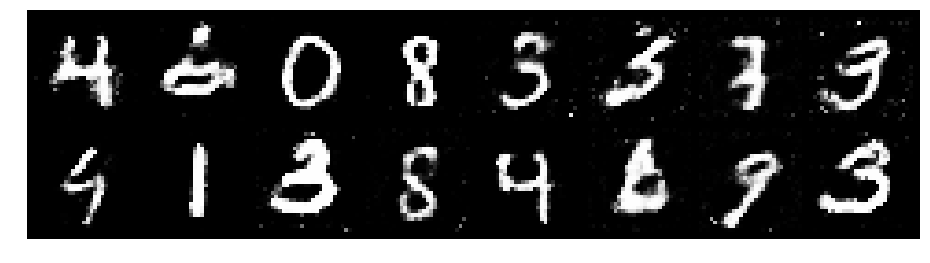

Epoch: [134/200], Batch Num: [400/600]
Discriminator Loss: 1.1830, Generator Loss: 1.0303
D(x): 0.5956, D(G(z)): 0.4103


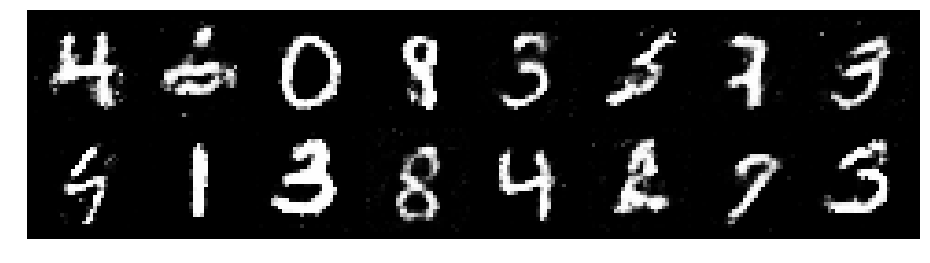

Epoch: [134/200], Batch Num: [500/600]
Discriminator Loss: 1.2918, Generator Loss: 0.9419
D(x): 0.5932, D(G(z)): 0.4687


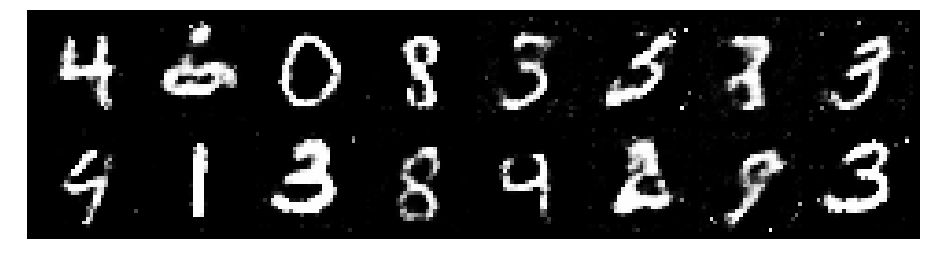

Epoch: [135/200], Batch Num: [0/600]
Discriminator Loss: 1.2931, Generator Loss: 0.8813
D(x): 0.5638, D(G(z)): 0.4760


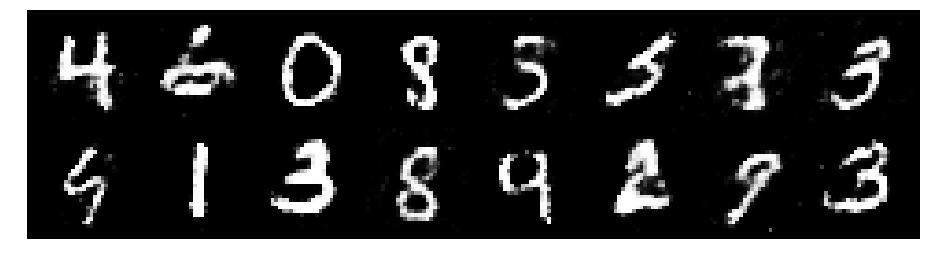

Epoch: [135/200], Batch Num: [100/600]
Discriminator Loss: 1.2719, Generator Loss: 0.8204
D(x): 0.5543, D(G(z)): 0.4492


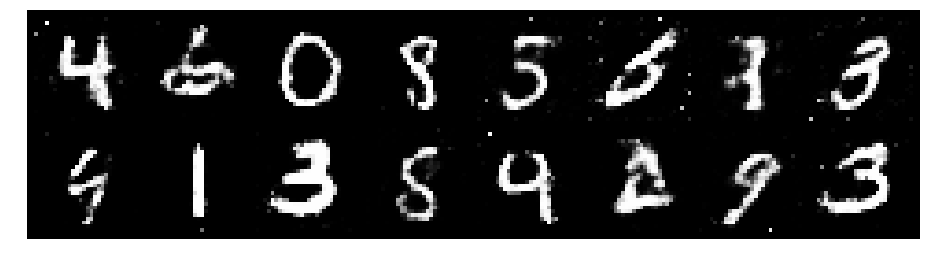

Epoch: [135/200], Batch Num: [200/600]
Discriminator Loss: 1.3655, Generator Loss: 0.9048
D(x): 0.5419, D(G(z)): 0.4576


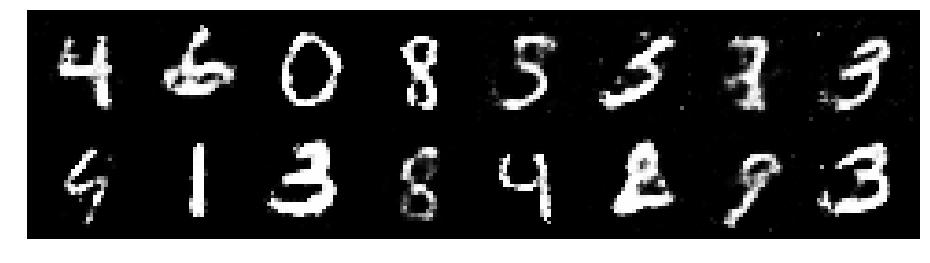

Epoch: [135/200], Batch Num: [300/600]
Discriminator Loss: 1.2822, Generator Loss: 0.9120
D(x): 0.5678, D(G(z)): 0.4556


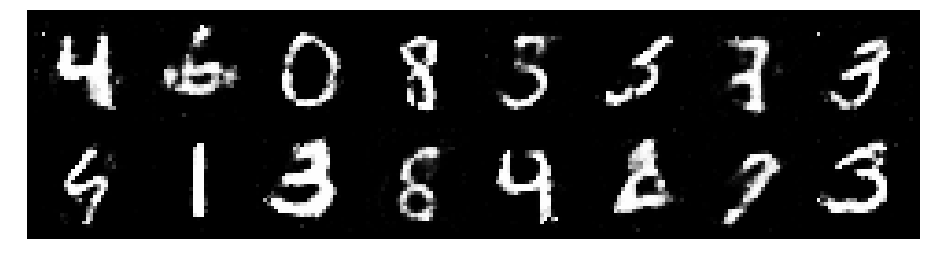

Epoch: [135/200], Batch Num: [400/600]
Discriminator Loss: 1.2500, Generator Loss: 0.9629
D(x): 0.5229, D(G(z)): 0.4082


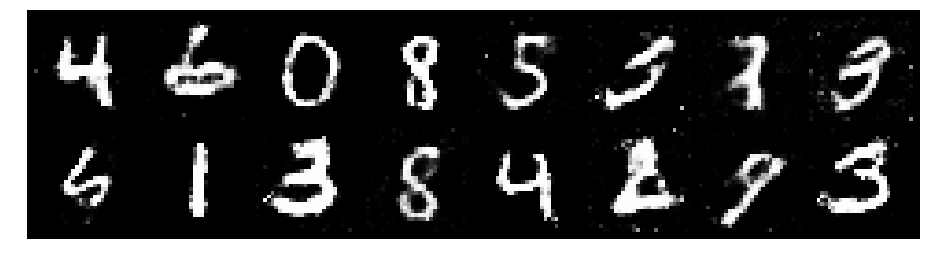

Epoch: [135/200], Batch Num: [500/600]
Discriminator Loss: 1.2677, Generator Loss: 0.9355
D(x): 0.5758, D(G(z)): 0.4546


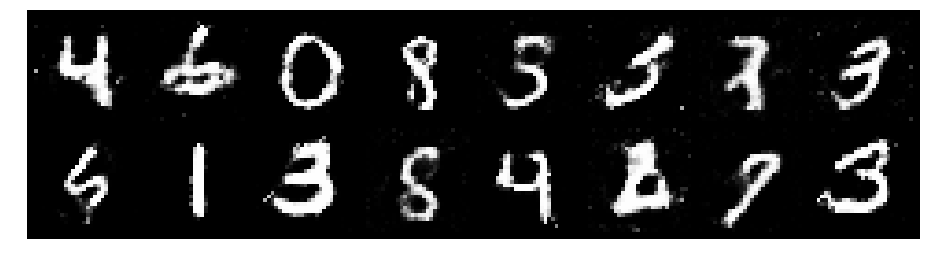

Epoch: [136/200], Batch Num: [0/600]
Discriminator Loss: 1.2438, Generator Loss: 0.9443
D(x): 0.5487, D(G(z)): 0.4246


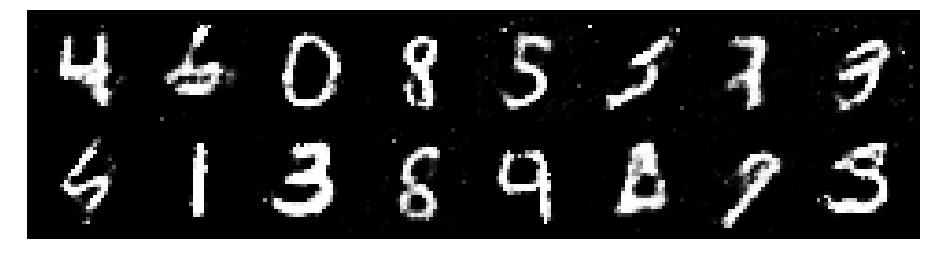

Epoch: [136/200], Batch Num: [100/600]
Discriminator Loss: 1.2301, Generator Loss: 0.8931
D(x): 0.5481, D(G(z)): 0.4288


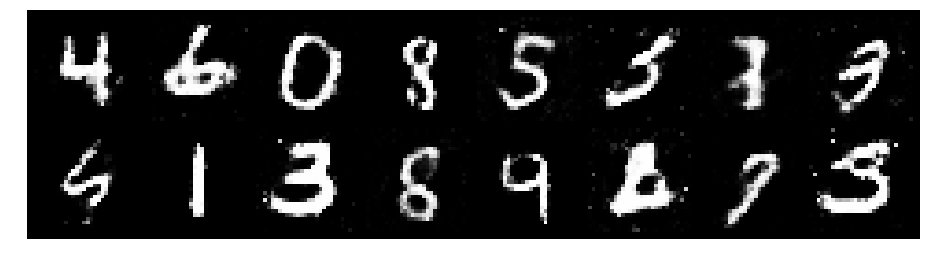

Epoch: [136/200], Batch Num: [200/600]
Discriminator Loss: 1.1685, Generator Loss: 0.9893
D(x): 0.5991, D(G(z)): 0.4121


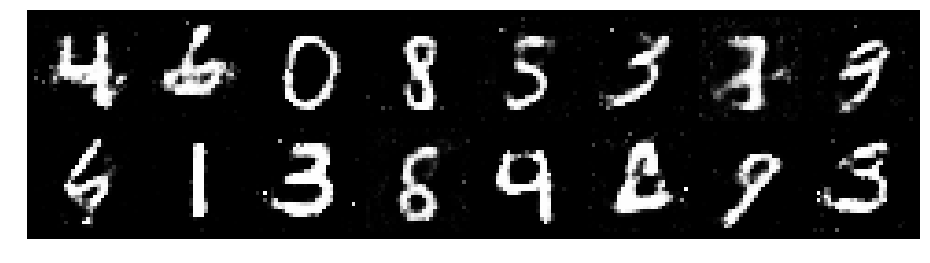

Epoch: [136/200], Batch Num: [300/600]
Discriminator Loss: 1.3201, Generator Loss: 0.9113
D(x): 0.5691, D(G(z)): 0.4700


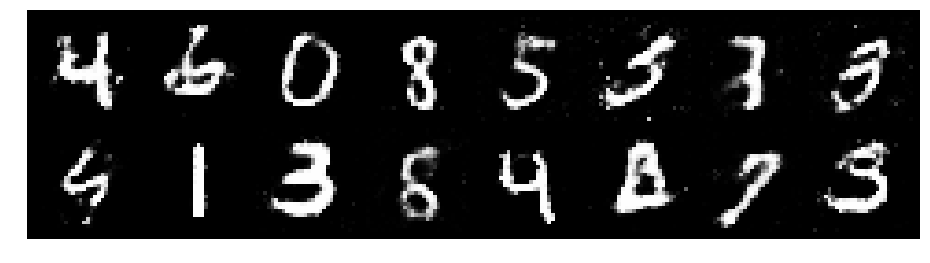

Epoch: [136/200], Batch Num: [400/600]
Discriminator Loss: 1.3688, Generator Loss: 0.7668
D(x): 0.4992, D(G(z)): 0.4358


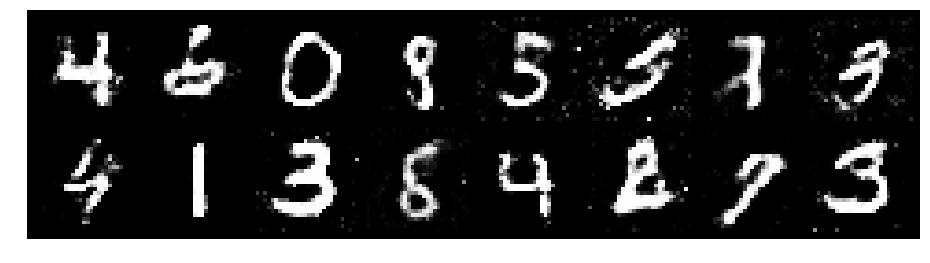

Epoch: [136/200], Batch Num: [500/600]
Discriminator Loss: 1.3157, Generator Loss: 0.7967
D(x): 0.5518, D(G(z)): 0.4734


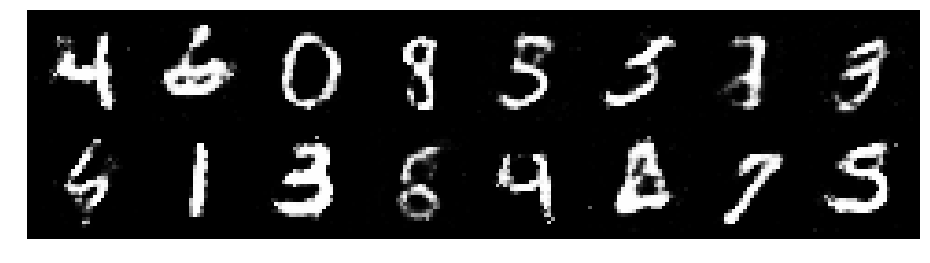

Epoch: [137/200], Batch Num: [0/600]
Discriminator Loss: 1.4668, Generator Loss: 0.9047
D(x): 0.5383, D(G(z)): 0.4872


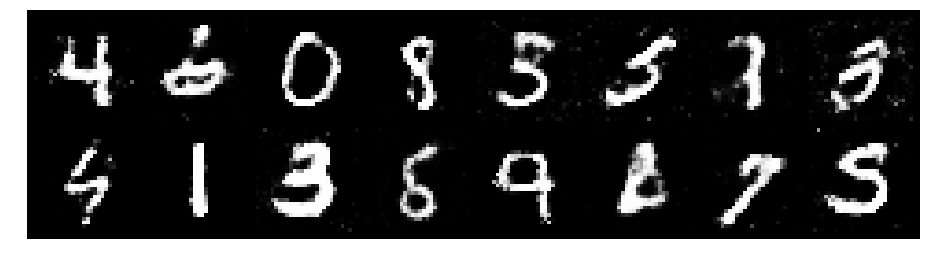

Epoch: [137/200], Batch Num: [100/600]
Discriminator Loss: 1.2473, Generator Loss: 0.8376
D(x): 0.5748, D(G(z)): 0.4462


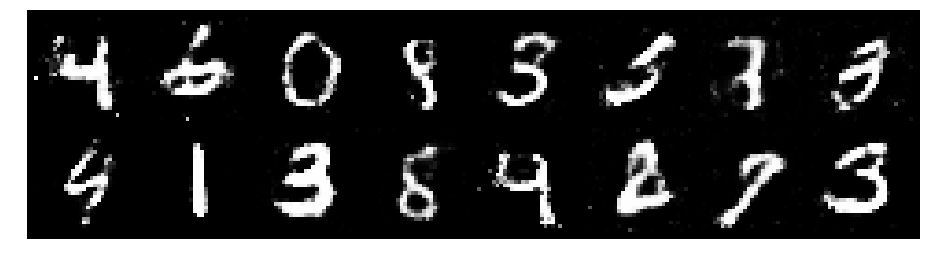

Epoch: [137/200], Batch Num: [200/600]
Discriminator Loss: 1.3303, Generator Loss: 0.7906
D(x): 0.5829, D(G(z)): 0.4984


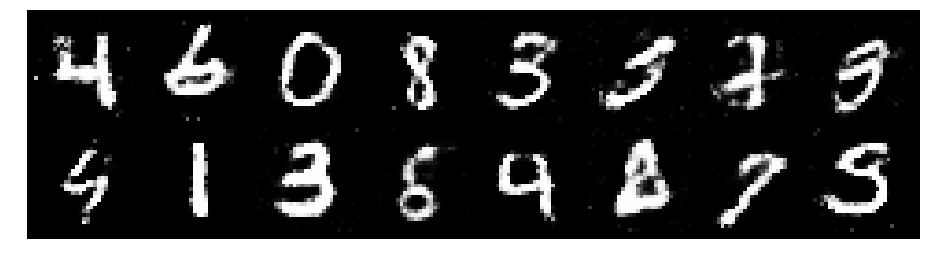

Epoch: [137/200], Batch Num: [300/600]
Discriminator Loss: 1.2408, Generator Loss: 0.9266
D(x): 0.5446, D(G(z)): 0.4154


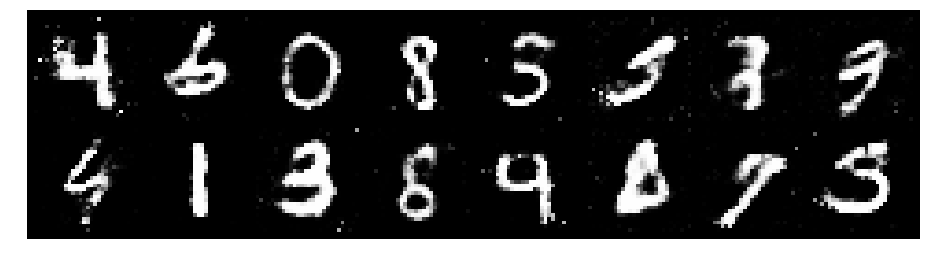

Epoch: [137/200], Batch Num: [400/600]
Discriminator Loss: 1.2360, Generator Loss: 0.8300
D(x): 0.5624, D(G(z)): 0.4450


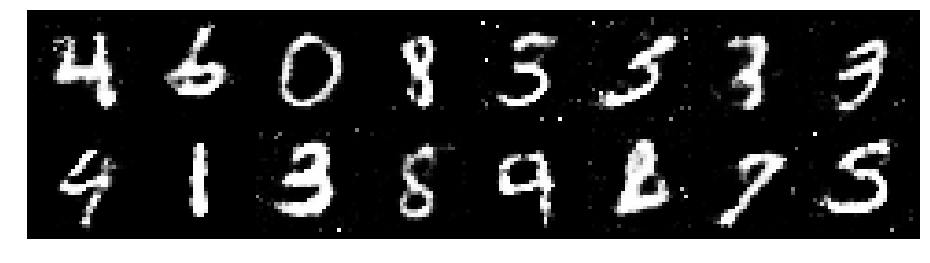

Epoch: [137/200], Batch Num: [500/600]
Discriminator Loss: 1.2522, Generator Loss: 0.9605
D(x): 0.5482, D(G(z)): 0.4235


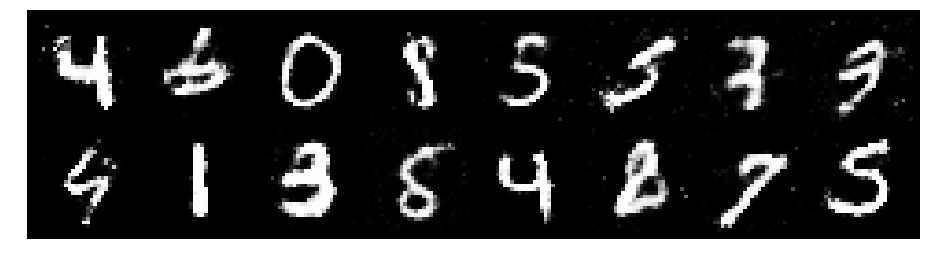

Epoch: [138/200], Batch Num: [0/600]
Discriminator Loss: 1.4371, Generator Loss: 0.8724
D(x): 0.5228, D(G(z)): 0.4642


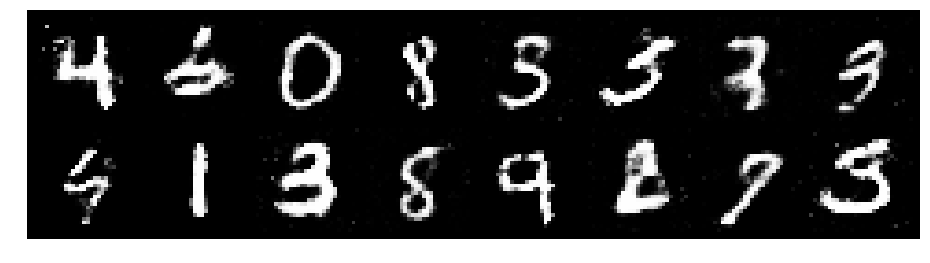

Epoch: [138/200], Batch Num: [100/600]
Discriminator Loss: 1.3431, Generator Loss: 0.8491
D(x): 0.5647, D(G(z)): 0.4820


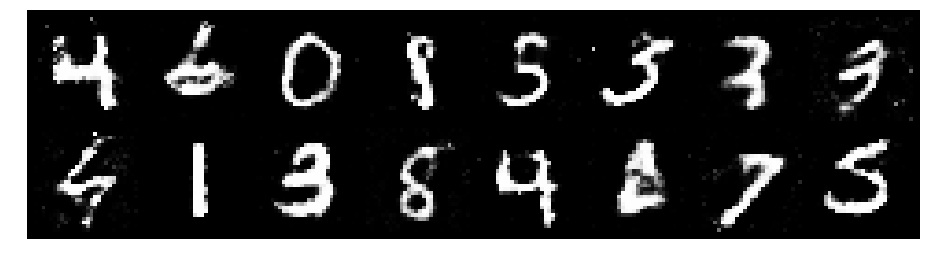

Epoch: [138/200], Batch Num: [200/600]
Discriminator Loss: 1.3608, Generator Loss: 0.7925
D(x): 0.5569, D(G(z)): 0.4873


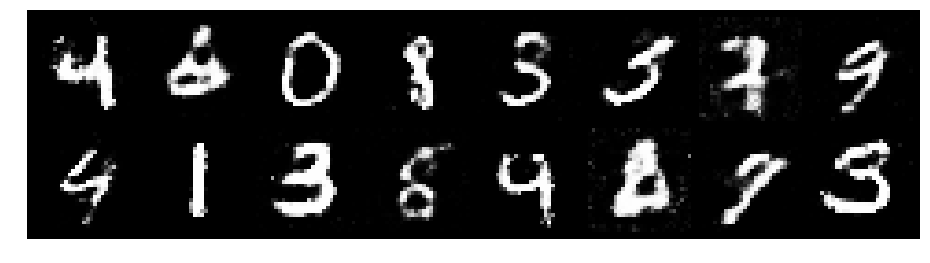

Epoch: [138/200], Batch Num: [300/600]
Discriminator Loss: 1.3053, Generator Loss: 1.0219
D(x): 0.5671, D(G(z)): 0.4610


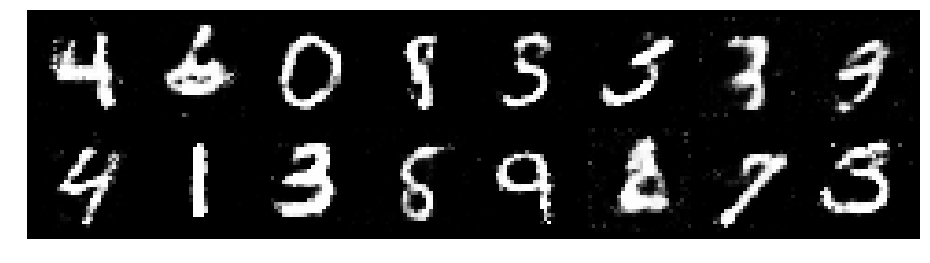

Epoch: [138/200], Batch Num: [400/600]
Discriminator Loss: 1.2075, Generator Loss: 0.9504
D(x): 0.5653, D(G(z)): 0.4154


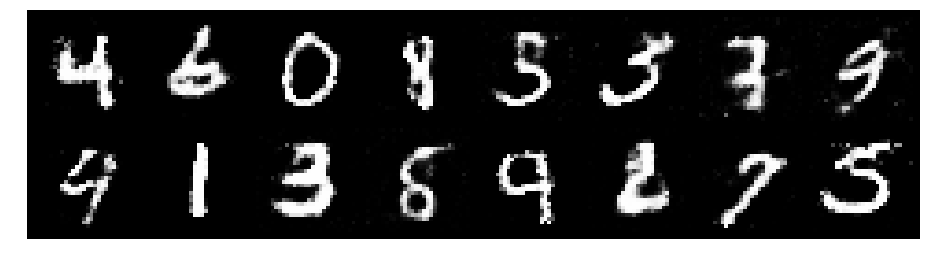

Epoch: [138/200], Batch Num: [500/600]
Discriminator Loss: 1.3380, Generator Loss: 1.0152
D(x): 0.5474, D(G(z)): 0.4314


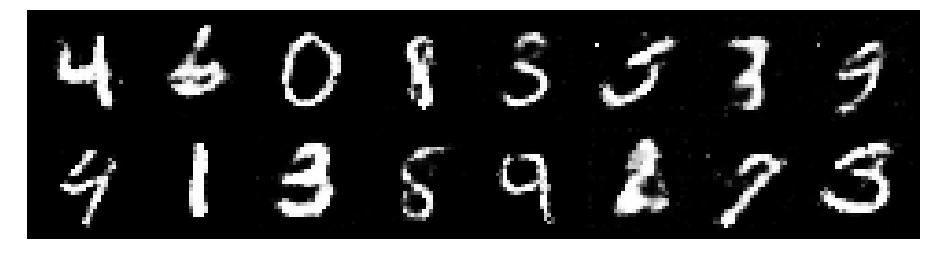

Epoch: [139/200], Batch Num: [0/600]
Discriminator Loss: 1.2858, Generator Loss: 0.7673
D(x): 0.5569, D(G(z)): 0.4583


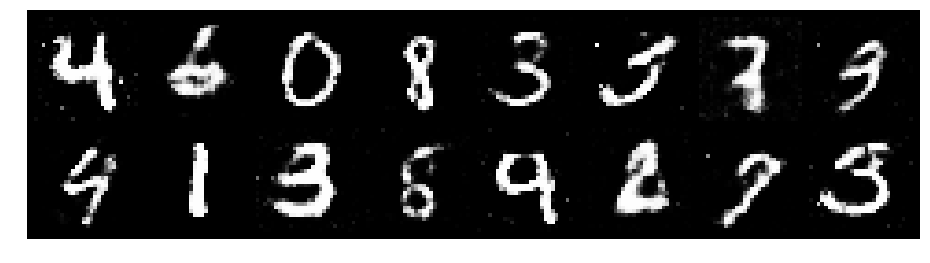

Epoch: [139/200], Batch Num: [100/600]
Discriminator Loss: 1.3549, Generator Loss: 0.7328
D(x): 0.6050, D(G(z)): 0.5060


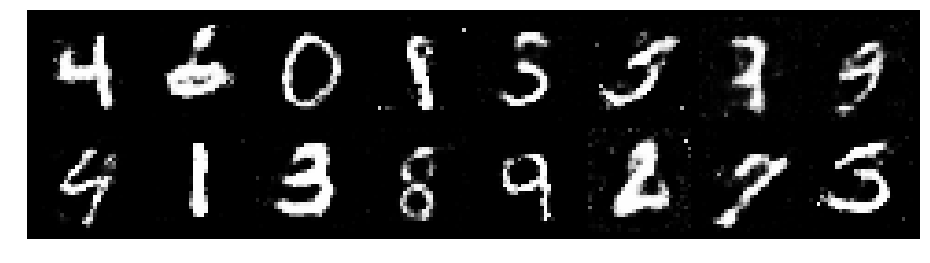

Epoch: [139/200], Batch Num: [200/600]
Discriminator Loss: 1.3517, Generator Loss: 0.8867
D(x): 0.5267, D(G(z)): 0.4349


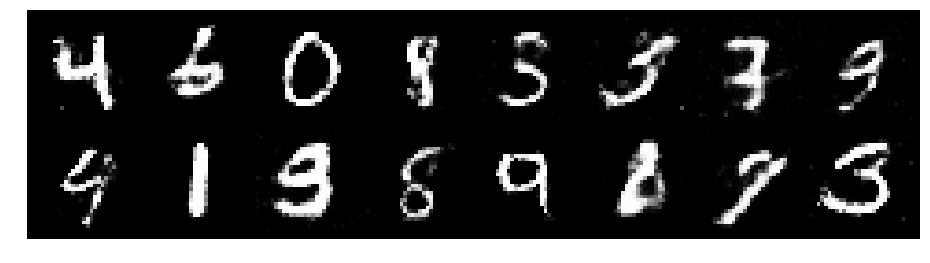

Epoch: [139/200], Batch Num: [300/600]
Discriminator Loss: 1.2871, Generator Loss: 0.7826
D(x): 0.5672, D(G(z)): 0.4750


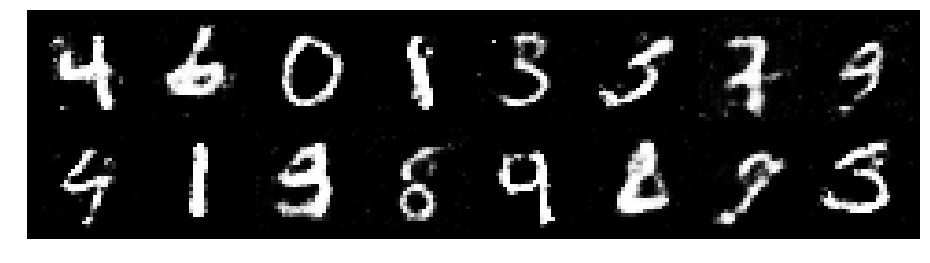

Epoch: [139/200], Batch Num: [400/600]
Discriminator Loss: 1.3254, Generator Loss: 0.7552
D(x): 0.5381, D(G(z)): 0.4628


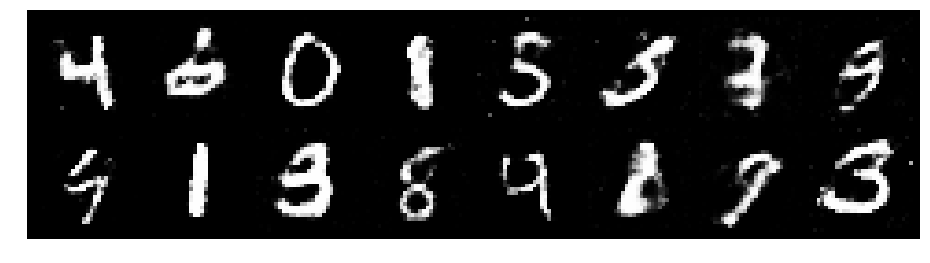

Epoch: [139/200], Batch Num: [500/600]
Discriminator Loss: 1.2397, Generator Loss: 0.7575
D(x): 0.5759, D(G(z)): 0.4658


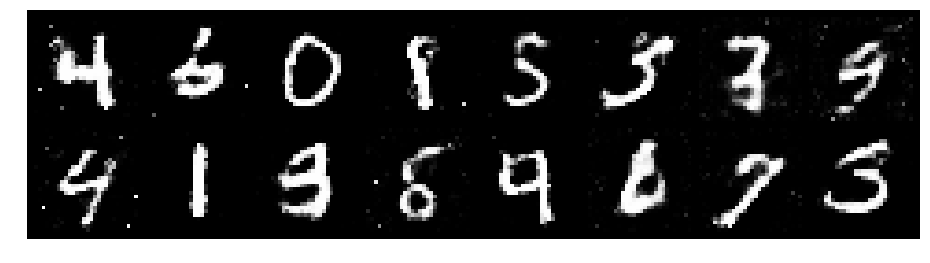

Epoch: [140/200], Batch Num: [0/600]
Discriminator Loss: 1.2398, Generator Loss: 0.9397
D(x): 0.5517, D(G(z)): 0.4266


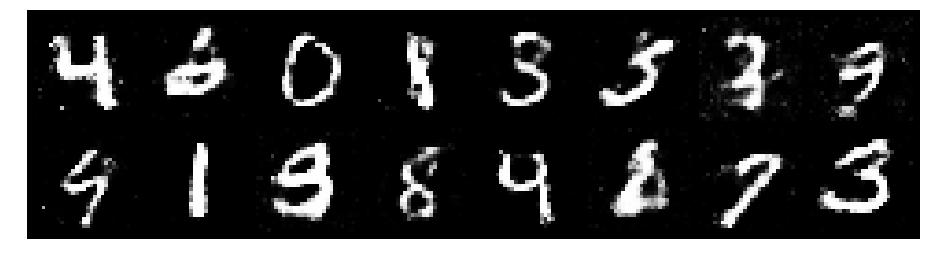

Epoch: [140/200], Batch Num: [100/600]
Discriminator Loss: 1.3715, Generator Loss: 0.7962
D(x): 0.5415, D(G(z)): 0.4711


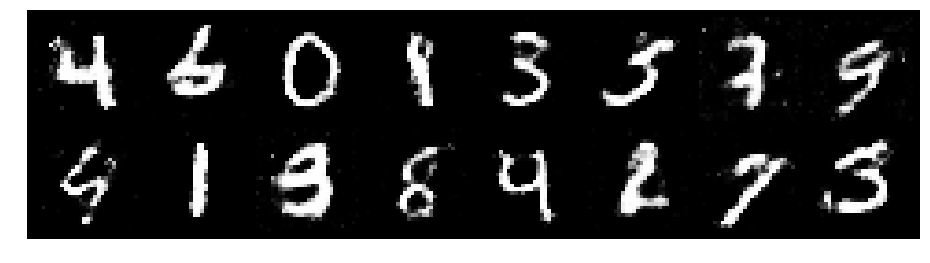

Epoch: [140/200], Batch Num: [200/600]
Discriminator Loss: 1.3973, Generator Loss: 0.8050
D(x): 0.5234, D(G(z)): 0.4872


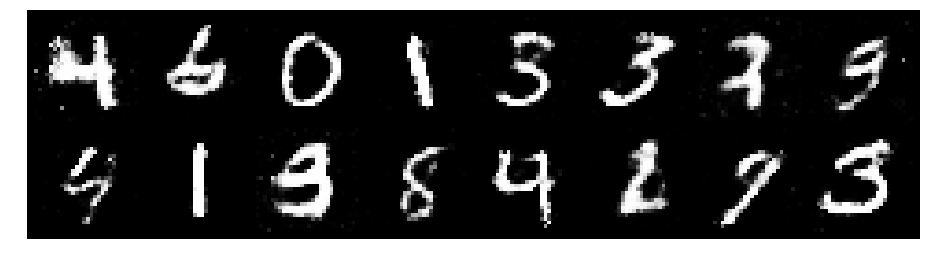

Epoch: [140/200], Batch Num: [300/600]
Discriminator Loss: 1.3377, Generator Loss: 0.9576
D(x): 0.5120, D(G(z)): 0.4176


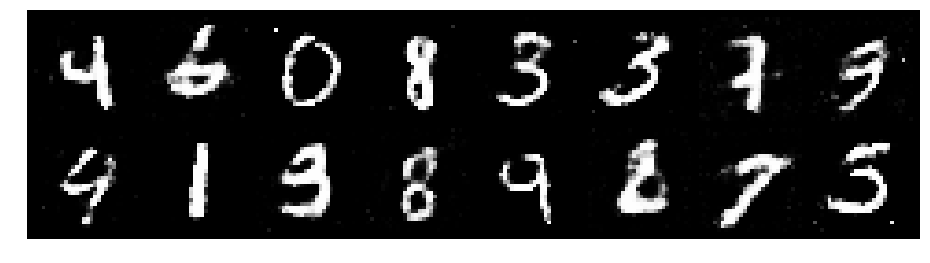

Epoch: [140/200], Batch Num: [400/600]
Discriminator Loss: 1.2138, Generator Loss: 0.9902
D(x): 0.5576, D(G(z)): 0.4080


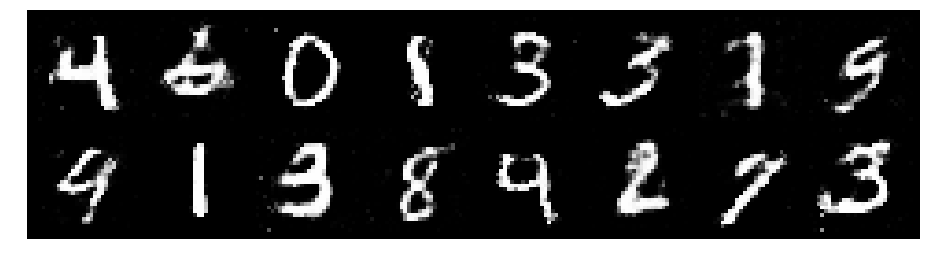

Epoch: [140/200], Batch Num: [500/600]
Discriminator Loss: 1.3648, Generator Loss: 0.9986
D(x): 0.4792, D(G(z)): 0.4035


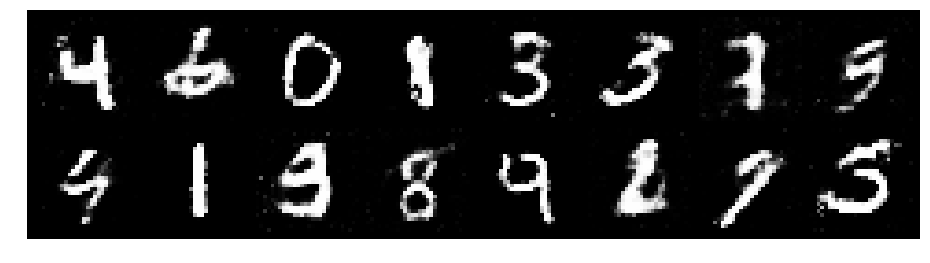

Epoch: [141/200], Batch Num: [0/600]
Discriminator Loss: 1.2972, Generator Loss: 0.9231
D(x): 0.5921, D(G(z)): 0.4692


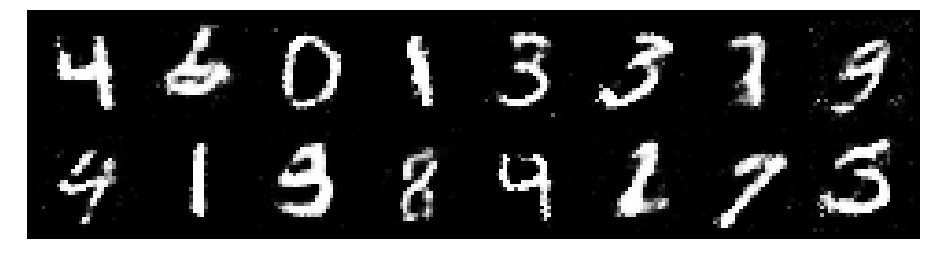

Epoch: [141/200], Batch Num: [100/600]
Discriminator Loss: 1.2455, Generator Loss: 0.8130
D(x): 0.5532, D(G(z)): 0.4373


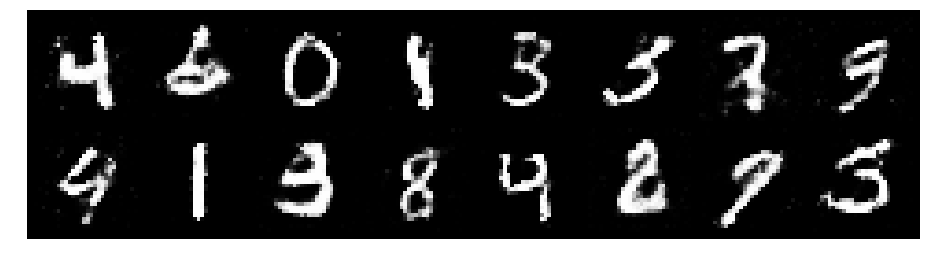

Epoch: [141/200], Batch Num: [200/600]
Discriminator Loss: 1.2909, Generator Loss: 0.9088
D(x): 0.5508, D(G(z)): 0.4543


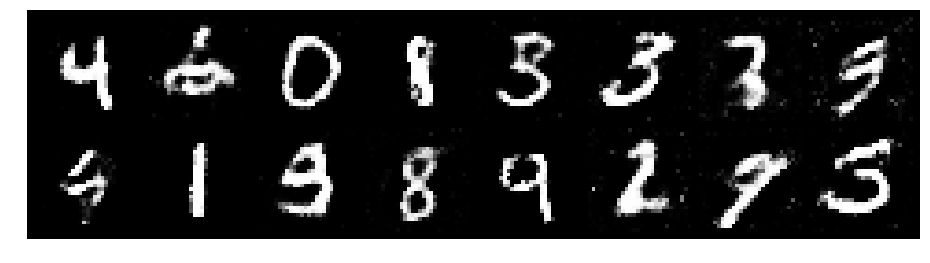

Epoch: [141/200], Batch Num: [300/600]
Discriminator Loss: 1.1367, Generator Loss: 0.8850
D(x): 0.5917, D(G(z)): 0.4232


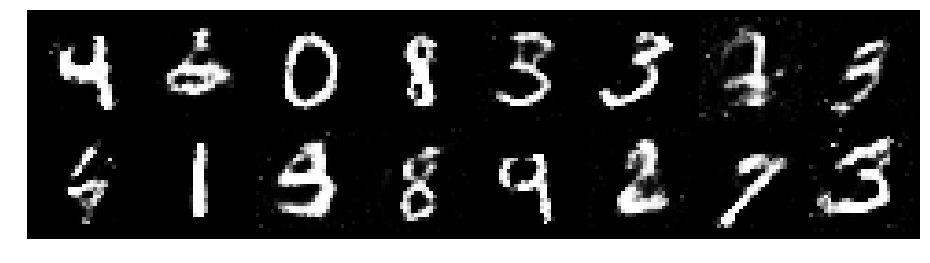

Epoch: [141/200], Batch Num: [400/600]
Discriminator Loss: 1.2589, Generator Loss: 0.8365
D(x): 0.5561, D(G(z)): 0.4440


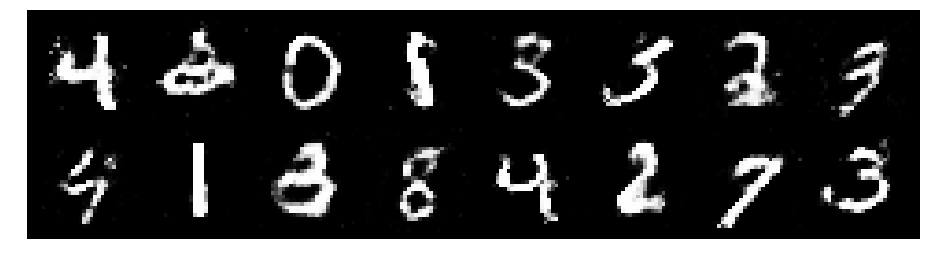

Epoch: [141/200], Batch Num: [500/600]
Discriminator Loss: 1.3961, Generator Loss: 0.7997
D(x): 0.5018, D(G(z)): 0.4813


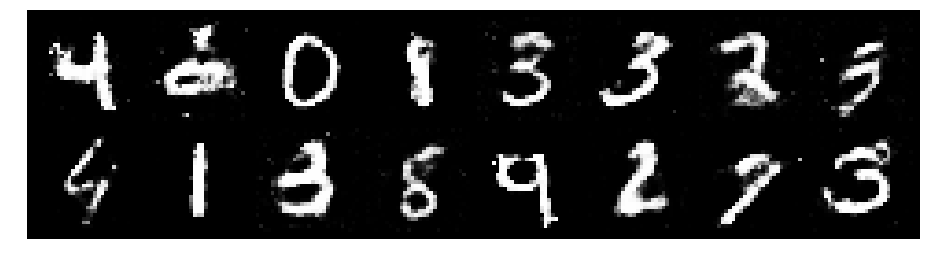

Epoch: [142/200], Batch Num: [0/600]
Discriminator Loss: 1.3194, Generator Loss: 0.7727
D(x): 0.5477, D(G(z)): 0.4656


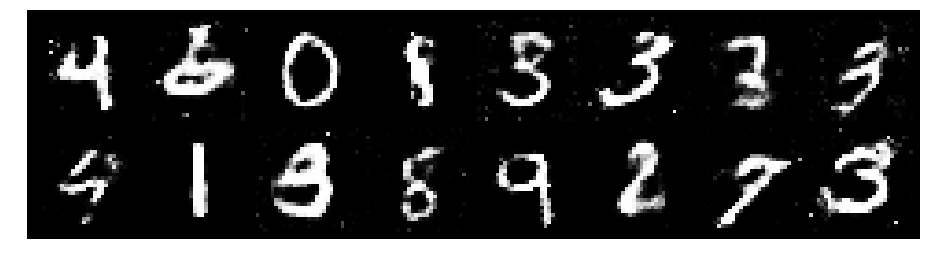

Epoch: [142/200], Batch Num: [100/600]
Discriminator Loss: 1.3425, Generator Loss: 1.0064
D(x): 0.4907, D(G(z)): 0.3865


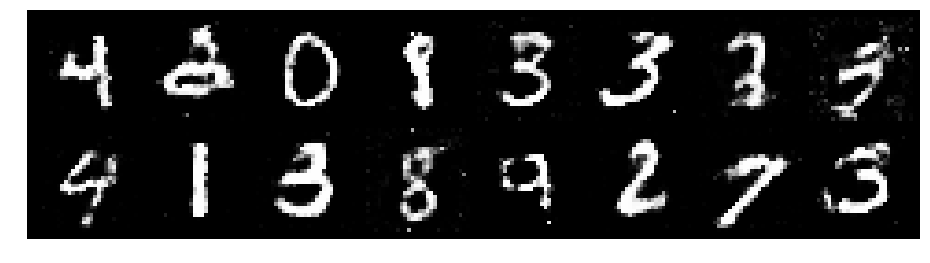

Epoch: [142/200], Batch Num: [200/600]
Discriminator Loss: 1.1816, Generator Loss: 0.9601
D(x): 0.5376, D(G(z)): 0.3768


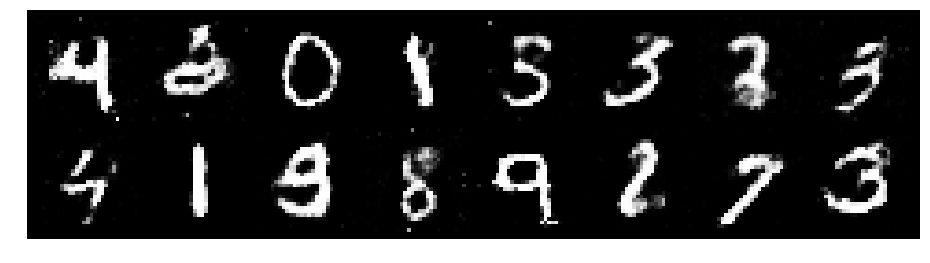

Epoch: [142/200], Batch Num: [300/600]
Discriminator Loss: 1.1858, Generator Loss: 1.0271
D(x): 0.5405, D(G(z)): 0.3797


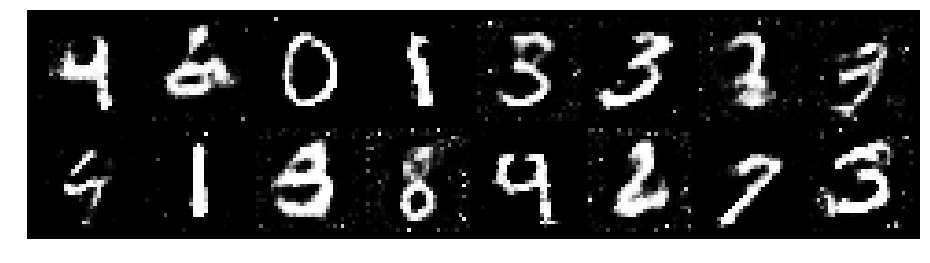

Epoch: [142/200], Batch Num: [400/600]
Discriminator Loss: 1.2889, Generator Loss: 0.8929
D(x): 0.5689, D(G(z)): 0.4611


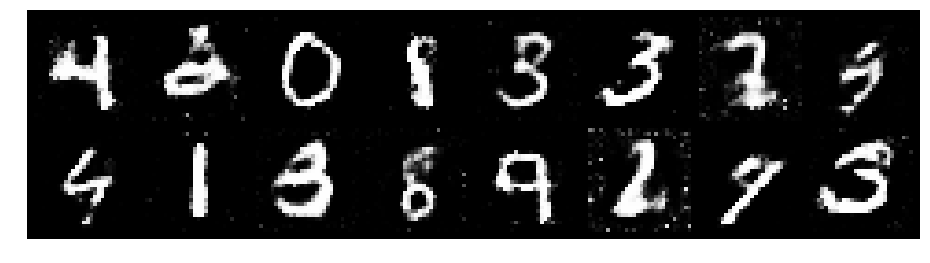

Epoch: [142/200], Batch Num: [500/600]
Discriminator Loss: 1.2403, Generator Loss: 0.8562
D(x): 0.5957, D(G(z)): 0.4648


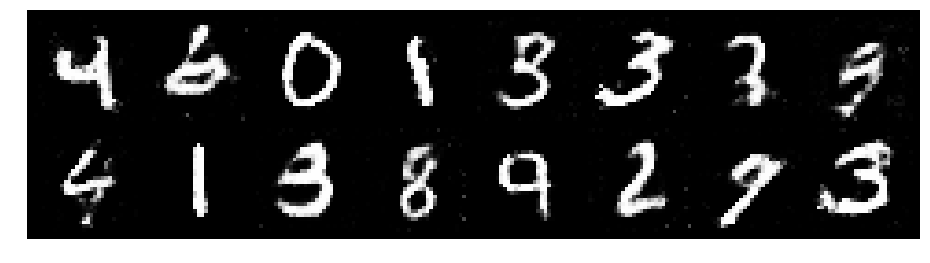

Epoch: [143/200], Batch Num: [0/600]
Discriminator Loss: 1.1721, Generator Loss: 1.1404
D(x): 0.5649, D(G(z)): 0.3854


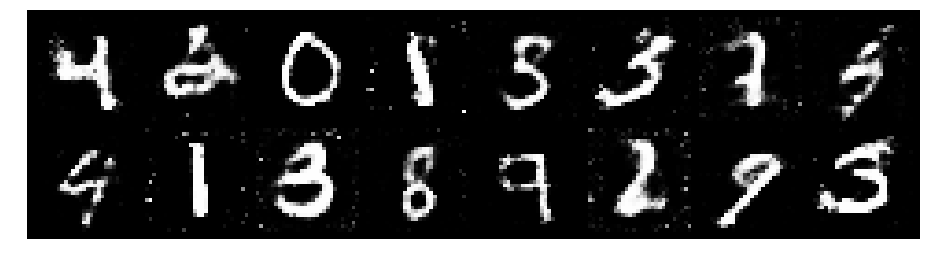

Epoch: [143/200], Batch Num: [100/600]
Discriminator Loss: 1.2847, Generator Loss: 0.9420
D(x): 0.5115, D(G(z)): 0.4129


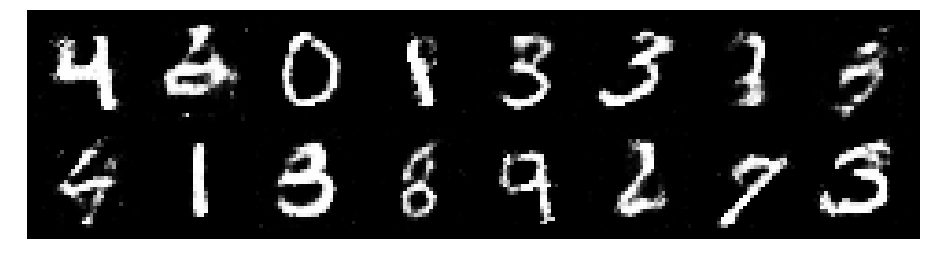

Epoch: [143/200], Batch Num: [200/600]
Discriminator Loss: 1.3172, Generator Loss: 0.8412
D(x): 0.5438, D(G(z)): 0.4548


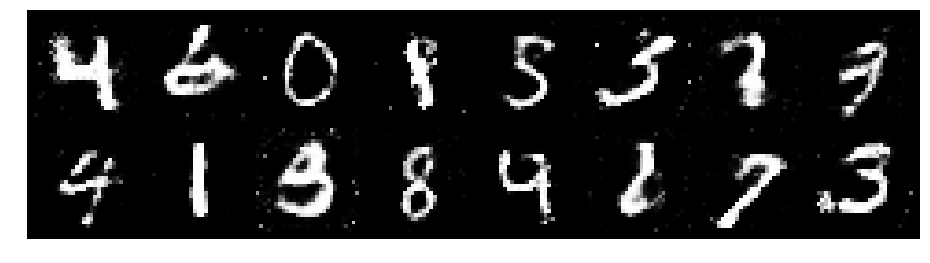

Epoch: [143/200], Batch Num: [300/600]
Discriminator Loss: 1.3009, Generator Loss: 0.9498
D(x): 0.5100, D(G(z)): 0.4115


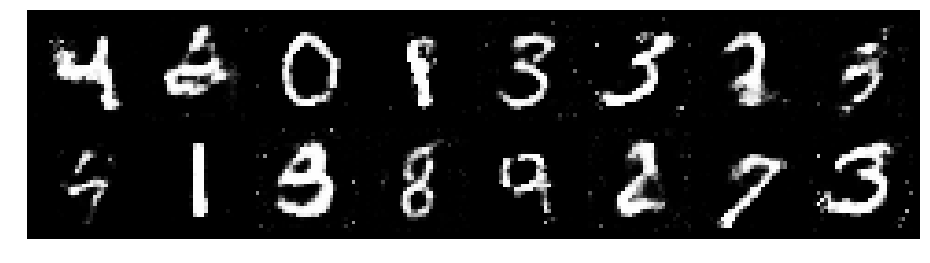

Epoch: [143/200], Batch Num: [400/600]
Discriminator Loss: 1.2480, Generator Loss: 0.8347
D(x): 0.5493, D(G(z)): 0.4334


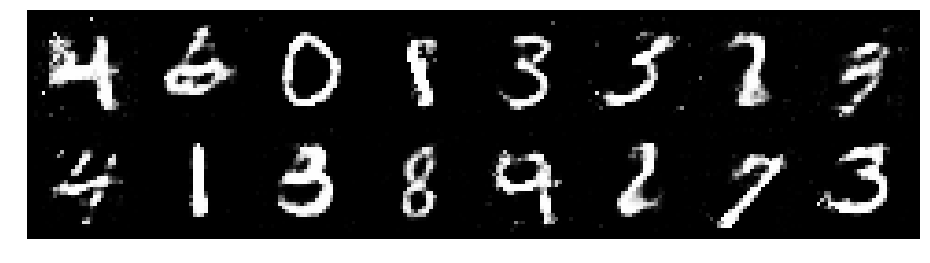

Epoch: [143/200], Batch Num: [500/600]
Discriminator Loss: 1.3601, Generator Loss: 1.1533
D(x): 0.5301, D(G(z)): 0.4220


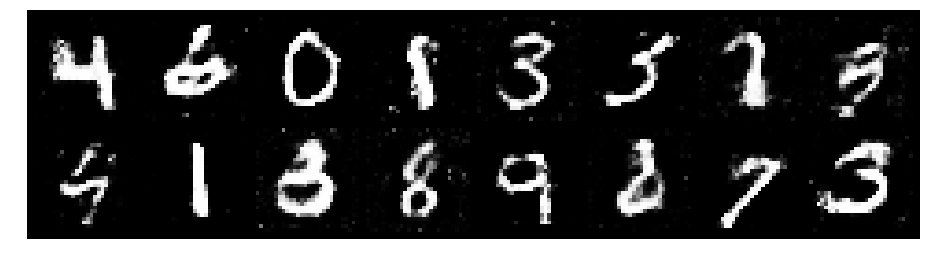

Epoch: [144/200], Batch Num: [0/600]
Discriminator Loss: 1.2769, Generator Loss: 1.0112
D(x): 0.5947, D(G(z)): 0.4445


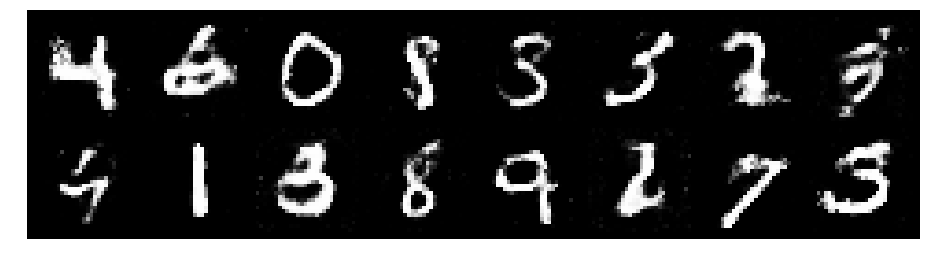

Epoch: [144/200], Batch Num: [100/600]
Discriminator Loss: 1.3498, Generator Loss: 0.9210
D(x): 0.5325, D(G(z)): 0.4607


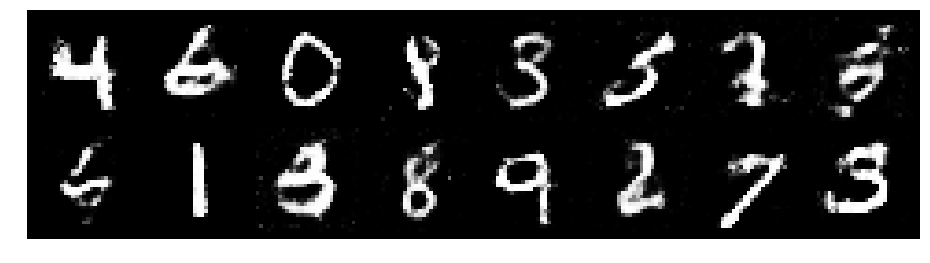

Epoch: [144/200], Batch Num: [200/600]
Discriminator Loss: 1.2395, Generator Loss: 0.8992
D(x): 0.6048, D(G(z)): 0.4454


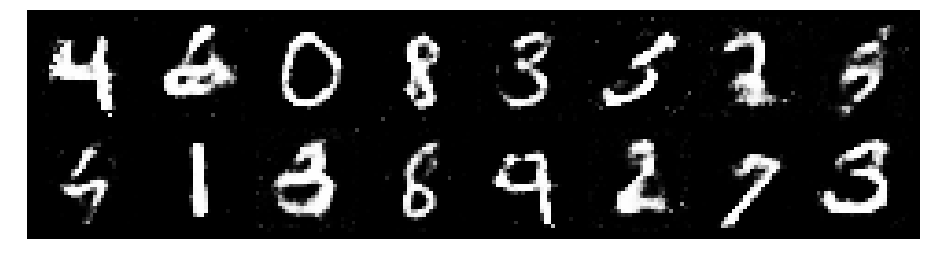

Epoch: [144/200], Batch Num: [300/600]
Discriminator Loss: 1.2176, Generator Loss: 0.9215
D(x): 0.5847, D(G(z)): 0.4442


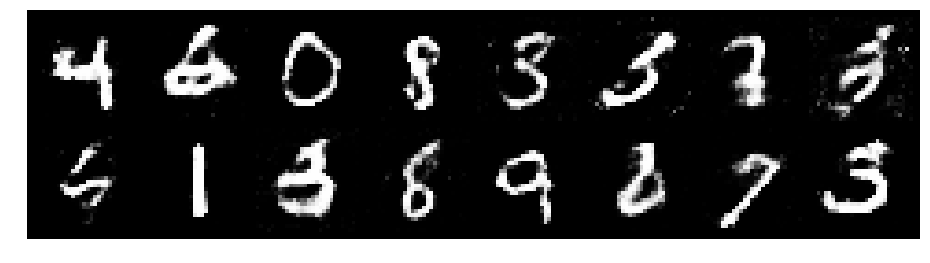

Epoch: [144/200], Batch Num: [400/600]
Discriminator Loss: 1.2105, Generator Loss: 0.8743
D(x): 0.5532, D(G(z)): 0.4182


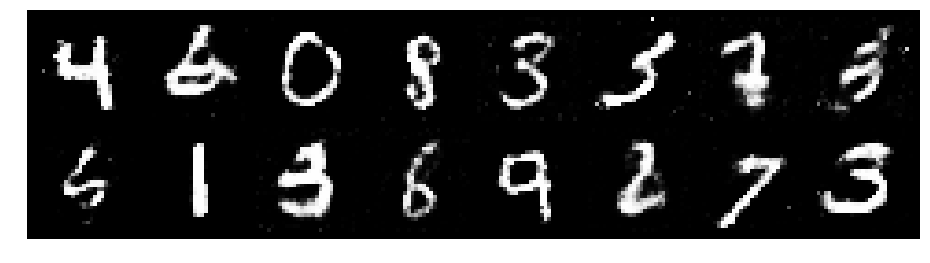

Epoch: [144/200], Batch Num: [500/600]
Discriminator Loss: 1.2504, Generator Loss: 0.8467
D(x): 0.5738, D(G(z)): 0.4486


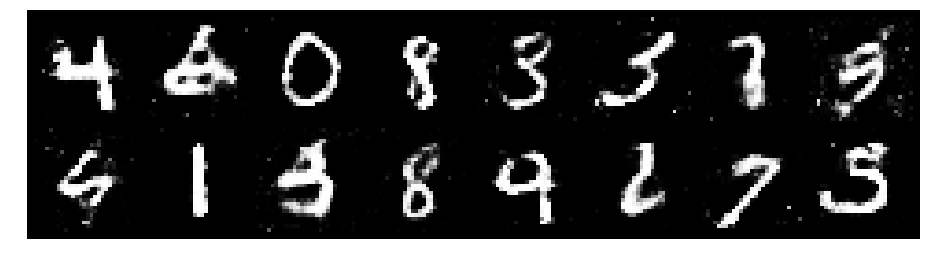

Epoch: [145/200], Batch Num: [0/600]
Discriminator Loss: 1.2247, Generator Loss: 1.0387
D(x): 0.5549, D(G(z)): 0.4046


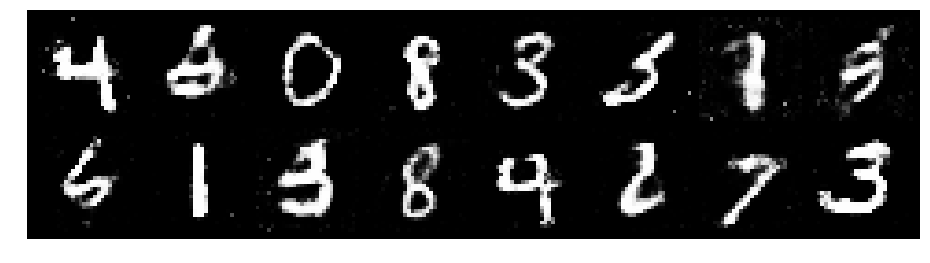

Epoch: [145/200], Batch Num: [100/600]
Discriminator Loss: 1.1356, Generator Loss: 0.8721
D(x): 0.6008, D(G(z)): 0.4056


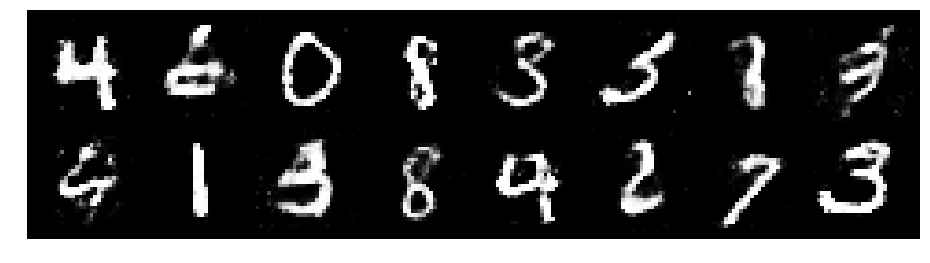

Epoch: [145/200], Batch Num: [200/600]
Discriminator Loss: 1.2568, Generator Loss: 0.9664
D(x): 0.5757, D(G(z)): 0.4571


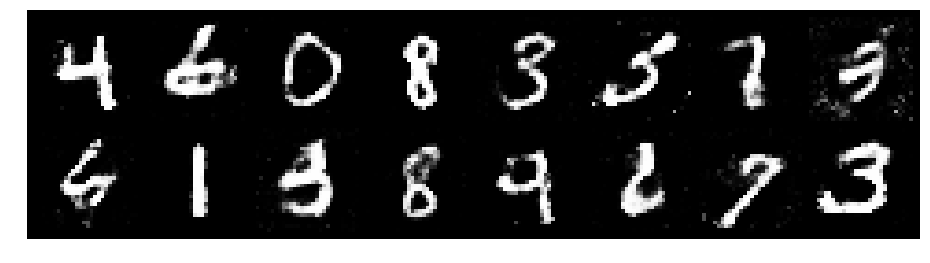

Epoch: [145/200], Batch Num: [300/600]
Discriminator Loss: 1.3234, Generator Loss: 0.8665
D(x): 0.5752, D(G(z)): 0.4820


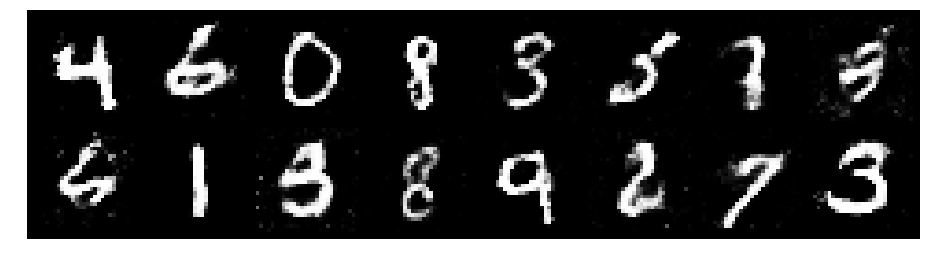

Epoch: [145/200], Batch Num: [400/600]
Discriminator Loss: 1.2186, Generator Loss: 0.9600
D(x): 0.5778, D(G(z)): 0.4321


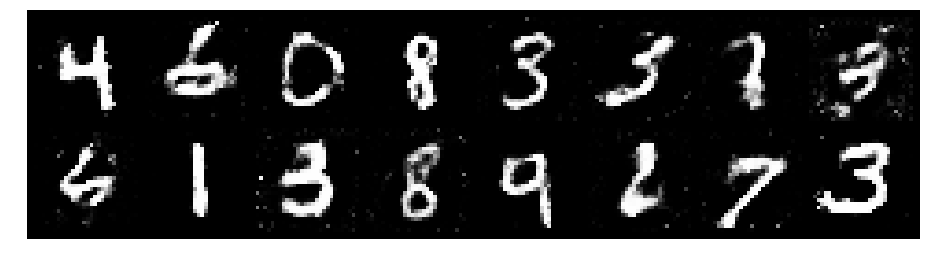

Epoch: [145/200], Batch Num: [500/600]
Discriminator Loss: 1.2560, Generator Loss: 0.8354
D(x): 0.5537, D(G(z)): 0.4471


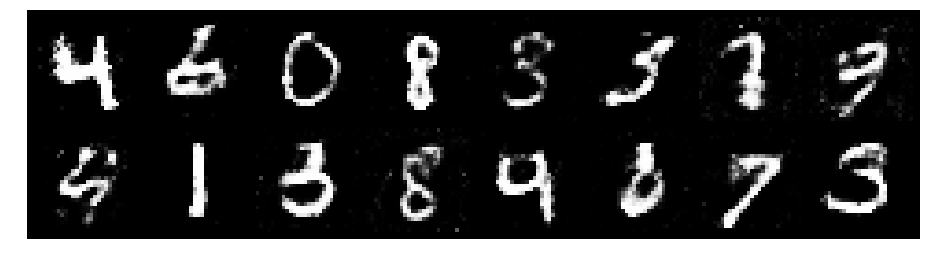

Epoch: [146/200], Batch Num: [0/600]
Discriminator Loss: 1.3799, Generator Loss: 0.8960
D(x): 0.5338, D(G(z)): 0.4663


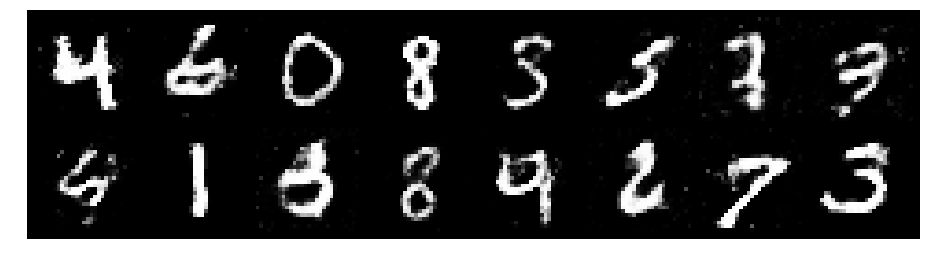

Epoch: [146/200], Batch Num: [100/600]
Discriminator Loss: 1.3903, Generator Loss: 0.8973
D(x): 0.5153, D(G(z)): 0.4602


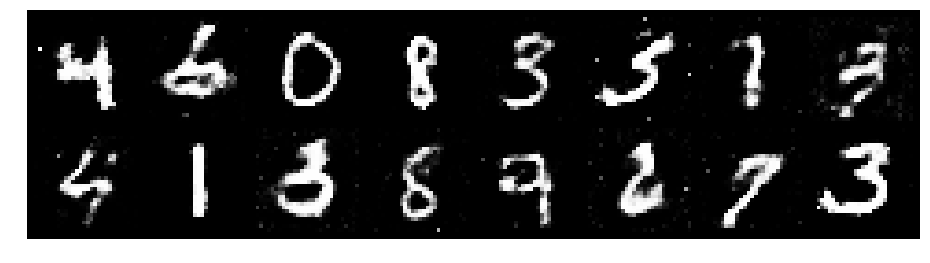

Epoch: [146/200], Batch Num: [200/600]
Discriminator Loss: 1.2378, Generator Loss: 0.9724
D(x): 0.5525, D(G(z)): 0.4205


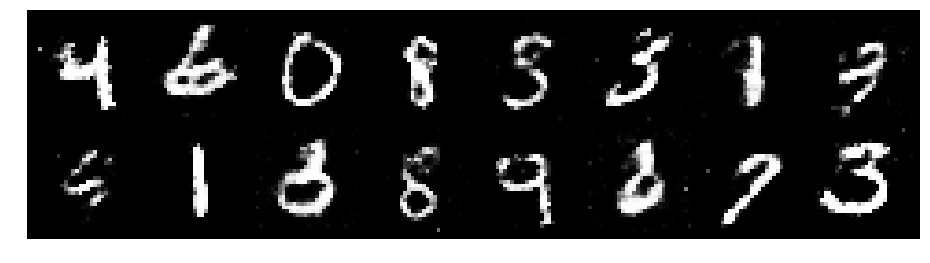

Epoch: [146/200], Batch Num: [300/600]
Discriminator Loss: 1.2614, Generator Loss: 0.8343
D(x): 0.5515, D(G(z)): 0.4550


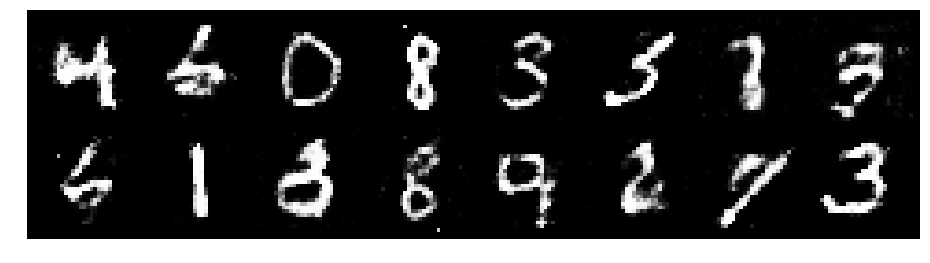

Epoch: [146/200], Batch Num: [400/600]
Discriminator Loss: 1.2281, Generator Loss: 0.9556
D(x): 0.5375, D(G(z)): 0.4247


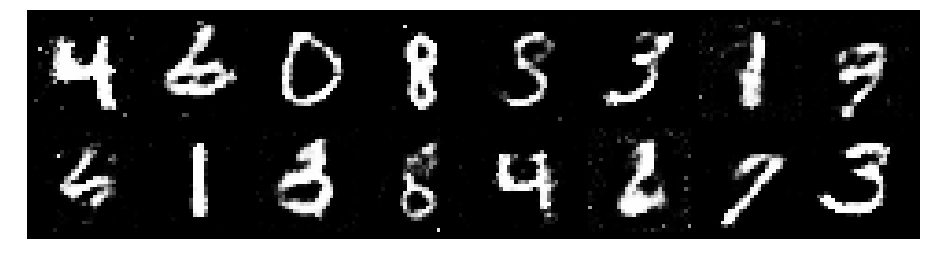

Epoch: [146/200], Batch Num: [500/600]
Discriminator Loss: 1.3526, Generator Loss: 0.8499
D(x): 0.5198, D(G(z)): 0.4454


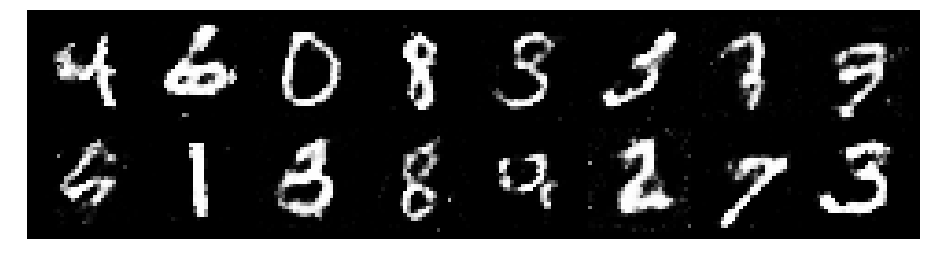

Epoch: [147/200], Batch Num: [0/600]
Discriminator Loss: 1.2812, Generator Loss: 0.9223
D(x): 0.5821, D(G(z)): 0.4722


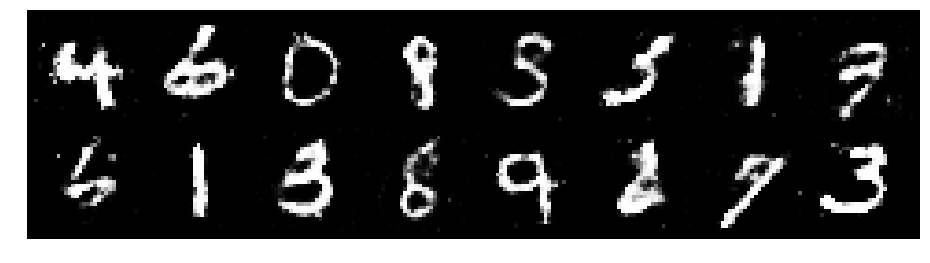

Epoch: [147/200], Batch Num: [100/600]
Discriminator Loss: 1.2271, Generator Loss: 0.9304
D(x): 0.5191, D(G(z)): 0.3723


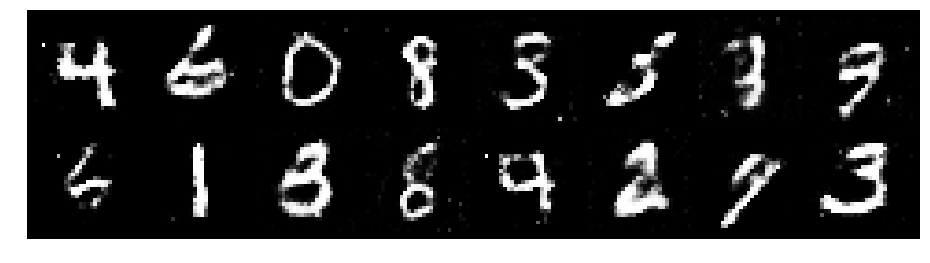

Epoch: [147/200], Batch Num: [200/600]
Discriminator Loss: 1.3643, Generator Loss: 0.8507
D(x): 0.5354, D(G(z)): 0.4658


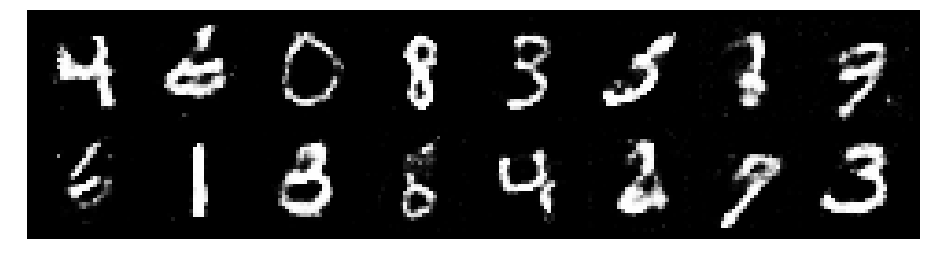

Epoch: [147/200], Batch Num: [300/600]
Discriminator Loss: 1.2890, Generator Loss: 0.8042
D(x): 0.5354, D(G(z)): 0.4443


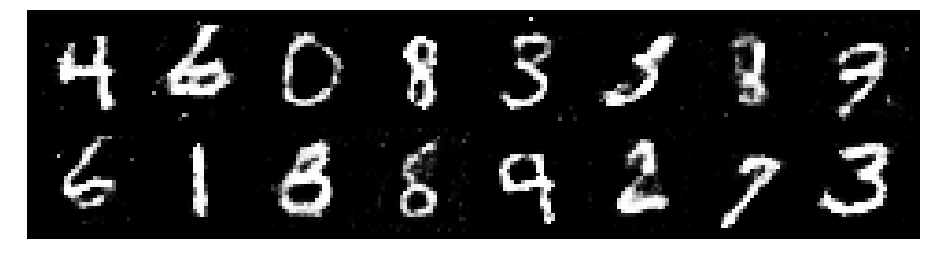

Epoch: [147/200], Batch Num: [400/600]
Discriminator Loss: 1.2780, Generator Loss: 0.8023
D(x): 0.5177, D(G(z)): 0.4267


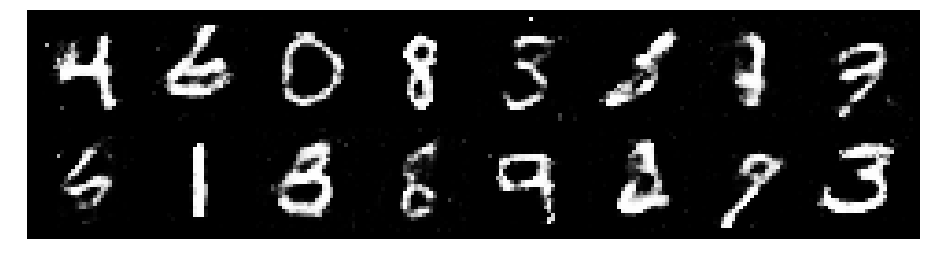

Epoch: [147/200], Batch Num: [500/600]
Discriminator Loss: 1.2950, Generator Loss: 0.8309
D(x): 0.5218, D(G(z)): 0.4502


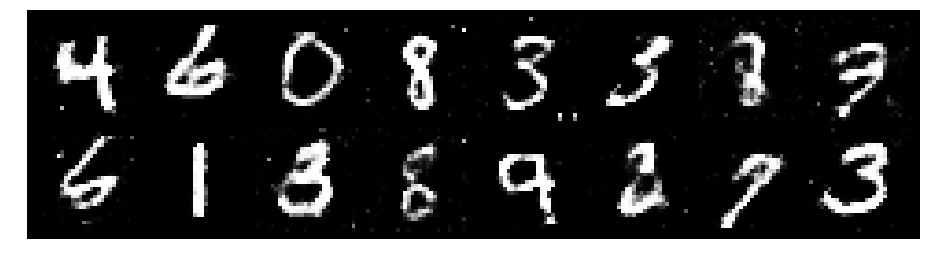

Epoch: [148/200], Batch Num: [0/600]
Discriminator Loss: 1.2715, Generator Loss: 0.9419
D(x): 0.5265, D(G(z)): 0.4115


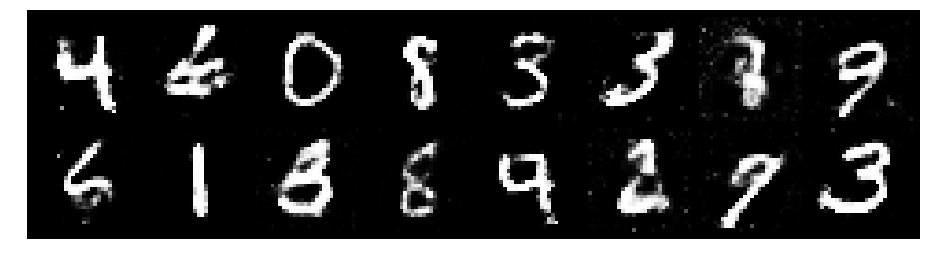

Epoch: [148/200], Batch Num: [100/600]
Discriminator Loss: 1.2507, Generator Loss: 0.9288
D(x): 0.5533, D(G(z)): 0.4369


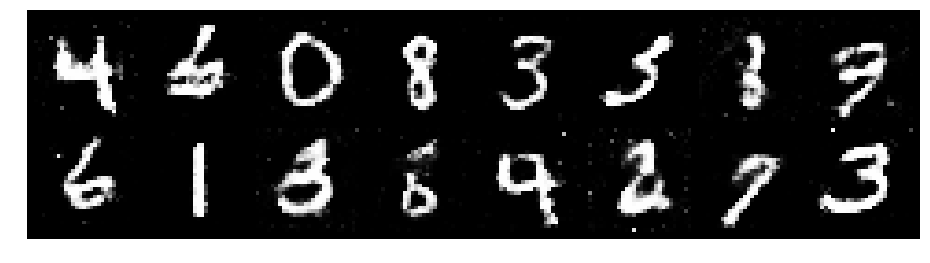

Epoch: [148/200], Batch Num: [200/600]
Discriminator Loss: 1.1449, Generator Loss: 0.8273
D(x): 0.6179, D(G(z)): 0.4429


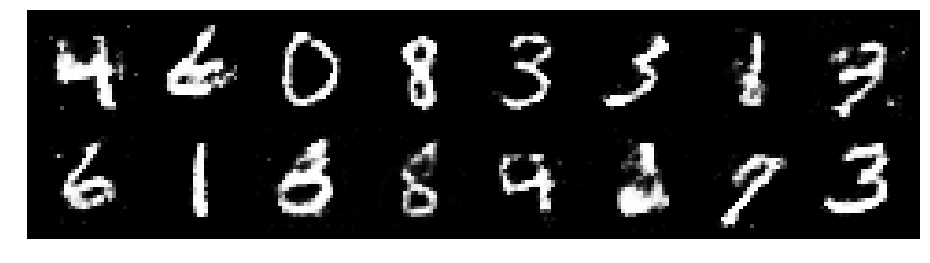

Epoch: [148/200], Batch Num: [300/600]
Discriminator Loss: 1.2215, Generator Loss: 1.0589
D(x): 0.5678, D(G(z)): 0.4452


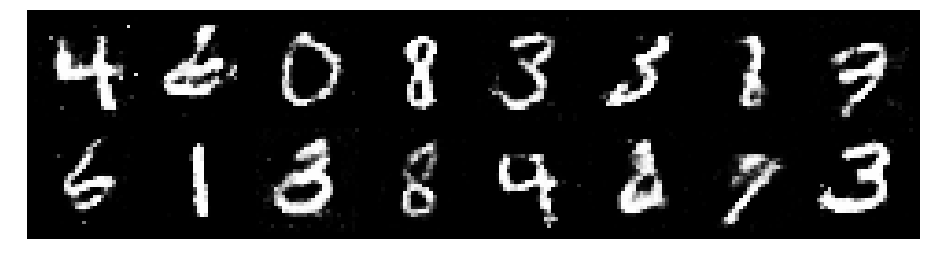

Epoch: [148/200], Batch Num: [400/600]
Discriminator Loss: 1.2367, Generator Loss: 0.8541
D(x): 0.5579, D(G(z)): 0.4525


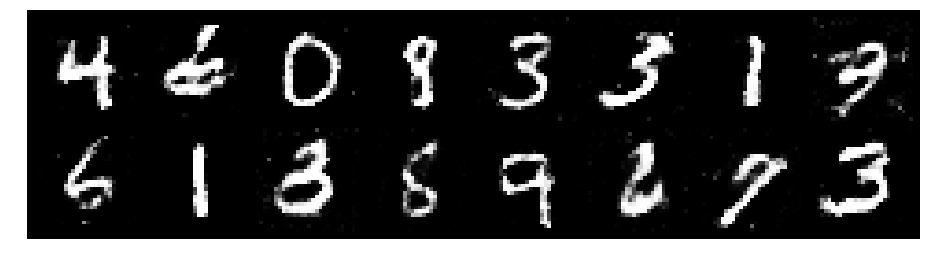

Epoch: [148/200], Batch Num: [500/600]
Discriminator Loss: 1.3199, Generator Loss: 0.8842
D(x): 0.4953, D(G(z)): 0.4084


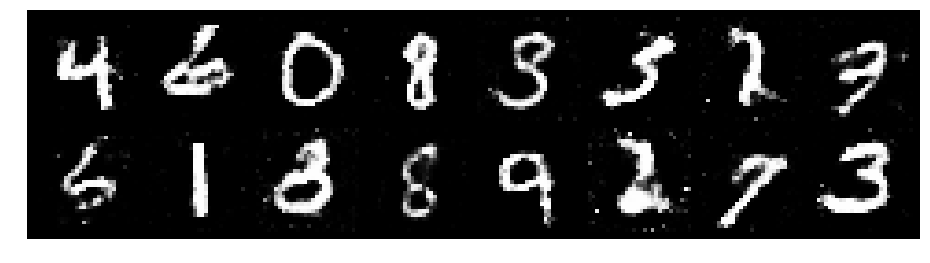

Epoch: [149/200], Batch Num: [0/600]
Discriminator Loss: 1.2647, Generator Loss: 0.8670
D(x): 0.5732, D(G(z)): 0.4704


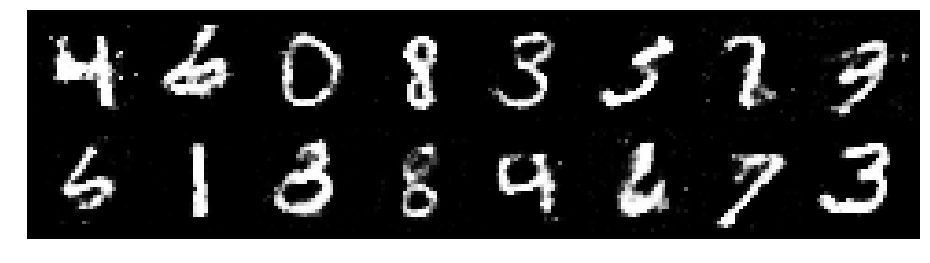

Epoch: [149/200], Batch Num: [100/600]
Discriminator Loss: 1.3384, Generator Loss: 0.8747
D(x): 0.5736, D(G(z)): 0.4699


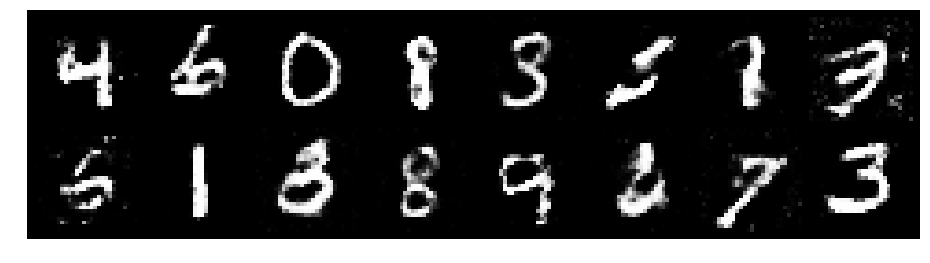

Epoch: [149/200], Batch Num: [200/600]
Discriminator Loss: 1.3231, Generator Loss: 0.8813
D(x): 0.5318, D(G(z)): 0.4493


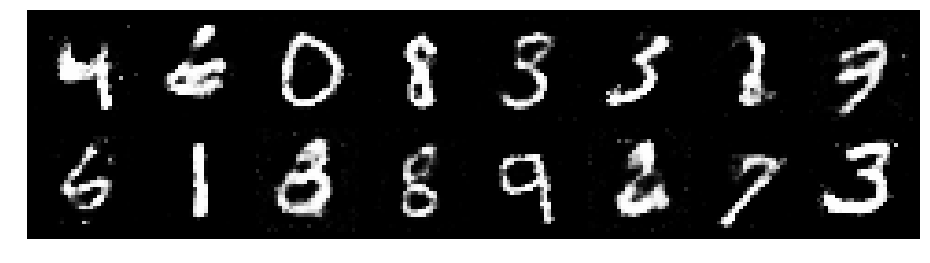

Epoch: [149/200], Batch Num: [300/600]
Discriminator Loss: 1.2475, Generator Loss: 0.8262
D(x): 0.5551, D(G(z)): 0.4448


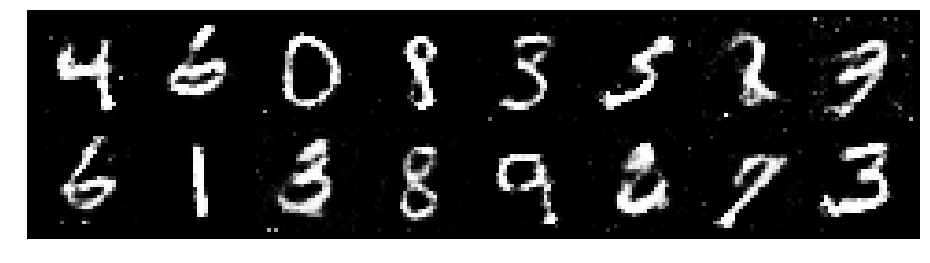

Epoch: [149/200], Batch Num: [400/600]
Discriminator Loss: 1.2601, Generator Loss: 0.9019
D(x): 0.5555, D(G(z)): 0.4556


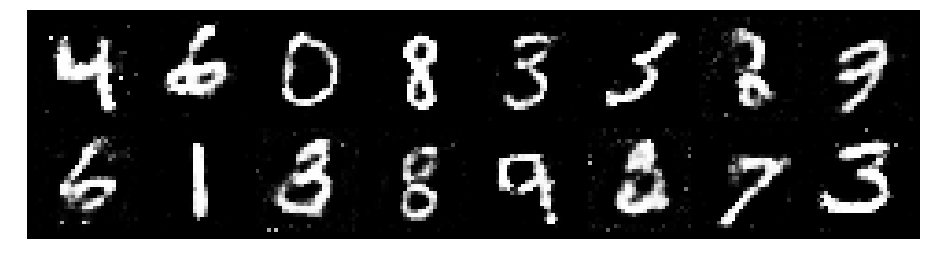

Epoch: [149/200], Batch Num: [500/600]
Discriminator Loss: 1.2298, Generator Loss: 0.9171
D(x): 0.5414, D(G(z)): 0.4228


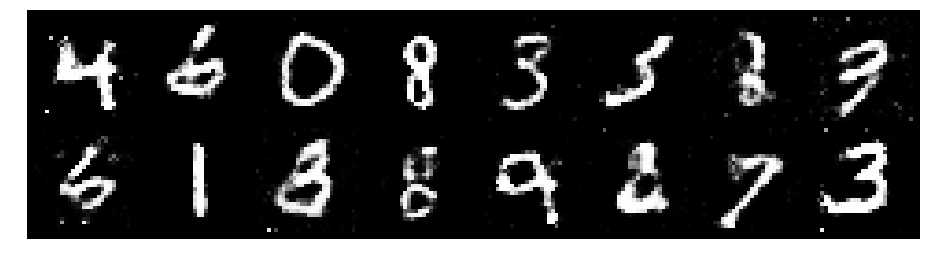

Epoch: [150/200], Batch Num: [0/600]
Discriminator Loss: 1.2469, Generator Loss: 0.8858
D(x): 0.5542, D(G(z)): 0.4424


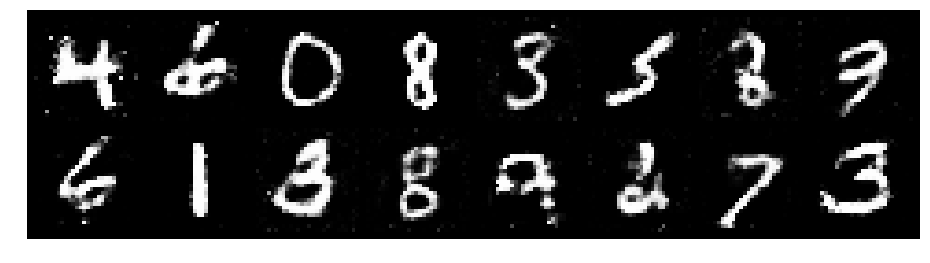

Epoch: [150/200], Batch Num: [100/600]
Discriminator Loss: 1.1311, Generator Loss: 1.0844
D(x): 0.5770, D(G(z)): 0.3975


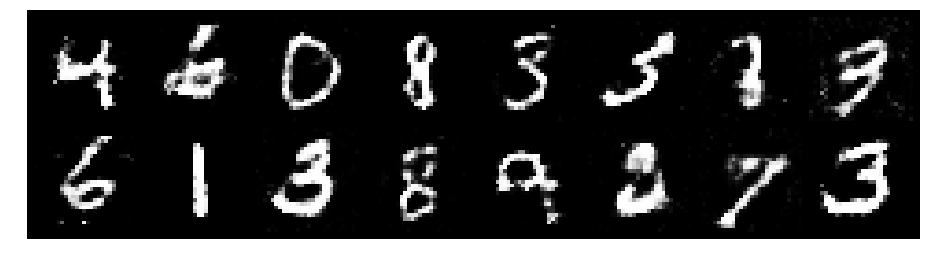

Epoch: [150/200], Batch Num: [200/600]
Discriminator Loss: 1.2341, Generator Loss: 0.9558
D(x): 0.5365, D(G(z)): 0.4087


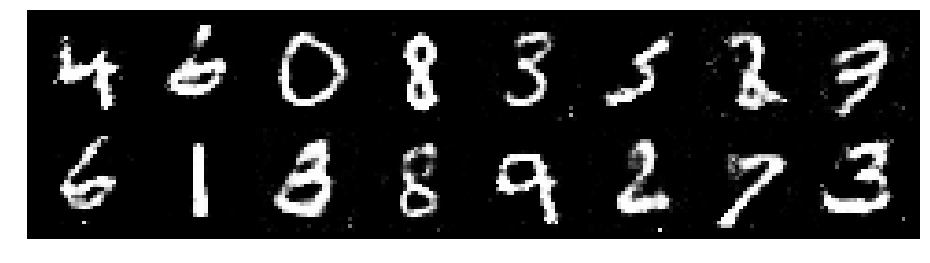

Epoch: [150/200], Batch Num: [300/600]
Discriminator Loss: 1.3916, Generator Loss: 0.9353
D(x): 0.4788, D(G(z)): 0.4143


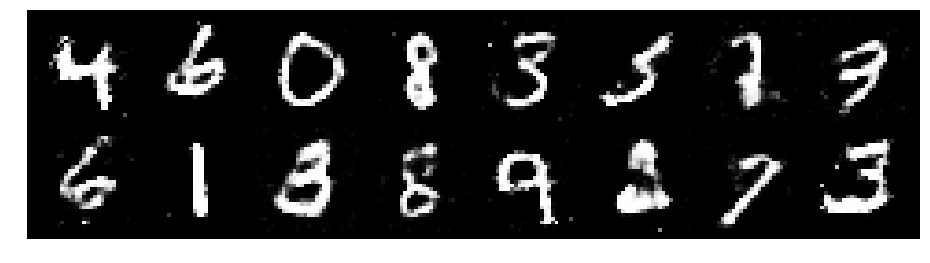

Epoch: [150/200], Batch Num: [400/600]
Discriminator Loss: 1.3709, Generator Loss: 0.6938
D(x): 0.5829, D(G(z)): 0.5072


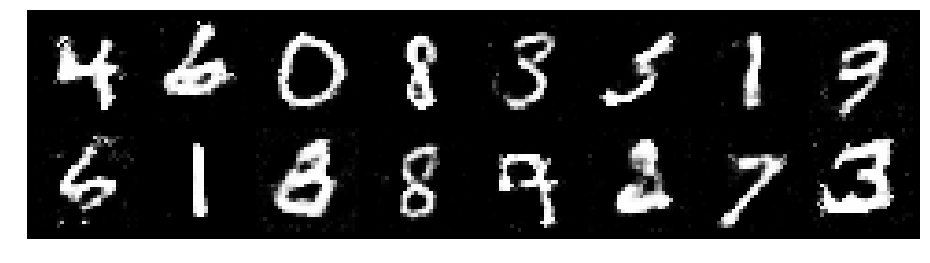

Epoch: [150/200], Batch Num: [500/600]
Discriminator Loss: 1.4389, Generator Loss: 0.8631
D(x): 0.5199, D(G(z)): 0.4816


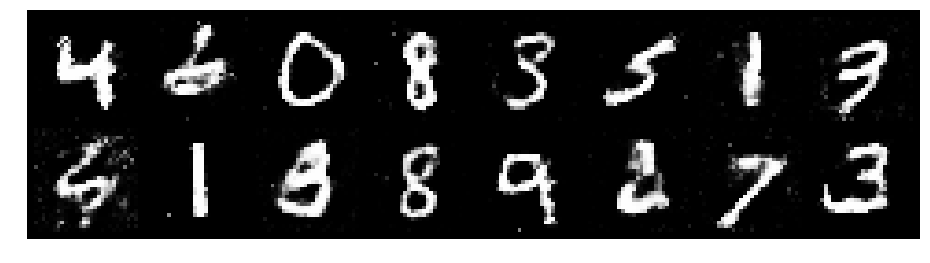

Epoch: [151/200], Batch Num: [0/600]
Discriminator Loss: 1.3753, Generator Loss: 0.8245
D(x): 0.5387, D(G(z)): 0.4597


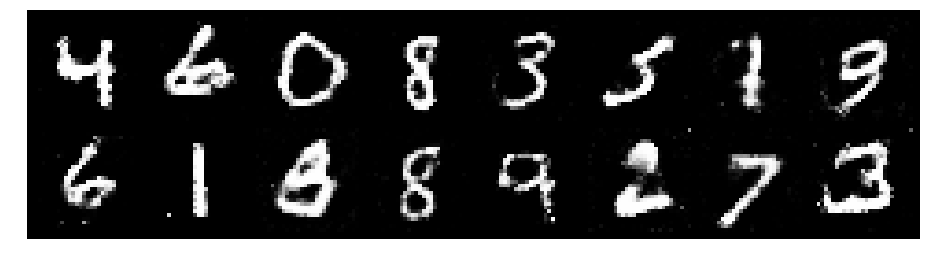

Epoch: [151/200], Batch Num: [100/600]
Discriminator Loss: 1.2868, Generator Loss: 0.9480
D(x): 0.5299, D(G(z)): 0.4277


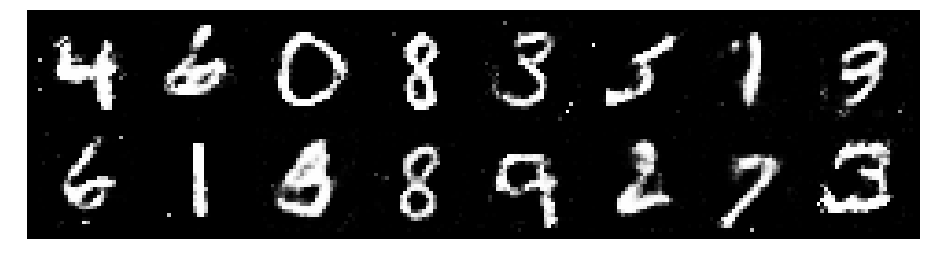

Epoch: [151/200], Batch Num: [200/600]
Discriminator Loss: 1.3541, Generator Loss: 0.8956
D(x): 0.5295, D(G(z)): 0.4625


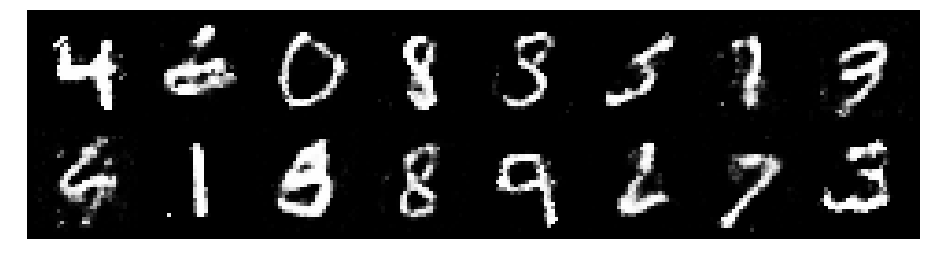

Epoch: [151/200], Batch Num: [300/600]
Discriminator Loss: 1.1716, Generator Loss: 1.0198
D(x): 0.5641, D(G(z)): 0.3912


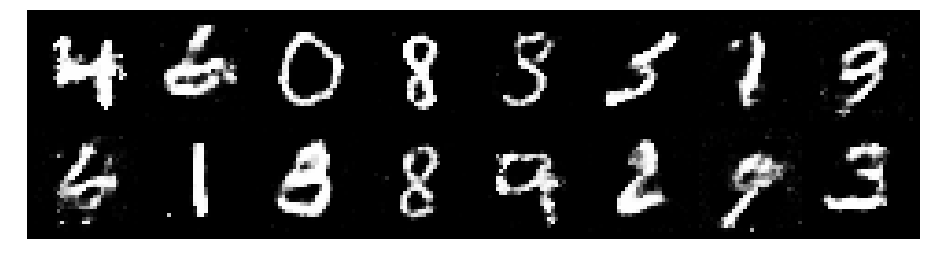

Epoch: [151/200], Batch Num: [400/600]
Discriminator Loss: 1.1705, Generator Loss: 0.9658
D(x): 0.5953, D(G(z)): 0.4435


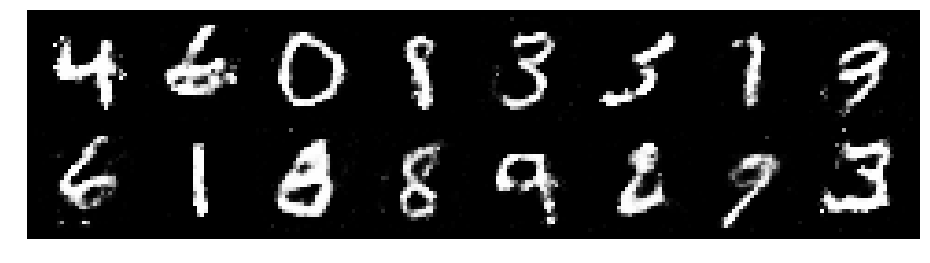

Epoch: [151/200], Batch Num: [500/600]
Discriminator Loss: 1.2250, Generator Loss: 0.8677
D(x): 0.5660, D(G(z)): 0.4336


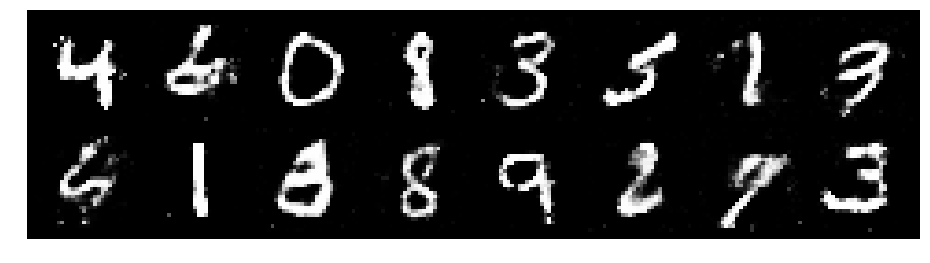

Epoch: [152/200], Batch Num: [0/600]
Discriminator Loss: 1.2237, Generator Loss: 0.8676
D(x): 0.5792, D(G(z)): 0.4401


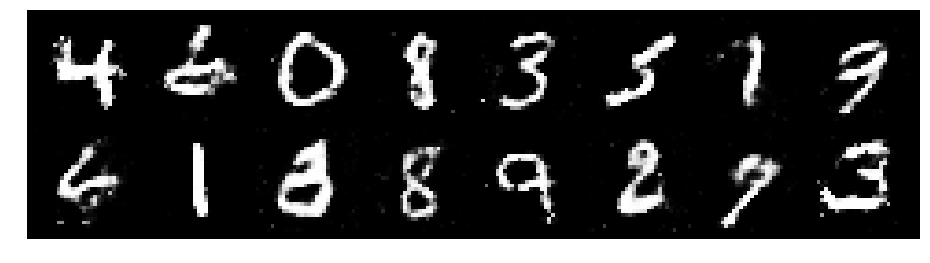

Epoch: [152/200], Batch Num: [100/600]
Discriminator Loss: 1.2472, Generator Loss: 0.8177
D(x): 0.5564, D(G(z)): 0.4329


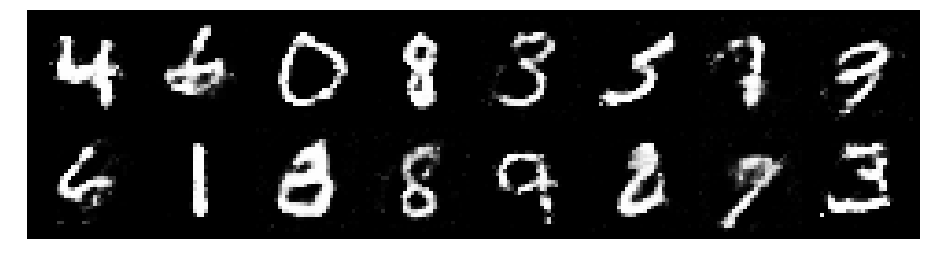

Epoch: [152/200], Batch Num: [200/600]
Discriminator Loss: 1.3089, Generator Loss: 0.9775
D(x): 0.5075, D(G(z)): 0.4142


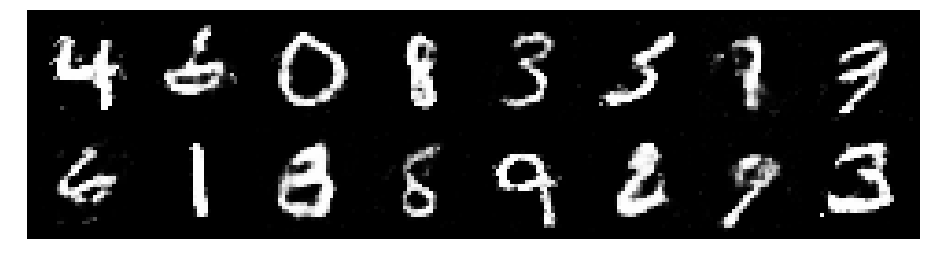

Epoch: [152/200], Batch Num: [300/600]
Discriminator Loss: 1.2875, Generator Loss: 0.7639
D(x): 0.5453, D(G(z)): 0.4685


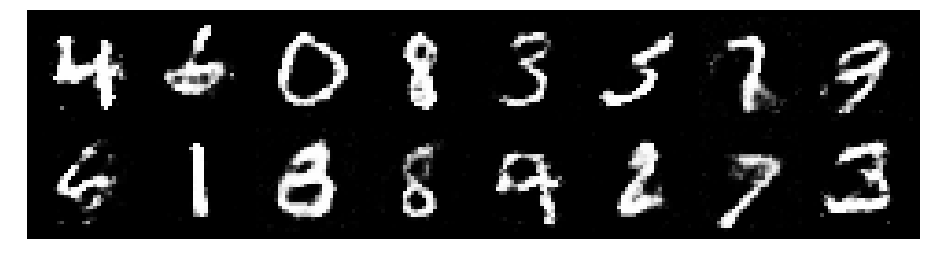

Epoch: [152/200], Batch Num: [400/600]
Discriminator Loss: 1.4750, Generator Loss: 0.8075
D(x): 0.5157, D(G(z)): 0.4934


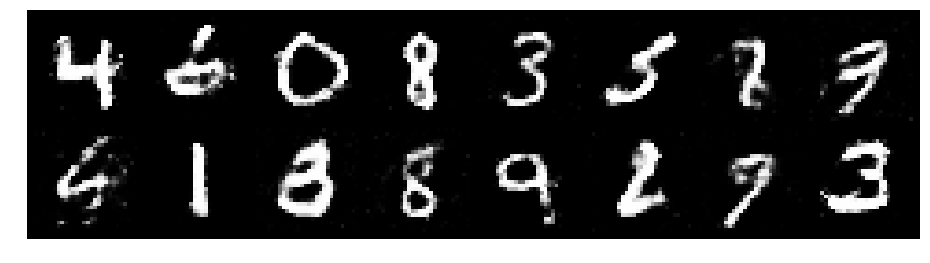

Epoch: [152/200], Batch Num: [500/600]
Discriminator Loss: 1.4051, Generator Loss: 0.9258
D(x): 0.4930, D(G(z)): 0.4465


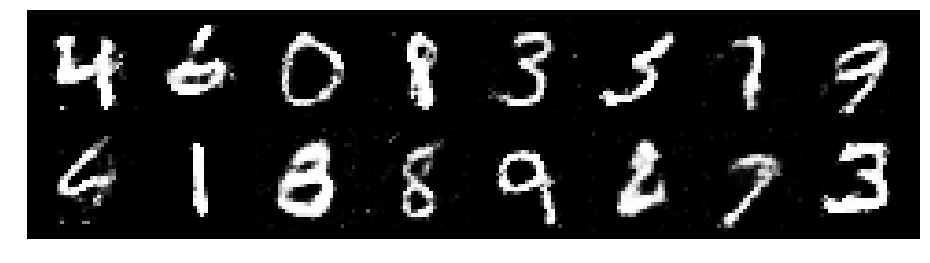

Epoch: [153/200], Batch Num: [0/600]
Discriminator Loss: 1.3754, Generator Loss: 0.9387
D(x): 0.5356, D(G(z)): 0.4675


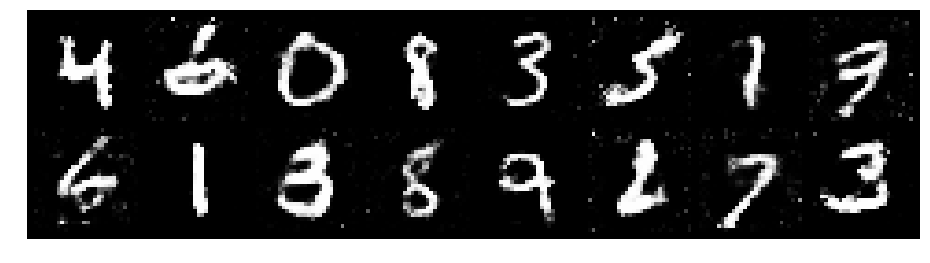

Epoch: [153/200], Batch Num: [100/600]
Discriminator Loss: 1.2455, Generator Loss: 0.9164
D(x): 0.5352, D(G(z)): 0.4216


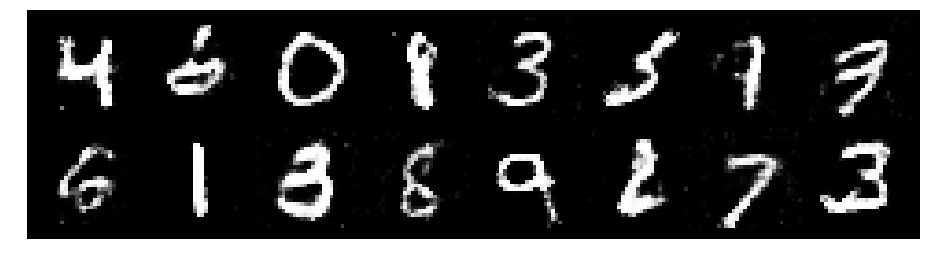

Epoch: [153/200], Batch Num: [200/600]
Discriminator Loss: 1.3713, Generator Loss: 1.0236
D(x): 0.5412, D(G(z)): 0.4464


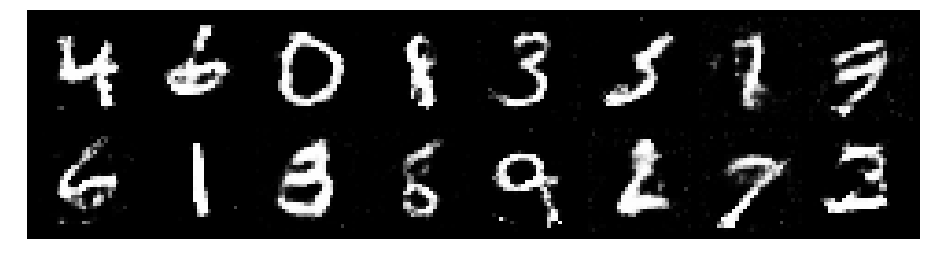

Epoch: [153/200], Batch Num: [300/600]
Discriminator Loss: 1.2617, Generator Loss: 0.9532
D(x): 0.5375, D(G(z)): 0.4159


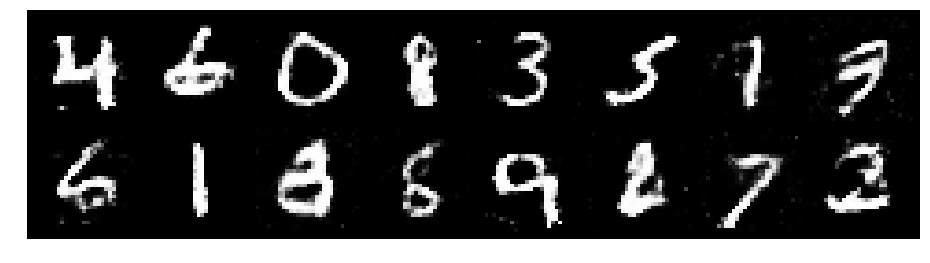

Epoch: [153/200], Batch Num: [400/600]
Discriminator Loss: 1.2298, Generator Loss: 0.8842
D(x): 0.5717, D(G(z)): 0.4490


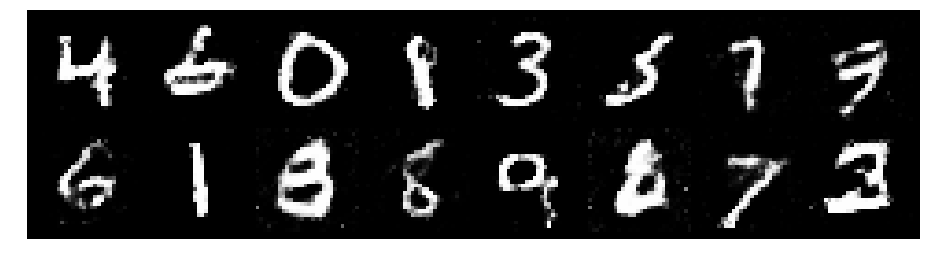

Epoch: [153/200], Batch Num: [500/600]
Discriminator Loss: 1.2419, Generator Loss: 0.8224
D(x): 0.5976, D(G(z)): 0.4771


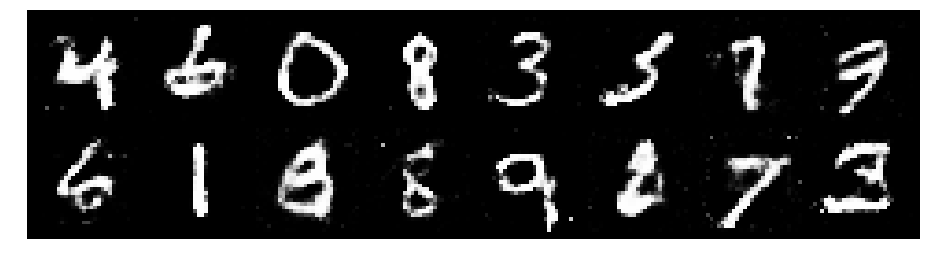

Epoch: [154/200], Batch Num: [0/600]
Discriminator Loss: 1.2781, Generator Loss: 0.8524
D(x): 0.5545, D(G(z)): 0.4536


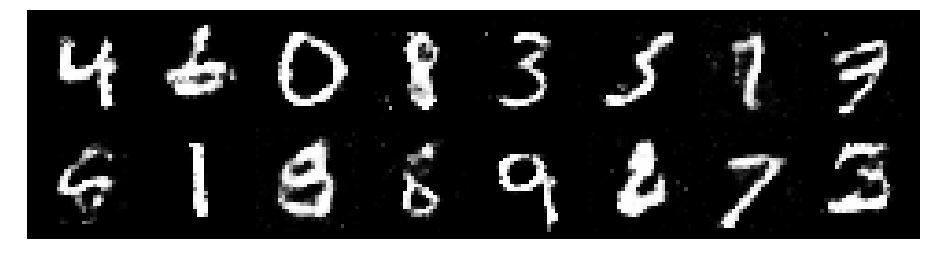

Epoch: [154/200], Batch Num: [100/600]
Discriminator Loss: 1.3717, Generator Loss: 0.7734
D(x): 0.5836, D(G(z)): 0.5202


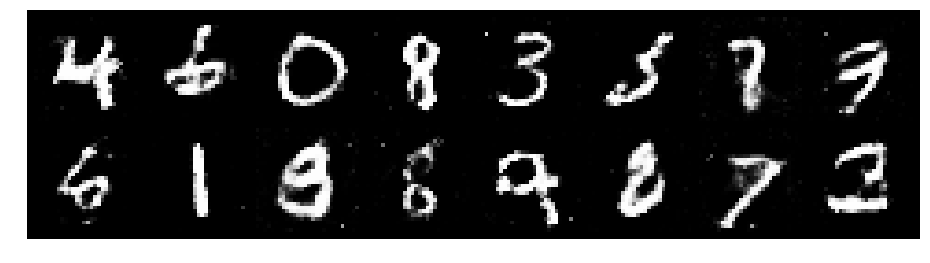

Epoch: [154/200], Batch Num: [200/600]
Discriminator Loss: 1.2674, Generator Loss: 0.8991
D(x): 0.5758, D(G(z)): 0.4542


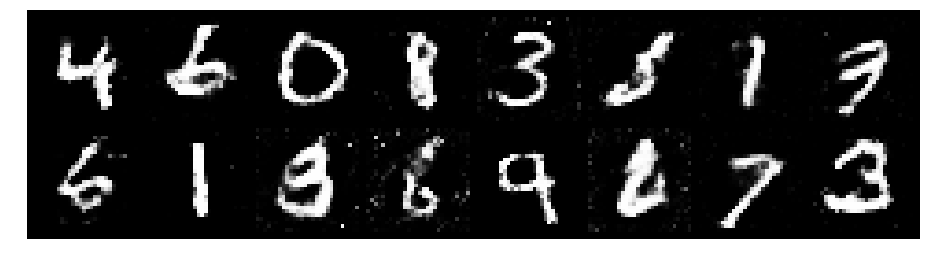

Epoch: [154/200], Batch Num: [300/600]
Discriminator Loss: 1.2188, Generator Loss: 1.0433
D(x): 0.5401, D(G(z)): 0.3990


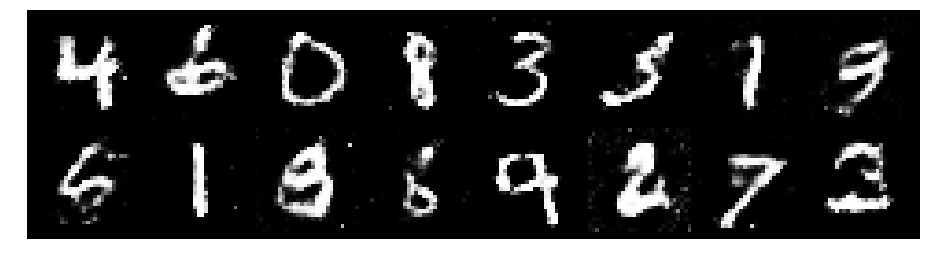

Epoch: [154/200], Batch Num: [400/600]
Discriminator Loss: 1.2668, Generator Loss: 1.1130
D(x): 0.5348, D(G(z)): 0.3996


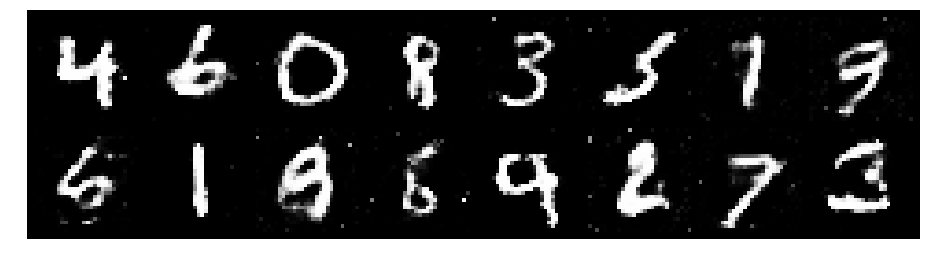

Epoch: [154/200], Batch Num: [500/600]
Discriminator Loss: 1.2257, Generator Loss: 0.9418
D(x): 0.5276, D(G(z)): 0.4023


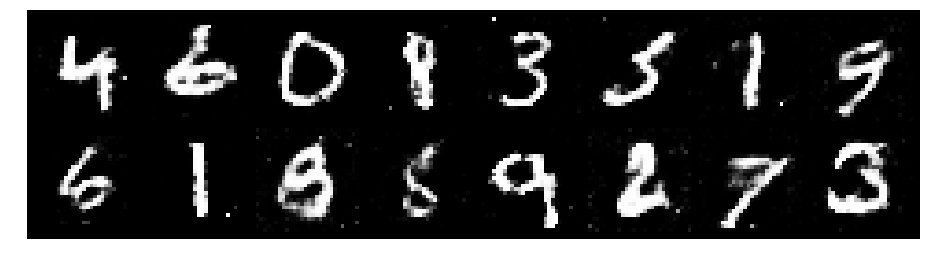

Epoch: [155/200], Batch Num: [0/600]
Discriminator Loss: 1.2529, Generator Loss: 0.9357
D(x): 0.5568, D(G(z)): 0.4315


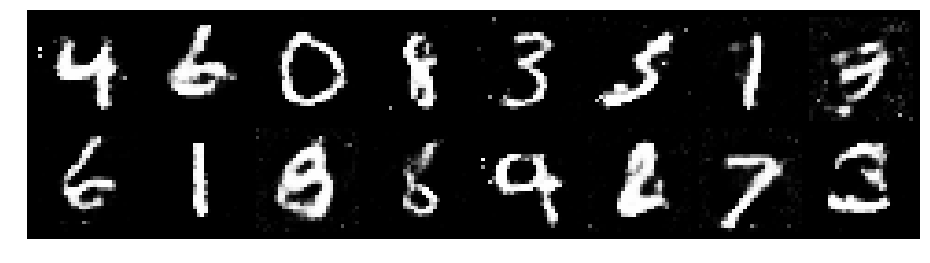

Epoch: [155/200], Batch Num: [100/600]
Discriminator Loss: 1.2930, Generator Loss: 0.9572
D(x): 0.5384, D(G(z)): 0.4300


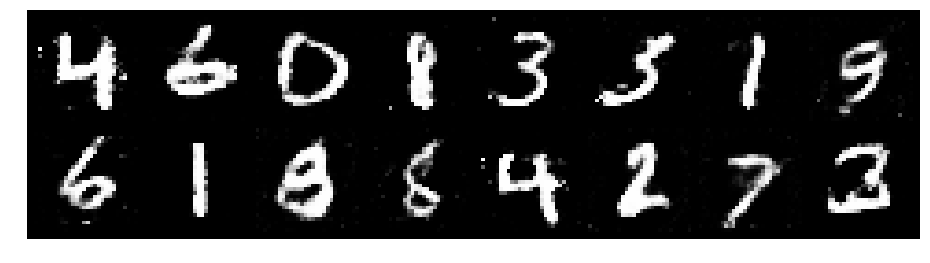

Epoch: [155/200], Batch Num: [200/600]
Discriminator Loss: 1.3506, Generator Loss: 0.8152
D(x): 0.5348, D(G(z)): 0.4791


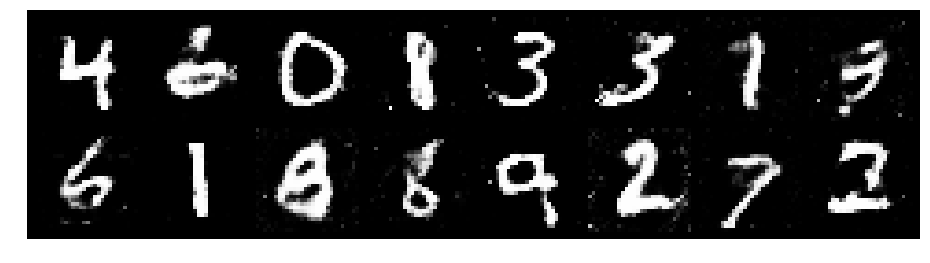

Epoch: [155/200], Batch Num: [300/600]
Discriminator Loss: 1.3609, Generator Loss: 1.0248
D(x): 0.5192, D(G(z)): 0.4335


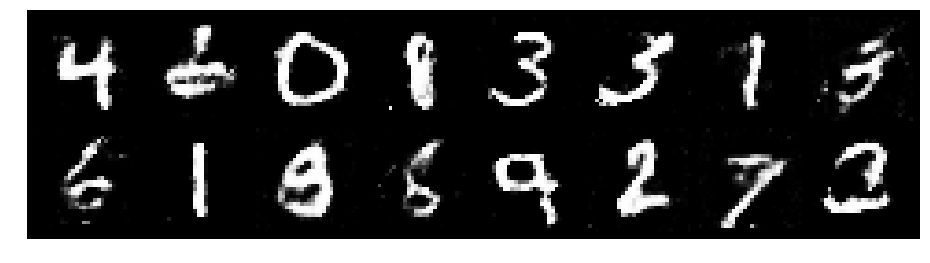

Epoch: [155/200], Batch Num: [400/600]
Discriminator Loss: 1.3325, Generator Loss: 0.8158
D(x): 0.5351, D(G(z)): 0.4593


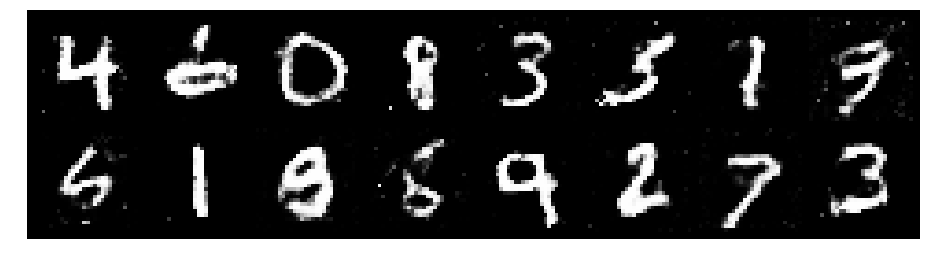

Epoch: [155/200], Batch Num: [500/600]
Discriminator Loss: 1.2528, Generator Loss: 1.0141
D(x): 0.5181, D(G(z)): 0.3739


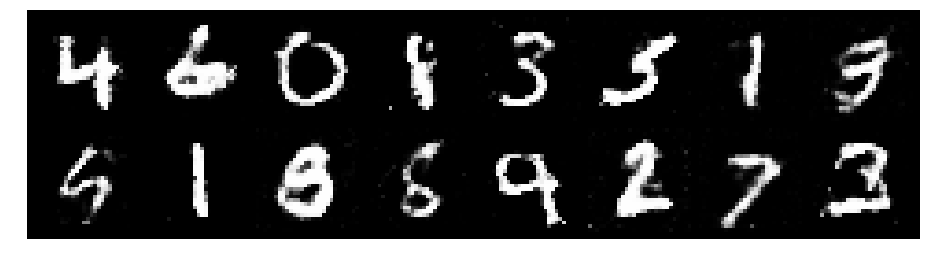

Epoch: [156/200], Batch Num: [0/600]
Discriminator Loss: 1.3647, Generator Loss: 0.8582
D(x): 0.5437, D(G(z)): 0.4663


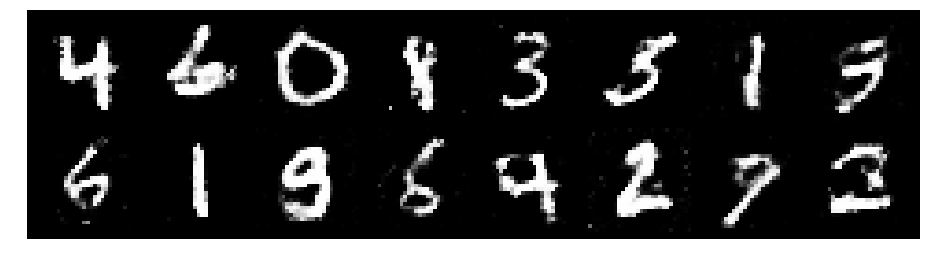

Epoch: [156/200], Batch Num: [100/600]
Discriminator Loss: 1.2816, Generator Loss: 0.7754
D(x): 0.5687, D(G(z)): 0.4604


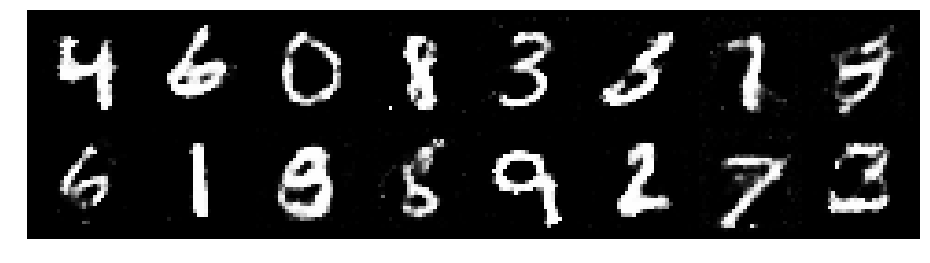

Epoch: [156/200], Batch Num: [200/600]
Discriminator Loss: 1.3095, Generator Loss: 0.9108
D(x): 0.5668, D(G(z)): 0.4706


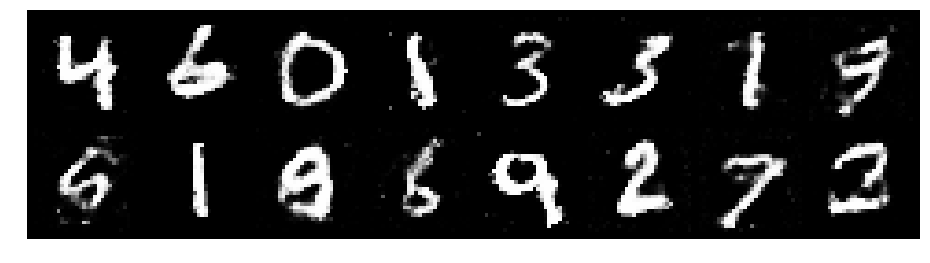

Epoch: [156/200], Batch Num: [300/600]
Discriminator Loss: 1.3134, Generator Loss: 0.8924
D(x): 0.5321, D(G(z)): 0.4494


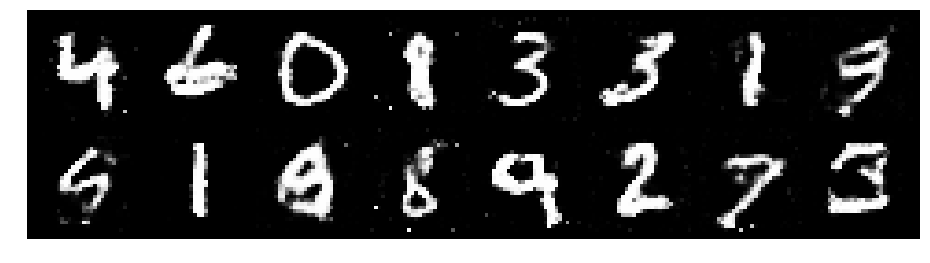

Epoch: [156/200], Batch Num: [400/600]
Discriminator Loss: 1.3222, Generator Loss: 0.8750
D(x): 0.5240, D(G(z)): 0.4576


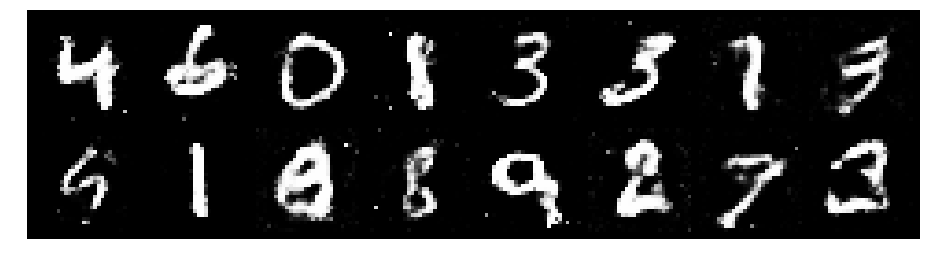

Epoch: [156/200], Batch Num: [500/600]
Discriminator Loss: 1.3010, Generator Loss: 0.8168
D(x): 0.5746, D(G(z)): 0.4803


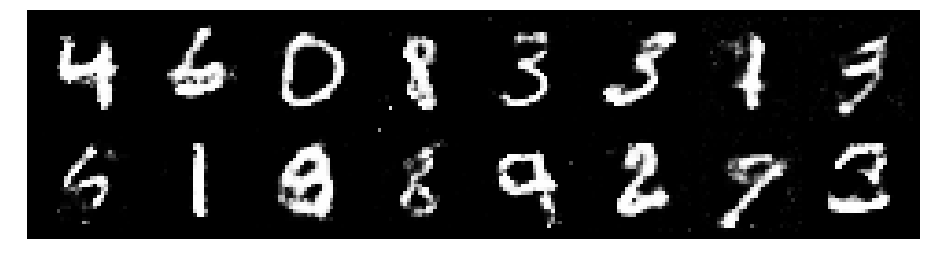

Epoch: [157/200], Batch Num: [0/600]
Discriminator Loss: 1.3367, Generator Loss: 0.9259
D(x): 0.5772, D(G(z)): 0.4704


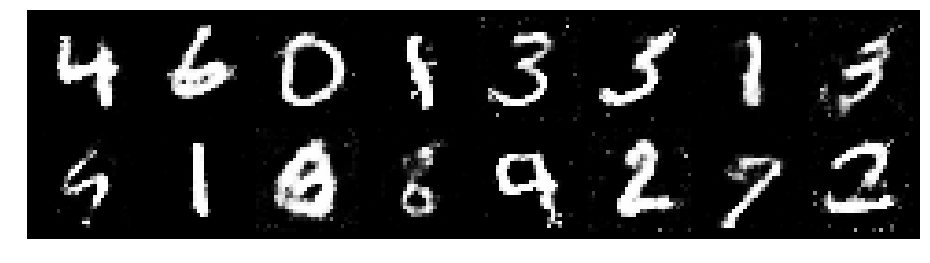

Epoch: [157/200], Batch Num: [100/600]
Discriminator Loss: 1.3916, Generator Loss: 0.7967
D(x): 0.5036, D(G(z)): 0.4218


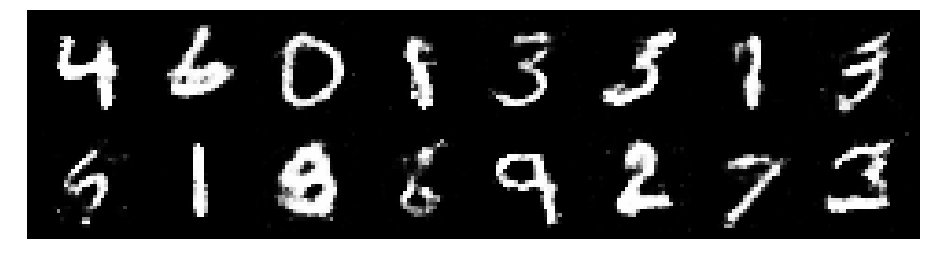

Epoch: [157/200], Batch Num: [200/600]
Discriminator Loss: 1.2945, Generator Loss: 0.8578
D(x): 0.5308, D(G(z)): 0.4578


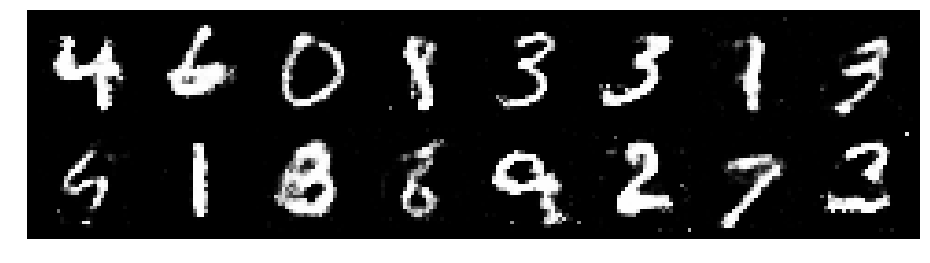

Epoch: [157/200], Batch Num: [300/600]
Discriminator Loss: 1.3060, Generator Loss: 0.8003
D(x): 0.5639, D(G(z)): 0.4926


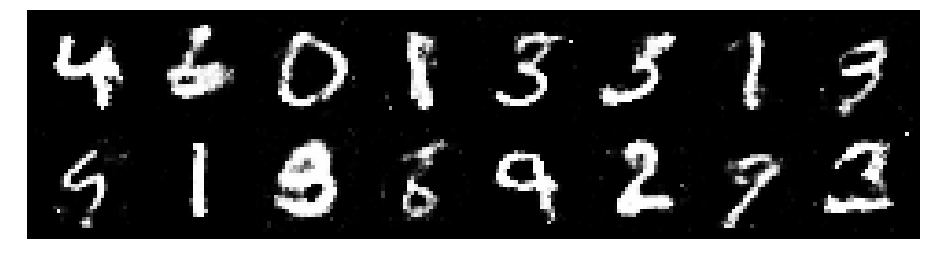

Epoch: [157/200], Batch Num: [400/600]
Discriminator Loss: 1.3103, Generator Loss: 0.9280
D(x): 0.5459, D(G(z)): 0.4326


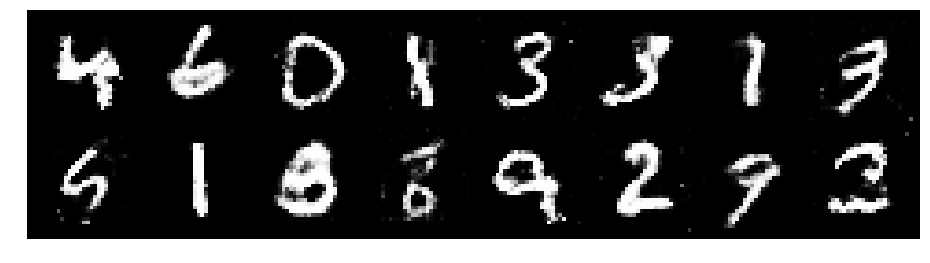

Epoch: [157/200], Batch Num: [500/600]
Discriminator Loss: 1.1945, Generator Loss: 0.8415
D(x): 0.5628, D(G(z)): 0.4299


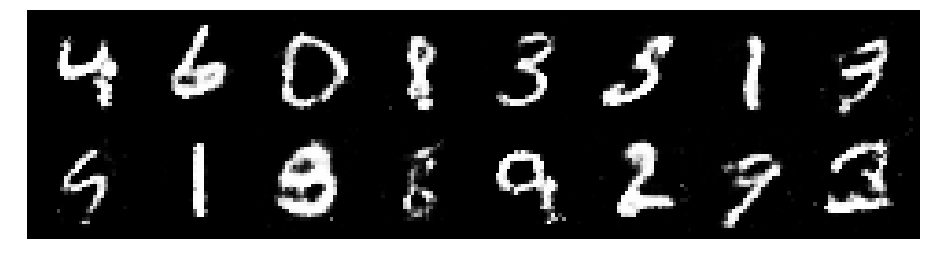

Epoch: [158/200], Batch Num: [0/600]
Discriminator Loss: 1.3204, Generator Loss: 0.7985
D(x): 0.5602, D(G(z)): 0.4891


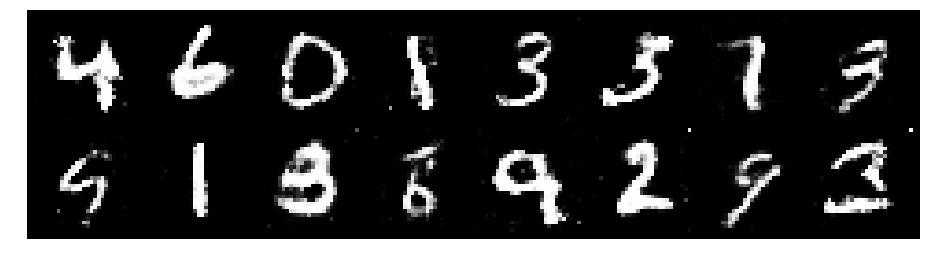

Epoch: [158/200], Batch Num: [100/600]
Discriminator Loss: 1.3010, Generator Loss: 0.8101
D(x): 0.5392, D(G(z)): 0.4580


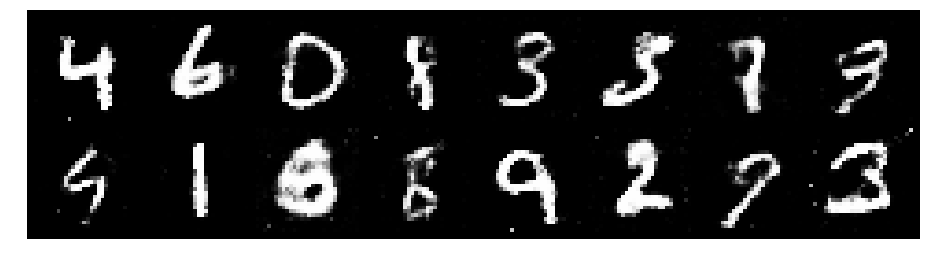

Epoch: [158/200], Batch Num: [200/600]
Discriminator Loss: 1.3092, Generator Loss: 0.7886
D(x): 0.5588, D(G(z)): 0.4824


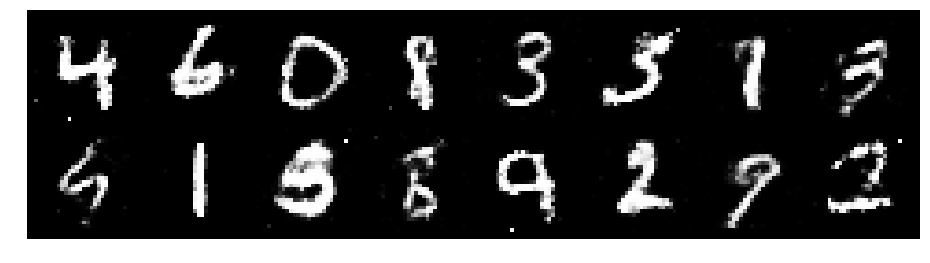

Epoch: [158/200], Batch Num: [300/600]
Discriminator Loss: 1.3977, Generator Loss: 0.8736
D(x): 0.5236, D(G(z)): 0.4685


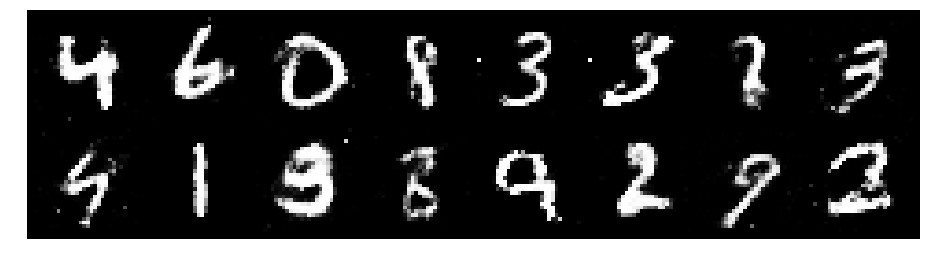

Epoch: [158/200], Batch Num: [400/600]
Discriminator Loss: 1.3197, Generator Loss: 0.8747
D(x): 0.5178, D(G(z)): 0.4365


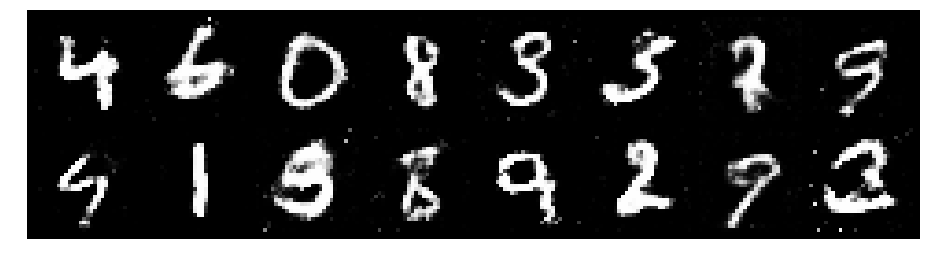

Epoch: [158/200], Batch Num: [500/600]
Discriminator Loss: 1.2848, Generator Loss: 0.8463
D(x): 0.5474, D(G(z)): 0.4374


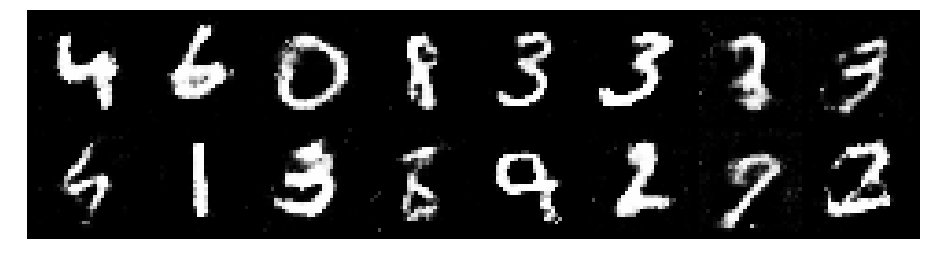

Epoch: [159/200], Batch Num: [0/600]
Discriminator Loss: 1.2397, Generator Loss: 0.9064
D(x): 0.5668, D(G(z)): 0.4283


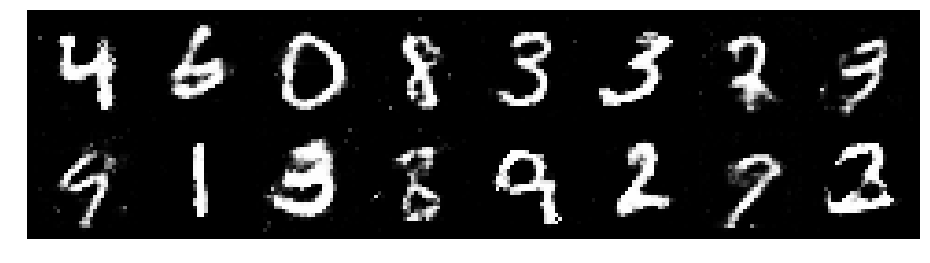

Epoch: [159/200], Batch Num: [100/600]
Discriminator Loss: 1.2051, Generator Loss: 0.8713
D(x): 0.5781, D(G(z)): 0.4346


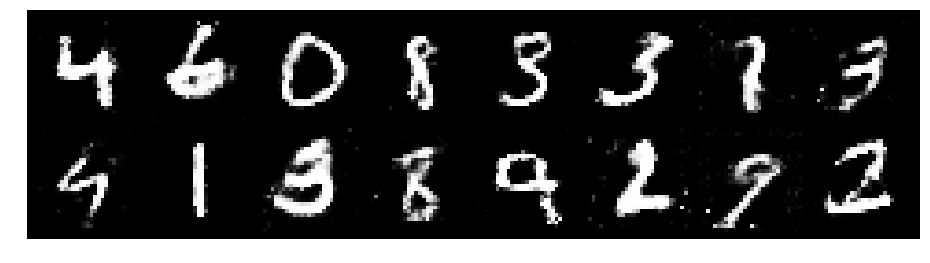

Epoch: [159/200], Batch Num: [200/600]
Discriminator Loss: 1.2375, Generator Loss: 0.8384
D(x): 0.5798, D(G(z)): 0.4602


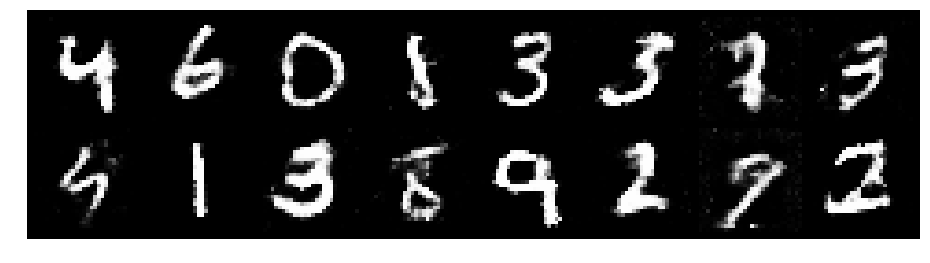

Epoch: [159/200], Batch Num: [300/600]
Discriminator Loss: 1.2522, Generator Loss: 0.8757
D(x): 0.5387, D(G(z)): 0.4371


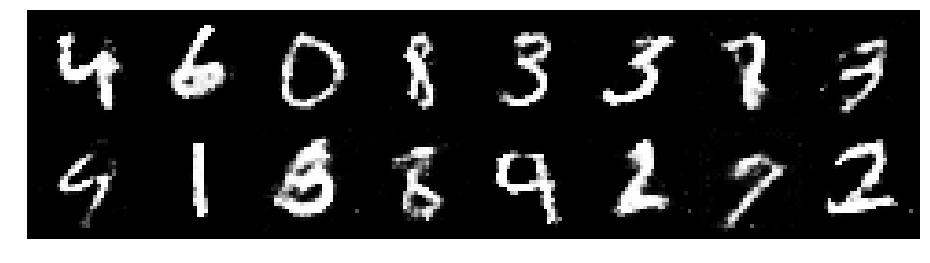

Epoch: [159/200], Batch Num: [400/600]
Discriminator Loss: 1.3341, Generator Loss: 0.8212
D(x): 0.5336, D(G(z)): 0.4706


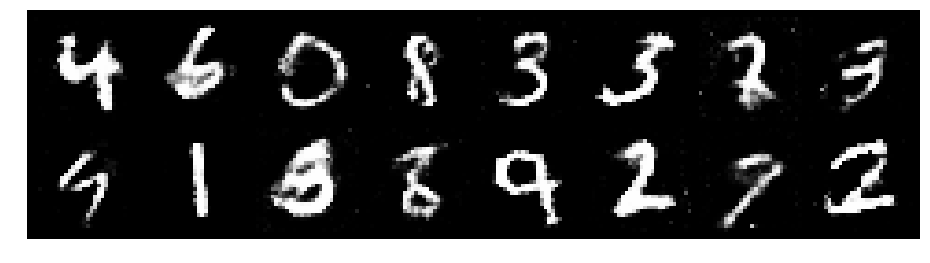

Epoch: [159/200], Batch Num: [500/600]
Discriminator Loss: 1.2375, Generator Loss: 0.9310
D(x): 0.5162, D(G(z)): 0.3995


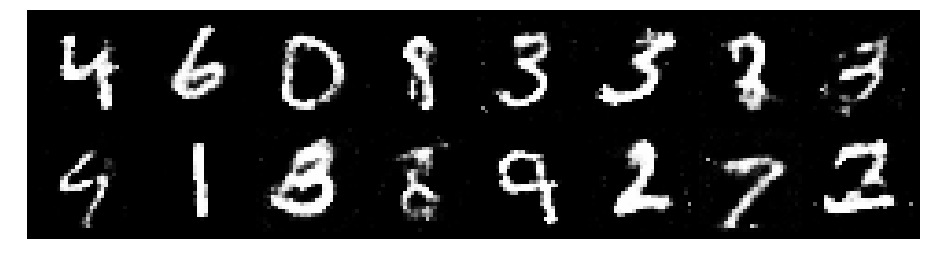

Epoch: [160/200], Batch Num: [0/600]
Discriminator Loss: 1.3361, Generator Loss: 0.9195
D(x): 0.5556, D(G(z)): 0.4843


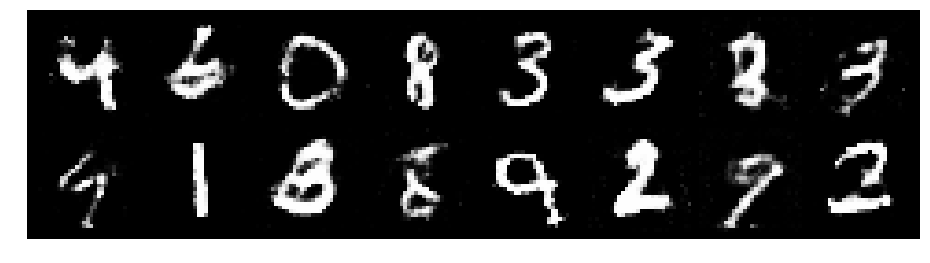

Epoch: [160/200], Batch Num: [100/600]
Discriminator Loss: 1.2351, Generator Loss: 0.7726
D(x): 0.5875, D(G(z)): 0.4552


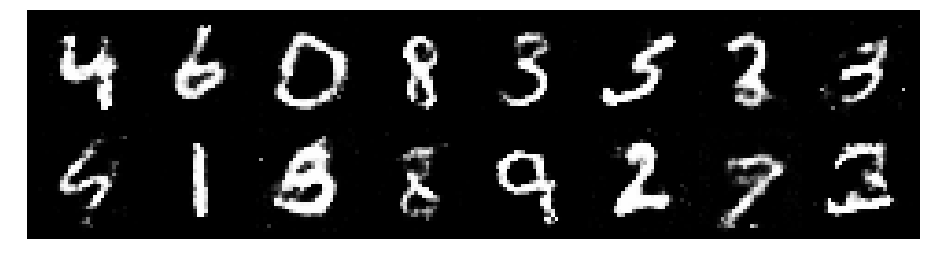

Epoch: [160/200], Batch Num: [200/600]
Discriminator Loss: 1.1974, Generator Loss: 0.9189
D(x): 0.5402, D(G(z)): 0.3914


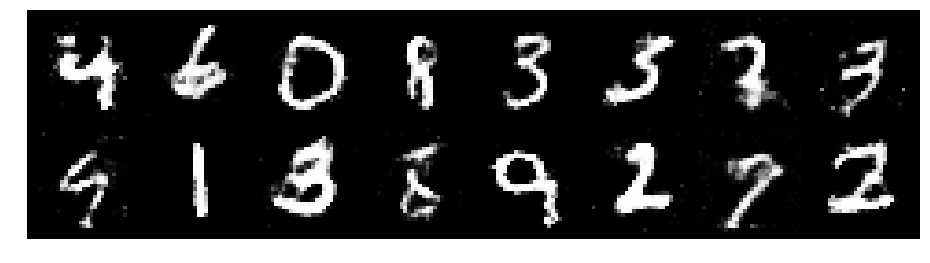

Epoch: [160/200], Batch Num: [300/600]
Discriminator Loss: 1.2848, Generator Loss: 0.8087
D(x): 0.5839, D(G(z)): 0.4686


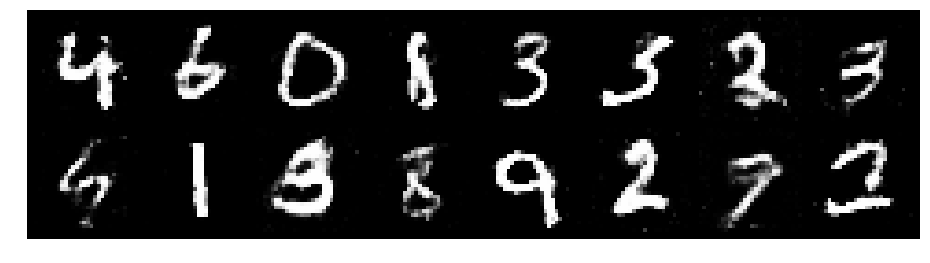

Epoch: [160/200], Batch Num: [400/600]
Discriminator Loss: 1.3516, Generator Loss: 0.8631
D(x): 0.5400, D(G(z)): 0.4661


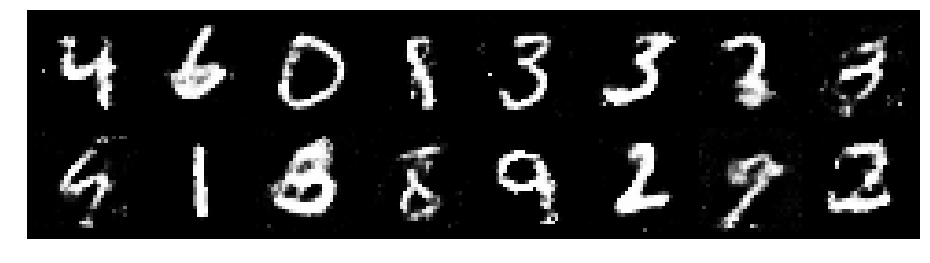

Epoch: [160/200], Batch Num: [500/600]
Discriminator Loss: 1.2704, Generator Loss: 0.9329
D(x): 0.5553, D(G(z)): 0.4586


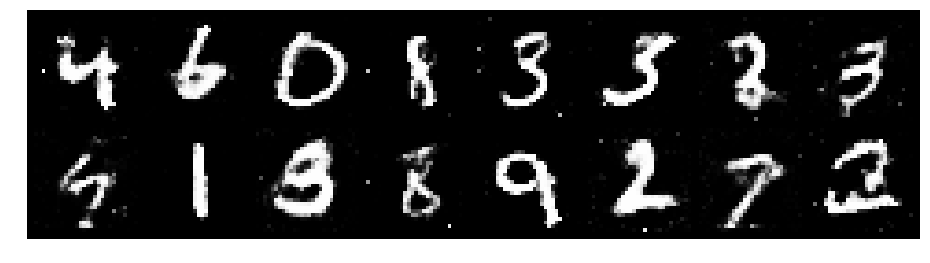

Epoch: [161/200], Batch Num: [0/600]
Discriminator Loss: 1.2832, Generator Loss: 0.8985
D(x): 0.5507, D(G(z)): 0.4563


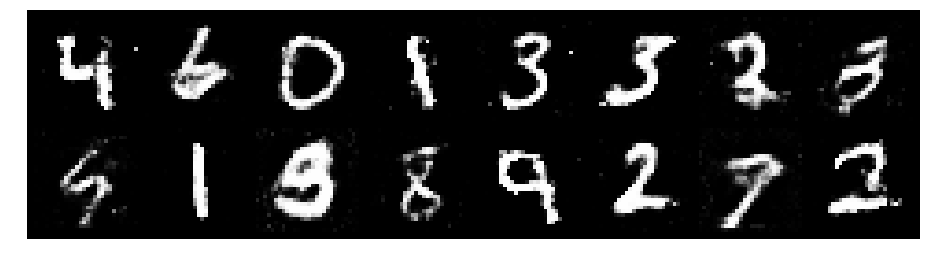

Epoch: [161/200], Batch Num: [100/600]
Discriminator Loss: 1.2576, Generator Loss: 0.8758
D(x): 0.5475, D(G(z)): 0.4373


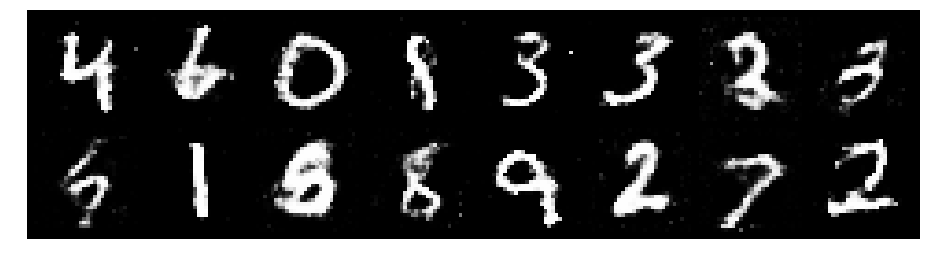

Epoch: [161/200], Batch Num: [200/600]
Discriminator Loss: 1.2769, Generator Loss: 0.9711
D(x): 0.5112, D(G(z)): 0.4123


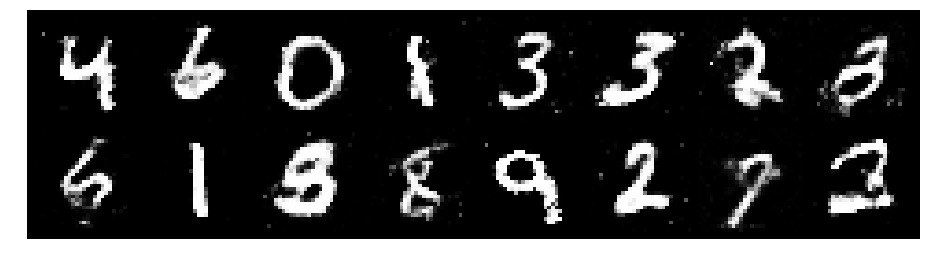

Epoch: [161/200], Batch Num: [300/600]
Discriminator Loss: 1.2792, Generator Loss: 0.8304
D(x): 0.5550, D(G(z)): 0.4592


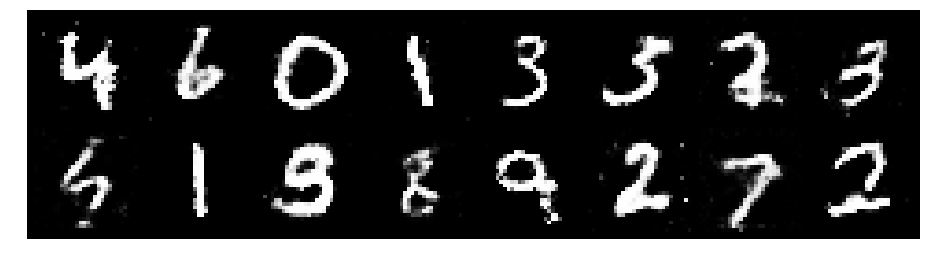

Epoch: [161/200], Batch Num: [400/600]
Discriminator Loss: 1.2603, Generator Loss: 0.9505
D(x): 0.5430, D(G(z)): 0.4368


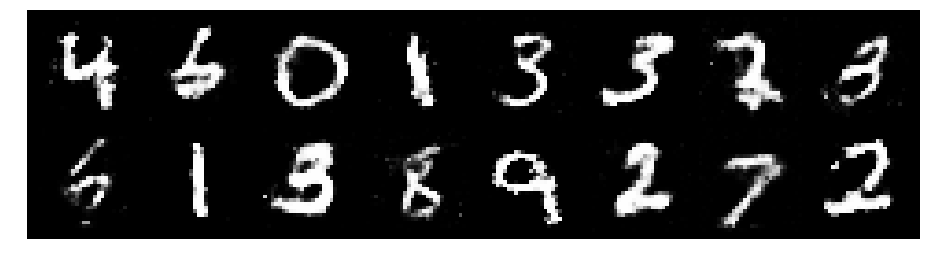

Epoch: [161/200], Batch Num: [500/600]
Discriminator Loss: 1.3243, Generator Loss: 0.8192
D(x): 0.5449, D(G(z)): 0.4684


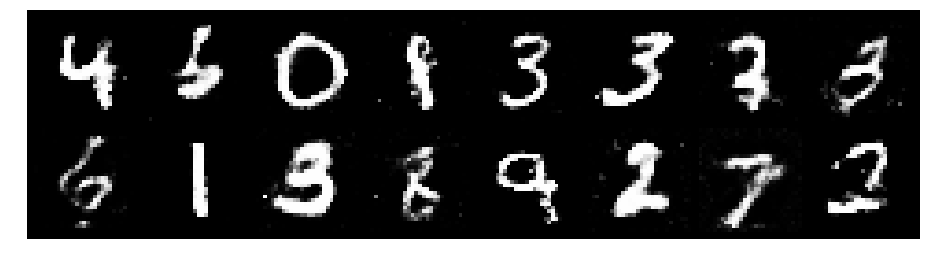

Epoch: [162/200], Batch Num: [0/600]
Discriminator Loss: 1.3618, Generator Loss: 0.7167
D(x): 0.5944, D(G(z)): 0.5148


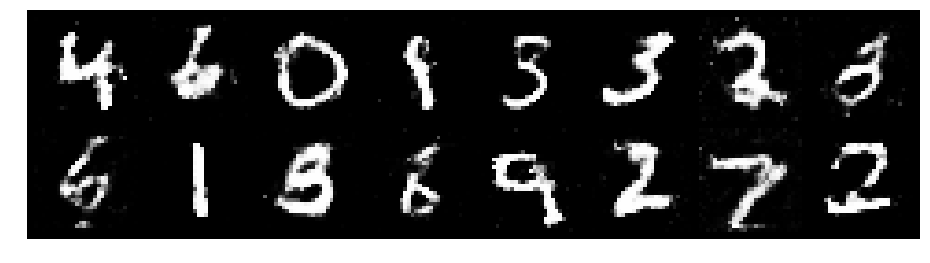

Epoch: [162/200], Batch Num: [100/600]
Discriminator Loss: 1.2876, Generator Loss: 0.8415
D(x): 0.5551, D(G(z)): 0.4431


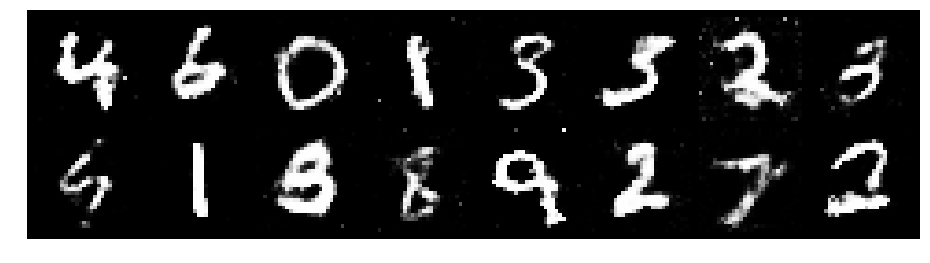

Epoch: [162/200], Batch Num: [200/600]
Discriminator Loss: 1.3228, Generator Loss: 0.7833
D(x): 0.5870, D(G(z)): 0.4927


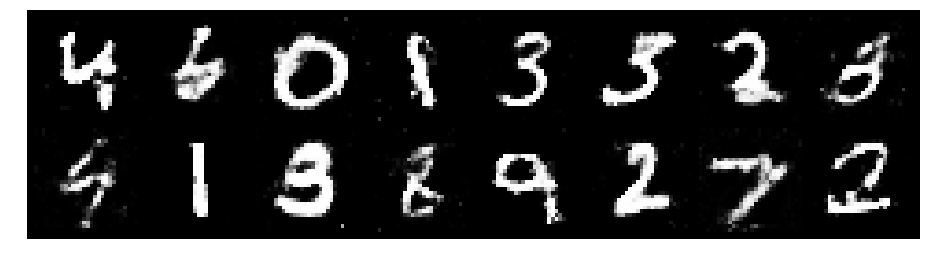

Epoch: [162/200], Batch Num: [300/600]
Discriminator Loss: 1.3227, Generator Loss: 0.8507
D(x): 0.5455, D(G(z)): 0.4587


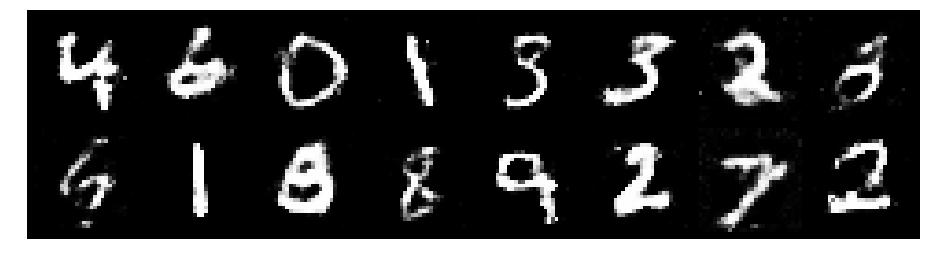

Epoch: [162/200], Batch Num: [400/600]
Discriminator Loss: 1.4024, Generator Loss: 0.7681
D(x): 0.5414, D(G(z)): 0.4745


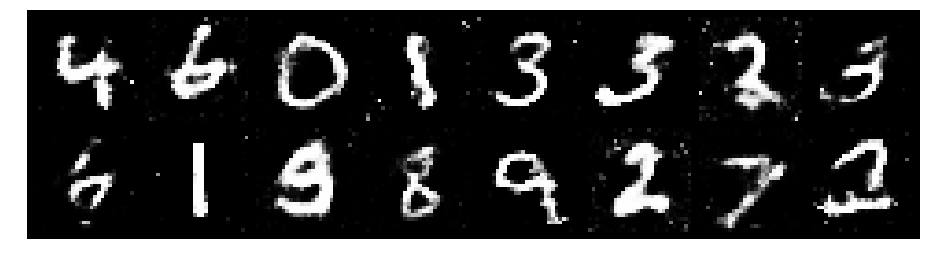

Epoch: [162/200], Batch Num: [500/600]
Discriminator Loss: 1.3230, Generator Loss: 0.7945
D(x): 0.5321, D(G(z)): 0.4707


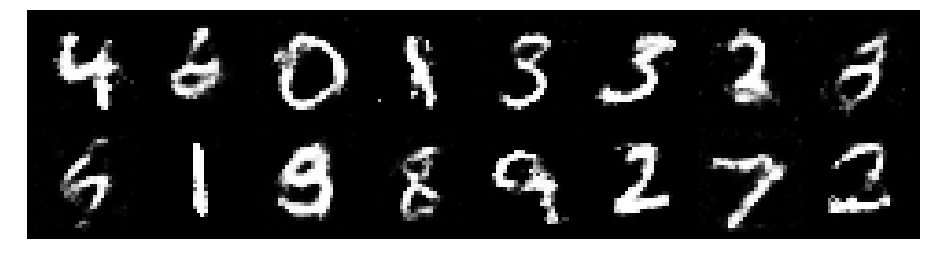

Epoch: [163/200], Batch Num: [0/600]
Discriminator Loss: 1.1757, Generator Loss: 0.8957
D(x): 0.5756, D(G(z)): 0.4162


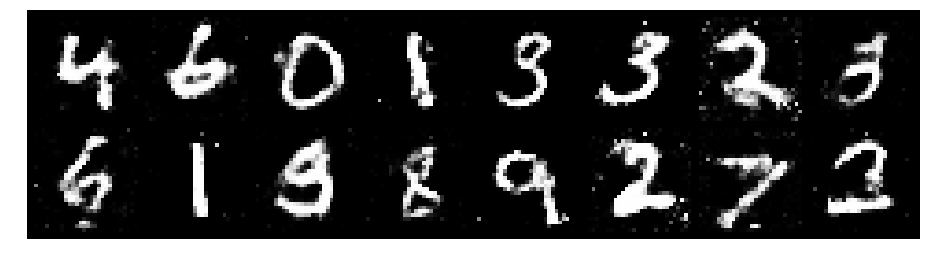

Epoch: [163/200], Batch Num: [100/600]
Discriminator Loss: 1.2271, Generator Loss: 0.8911
D(x): 0.5725, D(G(z)): 0.4201


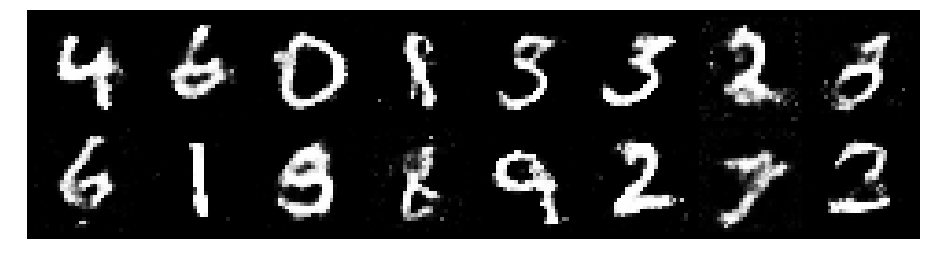

Epoch: [163/200], Batch Num: [200/600]
Discriminator Loss: 1.2279, Generator Loss: 0.8240
D(x): 0.5886, D(G(z)): 0.4534


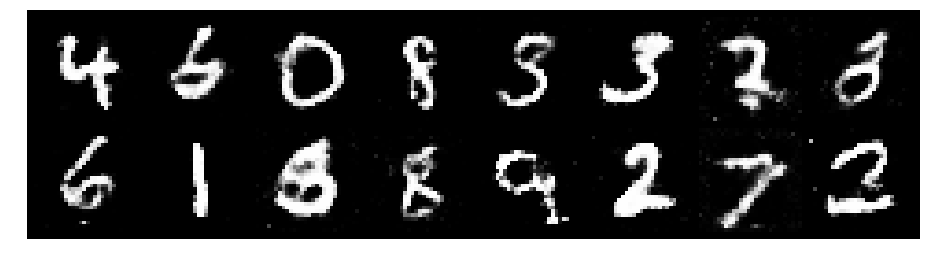

Epoch: [163/200], Batch Num: [300/600]
Discriminator Loss: 1.3154, Generator Loss: 0.7926
D(x): 0.5462, D(G(z)): 0.4556


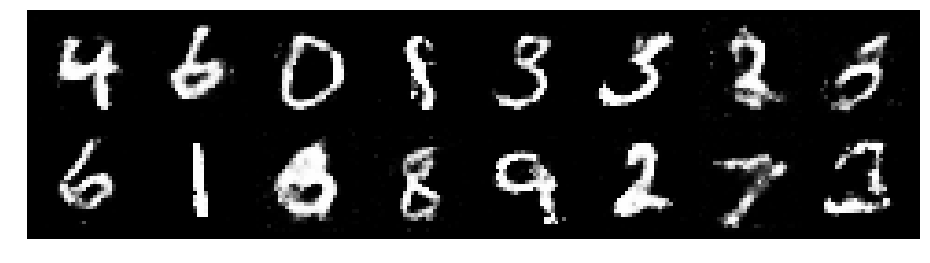

Epoch: [163/200], Batch Num: [400/600]
Discriminator Loss: 1.1424, Generator Loss: 0.8813
D(x): 0.5684, D(G(z)): 0.3922


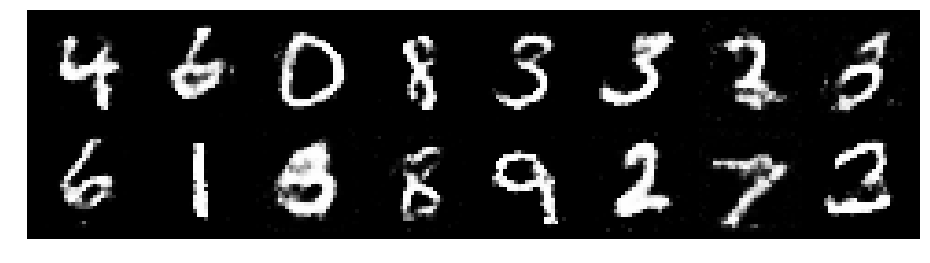

Epoch: [163/200], Batch Num: [500/600]
Discriminator Loss: 1.3031, Generator Loss: 0.8217
D(x): 0.5700, D(G(z)): 0.4669


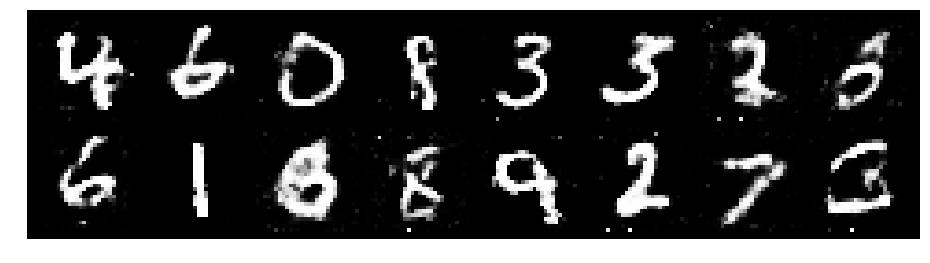

Epoch: [164/200], Batch Num: [0/600]
Discriminator Loss: 1.2635, Generator Loss: 0.8579
D(x): 0.5550, D(G(z)): 0.4282


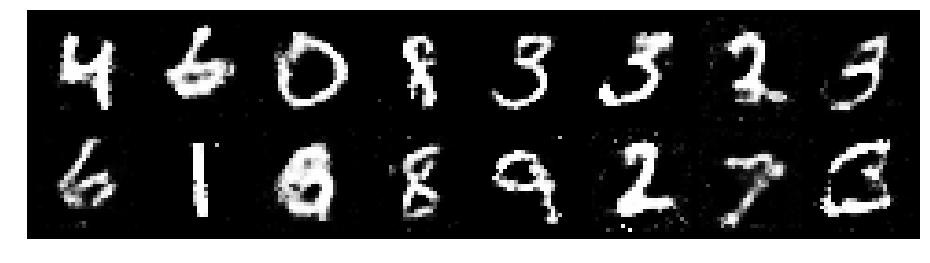

Epoch: [164/200], Batch Num: [100/600]
Discriminator Loss: 1.1488, Generator Loss: 0.9745
D(x): 0.6147, D(G(z)): 0.4351


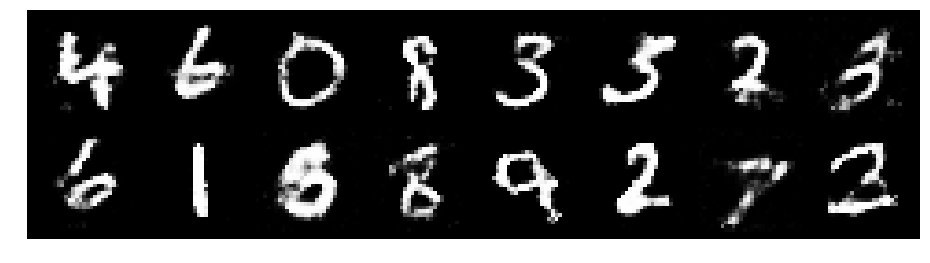

Epoch: [164/200], Batch Num: [200/600]
Discriminator Loss: 1.2911, Generator Loss: 0.9888
D(x): 0.5521, D(G(z)): 0.4429


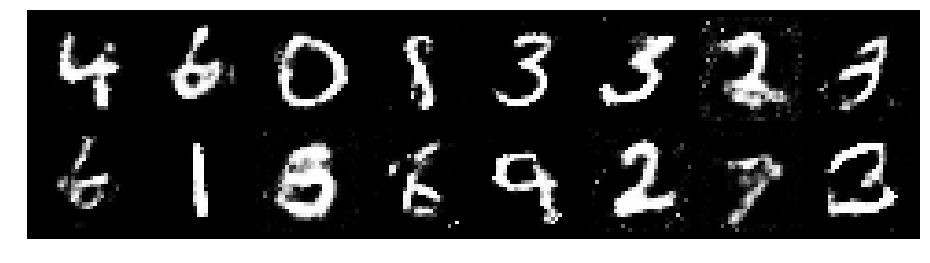

Epoch: [164/200], Batch Num: [300/600]
Discriminator Loss: 1.1536, Generator Loss: 1.0631
D(x): 0.5592, D(G(z)): 0.3764


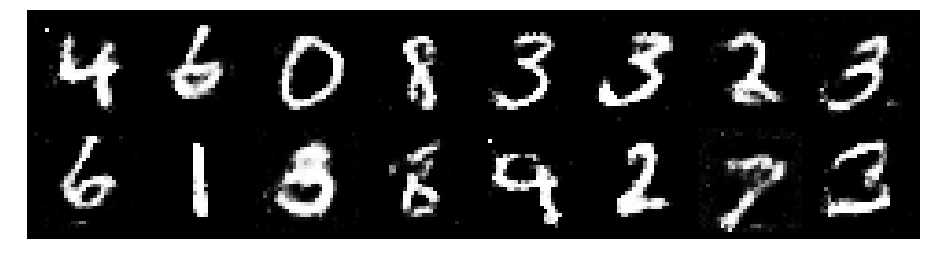

Epoch: [164/200], Batch Num: [400/600]
Discriminator Loss: 1.2662, Generator Loss: 0.9567
D(x): 0.5354, D(G(z)): 0.4346


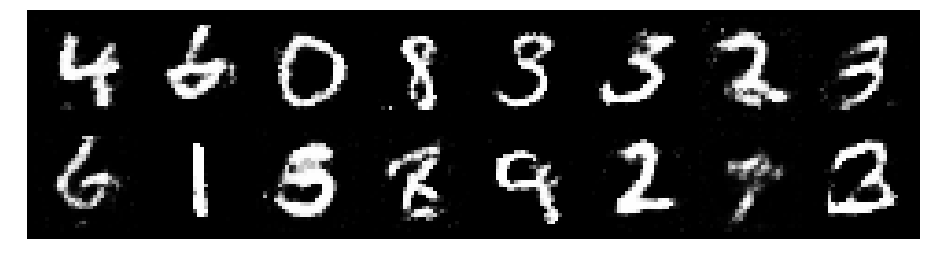

Epoch: [164/200], Batch Num: [500/600]
Discriminator Loss: 1.2843, Generator Loss: 0.8607
D(x): 0.5639, D(G(z)): 0.4698


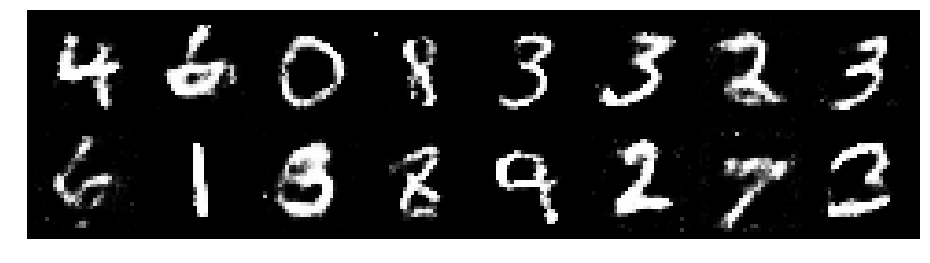

Epoch: [165/200], Batch Num: [0/600]
Discriminator Loss: 1.3087, Generator Loss: 0.8386
D(x): 0.5497, D(G(z)): 0.4577


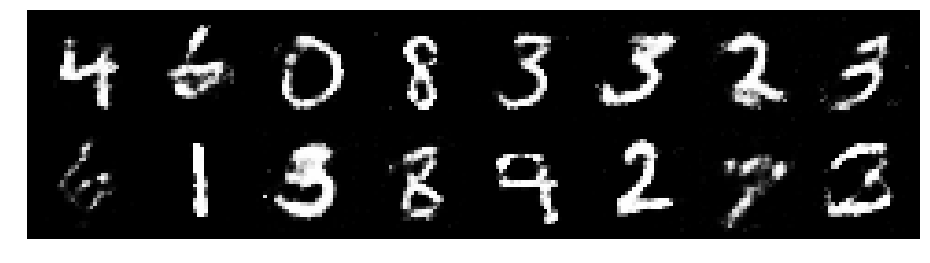

Epoch: [165/200], Batch Num: [100/600]
Discriminator Loss: 1.3787, Generator Loss: 0.7732
D(x): 0.5152, D(G(z)): 0.4728


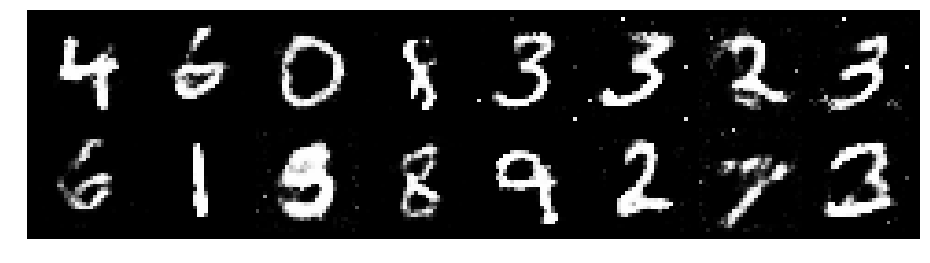

Epoch: [165/200], Batch Num: [200/600]
Discriminator Loss: 1.3072, Generator Loss: 0.8887
D(x): 0.4992, D(G(z)): 0.4101


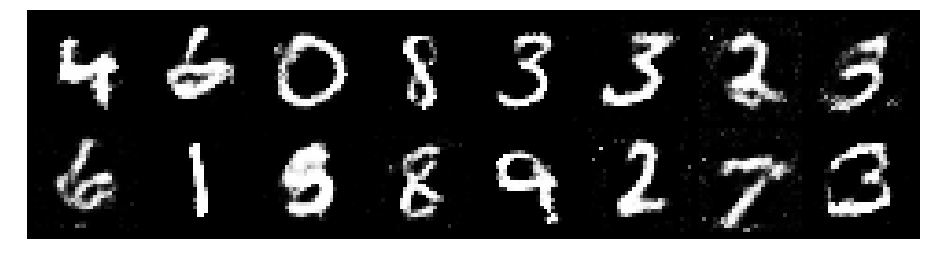

Epoch: [165/200], Batch Num: [300/600]
Discriminator Loss: 1.2511, Generator Loss: 0.9184
D(x): 0.5736, D(G(z)): 0.4473


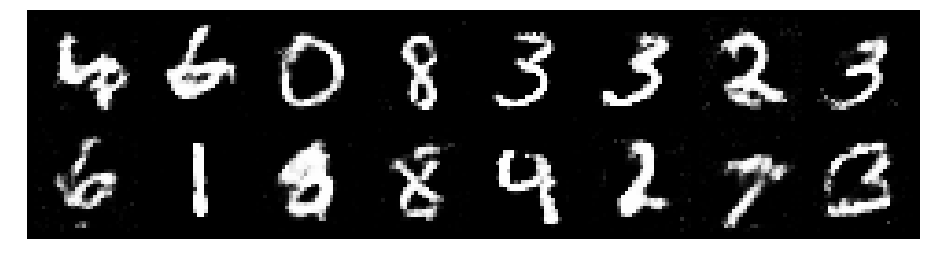

Epoch: [165/200], Batch Num: [400/600]
Discriminator Loss: 1.2596, Generator Loss: 0.9621
D(x): 0.5755, D(G(z)): 0.4370


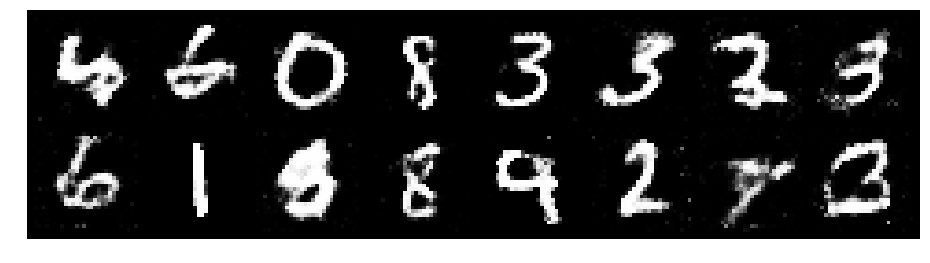

Epoch: [165/200], Batch Num: [500/600]
Discriminator Loss: 1.2868, Generator Loss: 0.9300
D(x): 0.5609, D(G(z)): 0.4636


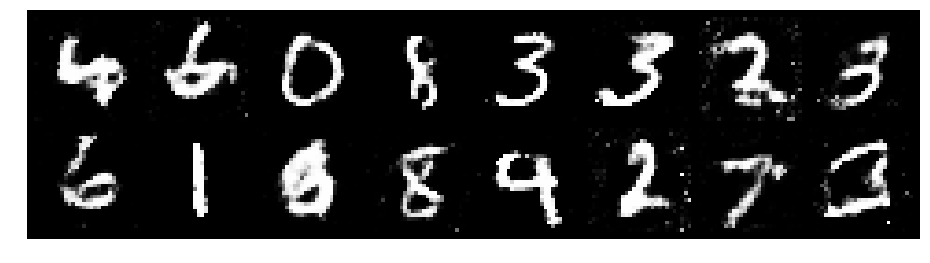

Epoch: [166/200], Batch Num: [0/600]
Discriminator Loss: 1.3321, Generator Loss: 0.9572
D(x): 0.5577, D(G(z)): 0.4690


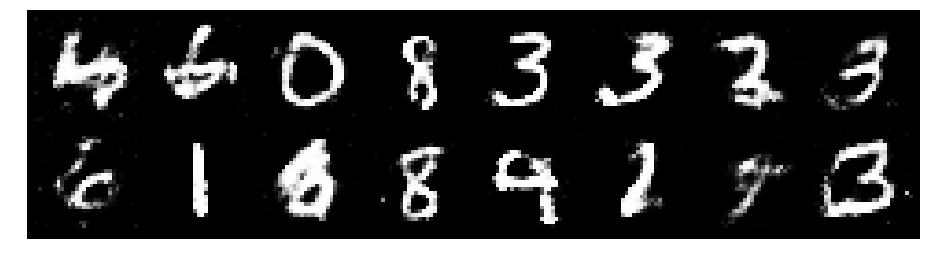

Epoch: [166/200], Batch Num: [100/600]
Discriminator Loss: 1.3246, Generator Loss: 0.8730
D(x): 0.5339, D(G(z)): 0.4477


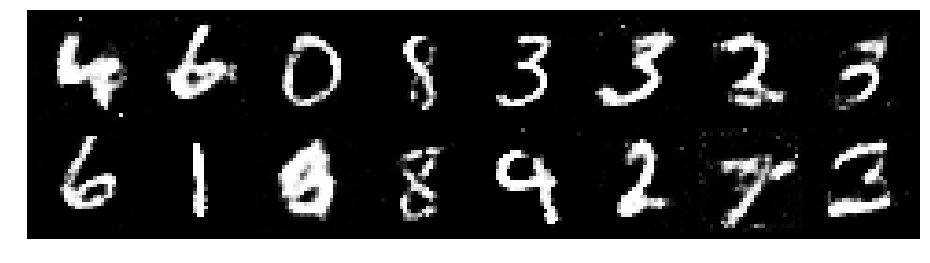

Epoch: [166/200], Batch Num: [200/600]
Discriminator Loss: 1.1397, Generator Loss: 0.9610
D(x): 0.5855, D(G(z)): 0.4138


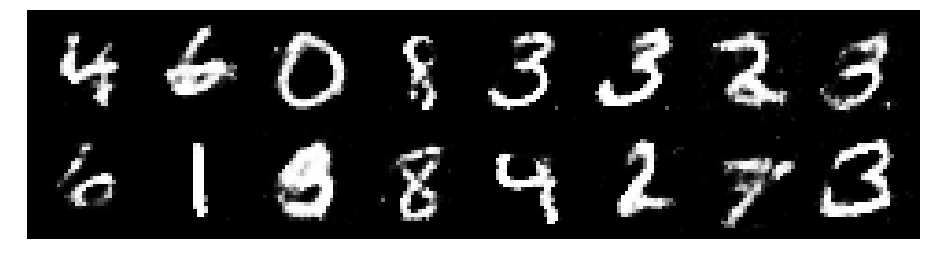

Epoch: [166/200], Batch Num: [300/600]
Discriminator Loss: 1.1367, Generator Loss: 1.0468
D(x): 0.5907, D(G(z)): 0.3981


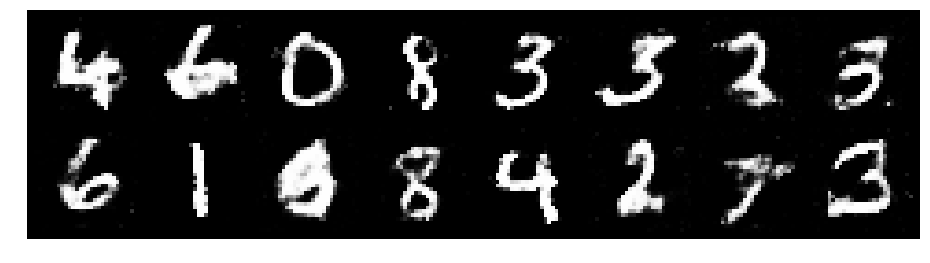

Epoch: [166/200], Batch Num: [400/600]
Discriminator Loss: 1.1789, Generator Loss: 1.1227
D(x): 0.5911, D(G(z)): 0.4162


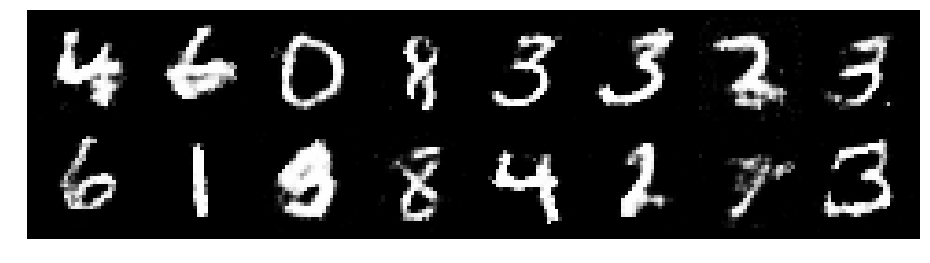

Epoch: [166/200], Batch Num: [500/600]
Discriminator Loss: 1.1428, Generator Loss: 1.0486
D(x): 0.5740, D(G(z)): 0.3793


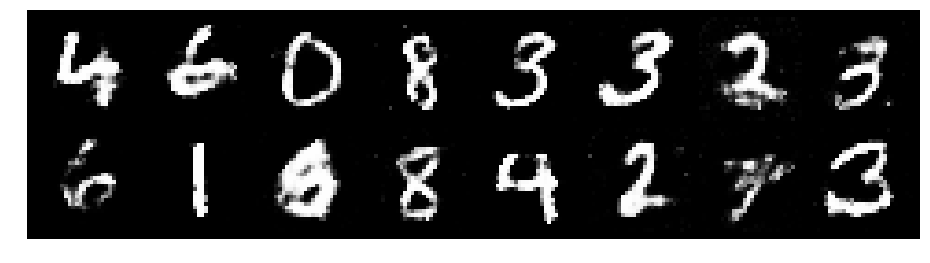

Epoch: [167/200], Batch Num: [0/600]
Discriminator Loss: 1.3987, Generator Loss: 0.9004
D(x): 0.5265, D(G(z)): 0.4730


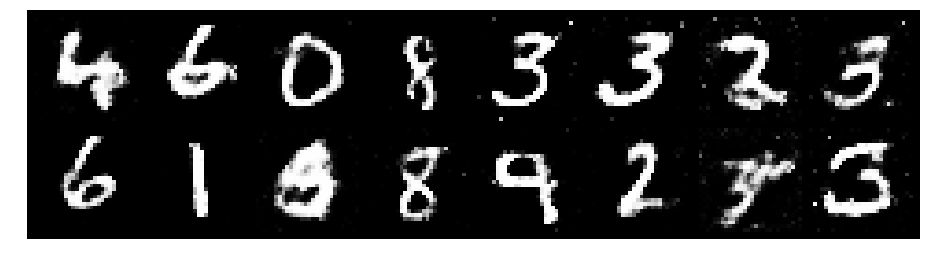

Epoch: [167/200], Batch Num: [100/600]
Discriminator Loss: 1.2630, Generator Loss: 1.0823
D(x): 0.5852, D(G(z)): 0.4426


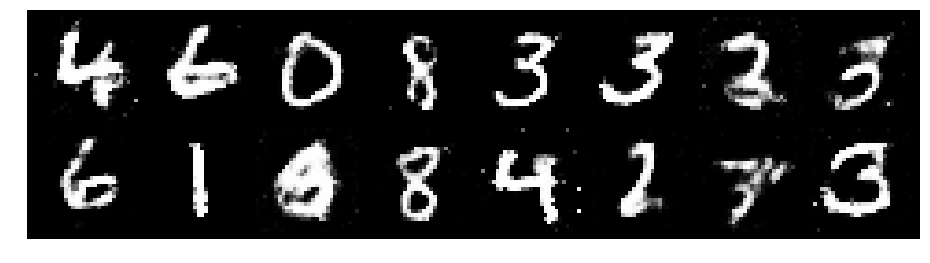

Epoch: [167/200], Batch Num: [200/600]
Discriminator Loss: 1.2477, Generator Loss: 0.9051
D(x): 0.5844, D(G(z)): 0.4547


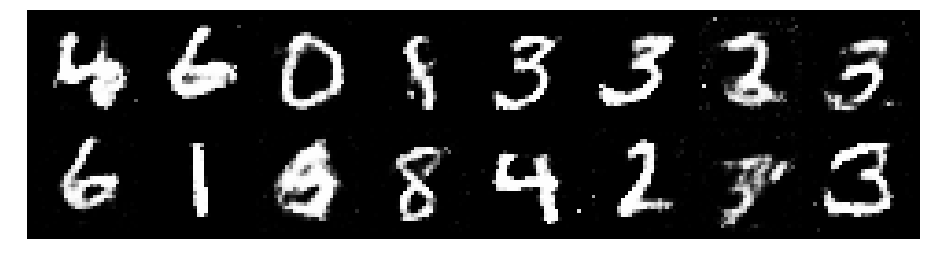

Epoch: [167/200], Batch Num: [300/600]
Discriminator Loss: 1.2649, Generator Loss: 0.8549
D(x): 0.5973, D(G(z)): 0.4774


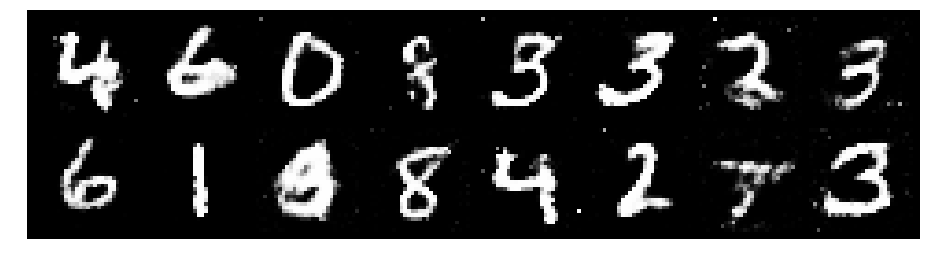

Epoch: [167/200], Batch Num: [400/600]
Discriminator Loss: 1.2822, Generator Loss: 0.7966
D(x): 0.5896, D(G(z)): 0.4864


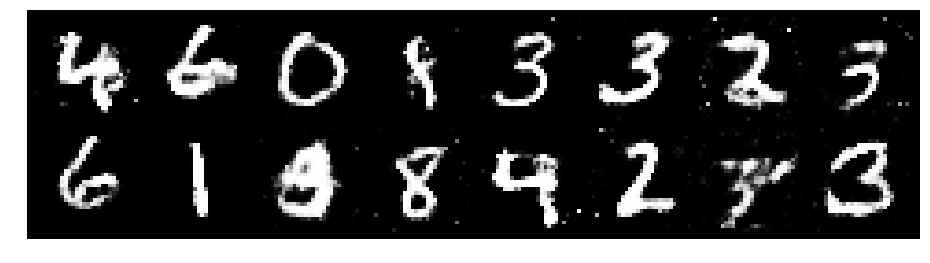

Epoch: [167/200], Batch Num: [500/600]
Discriminator Loss: 1.3771, Generator Loss: 0.7493
D(x): 0.5239, D(G(z)): 0.4834


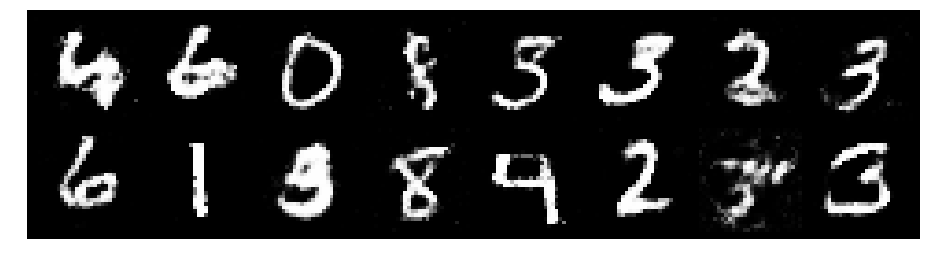

Epoch: [168/200], Batch Num: [0/600]
Discriminator Loss: 1.3874, Generator Loss: 0.8904
D(x): 0.5129, D(G(z)): 0.4530


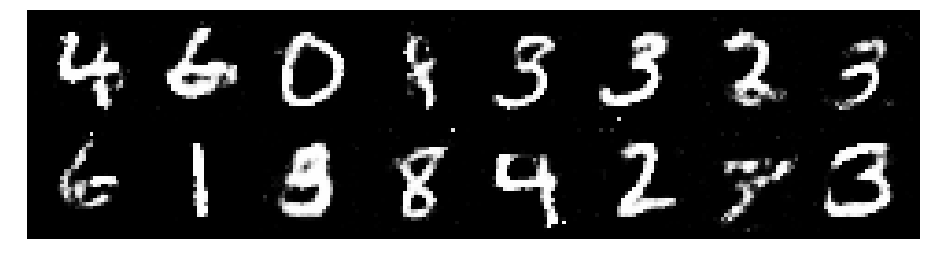

Epoch: [168/200], Batch Num: [100/600]
Discriminator Loss: 1.3316, Generator Loss: 0.8344
D(x): 0.5689, D(G(z)): 0.4775


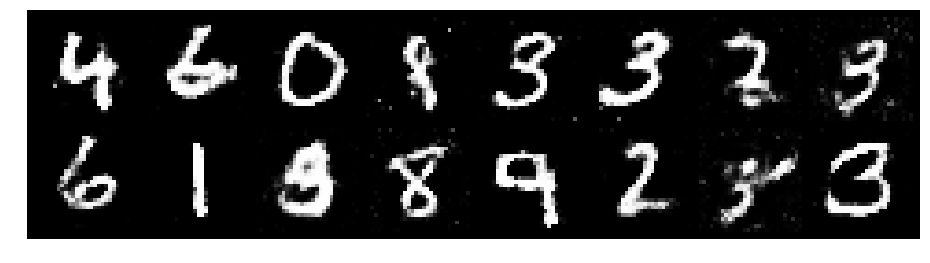

Epoch: [168/200], Batch Num: [200/600]
Discriminator Loss: 1.2916, Generator Loss: 0.8020
D(x): 0.5814, D(G(z)): 0.4660


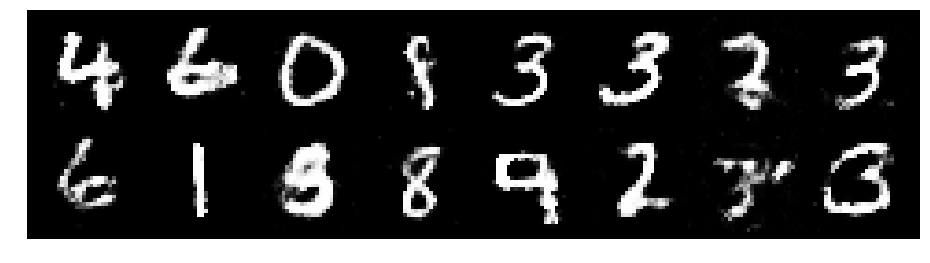

Epoch: [168/200], Batch Num: [300/600]
Discriminator Loss: 1.3435, Generator Loss: 0.8851
D(x): 0.5598, D(G(z)): 0.4839


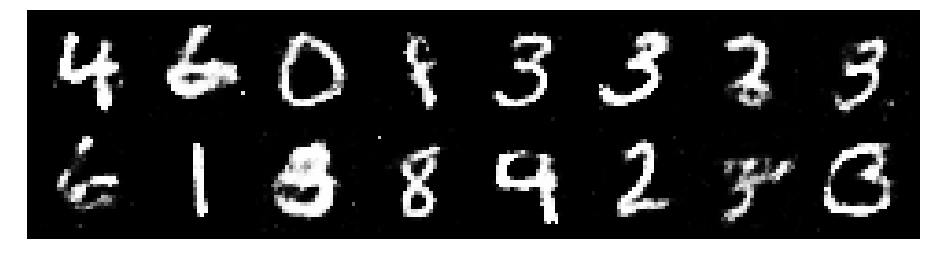

Epoch: [168/200], Batch Num: [400/600]
Discriminator Loss: 1.2870, Generator Loss: 0.8985
D(x): 0.5261, D(G(z)): 0.4163


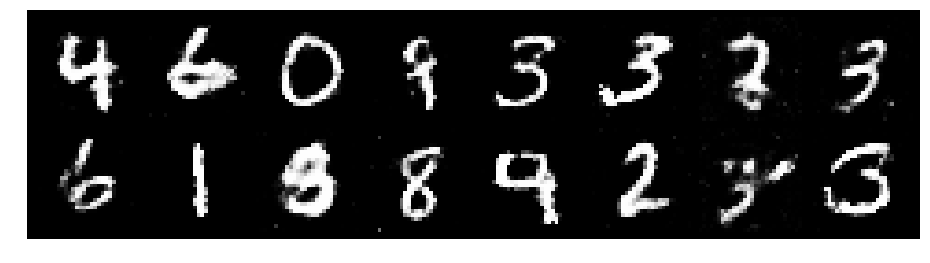

Epoch: [168/200], Batch Num: [500/600]
Discriminator Loss: 1.3200, Generator Loss: 0.8146
D(x): 0.5558, D(G(z)): 0.4566


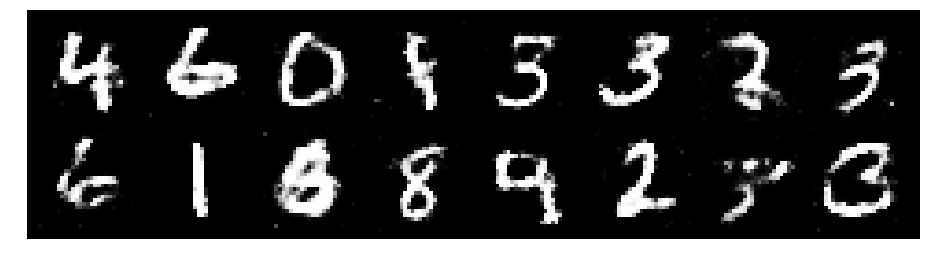

Epoch: [169/200], Batch Num: [0/600]
Discriminator Loss: 1.1715, Generator Loss: 0.8411
D(x): 0.5833, D(G(z)): 0.4225


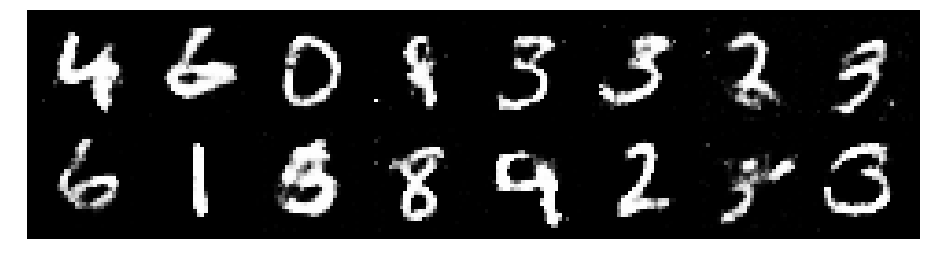

Epoch: [169/200], Batch Num: [100/600]
Discriminator Loss: 1.2554, Generator Loss: 0.9228
D(x): 0.5600, D(G(z)): 0.4329


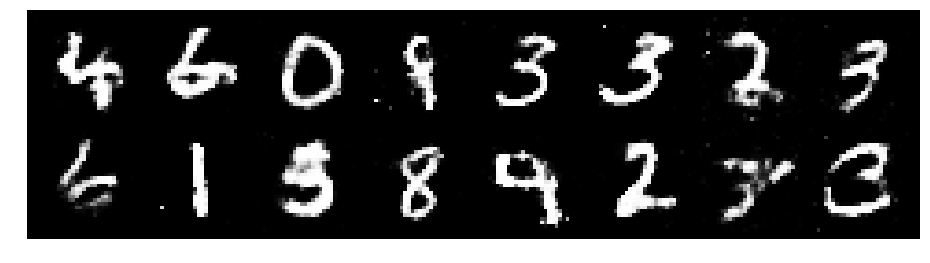

Epoch: [169/200], Batch Num: [200/600]
Discriminator Loss: 1.3976, Generator Loss: 0.9110
D(x): 0.5454, D(G(z)): 0.4652


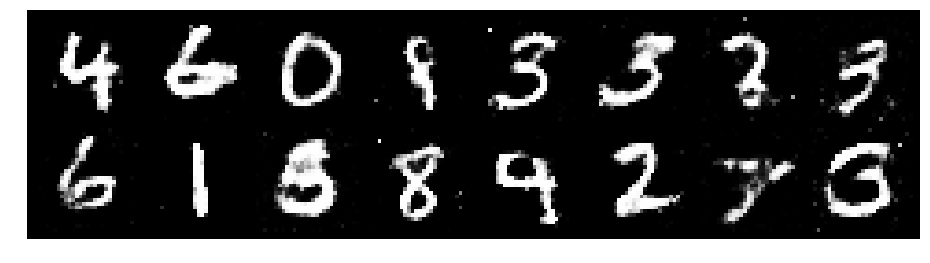

Epoch: [169/200], Batch Num: [300/600]
Discriminator Loss: 1.2912, Generator Loss: 0.7792
D(x): 0.5502, D(G(z)): 0.4529


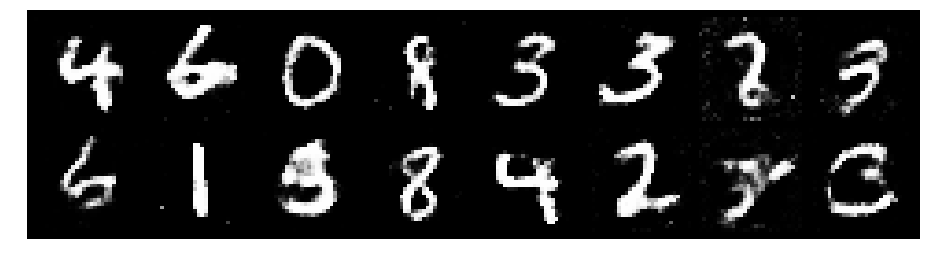

Epoch: [169/200], Batch Num: [400/600]
Discriminator Loss: 1.2586, Generator Loss: 0.8532
D(x): 0.5701, D(G(z)): 0.4595


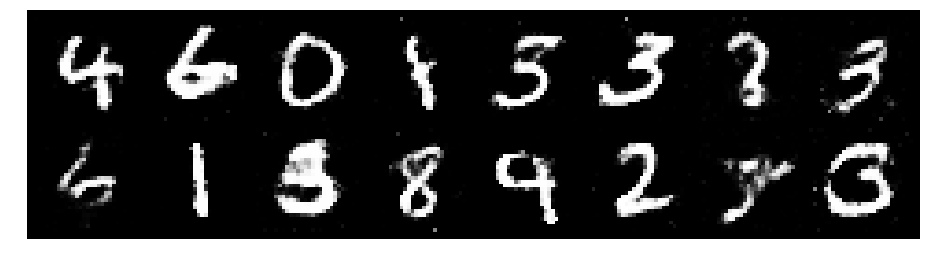

Epoch: [169/200], Batch Num: [500/600]
Discriminator Loss: 1.3437, Generator Loss: 0.9578
D(x): 0.5184, D(G(z)): 0.4465


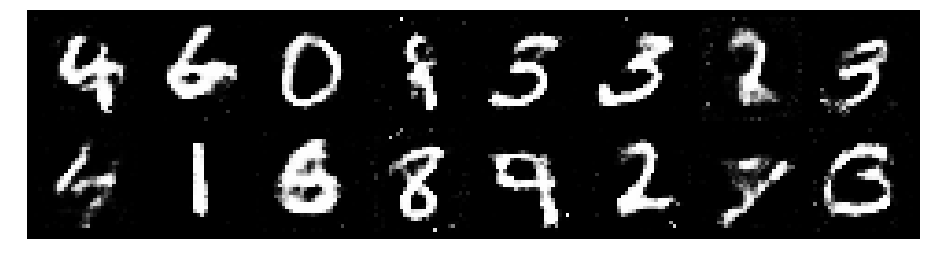

Epoch: [170/200], Batch Num: [0/600]
Discriminator Loss: 1.3345, Generator Loss: 0.8178
D(x): 0.5597, D(G(z)): 0.4890


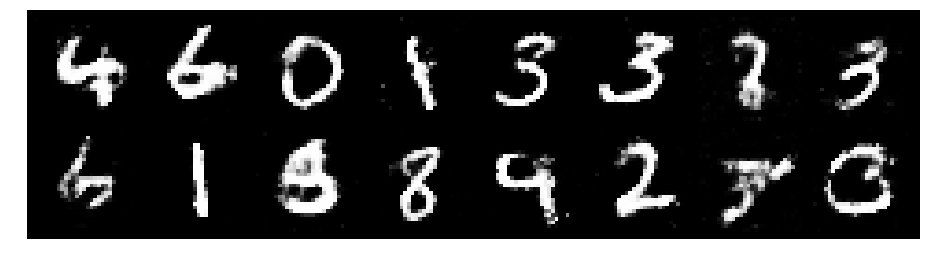

Epoch: [170/200], Batch Num: [100/600]
Discriminator Loss: 1.3088, Generator Loss: 0.9886
D(x): 0.5320, D(G(z)): 0.4360


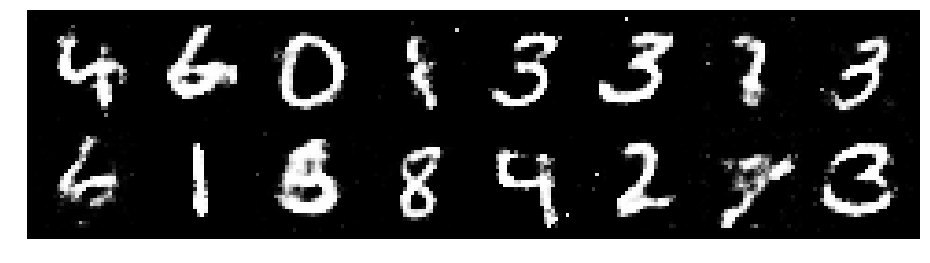

Epoch: [170/200], Batch Num: [200/600]
Discriminator Loss: 1.1972, Generator Loss: 0.8672
D(x): 0.5760, D(G(z)): 0.4441


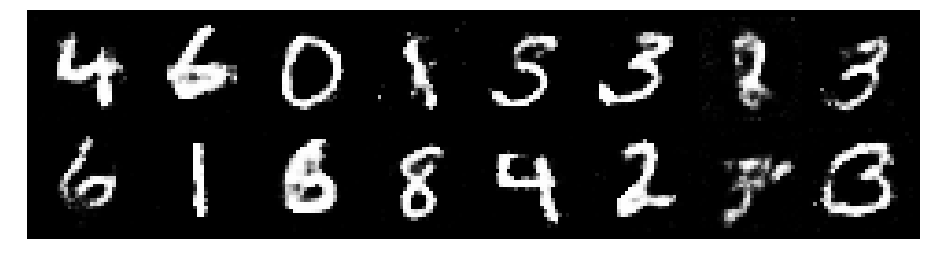

Epoch: [170/200], Batch Num: [300/600]
Discriminator Loss: 1.2598, Generator Loss: 0.9935
D(x): 0.5367, D(G(z)): 0.4215


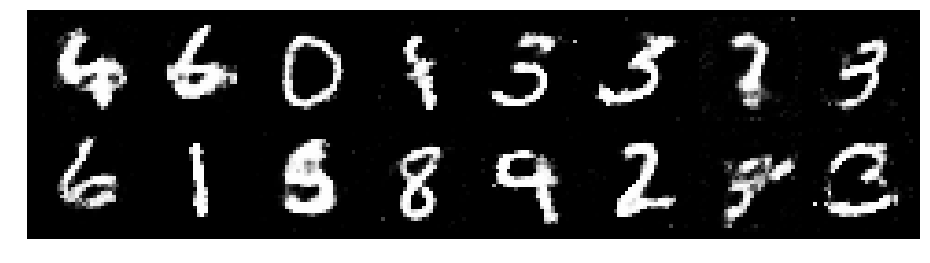

Epoch: [170/200], Batch Num: [400/600]
Discriminator Loss: 1.2813, Generator Loss: 0.8777
D(x): 0.5786, D(G(z)): 0.4713


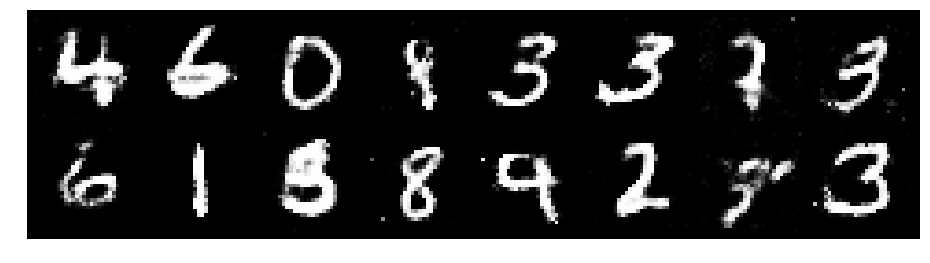

Epoch: [170/200], Batch Num: [500/600]
Discriminator Loss: 1.2961, Generator Loss: 0.9255
D(x): 0.5472, D(G(z)): 0.4364


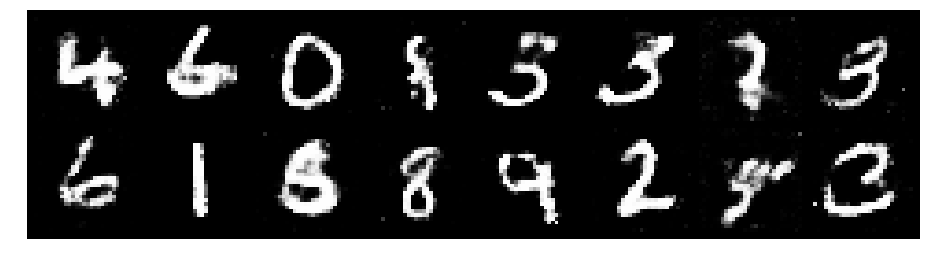

Epoch: [171/200], Batch Num: [0/600]
Discriminator Loss: 1.2498, Generator Loss: 0.9858
D(x): 0.5227, D(G(z)): 0.4078


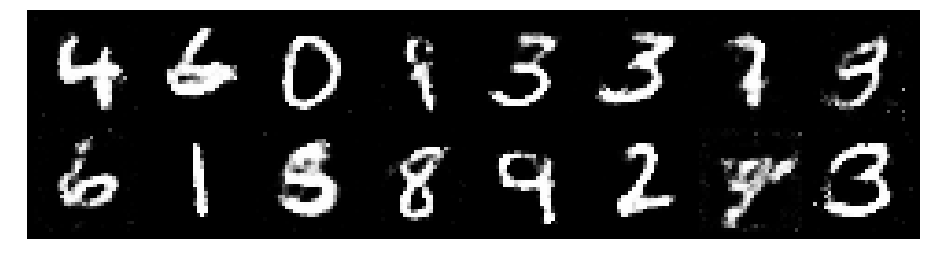

Epoch: [171/200], Batch Num: [100/600]
Discriminator Loss: 1.1605, Generator Loss: 1.0220
D(x): 0.6260, D(G(z)): 0.4393


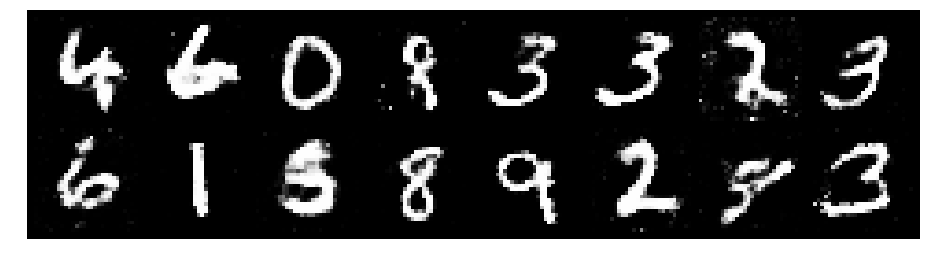

Epoch: [171/200], Batch Num: [200/600]
Discriminator Loss: 1.2238, Generator Loss: 0.9235
D(x): 0.5870, D(G(z)): 0.4363


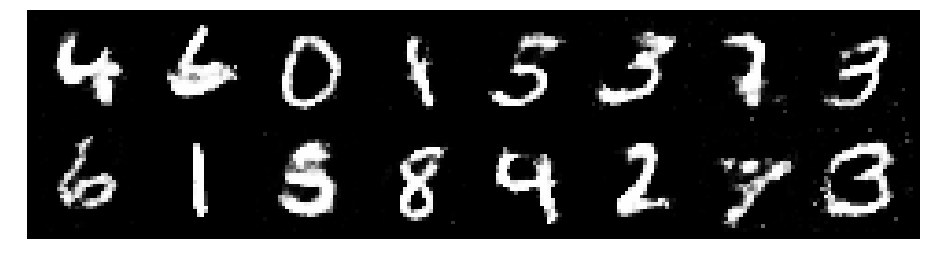

Epoch: [171/200], Batch Num: [300/600]
Discriminator Loss: 1.2141, Generator Loss: 0.9110
D(x): 0.5420, D(G(z)): 0.3942


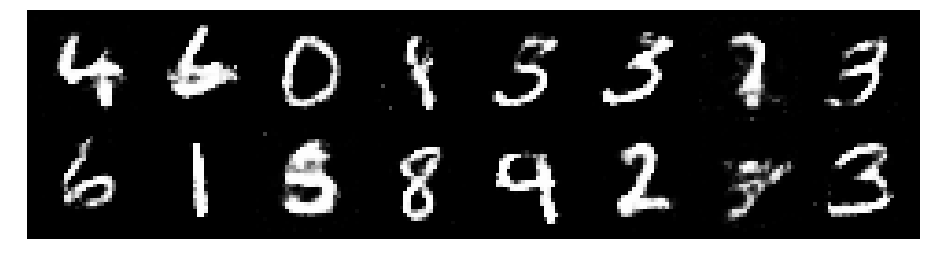

Epoch: [171/200], Batch Num: [400/600]
Discriminator Loss: 1.2951, Generator Loss: 0.8765
D(x): 0.5451, D(G(z)): 0.4452


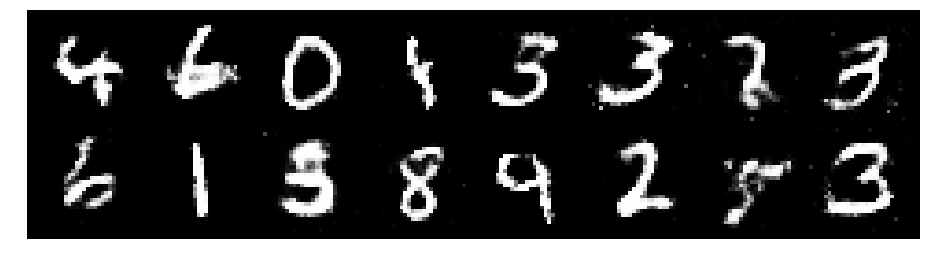

Epoch: [171/200], Batch Num: [500/600]
Discriminator Loss: 1.2768, Generator Loss: 0.8740
D(x): 0.5446, D(G(z)): 0.4491


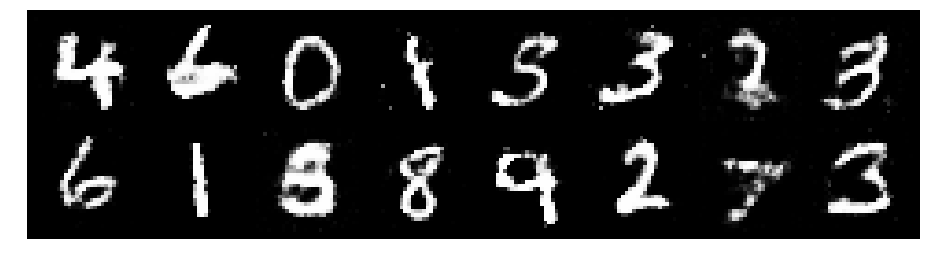

Epoch: [172/200], Batch Num: [0/600]
Discriminator Loss: 1.2126, Generator Loss: 0.9845
D(x): 0.5882, D(G(z)): 0.4567


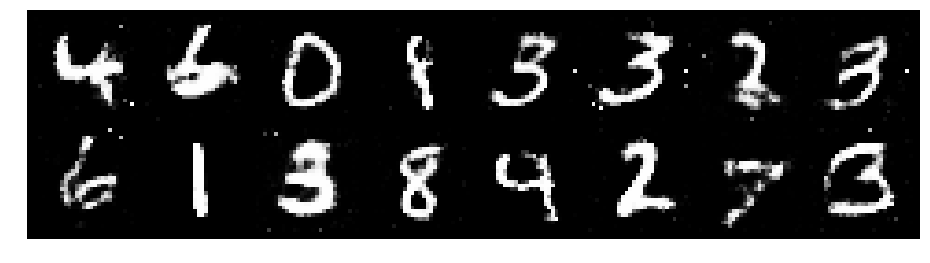

Epoch: [172/200], Batch Num: [100/600]
Discriminator Loss: 1.2088, Generator Loss: 1.0424
D(x): 0.5654, D(G(z)): 0.4247


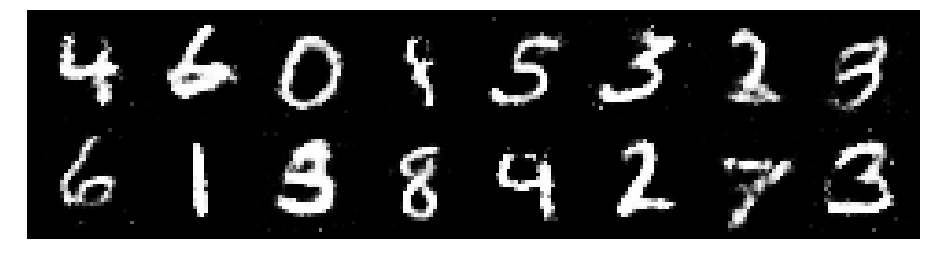

Epoch: [172/200], Batch Num: [200/600]
Discriminator Loss: 1.1436, Generator Loss: 1.0397
D(x): 0.5986, D(G(z)): 0.4064


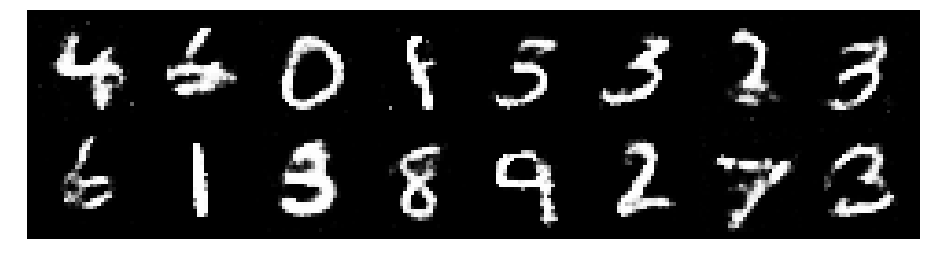

Epoch: [172/200], Batch Num: [300/600]
Discriminator Loss: 1.3165, Generator Loss: 0.9398
D(x): 0.5093, D(G(z)): 0.4426


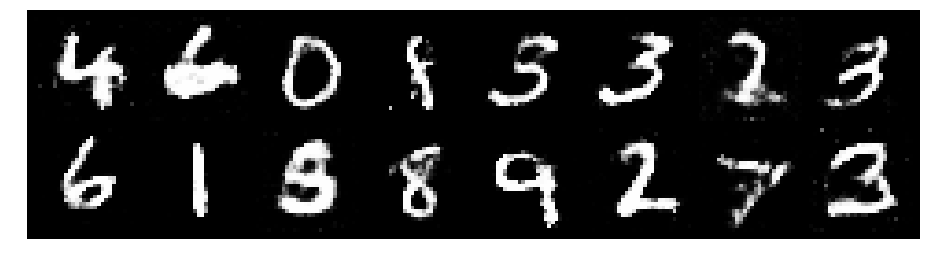

Epoch: [172/200], Batch Num: [400/600]
Discriminator Loss: 1.2415, Generator Loss: 0.7903
D(x): 0.5749, D(G(z)): 0.4587


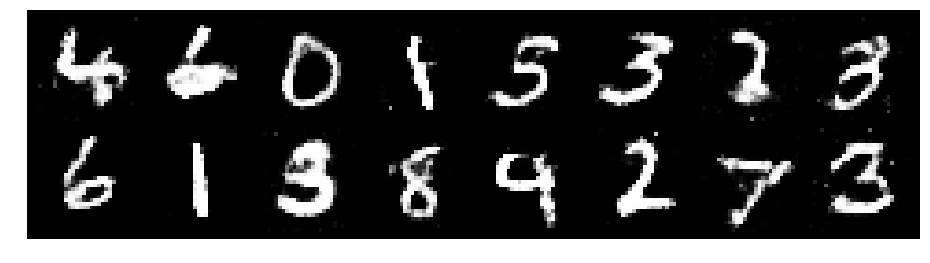

Epoch: [172/200], Batch Num: [500/600]
Discriminator Loss: 1.3252, Generator Loss: 0.8627
D(x): 0.5288, D(G(z)): 0.4589


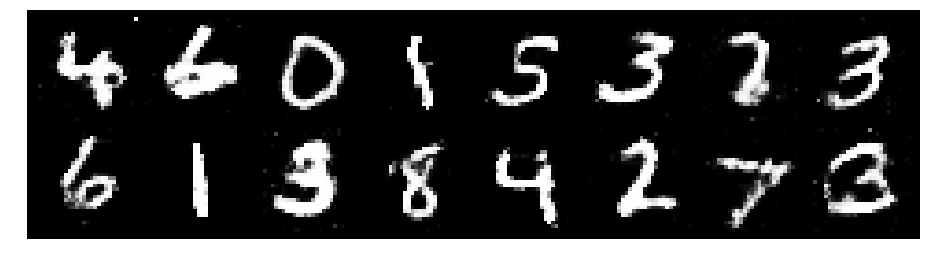

Epoch: [173/200], Batch Num: [0/600]
Discriminator Loss: 1.1998, Generator Loss: 0.8500
D(x): 0.5517, D(G(z)): 0.4031


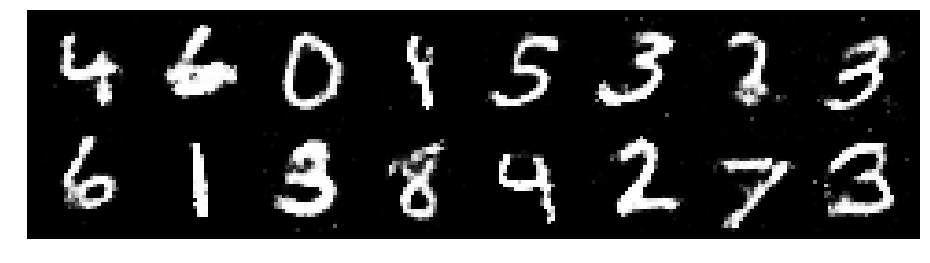

Epoch: [173/200], Batch Num: [100/600]
Discriminator Loss: 1.3955, Generator Loss: 0.9320
D(x): 0.5563, D(G(z)): 0.4793


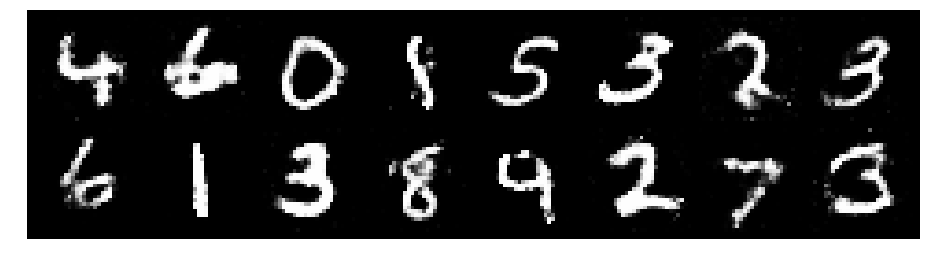

Epoch: [173/200], Batch Num: [200/600]
Discriminator Loss: 1.3143, Generator Loss: 0.9203
D(x): 0.6015, D(G(z)): 0.4661


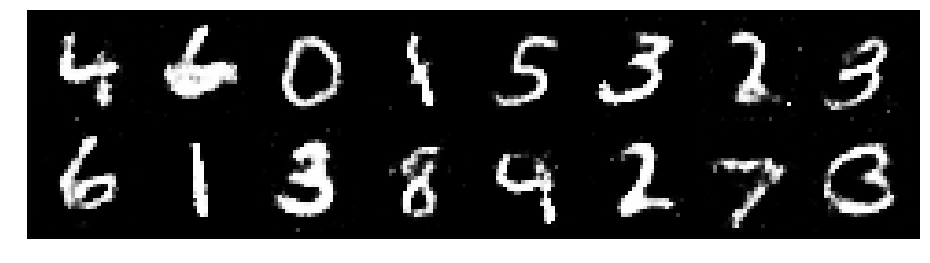

Epoch: [173/200], Batch Num: [300/600]
Discriminator Loss: 1.3359, Generator Loss: 0.8280
D(x): 0.5398, D(G(z)): 0.4611


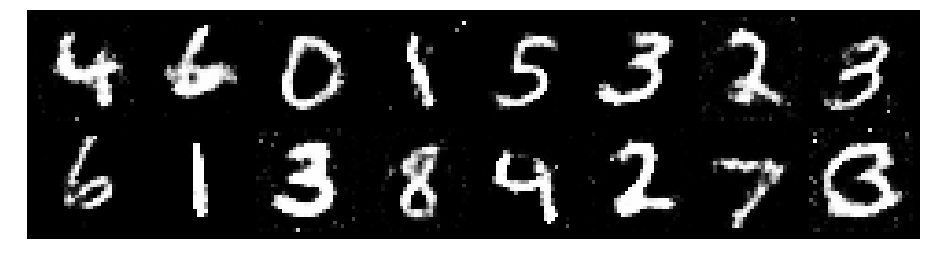

Epoch: [173/200], Batch Num: [400/600]
Discriminator Loss: 1.3734, Generator Loss: 0.8914
D(x): 0.5095, D(G(z)): 0.4567


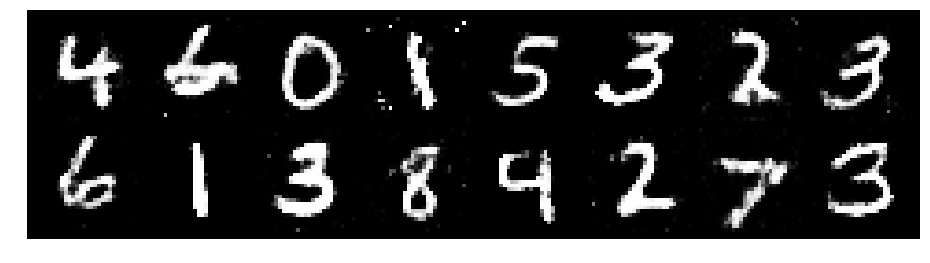

Epoch: [173/200], Batch Num: [500/600]
Discriminator Loss: 1.2730, Generator Loss: 0.8158
D(x): 0.5638, D(G(z)): 0.4659


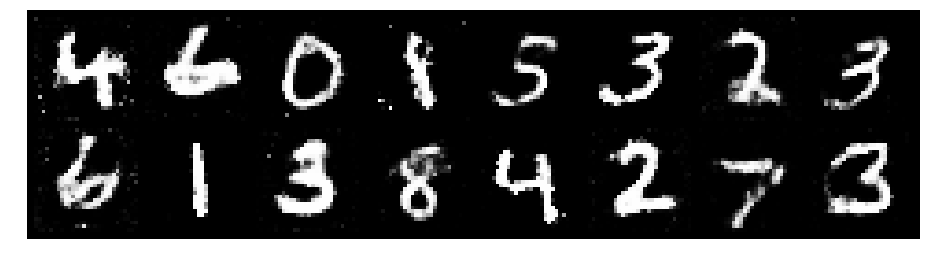

Epoch: [174/200], Batch Num: [0/600]
Discriminator Loss: 1.1738, Generator Loss: 1.0148
D(x): 0.5906, D(G(z)): 0.4345


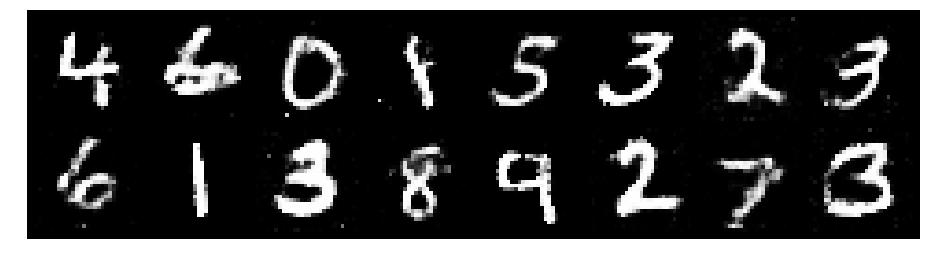

Epoch: [174/200], Batch Num: [100/600]
Discriminator Loss: 1.2220, Generator Loss: 0.9494
D(x): 0.5449, D(G(z)): 0.4032


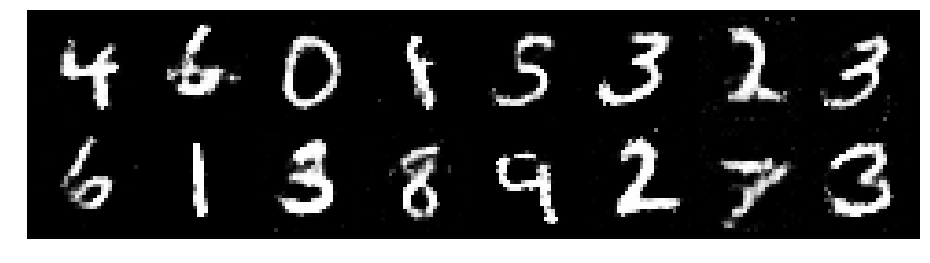

Epoch: [174/200], Batch Num: [200/600]
Discriminator Loss: 1.1843, Generator Loss: 0.8923
D(x): 0.5602, D(G(z)): 0.4283


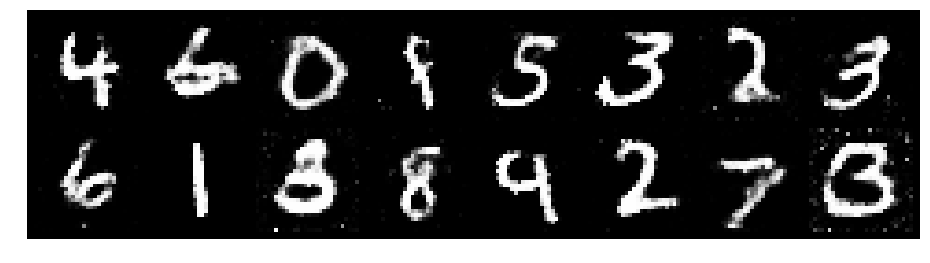

Epoch: [174/200], Batch Num: [300/600]
Discriminator Loss: 1.2975, Generator Loss: 0.8579
D(x): 0.5890, D(G(z)): 0.4834


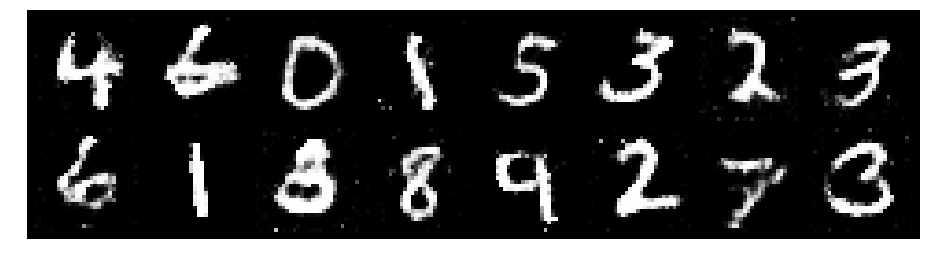

Epoch: [174/200], Batch Num: [400/600]
Discriminator Loss: 1.2881, Generator Loss: 0.9089
D(x): 0.5376, D(G(z)): 0.4397


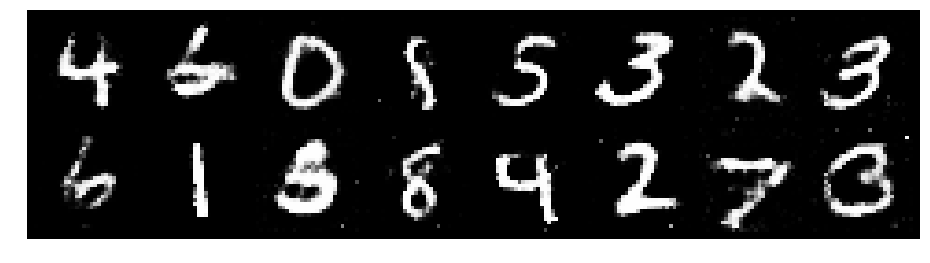

Epoch: [174/200], Batch Num: [500/600]
Discriminator Loss: 1.3023, Generator Loss: 0.8623
D(x): 0.5219, D(G(z)): 0.4400


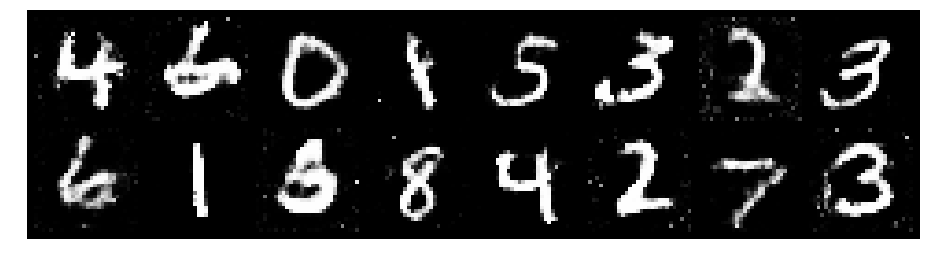

Epoch: [175/200], Batch Num: [0/600]
Discriminator Loss: 1.2982, Generator Loss: 0.8301
D(x): 0.5561, D(G(z)): 0.4545


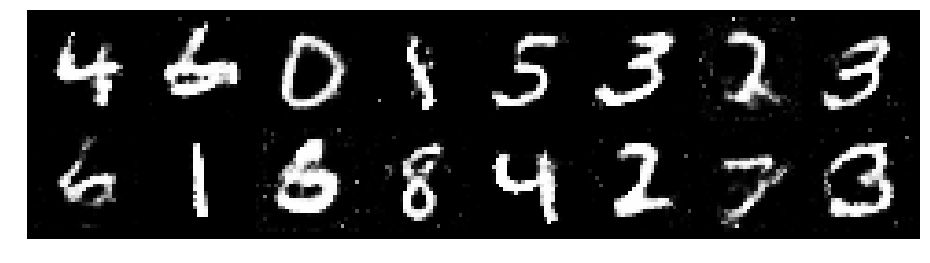

Epoch: [175/200], Batch Num: [100/600]
Discriminator Loss: 1.2691, Generator Loss: 0.8051
D(x): 0.5440, D(G(z)): 0.4412


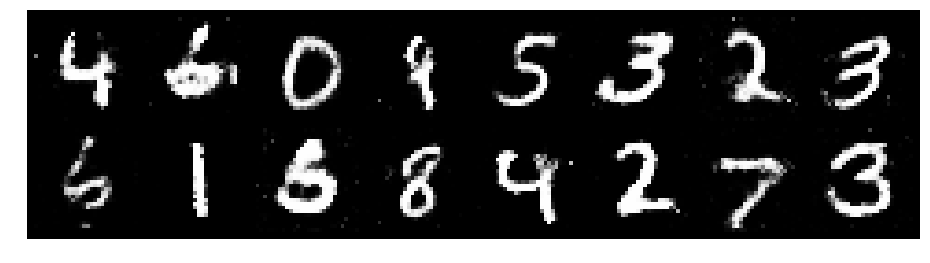

Epoch: [175/200], Batch Num: [200/600]
Discriminator Loss: 1.2485, Generator Loss: 0.9116
D(x): 0.6243, D(G(z)): 0.4801


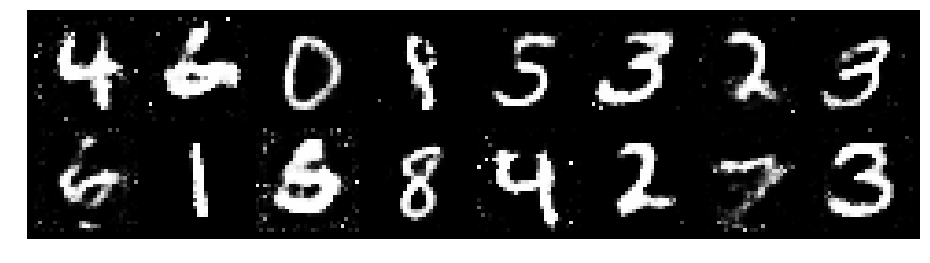

Epoch: [175/200], Batch Num: [300/600]
Discriminator Loss: 1.2031, Generator Loss: 0.9810
D(x): 0.5856, D(G(z)): 0.4070


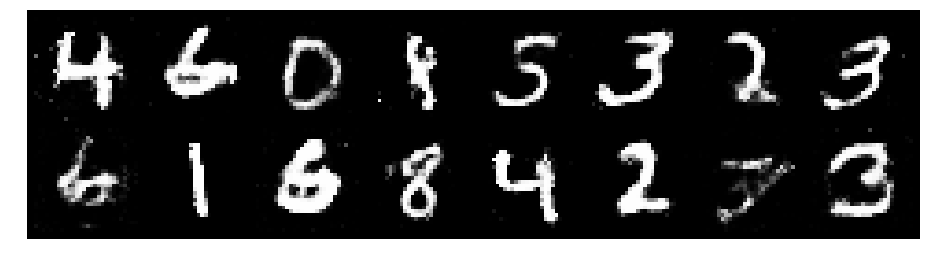

Epoch: [175/200], Batch Num: [400/600]
Discriminator Loss: 1.3084, Generator Loss: 0.8086
D(x): 0.5640, D(G(z)): 0.4707


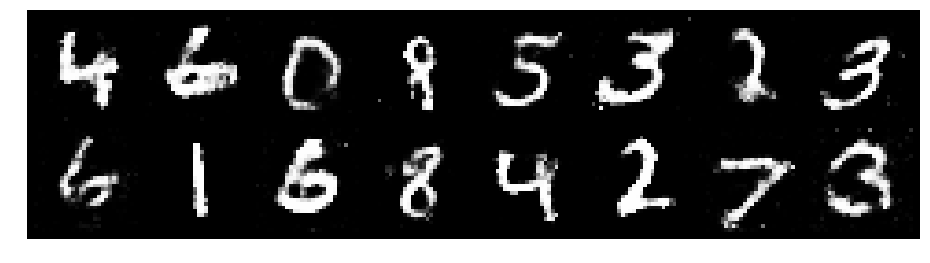

Epoch: [175/200], Batch Num: [500/600]
Discriminator Loss: 1.3231, Generator Loss: 0.8733
D(x): 0.5990, D(G(z)): 0.4848


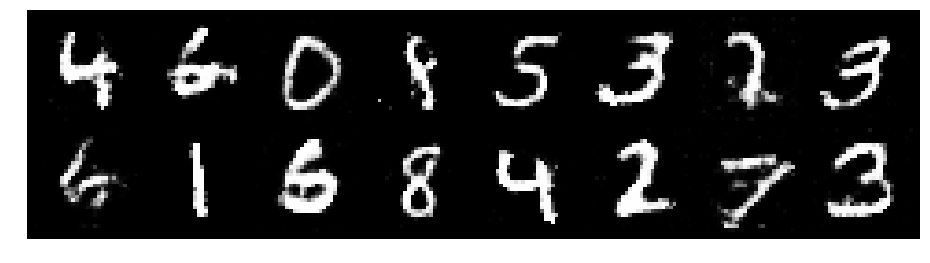

Epoch: [176/200], Batch Num: [0/600]
Discriminator Loss: 1.2996, Generator Loss: 0.8006
D(x): 0.5357, D(G(z)): 0.4634


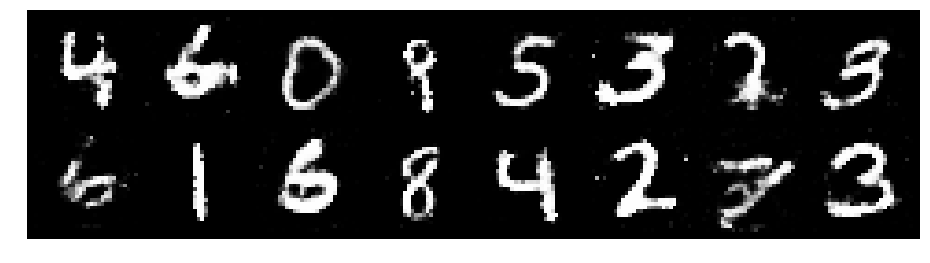

Epoch: [176/200], Batch Num: [100/600]
Discriminator Loss: 1.3441, Generator Loss: 0.7997
D(x): 0.5547, D(G(z)): 0.4967


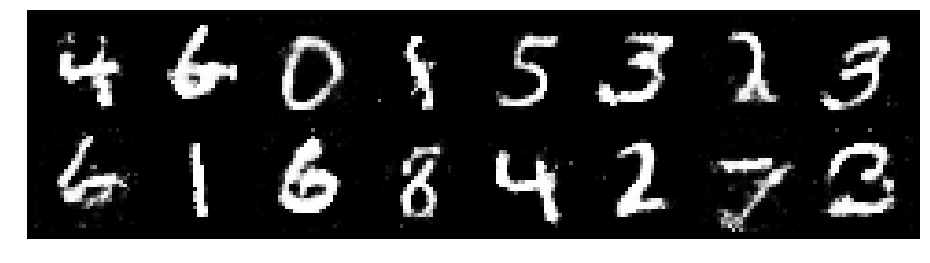

Epoch: [176/200], Batch Num: [200/600]
Discriminator Loss: 1.2786, Generator Loss: 0.8945
D(x): 0.5371, D(G(z)): 0.4303


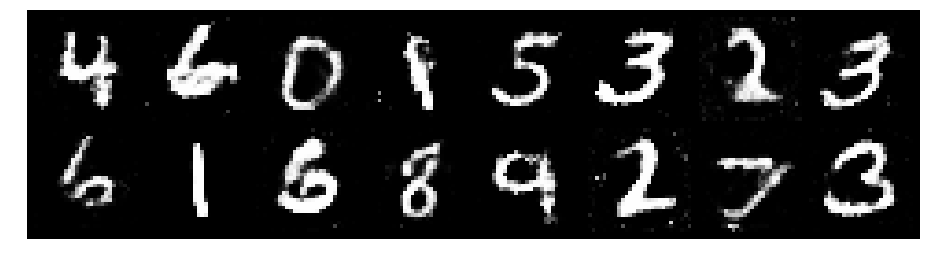

Epoch: [176/200], Batch Num: [300/600]
Discriminator Loss: 1.2074, Generator Loss: 0.8356
D(x): 0.5668, D(G(z)): 0.4339


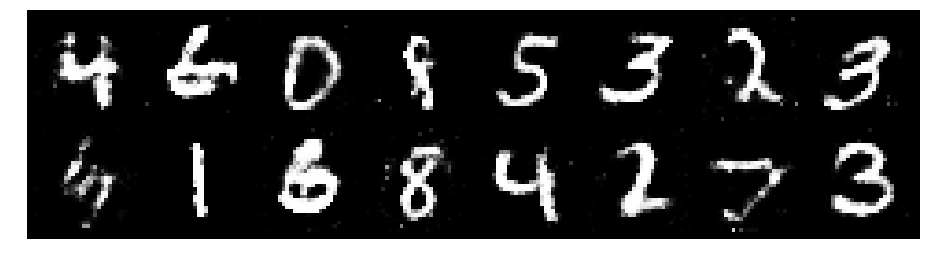

Epoch: [176/200], Batch Num: [400/600]
Discriminator Loss: 1.2296, Generator Loss: 0.8614
D(x): 0.5548, D(G(z)): 0.4310


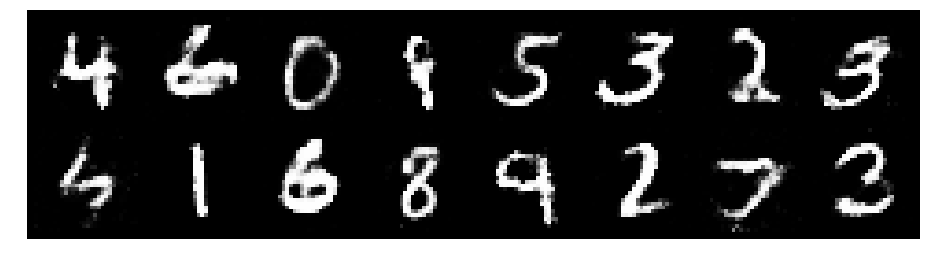

Epoch: [176/200], Batch Num: [500/600]
Discriminator Loss: 1.2141, Generator Loss: 1.0044
D(x): 0.5503, D(G(z)): 0.4198


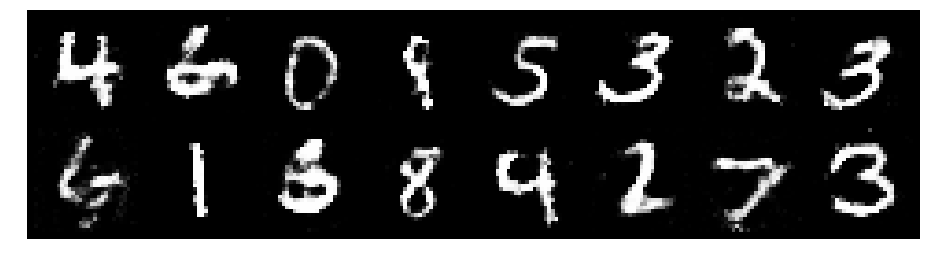

Epoch: [177/200], Batch Num: [0/600]
Discriminator Loss: 1.2413, Generator Loss: 0.9466
D(x): 0.5496, D(G(z)): 0.4210


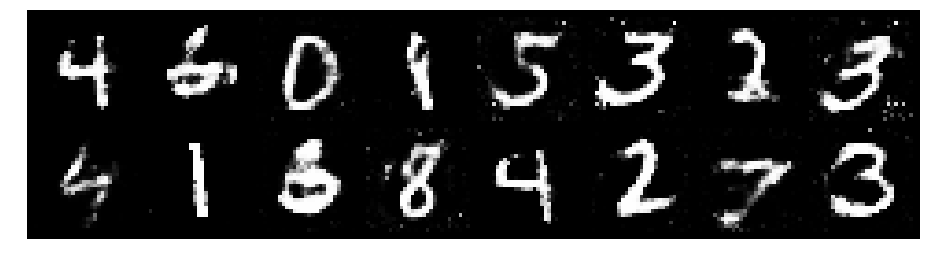

Epoch: [177/200], Batch Num: [100/600]
Discriminator Loss: 1.3458, Generator Loss: 0.9399
D(x): 0.4914, D(G(z)): 0.4102


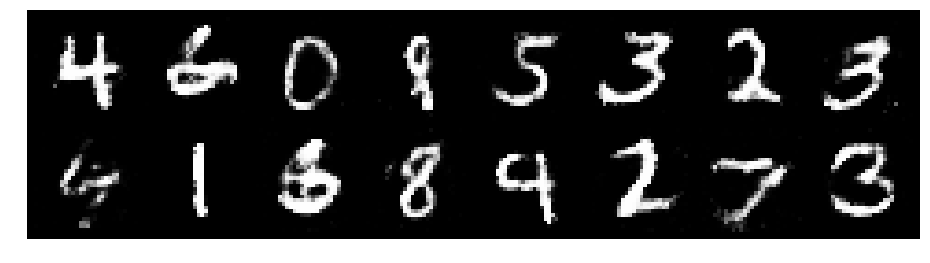

Epoch: [177/200], Batch Num: [200/600]
Discriminator Loss: 1.1928, Generator Loss: 0.8806
D(x): 0.5615, D(G(z)): 0.4149


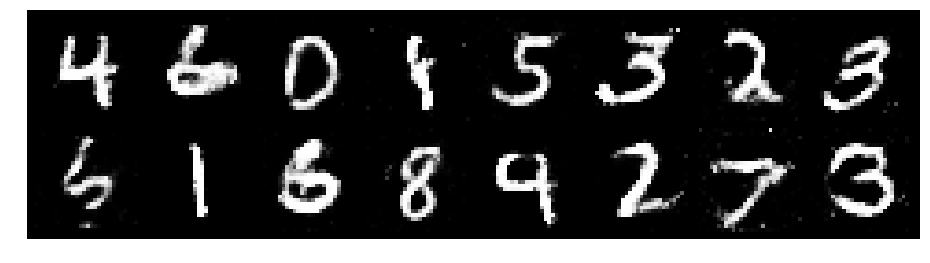

Epoch: [177/200], Batch Num: [300/600]
Discriminator Loss: 1.2323, Generator Loss: 1.0520
D(x): 0.5517, D(G(z)): 0.4087


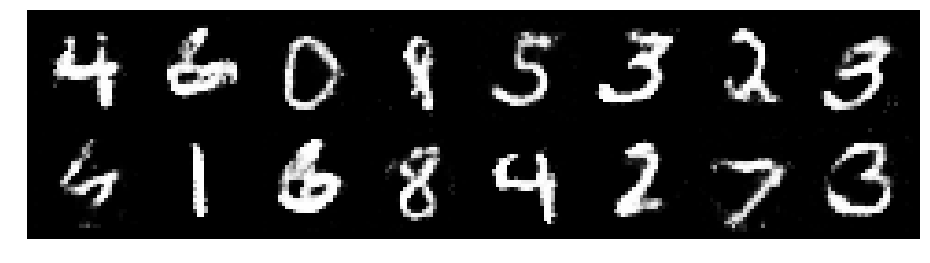

Epoch: [177/200], Batch Num: [400/600]
Discriminator Loss: 1.2285, Generator Loss: 0.7700
D(x): 0.5668, D(G(z)): 0.4388


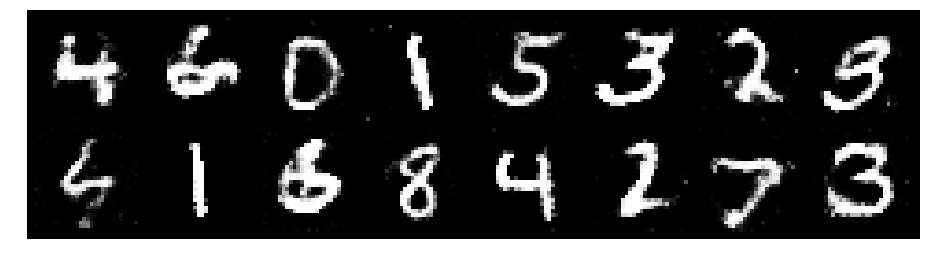

Epoch: [177/200], Batch Num: [500/600]
Discriminator Loss: 1.2122, Generator Loss: 0.9196
D(x): 0.5610, D(G(z)): 0.4198


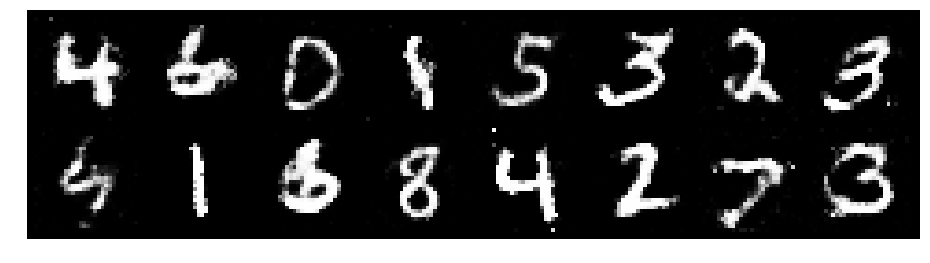

Epoch: [178/200], Batch Num: [0/600]
Discriminator Loss: 1.1975, Generator Loss: 0.9164
D(x): 0.5162, D(G(z)): 0.3821


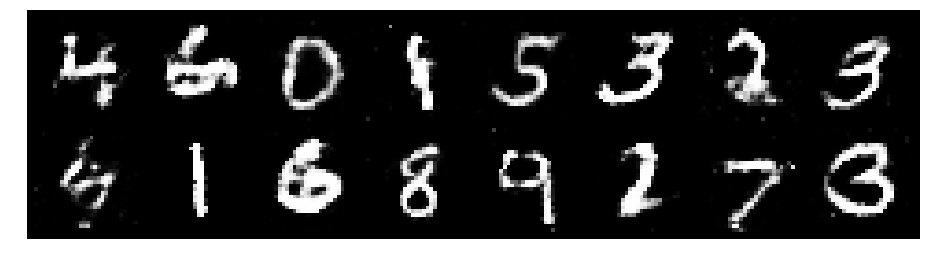

Epoch: [178/200], Batch Num: [100/600]
Discriminator Loss: 1.2953, Generator Loss: 0.7340
D(x): 0.5382, D(G(z)): 0.4511


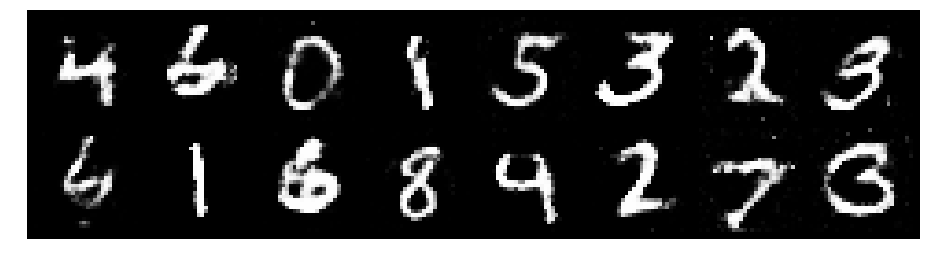

Epoch: [178/200], Batch Num: [200/600]
Discriminator Loss: 1.2730, Generator Loss: 0.9556
D(x): 0.5703, D(G(z)): 0.4388


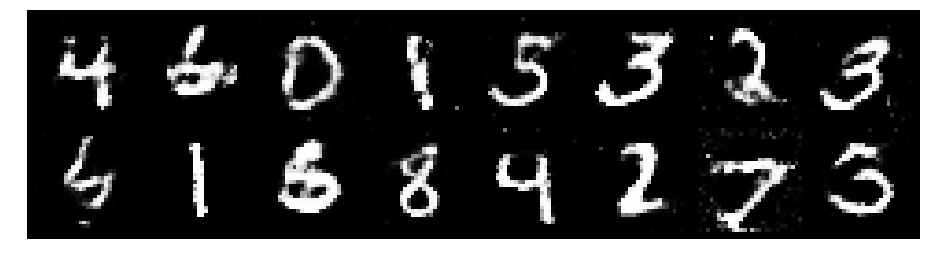

Epoch: [178/200], Batch Num: [300/600]
Discriminator Loss: 1.2889, Generator Loss: 0.8868
D(x): 0.5849, D(G(z)): 0.4581


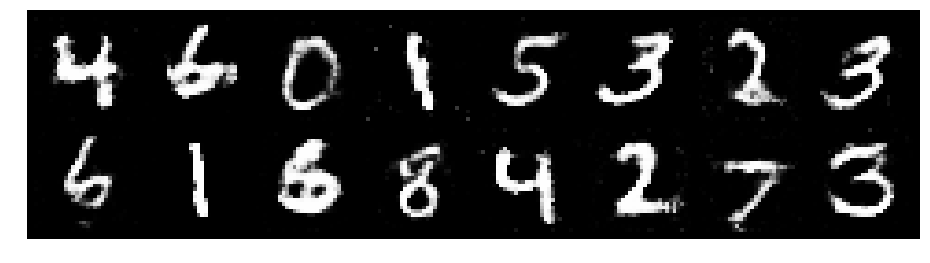

Epoch: [178/200], Batch Num: [400/600]
Discriminator Loss: 1.2899, Generator Loss: 0.8891
D(x): 0.5701, D(G(z)): 0.4577


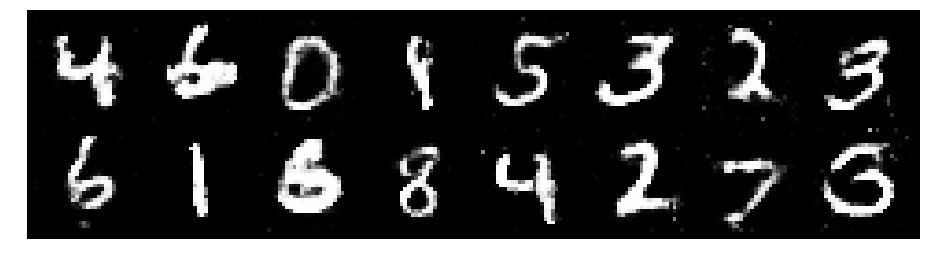

Epoch: [178/200], Batch Num: [500/600]
Discriminator Loss: 1.2006, Generator Loss: 1.0146
D(x): 0.5635, D(G(z)): 0.3959


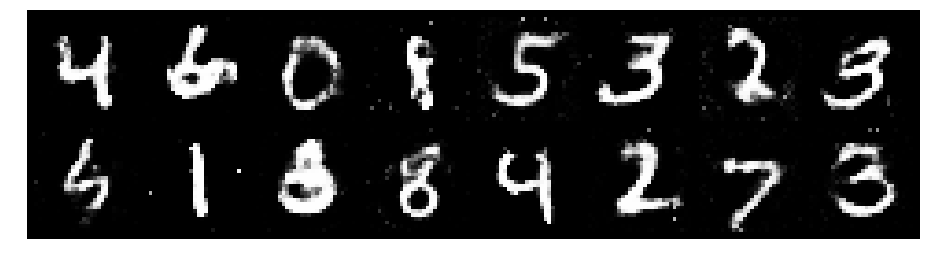

Epoch: [179/200], Batch Num: [0/600]
Discriminator Loss: 1.2706, Generator Loss: 0.8853
D(x): 0.5545, D(G(z)): 0.4351


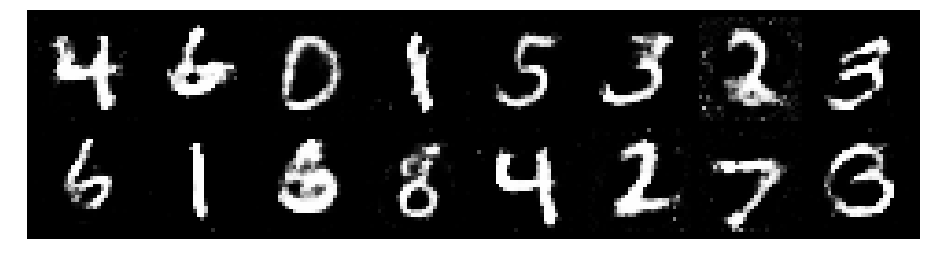

Epoch: [179/200], Batch Num: [100/600]
Discriminator Loss: 1.3475, Generator Loss: 0.8093
D(x): 0.5650, D(G(z)): 0.5014


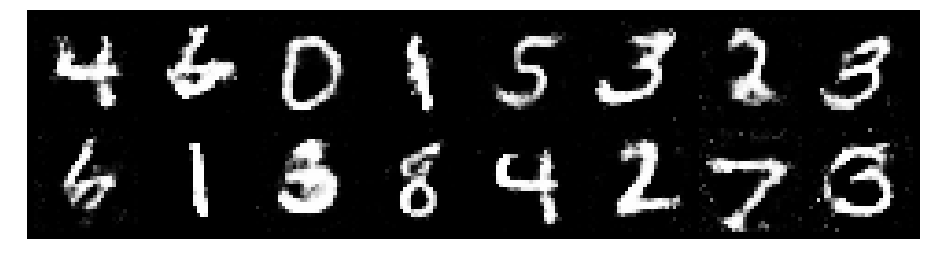

Epoch: [179/200], Batch Num: [200/600]
Discriminator Loss: 1.3560, Generator Loss: 0.9729
D(x): 0.5273, D(G(z)): 0.4466


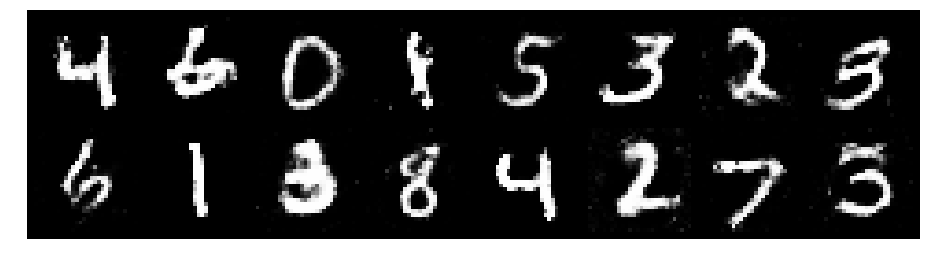

Epoch: [179/200], Batch Num: [300/600]
Discriminator Loss: 1.3453, Generator Loss: 0.8394
D(x): 0.5491, D(G(z)): 0.4873


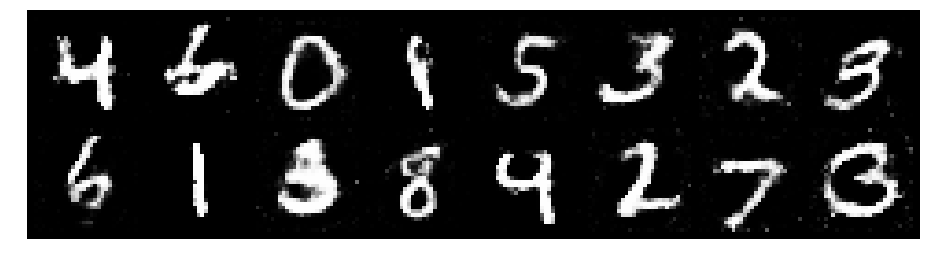

Epoch: [179/200], Batch Num: [400/600]
Discriminator Loss: 1.4232, Generator Loss: 0.7669
D(x): 0.4781, D(G(z)): 0.4679


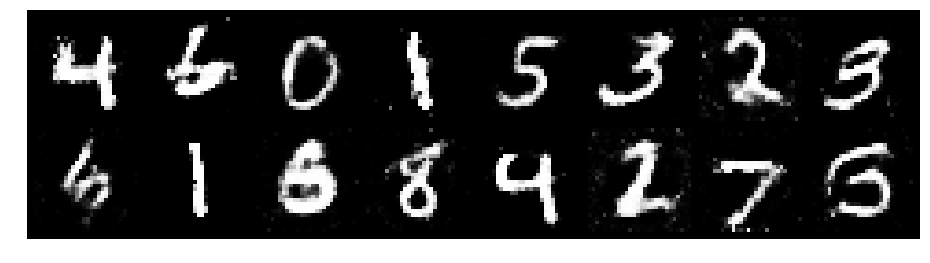

Epoch: [179/200], Batch Num: [500/600]
Discriminator Loss: 1.3353, Generator Loss: 0.8353
D(x): 0.5402, D(G(z)): 0.4691


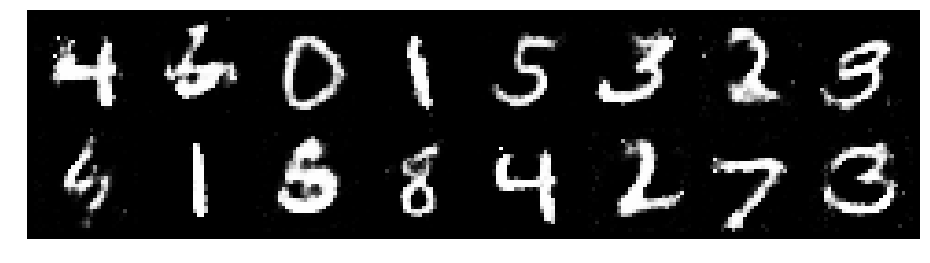

Epoch: [180/200], Batch Num: [0/600]
Discriminator Loss: 1.3203, Generator Loss: 0.9558
D(x): 0.5503, D(G(z)): 0.4538


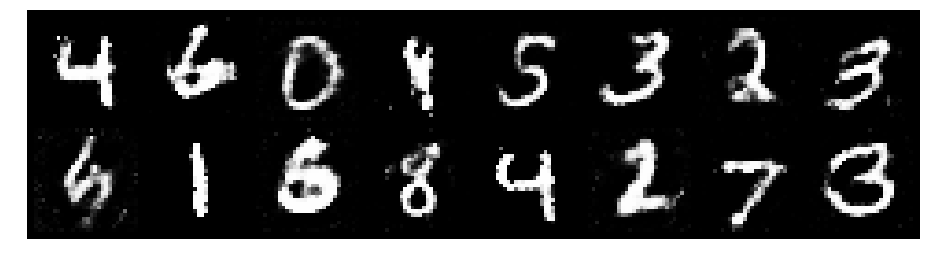

Epoch: [180/200], Batch Num: [100/600]
Discriminator Loss: 1.2371, Generator Loss: 0.8187
D(x): 0.5694, D(G(z)): 0.4395


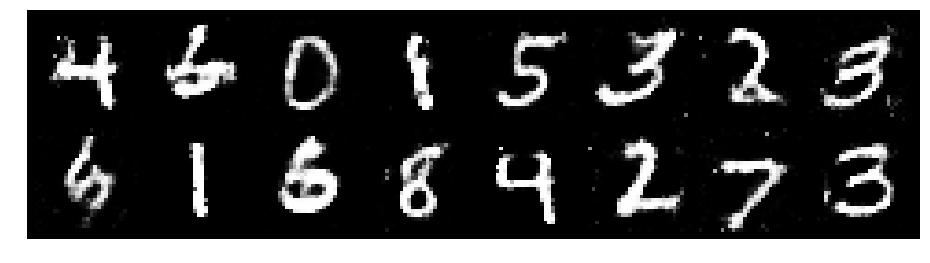

Epoch: [180/200], Batch Num: [200/600]
Discriminator Loss: 1.2896, Generator Loss: 0.8725
D(x): 0.5670, D(G(z)): 0.4297


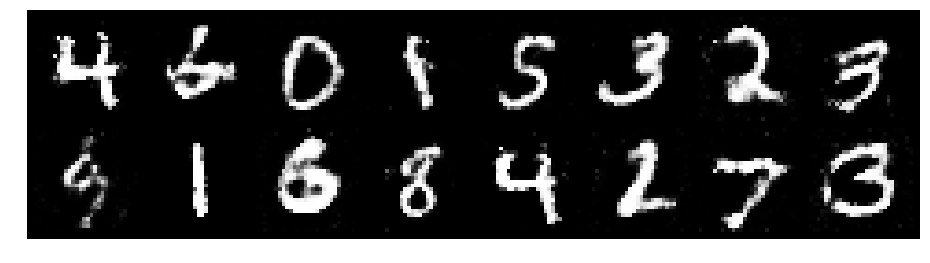

Epoch: [180/200], Batch Num: [300/600]
Discriminator Loss: 1.2872, Generator Loss: 0.9220
D(x): 0.5739, D(G(z)): 0.4389


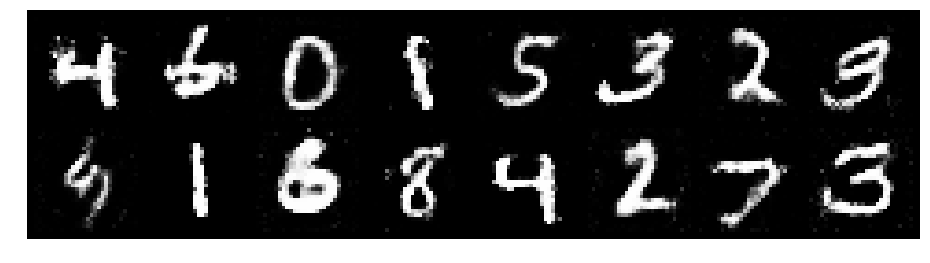

Epoch: [180/200], Batch Num: [400/600]
Discriminator Loss: 1.2272, Generator Loss: 0.9181
D(x): 0.5904, D(G(z)): 0.4463


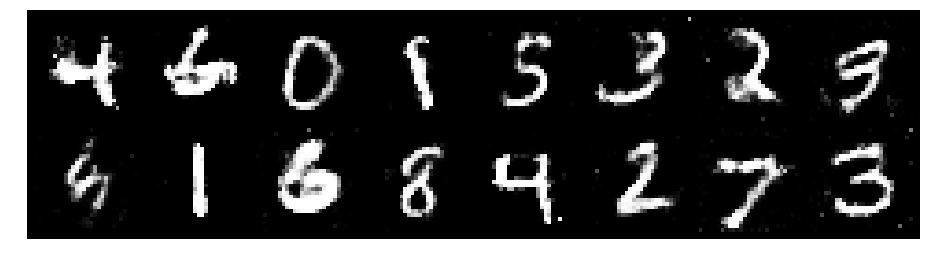

Epoch: [180/200], Batch Num: [500/600]
Discriminator Loss: 1.2303, Generator Loss: 1.0240
D(x): 0.5807, D(G(z)): 0.4389


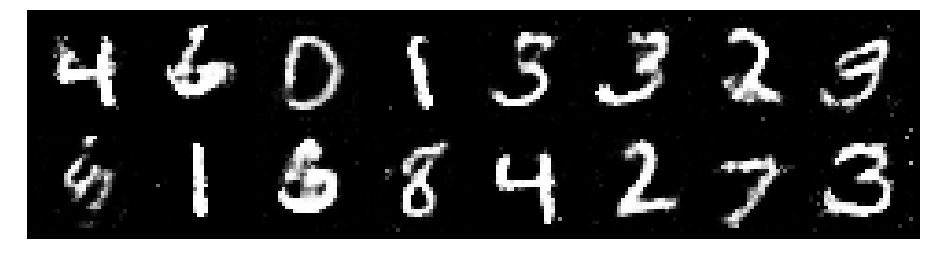

Epoch: [181/200], Batch Num: [0/600]
Discriminator Loss: 1.2754, Generator Loss: 0.8401
D(x): 0.5635, D(G(z)): 0.4348


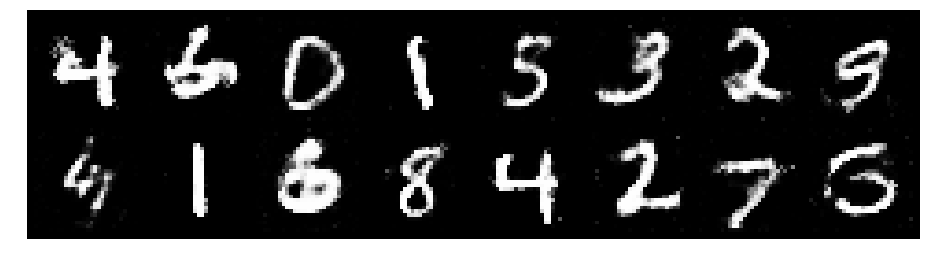

Epoch: [181/200], Batch Num: [100/600]
Discriminator Loss: 1.1632, Generator Loss: 1.0222
D(x): 0.5684, D(G(z)): 0.4102


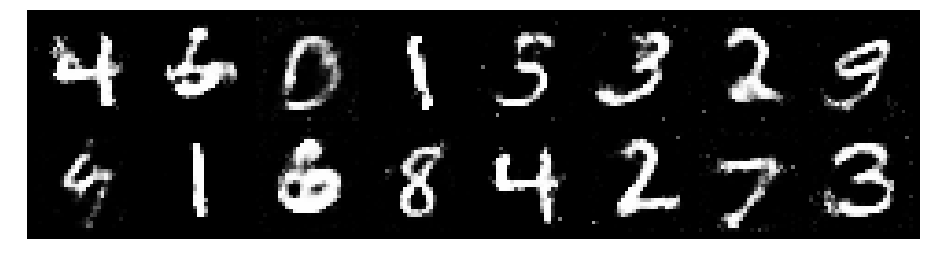

Epoch: [181/200], Batch Num: [200/600]
Discriminator Loss: 1.2850, Generator Loss: 0.9037
D(x): 0.5439, D(G(z)): 0.4559


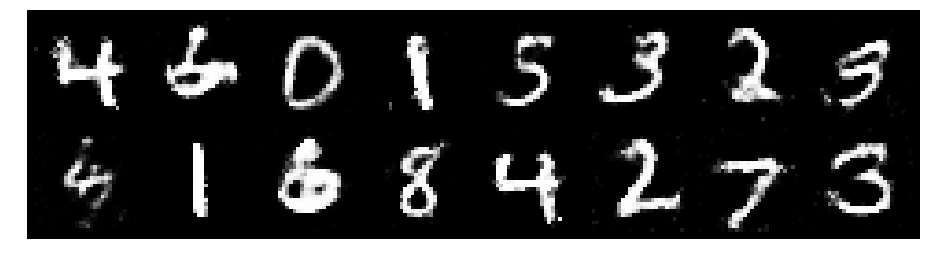

Epoch: [181/200], Batch Num: [300/600]
Discriminator Loss: 1.1849, Generator Loss: 1.0774
D(x): 0.5614, D(G(z)): 0.3897


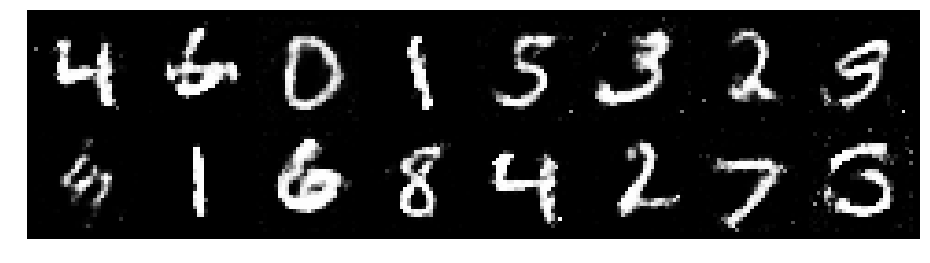

Epoch: [181/200], Batch Num: [400/600]
Discriminator Loss: 1.1846, Generator Loss: 1.0807
D(x): 0.5723, D(G(z)): 0.4170


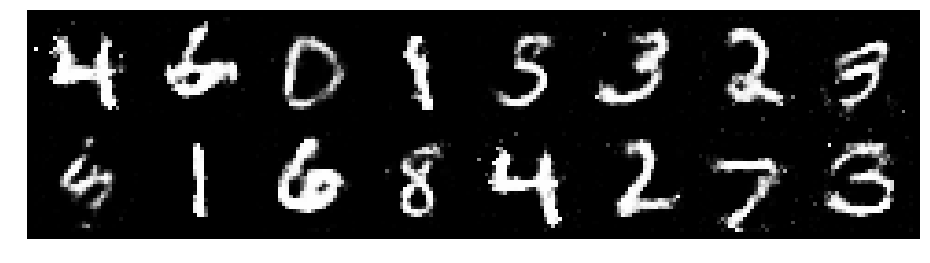

Epoch: [181/200], Batch Num: [500/600]
Discriminator Loss: 1.2325, Generator Loss: 0.8364
D(x): 0.5722, D(G(z)): 0.4534


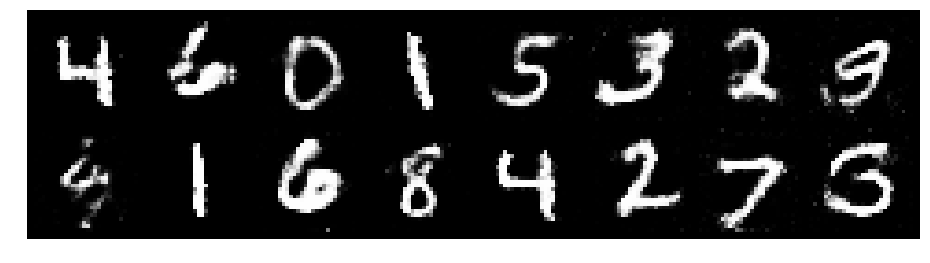

Epoch: [182/200], Batch Num: [0/600]
Discriminator Loss: 1.2686, Generator Loss: 0.8131
D(x): 0.5565, D(G(z)): 0.4603


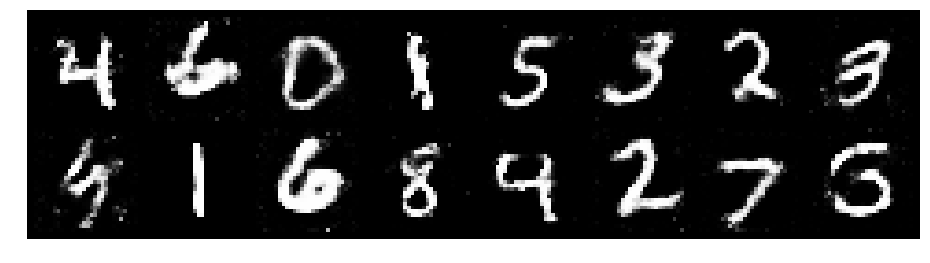

Epoch: [182/200], Batch Num: [100/600]
Discriminator Loss: 1.2135, Generator Loss: 0.8920
D(x): 0.5542, D(G(z)): 0.4135


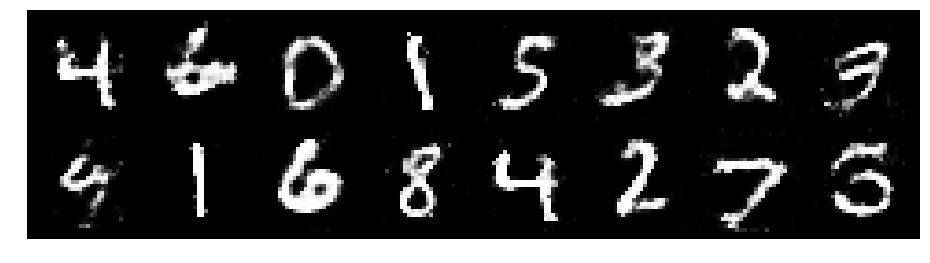

Epoch: [182/200], Batch Num: [200/600]
Discriminator Loss: 1.2774, Generator Loss: 0.9183
D(x): 0.5299, D(G(z)): 0.4404


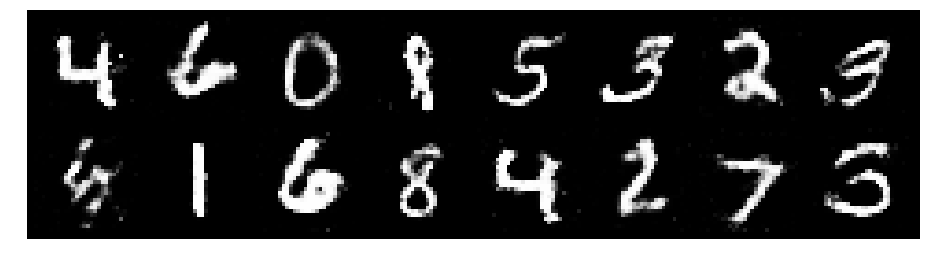

Epoch: [182/200], Batch Num: [300/600]
Discriminator Loss: 1.2091, Generator Loss: 0.8851
D(x): 0.6009, D(G(z)): 0.4659


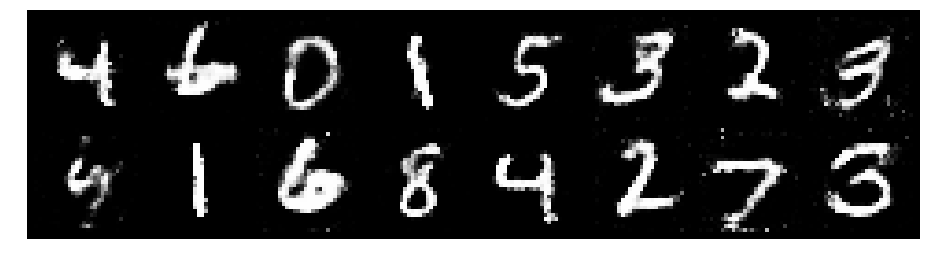

Epoch: [182/200], Batch Num: [400/600]
Discriminator Loss: 1.2664, Generator Loss: 0.9779
D(x): 0.5237, D(G(z)): 0.4152


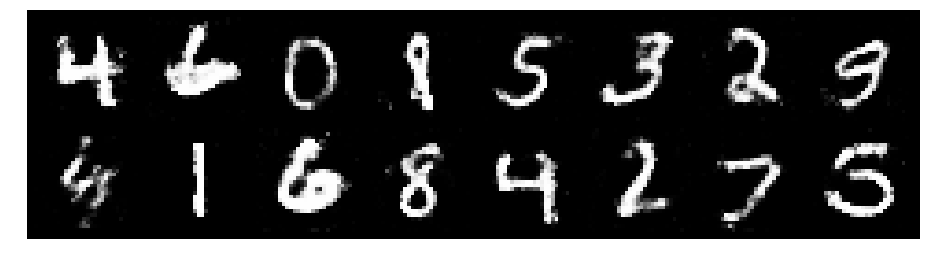

Epoch: [182/200], Batch Num: [500/600]
Discriminator Loss: 1.2637, Generator Loss: 0.9359
D(x): 0.5592, D(G(z)): 0.4407


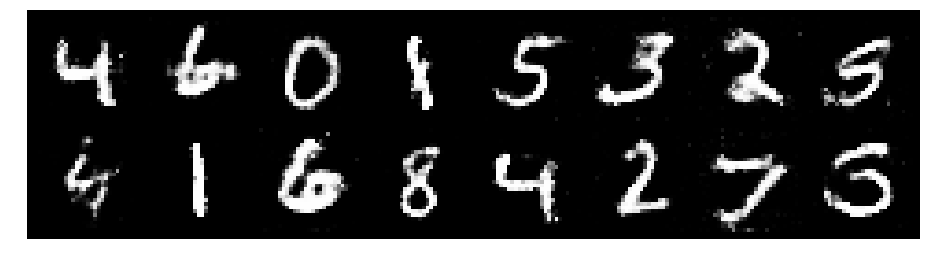

Epoch: [183/200], Batch Num: [0/600]
Discriminator Loss: 1.2847, Generator Loss: 0.7337
D(x): 0.5483, D(G(z)): 0.4595


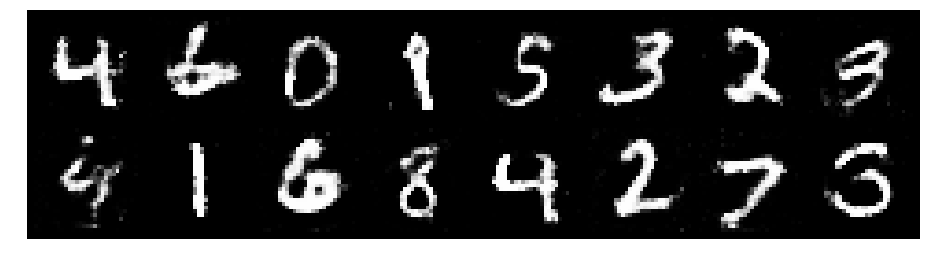

Epoch: [183/200], Batch Num: [100/600]
Discriminator Loss: 1.2692, Generator Loss: 0.8283
D(x): 0.5205, D(G(z)): 0.4254


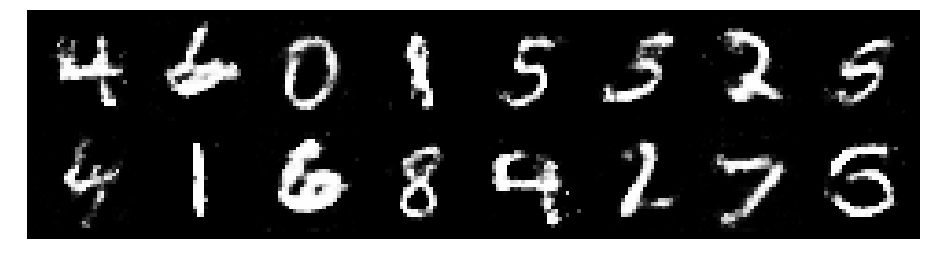

Epoch: [183/200], Batch Num: [200/600]
Discriminator Loss: 1.2696, Generator Loss: 0.8406
D(x): 0.5539, D(G(z)): 0.4643


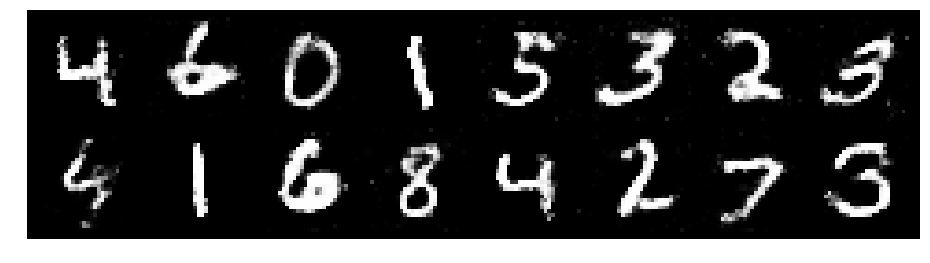

Epoch: [183/200], Batch Num: [300/600]
Discriminator Loss: 1.3039, Generator Loss: 1.0155
D(x): 0.4999, D(G(z)): 0.3821


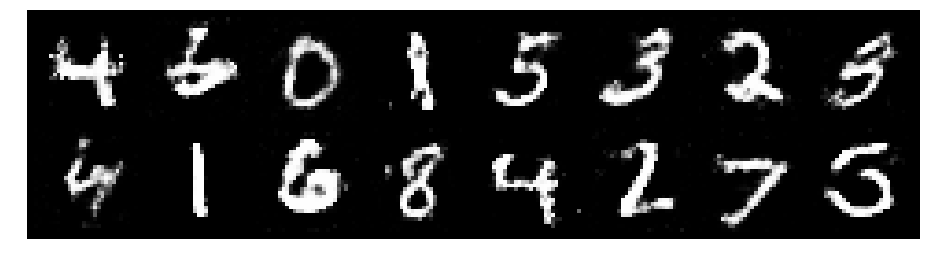

Epoch: [183/200], Batch Num: [400/600]
Discriminator Loss: 1.1735, Generator Loss: 0.8070
D(x): 0.5963, D(G(z)): 0.4403


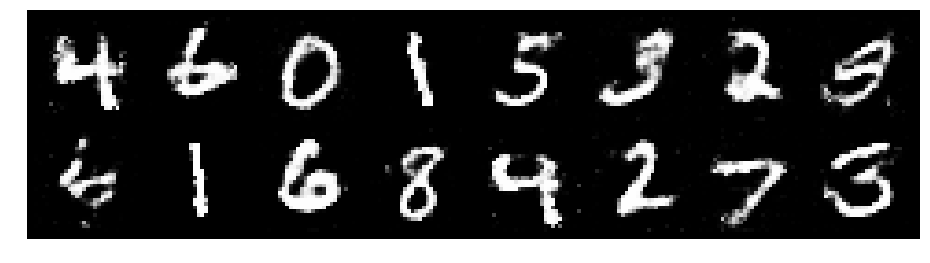

Epoch: [183/200], Batch Num: [500/600]
Discriminator Loss: 1.3409, Generator Loss: 0.8169
D(x): 0.5627, D(G(z)): 0.4720


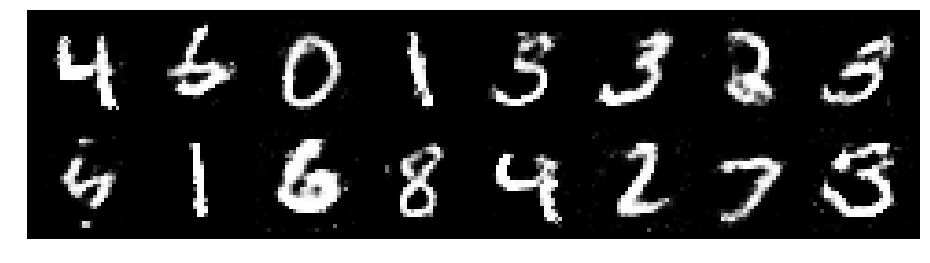

Epoch: [184/200], Batch Num: [0/600]
Discriminator Loss: 1.3566, Generator Loss: 0.7348
D(x): 0.5759, D(G(z)): 0.4995


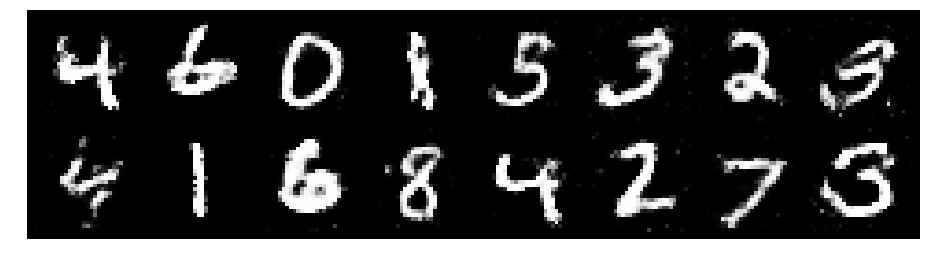

Epoch: [184/200], Batch Num: [100/600]
Discriminator Loss: 1.2971, Generator Loss: 0.8933
D(x): 0.5122, D(G(z)): 0.4203


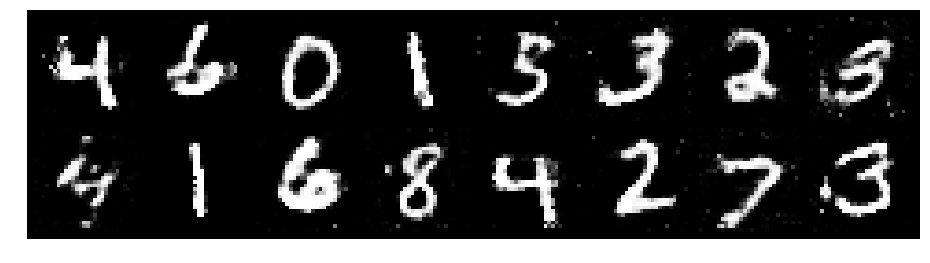

Epoch: [184/200], Batch Num: [200/600]
Discriminator Loss: 1.3666, Generator Loss: 0.8717
D(x): 0.5327, D(G(z)): 0.4631


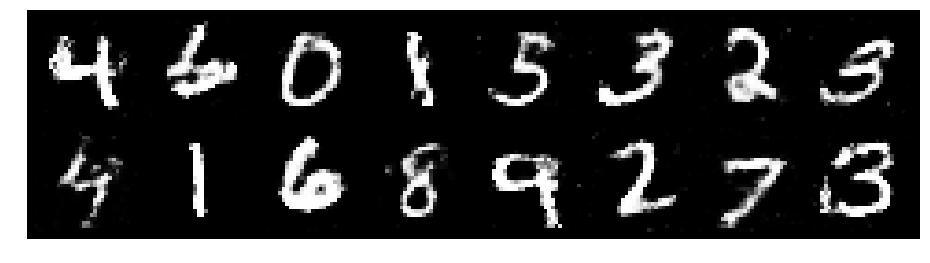

Epoch: [184/200], Batch Num: [300/600]
Discriminator Loss: 1.2101, Generator Loss: 0.8755
D(x): 0.5725, D(G(z)): 0.4426


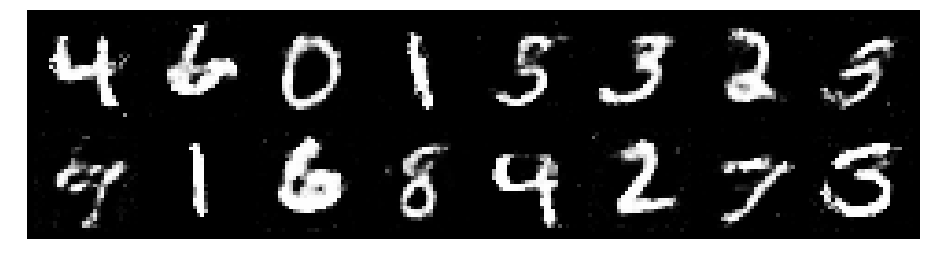

Epoch: [184/200], Batch Num: [400/600]
Discriminator Loss: 1.2489, Generator Loss: 0.8241
D(x): 0.5536, D(G(z)): 0.4580


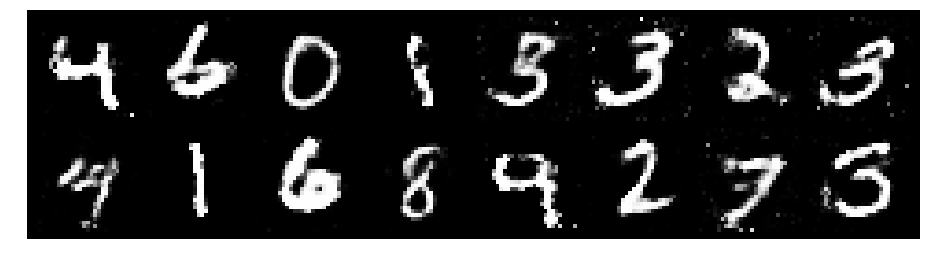

Epoch: [184/200], Batch Num: [500/600]
Discriminator Loss: 1.3259, Generator Loss: 0.8307
D(x): 0.5456, D(G(z)): 0.4801


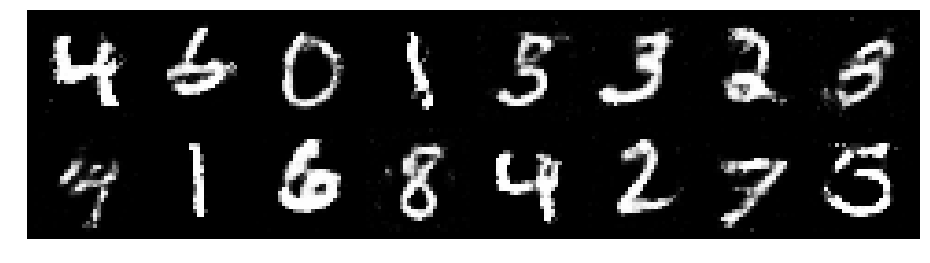

Epoch: [185/200], Batch Num: [0/600]
Discriminator Loss: 1.3076, Generator Loss: 0.8680
D(x): 0.5161, D(G(z)): 0.4373


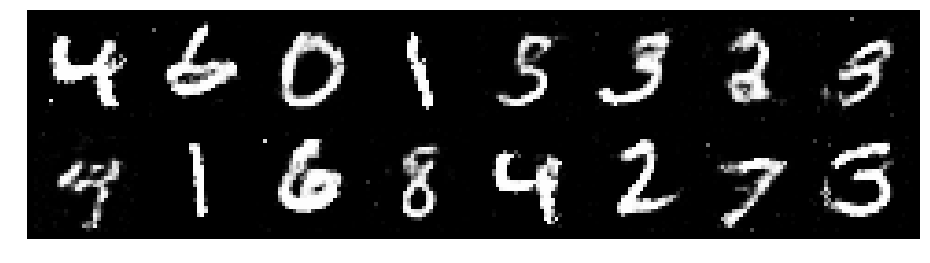

Epoch: [185/200], Batch Num: [100/600]
Discriminator Loss: 1.2351, Generator Loss: 0.9518
D(x): 0.5742, D(G(z)): 0.4444


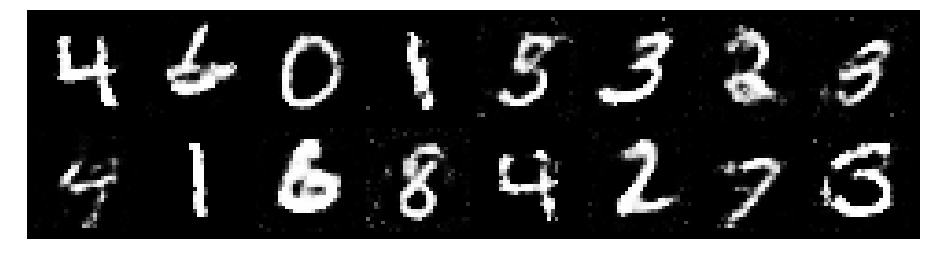

Epoch: [185/200], Batch Num: [200/600]
Discriminator Loss: 1.1977, Generator Loss: 0.9019
D(x): 0.5670, D(G(z)): 0.4209


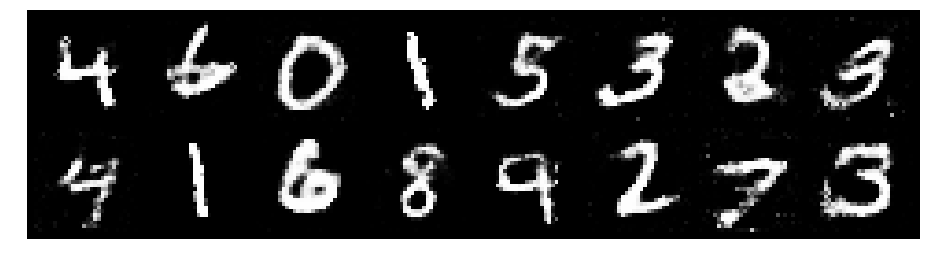

Epoch: [185/200], Batch Num: [300/600]
Discriminator Loss: 1.2901, Generator Loss: 0.8750
D(x): 0.5547, D(G(z)): 0.4566


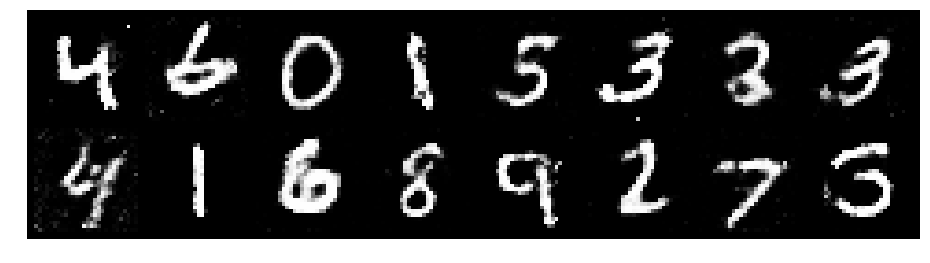

Epoch: [185/200], Batch Num: [400/600]
Discriminator Loss: 1.3677, Generator Loss: 0.7636
D(x): 0.5337, D(G(z)): 0.4850


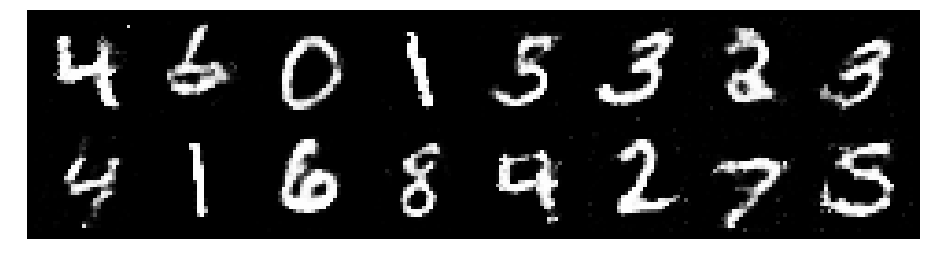

Epoch: [185/200], Batch Num: [500/600]
Discriminator Loss: 1.3321, Generator Loss: 0.8822
D(x): 0.5490, D(G(z)): 0.4741


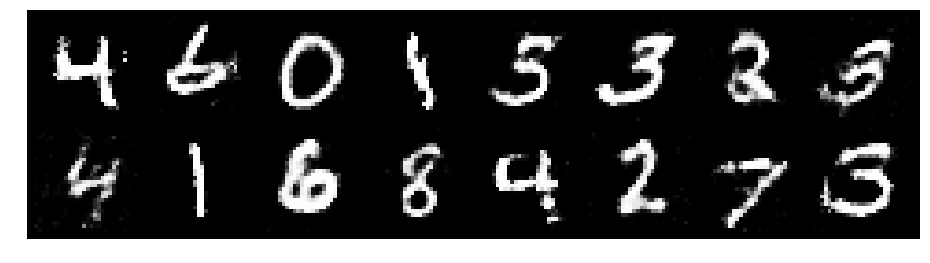

Epoch: [186/200], Batch Num: [0/600]
Discriminator Loss: 1.3578, Generator Loss: 0.8162
D(x): 0.5340, D(G(z)): 0.4740


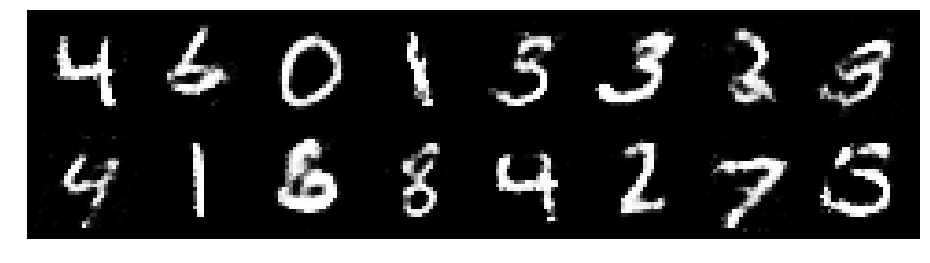

Epoch: [186/200], Batch Num: [100/600]
Discriminator Loss: 1.2855, Generator Loss: 0.9020
D(x): 0.5364, D(G(z)): 0.4510


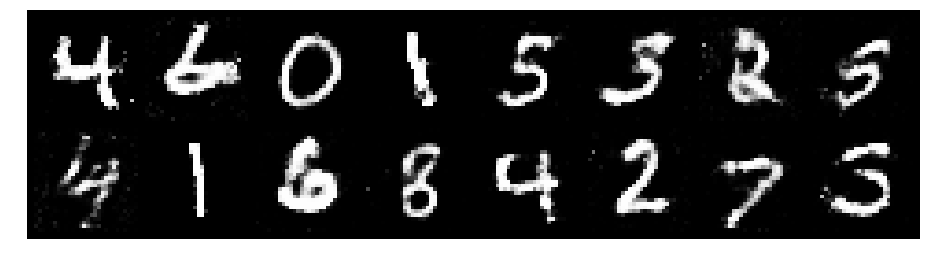

Epoch: [186/200], Batch Num: [200/600]
Discriminator Loss: 1.1558, Generator Loss: 0.9073
D(x): 0.5511, D(G(z)): 0.3901


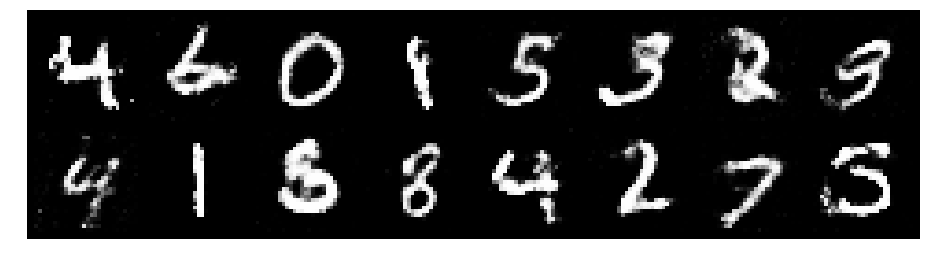

Epoch: [186/200], Batch Num: [300/600]
Discriminator Loss: 1.2480, Generator Loss: 0.8444
D(x): 0.5496, D(G(z)): 0.4432


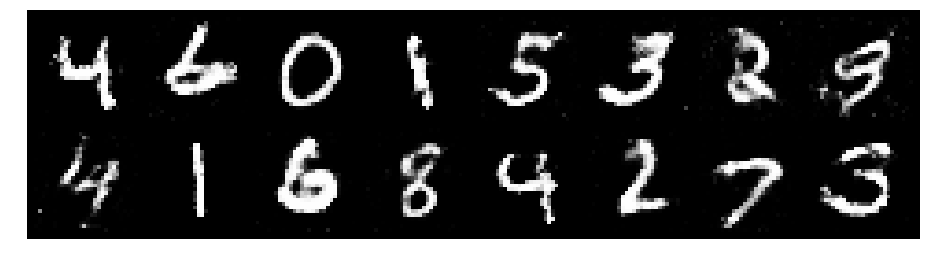

Epoch: [186/200], Batch Num: [400/600]
Discriminator Loss: 1.2514, Generator Loss: 0.8558
D(x): 0.5439, D(G(z)): 0.4328


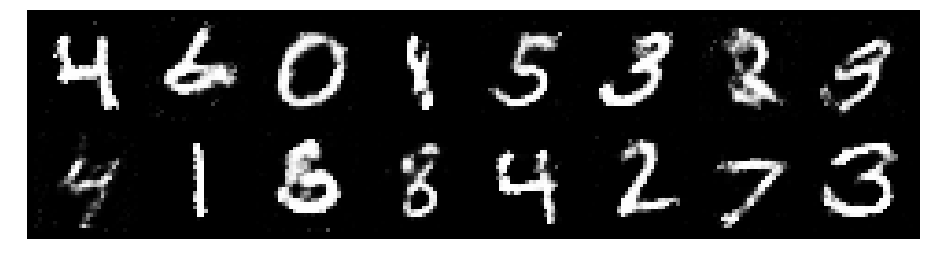

Epoch: [186/200], Batch Num: [500/600]
Discriminator Loss: 1.1981, Generator Loss: 0.8811
D(x): 0.5867, D(G(z)): 0.4485


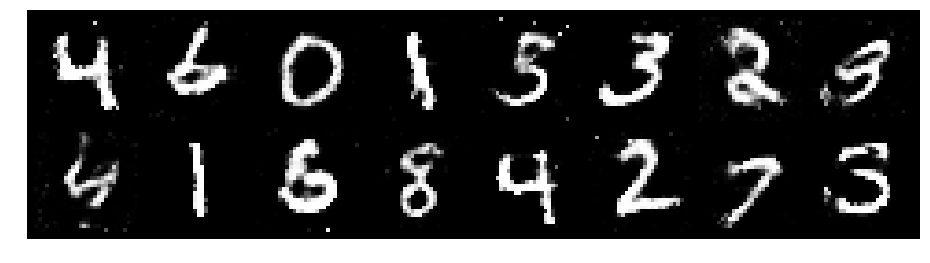

Epoch: [187/200], Batch Num: [0/600]
Discriminator Loss: 1.2462, Generator Loss: 0.8395
D(x): 0.5681, D(G(z)): 0.4507


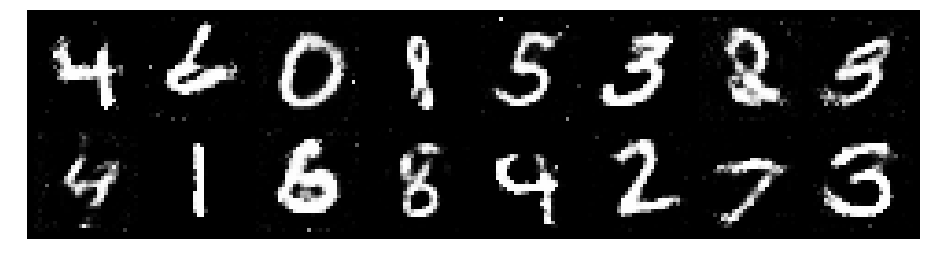

Epoch: [187/200], Batch Num: [100/600]
Discriminator Loss: 1.2239, Generator Loss: 0.8201
D(x): 0.5541, D(G(z)): 0.4207


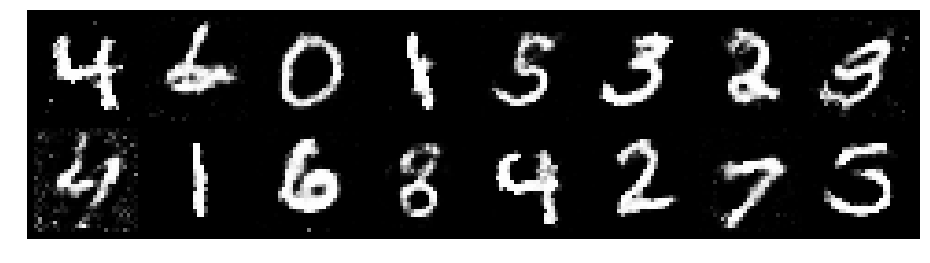

Epoch: [187/200], Batch Num: [200/600]
Discriminator Loss: 1.2430, Generator Loss: 0.8099
D(x): 0.5583, D(G(z)): 0.4546


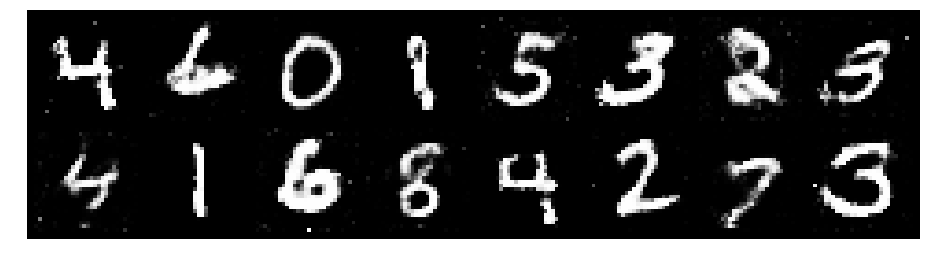

Epoch: [187/200], Batch Num: [300/600]
Discriminator Loss: 1.2728, Generator Loss: 0.7924
D(x): 0.5324, D(G(z)): 0.4378


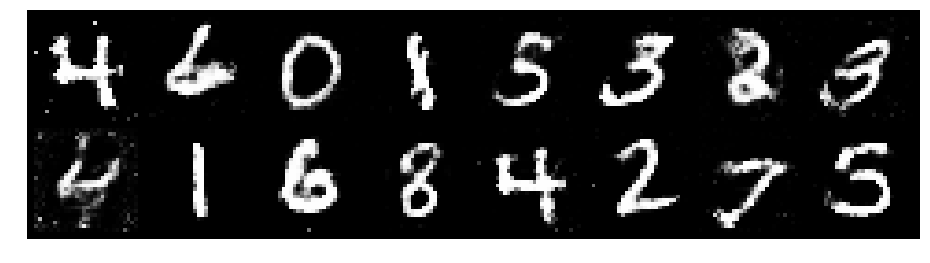

Epoch: [187/200], Batch Num: [400/600]
Discriminator Loss: 1.4421, Generator Loss: 0.8153
D(x): 0.5250, D(G(z)): 0.5009


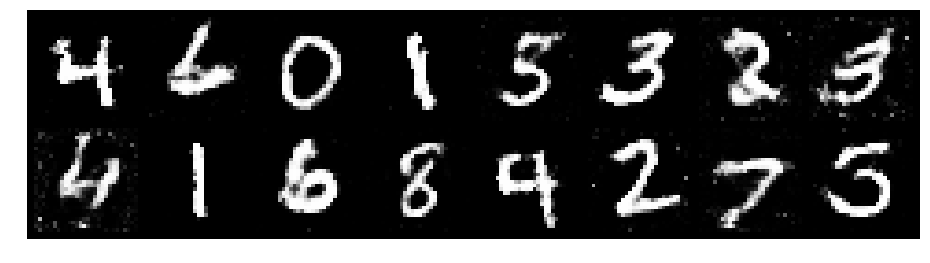

Epoch: [187/200], Batch Num: [500/600]
Discriminator Loss: 1.2754, Generator Loss: 0.8513
D(x): 0.5748, D(G(z)): 0.4709


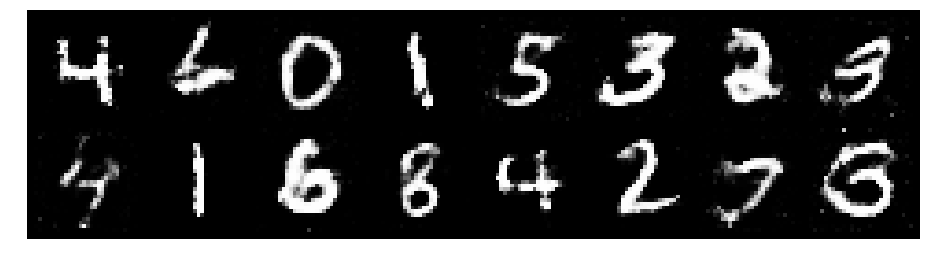

Epoch: [188/200], Batch Num: [0/600]
Discriminator Loss: 1.3706, Generator Loss: 0.8647
D(x): 0.5593, D(G(z)): 0.5049


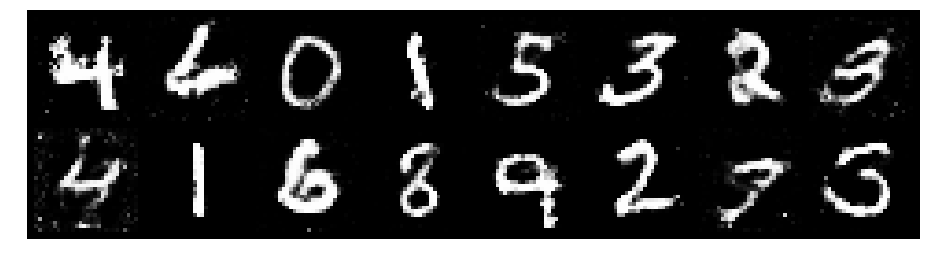

Epoch: [188/200], Batch Num: [100/600]
Discriminator Loss: 1.2115, Generator Loss: 0.7900
D(x): 0.5665, D(G(z)): 0.4437


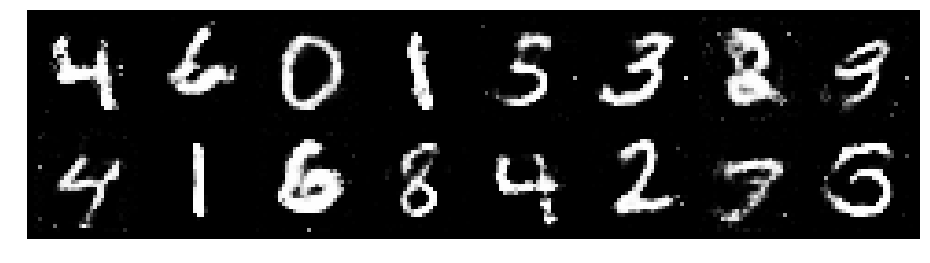

Epoch: [188/200], Batch Num: [200/600]
Discriminator Loss: 1.2989, Generator Loss: 0.8240
D(x): 0.5381, D(G(z)): 0.4631


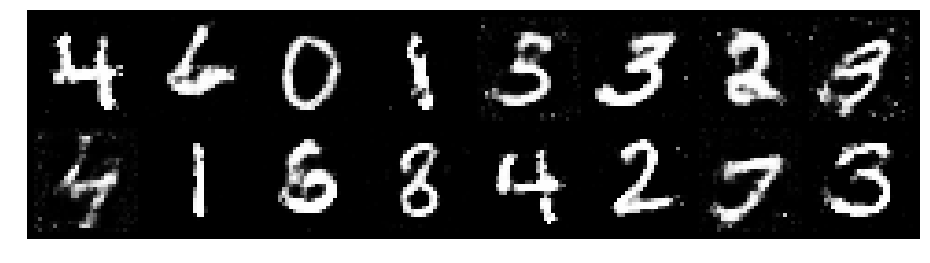

Epoch: [188/200], Batch Num: [300/600]
Discriminator Loss: 1.2497, Generator Loss: 0.7779
D(x): 0.5710, D(G(z)): 0.4519


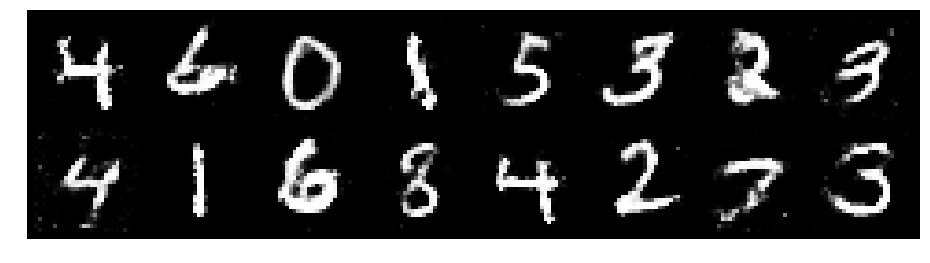

Epoch: [188/200], Batch Num: [400/600]
Discriminator Loss: 1.3524, Generator Loss: 0.7351
D(x): 0.5262, D(G(z)): 0.4817


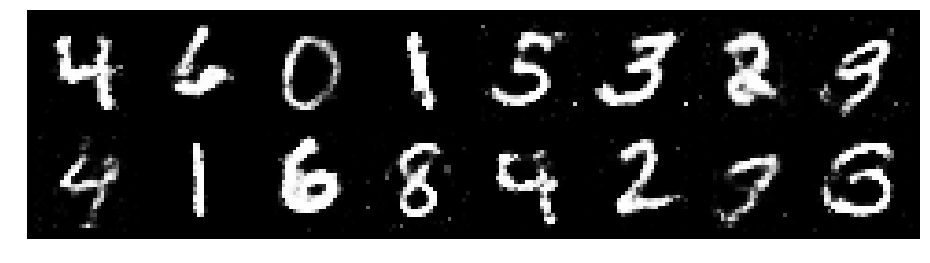

Epoch: [188/200], Batch Num: [500/600]
Discriminator Loss: 1.2329, Generator Loss: 0.9479
D(x): 0.5392, D(G(z)): 0.4144


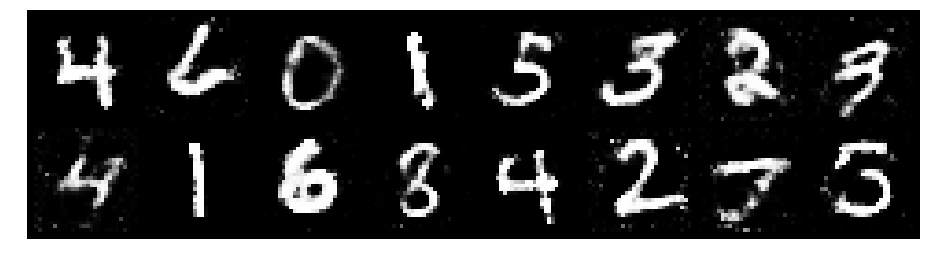

Epoch: [189/200], Batch Num: [0/600]
Discriminator Loss: 1.3347, Generator Loss: 0.8685
D(x): 0.5541, D(G(z)): 0.4836


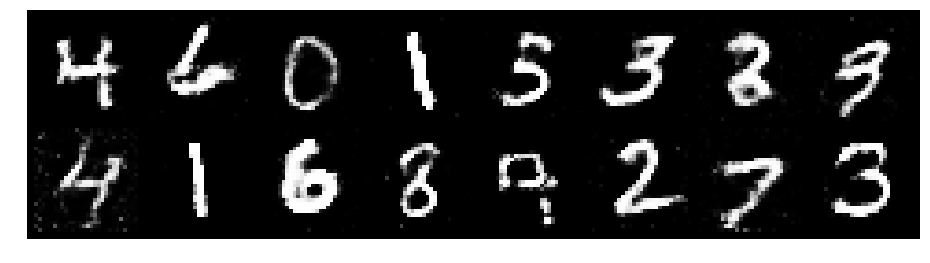

Epoch: [189/200], Batch Num: [100/600]
Discriminator Loss: 1.3396, Generator Loss: 0.8877
D(x): 0.5712, D(G(z)): 0.4994


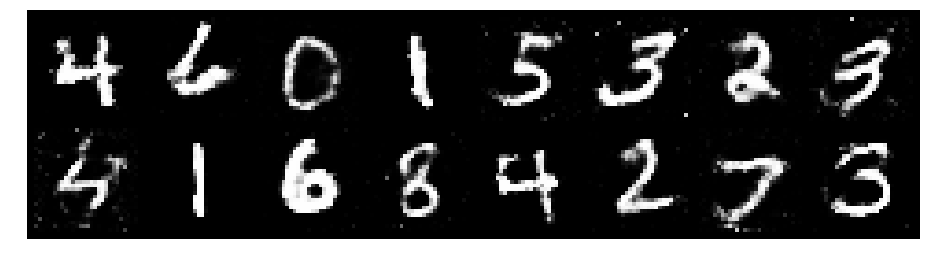

Epoch: [189/200], Batch Num: [200/600]
Discriminator Loss: 1.3102, Generator Loss: 0.7764
D(x): 0.5445, D(G(z)): 0.4576


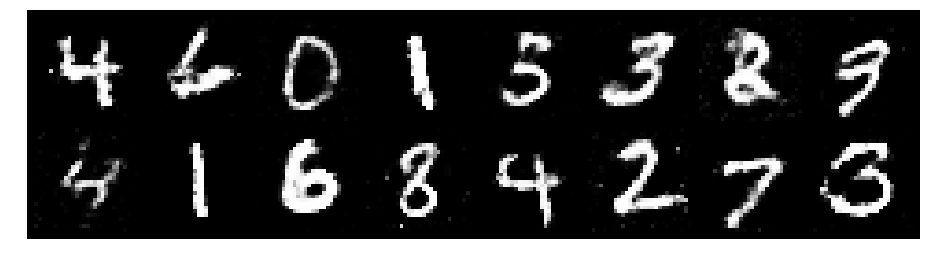

Epoch: [189/200], Batch Num: [300/600]
Discriminator Loss: 1.3031, Generator Loss: 0.8609
D(x): 0.5442, D(G(z)): 0.4660


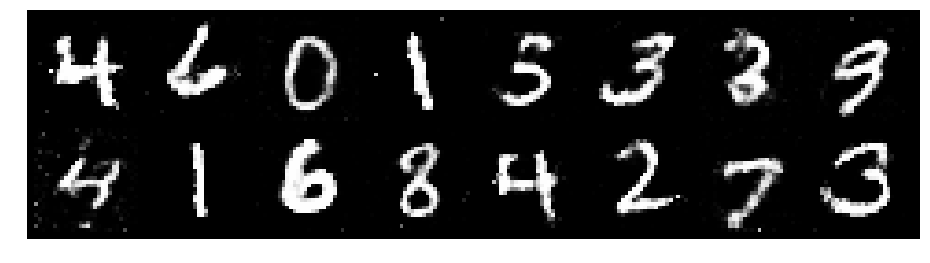

Epoch: [189/200], Batch Num: [400/600]
Discriminator Loss: 1.2610, Generator Loss: 0.9157
D(x): 0.5496, D(G(z)): 0.4400


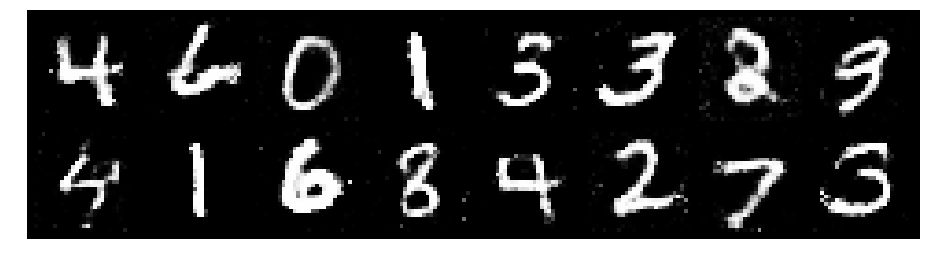

Epoch: [189/200], Batch Num: [500/600]
Discriminator Loss: 1.2130, Generator Loss: 0.9924
D(x): 0.5702, D(G(z)): 0.4081


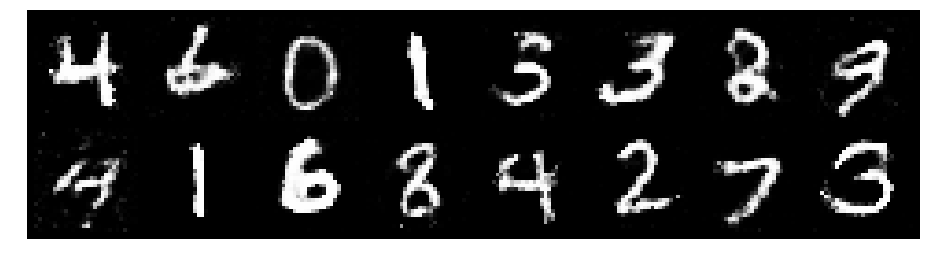

Epoch: [190/200], Batch Num: [0/600]
Discriminator Loss: 1.3608, Generator Loss: 0.8227
D(x): 0.5331, D(G(z)): 0.4898


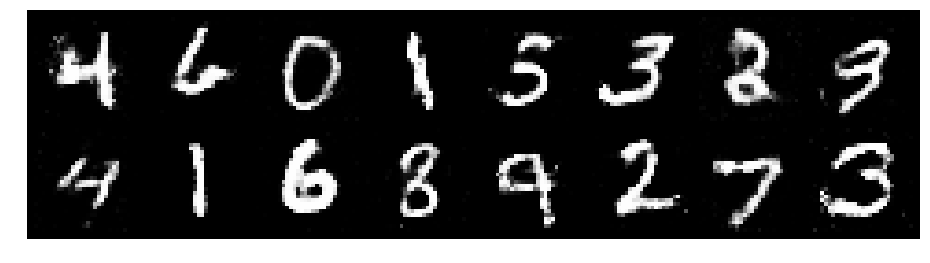

Epoch: [190/200], Batch Num: [100/600]
Discriminator Loss: 1.2748, Generator Loss: 0.9014
D(x): 0.5100, D(G(z)): 0.4163


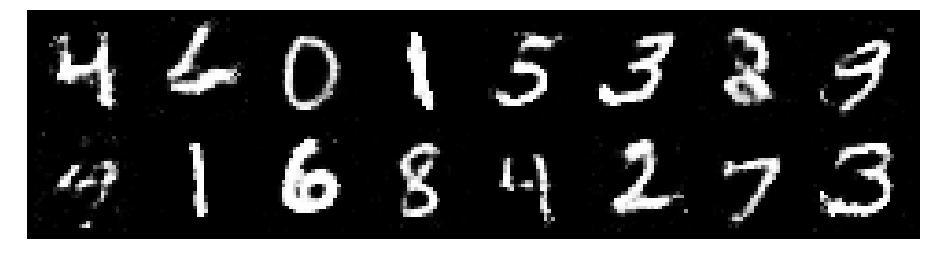

Epoch: [190/200], Batch Num: [200/600]
Discriminator Loss: 1.3281, Generator Loss: 0.8521
D(x): 0.5189, D(G(z)): 0.4476


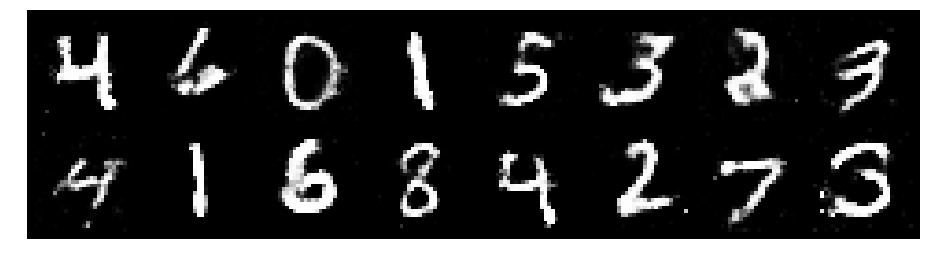

Epoch: [190/200], Batch Num: [300/600]
Discriminator Loss: 1.2386, Generator Loss: 0.7775
D(x): 0.5500, D(G(z)): 0.4473


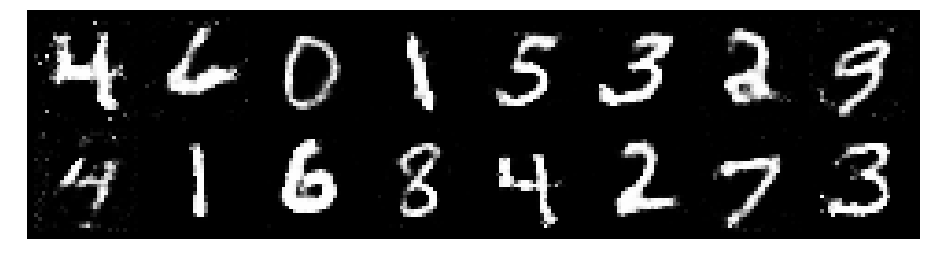

Epoch: [190/200], Batch Num: [400/600]
Discriminator Loss: 1.2138, Generator Loss: 0.9222
D(x): 0.5825, D(G(z)): 0.4474


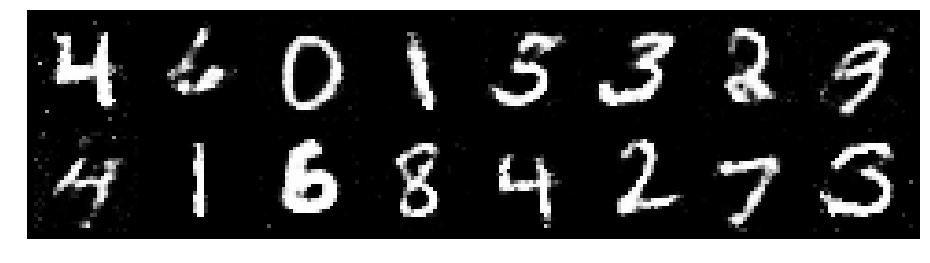

Epoch: [190/200], Batch Num: [500/600]
Discriminator Loss: 1.2478, Generator Loss: 0.7603
D(x): 0.5795, D(G(z)): 0.4655


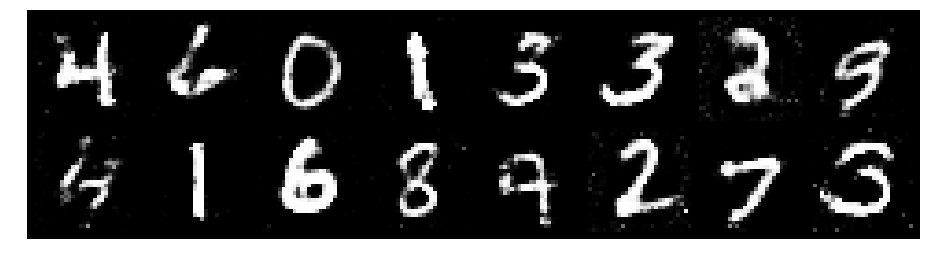

Epoch: [191/200], Batch Num: [0/600]
Discriminator Loss: 1.2751, Generator Loss: 0.8695
D(x): 0.5250, D(G(z)): 0.4317


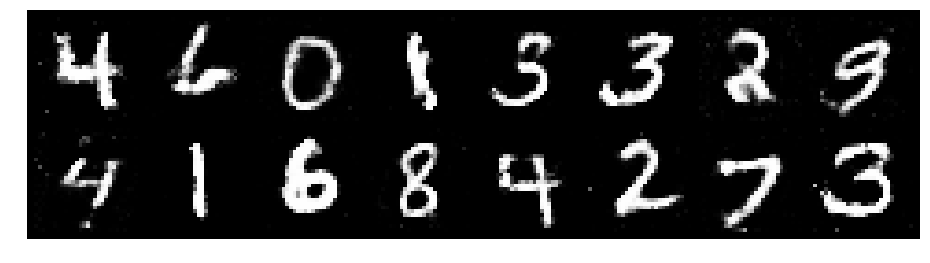

Epoch: [191/200], Batch Num: [100/600]
Discriminator Loss: 1.2251, Generator Loss: 0.9080
D(x): 0.5653, D(G(z)): 0.4419


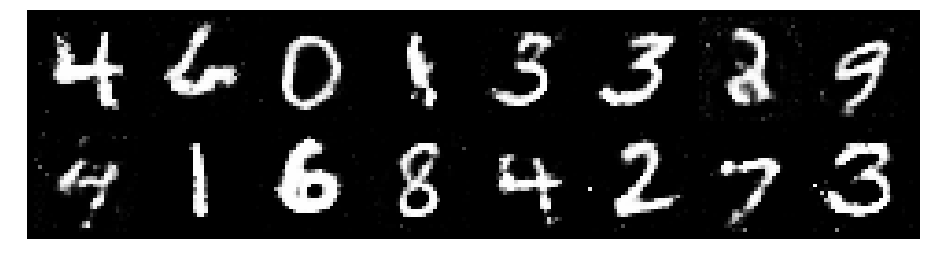

Epoch: [191/200], Batch Num: [200/600]
Discriminator Loss: 1.2699, Generator Loss: 0.8242
D(x): 0.5713, D(G(z)): 0.4723


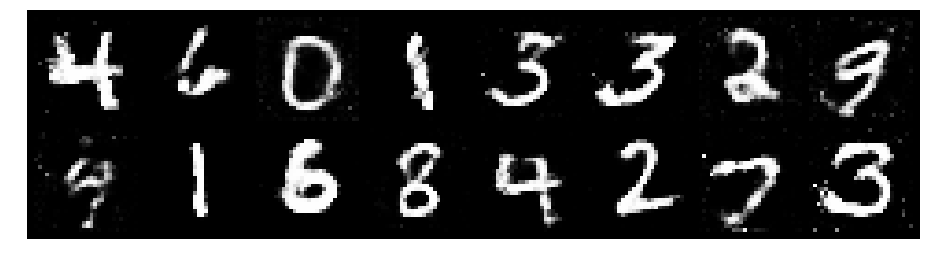

Epoch: [191/200], Batch Num: [300/600]
Discriminator Loss: 1.3347, Generator Loss: 0.8125
D(x): 0.5278, D(G(z)): 0.4603


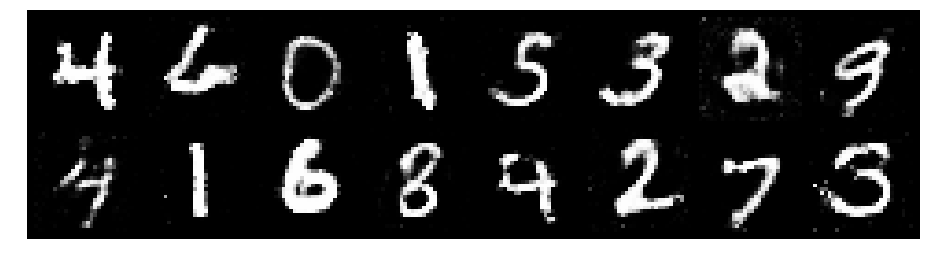

Epoch: [191/200], Batch Num: [400/600]
Discriminator Loss: 1.2210, Generator Loss: 0.8320
D(x): 0.5685, D(G(z)): 0.4462


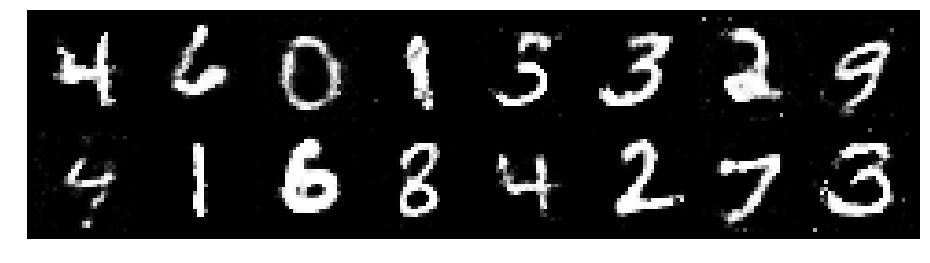

Epoch: [191/200], Batch Num: [500/600]
Discriminator Loss: 1.4325, Generator Loss: 0.8109
D(x): 0.5372, D(G(z)): 0.5043


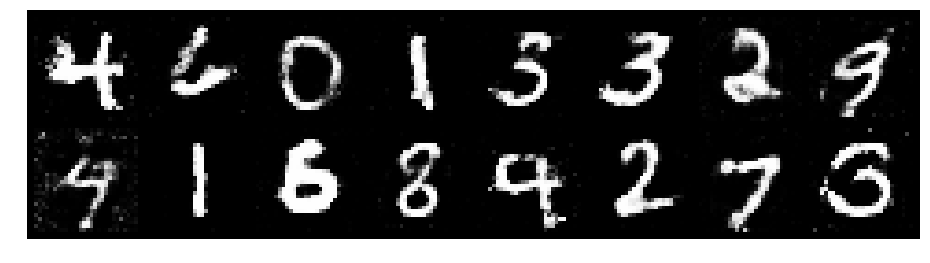

Epoch: [192/200], Batch Num: [0/600]
Discriminator Loss: 1.3500, Generator Loss: 0.8658
D(x): 0.5157, D(G(z)): 0.4542


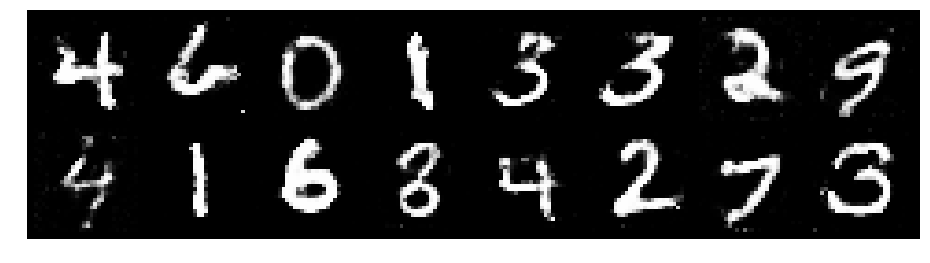

Epoch: [192/200], Batch Num: [100/600]
Discriminator Loss: 1.3054, Generator Loss: 0.8226
D(x): 0.5571, D(G(z)): 0.4808


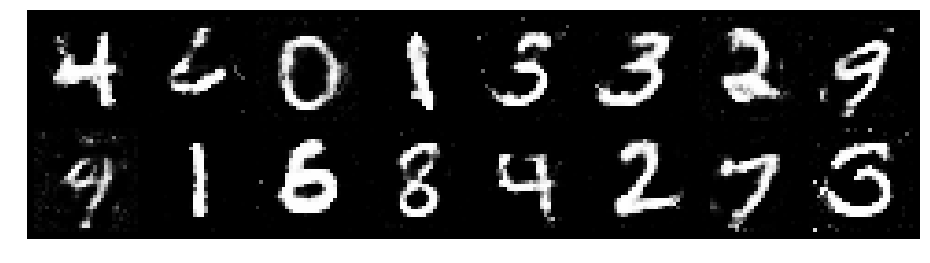

Epoch: [192/200], Batch Num: [200/600]
Discriminator Loss: 1.2921, Generator Loss: 0.8371
D(x): 0.5653, D(G(z)): 0.4692


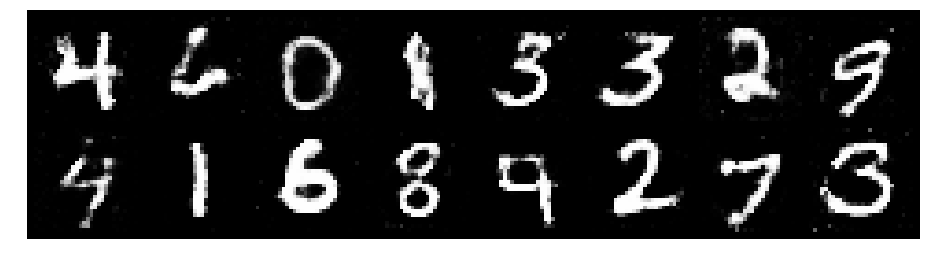

Epoch: [192/200], Batch Num: [300/600]
Discriminator Loss: 1.3421, Generator Loss: 0.7860
D(x): 0.5615, D(G(z)): 0.4892


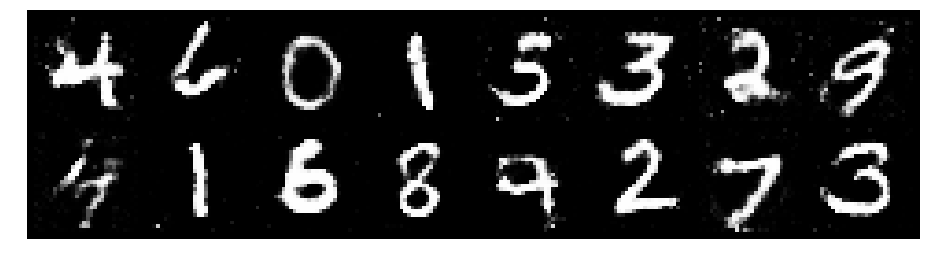

Epoch: [192/200], Batch Num: [400/600]
Discriminator Loss: 1.3078, Generator Loss: 0.7812
D(x): 0.5348, D(G(z)): 0.4503


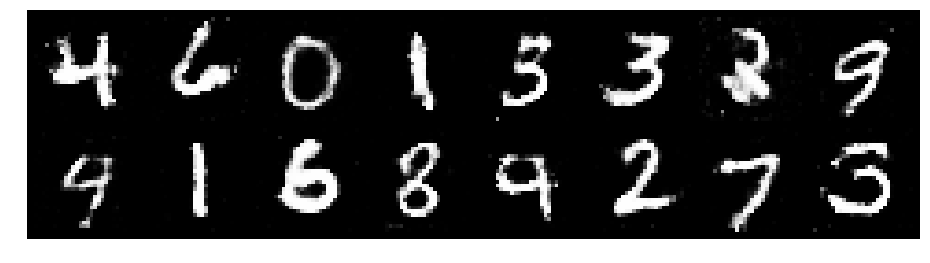

Epoch: [192/200], Batch Num: [500/600]
Discriminator Loss: 1.2701, Generator Loss: 0.7929
D(x): 0.5555, D(G(z)): 0.4649


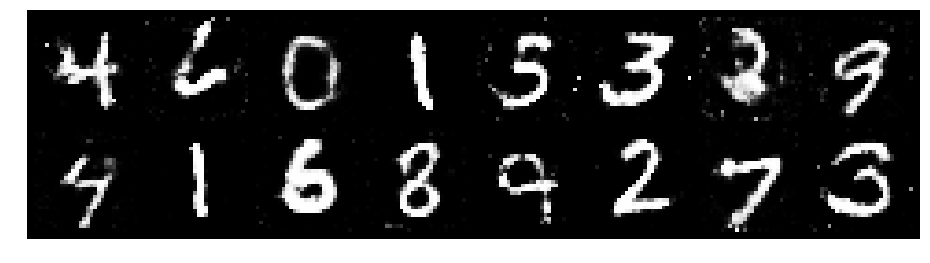

Epoch: [193/200], Batch Num: [0/600]
Discriminator Loss: 1.3007, Generator Loss: 0.8267
D(x): 0.5180, D(G(z)): 0.4393


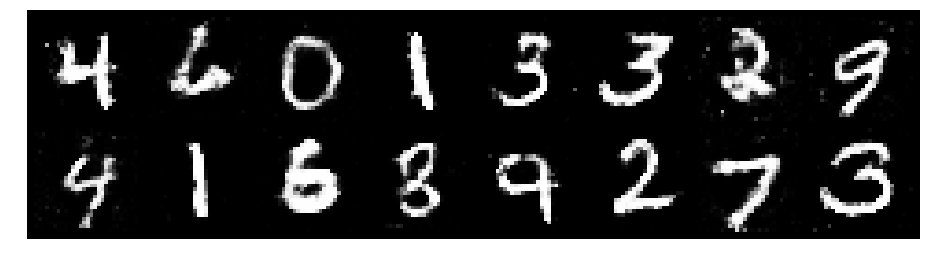

Epoch: [193/200], Batch Num: [100/600]
Discriminator Loss: 1.2953, Generator Loss: 0.7830
D(x): 0.5300, D(G(z)): 0.4463


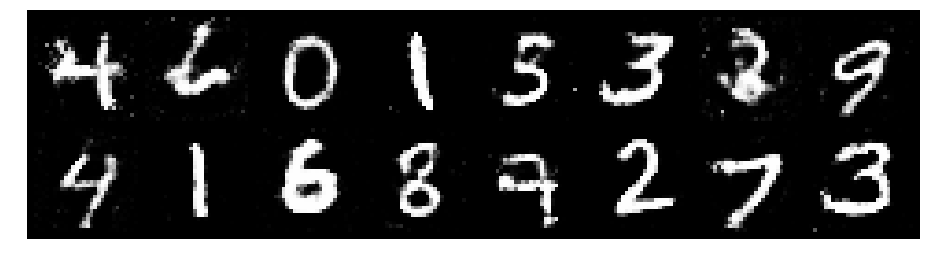

Epoch: [193/200], Batch Num: [200/600]
Discriminator Loss: 1.3853, Generator Loss: 0.7752
D(x): 0.5676, D(G(z)): 0.5067


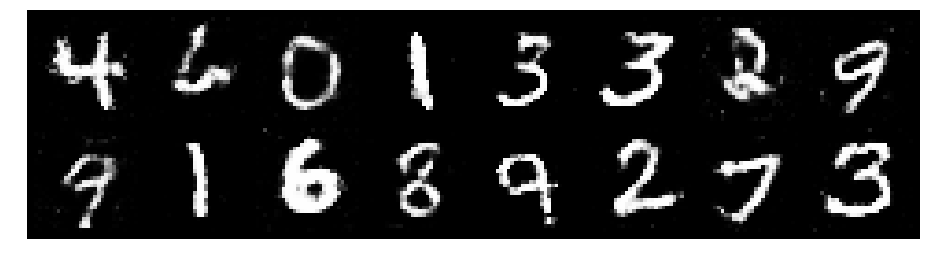

Epoch: [193/200], Batch Num: [300/600]
Discriminator Loss: 1.3756, Generator Loss: 0.7819
D(x): 0.5414, D(G(z)): 0.4901


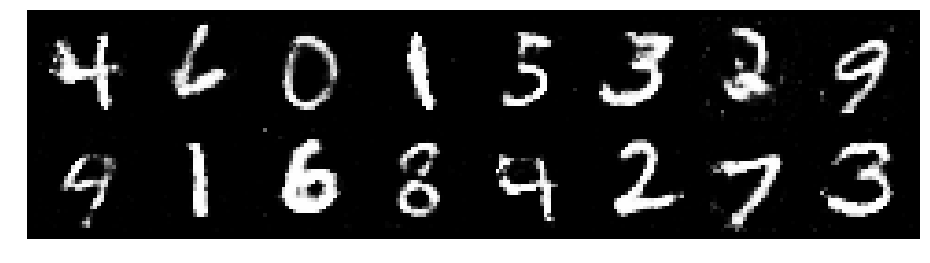

Epoch: [193/200], Batch Num: [400/600]
Discriminator Loss: 1.2412, Generator Loss: 0.7831
D(x): 0.5617, D(G(z)): 0.4569


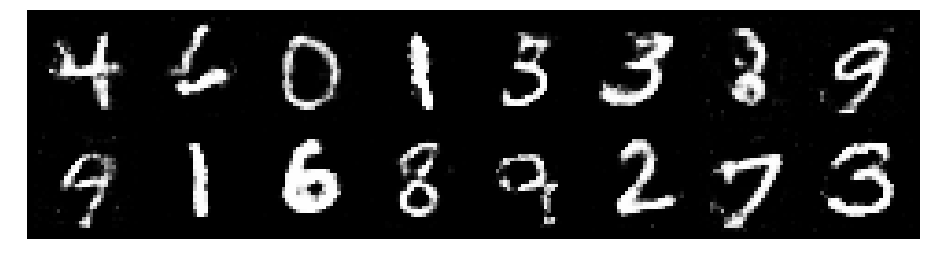

Epoch: [193/200], Batch Num: [500/600]
Discriminator Loss: 1.2922, Generator Loss: 0.9942
D(x): 0.5721, D(G(z)): 0.4471


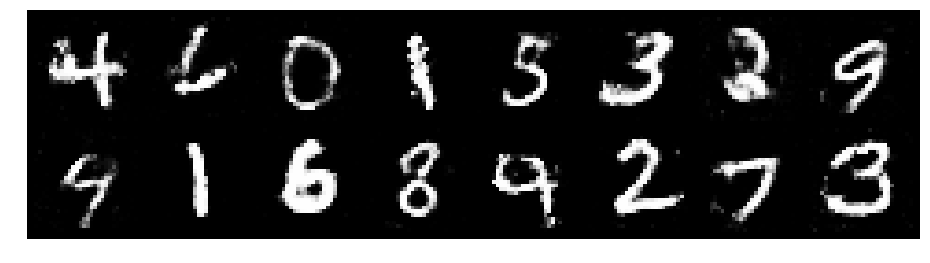

Epoch: [194/200], Batch Num: [0/600]
Discriminator Loss: 1.2649, Generator Loss: 0.8352
D(x): 0.5260, D(G(z)): 0.4393


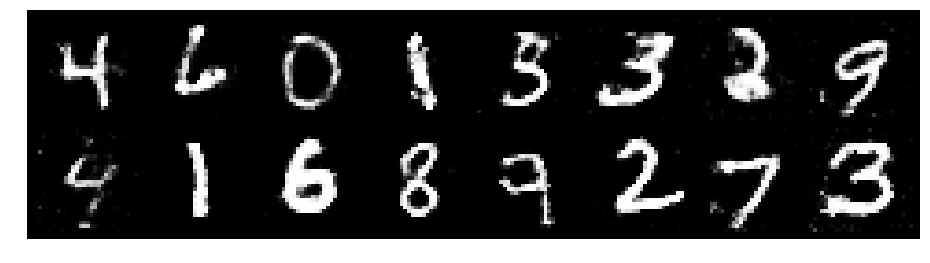

Epoch: [194/200], Batch Num: [100/600]
Discriminator Loss: 1.2422, Generator Loss: 0.8991
D(x): 0.5572, D(G(z)): 0.4408


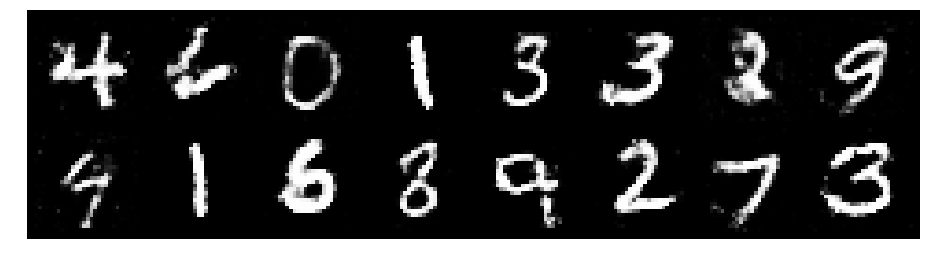

Epoch: [194/200], Batch Num: [200/600]
Discriminator Loss: 1.4846, Generator Loss: 0.9059
D(x): 0.5182, D(G(z)): 0.4935


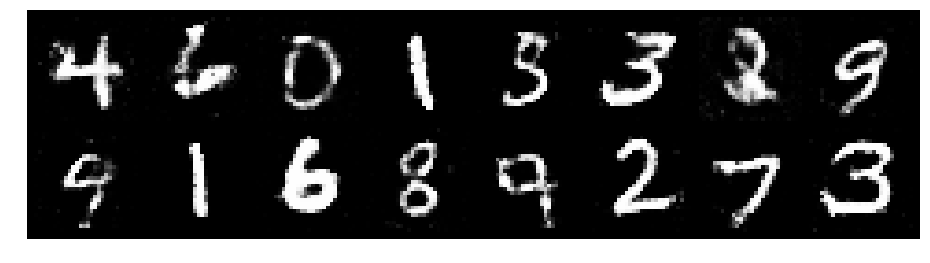

Epoch: [194/200], Batch Num: [300/600]
Discriminator Loss: 1.3243, Generator Loss: 0.8153
D(x): 0.5182, D(G(z)): 0.4514


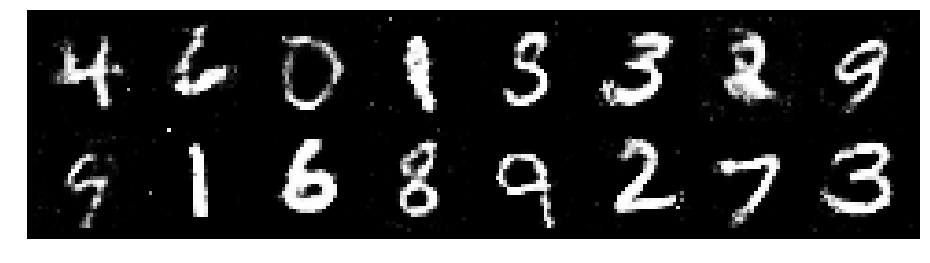

Epoch: [194/200], Batch Num: [400/600]
Discriminator Loss: 1.3453, Generator Loss: 0.7415
D(x): 0.5549, D(G(z)): 0.4861


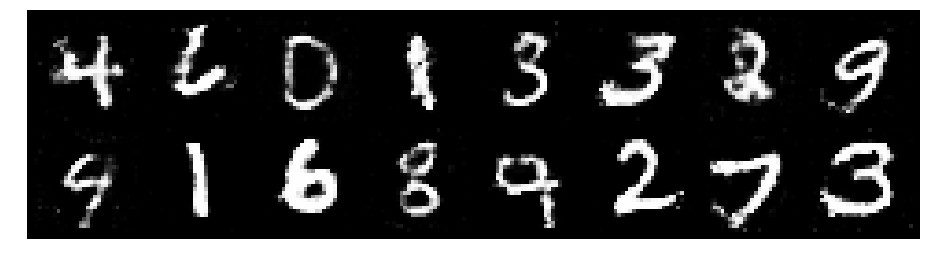

Epoch: [194/200], Batch Num: [500/600]
Discriminator Loss: 1.3922, Generator Loss: 0.8030
D(x): 0.5283, D(G(z)): 0.4783


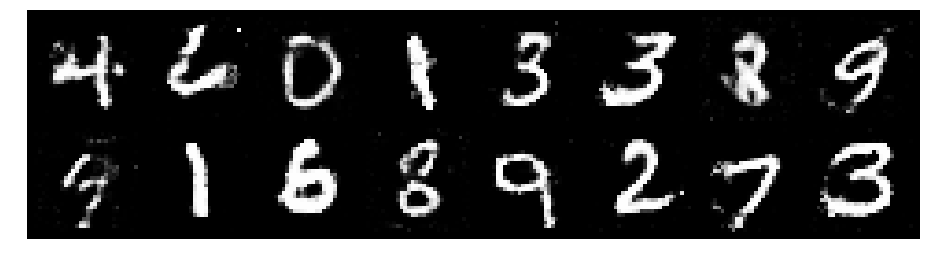

Epoch: [195/200], Batch Num: [0/600]
Discriminator Loss: 1.3415, Generator Loss: 0.8764
D(x): 0.5052, D(G(z)): 0.4462


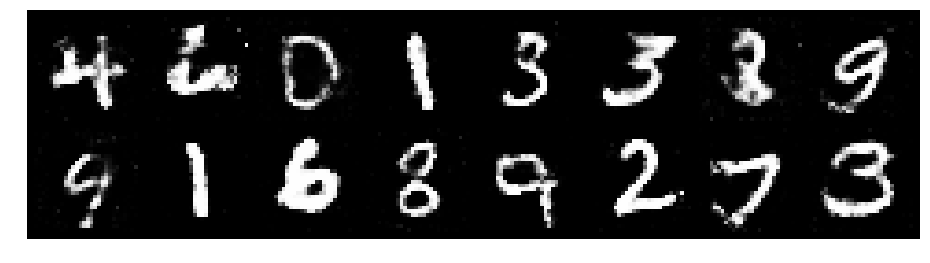

Epoch: [195/200], Batch Num: [100/600]
Discriminator Loss: 1.3114, Generator Loss: 0.8287
D(x): 0.5636, D(G(z)): 0.4717


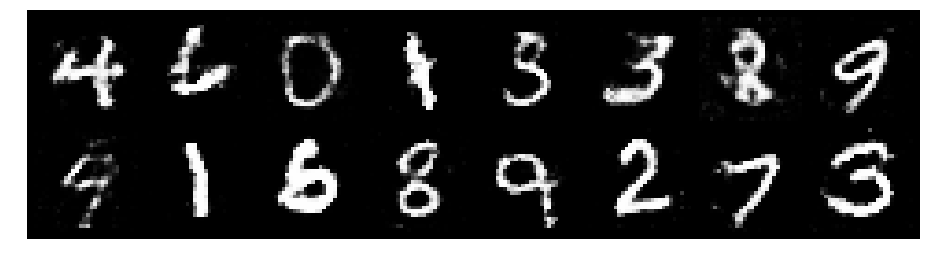

Epoch: [195/200], Batch Num: [200/600]
Discriminator Loss: 1.2205, Generator Loss: 0.8451
D(x): 0.5505, D(G(z)): 0.4264


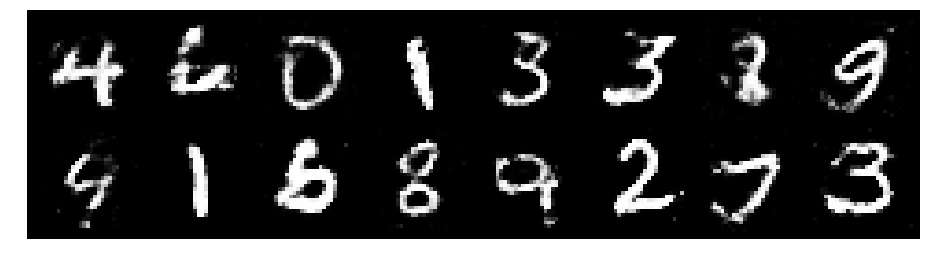

Epoch: [195/200], Batch Num: [300/600]
Discriminator Loss: 1.3181, Generator Loss: 0.7895
D(x): 0.5527, D(G(z)): 0.4774


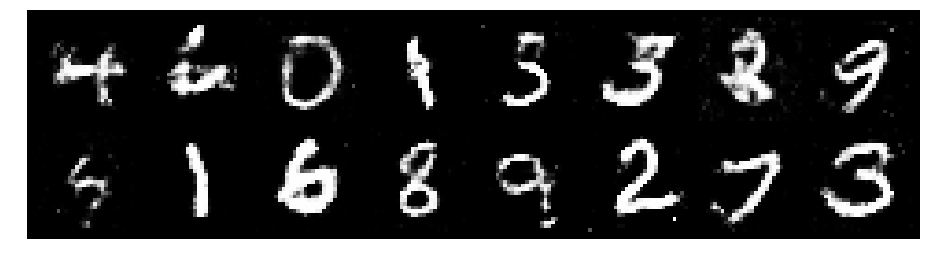

Epoch: [195/200], Batch Num: [400/600]
Discriminator Loss: 1.3776, Generator Loss: 0.8176
D(x): 0.5302, D(G(z)): 0.4773


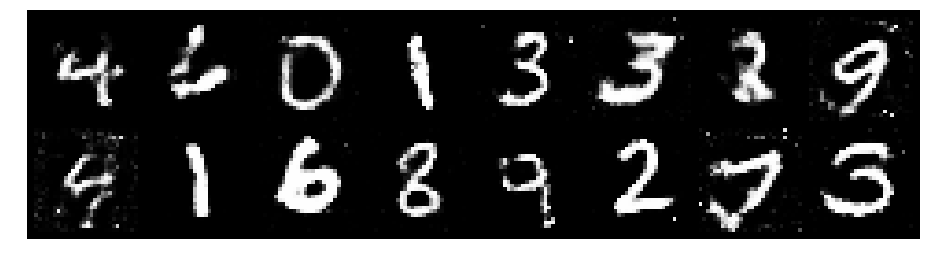

Epoch: [195/200], Batch Num: [500/600]
Discriminator Loss: 1.3513, Generator Loss: 0.8289
D(x): 0.5329, D(G(z)): 0.4602


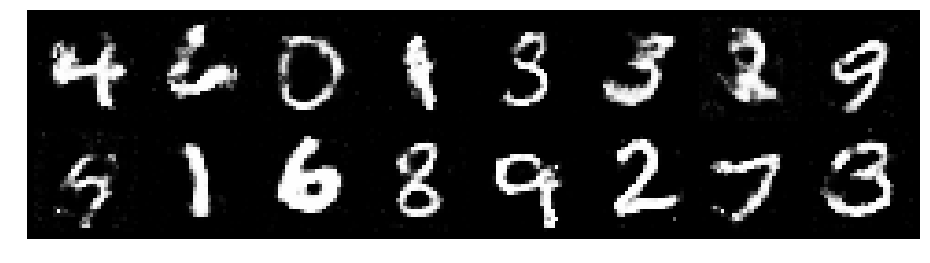

Epoch: [196/200], Batch Num: [0/600]
Discriminator Loss: 1.3947, Generator Loss: 0.9301
D(x): 0.5048, D(G(z)): 0.4337


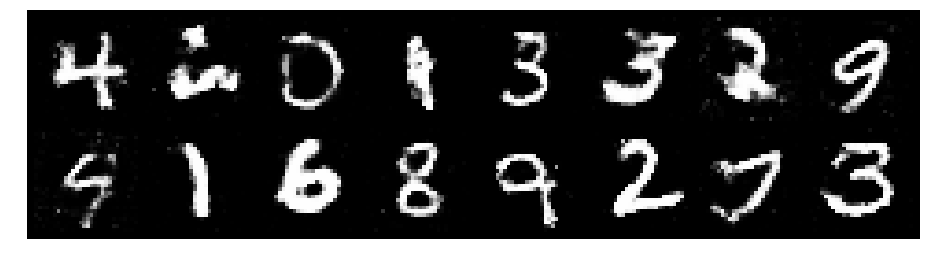

Epoch: [196/200], Batch Num: [100/600]
Discriminator Loss: 1.3251, Generator Loss: 0.9332
D(x): 0.5505, D(G(z)): 0.4682


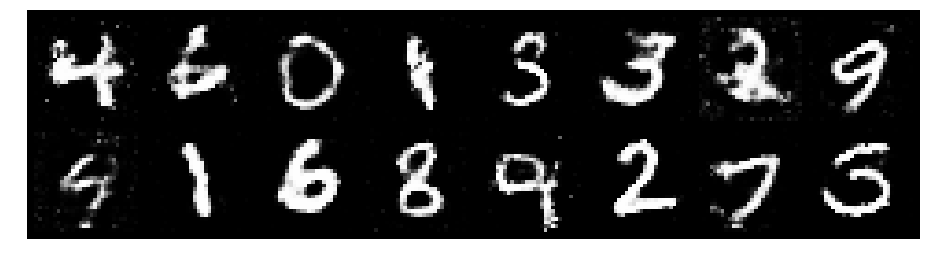

Epoch: [196/200], Batch Num: [200/600]
Discriminator Loss: 1.2982, Generator Loss: 0.8256
D(x): 0.5810, D(G(z)): 0.4733


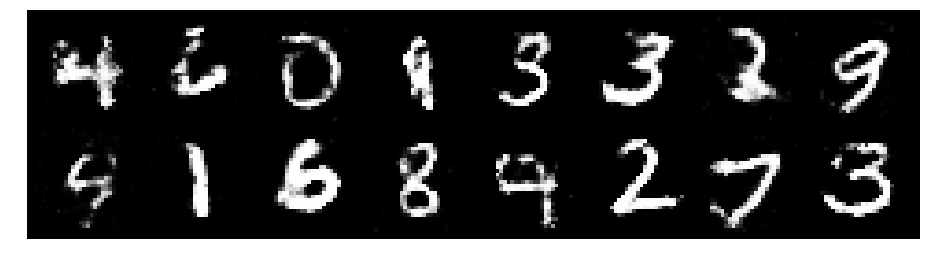

Epoch: [196/200], Batch Num: [300/600]
Discriminator Loss: 1.3703, Generator Loss: 0.7901
D(x): 0.5505, D(G(z)): 0.4858


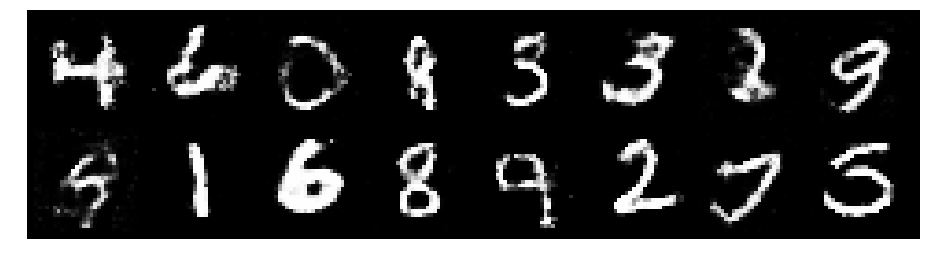

Epoch: [196/200], Batch Num: [400/600]
Discriminator Loss: 1.2068, Generator Loss: 0.9171
D(x): 0.5319, D(G(z)): 0.4076


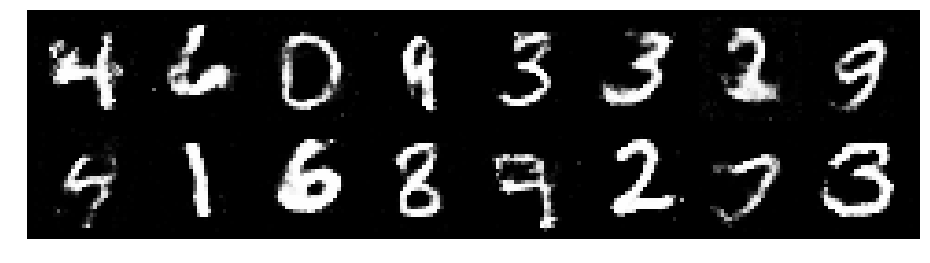

Epoch: [196/200], Batch Num: [500/600]
Discriminator Loss: 1.2241, Generator Loss: 0.9372
D(x): 0.5821, D(G(z)): 0.4581


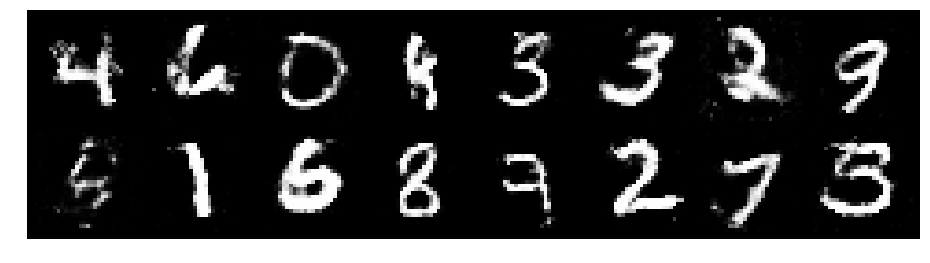

Epoch: [197/200], Batch Num: [0/600]
Discriminator Loss: 1.2925, Generator Loss: 0.7912
D(x): 0.5637, D(G(z)): 0.4390


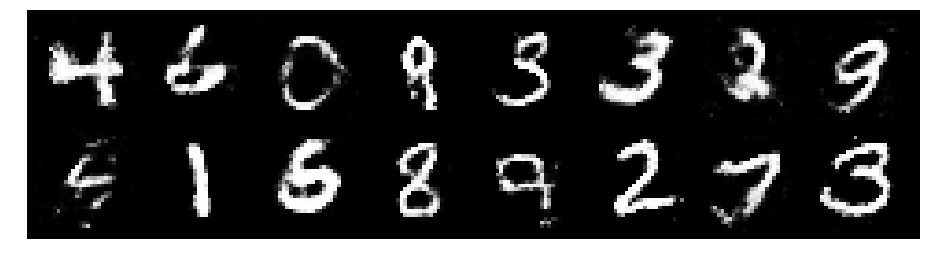

Epoch: [197/200], Batch Num: [100/600]
Discriminator Loss: 1.3652, Generator Loss: 0.7802
D(x): 0.5190, D(G(z)): 0.4712


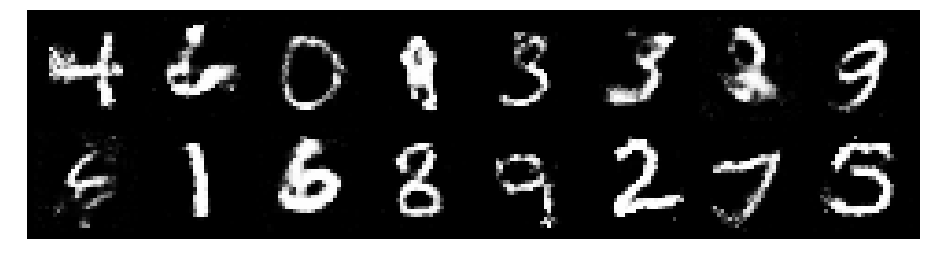

Epoch: [197/200], Batch Num: [200/600]
Discriminator Loss: 1.3071, Generator Loss: 0.9646
D(x): 0.5122, D(G(z)): 0.4328


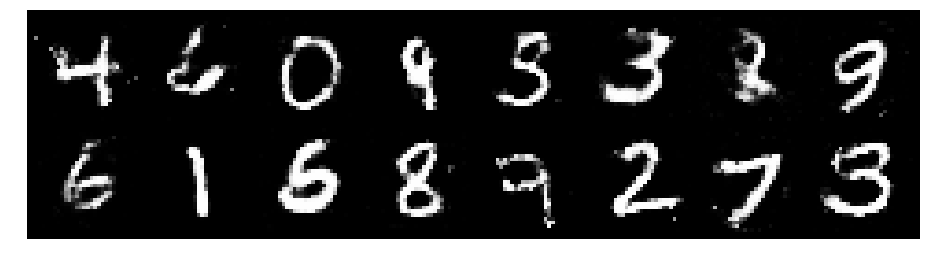

Epoch: [197/200], Batch Num: [300/600]
Discriminator Loss: 1.2893, Generator Loss: 0.9542
D(x): 0.5589, D(G(z)): 0.4449


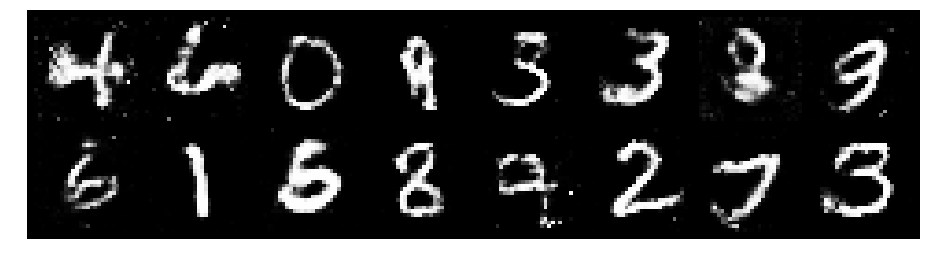

Epoch: [197/200], Batch Num: [400/600]
Discriminator Loss: 1.2444, Generator Loss: 0.8250
D(x): 0.5937, D(G(z)): 0.4564


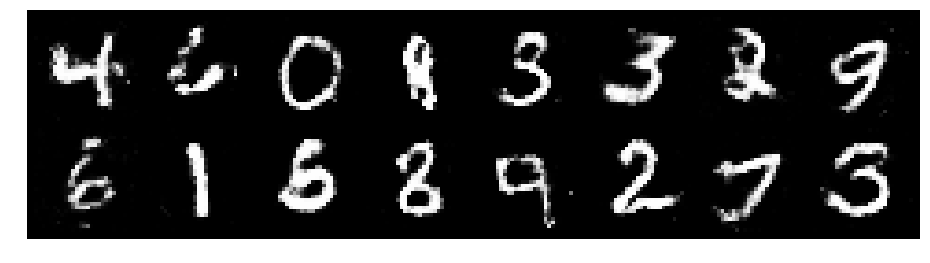

Epoch: [197/200], Batch Num: [500/600]
Discriminator Loss: 1.3721, Generator Loss: 0.8703
D(x): 0.5225, D(G(z)): 0.4670


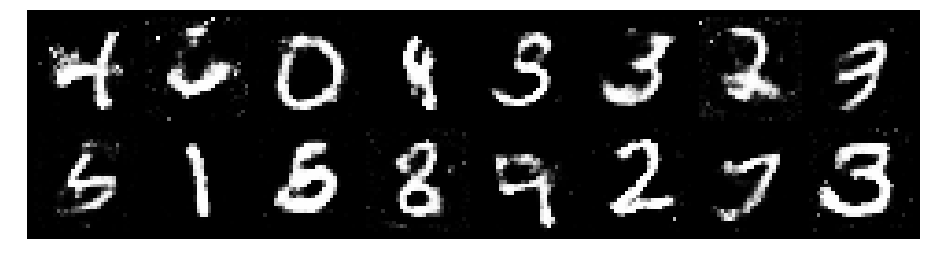

Epoch: [198/200], Batch Num: [0/600]
Discriminator Loss: 1.2564, Generator Loss: 0.9447
D(x): 0.5251, D(G(z)): 0.4088


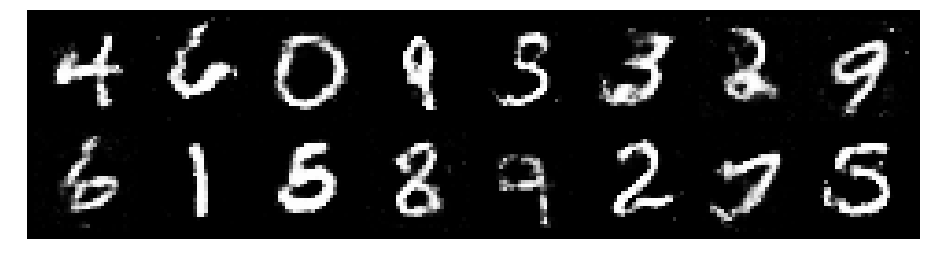

Epoch: [198/200], Batch Num: [100/600]
Discriminator Loss: 1.3788, Generator Loss: 0.9064
D(x): 0.5060, D(G(z)): 0.4304


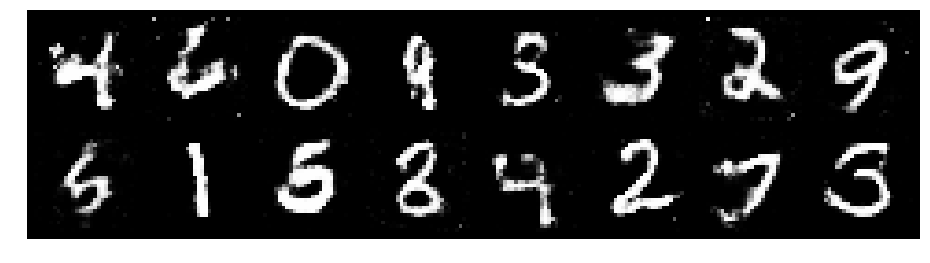

Epoch: [198/200], Batch Num: [200/600]
Discriminator Loss: 1.3174, Generator Loss: 0.7997
D(x): 0.5682, D(G(z)): 0.4755


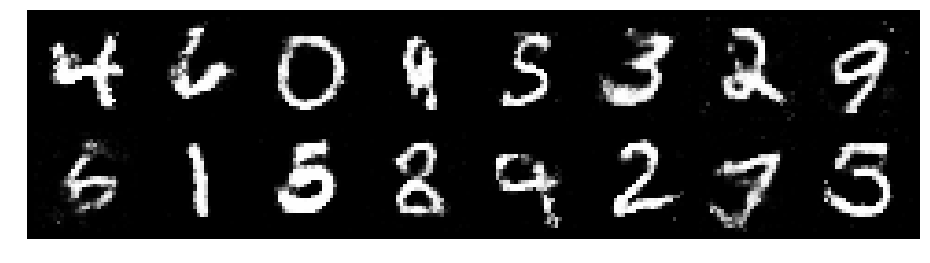

Epoch: [198/200], Batch Num: [300/600]
Discriminator Loss: 1.3309, Generator Loss: 0.9109
D(x): 0.5864, D(G(z)): 0.4641


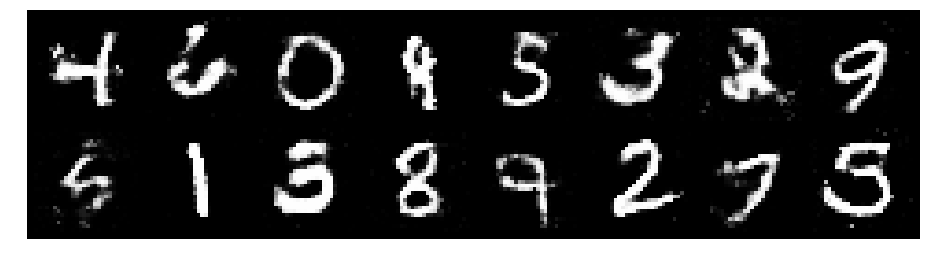

Epoch: [198/200], Batch Num: [400/600]
Discriminator Loss: 1.1993, Generator Loss: 0.9202
D(x): 0.5759, D(G(z)): 0.4246


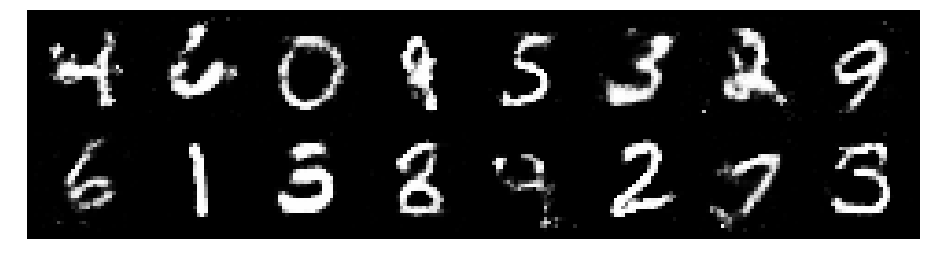

Epoch: [198/200], Batch Num: [500/600]
Discriminator Loss: 1.2938, Generator Loss: 0.9729
D(x): 0.5635, D(G(z)): 0.4361


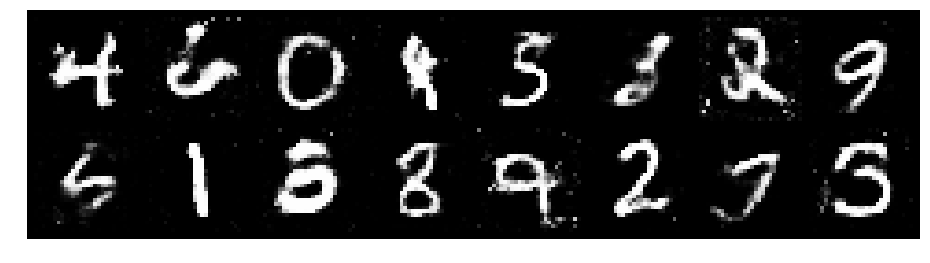

Epoch: [199/200], Batch Num: [0/600]
Discriminator Loss: 1.2967, Generator Loss: 0.9552
D(x): 0.5478, D(G(z)): 0.4275


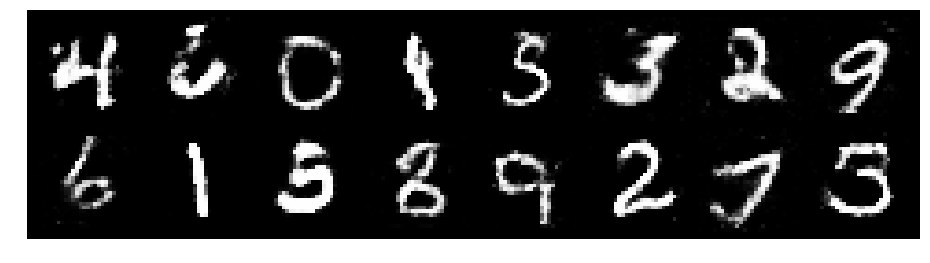

Epoch: [199/200], Batch Num: [100/600]
Discriminator Loss: 1.2112, Generator Loss: 0.8632
D(x): 0.5607, D(G(z)): 0.4220


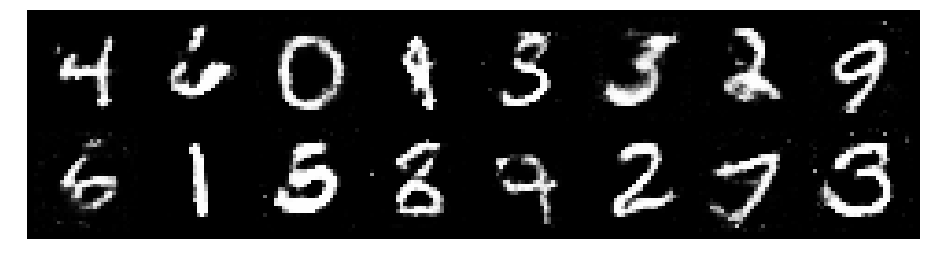

Epoch: [199/200], Batch Num: [200/600]
Discriminator Loss: 1.3180, Generator Loss: 0.9231
D(x): 0.5250, D(G(z)): 0.4265


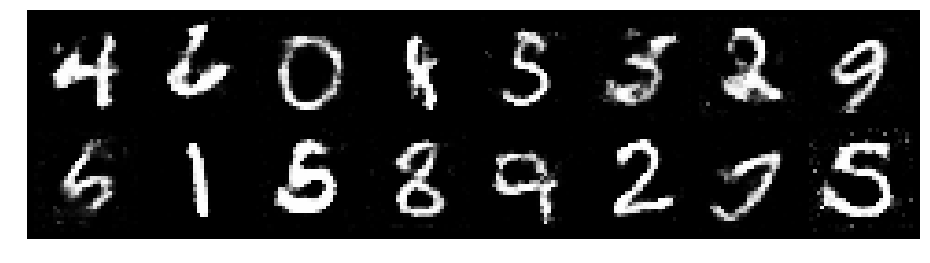

Epoch: [199/200], Batch Num: [300/600]
Discriminator Loss: 1.3523, Generator Loss: 0.9845
D(x): 0.5206, D(G(z)): 0.4562


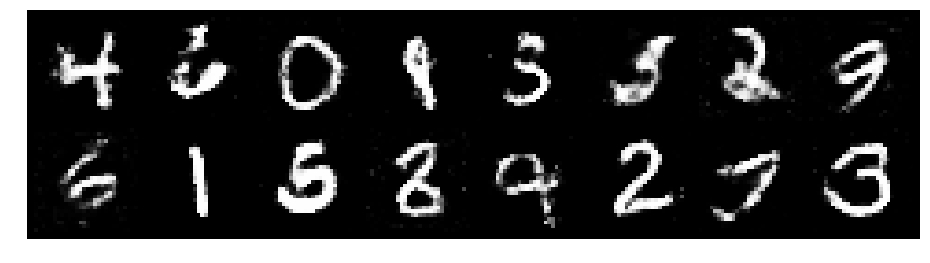

Epoch: [199/200], Batch Num: [400/600]
Discriminator Loss: 1.2238, Generator Loss: 0.9044
D(x): 0.5456, D(G(z)): 0.4306


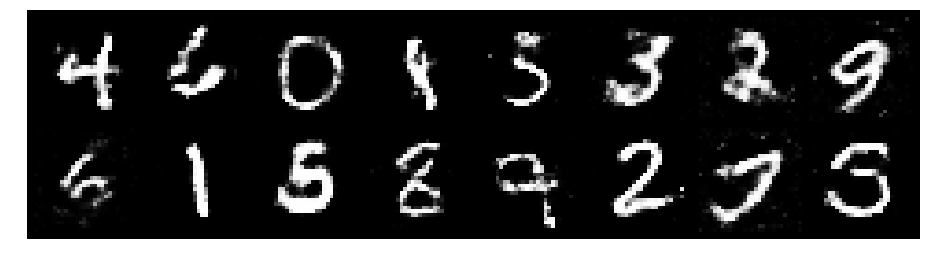

Epoch: [199/200], Batch Num: [500/600]
Discriminator Loss: 1.2924, Generator Loss: 0.8397
D(x): 0.5249, D(G(z)): 0.4420


In [12]:
# Trainings

# create logger instance
logger = Logger(model_name='VGAN', data_name='MNIST')

# total number of epochs to train
num_epochs = 200

for epoch in range(num_epochs):
    for n_batch, (real_batch,_) in enumerate(data_loader):
        N = real_batch.size(0)
        
        # 1 - Train discriminator
        real_data = Variable(images_to_vectors(real_batch))
        
        # gen fake data and detach
        # (so grads are not calculated for generator)
        fake_data = generator(noise(N)).detach()
        
        # train D
        d_error, d_pred_real, d_pred_fake = train_discriminator(d_optimizer, real_data, fake_data)
        
        # 2 - Train Generator
        
        # generate fake data
        fake_data = generator(noise(N))
        
        # train G
        g_error = train_generator(g_optimizer, fake_data)
        
        # log batch error
        logger.log(d_error, g_error, epoch, n_batch, num_batches)
        
        # display progress every few batches
        if(n_batch) % 100 == 0:
            test_images = vectors_to_images(generator(test_noise))
            test_images = test_images.data
            
            logger.log_images(
                test_images, num_test_samples,
                epoch, n_batch, num_batches
            );
            
            # display status logs
            logger.display_status(
                epoch, num_epochs, n_batch, num_batches,
                d_error, g_error, d_pred_real, d_pred_fake
            )